In [1]:
import os
import time
import sys
import json
import numpy as np
import ipyvolume as ipv
from pathlib import Path
import numpy as np
import random
from datetime import datetime

from tyssue import Sheet, config
from tyssue.io import hdf5
from tyssue.generation import ellipsoid_sheet
from tyssue.draw.ipv_draw import view_ipv
from tyssue.draw.plt_draw import quick_edge_draw
from tyssue.dynamics import effectors, units
from tyssue.dynamics.sheet_gradients import height_grad
from tyssue.dynamics.factory import model_factory
from tyssue.solvers.sheet_vertex_solver import Solver
from tyssue.behaviors.events import EventManager
from tyssue.topology.sheet_topology import remove_face
from tyssue.utils.decorators import do_undo
from tyssue.utils import to_nd
from tyssue.io import hdf5


from invagination.ellipsoid import EllipsoidGeometry as geom
from invagination.ellipsoid import VitellineElasticity
from invagination.delamination import (define_mesoderm,
                                       check_enter_in_process,
                                       check_tri_faces,
                                       type1_transition)
from invagination.contractility_gradient import constriction

from invagination.plots import mesoderm_position


import matplotlib.pyplot as plt

%matplotlib inline

from mesher.cgal_mesher import (import_sheet_into_Mesh,
                                does_self_intersect,
                                self_intersections)

from mesher.cgal_mesher import (Mesh)

SIM_DIR = Path('/home/admin-suz/Documents/Simulations/Collisions')


In [2]:
import datetime

today = datetime.date.today()

sim_save_dir = SIM_DIR/f'{today.isoformat()}'

try:
    os.mkdir(sim_save_dir)
except FileExistsError:
    pass

In [ ]:
#%pdb

In [3]:
class RadialTension(effectors.AbstractEffector):
    
    dimensions = units.line_tension
    magnitude = 'radial_tension'
    label = 'Apical basal tension'
    element = 'vert'
    specs = {'vert':{'is_active',
             'height',
             'radial_tension'}}

    @staticmethod
    def energy(eptm):
        return eptm.vert_df.eval(
            'height * radial_tension * is_active')
         
    @staticmethod
    def gradient(eptm):
        grad = height_grad(eptm) * to_nd(
            eptm.vert_df.eval('radial_tension'), 3)
        grad.columns = ['g'+c for c in eptm.coords]
        return grad, None
    
    
EllipsoidSModel = model_factory(
    [
    RadialTension,
    VitellineElasticity,
    effectors.LineTension,
    effectors.FaceContractility,
    effectors.FaceVolumeElasticity,
    ], effectors.FaceAreaElasticity)


EllipsoidBModel = model_factory(
    [
    RadialTension,
    VitellineElasticity,
    #effectors.LineTension,
    effectors.FaceContractility,
    effectors.FaceAreaElasticity,
    effectors.CellVolumeElasticity,
    ], effectors.FaceAreaElasticity)


model = EllipsoidBModel


In [33]:
from tyssue.solvers.sheet_vertex_solver import Solver
       

class CollisionSolver(Solver):
    @classmethod
    def opt_energy(cls, pos, pos_idx, sheet, geom, model):
        # Keep old position safe 
        vert_df_old = sheet.vert_df
        cls.set_pos(pos, pos_idx, sheet)
        geom.update_all(sheet)
        
        # Collide test 
        # and correct collision if needed
        vertices, faces, _ = sheet.triangular_mesh(sheet.coords)
        vertices = np.array(vertices, order='C')
        faces = np.array(faces, order='C')
        mesh = import_sheet_into_Mesh(faces, vertices)
        
        if does_self_intersect(mesh):
            print("There is at least one intersection")
            tuple_intersected_edges = self_intersections(mesh)
            print("nombre d'intersection :",len(tuple_intersected_edges))
            
            # flatten tuple into liste
            list_intersected_edges = [y for x in tuple_intersected_edges for y in x]
            srce = sheet.edge_df.loc[(list_intersected_edges), 'srce'].values
            trgt = sheet.edge_df.loc[(list_intersected_edges), 'trgt'].values
            vert_to_modify = np.unique(np.append(srce, trgt))
            print(vert_to_modify)
            
            sheet.vert_df.loc[vert_to_modify, ['x', 'y', 'z']] = vert_df_old.loc[vert_to_modify,['x', 'y', 'z']].values


        else:
            print("There is no intersection")

        
        
        geom.update_all(sheet)
        return model.compute_energy(sheet, full_output=False)


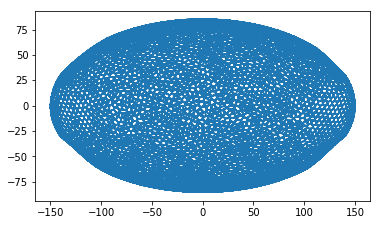

In [5]:
dsets = hdf5.load_datasets('../data/hf5/ellipsoid_sheet_init.hf5',
                           data_names=['vert', 'edge', 'face', 'cell'])


with open('../data/json/ellipsoid.json', 'r+') as fp:
    specs = json.load(fp)

sheet = Sheet('ellipse', dsets, specs)

# Modify some initial value
sheet.settings['threshold_length'] = 1e-3
sheet.settings['vitelline_space'] = 0.2
sheet.vert_df['radial_tension'] = 0.
sheet.cell_df['prefered_vol'] = 4539601.384437251
sheet.cell_df['vol_elasticity'] = 3.e-6

fig, ax = quick_edge_draw(sheet, coords=list('zx'))

In [6]:
solver_kw = {'minimize': {'method': 'L-BFGS-B',
                          'options': {'ftol': 1e-8,
                                      'gtol': 1e-8}}}

## Define cells in the mesoderm

number of apoptotic cells: 849


(<matplotlib.figure.Figure at 0x7f358e4f9860>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f35d08793c8>,
       dtype=object))

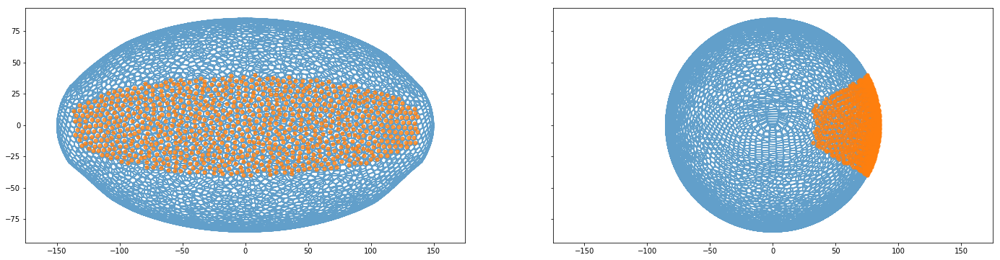

In [7]:
# Define rectangular mesoderm
#define_cell_in_mesoderm(sheet, 0.3, 0.7 ,0.05, 0.95)

# Define ovoid mesoderm
define_mesoderm(sheet, 145, 40)

mesoderm = sheet.face_df[sheet.face_df.is_mesoderm].index
delaminating_cells = sheet.face_df[sheet.face_df['is_mesoderm']].index



print('number of apoptotic cells: {}'.format(delaminating_cells.size))
mesoderm_position(sheet, delaminating_cells)

number of apoptotic cells: 849


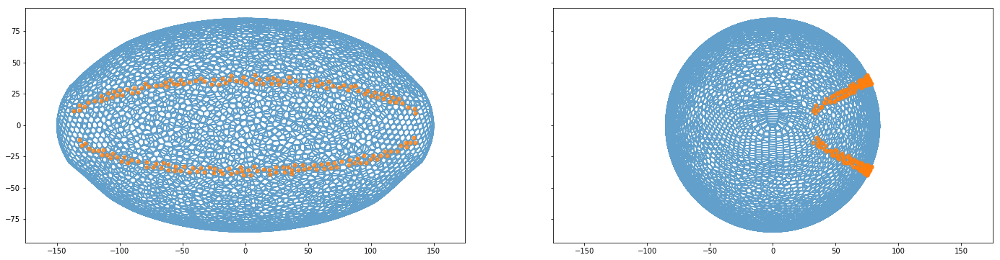

In [8]:
# define the last 2 lines cells 

def define_relaxation_cells(sheet, a=145., b=40.,
                            aa=145., bb=40.,
                    coords=['x', 'z', 'y']):
    """
    Define an oval area that will become the mesoderm.

    a: radius on the first-axis
    b: radius on the second-axis
    """
    define_mesoderm(sheet, aa, bb)
    x, y, z = coords
    x_ = sheet.face_df[x] / b
    y_ = sheet.face_df[y] / a

    rayon = x_**2 + y_**2
    height = sheet.face_df[z]

    sheet.face_df['is_relaxation'] = ~((rayon <= 1) & (height > 0))
    sheet.face_df['is_relaxation'] = [False if ((not line[1]['is_mesoderm']) & (line[1]['is_relaxation'])) 
                                    else line[1]['is_relaxation'] 
                                    for line in sheet.face_df.iterrows() ]
    
    sheet.face_df['is_mesoderm'] = [False if ((line[1]['is_mesoderm']) & (line[1]['is_relaxation'])) 
                                    else line[1]['is_mesoderm'] 
                                    for line in sheet.face_df.iterrows()]
    # Remove not active face
    face_not_active = sheet.edge_df[
        ~sheet.edge_df.is_active.astype(bool)].face.unique()
    sheet.face_df.loc[face_not_active, 'is_relaxation'] = False




define_relaxation_cells(sheet, 140, 33, 145, 40)

relaxation_cells = sheet.face_df[sheet.face_df['is_relaxation']].index
print('number of apoptotic cells: {}'.format(delaminating_cells.size))
mesoderm_position(sheet, relaxation_cells)

mesoderm = sheet.face_df[sheet.face_df.is_mesoderm].index
relaxating_cell = sheet.face_df[sheet.face_df.is_relaxation].index

## Processus functions

In [16]:
import logging
logger = logging.Logger('event_log')


@do_undo
def run_sim(sheet, mesoderm, geom, model, dirname,
           max_contractility_rate, profile_width, k):
    
    #solver = Solver
    solver = CollisionSolver
    
    # logger initiation
    event_logfile = os.path.join(dirname, 'events.log')
    hdlr = logging.FileHandler(event_logfile)
    hdlr.setLevel('INFO')
    logger.addHandler(hdlr)
        
    #Initiate manager
    manager = EventManager('face')
    sheet.face_df['enter_in_process'] = 0  
    
    t=0
    stop = 200
    
    # Add all cells in constriction process 
    for f in mesoderm:
        x = sheet.face_df.loc[f, 'x']
        c_rate = 1+(max_contractility_rate-1) * ((1+np.exp(-k*profile_width))/
                                          (1+np.exp(k*(abs(x)-profile_width))))


        manager.append(constriction, f, 
                       (c_rate,
                        sheet.settings['delamination']['critical_area'],
                        sheet.settings['delamination']['radial_tension'],
                        sheet.settings['delamination']['nb_iteration'],
                        sheet.settings['delamination']['nb_iteration_max'],
                        sheet.settings['delamination']['contract_neighbors'],
                        sheet.settings['delamination']['critical_area_neighbors'],
                        sheet.settings['delamination']['contract_span'],
                        sheet.settings['delamination']['basal_contract_rate'],
                        0,
                        30,
                        sheet.settings['delamination']['geom']
                       ))
        
    for f in sheet.face_df[sheet.face_df['is_relaxation']].index :
        manager.append(constriction, f, 
                       (max_contractility_rate,
                        sheet.settings['delamination']['critical_area'],
                        sheet.settings['delamination']['radial_tension'],
                        sheet.settings['delamination']['nb_iteration'],
                        sheet.settings['delamination']['nb_iteration_max'],
                        sheet.settings['delamination']['contract_neighbors'],
                        sheet.settings['delamination']['critical_area_neighbors'],
                        sheet.settings['delamination']['contract_span'],
                        sheet.settings['delamination']['basal_contract_rate'],
                        0,
                        30,
                        sheet.settings['delamination']['geom']
                       ))
    
    while manager.current and t < stop:
        print("TEMPS : ", t)
        # Clean radial tension on all vertices
        sheet.vert_df['radial_tension'] = 0
        manager.execute(sheet)
        res = solver.find_energy_min(sheet, geom, model, **solver_kw)
        
        # add noise on vertex position to avoid local minimal.
        sheet.vert_df[['x', 'y']] += np.random.normal(scale=1e-3, size=(sheet.Nv, 2))
        
        geom.update_all(sheet)

        figname = os.path.join(
            dirname, 'invagination_{:04d}.png'.format(t))
        hdfname = figname[:-3]+'hf5'
        hdf5.save_datasets(hdfname, sheet)      
        
    
        
        # Add cells with initially 3 neighbourghs to be eliminated
        check_tri_faces(sheet, manager)
        # Add T1 transition for face with at least one edge shorter than critical length
        #[manager.append(type1_transition, f, kwargs=sheet.settings['T1']) for f in sheet.edge_df[
        #    sheet.edge_df['length'] < sheet.settings['T1']['critical_length']]['face'].unique()]
    
    
        manager.update()
        t+=1
        
        
    logger.removeHandler(hdlr)
    return sheet


In [11]:
def delamination_process(sheet, max_contractility_rate, critical_area, 
                         radial_tension, nb_iteraction_max, 
                         profile_width, k):
    # Directory definition 
    dirname = '{}_contractility_{}_critical_area_{}_radialtension'.format(
                max_contractility_rate, critical_area, radial_tension)
    dirname = os.path.join(sim_save_dir, dirname)
    
    print('starting {}'.format(dirname))
    try:
        os.mkdir(dirname)
    except IOError:
        pass
    
    settings = {'critical_area': critical_area,
            'radial_tension': radial_tension,
            'nb_iteration':0,
            'nb_iteration_max':nb_iteraction_max,
            'contract_neighbors':True,
            'critical_area_neighbors':20,
            'contract_span':5,
            'basal_contract_rate':1.001,
            'geom': geom}

    solver = Solver
    
    # Add some information to the sheet
    sheet2 = sheet.copy(deep_copy=True)
    
    sheet2.face_df['id'] = sheet2.face_df.index.values
    sheet2.settings['delamination'] = settings
    
    settings2 = {'critical_length':0.3}
    sheet2.settings['T1'] = settings2
    #""" Initiale find minimal energy
    # To be sure we are at the equilibrium
    res = solver.find_energy_min(sheet2, geom, model, **solver_kw)
   
    sheet2 = run_sim(sheet2, delaminating_cells, geom, model, dirname,
                     max_contractility_rate, profile_width, k)


    print('{} done'.format(dirname))
    print('~~~~~~~~~~~~~~~~~~~~~\n')
    

## Sequential execution 

In [46]:
from datetime import datetime

global_start=datetime.now()
print ("start : " + str(global_start))

profile_width = 25
k = 0.19
nb_iter = 30
critical_area = 5

radial_tension = [50]
contractility_percent = [64]
contractility_rate = [1+c/100 for c in contractility_percent]

for rad in radial_tension:
    for contracts in contractility_rate:
        print ('rad : ' + str(rad)+ '\tcontract : ' + str(contracts))
        delamination_process(sheet, contracts, critical_area,
                             rad, nb_iter,
                            profile_width, k)
        
        
global_end = datetime.now()
print ("end : " + str(global_end))
print ('Duree totale d execution : \n\t\t')
print (global_end-global_start)

start : 2018-11-14 14:35:24.320385
rad : 50	contract : 1.6400000000000001
starting /home/admin-suz/Documents/Simulations/Collisions/2018-11-14/1.6400000000000001_contractility_5_critical_area_50_radialtension


/home/admin-suz/anaconda3/lib/python3.6/site-packages/pandas/core/computation/expressions.py:180: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


TEMPS :  0
There is no intersection
There is at least one intersection
nombre d'intersection : 49
[   49    96   140   141   143   619   620   829   830   975   977  1935
  2457  2649  2651  2931  3058  3059  3060  3061  3172  5303  5325  5903
  7134  7696  7699  7897  8050  9375  9376  9377  9378  9422  9425  9866
  9867  9870  9881  9885 11296 11297 11298]
There is at least one intersection
nombre d'intersection : 33
[  140   141   143   975   977  1935  2649  2651  3058  3059  3060  3061
  5325  7134  7696  7699  7897  8050  9375  9376  9377  9378  9422  9866
  9867  9870  9881  9885 11296 11297 11298]
There is at least one intersection
nombre d'intersection : 18
[ 2649  2651  3058  3059  3060  3061  5325  7696  7699  7897  8050  9376
  9377  9378  9866  9867  9870  9885 11296 11297 11298]
There is at least one intersection
nombre d'intersection : 2
[5325 7696 7699 8050]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
TEMPS :  1
Th

There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[10054 10055 10058 11415]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[   58  3065  3066  5672  6405  8980 10419 10420]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[10368 10369 11192 11193 11194]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[  467  2043  2044  4762  7889  7890  9872  9938  9939 10796 11021]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 875 2965 2970 2971 6138]
There is at least one intersection
nombre d'intersection : 2
[9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 6
[ 7859 10961 11441 11442 11443 11701]
There is no intersection
There is n

There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[7776 7779 7811 7812 7813]
There is at least one intersection
nombre d'intersection : 2
[ 6556  6557  7182  7183 11584]
There is at least one intersection
nombre d'intersection : 3
[ 6556  6557  7182  7183  7186 11584]
There is at least one intersection
nombre d'intersection : 3
[ 6556  6557  7182  7183  7186 11584]
There is at least one intersection
nombre d'intersection : 4
[ 151 1005 1008 1017 1018 1019]
There is at least one intersection
nombre d'intersection : 7
[11143 11144 11145 11146 11150 11544]
There is at least one intersection
nombre d'intersection : 9
[  550   833   836   837  2214  2227  6425  7736  8960  8962  8989 10242
 10253 11133]
There is at least one intersection
nombre d'intersection : 3
[6425 8959 8960 8962 8989]
There is at least one intersection
nombre d'intersection : 3
[1848 1

There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[ 550  846 2214 2227 2951 5910 5911 7736]
There is at least one intersection
nombre d'intersection : 3
[ 6202  6209 11197 11198]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[7776 7778 7779 7811 7812 7813]
There is at least one intersection
nombre d'intersection : 2
[ 7957  7958  7960 10736]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[6766 6767 6768 6773]
There is at least one intersection
nombre d'intersection : 3
[  32  452 1922 7423]
There is at least one intersection
nombre d'intersection : 1
[6766 6767 6768 6773]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 7
[7897 9866 9867 9870 9881 9885]
There is at least one intersection
nombre d'intersection : 7
[7897 9866 9867 9870 9881 9

There is at least one intersection
nombre d'intersection : 5
[2291 5111 5325 7696 7699 7787 7788 7789 8050 9819]
There is at least one intersection
nombre d'intersection : 4
[  32  452 1922 2291 5111 7787 7788 7789 9584 9819]
There is at least one intersection
nombre d'intersection : 6
[  32  452 1276 1922 1998 2291 5111 6520 6521 6522 7787 7788 7789 9584
 9819]
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[ 845  846 2951 5910 5911 9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 2
[ 846 2951 5910 5911]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[7757 7758 9784 9785]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 7538  7539  7541  9650  9651 11692]
There is at least one intersection
nombre d'intersection : 5
[10186 10187 11100 11101 11108 11520]
There is no intersection
There is no intersection
There is no intersection
There is at l

There is no intersection
There is at least one intersection
nombre d'intersection : 5
[ 845  846 2951 5909 5910 5911]
There is at least one intersection
nombre d'intersection : 1
[10587 10590 10591 11279]
There is at least one intersection
nombre d'intersection : 5
[  836   837  6556  6557  7182  7183  7186 10242 10253 11584]
There is at least one intersection
nombre d'intersection : 12
[  836   837  6556  6557  7183  7186  8999  9010  9020  9021  9022  9023
 10242 10253 11133 11584]
There is at least one intersection
nombre d'intersection : 7
[8999 9010 9020 9021 9022 9023]
There is at least one intersection
nombre d'intersection : 6
[  71   72 2764 5687 8999 9010 9021 9022 9023]
There is at least one intersection
nombre d'intersection : 7
[  96  829  830 2931 3172 5903]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre 

There is at least one intersection
nombre d'intersection : 3
[7776 7778 7779 7811 7812 7813]
There is at least one intersection
nombre d'intersection : 5
[ 503  504  505 7575 7576 9665]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 10
[6841 6963 9221 9223 9224 9227]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[11183 11184 11185 11187 11762]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[ 9713 10869 10893 10894]
There is at least one intersection
nombre d'intersection : 1
[ 9713 10869 10893 10894]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[11271 11274 11275 11276]
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[  551  6221  8847  8848 11195]
There is no intersectio

nombre d'intersection : 4
[  836   837 10242 10253 11133]
There is at least one intersection
nombre d'intersection : 5
[  833   836   837 10242 10253 11133]
There is at least one intersection
nombre d'intersection : 5
[  833   836   837 10242 10253 11133]
There is at least one intersection
nombre d'intersection : 5
[  833   836   837 10242 10253 11133]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[7625 7626 7627 9687]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 2
[11165 11166 11167 11562]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[9806 9809 9810 9811]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 

nombre d'intersection : 6
[  32  445 1922 7423 9799 9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 3
[  32  445 1922 7423]
There is at least one intersection
nombre d'intersection : 3
[  32  445 1922 7423]
There is at least one intersection
nombre d'intersection : 3
[  32  445 1922 7423]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[9221 9223 9224 9227 9799 9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 1
[1848 1853 4508 7367]
There is at least one intersection
nombre d'intersection : 4
[1848 1853 1854 4508 7367]
There is at least one intersection
nombre d'intersection : 3
[9806 9807 9808 9812 9813 9814]
There is no intersection
There is at least one intersection
nombre d'intersection : 12
[  870   871   877   878  2973  6405  8980 10419 10420]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[5325 7696 7699 8050]
There

There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[  58 3065 3066 5672]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 682 2413 2603 2631 2639 2640 5598 5600]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[6425 8960 8962 8989]
There is at least one intersection
nombre d'intersection : 4
[8959 8960 8962 8989 9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 2
[9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 3
[9799 9806 9809 9810 9811]
There is at least one intersection
nombre d'intersection : 3
[9799 9806 9809 9810 9811]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 841 3026 6012 6013]
There is at least one intersection
n

There is at least one intersection
nombre d'intersection : 14
[ 550  870  871  872  877  878 2214 2231 7736 9739]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 11
[  550  2214  2227  7736 10186 10187 11522 11531 11532 11738]
There is at least one intersection
nombre d'intersection : 10
[10186 10187 11522 11531 11532 11738]
There is at least one intersection
nombre d'intersection : 10
[10186 10187 11522 11531 11532 11738]
There is at least one intersection
nombre d'intersection : 10
[10186 10187 11522 11531 11532 11738]
There is at least one intersection
nombre d'intersection : 30
[  870   871   872   877   878  2973  9445 10186 10187 10657 10660 11100
 11101 11108 11520 11522 11531 11532 11738 11861 11862 11863]
There is at least one intersection
nombre d'intersection : 15
[  845   846  2951  5909  5910  5911 10186 10187 11100 11101 11108 11520
 11531 11532 11738]
There is at least one intersection
nombre d'intersection : 6

There is at least one intersection
nombre d'intersection : 8
[ 943  944 2192 3053 3054 3055 3073 6766 6767 6773]
There is at least one intersection
nombre d'intersection : 1
[ 943  944 3053 3055]
There is at least one intersection
nombre d'intersection : 5
[1276 1997 1998 5325 6520 6521 6522 7696 7699 8050]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[ 718  719 2707 2708 2741 5724]
There is at least one intersection
nombre d'intersection : 6
[ 719 2707 2708 2741 4241 4258 4259 4260 4261 5724]
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[ 503  504  505 7575 7576 9665]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 151 1005 1017 1018]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 503  505 7575 7576 9665]
There is at least one intersection
nombre d'in

There is at least one intersection
nombre d'intersection : 3
[ 718  719 2707 2708]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 2343  2344  9342 10575]
There is no intersection
There is at least one intersection
nombre d'intersection : 15
[  102   104   860   861   863   898  5325  7696  7699  7776  7778  7779
  7811  7812  7813  8050  9463  9464  9465 11630]
There is at least one intersection
nombre d'intersection : 2
[5325 7696 7699 8050]
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 1848  1853  4508  7367  9463  9464  9465 11630]
There is at least one intersection
nombre d'intersection : 6
[ 7625  7626  7627  9463  9464  9465  9687 11630]
There is at least one intersection
nombre d'intersection : 6
[ 7625  7626  7627  9463  9464  9465  9687 11630]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[  29  285  291 4002]
There is no intersect

nombre d'intersection : 3
[  32  445  452 1922 7423]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[4238 4241 4258 4259 4260 4261]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 7889  7890  9938  9939 11021]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[1848 1853 1854 4508 7367]
There is at least one intersection
nombre d'intersection : 5
[ 1848  1853  1854  4508  7367  9713 10869 10893 10894]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[  32  452 1922 7423 9584]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least 

There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[   58  3065  3066  5672 10186 10187 11100 11101 11520]
There is no intersection
There is at least one intersection
nombre d'intersection : 7
[1848 1853 4508 7367 9799 9806 9809 9810 9811]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[2327 5124 5126 7820 7822]
There is at least one intersection
nombre d'intersection : 7
[11422 11695 11821 11823 11824 11872]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 8
[ 6242  6243  6244  8871  9445 10657 10660 11861 11862 11863]
There is at least one intersection
nombre d'intersection : 10
[ 9445 10181 10184 10185 10657 11539 11540 11541 11861 11863]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 1845  7889  7890  9872  9939 10757 10759 10760 11021]
There is no intersection

There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 6995 11271 11274 11275]
There is no intersection
There is at least one intersection
nombre d'intersection : 8
[  833   836   837 10242 10253 11133]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[9806 9807 9808 9812 9813 9814]
There is at least one intersection
nombre d'intersection : 3
[ 9445 10657 11861 11863]
There is at least one intersection
nombre d'intersection : 3
[9799 9806 9809 9810 9811]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[ 9376  9377  9378 11296 11298]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 113  114 2923 8620]
There is at least one intersection
nombre d'intersection : 4
[10186 10

There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 113  114 2923 8620]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[2192 3839 6766 6767]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[ 845  846 2951 5909 5910 5911]
There is at least one intersection
nombre d'intersection : 6
[ 845  846 2951 5909 5910 5911]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 9445 10657 11861 11863]
There is at least one intersection
nombre d'intersection : 7
[ 9376  9377  9378 11296 11297 11298]
There is no intersection
There is at least one intersection
nombre d'intersection : 8
[   29   291   551  2233  3962  4002  6221  8847  8848 11195]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 7
[  151  1005  1008  1017  1018  1019 10069 10070 10071 10072]
There is at leas

There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 651 2556 5435 5437 5438]
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 6995 10645 10646 11271 11274 11275 11315 11316]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 18
[   58   594   653   796  3065  3066  3721  5444  5672  5872  5873  8236
  8358  8359 10035 10036 10037 10038 10140 10574 10575 11278]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 13
[ 102  104  860  861  863  898 2649 2651 3058 3059 3060 3061 7790 7791
 9801 9802 9803]
There is at least one intersection
nombre d'intersection : 3
[7790 7791 9801 9802 9803]
There is at least one intersection
nombre d'intersection : 2
[7790 7791 9801 9802]
There is at least one intersectio

nombre d'intersection : 5
[1848 1853 1854 4508 7367]
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[6425 7591 7592 7594 7595 7790 7791 8960 8962 8989 9801 9803]
There is at least one intersection
nombre d'intersection : 4
[10186 10187 11100 11101 11520]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[  709  2781  7957  7958  8560  8561  9926 10736]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 10
[  5  97  98  99 101 840]
There is at least one intersection
nombre d'intersection : 7
[  5  97  98  99 101 840]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[6242 6243 6244 8871]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 664 2594 2595 2600]
There is no intersection
Ther

There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 841 3026 6012 6013]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 13
[  49  619  620 2441 2457 5303 6662 6663 6664 8515]
There is at least one intersection
nombre d'intersection : 10
[  49  619  620 2441 2457 5303]
There is at least one intersection
nombre d'intersection : 6
[  32  445  452 1922 7423 7790 7791 9584 9801 9803]
There is at least one intersection
nombre d'intersection : 5
[  32  452 1922 6242 6243 6244 7423 7790 7791 8871 9801 9803]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[10022 10023 10440 10441]
There is at least one intersection
nombre d'intersection : 2
[ 875 2965 2971 6138]
There is no intersection
There is no intersection
There is no intersection
The

nombre d'intersection : 15
[  682  2631  2639  2640  7625  7626  7627  9687 11422 11695 11821 11823
 11824 11872]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 831  866  867 5922 5923 5924]
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[  594  5444  8236 10574 10575 11278]
There is at least one intersection
nombre d'intersection : 5
[  594  5444  8236 10574 10575 11278]
There is no intersection
There is at least one intersection
nombre d'intersection : 8
[ 2649  2651  3058  3059  3060  3061 10020 10022 10023 10440 10441 10442]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[2649 2651 3058 3059 3060 3061]
There is at least one intersection
nombre d'intersection : 10
[  836   837  2649  2651  3058  3059  3060  3061 10242 10253 11133]
There is no intersection
There is at 

There is at least one intersection
nombre d'intersection : 7
[ 568 2262 2272 7329 7330 7331 7334 7729 7730 9769]
There is at least one intersection
nombre d'intersection : 10
[ 568 2262 2272 6454 7329 7330 7331 7334 7729 7730 9769]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 576  578 9796 9797 9798]
There is at least one intersection
nombre d'intersection : 1
[7676 7677 7678 7713]
There is at least one intersection
nombre d'intersection : 1
[10010 10011 10013 10014]
There is at least one intersection
nombre d'intersection : 6
[ 151 1005 1008 1017 1018 1019 2192 3839 6766 6767]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 7
[ 9848 10952 10954 11712 11713 11715]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[10010 10011 10013 10014]
There is no intersection
There is no

There is no intersection
There is at least one intersection
nombre d'intersection : 7
[ 6755  6756  6757  6758 10181 10184 10185 11539 11540]
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[7134 9375 9377 9422 9425]
There is at least one intersection
nombre d'intersection : 6
[7134 9375 9376 9377 9422]
There is at least one intersection
nombre d'intersection : 6
[7134 9375 9376 9377 9422]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[  58 3065 3066 5672]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 14
[   29   285   291  4002  7166  7167  7168  7169  7633  9380  9381 11143
 11145 11146 11150 11544 11615 11616 11617]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 5
[ 7539  7541  9463  9464  9465  9650  9651 11630 11692]
There is at least one intersection
nombr

There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[5640 5642 5645 7625 7626 7627 8410 9687]
There is at least one intersection
nombre d'intersection : 6
[  151  1008  1018  1019  7625  7626  7627  9070  9071  9687 10438 10439]
There is at least one intersection
nombre d'intersection : 3
[10445 10448 10449 10450]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 12
[ 625  943 1660 3053 3054 3055 3073 3681 7074 7075 7077 8075 8407 8411
 9067 9343 9344 9345]
There is at least one intersection
nombre d'intersection : 1
[10153 10154 10156 10158]
There is at least one intersection
nombre d'intersection : 9
[  651   718   719  2556  2707  2708  5435  5437  5438 10020 10022 10440
 10441 10442]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[ 682 2631 2639 2640 5640 5642 5645 8410]
There i

nombre d'intersection : 4
[  52  625  626  627 7303]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[ 9048 10437 10446 10447]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[5640 5642 5645 8410]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 6581  7039  9071 10443]
There is at least one intersection
nombre d'intersection : 6
[   30  1330  4115  9302  9403 10616 10622 10624 10625 10626]
There is at least one intersection
nombre d'intersection : 7
[   30  1330  1635  4115  4118  9403 10616 10624 10625 10626]
There is at least one intersection
nombre d'intersection : 2
[10616 10624 10625 10626]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[7625 7626 7627 9687]
There is at least one intersection
nombre d'intersection : 2
[7625 7626 7627 9687]
There is at least one intersection
nombre

There is at least one intersection
nombre d'intersection : 1
[5640 5645 8409 8410]
There is at least one intersection
nombre d'intersection : 5
[ 943  944 3053 3054 3055]
There is at least one intersection
nombre d'intersection : 11
[  884  2192  2981  2987  2988  3839  6580  6766  6767  8106  8337  8339
  8340  8341  9067  9068  9344 11050]
There is at least one intersection
nombre d'intersection : 4
[ 884  885 2192 2987 2988 3839 6766 6767]
There is no intersection
There is at least one intersection
nombre d'intersection : 11
[ 9057  9344  9345 10016 10446 10447 10451 10452 10589]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[5640 5645 8409 8410]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[8337 8339 8340 8341 8344]
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[11067 11069 11605 11607 11608]
There is no intersection
There is no intersection
There is no intersect

nombre d'intersection : 2
[ 9344 10016 11050 11051]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[2192 3839 6766 6767 6768 6773]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[10645 10646 11315 11316]
There is at least one intersection
nombre d'intersection : 2
[ 6604  9085 10444 10445]
There is at least one intersection
nombre d'intersection : 4
[ 9085  9086 10444 10445 10450]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[2192 3839 6766 6767 6768 6773]
There is at least one intersection
nombre d'intersection : 4
[2192 3839 6766 6767 7088 9395 9396 9399]
There is no intersection
There is at least

There is at least one intersection
nombre d'intersection : 25
[ 6841  6963  7039  9070  9071  9221  9223  9224  9227  9403 10439 10443
 10587 10590 10591 10616 10622 10624 10625 10626 11279]
There is at least one intersection
nombre d'intersection : 3
[ 5640  5642  5645  8410 10587 10590 10591 11279]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 4
[   58  3065  3066  5640  5645  5672  8409  8410 10439 10441 10442 10443]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[5640 5645 8409 8410]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[9806 9807 9812 9813 9814]
There is no inter

There is at least one intersection
nombre d'intersection : 11
[   59   696   697   703   707 10022 10023 10440 10441 11441 11442 11443
 11701]
There is at least one intersection
nombre d'intersection : 7
[ 5640  5645  8409  8410  9505 10022 10023 10440 10441 10697 11329 11338]
There is at least one intersection
nombre d'intersection : 11
[ 6425  8960  8962  8989  9505 10697 11231 11232 11328 11329 11583 11588]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[1848 1853 4508 7367]
There is at least one intersection
nombre d'intersection : 5
[4406 5640 5642 5645 7360 7365 7366 8409 8410]
There is at least one intersection
nombre d'intersection : 1
[5640 5645 8409 8410]
There is no intersection
There is at least one intersection
nombre d'intersection : 7
[   58  3065  3066  5672  6604  6991  6992  6993 10450 10569]
There is no intersection
There is no intersection
There is no intersection
There is no in

There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[10121 10122 11503 11504]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 7957  7958  9926 10736]
There is at least one intersection
nombre d'intersection : 6
[ 1660  1848  1853  1854  3680  3681  4508  7074  7367 10010 10011 10013
 10014]
There is at least one intersection
nombre d'intersection : 3
[1660 3680 3681 7074 7790 7791 9801 9803]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 18
[ 5640  5645  8409  8410  9067  9343  9344  9345  9848 10016 10020 10022
 10023 10440 10441 10952 10954 11712 11713 11715]
There is no intersection
There is at least one intersection
nombre d'intersection : 1
[10587 10590 10591 11279]
There is at least one intersection
nombre d'intersection : 4
[ 718  719 2707 2708 5724]
There is at least one

There is at least one intersection
nombre d'intersection : 4
[ 59 696 697 703 707 742]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[ 7039  9070  9071 10439 10443]
There is at least one intersection
nombre d'intersection : 5
[ 845  846 2951 5909 5911]
There is at least one intersection
nombre d'intersection : 9
[ 2327  5124  5126  6995  6998  7819  7820  7822 11271 11274 11275 11276]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 7
[ 9067  9068 10440 10576 10577 10578]
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 6
[  833   836   837  8329  8330  8331  8332 10242 10253 11133]
There is no intersection
There is at least one intersection
nombre d'intersection : 10
[ 1660  3681  6574  7074  7075  7077  

nombre d'intersection : 1
[5640 5642 8409 8410]
There is at least one intersection
nombre d'intersection : 1
[5640 5642 8409 8410]
There is at least one intersection
nombre d'intersection : 1
[5640 5642 8409 8410]
There is at least one intersection
nombre d'intersection : 1
[5640 5645 8409 8410]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 10
[  718   719  2707  2708  2741  5724  9403 10616 10622 10624 10625 10626]
There is at least one intersection
nombre d'intersection : 6
[ 97  98  99 101 840]
There is at least one intersection
nombre d'intersection : 14
[ 6556  6557  6604  7182  7183  7186  8339  8340  8341  8344  9085 10016
 10017 10186 10187 10444 10445 10450 10588 10589 11101 11520 11584]
There is at least one intersection
nombre d'intersection : 5
[ 9403 10616 10622 10624 10625 10626]
There is at least one intersection
nombre d'intersection : 3
[10016 10017 10588 10589]
There is no intersection
There is at least on

There is at least one intersection
nombre d'intersection : 7
[  96  829  830 2931 3172 5903]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 5559  5561  9649 10822]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[4193 4206 7075 7076 7078]
There is no intersection
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 3
[7625 7626 7627 9687]
There is no intersection
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[ 6557  7182  7183  7185  7186  7187 11584]
There is at least one intersection
nombre d'intersection : 1
[10009 10012 11048 11049]
There is at least one intersection
nombre d'intersection : 16
[ 6841  6963  6991  6992  6993  9221  9223  9224  9227 10022 10023 10440
 10441 10569]
There is at least one intersection
nombre d'intersection : 10
[5640 5642 5645 6841 6963 8410 9221 9223 9224]
There is at least one in

There is at least one intersection
nombre d'intersection : 16
[  718   719  2707  2708  5724  6583  7859 10580 10581 10582 10585 10961
 11441 11442 11443 11701]
There is at least one intersection
nombre d'intersection : 1
[ 632 2038 2059 2060]
There is at least one intersection
nombre d'intersection : 1
[ 632 2038 2059 2060]
There is at least one intersection
nombre d'intersection : 3
[ 2485  5335  5337  5338  5572  8361 10140 10141]
There is at least one intersection
nombre d'intersection : 2
[3677 3678 9298 9301]
There is at least one intersection
nombre d'intersection : 3
[3677 3678 9301 9302]
There is at least one intersection
nombre d'intersection : 16
[   71    72    85   113   114   708   836   837  1642  2764  2923  4186
  4187  4193  4204  4206  5640  5642  5645  5687  7075  7076  7078  8410
  8620 10242 10253 11133]
There is at least one intersection
nombre d'intersection : 8
[   71    72   708   836   837  2764 10022 10023 10242 10253 10440 10441
 11133]
There is no intersec

nombre d'intersection : 9
[ 654 1660 2497 2499 2641 3680 3681 5640 5641 5642 5644 5645 7074 8409
 8410 8417]
There is at least one intersection
nombre d'intersection : 3
[1660 2641 3680 3681 5641 5645 7074 8409 8410]
There is at least one intersection
nombre d'intersection : 12
[   32   151   445   452  1005  1008  1017  1018  1019  1922  5640  5645
  7423  8409  8410  9048  9049  9584 10437 11589]
There is at least one intersection
nombre d'intersection : 12
[ 654 2486 5336 5640 5642 5646 6574 6578 6579 8409 8410 8418 9042 9043
 9046 9047 9064 9065 9066]
There is at least one intersection
nombre d'intersection : 8
[6574 6578 6579 9042 9043 9046 9047 9064 9065 9066]
There is at least one intersection
nombre d'intersection : 17
[  632  2038  2059  2060  4193  4206  6574  6578  6579  6601  6993  7075
  7076  7078  9064  9065  9066 10445 10448 10449 10450]
There is no intersection
There is at least one intersection
nombre d'intersection : 2
[11585 11587 11588 11590]
There is at least one 

There is no intersection
There is at least one intersection
nombre d'intersection : 11
[ 6565  6566  6568  6569 10016 10017 10018 10121 10122 10588 10589 11503
 11504]
There is at least one intersection
nombre d'intersection : 30
[  654   833   836   837  2497  2499  6565  6566  6568  6569  6572  6573
  8417  9077  9078  9081  9082  9083  9084  9345 10016 10017 10018 10242
 10253 10587 10588 10589 11133 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 18
[ 6560  6561  6563  6565  6566  6568  6569  6574  6579  9045  9064  9066
 10016 10017 10018 10588 10589 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 15
[   52   625   626   627  5640  5642  5645  6565  6566  6568  6569  7303
  8075  8410 10588 10589 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 13
[  625   626   627  6565  6566  6568  6569  7303  8074  8075  8407  8411
 10588 10589 11279 11280 11282]
There is at least one intersection
nombre d

There is at least one intersection
nombre d'intersection : 2
[1660 3680 3681 7074 7077]
There is at least one intersection
nombre d'intersection : 6
[1660 1730 1731 1732 3680 3681 4193 4206 4313 5640 5645 7074 7075 7076
 7077 7078 8409 8410]
There is at least one intersection
nombre d'intersection : 3
[3680 3681 4193 4206 7074 7076 7077 7078 7183 7185 7186 7187]
There is at least one intersection
nombre d'intersection : 13
[ 1660  3680  3681  7074  7075  7077  7577  7579  9041  9347 11147 11148
 11149 11151 11231 11232 11281 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 8
[ 1660  3680  3681  5640  5642  5645  6560  6561  6563  7074  7075  7077
  8410  9045 11147 11148 11149 11151]
There is at least one intersection
nombre d'intersection : 19
[ 1660  2641  3680  3681  4204  4206  5569  5572  5640  5641  5642  5644
  5645  6560  6561  6563  7074  7075  7076  7077  7078  8323  8361  8409
  8410  9045 10103 10104 10115 10141 10581 10582 10583 10585]
There is

nombre d'intersection : 11
[ 5640  5645  7262  8409  8410  9504  9505 10020 10022 10437 10440 10441
 11233 11336 11337 11338 11589 11590]
There is at least one intersection
nombre d'intersection : 4
[ 9038  9039  9040  9041  9504  9505 11336 11337 11338]
There is at least one intersection
nombre d'intersection : 9
[ 5640  5642  5645  8409  8410  9038  9039  9040  9041  9504  9505 11336
 11337 11338]
There is at least one intersection
nombre d'intersection : 6
[ 9504  9505 10446 10447 10451 10452 11337 11338]
There is at least one intersection
nombre d'intersection : 14
[ 2641  5640  5641  5644  5645  7039  8409  8410  9070  9071  9504  9505
 10438 10439 10443 11337 11338]
There is at least one intersection
nombre d'intersection : 6
[1642 4193 4204 4206 5640 5642 5645 7790 7791 8409 8410 9801 9803]
There is at least one intersection
nombre d'intersection : 20
[  870   871   872   877   878  1642  2973  4192  4193  4204  4206  5640
  5642  5645  7075  7076  7078  7790  7791  8409  8410  

nombre d'intersection : 22
[  651  2556  2564  2565  5564  5640  5642  5645  6557  6577  7182  7183
  8361  8410  9056  9057  9065  9066  9505 10138 10139 10141 10446 10451
 10452 10595 10596 10597 10697 11329 11338 11584]
There is at least one intersection
nombre d'intersection : 32
[   52   625   626   627  6405  6557  6570  6577  7182  7183  7303  8075
  8361  8980  9048  9049  9057  9065  9066  9505 10138 10139 10141 10419
 10420 10437 10596 10597 10697 11329 11338 11584 11589]
There is at least one intersection
nombre d'intersection : 24
[   52   625   626   627   632  2038  2059  2060  6570  7034  7035  7036
  7303  8075  8361  9048  9049  9057 10138 10139 10141 10437 10445 10448
 10449 10450 10591 11231 11232 11583 11588 11589]
There is at least one intersection
nombre d'intersection : 10
[  632  2038  2059  2060  6564  6566  6567  6569 10035 10036 10037 10038
 10445 10448 10449 10450 11231 11232 11583 11588]
There is at least one intersection
nombre d'intersection : 10
[ 1660  

There is at least one intersection
nombre d'intersection : 38
[  632   654  1642  2038  2059  2060  2486  2641  4192  4193  4206  5336
  5640  5641  5642  5644  5645  5646  6574  7075  7076  7078  8409  8410
  8417  8418  9056 10437 10444 10446 10447 10451 10452 10588 10589 11233
 11279 11280 11282 11589 11590]
There is at least one intersection
nombre d'intersection : 28
[  654   682  1642  2486  2631  2639  2640  2641  4192  4193  4206  5336
  5640  5641  5642  5645  5646  7075  7076  7078  7183  7185  7186  7187
  8409  8410  8417  8418 10444 10446 10447 10451 10452 10588 10589 11279
 11280 11282]
There is at least one intersection
nombre d'intersection : 32
[  654  1642  2486  4192  4193  4206  4238  4241  4258  4259  4260  4261
  5336  5640  5642  5646  6572  6573  6580  6991  6992  6993  7075  7076
  7078  8106  8409  8410  8417  8418  9056  9057  9067  9068  9077  9078
 10446 10447 10450 10451 10452 10569 11050]
There is at least one intersection
nombre d'intersection : 15
[ 248

[  628  2485  3680  3681  5640  5642  5645  6572  6573  6597  6601  7074
  7077  8072  8074  8410  9039  9041  9057  9077  9078  9343  9344  9345
 10016 10017 10018 10446 10451 10452 10588 10589 11231]
There is at least one intersection
nombre d'intersection : 32
[  652   653   654  1660  2486  3680  3681  4175  5640  5642  5645  5646
  6581  6592  6593  6594  6595  7038  7039  7074  7077  8359  8409  8410
  8418  9071  9343  9344  9345  9678 10016 10017 10018 10034 10036 10038
 10140 10443 10588 10589 10835 10840]
There is at least one intersection
nombre d'intersection : 12
[ 1660  3680  3681  4175  5640  5645  6581  6592  6593  6594  6595  7038
  7039  7074  7077  8409  8410  9071 10016 10017 10018 10443 10587 10588
 10589 10590 10591 11279]
There is at least one intersection
nombre d'intersection : 11
[ 1660  3680  3681  4175  6592  6593  6594  6595  7074  7077 10016 10017
 10018 10020 10022 10023 10440 10441 10588 10589]
There is at least one intersection
nombre d'intersection : 2

There is at least one intersection
nombre d'intersection : 38
[   30  1330  4115  4118  6556  6557  6574  6580  6581  6601  7037  7038
  7039  7182  7183  8106  9067  9068  9302  9344  9505 10444 10446 10447
 10448 10449 10450 10451 10452 10577 10697 11050 11232 11329 11338 11584]
There is at least one intersection
nombre d'intersection : 42
[   30  1329  1330  4115  4118  6557  6574  6580  6601  7182  7183  7186
  8106  9067  9068  9344  9505 10444 10446 10447 10448 10449 10450 10451
 10452 10577 10697 10700 11050 11232 11328 11329 11338 11584]
There is at least one intersection
nombre d'intersection : 36
[   30   628  1329  1330  2485  2641  4115  4118  5335  5569  5572  5640
  5641  5642  5644  5645  6580  8072  8106  8339  8340  8341  8344  8361
  8409  8410  9067  9068  9348  9505 10141 10446 10447 10451 10452 10576
 10577 10578 10583 10584 10585 10586 10697 11050 11328 11329 11338]
There is at least one intersection
nombre d'intersection : 52
[   30  1329  1330  2641  4115  5640 

There is at least one intersection
nombre d'intersection : 12
[  654  2497  2499  2641  5640  5641  5642  5644  6574  8330  8332  8333
  8334  8409  8410  8417  9056 10444 10446 10451 10452]
There is at least one intersection
nombre d'intersection : 24
[  654   683  2497  2499  2630  2641  2643  5640  5641  5642  5644  5649
  6574  8330  8332  8333  8334  8339  8340  8341  8344  8409  8410  8417
  9062  9070  9071  9086  9087  9088 10153 10154 10156 10158 10438 10439
 10443 10444]
There is at least one intersection
nombre d'intersection : 26
[  652   654  2497  2499  5569  5572  5640  5642  5645  6600  6601  6990
  6991  6993  8330  8332  8333  8334  8339  8340  8341  8344  8361  8409
  8410  8417  9038  9039  9040  9041 10020 10022 10023 10437 10440 10441
 10446 10447 10451 10452 11232 11233 11589 11590]
There is at least one intersection
nombre d'intersection : 25
[ 4193  4206  5640  5645  6574  6597  6600  6601  6604  6990  6991  6993
  7075  7076  8335  8336  8338  8339  8340  8341

There is at least one intersection
nombre d'intersection : 17
[  654  2486  2497  2498  2499  4204  4206  6603  7076  7078  7183  7185
  7186  7187  8076  9079  9327  9329  9330 10020 10021 10022 10023 10440
 10441 10563]
There is at least one intersection
nombre d'intersection : 14
[  654  2497  2499  5640  5642  5645  8076  8409  8410  8417 10020 10021
 10022 10023 10440 10441]
There is at least one intersection
nombre d'intersection : 31
[  653  2556  2564  2565  5564  5640  5642  6574  7039  7790  7791  8358
  8359  8409  8410  9062  9068  9070  9071  9086  9087  9088  9801  9803
 10020 10021 10022 10023 10140 10439 10440 10441 10443 10444]
There is at least one intersection
nombre d'intersection : 32
[  628  2485  2556  2564  2565  5564  5640  5642  6574  6581  7038  7039
  8072  8074  8409  8410  9062  9068  9070  9071  9086  9087  9088 10017
 10018 10020 10021 10022 10023 10439 10440 10441 10443 10444 10587 10588]
There is at least one intersection
nombre d'intersection : 45
[  

There is at least one intersection
nombre d'intersection : 35
[  650   651  1660  3680  3681  5430  5640  5645  6574  6579  6580  6604
  7037  7074  7075  8106  8335  8337  8409  8410  9064  9066  9067  9068
  9069  9070  9071  9079  9085  9327  9329  9330  9344  9505 10010 10438
 10439 10440 10441 10443 10445 10450 10563 10576 10697 11328 11329 11338]
There is at least one intersection
nombre d'intersection : 38
[   52   625   626   650   651  1660  3680  3681  4317  6580  7037  7039
  7074  7075  7077  7183  7185  7186  7187  8075  8106  8335  8337  9067
  9068  9069  9070  9071  9344  9505 10010 10438 10439 10443 10697 10700
 11050 11328 11329 11338]
There is at least one intersection
nombre d'intersection : 74
[  625  1660  3681  4317  5640  5642  5645  6574  6580  6581  7037  7038
  7039  7074  7075  7076  7183  7185  7186  7187  8075  8106  8327  8328
  8407  8410  8411  9041  9056  9057  9067  9068  9070  9071  9344  9505
 10010 10015 10016 10017 10113 10114 10438 10439 10443 10

There is at least one intersection
nombre d'intersection : 53
[   52   625   626  2641  5640  5641  5645  6556  6557  6577  6580  6599
  6600  6601  6604  6990  6991  6993  7182  7183  7186  7303  8075  8106
  8335  8336  8338  8339  8410  9041  9065  9066  9067  9068  9085 10016
 10017 10018 10020 10021 10022 10023 10105 10106 10107 10108 10440 10441
 10445 10450 10563 10566 10567 10569 10588 10589 10595 10596 10597 11231
 11232 11582 11583 11584 11588]
There is at least one intersection
nombre d'intersection : 40
[   52   625   626  2641  5640  5641  5644  5645  6577  6600  6601  6604
  6990  6991  6993  7303  8075  8328  9065  9066  9068  9085  9344 10016
 10017 10018 10020 10021 10022 10023 10114 10125 10129 10440 10441 10445
 10450 10587 10588 10589 10595 10596 10597 11050 11051 11052]
There is at least one intersection
nombre d'intersection : 25
[  651  2565  5437  6574  6579  6580  6581  6604  7038  7039  8106  8335
  8337  8340  9048  9049  9057  9064  9066  9067  9071  9085  9

There is at least one intersection
nombre d'intersection : 42
[ 4317  6580  7039  7043  7044  7045  7182  7183  7184  7185  7186  8106
  8339  8340  8341  8344  9061  9062  9063  9067  9068  9070  9071  9088
  9344  9357 10010 10016 10017 10018 10020 10021 10022 10023 10438 10439
 10440 10441 10443 10577 10578 10588 10589 11050]
There is at least one intersection
nombre d'intersection : 27
[ 4317  5640  5645  6580  6991  6992  6993  7182  7183  7184  7185  7186
  7187  8106  8409  8410  9067  9068 10010 10017 10018 10020 10021 10022
 10023 10440 10441 10450 10569 10577 10578 10587 10588]
There is at least one intersection
nombre d'intersection : 28
[ 4317  5640  5642  5645  6580  7182  7183  7184  7185  7186  7187  8106
  8327  8328  8410  9067  9068 10010 10020 10021 10022 10023 10113 10114
 10440 10441 10446 10447 10451 10452 10577 10578]
There is at least one intersection
nombre d'intersection : 30
[ 4317  5640  5642  5645  6574  6580  7182  7183  7184  7185  7186  7187
  8106  8410

There is at least one intersection
nombre d'intersection : 50
[ 1660  2631  2639  2640  2641  3681  6580  6581  7037  7038  7039  7074
  7075  7076  7260  7261  8106  8339  8340  8341  8344  9041  9067  9068
  9071  9344 10010 10020 10021 10022 10023 10438 10439 10440 10441 10443
 10576 10577 11231 11232 11336 11337 11582 11583]
There is at least one intersection
nombre d'intersection : 60
[  503   505   845   846  1660  2951  3681  5569  5572  5909  5910  5911
  6580  6581  7037  7038  7039  7074  7075  7076  7575  7576  8106  8361
  9041  9067  9068  9070  9071  9344  9665 10010 10020 10021 10022 10023
 10141 10438 10439 10440 10441 10443 10576 10577 11231 11232 11582 11583]
There is at least one intersection
nombre d'intersection : 68
[ 1660  2556  2564  2565  3681  4193  4206  5564  5640  5645  6574  6580
  6581  7037  7038  7039  7074  7075  7076  7077  7078  7263  7957  7958
  7960  8088  8106  8409  8410  9041  9057  9062  9067  9068  9070  9071
  9080  9081  9087  9088  9344  9

There is at least one intersection
nombre d'intersection : 53
[  650   651   653   957   964   965   966  1730  1731  1732  2565  2641
  4313  5437  5492  5640  5641  5644  5645  6574  6580  6581  7037  7038
  7039  7262  8106  8335  8337  8340  8358  8359  8410  9056  9067  9068
  9071  9344  9504 10016 10017 10018 10020 10021 10022 10023 10438 10440
 10441 10443 10444 10446 10447 10451 10452 10576 10577 10588 10589 11050
 11336 11337 11338]
There is at least one intersection
nombre d'intersection : 50
[  651   652   653  2565  2641  3680  3681  5437  5559  5561  5640  5641
  5642  5644  5645  6574  6580  6581  7037  7038  7039  7074  7077  7262
  8106  8335  8337  8340  8358  8359  8409  8410  9056  9067  9068  9071
  9344  9504  9649 10020 10021 10022 10023 10440 10441 10443 10444 10446
 10451 10452 10576 10577 10822 11050 11336 11337 11338]
There is at least one intersection
nombre d'intersection : 39
[  651   652   653  2565  2641  4193  4204  4206  5437  5640  5641  5642
  5644  

There is at least one intersection
nombre d'intersection : 60
[ 1660  2641  3681  5640  5641  5644  5645  6580  6581  6993  7037  7038
  7039  7074  7075  8106  8409  8410  9067  9068  9344  9505 10010 10015
 10016 10017 10018 10019 10020 10021 10022 10023 10438 10439 10440 10441
 10443 10445 10447 10448 10449 10450 10576 10577 10578 10588 10589 10697
 11050 11231 11232 11233 11328 11329 11338]
There is at least one intersection
nombre d'intersection : 56
[  651  1660  1997  1998  2556  2564  2565  3680  3681  5640  5642  6520
  6521  6522  6580  6581  7037  7038  7039  7074  7075  7077  8106  8409
  8410  9067  9068  9505 10010 10015 10016 10017 10018 10019 10020 10021
 10022 10023 10438 10439 10440 10441 10443 10447 10448 10449 10576 10577
 10578 10587 10588 10589 10697 11231 11232 11233 11328 11329 11338]
There is at least one intersection
nombre d'intersection : 47
[  682  1848  1853  2631  2639  2640  3680  3681  4508  5640  5642  5645
  6580  7074  7077  7367  8106  8410  9067  9

nombre d'intersection : 69
[  654  2497  2499  2565  5564  5640  5642  6556  6557  6577  6581  6597
  6601  7038  7039  7182  7183  8340  8344  8409  8410  8417  9039  9041
  9048  9065  9066  9071  9343  9344  9345  9346 10015 10016 10017 10018
 10019 10020 10022 10023 10437 10438 10439 10440 10441 10443 10446 10447
 10448 10576 10585 10586 10588 10589 10595 10596 10597 11051 11052 11231
 11233 11279 11280 11282 11584]
There is at least one intersection
nombre d'intersection : 72
[ 2565  5564  5640  5642  6556  6557  6574  6577  6581  6597  6601  7038
  7039  7182  7183  8340  8344  8409  8410  9039  9041  9048  9062  9065
  9066  9067  9070  9071  9086  9087  9088  9298  9299  9300  9301  9343
  9344  9345  9346 10015 10016 10017 10018 10019 10022 10023 10437 10438
 10439 10440 10441 10443 10444 10446 10447 10448 10576 10585 10586 10588
 10589 10595 10596 10597 11051 11052 11231 11233 11279 11280 11282 11584]
There is at least one intersection
nombre d'intersection : 57
[ 2565  2641 

There is at least one intersection
nombre d'intersection : 54
[  682  2631  2639  2640  3680  3681  4193  4206  5640  5642  5645  6580
  6990  6993  7074  7075  7076  7077  7078  8106  8410  9038  9039  9040
  9041  9067  9080  9343  9344  9345  9505 10010 10015 10016 10017 10018
 10019 10020 10022 10438 10440 10441 10445 10448 10449 10450 10566 10567
 10569 10585 10586 10588 10589 10697 11050 11051 11052 11279 11280 11282
 11329 11338]
There is at least one intersection
nombre d'intersection : 62
[ 5640  5642  6578  6579  6580  6990  6993  8106  8330  8332  8333  8334
  8409  8410  9038  9039  9040  9041  9056  9059  9067  9068  9080  9343
  9344  9345 10010 10015 10016 10017 10018 10019 10020 10022 10440 10441
 10445 10448 10449 10450 10452 10566 10567 10585 10586 10587 10588 10589
 11050 11051 11052 11231 11232 11279 11280 11282 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 53
[ 2641  5640  5641  5642  5645  6556  6557  6574  6578  6579  6580  6990
  

There is at least one intersection
nombre d'intersection : 18
[  682  2631  2639  2640  7263  8088  9343  9345  9504  9505 10004 10005
 10015 10016 10017 10018 10585 10586 10588 10589 11051 11052 11337 11338]
There is at least one intersection
nombre d'intersection : 41
[ 2192  3839  5640  5642  6556  6557  6580  6766  6767  6768  6773  7182
  7183  7186  7263  8088  8106  8337  8339  8340  8341  8409  8410  9041
  9067  9068  9343  9344  9345 10004 10005 10015 10016 10017 10018 10020
 10021 10022 10440 10441 10585 10586 10588 10589 11050 11051 11052 11231
 11232 11582 11583 11584 11588]
There is at least one intersection
nombre d'intersection : 40
[  625   654  2192  2486  3839  4193  4204  4206  5336  5640  5642  5646
  6556  6557  6766  6767  6768  6773  7075  7076  7078  7182  7183  7186
  7263  8074  8075  8088  8339  8340  8341  8344  8407  8409  8410  8411
  8418  9057  9343  9345 10004 10005 10015 10016 10017 10020 10021 10022
 10440 10441 10446 10451 10452 10585 10586 10588 10

There is at least one intersection
nombre d'intersection : 52
[   52   625   626  1660  2565  3681  5564  6580  7074  7077  7577  8075
  8340  8344  9067  9068  9081  9082  9083  9084  9343  9344 10015 10016
 10017 10018 10020 10021 10022 10023 10059 10060 10061 10062 10437 10438
 10440 10441 10442 10576 10577 10578 10585 10586 10587 10588 10589 10590
 11050 11051 11052 11232 11233 11279 11280 11281 11588 11590]
There is at least one intersection
nombre d'intersection : 58
[  625   682   870   871   877   878  2498  2499  2631  2639  2640  2973
  5579  6557  6580  6990  7182  7183  7577  8075  8081  8407  8411  9067
  9068  9079  9080  9081  9084  9329  9330  9343  9344 10015 10017 10018
 10020 10021 10022 10023 10437 10440 10441 10563 10566 10567 10569 10577
 10578 10585 10586 10587 10588 10589 10590 11050 11051 11052 11232 11233
 11279 11280 11281 11584 11588 11590]
There is at least one intersection
nombre d'intersection : 51
[ 1642  1660  3680  3681  4192  4193  6556  6557  6580  6

There is at least one intersection
nombre d'intersection : 60
[ 1660  3680  3681  4175  6574  6577  6580  6581  7038  7039  8106  9057
  9065  9066  9068  9071  9079  9080  9081  9082  9083  9084  9330  9343
  9346  9504  9505 10010 10015 10019 10020 10021 10022 10023 10440 10441
 10443 10444 10446 10447 10451 10452 10563 10566 10567 10577 10578 10580
 10582 10585 10586 10595 10596 10597 11048 11049 11050 11052 11337 11338]
There is at least one intersection
nombre d'intersection : 53
[ 2486  2641  3680  3681  5640  5641  5642  5645  5646  6574  6580  7074
  7077  8106  8410  8417  8418  9056  9068  9079  9080  9081  9082  9083
  9084  9330  9343  9346  9504  9505 10010 10015 10019 10020 10021 10022
 10023 10440 10441 10444 10446 10451 10452 10563 10566 10567 10577 10578
 10580 10582 10585 10586 11048 11049 11050 11051 11052 11337 11338]
There is at least one intersection
nombre d'intersection : 59
[  831   866   867  1660  3680  3681  5640  5642  5645  5922  5923  5924
  6574  6580  7

There is at least one intersection
nombre d'intersection : 83
[  653   654   870   871   872   877   878  1642  1660  2486  2497  2499
  2973  3680  4175  4192  4193  4393  4394  5336  5583  5584  5640  5642
  5645  5646  6556  6557  6570  6571  6572  6573  6580  6581  7038  7039
  7074  7075  7076  7078  7182  7183  7186  8106  8358  8359  8409  8410
  8417  8418  9067  9068  9071  9079  9080  9081  9082  9083  9084  9330
  9343  9344  9345  9346 10010 10015 10016 10017 10018 10019 10020 10021
 10022 10023 10140 10440 10441 10443 10566 10567 10576 10577 10578 10580
 10582 10585 10586 11048 11049 11050 11051 11052 11279 11281 11282 11584]
There is at least one intersection
nombre d'intersection : 67
[  653  3680  3681  5640  5642  6556  6557  6580  7074  7077  7182  7183
  7186  8106  8358  8359  8409  8410  9067  9068  9079  9080  9081  9082
  9083  9084  9330  9343  9344  9345  9346 10010 10015 10016 10017 10018
 10019 10020 10021 10022 10023 10124 10125 10128 10129 10140 10440 10441

There is at least one intersection
nombre d'intersection : 75
[   52   625   626  1660  3680  3681  4193  4206  4317  6580  6582  7074
  7075  7076  7077  7078  7183  7186  7187  8075  8106  9064  9066  9067
  9068  9069  9343  9344 10009 10010 10011 10012 10015 10016 10017 10018
 10020 10021 10022 10438 10440 10441 10576 10577 10578 10579 10580 10581
 10582 10583 10584 10585 10586 10588 10589 10595 10596 11048 11049 11050
 11051 11052 11284]
There is at least one intersection
nombre d'intersection : 63
[   52   625   626  1660  3680  3681  6574  6579  6580  7074  7077  7183
  7185  7186  7187  7303  8075  8106  9064  9066  9067  9068  9343  9344
 10009 10010 10011 10012 10015 10016 10017 10018 10020 10021 10022 10023
 10438 10440 10441 10576 10577 10578 10580 10581 10582 10583 10585 10586
 10588 10589 11048 11049 11050 11051 11052]
There is at least one intersection
nombre d'intersection : 51
[  651  1655  1656  1658  1659  2556  3680  3681  4175  5437  5438  6580
  7074  7077  8106  

There is at least one intersection
nombre d'intersection : 76
[ 1642  1660  3680  3681  4175  4192  4193  4204  4206  5640  5642  6574
  6578  6579  6580  7074  7075  7076  7078  8106  8409  8410  9064  9065
  9066  9067  9068  9079  9081  9082  9083  9084  9343  9344  9345 10009
 10010 10011 10012 10015 10016 10017 10018 10020 10021 10022 10023 10438
 10440 10441 10442 10576 10577 10578 10580 10581 10582 10583 10585 10586
 10587 10588 10589 10590 10591 11048 11049 11050 11051 11052 11279]
There is at least one intersection
nombre d'intersection : 80
[ 1642  1660  3680  3681  4175  4192  4193  5640  5645  6578  6579  6580
  7074  7075  7076  7077  7078  8106  8337  8339  8340  8341  8409  8410
  9038  9039  9040  9041  9056  9059  9067  9068  9079  9080  9081  9082
  9083  9084  9343  9344  9345  9348 10009 10010 10011 10012 10015 10016
 10017 10018 10020 10021 10022 10023 10438 10439 10440 10441 10452 10563
 10566 10567 10569 10576 10577 10578 10580 10581 10582 10583 10584 10585
 1058

There is at least one intersection
nombre d'intersection : 66
[  650   651   957   964   965   966   967  2565  5564  5640  5642  6580
  6581  6993  7037  7038  7039  8106  8335  8337  8340  8344  8409  8410
  9067  9343  9344  9346 10009 10010 10012 10015 10016 10017 10018 10020
 10021 10022 10023 10438 10440 10441 10442 10443 10445 10448 10449 10450
 10576 10577 10578 10580 10582 10585 10586 10587 10588 10589 11048 11049
 11050 11051 11052 11231 11232 11233 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 77
[  625   957   964   965   966  1654  1655  1657  1659  1660  2565  3680
  3681  4175  5564  6570  6580  6581  7037  7038  7039  7074  7075  7077
  7615  8075  8106  8340  8344  8407  8411  9038  9039  9040  9041  9048
  9049  9056  9057  9067  9068  9343  9344  9346 10009 10010 10012 10015
 10016 10017 10018 10020 10021 10022 10023 10035 10036 10037 10038 10437
 10438 10440 10441 10446 10452 10576 10577 10578 10580 10582 10585 10586
 10588 10589 1104

There is at least one intersection
nombre d'intersection : 68
[  650   651   654  2497  2499  2641  5569  5572  5640  5641  5642  5644
  5645  6556  6557  6580  6581  6992  7038  7039  7182  7183  7184  7185
  7186  8335  8337  8361  8409  8410  8417  9070  9071  9080  9343  9344
  9345 10010 10016 10017 10018 10141 10438 10439 10440 10441 10443 10447
 10448 10449 10563 10564 10566 10567 10568 10569 10582 10585 10586 10587
 10588 10589 11048 11049 11050 11051 11232 11233 11584]
There is at least one intersection
nombre d'intersection : 63
[  654  2497  2499  2641  5640  5641  5642  5644  5645  6580  6582  7039
  7182  7183  7184  7185  8106  8409  8410  8417  9067  9068  9069  9070
  9071  9343  9344  9345 10010 10016 10017 10018 10438 10439 10440 10441
 10443 10447 10448 10449 10576 10579 10582 10585 10587 10588 10589 11048
 11049 11050 11051 11232 11233]
There is at least one intersection
nombre d'intersection : 66
[  651  2556  2641  3680  3681  5437  5438  5640  5641  5642  5644  5

There is at least one intersection
nombre d'intersection : 76
[   52    71    72    85   625   626   708  1660  2565  2764  3681  5013
  5564  5640  5642  5687  6570  6578  6579  6580  6581  7038  7039  7074
  7075  7077  7183  7185  7186  7187  7721  7957  7958  8047  8049  8075
  8106  8329  8330  8331  8332  8335  8336  8337  8338  8339  8340  8341
  8344  8409  8410  9048  9049  9056  9057  9059  9067  9068  9343  9344
  9345  9926  9989 10010 10016 10017 10018 10440 10443 10446 10451 10452
 10576 10577 10578 10585 10587 10588 10589 10736 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 67
[  654  2486  2565  5336  5564  5640  5642  5646  6565  6566  6568  6569
  6570  6578  6579  6580  7183  7185  7186  7187  8077  8106  8329  8330
  8331  8332  8340  8344  8409  8410  9048  9049  9056  9057  9059  9067
  9068  9343  9344  9345 10010 10016 10017 10018 10437 10440 10446 10452
 10576 10577 10578 10585 10589 11050 11279 11280 11282 11589]
There is at leas

There is at least one intersection
nombre d'intersection : 69
[  576   578   654  2486  2565  5108  5109  5336  5564  5646  6570  6578
  6579  6580  6581  6600  6601  6990  6991  6992  6993  7038  7039  8106
  8329  8330  8331  8332  8340  8344  8418  9048  9049  9056  9057  9059
  9067  9068  9071  9343  9344  9345 10010 10016 10017 10018 10020 10022
 10023 10440 10441 10443 10446 10451 10452 10569 10576 10577 10578 10585
 10589 11232 11233 11279 11280 11282 11588 11590]
There is at least one intersection
nombre d'intersection : 80
[  576   578   654  1660  1981  1987  1988  1994  2327  2486  2565  3680
  3681  5108  5109  5124  5126  5336  5564  5646  6556  6557  6570  6578
  6579  6580  6581  6599  6600  6601  6604  6990  6991  6992  6993  7038
  7039  7074  7183  7186  7819  7820  8106  8329  8330  8331  8332  8340
  8344  8417  8418  9048  9049  9056  9057  9059  9067  9068  9070  9071
  9080  9343  9344  9345  9442 10010 10016 10017 10018 10023 10438 10439
 10440 10443 10446 1045

There is at least one intersection
nombre d'intersection : 50
[  654  1642  2497  2499  3680  3681  4193  4204  4206  6556  6557  6570
  6578  6579  6580  6604  6992  6993  7039  7074  7075  7076  7077  7182
  7183  7186  8106  8329  8330  8331  8332  8417  9048  9049  9056  9057
  9059  9067  9068  9070  9071  9343  9344  9345  9442 10016 10017 10018
 10020 10022 10023 10438 10439 10440 10441 10443 10450 10452 10585 10589
 10644 10645 10646 11279 11280 11282 11302 11584 11589]
There is at least one intersection
nombre d'intersection : 43
[  654  1642  2486  4192  4193  4204  4206  5336  5640  5642  5645  5646
  6556  6557  6570  6578  6579  7039  7075  7076  7078  7182  7183  7186
  8329  8330  8331  8332  8410  8418  9048  9049  9050  9053  9054  9055
  9056  9057  9059  9070  9071  9343  9344  9345 10015 10016 10017 10018
 10438 10439 10443 10452 10585 10586 10589 11051 11052 11279 11280 11282
 11589]
There is at least one intersection
nombre d'intersection : 52
[  870   871   877  

There is at least one intersection
nombre d'intersection : 40
[ 3680  3681  4317  6556  6557  6580  7039  7074  7077  7182  7183  7186
  7187  8106  8327  8328  9067  9068  9070  9071  9343  9344 10015 10016
 10017 10018 10023 10113 10114 10438 10439 10443 10447 10448 10582 10585
 10586 10588 10589 11050 11051 11052 11232 11233]
There is at least one intersection
nombre d'intersection : 36
[ 1660  2498  2499  3680  3681  4175  5579  5640  5642  5645  6557  6560
  6561  6563  6580  7074  7183  7186  8081  8106  8410  9045  9056  9057
  9067  9068  9343 10015 10023 10440 10446 10447 10448 10452 10577 10585
 10586 10588 10589 11050 11052 11231 11232 11233 11279 11280 11282 11584]
There is at least one intersection
nombre d'intersection : 31
[ 1603  1606  1660  2486  3680  3681  4163  4164  5336  5640  5642  5646
  6580  6599  6600  6601  6990  6991  6993  7074  8077  8106  8409  8410
  9067  9068 10440 10447 10448 10577 10588 10589 11050 11231 11232 11233
 11279 11280 11282]
There is at l

There is at least one intersection
nombre d'intersection : 21
[ 1642  1821  1825  4193  4204  4206  4482  4483  6574  6578  6579  6581
  7039  7401  7402  7403  9056  9057  9059  9071  9081  9082  9083  9084
 10439 10441 10442 10443 10446 10451 10452 10767]
There is at least one intersection
nombre d'intersection : 35
[ 1660  1821  1825  3681  4193  4206  4317  4482  4483  5640  5642  6574
  6578  6579  6815  6819  6820  7074  7076  7077  7078  7183  7186  7187
  8409  8410  9056  9057  9059  9067  9068  9200  9201  9202 10440 10446
 10451 10452 10576 10577 10578]
There is at least one intersection
nombre d'intersection : 48
[ 1821  1825  2485  4482  4483  5335  5338  5640  5642  6574  6578  6579
  6815  6819  6820  8072  8409  8410  9042  9043  9044  9045  9056  9057
  9059  9067  9068  9200  9201  9202 10016 10017 10022 10023 10437 10440
 10441 10446 10451 10452 10576 10577 10578 11051 11052 11233 11339 11588
 11589 11590 11639 11641 11642 11643]
There is at least one intersection
no

There is at least one intersection
nombre d'intersection : 58
[  625   626   627   654   796   797  1654  1655  1657  1659  1821  1825
  2486  2887  2889  4482  4483  5336  5646  6242  6243  6244  6574  6579
  6580  6581  6601  6993  7039  7041  7042  7303  7606  7608  7609  8106
  8418  8871  9050  9051  9053  9056  9057  9067  9068  9071  9349  9350
 10020 10022 10060 10062 10063 10064 10438 10439 10440 10441 10443 10445
 10446 10448 10449 10450 10451 10452 10576 10577 10578 10587 10590 10591
 11050 11279]
There is at least one intersection
nombre d'intersection : 33
[  625   626   627   654   796   797  1821  1825  2486  2887  2889  4193
  4204  4206  4482  4483  5336  5646  6574  6579  7075  7076  7303  8418
  9056  9057 10020 10022 10023 10438 10439 10440 10441 10442 10446 10451
 10452 10576 10587 10590 10591 11279]
There is at least one intersection
nombre d'intersection : 53
[  625   626   627   796   797  1821  1825  2887  2889  4482  4483  5492
  6574  6579  6580  6581  6601  

nombre d'intersection : 58
[  625   626   627   654   796   797  1730  1731  1732  1821  1825  2486
  2497  2499  2887  2889  3677  3678  4313  4317  4482  4483  5640  5642
  5645  6574  6579  6580  7041  7042  7056  7058  7059  7060  7183  7186
  7187  7606  7608  7609  8075  8106  8409  8410  8417  9041  9050  9051
  9053  9056  9057  9067  9068  9070  9071  9301  9302  9344  9349  9350
 10438 10439 10440 10441 10443 10446 10451 10452 10576 10577 11050 11231
 11232 11582 11583]
There is at least one intersection
nombre d'intersection : 35
[  654   796   797  1654  1655  1657  1659  1821  1825  2486  2497  2499
  2887  2889  3677  3678  4482  4483  6574  6577  6579  7041  7042  7056
  7058  7059  7060  7606  7608  7609  8076  9041  9050  9051  9053  9056
  9057  9058  9059  9065  9066  9298  9301  9349  9350 10446 10451 10452
 11231 11232 11582 11583]
There is at least one intersection
nombre d'intersection : 49
[  654   796   797  1660  1821  1825  2486  2497  2499  2887  2889  3677


There is at least one intersection
nombre d'intersection : 32
[  796   797  1821  1825  2887  2889  3680  3681  4482  4483  5492  5640
  5642  6580  6705  6706  7074  7077  8106  8278  8354  8358  8409  8410
  9050  9051  9056  9057  9058  9059  9065  9066  9067  9068  9159  9162
  9343  9344  9345  9350 10585 10587 10590 10591 10595 10596 10597 11050
 11051 11052 11279]
There is at least one intersection
nombre d'intersection : 28
[  796   797  1660  1821  1825  2887  2889  3680  3681  4482  4483  5640
  5642  5645  6705  6706  7074  7077  8335  8336  8338  8339  8409  8410
  9038  9039  9040  9041  9050  9051  9056  9057  9058  9059  9065  9066
  9159  9162  9350 10587 10590 10591 10595 10596 10597 11279]
There is at least one intersection
nombre d'intersection : 33
[  153   796   797  1821  1825  2887  2889  3389  3457  3458  3680  3681
  4482  4483  6575  6576  6577  6705  6706  7039  7074  7077  7183  7185
  7186  7187  9042  9043  9044  9045  9050  9051  9056  9057  9058  9059
  

There is at least one intersection
nombre d'intersection : 46
[ 1821  1825  2486  2556  2564  2565  4482  4483  5336  5564  5640  5645
  6574  6578  6579  6599  6600  6601  6705  6706  6990  6991  6993  7039
  8077  8339  8341  8344  8409  8410  8417  8418  9050  9051  9056  9057
  9058  9059  9064  9065  9066  9070  9071  9159  9162  9350 10016 10017
 10018 10438 10439 10443 10588 10589 10595 10596 10597]
There is at least one intersection
nombre d'intersection : 49
[   52   625   626   627   650   651   654  1655  1656  1658  1659  1821
  1825  2486  2556  2564  2565  4482  4483  5336  5430  5564  5646  6599
  6600  6601  6705  6706  6990  6991  6993  7039  7303  8335  8337  8339
  8341  8344  8417  8418  9050  9051  9056  9057  9058  9059  9065  9066
  9070  9071  9159  9162  9350 10016 10017 10018 10059 10060 10061 10062
 10438 10439 10443 10588 10589 10595 10596 10597]
There is at least one intersection
nombre d'intersection : 40
[  650   651  1821  1825  2486  2556  2564  2565  4

There is at least one intersection
nombre d'intersection : 54
[  651  1821  1825  2486  4482  4483  5336  5437  5569  5572  5646  6574
  6579  6580  7037  7038  7401  7402  7403  7605  7607  7609  8077  8106
  8335  8337  8361  9050  9051  9052  9054  9056  9057  9058  9059  9064
  9066  9067  9068  9229  9231  9232  9252  9253  9343  9344  9345 10010
 10015 10016 10020 10021 10022 10023 10141 10438 10440 10441 10451 10452
 10577 10578 10585 10586 10595 10596 10597 10767 11050 11052 11286]
There is at least one intersection
nombre d'intersection : 50
[  651  1821  1825  4482  4483  5437  5640  5642  6574  6579  6580  7037
  7038  7401  7402  7403  7605  7607  7609  8106  8335  8337  8409  8410
  9038  9039  9040  9041  9050  9051  9052  9054  9056  9057  9058  9059
  9064  9066  9067  9068  9343  9344  9345 10010 10016 10020 10022 10023
 10440 10441 10451 10452 10576 10577 10578 10585 10595 10596 10597 10767
 11286]
There is at least one intersection
nombre d'intersection : 52
[  651  

nombre d'intersection : 81
[  625   650   651   683   684  1654  1655  1657  1659  1660  1821  1825
  2486  2630  2633  3680  3681  4482  4483  5336  5646  5649  6574  6579
  6580  7037  7038  7074  7075  7077  7401  7402  7403  7605  7607  7609
  8074  8075  8077  8106  8335  8337  8407  8411  8417  8418  9050  9051
  9052  9054  9056  9057  9058  9059  9064  9066  9067  9068  9070  9071
  9229  9231  9232  9249  9252  9253  9343  9344  9345 10010 10016 10020
 10021 10022 10023 10438 10439 10440 10441 10443 10451 10452 10577 10578
 10585 10589 10595 10596 10597 10767 11165 11166 11167 11286 11562]
There is at least one intersection
nombre d'intersection : 60
[  650   651  1654  1655  1657  1659  1660  1821  1825  2486  3680  3681
  4175  4482  4483  5336  5646  6574  6579  6580  6992  7037  7038  7074
  7075  7401  7402  7403  7605  7607  7609  8077  8106  8335  8337  8417
  8418  9050  9051  9052  9054  9056  9057  9058  9059  9064  9066  9067
  9068  9229  9231  9232  9249  9252  92

There is at least one intersection
nombre d'intersection : 60
[  650   651  1654  1655  1657  1659  1660  1821  1825  2486  3681  4482
  4483  5336  5640  5645  5646  6574  6579  6580  6992  7037  7038  7074
  7075  7401  7402  7403  7605  7607  7609  8077  8106  8335  8337  8409
  8410  8417  8418  9050  9051  9052  9054  9056  9057  9058  9059  9064
  9066  9067  9068  9229  9231  9232  9249  9252  9253  9343  9344  9345
 10010 10016 10020 10021 10022 10023 10438 10440 10441 10451 10452 10564
 10567 10568 10569 10577 10578 10585 10595 10596 10597 10767 11286]
There is at least one intersection
nombre d'intersection : 60
[  650   651  1654  1655  1657  1659  1660  1821  1825  2486  3681  4482
  4483  5336  5640  5645  5646  6574  6579  6580  6992  7037  7038  7074
  7075  7401  7402  7403  7605  7607  7609  8077  8106  8335  8337  8409
  8410  8417  8418  9050  9051  9052  9054  9056  9057  9058  9059  9064
  9066  9067  9068  9229  9231  9232  9249  9252  9253  9343  9344  9345
 1001

nombre d'intersection : 45
[  650   651  1821  1825  4482  4483  5640  5642  5645  6574  6579  6580
  7037  7038  7401  7402  7403  7605  7607  7609  8106  8335  8337  8409
  8410  9050  9051  9052  9054  9056  9057  9058  9059  9064  9066  9067
  9068  9343  9344  9345 10010 10016 10020 10021 10022 10023 10438 10440
 10441 10451 10452 10577 10578 10585 10595 10596 10597 10767 11050 11286]
There is at least one intersection
nombre d'intersection : 45
[ 1821  1825  3680  3681  4482  4483  5640  5642  6560  6561  6563  6574
  6579  6580  6990  7037  7038  7074  7077  7401  7402  7403  7605  7607
  7609  8106  8409  8410  9038  9039  9040  9041  9045  9050  9051  9052
  9054  9056  9057  9058  9059  9064  9066  9067  9068  9080 10010 10020
 10021 10022 10023 10438 10440 10441 10451 10452 10566 10567 10577 10578
 10595 10596 10597 10767 11231 11232 11286 11583 11588]
There is at least one intersection
nombre d'intersection : 43
[ 1821  1825  3680  3681  4482  4483  5640  5642  6560  6561  

There is at least one intersection
nombre d'intersection : 57
[   30   653  1329  1330  1635  1654  1655  1657  1659  1821  1825  4115
  4193  4206  4482  4483  6560  6561  6563  6580  6604  6990  6991  6992
  6993  7075  7076  7078  8106  8358  8359  9038  9039  9040  9041  9045
  9050  9051  9052  9054  9056  9057  9058  9059  9065  9066  9067  9068
  9079  9080  9081  9344 10017 10018 10140 10446 10450 10451 10452 10563
 10566 10567 10569 10587 10588 10589 10590 10591 10597 11050 11231 11232
 11279 11280 11286 11582 11583]
There is at least one intersection
nombre d'intersection : 44
[   30   651   718   719  1329  1330  1654  1655  1657  1659  1821  1825
  2556  2707  2708  3677  4115  4118  4193  4206  4482  4483  5435  5437
  5438  6564  6566  6567  6569  6580  7075  7076  7078  8106  8327  8328
  9042  9043  9044  9045  9050  9051  9052  9054  9056  9057  9058  9059
  9065  9066  9067  9068  9344  9345 10016 10017 10018 10129 10446 10447
 10451 10452 10588 10589 10597 11050 1127

nombre d'intersection : 48
[   52   112   625   626   628   651   875  1654  1655  1657  1659  1821
  1825  2971  4482  4483  5437  6138  6565  6566  6568  6569  6572  6574
  6578  6579  6705  6706  7303  8074  8075  8335  8337  9050  9051  9052
  9056  9057  9058  9059  9065  9066  9159  9162  9345 10016 10017 10018
 10446 10451 10452 10588 10589 10597 11279 11280 11282 11286]
There is at least one intersection
nombre d'intersection : 54
[  632   651   957   960   964   965   966   967  1821  1825  2038  2059
  2060  4482  4483  5437  6454  6565  6566  6568  6569  6572  6574  6578
  6579  6705  6706  7329  7330  7331  8329  8330  8331  8332  8335  8337
  9050  9051  9052  9056  9057  9058  9059  9065  9066  9159  9162 10017
 10018 10444 10446 10451 10452 10588 10589 10597 11074 11286 11607 11608
 11785 11786]
There is at least one intersection
nombre d'intersection : 51
[  651  1660  1821  1825  3681  4482  4483  5437  6572  6574  6578  6579
  6705  6706  7074  7075  7077  8329  8330 

There is at least one intersection
nombre d'intersection : 59
[  651  1642  1660  1821  1825  3681  4186  4193  4204  4206  4482  4483
  5437  6574  6578  6579  6580  6581  6705  6706  7037  7038  7039  7069
  7070  7074  7076  7077  7078  7957  7958  7960  8106  8335  8337  9050
  9051  9052  9054  9056  9057  9058  9059  9065  9066  9067  9068  9159
  9162  9349  9350 10010 10020 10021 10022 10023 10438 10440 10441 10443
 10446 10451 10452 10576 10593 10596 10597 10736 11286 11609]
There is at least one intersection
nombre d'intersection : 52
[  650   651  1642  1821  1825  4186  4482  4483  5430  5437  6574  6578
  6579  6580  6705  6706  7069  7070  7072  8106  8335  8337  9050  9051
  9052  9054  9056  9057  9058  9059  9065  9066  9067  9068  9159  9162
  9344  9349  9350 10020 10021 10022 10438 10440 10441 10446 10451 10452
 10576 10593 10596 10597 11050 11286 11609]
There is at least one intersection
nombre d'intersection : 58
[   30   650   651  1330  1660  1821  1825  3681  4

There is at least one intersection
nombre d'intersection : 44
[  654   719  1821  1825  2497  2499  2565  2707  2708  2741  4482  4483
  5564  6574  6578  6579  6705  6706  6841  8076  8340  8344  8417  9050
  9051  9052  9053  9054  9056  9057  9058  9059  9065  9066  9068  9159
  9162  9223  9224  9227  9349  9350 10020 10021 10022 10023 10438 10440
 10441 10451 10452 10593 10596 10597 11609]
There is at least one intersection
nombre d'intersection : 38
[  628   654  1821  1825  2485  2497  2499  2565  4482  4483  5564  6574
  6578  6579  6705  6706  8072  8074  8076  8340  8344  8417  9050  9051
  9052  9053  9054  9056  9057  9058  9059  9065  9066  9068  9159  9162
  9345  9349  9350 10020 10021 10022 10438 10440 10451 10452 10589 10593
 10596 10597 11280 11282 11609]
There is at least one intersection
nombre d'intersection : 42
[  654  1660  1821  1825  2497  2499  2565  3681  4482  4483  5564  6574
  6578  6579  6580  6705  6706  7074  7077  8076  8106  8340  8344  8417
  9050  

There is at least one intersection
nombre d'intersection : 65
[  652   654  1821  1825  1874  2486  2497  2499  4431  4482  4483  5569
  5572  6565  6566  6568  6569  6574  6578  6579  6580  6705  6706  7040
  7041  7042  7293  7294  7593  7595  7596  7597  7605  7606  7608  7609
  8076  8106  8361  8417  9050  9052  9053  9054  9055  9056  9057  9058
  9059  9065  9066  9067  9068  9085  9086  9159  9162  9344  9345  9349
  9350 10017 10018 10444 10445 10446 10450 10451 10452 10588 10589 10592
 10593 10596 10597 11050 11280 11282 11609]
There is at least one intersection
nombre d'intersection : 66
[  652   654  1660  1821  1825  1874  2486  2497  2499  3681  4431  4482
  4483  5569  5572  6565  6566  6568  6569  6574  6578  6579  6705  6706
  7040  7041  7042  7074  7075  7076  7077  7293  7294  7605  7606  7608
  7609  8076  8361  8417  9050  9052  9053  9054  9055  9056  9057  9058
  9059  9065  9066  9085  9086  9159  9162  9349  9350 10015 10016 10017
 10018 10439 10441 10442 1044

There is at least one intersection
nombre d'intersection : 52
[  628   651  1654  1655  1657  1659  1821  1825  1874  2485  3677  3678
  4431  4482  4483  5335  5338  5437  6580  6705  6706  7041  7042  7293
  7294  7605  7609  8072  8106  8335  8337  8339  8340  8341  8344  9052
  9053  9054  9055  9056  9057  9058  9059  9065  9066  9067  9068  9159
  9162  9301  9302  9344  9349  9350 10020 10022 10023 10440 10441 10446
 10447 10448 10449 10451 10452 10576 10577 10578 10596 10597 11050 11232
 11233]
There is at least one intersection
nombre d'intersection : 59
[   36   490   491   651  1660  1821  1825  1874  2037  4431  4482  4483
  5437  6574  6580  6705  6706  7041  7042  7074  7075  7076  7293  7294
  7605  7609  8106  8335  8337  8339  8340  8341  8344  9052  9053  9054
  9055  9056  9057  9058  9059  9065  9066  9067  9068  9159  9162  9344
  9349  9350 10020 10022 10023 10440 10441 10444 10446 10447 10448 10449
 10451 10452 10576 10577 10578 10596 10597 11050 11232 11233]
The

There is at least one intersection
nombre d'intersection : 53
[ 1603  1606  1660  1821  1825  1848  1853  1854  1874  3680  3681  4163
  4164  4175  4431  4482  4483  4508  6577  6578  6579  6581  6705  6706
  6993  7037  7038  7039  7074  7075  7076  7077  7293  7294  7367  9056
  9057  9058  9059  9065  9066  9159  9162 10438 10439 10440 10441 10445
 10448 10449 10450 10452 10576 11231 11232 11233]
There is at least one intersection
nombre d'intersection : 48
[ 1660  1821  1825  1848  1853  1874  3680  3681  4175  4431  4482  4483
  4508  6577  6578  6579  6581  6705  6706  6993  7037  7038  7039  7293
  7294  9056  9057  9058  9059  9065  9066  9071  9085  9086  9159  9162
 10438 10439 10440 10441 10443 10445 10448 10449 10450 10452 10576 11231
 11232 11233]
There is at least one intersection
nombre d'intersection : 44
[ 1821  1825  1874  4431  4482  4483  6577  6578  6579  6581  6601  6705
  6706  6993  7037  7038  7039  7293  7294  9056  9059  9065  9066  9159
  9162 10016 10017 1

[  639   641  1821  1825  1874  2565  4431  4482  4483  5564  6578  6579
  6580  6705  6706  7037  7038  7039  7293  7294  8106  8339  8341  8344
  9041  9056  9059  9065  9066  9067  9068  9070  9071  9079  9080  9159
  9162 10016 10017 10018 10020 10021 10022 10023 10091 10092 10093 10439
 10440 10441 10443 10447 10448 10452 10563 10566 10567 10588 10589 11051
 11052 11231 11232 11233 11279 11280 11582 11583]
There is at least one intersection
nombre d'intersection : 43
[ 1821  1825  1874  2565  4431  4482  4483  5564  6574  6578  6579  6705
  6706  7037  7038  7039  7293  7294  8339  8341  8344  9041  9056  9059
  9069  9070  9071  9080  9081  9159  9162 10017 10018 10020 10021 10022
 10023 10438 10439 10440 10441 10444 10446 10451 10452 10566 10567 10588
 10589 11231 11232 11279 11280 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 43
[ 1821  1825  1874  2565  4431  4482  4483  5564  6564  6566  6567  6569
  6574  6578  6579  6580  6705  6706  7293  72

There is at least one intersection
nombre d'intersection : 70
[  650   651  1660  1874  3680  3681  4175  4431  5640  5642  6556  6557
  6580  6592  6593  6594  6596  6705  6706  7037  7038  7039  7074  7075
  7077  7183  7186  7293  7294  8106  8335  8337  8409  8410  9067  9068
  9070  9071  9159  9162  9345  9346 10010 10015 10016 10017 10018 10019
 10020 10021 10022 10023 10438 10439 10440 10441 10443 10577 10578 10588
 10589 11050 11051 11052 11279 11280 11281 11282 11584]
There is at least one intersection
nombre d'intersection : 60
[  650   651  1874  3680  3681  4431  5640  5642  5645  6580  6581  6705
  6706  7037  7038  7039  7074  7077  7293  7294  8106  8335  8337  8409
  8410  9057  9067  9068  9070  9071  9159  9162  9343  9344  9345  9346
 10010 10015 10016 10017 10018 10019 10020 10021 10022 10023 10438 10439
 10441 10446 10447 10451 10452 10577 10578 10588 10589 11050 11051 11052
 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 66
[ 

There is at least one intersection
nombre d'intersection : 52
[   36    52   140   141   143   490   491   628   653   977  1603  1606
  1654  1655  1657  1659  1660  1820  1822  1823  1824  1874  1935  2037
  2485  3680  3681  4163  4164  4431  5640  5645  6581  6705  6706  7038
  7039  7074  7293  7294  8072  8074  8075  8337  8339  8340  8341  8344
  8358  8359  8409  8410  9057  9159  9162  9344 10016 10017 10018 10140
 10443 10446 10451 10452 10588 10589 11050 11051 11052 11279 11280]
There is at least one intersection
nombre d'intersection : 39
[  140   141   143   654   977  1820  1822  1823  1824  1874  1935  2486
  3680  3681  4431  5646  6570  6705  6706  7074  7077  7293  7294  8418
  9048  9049  9056  9057  9159  9162 10017 10018 10446 10452 10588 10589
 11279 11280 11282 11589]
There is at least one intersection
nombre d'intersection : 29
[ 1660  1820  1822  1823  1824  1874  3680  4175  4431  6570  6705  6706
  7074  7293  7294  8106  9048  9049  9057  9159  9162 10010 10

There is at least one intersection
nombre d'intersection : 40
[  623   651   654  1820  1821  1822  1823  1824  1825  1874  2480  2486
  2556  2564  2565  3536  4475  4482  4483  5646  6578  6579  6705  6706
  7293  7344  7345  8045  8046  8329  8330  8331  8332  8418  9056  9059
  9159  9162 10009 10010 10012 10447 10448 10449 10452 11048 11049 11231
 11232 11233 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 55
[   52   623   625   626  1660  1820  1821  1822  1823  1824  1825  1874
  2480  2486  3536  3681  4475  4482  4483  5336  5646  6578  6579  6581
  6705  6706  7038  7039  7074  7075  7293  7303  7344  7345  8045  8046
  8075  8077  8329  8330  8331  8332  8418  9041  9056  9059  9159  9162
 10009 10012 10015 10016 10017 10018 10019 10443 10447 10448 10449 10452
 11048 11049 11050 11051 11052 11231 11232 11233 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 41
[  623  1820  1821  1822  1823  1824  1825  1874  2480  2

There is at least one intersection
nombre d'intersection : 64
[  623  1820  1821  1822  1823  1824  1825  1874  2480  3680  3681  4482
  4483  5564  5640  5642  6580  6705  6706  7074  7077  7293  8045  8046
  8106  8339  8340  8341  8344  8409  8410  9041  9067  9068  9159  9162
  9343  9344  9345  9346 10010 10015 10016 10017 10020 10021 10022 10023
 10438 10440 10441 10577 10578 10582 10584 10585 10586 10589 11050 11051
 11052 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 63
[  623  1820  1821  1822  1823  1824  1825  1874  2480  3680  3681  4482
  4483  5564  5640  5642  6560  6561  6563  6580  6597  6598  6601  6705
  6706  7034  7035  7074  7077  7293  8045  8046  8106  8339  8340  8341
  8344  8409  8410  9039  9041  9045  9067  9068  9159  9162  9343  9344
  9345  9346 10010 10015 10016 10017 10020 10021 10022 10023 10440 10441
 10577 10578 10582 10584 10585 10586 10587 10589 10591 11050 11051 11052
 11231]
There is at least one inter

There is at least one intersection
nombre d'intersection : 63
[  623   639   641   650   651  1820  1821  1822  1823  1824  1825  1874
  2480  2565  4482  4483  5437  5564  6705  6706  7293  8045  8046  8335
  8337  8340  8344  9068  9159  9162  9345  9346 10009 10012 10015 10017
 10018 10019 10020 10021 10022 10023 10091 10092 10093 10438 10440 10441
 10447 10448 10449 10576 10588 10589 11048 11049 11231 11232 11233 11279
 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 57
[  623   639   641   650   651   833   836   837  1820  1821  1822  1823
  1824  1825  1874  2480  2565  4482  4483  5437  5564  5640  5642  5645
  6705  6706  7293  8045  8046  8335  8337  8340  8344  8410  9068  9159
  9162  9345  9346 10009 10012 10015 10017 10018 10019 10020 10021 10022
 10023 10091 10092 10093 10242 10253 10438 10440 10441 10448 10449 10576
 10589 11048 11049 11133 11231 11232 11233 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection :

There is at least one intersection
nombre d'intersection : 66
[  623   792   793   797  1820  1821  1822  1823  1824  1825  1874  2480
  2886  2888  2889  3680  3681  4482  4483  5864  5865  5866  6578  6579
  6582  6583  6592  6594  6595  6596  6705  6706  7074  7077  7293  7615
  7957  7958  7960  8045  8046  8339  8340  8341  8344  9041  9056  9059
  9069  9159  9162  9344 10010 10011 10013 10014 10015 10016 10017 10018
 10019 10020 10021 10022 10023 10035 10037 10038 10438 10439 10440 10441
 10452 10576 10579 10736 11050 11051 11052 11231 11232 11279 11280 11281
 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 64
[  623   792   793   797  1642  1660  1820  1821  1822  1823  1824  1825
  1874  2480  2886  2888  2889  3680  3681  4175  4193  4204  4206  4482
  4483  5864  5865  5866  6578  6579  6580  6592  6594  6595  6596  6705
  6706  7293  7846  7849  7850  8045  8046  8106  8339  8340  8341  8344
  9041  9056  9059  9067  9159  9162  9265  9266  934

There is at least one intersection
nombre d'intersection : 75
[  568   623   791   792   793   797  1660  1820  1821  1822  1823  1824
  1825  1874  2235  2480  2565  2888  2889  3680  3681  4193  4204  4206
  4482  4483  5020  5021  5564  5864  5865  5866  6580  6581  6597  6600
  6601  6705  6706  7037  7038  7039  7074  7076  7077  7078  7293  8045
  8046  8106  8339  8340  8341  8344  9041  9067  9068  9070  9071  9159
  9162  9343  9344 10010 10015 10017 10018 10019 10020 10022 10023 10438
 10439 10440 10441 10443 10447 10448 10449 10577 10578 10580 11050 11231
 11232 11233 11279 11280 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 59
[  568   623   791   792   793   797  1660  1820  1821  1822  1823  1824
  1825  1874  2235  2480  2888  2889  3680  4175  4482  4483  5020  5021
  5864  5865  5866  6580  6597  6600  6601  6705  6706  7074  7293  7957
  7958  8045  8046  8106  8339  8340  8341  8344  9041  9067  9068  9159
  9162  9343  9344  9926 1001

There is at least one intersection
nombre d'intersection : 69
[  623   791   792   793   797  1660  1820  1821  1822  1823  1824  1825
  1874  2480  2486  2888  2889  3681  4482  4483  5336  5646  5864  5865
  5866  6705  6706  7037  7074  7075  7077  7293  8045  8046  8077  8106
  8418  9067  9068  9069  9070  9071  9159  9162  9343  9344  9345  9346
 10010 10016 10017 10018 10020 10022 10023 10438 10439 10440 10441 10443
 10578 10585 10588 10589 11050 11051 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 68
[  623   791   792   793   797  1660  1820  1821  1822  1823  1824  1825
  1874  2480  2486  2888  2889  3681  4482  4483  5336  5646  5864  5865
  5866  6581  6705  6706  7037  7038  7039  7074  7075  7077  7293  8045
  8046  8418  9067  9068  9069  9070  9071  9159  9162  9343  9344  9345
  9346 10016 10017 10018 10020 10022 10023 10438 10439 10440 10443 10578
 10585 10588 10589 11280 11281 11282]
There is at least one intersection
nombre d'intersec

[  623   791   792   793   796   797  1820  1821  1822  1823  1824  1825
  1874  2480  2888  2889  3677  3678  3680  4175  4482  4483  5640  5642
  5645  5864  5865  6578  6579  6580  6705  6706  7074  7077  7293  7957
  7958  7960  8045  8046  8106  8339  8340  8341  8344  8410  9056  9059
  9067  9068  9159  9162  9301  9302  9343  9344  9345  9346 10010 10011
 10013 10015 10016 10017 10018 10020 10021 10022 10023 10447 10448 10449
 10452 10577 10578 10585 10586 10587 10588 10589 10590 10591 10736 11048
 11051 11052 11231 11232 11233 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 82
[  623   791   792   793   796   797  1642  1660  1820  1821  1822  1823
  1824  1825  1874  2480  2888  2889  3680  3681  4175  4193  4204  4206
  4482  4483  5640  5642  5645  5864  5865  6570  6574  6578  6579  6705
  6706  6766  6767  6768  6773  7293  7846  7849  8045  8046  8106  8339
  8340  8341  8344  8409  8410  9048  9049  9056  9057  9059  9067  9068
  9159

There is at least one intersection
nombre d'intersection : 78
[  623   625   639   641   651   654   791   792   793   794   796   797
  1820  1821  1822  1823  1824  1825  1874  2480  2497  2499  2556  2564
  2565  2888  2889  3680  4175  4431  4483  5437  5564  5640  5642  5645
  5863  5864  6578  6579  6580  6705  6706  7074  7077  7293  7294  7577
  8045  8046  8075  8076  8077  8081  8106  8335  8337  8339  8341  8344
  8407  8409  8410  8411  8417  9056  9059  9067  9068  9159  9162  9343
  9344  9345  9346 10010 10016 10017 10018 10020 10022 10091 10092 10093
 10440 10441 10452 10577 10578 10585 10586 10588 10589 11050 11051 11280
 11281 11282]
There is at least one intersection
nombre d'intersection : 96
[  623   625   626   627   639   641   650   651   654   682   791   792
   793   794   796   797  1820  1821  1822  1823  1824  1825  1874  2480
  2486  2497  2499  2631  2639  2640  2641  2888  2889  3680  3681  4431
  4483  5336  5437  5564  5640  5642  5645  5646  5863  586

[  623   625   639   641   791   792   793   794   796   797  1642  1820
  1821  1822  1823  1824  1825  1874  2480  2888  2889  3680  4175  4193
  4204  4206  4431  4483  5863  5864  6580  6705  6706  7037  7038  7039
  7074  7077  7293  7294  7577  8045  8046  8075  8106  8407  8411  9067
  9068  9071  9081  9082  9083  9084  9159  9162  9344  9346 10010 10016
 10017 10018 10020 10021 10022 10091 10092 10093 10438 10440 10577 10578
 10588 10589 11050 11051 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 57
[  623   683   684   791   792   793   794   796   797  1820  1821  1822
  1823  1824  1825  1874  2480  2630  2643  2888  2889  3680  3681  4431
  4483  5649  5863  5864  6580  6705  6706  7037  7038  7039  7074  7077
  7293  7294  7577  8045  8046  8106  9067  9068  9071  9159  9162  9344
  9346 10010 10015 10016 10017 10018 10019 10020 10021 10022 10438 10440
 10441 10577 10578 10588 10589 11050 11051 11052 11280 11281 11282]
There is at least one i

There is at least one intersection
nombre d'intersection : 71
[  623   791   792   796   797   884  1352  1812  1820  1821  1822  1823
  1824  1825  1874  2480  2888  2889  2981  2986  2987  4193  4204  4206
  4431  4483  6580  6597  6600  6601  6705  6706  7040  7041  7042  7075
  7076  7078  7293  7294  7577  7579  8045  8046  8088  8106  9039  9041
  9067  9068  9159  9162  9344 10004 10005 10006 10010 10017 10018 10020
 10022 10023 10042 10043 10086 10087 10089 10440 10441 10449 10577 10578
 10592 10700 11050 11143 11144 11145 11146 11150 11231 11279 11280 11281
 11282 11544]
There is at least one intersection
nombre d'intersection : 67
[  623   791   792   796   797  1352  1660  1812  1820  1821  1822  1823
  1824  1825  1874  2480  2888  2889  3681  4431  4483  5640  5642  6580
  6581  6597  6600  6601  6705  6706  6766  6767  6768  6773  7037  7038
  7039  7074  7075  7077  7293  7294  7577  7579  8045  8046  8106  8409
  8410  9039  9041  9067  9068  9071  9159  9162  9344 1001

nombre d'intersection : 88
[  623   791   792   796   797  1352  1660  1812  1820  1821  1822  1823
  1824  1825  1874  2480  2486  2887  2888  2889  3677  3678  3680  3681
  4192  4193  4206  4431  4483  5336  5646  6564  6566  6567  6569  6578
  6579  6580  6705  6706  6708  7039  7074  7075  7076  7077  7078  7293
  7294  7577  7579  8045  8046  8077  8106  8417  8418  9056  9057  9059
  9067  9068  9070  9071  9159  9161  9162  9301  9302  9343  9344  9345
  9359  9361 10010 10011 10013 10014 10015 10016 10017 10018 10019 10023
 10039 10040 10042 10043 10086 10087 10089 10438 10439 10443 10446 10447
 10451 10452 10589 11281 11282]
There is at least one intersection
nombre d'intersection : 75
[  623   654   791   792   796   797  1352  1812  1820  1821  1822  1823
  1824  1825  1874  2480  2486  2887  2888  2889  3680  3681  4431  4483
  5336  5646  6578  6579  6580  6705  6706  6708  7039  7074  7077  7293
  7294  7577  7579  8045  8046  8077  8106  8417  8418  9056  9059  9067
  9

There is at least one intersection
nombre d'intersection : 88
[  594   623   653   791   792   796   797  1352  1660  1812  1820  1821
  1822  1823  1824  1825  1874  2480  2887  2888  2889  3680  3681  4431
  4483  5444  5640  5642  6560  6561  6563  6564  6566  6567  6569  6601
  6644  6705  6706  6708  7074  7075  7077  7293  7294  7577  7579  8045
  8046  8236  8329  8330  8331  8358  8359  8409  8410  9045  9057  9159
  9161  9162  9347  9359  9360  9361  9675 10009 10012 10017 10018 10020
 10021 10022 10023 10039 10040 10042 10043 10086 10087 10089 10127 10128
 10140 10438 10440 10441 10446 10448 10449 10450 10451 10452 10574 10575
 10576 10587 10588 10589 10590 10591 11048 11049 11231 11232 11233 11278
 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 94
[  594   623   650   651   791   792   796   797  1352  1812  1820  1821
  1822  1823  1824  1825  1874  2480  2887  2888  2889  3680  3681  4431
  4483  5444  5640  5642  5645  6560  6561  656

There is at least one intersection
nombre d'intersection : 61
[   52   623   625   626   627   791   792   796   797  1642  1812  1820
  1821  1822  1823  1824  1825  1874  2480  2887  2889  4193  4204  4206
  4431  4483  5640  5642  6581  6597  6600  6601  6708  7037  7038  7039
  7075  7076  7078  7293  7294  7303  8045  8046  8075  8409  8410  9041
  9068  9161  9162  9359  9360  9361 10020 10021 10022 10023 10039 10040
 10086 10087 10089 10438 10440 10441 10447 10448 10449 10576 10577 11231
 11232 11233]
There is at least one intersection
nombre d'intersection : 67
[  623   791   792   796   797  1642  1660  1812  1820  1821  1822  1823
  1824  1825  1874  2480  2887  2889  3680  3681  4175  4193  4204  4206
  4431  4483  6597  6600  6601  6708  7074  7075  7076  7293  7294  7886
  8045  8046  9041  9161  9162  9359  9360  9361  9853 10020 10021 10022
 10023 10039 10040 10086 10087 10089 10438 10439 10440 10441 10447 10448
 10449 10576 10577 10587 10588 10589 10958 10959 10960 1123

There is at least one intersection
nombre d'intersection : 87
[   52   623   625   626   627   650   651   654   791   792   793   796
   797  1660  1812  1820  1821  1822  1823  1824  1825  1874  2480  2486
  2497  2499  2641  2886  2887  2888  2889  3680  3681  4175  4431  4483
  5336  5641  5645  5646  5864  5865  6580  6708  7293  7294  7303  7401
  7402  7403  8045  8046  8074  8075  8076  8077  8106  8335  8337  8407
  8409  8410  8411  8417  8418  9067  9068  9160  9161  9162  9343  9344
  9345  9359  9360  9361 10010 10016 10020 10021 10022 10023 10039 10040
 10041 10086 10087 10089 10438 10440 10441 10576 10577 10587 10588 10589
 10767 11050 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 99
[  623   625   650   651   654   791   792   793   796   797  1812  1820
  1821  1822  1823  1824  1825  1874  2480  2486  2497  2499  2886  2887
  2888  2889  4431  4483  5336  5640  5642  5645  5646  5864  5865  6578
  6579  6580  6708  7293  7294  740

nombre d'intersection : 91
[  623   654   792   793   794   796   797  1812  1820  1822  1823  1824
  1825  1874  2480  2499  2886  2887  2888  2889  3536  4431  4475  4483
  5640  5642  5847  5848  5864  5865  5866  6578  6579  6580  6582  6583
  6708  7293  7294  7344  7345  7957  7958  7960  8045  8046  8076  8077
  8081  8106  8409  8410  9056  9059  9067  9068  9069  9160  9161  9162
  9343  9344  9345  9346  9359  9360  9361 10010 10016 10017 10018 10020
 10021 10022 10023 10039 10040 10041 10086 10087 10089 10440 10441 10452
 10576 10577 10578 10579 10580 10587 10588 10589 10736 11050 11231 11232
 11280 11281 11282 11583 11588]
There is at least one intersection
nombre d'intersection : 121
[  623   654   792   793   794   796   797  1660  1812  1820  1822  1823
  1824  1825  1874  2480  2486  2499  2886  2887  2888  2889  3536  3681
  4431  4475  4483  5640  5642  5645  5847  5848  5864  5865  5866  6577
  6578  6579  6580  6601  6604  6708  6992  6993  7039  7074  7075  7076
  

There is at least one intersection
nombre d'intersection : 110
[  623   654   792   793   794   796   797  1812  1822  1823  1824  1874
  2480  2486  2886  2887  2888  2889  3536  3680  3681  4175  4431  4475
  5336  5847  5848  5864  5865  5866  5869  5872  6580  6601  6708  6993
  7074  7077  7293  7294  7344  7345  8045  8046  8077  8106  8339  8340
  8341  8344  9067  9068  9070  9071  9160  9161  9162  9343  9344  9345
  9346  9347  9359  9360  9361 10010 10016 10017 10018 10020 10022 10039
 10040 10041 10042 10043 10086 10087 10088 10089 10438 10439 10440 10441
 10442 10443 10445 10447 10448 10449 10450 10577 10578 10580 10587 10588
 10589 11050 11231 11232 11233 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 122
[  623   654   792   793   794   796   797  1730  1731  1732  1812  1822
  1823  1824  1874  2480  2486  2886  2887  2888  2889  3536  3680  3681
  4313  4431  4475  5336  5640  5642  5645  5646  5847  5848  5864  5865
  5866  5869  5872  6

There is at least one intersection
nombre d'intersection : 123
[  623   654   792   793   794   796   797  1660  1812  1820  1822  1823
  1824  1825  1874  2480  2497  2499  2886  2887  2888  2889  3536  3680
  3681  4431  4475  4483  4548  5847  5848  5864  5865  5866  5869  5872
  6578  6579  6580  6708  7074  7075  7076  7293  7294  7344  7345  7577
  7579  7957  7958  7960  8045  8046  8106  8417  9057  9064  9065  9066
  9067  9068  9160  9161  9162  9343  9344  9345  9346  9347  9359  9360
  9361  9982 10010 10016 10017 10018 10020 10021 10022 10023 10039 10040
 10041 10087 10088 10089 10123 10124 10126 10127 10438 10440 10441 10446
 10447 10451 10452 10576 10577 10578 10580 10585 10586 10587 10588 10589
 10590 10591 10736 11050 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 122
[  623   654   793   794   796   797  1660  1812  1820  1822  1823  1824
  1825  1874  2480  2497  2499  2886  2887  2888  2889  3681  4204  4206
  4431  4483  4548  5

nombre d'intersection : 136
[  551   623   654   793   794   796   797  1812  1820  1821  1822  1823
  1824  1825  1874  2233  2480  2486  2886  2887  2888  2889  3680  3681
  4431  4472  4483  4544  4548  5336  5640  5642  5646  5847  5848  5864
  5865  5866  5869  5872  6221  6577  6578  6579  6580  6601  6708  7034
  7035  7036  7074  7077  7293  7294  7577  7579  7778  7779  7811  7812
  8045  8046  8077  8106  8409  8410  8417  8418  8847  8848  9065  9066
  9067  9068  9080  9081  9082  9083  9084  9160  9161  9162  9343  9344
  9345  9346  9347  9359  9360  9361  9982  9985 10010 10016 10017 10018
 10023 10039 10040 10087 10088 10089 10440 10448 10449 10566 10567 10576
 10577 10578 10585 10586 10587 10588 10589 10591 10595 10596 10597 11050
 11195 11232 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 129
[  551   623   650   651   654   793   794   796   797  1660  1812  1820
  1821  1822  1823  1824  1825  1874  2233  2480  2486  2497  2499  

There is at least one intersection
nombre d'intersection : 94
[  623   654   793   794   796   797  1642  1812  1820  1821  1822  1823
  1824  1825  1874  2235  2271  2486  2641  2886  2887  2888  2889  3680
  3681  4193  4204  4206  4431  4472  4483  4544  4548  5020  5021  5336
  5640  5641  5644  5645  5646  5847  5848  5864  5865  5866  5869  5872
  6574  6578  6579  6708  6993  7074  7077  7293  7294  7851  7854  7957
  7958  7960  8045  8046  8409  8410  8418  9056  9059  9064  9066  9081
  9082  9083  9084  9161  9162  9344  9345  9346  9347  9359  9360  9361
  9833  9834  9835  9982  9985 10016 10017 10039 10040 10087 10088 10089
 10445 10448 10449 10450 10452 10586 10588 10589 10736 11280 11282]
There is at least one intersection
nombre d'intersection : 81
[  568   623   793   794   796   797  1812  1820  1821  1822  1823  1824
  1825  1874  2235  2641  2886  2887  2888  2889  3680  4175  4431  4472
  4483  4544  4548  5020  5021  5640  5641  5642  5644  5645  5847  5848
  586

There is at least one intersection
nombre d'intersection : 119
[  594   623   650   651   793   794   796   797  1812  1820  1821  1822
  1823  1824  1825  1853  1854  1874  2886  2887  2888  2889  3680  3681
  4431  4472  4482  4483  4508  4544  4548  5437  5444  5847  5848  5864
  5865  5866  5869  5872  6574  6601  6708  6993  7074  7077  7293  7294
  8045  8046  8236  8335  8337  8339  8340  8341  9057  9068  9161  9162
  9345  9346  9347  9359  9360  9361  9982  9985 10010 10011 10013 10014
 10016 10017 10039 10040 10086 10087 10088 10089 10438 10439 10440 10441
 10444 10445 10446 10447 10448 10449 10450 10451 10452 10574 10575 10576
 10586 10588 10589 11231 11232 11233 11278 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 113
[  623   652   793   794   796   797  1660  1812  1820  1821  1822  1823
  1824  1825  1853  1854  1874  2886  2887  2888  2889  3680  3681  4193
  4206  4431  4472  4482  4483  4508  4544  4548  5569  5572  5847  5848
  5

[  551   623   652   792   793   794   796   797  1812  1820  1821  1822
  1823  1824  1825  1874  2233  2886  2887  2888  2889  4431  4472  4482
  4483  4544  4548  5569  5572  5847  5848  5864  5865  5866  5869  5872
  6221  6574  6601  6708  6993  7293  7294  8045  8046  8337  8339  8340
  8341  8361  8847  8848  9057  9087  9161  9162  9345  9346  9359  9360
  9361  9982  9985 10039 10040 10042 10043 10086 10087 10089 10444 10445
 10446 10448 10449 10450 10451 10452 10587 10588 10589 10590 10591 11195
 11231 11232 11233 11279 11280 11281 11282]
There is at least one intersection
nombre d'intersection : 104
[   41   561   562   563   615   623   628   652   792   793   794   796
   797  1660  1812  1820  1821  1822  1823  1824  1825  1874  2243  2485
  2886  2887  2888  2889  3680  3681  4431  4472  4482  4483  4544  4548
  5569  5572  5847  5848  5864  5865  5866  5869  5872  6560  6561  6563
  6601  6708  6993  7074  7075  7293  7294  8045  8046  8072  8074  8337
  8339  8340  834

There is at least one intersection
nombre d'intersection : 100
[  623   652   792   793   794   796   797  1660  1812  1820  1821  1822
  1823  1824  1825  1874  2886  2887  2888  2889  3680  3681  4431  4472
  4482  4483  4544  4548  5569  5572  5640  5642  5645  5847  5848  5862
  5864  5865  5866  5869  5872  6560  6561  6563  6601  6708  6993  7074
  7075  7263  7293  7294  7957  7958  7960  8045  8046  8088  8337  8339
  8340  8341  8361  8409  8410  9045  9057  9087  9161  9162  9345  9359
  9361  9982  9985 10004 10005 10039 10040 10042 10043 10086 10087 10088
 10089 10444 10445 10446 10448 10449 10450 10451 10588 10589 10736 11231
 11232 11233 11280 11282]
There is at least one intersection
nombre d'intersection : 101
[   41   561   562   563   615   623   652   792   793   794   796   797
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2243  2886  2887
  2888  2889  3680  3681  4193  4204  4206  4431  4472  4482  4483  4544
  4548  5569  5572  5847  5848  5864  5865  5

nombre d'intersection : 104
[  623   652   792   793   794   796   797  1660  1812  1820  1821  1822
  1823  1824  1825  1874  2886  2887  2888  2889  3680  3681  4193  4206
  4431  4472  4482  4483  4544  4548  5569  5572  5640  5642  5847  5848
  5862  5864  5865  5866  5869  5872  6601  6708  6993  7074  7075  7076
  7078  7263  7293  7294  7957  7958  7960  8045  8046  8088  8361  8409
  8410  9057  9087  9161  9162  9345  9359  9361  9982  9985 10004 10005
 10039 10040 10042 10043 10086 10087 10088 10089 10115 10116 10124 10125
 10444 10445 10446 10447 10448 10449 10450 10451 10588 10589 10736 11231
 11232 11233 11280 11282]
There is at least one intersection
nombre d'intersection : 112
[  623   792   793   794   796   797  1604  1606  1607  1660  1812  1820
  1821  1822  1823  1824  1825  1874  2886  2887  2888  2889  3536  3680
  3681  4155  4431  4472  4475  4482  4483  4544  4548  5847  5848  5862
  5864  5865  5866  5869  5872  6578  6579  6601  6708  6993  7074  7075
  7293 

There is at least one intersection
nombre d'intersection : 107
[  623   792   793   794   796   797  1604  1606  1607  1660  1812  1820
  1821  1822  1823  1824  1825  1874  2886  2887  2888  2889  3680  3681
  4155  4431  4472  4482  4483  4544  4548  5847  5848  5862  5864  5865
  5866  5869  5872  6578  6579  6601  6708  6993  7074  7075  7293  7294
  7957  7958  7960  8045  8046  8337  8339  8340  8341  9056  9057  9087
  9161  9162  9345  9359  9361  9982  9985 10039 10042 10043 10086 10087
 10088 10089 10115 10116 10124 10125 10444 10445 10446 10447 10448 10449
 10450 10451 10452 10588 10589 10736 11231 11232 11233 11280 11282]
There is at least one intersection
nombre d'intersection : 129
[  623   650   651   792   793   794   796   797  1655  1656  1658  1659
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2886  2887  2888
  2889  3536  3680  3681  4431  4472  4475  4482  4483  4544  4548  5572
  5847  5848  5862  5864  5865  5866  5869  5872  6574  6578  6579  6708
  6

[  623   650   651   792   793   794   796   797  1660  1812  1820  1821
  1822  1823  1824  1825  1874  2886  2887  2888  2889  3536  3680  4175
  4431  4472  4475  4482  4483  4544  4548  5430  5437  5569  5572  5847
  5848  5862  5864  5865  5866  5869  5872  6560  6561  6563  6574  6578
  6579  6580  6708  6993  7037  7038  7039  7074  7293  7294  7344  7345
  7957  7958  7960  8045  8046  8106  8335  8337  8339  8340  8341  8361
  9041  9045  9056  9057  9059  9067  9068  9071  9087  9161  9162  9359
  9361  9982  9985 10039 10042 10043 10086 10087 10088 10123 10124 10126
 10127 10141 10444 10445 10446 10447 10448 10449 10450 10451 10452 10736
 11050 11231 11232 11233 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 99
[  623   650   651   792   793   794   796   797  1660  1812  1820  1821
  1822  1823  1824  1825  1874  2886  2887  2888  2889  3536  3680  3681
  4431  4472  4475  4482  4483  4544  4548  5430  5437  5847  5848  5862
  5864  5865  5866

There is at least one intersection
nombre d'intersection : 135
[  651   791   792   793   794   796   797  1812  1820  1821  1822  1823
  1824  1825  1874  2486  2565  2886  2887  2888  2889  3536  4431  4472
  4475  4483  4544  4548  5336  5437  5640  5642  5645  5646  5847  5848
  5862  5864  5865  5866  5869  5872  6575  6576  6577  6582  6597  6601
  6604  6705  6706  6708  6991  6992  6993  7293  7294  7344  7345  8337
  8339  8340  8341  8409  8410  8418  9038  9041  9049  9065  9068  9069
  9070  9085  9086  9159  9161  9162  9345  9346  9359  9361 10009 10012
 10016 10017 10039 10040 10042 10043 10087 10088 10089 10445 10447 10448
 10449 10450 10576 10577 10578 10579 10580 10588 10589 11048 11049 11050
 11051 11052 11231 11232 11233 11280 11281 11282 11582 11583 11584 11586
 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 156
[  140   141   143   651   791   792   793   794   796   797   831   866
   867   975   977  1812  1820  1821  1822  1823  1

There is at least one intersection
nombre d'intersection : 174
[   30   651   654   673   791   792   793   794   796   797  1329  1330
  1556  1660  1812  1820  1821  1822  1823  1824  1825  1874  2486  2497
  2499  2565  2617  2886  2887  2888  2889  3680  3681  4115  4431  4472
  4475  4477  4483  4544  4548  5435  5437  5847  5848  5862  5864  5865
  5866  5869  5872  6466  6570  6571  6572  6573  6574  6578  6579  6600
  6601  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077
  7293  7294  7343  7344  7345  8076  8309  8310  8326  8329  8330  8332
  8333  8334  8335  8336  8337  8339  8340  8341  8344  9038  9039  9041
  9049  9056  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159
  9161  9162  9343  9344  9345  9346  9359  9361  9463  9464  9465 10009
 10012 10015 10016 10020 10022 10023 10039 10040 10042 10043 10087 10088
 10089 10127 10440 10441 10444 10445 10446 10448 10449 10450 10451 10452
 10569 10576 10577 10578 10581 10582 10583 10585 10586 11048 

There is at least one intersection
nombre d'intersection : 151
[   30   625   626   627   651   654   791   792   793   794   796   797
  1329  1330  1556  1660  1812  1820  1821  1822  1823  1824  1825  1874
  2497  2499  2565  2886  2887  2888  2889  3536  3680  3681  4115  4175
  4431  4472  4475  4483  4544  4548  5435  5437  5640  5642  5847  5848
  5862  5864  5865  5866  5869  5872  6570  6571  6572  6573  6574  6579
  6583  6600  6601  6604  6705  6706  6708  6991  6992  6993  7074  7075
  7076  7077  7293  7294  7303  7344  7345  8075  8076  8335  8336  8337
  8339  8341  8409  8410  8417  9038  9039  9041  9049  9056  9057  9067
  9068  9085  9086  9159  9161  9162  9343  9344  9346  9359  9361  9463
  9464  9465 10016 10039 10040 10042 10043 10087 10088 10089 10440 10444
 10445 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578 10580
 10581 10582 10583 10585 10586 11231 11232 11233 11582 11583 11584 11586
 11587 11588 11589 11590 11630]
There is at least one interse

[   30   651   654   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2497  2499  2565
  2886  2887  2888  2889  3536  3680  3681  4115  4175  4431  4472  4475
  4483  4544  4548  5435  5437  5640  5642  5847  5848  5862  5864  5865
  5866  5869  5872  6570  6571  6572  6573  6574  6579  6583  6600  6601
  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077  7293
  7294  7344  7345  8076  8335  8336  8337  8339  8341  8409  8410  8417
  9038  9039  9041  9049  9056  9057  9067  9068  9085  9086  9087  9088
  9159  9161  9162  9343  9344  9346  9359  9361  9463  9464  9465 10009
 10012 10015 10016 10039 10040 10042 10043 10087 10088 10089 10440 10444
 10445 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578 10580
 10581 10582 10583 10585 10586 11048 11049 11051 11052 11231 11232 11233
 11582 11583 11584 11586 11587 11588 11589 11590 11630]
There is at least one intersection
nombre d'intersection : 200
[   3

nombre d'intersection : 156
[   30   651   673   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886
  2887  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544
  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  8309  8310  8326  8329  8330  8333  8335  8336  8337  8339  8341
  9038  9039  9041  9049  9056  9057  9065  9066  9067  9068  9085  9086
  9087  9088  9159  9161  9162  9343  9344  9345  9346  9359  9361  9463
  9464  9465 10015 10016 10020 10022 10023 10039 10040 10042 10043 10087
 10088 10089 10127 10440 10441 10444 10445 10446 10448 10449 10450 10451
 10452 10569 10576 10577 10578 10585 10586 11051 11052 11231 11232 11233
 11582 11583 11584 11586 11587 11588 11589 11590 11630]
There is at least one intersection
nombr

[   30   651   673   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886
  2887  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544
  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  8309  8310  8335  8336  8337  8339  8341  9038  9039  9041  9049
  9056  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161
  9162  9343  9344  9345  9346  9359  9361  9463  9464  9465 10015 10016
 10020 10022 10023 10039 10040 10042 10043 10087 10088 10089 10440 10441
 10444 10445 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578
 10585 10586 10588 10589 11051 11052 11231 11232 11233 11280 11282 11582
 11583 11584 11586 11587 11588 11589 11590 11630]
There is at least one intersection
nombre d'intersection : 161
[   30   65

[   30   651   673   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886
  2887  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544
  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  8309  8310  8326  8329  8330  8333  8335  8336  8337  8339  8341
  9038  9039  9041  9049  9056  9057  9065  9066  9067  9068  9085  9086
  9087  9088  9159  9161  9162  9343  9344  9345  9346  9359  9361  9463
  9464  9465 10015 10016 10020 10022 10023 10039 10040 10042 10043 10087
 10088 10089 10127 10440 10441 10444 10445 10446 10448 10449 10450 10451
 10452 10569 10576 10577 10578 10585 10586 11051 11052 11231 11232 11233
 11582 11583 11584 11586 11587 11588 11589 11590 11630]
There is at least one intersection
nombre d'intersection : 156
[   3

There is at least one intersection
nombre d'intersection : 187
[   30    52   625   626   627   651   673   791   792   793   794   796
   797  1329  1330  1556  1660  1812  1820  1821  1822  1823  1824  1825
  1874  2565  2617  2886  2887  2888  2889  3680  3681  4115  4431  4472
  4475  4477  4483  4544  4548  5435  5437  5847  5848  5862  5864  5865
  5866  5869  5872  6466  6570  6571  6572  6573  6574  6578  6579  6600
  6601  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077
  7293  7294  7303  7343  7344  7345  8309  8310  8326  8329  8330  8332
  8333  8334  8335  8336  8337  8338  8339  8340  8341  8344  9038  9039
  9041  9049  9056  9057  9065  9066  9067  9068  9085  9086  9087  9088
  9159  9161  9162  9343  9344  9345  9346  9359  9361  9463  9464  9465
 10009 10012 10015 10016 10020 10021 10022 10023 10039 10040 10042 10043
 10087 10088 10089 10094 10097 10098 10099 10127 10440 10441 10444 10445
 10446 10447 10448 10449 10450 10451 10452 10569 10576 10577 

There is at least one intersection
nombre d'intersection : 176
[   30    52   625   626   627   651   673   791   792   793   794   796
   797  1329  1330  1556  1660  1812  1820  1821  1822  1823  1824  1825
  1874  2556  2565  2617  2886  2887  2888  2889  3680  3681  4115  4431
  4472  4475  4477  4483  4544  4548  5435  5437  5438  5847  5848  5862
  5864  5865  5866  5869  5872  6466  6570  6571  6572  6573  6574  6578
  6579  6600  6601  6604  6705  6706  6708  6991  6992  6993  7074  7075
  7076  7077  7293  7294  7303  7343  7344  7345  8309  8310  8326  8329
  8330  8333  8335  8336  8337  8339  8341  9038  9039  9041  9049  9056
  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161  9162
  9343  9344  9345  9346  9359  9361  9463  9464  9465 10015 10016 10020
 10021 10022 10023 10039 10040 10042 10043 10087 10088 10089 10094 10097
 10098 10099 10127 10440 10441 10444 10445 10446 10447 10448 10449 10450
 10451 10452 10569 10576 10577 10578 10585 10586 10588 10589 

There is at least one intersection
nombre d'intersection : 179
[   30   651   673   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886
  2887  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544
  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  8309  8310  8326  8329  8330  8332  8333  8334  8335  8336  8337
  8338  8339  8341  9038  9039  9041  9049  9056  9057  9065  9066  9067
  9068  9085  9086  9087  9088  9159  9161  9162  9343  9344  9345  9346
  9359  9361  9463  9464  9465 10009 10012 10015 10016 10020 10021 10022
 10023 10039 10040 10042 10043 10087 10088 10089 10127 10440 10441 10444
 10445 10446 10447 10448 10449 10450 10451 10452 10569 10576 10577 10578
 10585 10586 10588 10589 11048 11049 11051 11052 11231 11232 

There is at least one intersection
nombre d'intersection : 194
[   30   651   673   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886
  2887  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544
  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6556  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705
  6706  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343
  7344  7345  7957  7958  7960  8309  8310  8326  8329  8330  8332  8333
  8334  8335  8336  8337  8338  8339  8341  9038  9039  9041  9049  9056
  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161  9162
  9343  9344  9345  9346  9359  9361  9463  9464  9465 10016 10020 10021
 10022 10023 10039 10040 10042 10043 10087 10088 10089 10127 10440 10441
 10444 10445 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578
 10585 10586 10736 11231 11232 11233 11582 11583 11584 11586 

There is at least one intersection
nombre d'intersection : 201
[   30   651   673   791   792   793   794   796   797  1329  1330  1556
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886
  2887  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544
  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6556  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705
  6706  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343
  7344  7345  7957  7958  7960  8309  8310  8326  8329  8330  8332  8333
  8334  8335  8336  8337  8338  8339  8340  8341  9038  9039  9041  9049
  9056  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161
  9162  9343  9344  9345  9346  9359  9361  9463  9464  9465 10015 10016
 10020 10021 10022 10023 10039 10040 10042 10043 10087 10088 10089 10127
 10440 10441 10444 10445 10446 10447 10448 10449 10450 10451 10452 10569
 10576 10577 10578 10585 10586 10736 11051 11052 11231 11232 

There is at least one intersection
nombre d'intersection : 192
[  650   651   673   674   791   792   793   794   796   797  1660  1812
  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887  2888
  2889  3677  3678  3680  3681  4193  4206  4431  4472  4475  4477  4483
  4544  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872
  6466  6556  6570  6571  6572  6573  6574  6579  6581  6600  6601  6604
  6705  6706  6708  6991  6992  6993  7037  7038  7039  7074  7075  7076
  7077  7078  7293  7294  7343  7344  7345  7957  7958  7960  8307  8309
  8310  8326  8329  8330  8332  8333  8334  8335  8336  8337  8338  8339
  8341  9038  9039  9041  9049  9056  9057  9068  9071  9085  9086  9087
  9088  9159  9161  9162  9298  9301  9302  9343  9344  9345  9346  9359
  9361  9926 10016 10020 10021 10022 10023 10039 10040 10042 10043 10087
 10088 10089 10126 10127 10440 10444 10445 10446 10447 10448 10449 10450
 10451 10452 10569 10576 10577 10578 10585 10586 10589 10736 

There is at least one intersection
nombre d'intersection : 186
[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3680  3681  4115  4193  4204  4206  4431  4472  4475  4477
  4483  4544  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869
  5872  6466  6556  6557  6570  6571  6572  6573  6574  6578  6579  6600
  6601  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077
  7078  7182  7183  7293  7294  7343  7344  7345  7957  7958  7960  8309
  8310  8326  8329  8330  8332  8333  8334  8335  8336  8337  8338  8339
  8341  9038  9039  9041  9049  9056  9057  9065  9066  9067  9068  9085
  9086  9087  9088  9159  9161  9162  9343  9344  9345  9346  9359  9361
  9678 10016 10020 10021 10022 10023 10036 10038 10039 10040 10042 10043
 10087 10088 10089 10127 10440 10444 10445 10446 10448 10449 10450 10451
 10452 10569 10576 10577 10578 10585 10586 10736 10835 10840 

nombre d'intersection : 183
[  650   651   673   674   791   792   793   794   796   797  1660  1812
  1820  1821  1822  1823  1824  1825  1874  2565  2886  2887  2888  2889
  3677  3678  3680  3681  4431  4472  4475  4477  4483  4544  4548  5435
  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466  6556  6570
  6571  6572  6573  6574  6579  6600  6601  6604  6705  6706  6708  6991
  6992  6993  7037  7038  7039  7074  7075  7076  7077  7293  7294  7343
  7344  7345  7957  7958  7960  8307  8309  8326  8329  8330  8332  8333
  8334  8335  8336  8337  8338  8339  8340  8341  9038  9039  9041  9049
  9056  9057  9067  9068  9069  9071  9085  9086  9087  9088  9159  9161
  9162  9298  9301  9302  9315  9316  9317  9319  9343  9344  9345  9346
  9359  9361  9926 10016 10020 10021 10022 10023 10039 10040 10042 10043
 10087 10088 10089 10126 10127 10438 10440 10444 10445 10446 10447 10448
 10449 10450 10451 10452 10569 10576 10577 10578 10579 10585 10586 10736
 11231 11232 11233 1158

There is at least one intersection
nombre d'intersection : 183
[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3677  3678  3680  3681  4115  4431  4472  4475  4477  4483
  4544  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872
  6466  6556  6557  6570  6571  6572  6573  6574  6578  6579  6600  6601
  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077  7182
  7183  7186  7293  7294  7343  7344  7345  7957  7958  7960  8309  8310
  8326  8329  8330  8332  8333  8334  8335  8336  8337  8338  8339  8340
  8341  9038  9039  9041  9049  9056  9057  9064  9065  9066  9068  9085
  9086  9087  9088  9159  9161  9162  9301  9302  9343  9344  9345  9346
  9359  9361  9678 10016 10020 10021 10022 10023 10036 10038 10039 10040
 10042 10043 10087 10088 10089 10127 10440 10444 10445 10446 10448 10449
 10450 10451 10452 10569 10576 10577 10578 10585 10586 10736 

[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544  4548
  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466  6556
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  7957  7958  7960  8309  8310  8326  8329  8330  8332  8333  8334
  8335  8336  8337  8338  8339  8340  8341  8344  9038  9039  9041  9049
  9056  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161
  9162  9343  9344  9345  9346  9359  9361  9678 10016 10020 10021 10022
 10023 10036 10038 10039 10040 10042 10043 10087 10088 10089 10127 10440
 10444 10445 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578
 10585 10586 10736 10835 10840 11231 11232 11233 11582 11583 11584 11586
 11587 11588 11589 11590]
There is at least one int

There is at least one intersection
nombre d'intersection : 191
[   52   467   468   625   626   627   650   651   673   674   791   792
   793   794   796   797  1660  1812  1820  1821  1822  1823  1824  1825
  1874  2043  2080  2081  2082  2556  2565  2886  2887  2888  2889  3677
  3678  3680  3681  4431  4472  4475  4477  4483  4544  4548  5435  5437
  5438  5847  5848  5862  5864  5865  5866  5869  5872  6466  6556  6571
  6574  6575  6576  6577  6579  6600  6601  6604  6705  6706  6708  6991
  6992  6993  7037  7038  7039  7074  7075  7076  7077  7293  7294  7303
  7343  7344  7345  7957  7958  7960  8307  8309  8326  8328  8330  8332
  8333  8334  8335  8336  8337  8338  8339  8341  9038  9039  9040  9041
  9049  9056  9057  9065  9067  9068  9069  9071  9085  9086  9087  9088
  9159  9161  9162  9298  9301  9302  9343  9344  9345  9346  9359  9361
  9575  9576  9577  9578  9926 10016 10020 10021 10022 10023 10039 10040
 10042 10043 10086 10087 10088 10089 10127 10129 10438 10440 

nombre d'intersection : 183
[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544  4548
  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466  6556
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  7957  7958  7960  8309  8310  8326  8329  8330  8332  8333  8334
  8335  8336  8337  8338  8339  8340  8341  8344  9038  9039  9041  9049
  9056  9057  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161
  9162  9343  9344  9345  9346  9359  9361  9678 10016 10020 10021 10022
 10023 10036 10038 10039 10040 10042 10043 10087 10088 10089 10127 10440
 10444 10445 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578
 10585 10586 10736 10835 10840 11231 11232 11233 11582 11583 11584 11586
 11587 11588 11589 1159

There is at least one intersection
nombre d'intersection : 181
[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3680  3681  4115  4431  4472  4475  4477  4483  4544  4548
  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872  6466  6556
  6570  6571  6572  6573  6574  6578  6579  6600  6601  6604  6705  6706
  6708  6991  6992  6993  7074  7075  7076  7077  7293  7294  7343  7344
  7345  7957  7958  7960  8309  8310  8326  8329  8330  8332  8333  8334
  8335  8336  8337  8338  8339  8341  9038  9039  9041  9049  9056  9057
  9065  9066  9067  9068  9085  9086  9087  9088  9159  9161  9162  9343
  9344  9345  9346  9359  9361  9678 10016 10020 10021 10022 10023 10036
 10038 10039 10040 10042 10043 10087 10088 10089 10127 10440 10444 10445
 10446 10448 10449 10450 10451 10452 10569 10576 10577 10578 10585 10586
 10736 10835 10840 11231 11232 11233 11582 11583 11584 11586 

There is at least one intersection
nombre d'intersection : 187
[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3677  3678  3680  3681  4115  4431  4472  4475  4477  4483
  4544  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872
  6466  6556  6557  6570  6571  6572  6573  6574  6578  6579  6600  6601
  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077  7182
  7183  7293  7294  7343  7344  7345  7957  7958  7960  8309  8310  8326
  8329  8330  8332  8333  8334  8335  8336  8337  8338  8339  8341  9038
  9039  9041  9049  9056  9057  9065  9066  9067  9068  9085  9086  9087
  9088  9159  9161  9162  9301  9302  9343  9344  9345  9346  9359  9361
  9678 10016 10020 10021 10022 10023 10036 10038 10039 10040 10042 10043
 10087 10088 10089 10127 10440 10444 10445 10446 10448 10449 10450 10451
 10452 10569 10576 10577 10578 10585 10586 10736 10835 10840 

There is at least one intersection
nombre d'intersection : 187
[   30   651   673   791   792   793   794   796   797  1329  1330  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2565  2617  2886  2887
  2888  2889  3677  3678  3680  3681  4115  4431  4472  4475  4477  4483
  4544  4548  5435  5437  5847  5848  5862  5864  5865  5866  5869  5872
  6466  6556  6557  6570  6571  6572  6573  6574  6578  6579  6600  6601
  6604  6705  6706  6708  6991  6992  6993  7074  7075  7076  7077  7182
  7183  7293  7294  7343  7344  7345  7957  7958  7960  8309  8310  8326
  8329  8330  8332  8333  8334  8335  8336  8337  8338  8339  8341  9038
  9039  9041  9049  9056  9057  9065  9066  9067  9068  9085  9086  9087
  9088  9159  9161  9162  9301  9302  9343  9344  9345  9346  9359  9361
  9678 10016 10020 10021 10022 10023 10036 10038 10039 10040 10042 10043
 10087 10088 10089 10127 10440 10444 10445 10446 10448 10449 10450 10451
 10452 10569 10576 10577 10578 10585 10586 10736 10835 10840 

nombre d'intersection : 176
[   52   628   650   651   654   673   674   791   792   793   794   796
   797  1660  1812  1820  1821  1822  1823  1824  1825  1874  2486  2497
  2499  2565  2617  2886  2887  2888  2889  3680  3681  4431  4472  4475
  4477  4483  4544  4548  5430  5435  5437  5847  5848  5862  5864  5865
  5866  5869  5872  6466  6556  6571  6574  6579  6583  6595  6596  6597
  6598  6599  6600  6601  6604  6705  6706  6708  6991  6992  6993  7074
  7075  7293  7294  7343  7344  7345  7957  7958  7960  8074  8075  8307
  8309  8326  8329  8330  8332  8333  8334  8335  8336  8337  8338  8339
  8341  9038  9039  9041  9049  9056  9057  9067  9068  9085  9086  9087
  9088  9159  9161  9162  9343  9344  9345  9346  9359  9361  9926 10016
 10039 10040 10042 10043 10087 10088 10089 10127 10440 10444 10445 10446
 10447 10448 10449 10450 10451 10452 10569 10576 10577 10578 10580 10581
 10582 10583 10585 10586 10736 11231 11232 11233 11582 11583 11584 11586
 11587 11588 11589 1159

[  650   651   654   791   792   793   794   796   797  1660  1812  1820
  1821  1822  1823  1824  1825  1874  2486  2499  2565  2886  2887  2888
  2889  3536  3681  4431  4472  4475  4477  4483  4544  4548  5336  5430
  5437  5646  5847  5848  5862  5864  5865  5866  5869  5872  6466  6571
  6574  6575  6576  6577  6579  6600  6601  6604  6705  6706  6708  6991
  6992  6993  7039  7040  7041  7042  7074  7075  7077  7293  7294  7343
  7344  7345  8076  8077  8081  8329  8330  8331  8332  8335  8337  8339
  8340  8341  8344  8417  8418  9038  9041  9049  9056  9057  9058  9065
  9068  9070  9071  9085  9086  9087  9088  9159  9161  9162  9343  9344
  9345  9346  9359  9361 10016 10020 10022 10039 10040 10042 10043 10086
 10087 10088 10438 10439 10440 10441 10443 10444 10445 10446 10447 10448
 10449 10450 10451 10452 10569 10576 10577 10578 10580 10585 10586 10588
 10589 11231 11232 11233 11244 11279 11280 11281 11282 11582 11583 11584
 11586 11587 11588 11589 11590]
There is at least o

There is at least one intersection
nombre d'intersection : 180
[   52   625   628   650   651   791   792   793   794   796   797  1660
  1812  1820  1821  1822  1823  1824  1825  1874  2485  2556  2564  2565
  2877  2886  2887  2888  2889  3536  3680  3681  4431  4472  4475  4476
  4477  4483  4544  4548  5430  5847  5848  5862  5864  5865  5866  5869
  5872  6466  6571  6574  6575  6576  6577  6578  6579  6600  6601  6604
  6708  6991  6992  6993  7074  7077  7293  7294  7343  7344  7345  7957
  7958  7960  8072  8074  8075  8321  8326  8330  8333  8334  8335  8337
  8385  8411  9038  9041  9048  9049  9056  9057  9058  9059  9064  9065
  9066  9067  9068  9085  9086  9087  9161  9162  9343  9344  9345  9359
  9360  9361  9926 10016 10020 10022 10023 10039 10040 10042 10043 10086
 10087 10089 10115 10116 10127 10138 10139 10140 10141 10438 10440 10441
 10444 10445 10446 10449 10450 10451 10452 10578 10582 10585 10589 10736
 11231 11232 11233 11582 11583 11584 11585 11586 11587 11588 

There is at least one intersection
nombre d'intersection : 147
[  625   628   650   651   791   792   793   794   796   797  1812  1820
  1821  1822  1823  1824  1825  1874  2877  2886  2887  2888  2889  3536
  4193  4206  4431  4472  4475  4476  4477  4483  4544  4548  5430  5847
  5848  5862  5864  5865  5866  5869  5872  6466  6571  6574  6579  6597
  6600  6601  6604  6640  6708  6991  6992  6993  7039  7075  7076  7078
  7293  7294  7343  7344  7345  7401  7402  7403  8074  8075  8326  8333
  8334  8335  8337  8339  8340  8341  8411  9041  9048  9049  9056  9057
  9058  9059  9064  9066  9067  9068  9070  9071  9085  9086  9087  9161
  9162  9359  9360  9361 10020 10022 10039 10040 10086 10087 10089 10127
 10438 10439 10440 10441 10443 10444 10445 10446 10447 10448 10449 10450
 10451 10452 10578 10579 10580 10582 10767 11231 11232 11233 11582 11583
 11584 11585 11586 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 150
[  625   626   627   650   

There is at least one intersection
nombre d'intersection : 152
[  654   791   792   793   794   796   797  1812  1820  1821  1822  1823
  1824  1825  1874  2486  2877  2886  2887  2888  2889  4193  4206  4431
  4472  4476  4477  4482  4483  4544  4548  5336  5646  5847  5848  5862
  5864  5865  5866  5869  5872  5873  6466  6574  6578  6579  6595  6596
  6597  6598  6599  6600  6601  6604  6640  6708  6991  6992  6993  7039
  7075  7076  7078  7293  7294  7343  7344  7345  7401  7402  7403  8337
  8339  8340  8341  8344  8418  9039  9041  9049  9056  9057  9058  9059
  9064  9066  9067  9068  9070  9071  9085  9086  9161  9162  9359  9360
  9361 10020 10022 10039 10040 10062 10063 10064 10086 10087 10089 10121
 10437 10438 10439 10440 10441 10443 10444 10445 10446 10447 10448 10449
 10450 10451 10452 10576 10577 10578 10579 10580 10767 11077 11078 11231
 11232 11233 11582 11583 11586 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 148
[  651   791   

There is at least one intersection
nombre d'intersection : 147
[  651   791   792   793   794   796   797  1812  1820  1821  1822  1823
  1824  1825  1874  2565  2877  2886  2887  2888  2889  4193  4206  4431
  4472  4476  4477  4482  4483  4544  4548  5437  5640  5642  5645  5847
  5848  5862  5864  5865  5866  5869  5872  5873  6466  6558  6559  6574
  6582  6583  6600  6601  6604  6640  6708  6991  6992  6993  7075  7076
  7078  7293  7294  7343  7344  7345  8339  8341  8410  9039  9041  9057
  9067  9068  9069  9070  9085  9086  9160  9161  9162  9343  9344  9345
  9346  9359  9360  9361 10016 10020 10022 10039 10040 10086 10087 10089
 10437 10440 10441 10444 10445 10446 10447 10449 10450 10451 10452 10576
 10577 10578 10579 10580 10588 10589 11231 11232 11233 11280 11281 11282
 11582 11583 11585 11586 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 142
[  651   791   792   793   794   796   797  1642  1812  1820  1821  1822
  1823  1824  1825  1

There is at least one intersection
nombre d'intersection : 135
[  650   651   791   792   793   794   796   797  1812  1820  1821  1822
  1823  1824  1825  1874  2565  2877  2886  2887  2888  2889  4431  4472
  4475  4476  4477  4482  4483  4544  4548  5435  5437  5640  5642  5645
  5847  5848  5862  5864  5865  5866  5869  5872  6466  6597  6600  6601
  6604  6640  6708  6991  6993  7293  7294  7343  7344  7345  7957  7958
  7960  8329  8331  8332  8334  8335  8336  8337  8338  8339  8341  8409
  8410  9039  9041  9057  9067  9068  9085  9086  9160  9161  9162  9343
  9359  9360  9361 10020 10022 10023 10039 10040 10086 10087 10089 10437
 10440 10441 10444 10445 10446 10447 10449 10450 10451 10452 10577 10578
 10580 10736 11231 11232 11233 11582 11583 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 154
[   52   625   626   627   651   654   682   791   792   793   794   796
   797  1654  1655  1657  1659  1660  1812  1820  1821  1822  1823  1824
  1

There is at least one intersection
nombre d'intersection : 155
[   52   625   626   627   650   651   654   791   792   793   794   796
   797  1812  1820  1821  1822  1823  1824  1825  1874  2486  2497  2499
  2565  2877  2886  2887  2888  2889  4431  4472  4475  4476  4477  4482
  4483  4544  4548  5013  5435  5437  5640  5645  5847  5848  5862  5864
  5865  5866  5869  5872  6466  6595  6596  6598  6599  6600  6601  6604
  6640  6708  6991  6993  7293  7294  7303  7343  7344  7345  8047  8049
  8075  8076  8077  8335  8336  8337  8338  8339  8341  8409  8410  8417
  9039  9041  9048  9067  9068  9085  9086  9159  9160  9161  9162  9343
  9344  9345  9346  9359  9360  9361  9989 10010 10011 10013 10016 10039
 10040 10086 10087 10089 10437 10440 10444 10445 10446 10447 10448 10449
 10450 10577 10578 10580 10588 10589 11048 11231 11232 11233 11280 11281
 11282 11582 11583 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 162
[   52   625   626   627   

There is at least one intersection
nombre d'intersection : 158
[   52    71    72   625   626   627   650   651   708   791   792   793
   794   796   797  1660  1812  1820  1821  1822  1823  1824  1825  1853
  1854  1874  2565  2764  2877  2886  2887  2888  2889  3536  3677  3678
  3680  4175  4431  4472  4475  4476  4477  4482  4483  4508  4544  4548
  5435  5437  5564  5687  5847  5848  5862  5864  5865  5866  5869  5872
  6466  6597  6600  6601  6604  6640  6708  6991  6993  7074  7293  7294
  7303  7343  7344  7345  7367  7401  7402  7403  8075  8326  8330  8333
  8335  8336  8337  8338  8339  8340  8341  8344  9039  9041  9048  9067
  9068  9085  9086  9159  9160  9161  9162  9301  9302  9343  9345  9359
  9360  9361 10127 10437 10440 10444 10445 10446 10447 10448 10449 10450
 10576 10577 10578 10580 10588 10589 10767 11143 11144 11145 11146 11150
 11231 11232 11233 11279 11280 11282 11544 11582 11583 11587 11588 11589
 11590]
There is at least one intersection
nombre d'intersect

There is at least one intersection
nombre d'intersection : 162
[  650   651   791   792   793   794   796   797  1812  1820  1821  1822
  1823  1824  1825  1874  2486  2877  2886  2887  2888  2889  3536  4193
  4206  4431  4472  4475  4476  4477  4482  4483  4544  4548  5336  5435
  5437  5640  5642  5645  5646  5847  5848  5862  5864  5865  5866  5869
  5872  6466  6574  6578  6579  6595  6596  6598  6599  6600  6601  6604
  6640  6708  6991  6993  7075  7076  7078  7293  7294  7343  7344  7345
  8326  8330  8333  8335  8336  8337  8338  8339  8341  8409  8410  8418
  9039  9041  9048  9056  9057  9059  9070  9071  9085  9086  9159  9160
  9161  9162  9359  9360  9361 10020 10021 10022 10127 10437 10438 10439
 10440 10441 10443 10444 10445 10446 10447 10448 10449 10450 10451 10452
 11231 11232 11233 11582 11583 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 161
[  650   651   791   792   793   794   796   797  1655  1656  1658  1659
  1812  1820  1

nombre d'intersection : 138
[  650   651   791   792   793   794   796   797  1642  1812  1820  1821
  1822  1823  1824  1825  1874  2877  2886  2887  2888  2889  3536  3680
  3681  4193  4206  4431  4472  4475  4477  4482  4483  4544  4548  5437
  5640  5642  5645  5847  5848  5862  5864  5865  5866  5869  5872  6466
  6599  6600  6601  6604  6640  6708  6991  6993  7074  7075  7076  7077
  7078  7090  7091  7293  7294  7343  7344  7345  8326  8330  8333  8335
  8337  8410  9039  9041  9056  9057  9067  9085  9086  9161  9162  9343
  9344  9345  9359  9360  9361  9363  9364 10010 10011 10013 10014 10016
 10127 10437 10444 10445 10446 10447 10448 10449 10450 10451 10452 10588
 10589 11231 11232 11233 11279 11280 11282 11582 11583 11587 11588 11589
 11590]
There is at least one intersection
nombre d'intersection : 116
[  650   651   682   791   792   793   794   796   797  1642  1660  1812
  1820  1821  1822  1823  1824  1825  1874  2631  2639  2640  2877  2886
  2887  2888  2889  3536 

There is at least one intersection
nombre d'intersection : 141
[  654   791   792   793   794   796   797  1640  1641  1642  1658  1659
  1812  1820  1821  1822  1823  1824  1825  1874  2486  2565  2877  2886
  2887  2888  2889  3536  3680  4175  4192  4193  4204  4206  4431  4472
  4475  4477  4482  4483  4544  4548  5564  5640  5642  5646  5847  5848
  5862  5864  5865  5866  5869  5872  6289  6291  6292  6466  6580  6592
  6596  6597  6598  6599  6600  6601  6604  6640  6708  6991  6993  7074
  7077  7293  7294  7343  7344  7345  8106  8326  8330  8333  8340  8344
  8409  8410  8418  8915  8917  9039  9041  9067  9068  9085  9086  9161
  9162  9345  9346  9359  9360  9361 10010 10020 10021 10022 10023 10127
 10437 10438 10440 10441 10444 10445 10447 10448 10449 10450 10576 10588
 10589 11231 11232 11233 11280 11281 11282 11582 11583 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 147
[  651   791   792   793   794   796   797  1640  1641  1658  1659  18

There is at least one intersection
nombre d'intersection : 147
[   71    72    85   624   650   651   708   791   792   793   794   796
   797  1812  1820  1821  1822  1823  1824  1825  1874  2480  2764  2877
  2886  2887  2888  2889  3680  4175  4192  4193  4204  4206  4431  4472
  4474  4475  4477  4482  4483  4544  4548  5640  5642  5687  5847  5848
  5864  5865  5866  5869  5872  6466  6578  6579  6581  6583  6600  6640
  6708  6991  6993  7038  7039  7074  7075  7076  7077  7183  7185  7186
  7187  7293  7294  7343  7344  7345  7699  8045  8326  8329  8330  8331
  8332  8333  8334  8335  8337  8409  8410  9039  9041  9056  9059  9068
  9070  9071  9085  9161  9162  9344  9345  9359  9360  9361  9678  9973
 10016 10036 10127 10437 10438 10439 10440 10441 10443 10444 10445 10448
 10449 10450 10576 10580 10581 10582 10583 10588 10589 10839 10840 10842
 11231 11232 11233 11279 11280 11282 11582 11583 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 142
[  

There is at least one intersection
nombre d'intersection : 141
[   52   623   624   626   627   651   652   654   682   791   792   793
   794   796   797  1812  1820  1821  1822  1823  1824  1825  1874  2480
  2486  2499  2556  2564  2565  2631  2639  2640  2641  2877  2886  2887
  2888  2889  3680  4175  4431  4472  4474  4475  4477  4482  4483  4544
  4548  5346  5564  5569  5572  5640  5642  5847  5848  5864  5865  5866
  5869  5872  6466  6580  6592  6596  6597  6598  6599  6601  6640  6708
  6990  6991  6993  7074  7077  7293  7294  7343  7344  7345  7699  7957
  7958  8045  8076  8077  8081  8106  8326  8330  8333  8340  8344  8361
  8409  8410  9039  9041  9067  9068  9161  9162  9344  9345  9346  9359
  9360  9361  9926  9973 10015 10016 10039 10040 10042 10043 10086 10087
 10088 10127 10139 10141 10445 10447 10448 10449 10450 10588 10589 10736
 11051 11052 11231 11232 11233 11280 11281 11282 11582 11583 11588 11590]
There is at least one intersection
nombre d'intersection : 1

There is at least one intersection
nombre d'intersection : 126
[   52   623   624   625   626   627   654   791   792   793   794   796
   797  1655  1656  1658  1659  1660  1812  1820  1821  1822  1823  1824
  1825  1874  2480  2486  2877  2886  2887  2888  2889  3680  3681  4431
  4472  4474  4475  4476  4477  4482  4483  4544  4548  5336  5646  5847
  5848  5864  5865  5866  5869  5872  6466  6575  6576  6577  6597  6600
  6601  6640  6708  6991  6993  7074  7075  7077  7182  7183  7184  7185
  7293  7294  7343  7344  7345  8045  8075  8326  8332  8333  8334  8417
  8418  9039  9041  9065  9079  9080  9161  9162  9359  9360  9361  9463
  9464  9465 10010 10013 10014 10039 10040 10042 10043 10086 10087 10127
 10445 10449 10450 10563 10566 10567 11048 11231 11232 11233 11582 11583
 11588 11590 11630]
There is at least one intersection
nombre d'intersection : 123
[   52   623   624   625   626   627   654   791   792   793   794   796
   797  1660  1812  1820  1821  1822  1823  1824  1

There is at least one intersection
nombre d'intersection : 115
[  623   624   791   792   793   794   796   797  1812  1820  1821  1822
  1823  1824  1825  1874  2480  2565  2877  2886  2887  2888  2889  3680
  3681  4431  4472  4474  4475  4476  4477  4482  4483  4544  4548  5564
  5847  5848  5864  5865  5866  5869  5872  6466  6580  6599  6600  6601
  6640  6708  6991  6993  7074  7077  7183  7185  7186  7187  7293  7294
  7343  7344  7345  8045  8106  8340  8344  8361  9039  9041  9067  9068
  9161  9162  9343  9344  9345  9359  9361 10016 10039 10040 10042 10043
 10086 10087 10138 10139 10140 10141 10445 10447 10448 10449 10450 10588
 10589 11050 11231 11232 11233 11279 11280 11282 11582 11583 11588 11590]
There is at least one intersection
nombre d'intersection : 106
[  623   624   650   651   791   792   793   794   796   797  1642  1812
  1820  1821  1822  1823  1824  1825  1874  2480  2556  2564  2565  2877
  2886  2887  2888  2889  3680  3681  4193  4204  4206  4431  4472  44

There is at least one intersection
nombre d'intersection : 138
[  623   624   650   651   652   654   673   791   792   793   794   796
   797  1660  1812  1820  1821  1822  1823  1824  1825  1874  2480  2486
  2565  2617  2877  2886  2887  2888  2889  3680  3681  4431  4472  4474
  4475  4476  4477  4482  4483  4544  4548  5336  5437  5564  5569  5572
  5646  5847  5848  5864  5865  5866  5869  5872  6466  6574  6580  6600
  6601  6640  6708  6991  6993  7074  7075  7077  7293  7294  7343  7344
  7345  8045  8106  8307  8309  8335  8337  8340  8344  8361  8418  9039
  9041  9056  9057  9067  9161  9162  9343  9345  9346  9359  9361 10010
 10039 10040 10042 10043 10086 10087 10141 10444 10445 10446 10447 10448
 10449 10450 10451 10452 10584 10585 10586 10588 10589 11231 11232 11233
 11280 11282 11582 11583 11588 11590]
There is at least one intersection
nombre d'intersection : 116
[  623   624   650   651   673   791   792   793   794   796   797  1654
  1655  1657  1659  1660  1812  1

There is at least one intersection
nombre d'intersection : 127
[  623   624   650   651   791   792   793   794   796   797  1735  1812
  1820  1821  1822  1823  1824  1825  1874  2480  2877  2886  2887  2889
  4317  4431  4472  4474  4475  4476  4477  4482  4483  4544  4548  5437
  5569  5572  5640  5642  5645  5847  5848  5864  5865  5866  5869  5872
  6466  6558  6577  6580  6583  6597  6600  6601  6640  6645  6708  6991
  6993  7183  7185  7186  7187  7293  7294  7343  7344  7345  8045  8106
  8335  8337  8361  8409  8410  9041  9050  9051  9052  9053  9054  9055
  9065  9066  9067  9068  9161  9162  9345  9359  9361 10010 10020 10022
 10039 10040 10042 10043 10086 10088 10138 10139 10140 10141 10440 10441
 10445 10447 10448 10449 10450 10580 10581 10582 10583 10588 10589 10596
 11050 11231 11232 11233 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 135
[  623   624   650   651   654   791   792   793   794   796   797  1735
  1812  1820  1821  1822  1

There is at least one intersection
nombre d'intersection : 109
[   52   623   624   628   652   654   791   792   793   794   796   797
  1660  1735  1812  1820  1821  1822  1823  1824  1825  1874  2480  2485
  2486  2534  2877  2886  2887  2889  3681  4193  4204  4206  4317  4431
  4472  4474  4475  4476  4477  4482  4483  4544  4548  5478  5569  5572
  5640  5642  5646  5847  5848  5864  5865  5866  5869  5872  6466  6556
  6557  6577  6597  6600  6601  6640  6645  6708  6991  6993  7039  7074
  7075  7076  7077  7078  7185  7187  7293  7294  7343  7344  7345  8045
  8072  8074  8075  8122  8127  8361  8409  8410  8418  9038  9041  9050
  9051  9052  9054  9055  9057  9065  9066  9070  9071  9161  9162  9359
  9361 10139 10140 10141 10438 10439 10443 10446 10449 10451 10452 10596
 11231 11232 11582]
There is at least one intersection
nombre d'intersection : 109
[  623   624   654   791   792   793   794   796   797  1735  1812  1820
  1821  1822  1823  1824  1825  1874  2480  2486  2

There is at least one intersection
nombre d'intersection : 128
[  623   624   654   791   792   793   794   796   797  1735  1812  1820
  1821  1822  1823  1824  1825  1874  2480  2486  2565  2877  2886  2887
  3536  4204  4206  4317  4472  4474  4475  4476  4477  4482  4483  4544
  4548  5336  5564  5646  5847  5848  5864  5865  5866  5869  5872  6466
  6556  6557  6560  6561  6563  6570  6577  6580  6597  6601  6640  6645
  6708  7076  7078  7185  7187  7291  7292  7293  7294  7343  7344  7345
  7699  7957  7958  7960  8045  8106  8340  8344  8361  8418  9038  9041
  9045  9048  9049  9050  9051  9052  9054  9055  9057  9065  9066  9067
  9068  9161  9162  9344  9345  9359  9361  9973 10010 10016 10017 10018
 10020 10021 10022 10023 10138 10139 10140 10141 10440 10441 10447 10448
 10449 10588 10589 10596 10736 11050 11231 11232 11233 11279 11280 11282
 11582 11584 11589]
There is at least one intersection
nombre d'intersection : 129
[  623   624   679   682   791   792   793   794   

There is at least one intersection
nombre d'intersection : 98
[  623   624   654   683   791   792   793   794   796   797  1660  1735
  1770  1812  1820  1821  1822  1823  1824  1825  1874  2480  2486  2497
  2499  2630  2643  2877  2886  2887  3536  3681  4317  4472  4474  4475
  4476  4477  4482  4483  4544  4548  5561  5640  5642  5645  5649  5847
  5848  5864  5865  5866  5869  5872  6466  6556  6557  6558  6577  6597
  6600  6601  6645  6708  6990  6991  6993  7074  7075  7077  7182  7183
  7185  7186  7187  7291  7292  7293  7294  7343  7344  7345  7401  7402
  7403  7699  7957  7958  7960  8045  8076  8362  8363  8410  9038  9039
  9041  9050  9051  9052  9054  9055  9065  9066  9161  9162  9361  9973
 10015 10016 10136 10137 10138 10140 10449 10596 10736 10767 11051 11052
 11231 11232 11582 11584]
There is at least one intersection
nombre d'intersection : 117
[  623   624   654   682   683   684   791   792   793   794   796   797
  1660  1735  1770  1812  1820  1821  1822  18

There is at least one intersection
nombre d'intersection : 100
[   52   623   624   625   626   628   654   791   792   793   794   796
   797  1812  1820  1821  1822  1823  1824  1825  1874  2480  2486  2565
  2877  2886  2887  3536  4472  4474  4475  4476  4477  4482  4483  4544
  4548  5336  5346  5564  5646  5847  5848  5864  5865  5866  5869  5872
  6466  6556  6557  6560  6561  6563  6577  6580  6597  6598  6599  6600
  6645  6708  7182  7183  7186  7291  7292  7293  7294  7303  7344  7345
  7699  8045  8075  8106  8340  8344  8417  8418  9038  9039  9040  9041
  9045  9050  9051  9052  9054  9055  9065  9066  9067  9068  9161  9162
  9344  9361  9973 10596 11050 11582 11584]
There is at least one intersection
nombre d'intersection : 107
[   52   623   624   625   626   628   654   791   792   793   794   796
   797  1660  1812  1820  1821  1822  1823  1824  1825  1874  2480  2486
  2497  2499  2565  2877  2886  2887  3536  3681  4472  4474  4475  4476
  4477  4482  4483  4544  4

There is at least one intersection
nombre d'intersection : 95
[   52   623   624   625   626   628   654   791   792   793   794   796
   797  1812  1820  1821  1822  1823  1824  1825  1874  2480  2486  2565
  2877  2886  2887  3536  4193  4206  4472  4474  4475  4476  4477  4482
  4483  4544  4548  5336  5346  5564  5640  5642  5646  5847  5848  5864
  5865  5866  5869  5872  6203  6204  6205  6206  6466  6556  6557  6560
  6561  6563  6577  6595  6596  6597  6598  6599  6600  6645  6708  6992
  7075  7076  7078  7182  7183  7186  7291  7292  7293  7294  7344  7345
  7699  8045  8075  8340  8344  8409  8410  8417  8418  9038  9039  9040
  9041  9045  9050  9051  9052  9054  9055  9065  9066  9161  9162  9361
  9973 10564 10568 10569 10596 11582 11584]
There is at least one intersection
nombre d'intersection : 109
[   52   623   624   625   628   650   651   654   791   792   793   794
   796   797  1812  1820  1821  1822  1823  1824  1825  1874  2480  2485
  2497  2499  2565  2877  28

There is at least one intersection
nombre d'intersection : 140
[  623   624   625   650   651   654   791   792   793   794   796   797
  1603  1606  1642  1812  1820  1821  1822  1823  1824  1825  1874  2480
  2486  2877  2886  2887  3536  4163  4164  4192  4193  4472  4474  4475
  4477  4482  4483  4544  4548  5336  5437  5572  5640  5642  5646  5847
  5848  5864  5865  5866  5869  5872  6466  6556  6557  6570  6574  6577
  6582  6583  6597  6601  6645  6708  6993  7075  7076  7078  7182  7183
  7186  7292  7293  7294  7344  7345  7699  7957  7958  7960  8045  8075
  8335  8337  8339  8340  8341  8344  8361  8407  8409  8410  8411  8418
  9038  9039  9041  9048  9049  9050  9051  9052  9054  9055  9056  9057
  9065  9066  9068  9069  9161  9162  9361  9973 10016 10017 10018 10020
 10022 10023 10138 10139 10140 10141 10437 10438 10439 10440 10441 10442
 10443 10444 10445 10446 10448 10449 10450 10451 10452 10579 10588 10589
 10596 10736 11231 11232 11233 11582 11584 11589]
There is at

There is at least one intersection
nombre d'intersection : 126
[  623   624   651   654   791   792   793   794   796   797  1352  1812
  1820  1821  1822  1823  1824  1825  1874  2480  2486  2565  2877  2886
  2887  3536  4472  4474  4475  4477  4482  4483  4544  4548  5336  5437
  5564  5572  5646  5847  5848  5864  5865  5866  5869  5872  6289  6290
  6291  6466  6556  6557  6577  6597  6601  6645  6708  6993  7292  7293
  7294  7344  7345  7699  7957  7958  7960  8045  8106  8335  8337  8340
  8344  8361  8418  8915  9038  9039  9040  9041  9050  9051  9052  9054
  9055  9057  9065  9066  9067  9068  9161  9162  9344  9361  9973 10010
 10015 10016 10017 10020 10021 10022 10023 10140 10141 10438 10440 10441
 10445 10446 10447 10448 10449 10450 10451 10452 10576 10577 10578 10596
 10736 11050 11051 11052 11231 11232 11233 11582 11583 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 122
[  623   624   651   791   792   793   794   796   797  1352  1812  18

There is at least one intersection
nombre d'intersection : 111
[  623   624   650   651   654   791   792   793   794   796   797  1352
  1730  1731  1732  1812  1820  1821  1822  1823  1824  1825  1874  2480
  2486  2497  2499  2877  2886  2887  4313  4317  4472  4474  4475  4477
  4482  4483  4544  4548  5336  5437  5640  5642  5646  5847  5848  5864
  5865  5866  5869  5872  5873  6289  6290  6291  6466  6558  6577  6580
  6581  6597  6598  6599  6600  6601  6645  6656  6657  6658  6660  6708
  7038  7039  7186  7187  7293  7344  7345  8045  8106  8335  8337  8409
  8410  8417  8418  8915  9039  9041  9051  9052  9054  9055  9065  9066
  9067  9068  9071  9161  9162  9344  9361  9973 10010 10020 10021 10022
 10023 10440 10441 10443 10447 10448 10449 10576 10577 10578 10596 11050
 11231 11232 11233 11583 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 126
[   52   623   624   625   626   627   650   651   652   654   791   792
   793   794   796   797  1

There is at least one intersection
nombre d'intersection : 99
[   52   625   626   627   650   651   683   684   791   792   793   794
   796   797  1352  1812  1820  1821  1822  1823  1824  1825  1874  2630
  2877  2886  2887  4472  4474  4475  4476  4477  4482  4483  4544  4548
  5430  5569  5572  5640  5642  5645  5649  5847  5848  5864  5865  5866
  5869  5872  5873  6289  6290  6291  6466  6560  6561  6563  6570  6577
  6580  6644  6645  6656  6657  6658  6660  6705  6708  7293  7344  7345
  8075  8106  8335  8337  8361  8410  8915  9045  9048  9049  9052  9054
  9055  9057  9065  9066  9067  9068  9158  9159  9160  9161  9162  9344
  9361 10010 10015 10016 10020 10021 10022 10139 10141 10437 10440 10441
 10446 10577 10578 10580 10581 10582 10583 10596 11050 11051 11052 11589]
There is at least one intersection
nombre d'intersection : 134
[  654   683   684   791   792   793   794   796   797  1352  1770  1812
  1820  1821  1822  1823  1824  1825  1874  2497  2499  2565  2630  263

There is at least one intersection
nombre d'intersection : 122
[   52   625   626   627   628   791   792   793   794   796   797  1352
  1660  1812  1820  1821  1822  1823  1824  1825  1874  2886  2887  3681
  4317  4472  4474  4475  4476  4477  4483  4544  4548  5346  5847  5848
  5864  5865  5866  5869  5872  5873  6290  6291  6292  6558  6570  6574
  6580  6643  6644  6645  6656  6657  6658  6660  6705  6708  6942  6943
  7074  7075  7077  7182  7183  7184  7185  7186  7187  7293  7343  7344
  7345  8075  8106  8329  8331  8332  8334  8337  8339  8340  8341  8344
  8915  9048  9049  9057  9067  9068  9158  9159  9160  9161  9162  9331
  9333  9361 10020 10021 10022 10023 10039 10040 10042 10043 10087 10089
 10438 10439 10440 10444 10446 10451 10452 10576 10577 10578 11582 11583
 11588 11589]
There is at least one intersection
nombre d'intersection : 111
[   52   625   626   627   628   654   791   792   793   794   796   797
  1352  1812  1820  1821  1822  1823  1824  1825  1874  2

There is at least one intersection
nombre d'intersection : 125
[  791   792   793   794   796   797  1352  1812  1820  1821  1822  1823
  1824  1825  1874  2486  2886  2887  2889  4317  4472  4474  4475  4476
  4477  4483  4544  4548  5336  5569  5572  5640  5642  5645  5646  5847
  5848  5864  5865  5866  5869  5872  5873  6290  6292  6466  6558  6570
  6592  6596  6598  6599  6601  6643  6644  6645  6656  6657  6658  6660
  6705  6708  6993  7182  7183  7184  7185  7186  7187  7293  7343  7344
  7345  7401  7402  7403  8077  8335  8336  8338  8339  8361  8410  8418
  8915  8917  9048  9049  9057  9068  9158  9159  9160  9161  9162  9344
  9361 10015 10016 10017 10020 10021 10022 10023 10139 10140 10141 10437
 10438 10440 10441 10445 10447 10448 10449 10450 10576 10767 11050 11051
 11052 11231 11232 11233 11582 11583 11584 11585 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 124
[  650   651   791   792   793   794   796   797  1352  1733  1734  18

There is at least one intersection
nombre d'intersection : 125
[   52   623   625   626   628   650   651   652   654   791   792   793
   794   796   797  1352  1812  1820  1821  1822  1823  1824  1825  1874
  2497  2499  2886  2887  2889  4193  4204  4206  4317  4472  4474  4475
  4476  4477  4483  4544  4548  5346  5437  5569  5572  5847  5848  5864
  5865  5866  5869  5872  5873  6290  6292  6466  6558  6559  6580  6581
  6587  6589  6590  6601  6644  6645  6705  6706  6708  7038  7039  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7293  7345  8046  8075
  8106  8335  8337  8417  8915  8917  9067  9068  9071  9073  9076  9158
  9159  9160  9161  9162  9344  9345  9361  9982  9983  9985 10010 10017
 10020 10021 10022 10139 10140 10141 10438 10439 10443 10448 10449 10450
 10576 10588 10589 11232 11582 11583 11584 11585 11586 11587 11588]
There is at least one intersection
nombre d'intersection : 126
[   52   623   625   626   628   650   651   652   654   791   792   793
   

There is at least one intersection
nombre d'intersection : 155
[   52   623   625   626   627   650   651   652   653   654   791   792
   793   794   796   797  1352  1735  1812  1820  1821  1822  1823  1824
  1825  1874  2486  2497  2499  2886  2887  2889  4317  4472  4474  4475
  4476  4477  4483  4544  4548  5437  5569  5640  5642  5645  5646  5847
  5848  5864  5865  5866  5869  5872  5873  6466  6556  6557  6558  6560
  6561  6563  6571  6580  6581  6644  6645  6705  6706  6708  7039  7182
  7183  7184  7185  7186  7187  7293  7303  7345  8046  8076  8077  8106
  8335  8337  8358  8359  8361  8409  8410  8417  8418  9045  9049  9067
  9068  9070  9071  9158  9159  9160  9161  9162  9344  9345  9346  9361
  9982  9983  9985 10010 10015 10016 10017 10018 10020 10021 10022 10023
 10140 10141 10438 10439 10440 10441 10443 10576 10577 10588 10589 11050
 11051 11052 11279 11280 11281 11282 11582 11583 11584 11585 11586 11587
 11588 11589]
There is at least one intersection
nombre d'int

There is at least one intersection
nombre d'intersection : 135
[  623   624   650   651   791   792   793   794   796   797   884  1352
  1660  1735  1812  1820  1821  1822  1823  1824  1825  1874  2886  2981
  2987  2988  3681  4317  4472  4474  4475  4476  4477  4483  4484  4486
  4544  4548  5437  5847  5848  5864  5865  5866  5869  5872  5873  6466
  6556  6557  6558  6580  6591  6644  6705  6706  6708  7039  7074  7077
  7182  7183  7184  7185  7186  7187  7293  7342  7343  7345  8046  8106
  8330  8332  8333  8334  8335  8337  9067  9068  9070  9071  9158  9159
  9160  9161  9162  9345  9346  9361  9982  9983  9985 10010 10016 10017
 10018 10020 10021 10022 10023 10070 10073 10186 10187 10438 10439 10440
 10441 10443 10576 10577 10588 10589 11061 11063 11100 11101 11108 11279
 11280 11281 11282 11520 11582 11583 11584 11587 11588 11590]
There is at least one intersection
nombre d'intersection : 129
[  623   624   650   651   791   792   793   794   796   797  1352  1735
  1812  1

There is at least one intersection
nombre d'intersection : 110
[  623   624   650   651   652   791   792   793   794   796   797  1352
  1603  1606  1642  1735  1812  1820  1821  1822  1823  1824  1825  1874
  2565  2886  4163  4164  4192  4193  4206  4317  4472  4474  4483  4544
  4548  5564  5569  5640  5642  5645  5847  5848  5864  5865  5866  5869
  5872  5873  6556  6557  6558  6588  6591  6644  6705  6706  6708  7075
  7076  7078  7182  7183  7184  7185  7186  7293  7957  7958  7960  8046
  8335  8337  8340  8344  8361  8409  8410  9067  9068  9158  9159  9160
  9161  9162  9361  9982  9983  9985 10020 10021 10022 10023 10100 10101
 10102 10104 10141 10438 10440 10441 10576 10577 10578 10736 11582 11583
 11584 11587 11588 11590]
There is at least one intersection
nombre d'intersection : 127
[  623   624   625   650   651   652   791   792   793   794   796   797
  1352  1735  1812  1820  1821  1822  1823  1824  1825  1874  2565  2886
  4317  4472  4474  4483  4544  4548  5564  5

There is at least one intersection
nombre d'intersection : 160
[   52   623   624   625   626   628   650   651   791   792   793   794
   796   797  1352  1660  1735  1812  1820  1822  1823  1824  1825  1874
  2224  2225  2327  2485  2886  3680  3681  4175  4193  4204  4206  4317
  4472  4474  4483  4544  4548  4549  5013  5124  5250  5335  5338  5640
  5645  5847  5848  5864  5865  5866  5869  5872  5873  6556  6557  6558
  6570  6580  6588  6591  6601  6644  6652  6653  6705  6706  6708  6988
  7075  7076  7078  7182  7183  7184  7185  7186  7293  7303  7820  7822
  8046  8047  8072  8075  8106  8321  8335  8337  8340  8385  8409  8410
  9038  9039  9040  9041  9048  9049  9057  9067  9068  9070  9071  9124
  9158  9159  9160  9161  9162  9332  9334  9344  9361  9982  9983  9985
 10010 10016 10017 10018 10020 10021 10022 10111 10116 10437 10438 10439
 10440 10441 10443 10446 10447 10448 10449 10450 10463 10564 10576 10577
 10588 10589 11050 11231 11232 11233 11582 11583 11584 11585 

There is at least one intersection
nombre d'intersection : 173
[   52   623   624   625   626   627   653   654   791   792   793   794
   796   797  1352  1660  1735  1787  1812  1820  1822  1823  1824  1825
  1874  2497  2499  2565  2886  3680  3681  4317  4472  4474  4483  4544
  4548  4549  5013  5251  5564  5847  5848  5864  5865  5866  5869  5872
  5873  6290  6292  6556  6557  6558  6570  6580  6588  6591  6601  6644
  6652  6653  6705  6706  6708  6992  6993  7074  7075  7077  7182  7183
  7184  7185  7186  7293  7303  8046  8047  8074  8075  8076  8106  8340
  8344  8358  8359  8407  8411  8417  8915  8917  9038  9041  9048  9049
  9057  9067  9068  9124  9158  9159  9160  9161  9162  9344  9345  9361
  9463  9464  9465  9982  9983  9985 10010 10016 10017 10020 10021 10022
 10136 10137 10138 10140 10141 10437 10438 10439 10440 10445 10446 10448
 10449 10450 10463 10564 10568 10569 10576 10577 10578 10589 11050 11051
 11052 11231 11232 11233 11582 11583 11584 11585 11587 11588 

There is at least one intersection
nombre d'intersection : 161
[   52   623   624   625   626   627   652   654   791   792   793   794
   796   797  1352  1642  1735  1812  1820  1822  1823  1824  1825  1874
  2486  2565  2886  4192  4193  4317  4472  4474  4483  4544  4548  4549
  5564  5569  5572  5646  5847  5848  5864  5865  5866  5869  5872  5873
  6290  6292  6556  6557  6558  6559  6574  6580  6588  6591  6597  6598
  6601  6644  6652  6653  6705  6706  6708  7075  7076  7078  7182  7183
  7184  7185  7186  7293  7303  7957  7958  7960  8046  8075  8106  8321
  8340  8344  8359  8361  8385  8418  8915  8917  9038  9039  9040  9041
  9062  9067  9068  9075  9086  9087  9088  9124  9158  9159  9161  9162
  9344  9361  9982  9983  9985 10010 10020 10021 10022 10023 10048 10049
 10050 10051 10111 10116 10136 10137 10138 10139 10140 10141 10438 10439
 10440 10441 10442 10444 10463 10576 10577 10578 10736 11050 11231 11232
 11582 11583 11584 11585 11586 11587 11588 11590]
There is at

There is at least one intersection
nombre d'intersection : 142
[  623   624   652   653   654   791   792   793   794   796   797  1352
  1642  1733  1734  1735  1812  1820  1822  1823  1824  1825  1874  2486
  2565  2886  4192  4193  4206  4317  4431  4472  4474  4483  4544  4548
  4549  5336  5564  5569  5572  5640  5642  5646  5847  5848  5864  5865
  5866  5869  5872  5873  6290  6292  6558  6580  6588  6591  6644  6652
  6653  6656  6659  6660  6661  6705  6706  6708  7075  7076  7078  7182
  7183  7184  7185  7186  7291  7292  7293  7294  8046  8106  8340  8344
  8361  8409  8410  8418  8915  8917  9038  9039  9040  9041  9067  9068
  9124  9158  9159  9161  9162  9344  9361  9982  9983  9985 10010 10020
 10021 10022 10023 10136 10138 10139 10140 10141 10440 10441 10463 10577
 11050 11231 11232 11582 11583 11584 11585 11586 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 131
[  623   624   652   653   654   791   792   793   794   796   797  13

There is at least one intersection
nombre d'intersection : 178
[  623   624   652   653   791   792   793   794   796   797  1352  1733
  1734  1735  1812  1820  1822  1823  1824  1825  1874  2565  2886  4317
  4431  4472  4474  4483  4485  4544  4548  4549  5564  5569  5572  5640
  5642  5645  5847  5848  5864  5865  5866  5869  5872  5873  6290  6292
  6557  6558  6580  6588  6591  6601  6644  6652  6653  6656  6659  6660
  6661  6705  6706  6708  6993  7039  7182  7183  7184  7185  7186  7187
  7289  7291  7292  7293  7294  7342  7343  7344  7345  8046  8106  8321
  8340  8344  8358  8359  8361  8385  8410  8915  8917  9038  9067  9068
  9070  9071  9124  9158  9159  9161  9162  9344  9361  9982  9983  9985
 10009 10010 10012 10015 10016 10017 10020 10021 10022 10023 10035 10036
 10037 10038 10111 10116 10136 10138 10139 10140 10141 10438 10439 10440
 10441 10443 10445 10447 10448 10449 10450 10463 10577 10578 11048 11049
 11050 11051 11052 11231 11232 11233 11582 11583 11584 11585 

[  623   624   650   651   652   653   791   792   793   794   796   797
  1352  1735  1812  1820  1822  1823  1824  1825  1874  2565  2886  4317
  4431  4472  4474  4482  4483  4485  4544  4548  4549  5430  5564  5569
  5572  5847  5848  5864  5865  5866  5869  5872  5873  6290  6292  6556
  6557  6558  6559  6570  6580  6581  6588  6591  6592  6593  6594  6595
  6601  6644  6652  6653  6656  6659  6660  6661  6705  6706  6708  6993
  7038  7039  7182  7183  7184  7185  7186  7187  7289  7291  7292  7293
  7294  7342  7343  7344  7345  8046  8106  8335  8337  8340  8344  8358
  8359  8361  8915  8917  9038  9048  9049  9057  9067  9068  9081  9082
  9083  9084  9124  9158  9159  9161  9162  9361  9982  9983  9985 10010
 10020 10021 10022 10023 10136 10138 10139 10140 10141 10437 10438 10439
 10440 10441 10443 10445 10448 10449 10450 10463 10576 10577 11231 11232
 11233 11582 11583 11584 11585 11586 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 190

There is at least one intersection
nombre d'intersection : 187
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1735  1812  1820  1822  1823  1824  1825  1874  2486  2497  2498  2499
  2880  2886  4317  4431  4472  4474  4482  4483  4485  4544  4548  4549
  5336  5569  5572  5646  5847  5848  5853  5855  5864  5865  5866  5869
  5872  5873  6290  6292  6556  6557  6558  6580  6588  6591  6601  6644
  6652  6653  6656  6659  6660  6661  6705  6706  6708  6991  6992  6993
  7182  7183  7184  7185  7186  7187  7289  7291  7292  7293  7294  7342
  7343  7344  7345  8046  8076  8077  8106  8359  8361  8417  8418  8915
  8917  9038  9067  9068  9124  9158  9159  9161  9162  9344  9345  9361
  9982  9983  9985 10010 10020 10022 10023 10136 10137 10138 10139 10140
 10141 10438 10439 10440 10441 10445 10448 10449 10450 10463 10564 10568
 10569 10576 10588 10589 10597 11050 11279 11280 11282 11284 11286 11582
 11583 11584 11585 11587 11588 11590 11610 11612]
There is at

There is at least one intersection
nombre d'intersection : 171
[  623   624   652   791   792   793   794   795   796   797   957   960
   964   965   966   967  1352  1660  1728  1729  1730  1735  1812  1820
  1822  1823  1824  1825  1874  2880  2886  3680  4175  4314  4317  4431
  4472  4474  4482  4483  4485  4544  4548  4549  5569  5572  5640  5642
  5847  5848  5853  5855  5864  5865  5866  5869  5872  5873  6290  6292
  6556  6557  6558  6559  6570  6574  6575  6576  6577  6588  6591  6644
  6652  6653  6656  6659  6660  6661  6705  6706  6708  6993  7074  7182
  7183  7184  7185  7186  7187  7289  7291  7292  7293  7294  7342  7343
  7344  7345  7957  7958  7960  8046  8329  8330  8332  8334  8359  8361
  8409  8410  8915  8917  9038  9048  9049  9057  9065  9086  9087  9088
  9124  9158  9159  9161  9162  9344  9361  9982  9983  9985 10015 10016
 10017 10136 10137 10138 10139 10140 10141 10438 10439 10440 10441 10444
 10445 10446 10447 10448 10449 10450 10451 10452 10463 10576 

nombre d'intersection : 147
[  623   624   652   682   791   792   793   794   795   796   797  1352
  1654  1655  1657  1659  1735  1812  1820  1822  1823  1824  1825  1874
  2631  2639  2640  2880  2886  4317  4431  4472  4474  4482  4483  4485
  4544  4548  4549  5569  5572  5847  5848  5853  5855  5864  5865  5866
  5869  5872  5873  6290  6292  6556  6557  6558  6559  6588  6591  6601
  6644  6652  6653  6656  6657  6658  6659  6660  6661  6705  6706  6708
  6993  7182  7183  7184  7185  7186  7187  7289  7291  7292  7293  7294
  7342  7343  7344  7345  7957  7958  7960  8046  8329  8331  8332  8334
  8359  8361  8915  8917  9038  9056  9057  9058  9059  9075  9081  9082
  9083  9084  9124  9158  9159  9161  9162  9361  9924  9926  9927  9982
  9983  9985 10136 10137 10138 10139 10140 10141 10444 10445 10446 10447
 10448 10449 10450 10451 10452 10463 10736 11232 11582 11583 11584 11585
 11586 11587 11588 11590]
There is at least one intersection
nombre d'intersection : 151
[  623 

nombre d'intersection : 154
[  623   624   650   651   652   654   682   683   684   791   792   793
   794   795   796   797  1352  1728  1730  1735  1812  1820  1822  1823
  1824  1825  1874  2486  2497  2499  2630  2631  2639  2640  2880  2886
  4192  4193  4204  4206  4313  4314  4317  4431  4472  4474  4482  4483
  4485  4544  4548  4549  5336  5569  5572  5646  5649  5847  5848  5853
  5855  5864  5865  5866  5869  5872  5873  6290  6292  6557  6558  6559
  6570  6580  6588  6591  6644  6652  6653  6655  6656  6657  6658  6659
  6660  6661  6705  6706  6708  7040  7041  7042  7182  7183  7184  7185
  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  8046
  8106  8335  8337  8359  8361  8418  8915  8917  9038  9048  9049  9056
  9057  9058  9059  9067  9068  9085  9086  9124  9158  9159  9161  9162
  9361  9982  9983  9985 10136 10137 10138 10139 10140 10141 10437 10444
 10445 10450 10462 10463 10592 11050 11582 11583 11584 11585 11586 11587
 11588 11589 11590]
The

[  623   624   650   651   652   654   791   792   793   794   795   796
   797  1352  1728  1730  1735  1812  1820  1822  1823  1824  1825  1874
  2486  2497  2499  2880  2886  4204  4206  4313  4314  4317  4431  4472
  4474  4482  4483  4485  4544  4548  4549  5336  5569  5572  5646  5847
  5848  5853  5855  5864  5865  5866  5869  5872  5873  6290  6292  6557
  6558  6559  6574  6579  6580  6588  6591  6644  6652  6653  6655  6656
  6657  6658  6659  6660  6661  6705  6706  6708  7076  7078  7182  7183
  7184  7185  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344
  7345  8046  8106  8335  8337  8359  8361  8418  8915  8917  9038  9064
  9065  9066  9067  9085  9086  9124  9158  9159  9161  9162  9344  9361
  9982  9983  9985 10010 10011 10013 10014 10136 10137 10138 10139 10140
 10141 10444 10445 10450 10462 10463 11050 11582 11583 11584 11585 11586
 11587 11588 11590]
There is at least one intersection
nombre d'intersection : 167
[   52   623   624   625   626   628   65

There is at least one intersection
nombre d'intersection : 141
[  623   624   652   791   792   793   794   795   796   797  1352  1654
  1655  1657  1659  1660  1735  1812  1820  1823  1824  1825  1874  2880
  2886  3680  3681  4175  4317  4431  4472  4474  4482  4483  4485  4544
  4548  4549  5569  5572  5847  5848  5853  5855  5864  5865  5866  5869
  5872  5873  6290  6292  6556  6557  6558  6560  6561  6562  6563  6570
  6588  6591  6644  6652  6653  6655  6656  6657  6658  6659  6660  6661
  6705  6706  6708  7182  7183  7184  7185  7186  7187  7289  7291  7292
  7293  7294  7342  7343  7344  7345  8046  8359  8361  8915  8917  9038
  9039  9040  9041  9048  9049  9056  9057  9067  9087  9124  9158  9159
  9161  9162  9343  9344  9345  9361  9982  9983  9985 10016 10136 10137
 10138 10139 10140 10141 10437 10444 10446 10451 10452 10462 10463 10589
 11582 11583 11584 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 131
[  623   624   652   791   

There is at least one intersection
nombre d'intersection : 139
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1642  1735  1812  1820  1823  1824  1825  1874  2486  2880  2886  4192
  4193  4204  4206  4317  4431  4472  4474  4482  4483  4485  4544  4548
  4549  5569  5572  5640  5642  5646  5847  5848  5853  5855  5864  5865
  5866  5869  5872  5873  6290  6292  6557  6558  6574  6588  6591  6644
  6652  6653  6655  6656  6657  6658  6659  6660  6661  6705  6706  6708
  7039  7075  7076  7182  7183  7184  7185  7186  7289  7291  7292  7293
  7294  7342  7343  7344  7345  7401  7402  7403  8046  8361  8409  8410
  8418  8915  8917  9038  9070  9071  9086  9087  9088  9124  9158  9159
  9161  9162  9361  9982  9983  9985 10009 10012 10016 10017 10018 10136
 10137 10138 10139 10140 10141 10438 10439 10443 10444 10446 10451 10452
 10462 10463 10588 10589 10767 11048 11049 11582 11583 11584 11587 11588
 11590]
There is at least one intersection
nombre d'intersect

nombre d'intersection : 131
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1642  1735  1812  1820  1823  1824  1825  1874  2486  2880  2886  4192
  4193  4204  4206  4317  4431  4472  4474  4482  4483  4485  4544  4548
  4549  5336  5569  5572  5640  5642  5646  5847  5848  5853  5855  5864
  5865  5866  5869  5872  5873  6290  6292  6557  6558  6588  6591  6601
  6644  6652  6653  6655  6656  6657  6658  6659  6660  6661  6705  6706
  6708  6993  7075  7076  7182  7183  7184  7185  7186  7289  7291  7292
  7293  7294  7342  7343  7344  7345  7401  7402  7403  8046  8361  8409
  8410  8417  8418  8915  8917  9038  9124  9158  9159  9161  9162  9361
  9807  9808  9812  9813  9814  9982  9983  9985 10016 10017 10018 10138
 10139 10141 10445 10448 10449 10450 10462 10463 10588 10589 10767 11582
 11583 11584 11587 11588 11590]
There is at least one intersection
nombre d'intersection : 135
[  623   624   652   654   791   792   793   794   795   796   797  1352
 

There is at least one intersection
nombre d'intersection : 115
[  623   624   652   791   792   793   794   795   796   797  1352  1735
  1812  1820  1823  1824  1825  1874  2880  2886  4317  4431  4472  4474
  4482  4483  4485  4544  4548  4549  5569  5572  5847  5848  5853  5855
  5864  5865  5866  5869  5872  6290  6292  6557  6558  6588  6591  6592
  6593  6594  6595  6644  6652  6653  6655  6656  6657  6658  6659  6660
  6661  6705  6706  6708  6993  7182  7183  7184  7185  7186  7289  7291
  7292  7293  7294  7342  7343  7344  7345  8046  8361  8915  8917  9038
  9124  9158  9159  9161  9162  9361  9713  9982  9983  9985 10138 10139
 10140 10141 10448 10449 10450 10462 10463 10869 10893 10894 11231 11232
 11582 11583 11584 11585 11587 11588 11590]
There is at least one intersection
nombre d'intersection : 134
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1735  1812  1820  1823  1824  1825  1874  2486  2497  2499  2880  2886
  4193  4206  4317  4431  4

nombre d'intersection : 194
[   52   623   624   625   626   627   652   654   791   792   793   794
   795   796   797  1352  1735  1812  1820  1823  1824  1825  1874  2480
  2486  2497  2499  2880  2886  4193  4206  4317  4431  4472  4474  4482
  4483  4485  4544  4548  4549  5336  5569  5572  5640  5642  5646  5847
  5848  5853  5855  5864  5865  5866  5869  5872  6558  6559  6570  6571
  6572  6573  6578  6579  6588  6591  6601  6644  6652  6653  6655  6656
  6657  6658  6659  6660  6661  6705  6706  6708  6993  7040  7041  7042
  7075  7076  7078  7182  7183  7184  7185  7186  7289  7291  7292  7293
  7294  7303  7342  7343  7344  7345  8045  8046  8075  8076  8077  8329
  8330  8331  8332  8361  8409  8410  8417  8418  9038  9048  9049  9056
  9057  9075  9124  9158  9159  9161  9162  9344  9361  9982  9983  9985
 10016 10017 10020 10022 10023 10138 10139 10140 10141 10437 10440 10441
 10445 10446 10447 10448 10449 10450 10452 10453 10462 10463 10592 11050
 11051 11052 11231 1123

There is at least one intersection
nombre d'intersection : 155
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1735  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2880
  2886  4317  4431  4472  4474  4482  4483  4485  4544  4548  4549  5336
  5569  5572  5640  5642  5847  5848  5853  5855  5864  5865  5866  5869
  5872  6290  6292  6558  6570  6588  6591  6601  6644  6652  6653  6655
  6656  6657  6658  6659  6660  6661  6705  6706  6708  6993  7182  7183
  7184  7185  7186  7289  7291  7292  7293  7294  7342  7343  7344  7345
  8045  8046  8077  8361  8409  8410  8417  8418  8915  8917  9038  9048
  9049  9057  9124  9158  9159  9161  9162  9344  9361  9982  9983  9985
 10016 10100 10101 10102 10104 10138 10139 10140 10141 10437 10445 10446
 10447 10448 10449 10450 10462 10463 11050 11051 11052 11231 11232 11233
 11582 11583 11584 11585 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 209
[   52   151   623   

nombre d'intersection : 158
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1735  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2880
  2886  4317  4431  4472  4474  4482  4483  4485  4544  4548  4549  5336
  5569  5572  5640  5642  5847  5848  5853  5855  5864  5865  5866  5869
  5872  6558  6559  6570  6578  6579  6588  6591  6644  6652  6653  6655
  6656  6657  6658  6659  6660  6661  6705  6706  6708  6993  7182  7183
  7184  7185  7186  7289  7291  7292  7293  7294  7342  7343  7344  7345
  8045  8046  8076  8077  8329  8330  8331  8332  8361  8409  8410  8417
  8418  9038  9048  9049  9056  9057  9075  9124  9158  9159  9161  9162
  9344  9361  9982  9983  9985 10016 10017 10138 10139 10140 10141 10437
 10445 10446 10447 10448 10449 10450 10452 10453 10462 10463 11051 11052
 11231 11232 11233 11239 11240 11241 11244 11582 11583 11584 11585 11586
 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 200
[   52 

There is at least one intersection
nombre d'intersection : 202
[  623   624   652   654   791   792   793   794   795   796   797  1352
  1660  1735  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499
  2880  2886  3680  3681  4317  4431  4472  4474  4482  4483  4485  4544
  4548  4549  5336  5569  5572  5640  5642  5645  5646  5847  5848  5853
  5855  5864  5865  5866  5869  5872  6556  6557  6558  6559  6570  6578
  6579  6588  6591  6644  6652  6653  6655  6656  6657  6658  6659  6660
  6661  6705  6706  6708  6993  7039  7074  7182  7183  7184  7185  7186
  7289  7290  7291  7292  7293  7294  7342  7343  7344  7345  7957  7958
  7960  8045  8046  8076  8077  8361  8410  8417  8418  9038  9048  9049
  9056  9057  9058  9059  9070  9071  9079  9080  9124  9158  9159  9161
  9162  9344  9345  9361  9982  9983  9985 10015 10016 10017 10138 10139
 10140 10141 10437 10438 10439 10443 10445 10446 10447 10448 10449 10450
 10452 10462 10463 10563 10566 10567 10588 10589 10736 11051 

There is at least one intersection
nombre d'intersection : 192
[  623   624   652   654   682   791   792   793   794   795   796   797
   845   846  1352  1735  1812  1820  1823  1824  1825  1874  2480  2486
  2497  2499  2631  2639  2640  2880  2886  4193  4206  4317  4431  4472
  4474  4482  4483  4485  4544  4548  4549  5336  5569  5572  5646  5847
  5848  5853  5855  5864  5865  5866  5869  5872  5909  5911  6556  6557
  6558  6559  6570  6578  6579  6588  6591  6644  6652  6653  6655  6656
  6657  6658  6659  6660  6661  6705  6706  6708  6993  7039  7075  7076
  7182  7183  7184  7185  7186  7289  7291  7292  7293  7294  7342  7343
  7344  7345  7957  7958  7960  8045  8046  8076  8077  8361  8417  8418
  9038  9048  9049  9056  9057  9058  9059  9070  9071  9079  9080  9124
  9158  9159  9161  9162  9361  9982  9983  9985 10015 10016 10017 10048
 10049 10050 10051 10138 10139 10140 10141 10437 10438 10439 10443 10445
 10446 10447 10448 10449 10450 10452 10462 10463 10563 10566 

There is at least one intersection
nombre d'intersection : 181
[  623   624   652   654   791   792   793   794   796   797  1352  1735
  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2880  2886
  3680  3681  4204  4206  4317  4431  4472  4474  4482  4483  4485  4544
  4548  4549  5336  5569  5572  5646  5847  5848  5853  5855  5863  5864
  5865  5866  5869  5872  6556  6557  6558  6570  6575  6578  6579  6588
  6591  6644  6652  6653  6655  6656  6657  6658  6659  6660  6661  6705
  6706  6708  6993  7039  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7289  7290  7291  7292  7293  7294  7342  7343  7344  7345  7957
  7958  8045  8046  8076  8077  8321  8361  8385  8417  8418  9038  9048
  9049  9056  9057  9058  9059  9070  9071  9079  9080  9124  9158  9159
  9161  9162  9344  9361  9926  9982  9983  9985 10016 10017 10111 10116
 10138 10139 10140 10141 10437 10438 10439 10443 10445 10446 10447 10448
 10449 10450 10452 10462 10463 10563 10566 10567 10736 11051 

There is at least one intersection
nombre d'intersection : 146
[  623   624   650   651   653   654   791   792   793   794   796   797
  1352  1735  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499
  2641  2880  2886  4317  4393  4394  4431  4468  4472  4474  4482  4483
  4485  4544  4548  4549  5336  5583  5584  5640  5641  5642  5644  5645
  5847  5848  5853  5855  5863  5864  5865  5866  5869  5872  6556  6557
  6558  6580  6601  6644  6652  6653  6655  6656  6657  6658  6659  6660
  6661  6689  6705  6706  6708  6993  7039  7182  7183  7184  7185  7186
  7187  7289  7290  7291  7292  7293  7294  7342  7343  7344  7345  8045
  8046  8077  8106  8335  8337  8358  8359  8410  8417  8418  9038  9067
  9068  9070  9071  9124  9158  9159  9161  9162  9344  9345  9359  9361
  9982  9983  9985 10016 10017 10018 10020 10021 10022 10023 10140 10438
 10439 10441 10443 10445 10448 10449 10450 10462 10463 10588 10589 11050
 11280 11282 11582 11583 11584 11587 11588 11590]
There is at

nombre d'intersection : 139
[  623   624   652   683   684   791   792   793   794   796   797  1352
  1660  1735  1812  1820  1823  1824  1825  1874  2480  2630  2877  2880
  2886  3680  3681  4175  4317  4431  4468  4474  4482  4483  4485  4544
  4548  4549  5569  5572  5640  5645  5649  5847  5848  5853  5855  5863
  5864  5865  5866  5869  5872  6290  6292  6557  6558  6591  6644  6645
  6652  6653  6655  6656  6657  6658  6659  6660  6661  6689  6705  6706
  6707  6708  7116  7182  7183  7184  7185  7186  7187  7289  7291  7292
  7293  7294  7342  7343  7344  7345  7623  8045  8046  8361  8409  8410
  8915  8917  9038  9085  9086  9124  9158  9159  9161  9162  9359  9361
  9385  9386  9387  9390  9982  9983  9985 10138 10139 10140 10141 10445
 10448 10449 10450 10462 10463 11232 11582 11583 11584 11585 11587 11588
 11590]
There is at least one intersection
nombre d'intersection : 136
[  623   624   652   791   792   793   794   796   797  1352  1660  1812
  1820  1823  1824  1825 

There is at least one intersection
nombre d'intersection : 127
[  623   624   651   652   654   791   792   793   794   796  1352  1660
  1812  1820  1823  1824  1825  1874  2480  2486  2556  2564  2565  2877
  2880  2886  3680  3681  4175  4317  4431  4468  4474  4482  4483  4485
  4544  4548  4549  5336  5569  5572  5646  5847  5848  5853  5855  5863
  5864  5865  5866  5869  5872  6290  6292  6556  6557  6558  6644  6645
  6652  6653  6655  6656  6657  6658  6659  6660  6661  6689  6705  6706
  6707  6708  7182  7183  7184  7185  7186  7187  7289  7291  7292  7293
  7294  7342  7343  7344  7345  7957  7958  7960  8045  8046  8077  8335
  8336  8338  8339  8361  8417  8418  8915  8917  9124  9158  9159  9161
  9162  9344  9359  9361  9982  9983  9985 10011 10012 10016 10017 10138
 10139 10140 10141 10462 10463 10736 11048 11049 11050 11051 11052 11582
 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 122
[   52   623   624   625   626   652   654   791   

There is at least one intersection
nombre d'intersection : 153
[   52   623   624   625   626   652   654   791   792   793   794   796
   884  1352  1604  1606  1607  1812  1820  1823  1824  1825  1874  2480
  2486  2497  2499  2877  2880  2886  2981  2986  2987  2988  4155  4317
  4431  4468  4474  4482  4483  4485  4544  4548  4549  5336  5569  5572
  5646  5847  5848  5853  5855  5863  5864  5865  5866  5869  5872  6290
  6292  6557  6558  6601  6644  6645  6652  6653  6655  6656  6657  6658
  6659  6660  6689  6705  6706  6707  6708  6993  7182  7183  7184  7185
  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  8045
  8046  8075  8076  8077  8329  8331  8332  8334  8361  8417  8418  8915
  8917  9067  9085  9086  9124  9158  9159  9161  9162  9343  9344  9345
  9359  9361  9982  9983  9985 10016 10138 10139 10140 10141 10444 10445
 10448 10449 10450 10462 10463 10588 10589 11232 11279 11280 11282 11582
 11584 11587 11588]
There is at least one intersection
nombre

nombre d'intersection : 151
[   52   623   624   625   626   652   654   791   792   793   794   796
  1352  1604  1606  1607  1812  1820  1823  1824  1825  1874  2480  2486
  2497  2499  2877  2880  2886  4155  4163  4317  4431  4468  4474  4482
  4483  4485  4544  4548  4549  5336  5569  5572  5646  5847  5848  5853
  5855  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558  6572
  6573  6581  6601  6644  6645  6652  6653  6655  6656  6657  6658  6659
  6660  6689  6705  6706  6707  6708  6993  7039  7182  7183  7184  7185
  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  8045
  8046  8075  8076  8077  8361  8417  8418  8915  8917  9070  9071  9075
  9077  9078  9085  9086  9124  9158  9159  9161  9162  9345  9359  9361
  9982  9983  9985 10009 10012 10035 10036 10037 10038 10138 10139 10140
 10141 10438 10439 10443 10444 10445 10448 10449 10450 10462 10463 10588
 10589 11048 11049 11074 11232 11279 11280 11282 11582 11584 11587 11588
 11607 11608 11785 1178

nombre d'intersection : 143
[   52   623   624   625   626   652   654   791   792   793   794   796
  1352  1604  1606  1607  1812  1820  1823  1824  1825  1874  2480  2486
  2497  2499  2534  2877  2880  2886  4155  4163  4317  4431  4468  4474
  4482  4483  4485  4544  4548  4549  5336  5478  5569  5572  5646  5847
  5848  5853  5855  5863  5864  5865  5866  5869  5872  6290  6292  6557
  6558  6572  6573  6601  6644  6645  6652  6653  6655  6656  6657  6658
  6659  6660  6689  6705  6706  6707  6708  6993  7182  7183  7184  7185
  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  8045
  8046  8075  8076  8077  8122  8127  8361  8417  8418  8915  8917  9075
  9077  9078  9085  9086  9124  9158  9159  9161  9162  9345  9359  9361
  9982  9983  9985 10009 10012 10138 10139 10140 10141 10444 10445 10448
 10449 10450 10462 10463 10588 10589 11048 11049 11232 11279 11280 11282
 11582 11584 11587 11588 11607 11608 11785 11786]
There is at least one intersection
nombre d'in

There is at least one intersection
nombre d'intersection : 151
[   52   623   624   625   626   652   654   791   792   793   794   796
  1352  1642  1812  1820  1823  1824  1825  1874  1967  2480  2486  2497
  2499  2877  2880  2886  4193  4204  4206  4317  4431  4468  4474  4482
  4483  4485  4486  4544  4548  4549  4637  5336  5569  5572  5640  5645
  5646  5847  5848  5853  5855  5862  5863  5864  5865  5866  5869  5872
  6290  6292  6557  6558  6601  6644  6645  6652  6653  6655  6656  6657
  6658  6659  6660  6689  6705  6706  6707  6708  6993  7046  7182  7183
  7184  7185  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344
  7345  7459  7460  8045  8046  8075  8076  8077  8327  8359  8361  8409
  8410  8417  8418  8915  8917  9085  9086  9124  9158  9159  9161  9162
  9343  9344  9345  9359  9361  9596  9982  9983  9985 10016 10112 10113
 10114 10125 10136 10137 10138 10139 10140 10141 10444 10445 10448 10449
 10450 10462 10463 11143 11144 11145 11146 11232 11544 11582 

There is at least one intersection
nombre d'intersection : 148
[   52   623   624   625   626   652   654   791   792   793   794   796
  1352  1642  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499
  2877  2880  2886  4193  4204  4206  4317  4431  4468  4474  4482  4483
  4485  4486  4544  4548  4549  5336  5569  5572  5640  5645  5646  5847
  5848  5853  5855  5862  5863  5864  5865  5866  5869  5872  6290  6292
  6557  6558  6601  6644  6645  6652  6653  6655  6656  6657  6658  6659
  6660  6689  6705  6706  6707  6708  6993  7046  7182  7183  7184  7185
  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  8045
  8046  8075  8076  8077  8327  8359  8361  8409  8410  8417  8418  8915
  8917  9085  9086  9124  9158  9159  9161  9162  9359  9361  9982  9983
  9985 10016 10017 10020 10022 10112 10113 10114 10136 10137 10138 10139
 10140 10141 10440 10441 10444 10445 10448 10449 10450 10462 10463 11051
 11052 11143 11144 11145 11146 11150 11232 11582 11584 11587 

There is at least one intersection
nombre d'intersection : 151
[  623   624   652   654   791   792   793   794   796   884  1352  1604
  1606  1607  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499
  2877  2880  2886  2981  2986  2987  2988  4155  4317  4431  4468  4474
  4482  4483  4485  4544  4548  4549  5336  5569  5572  5646  5847  5848
  5853  5855  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558
  6601  6644  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689
  6705  6706  6707  6708  6993  7182  7183  7184  7185  7186  7187  7289
  7291  7292  7293  7294  7342  7343  7344  7345  8045  8046  8076  8077
  8329  8331  8332  8334  8361  8417  8418  8915  8917  9067  9085  9086
  9124  9158  9159  9161  9162  9343  9344  9345  9359  9361  9982  9983
  9985 10016 10017 10138 10139 10140 10141 10444 10445 10448 10449 10450
 10462 10463 10588 10589 11050 11051 11052 11232 11279 11280 11282 11582
 11584 11587 11588]
There is at least one intersection
nombre

There is at least one intersection
nombre d'intersection : 142
[  623   624   652   654   791   792   793   794   796   884  1352  1604
  1606  1607  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499
  2877  2880  2886  2981  2986  2987  4155  4317  4431  4468  4474  4482
  4483  4485  4544  4548  4549  5336  5569  5572  5646  5847  5848  5853
  5855  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558  6601
  6644  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705
  6706  6707  6708  6993  7182  7183  7184  7185  7186  7187  7289  7291
  7292  7293  7294  7342  7343  7344  7345  8045  8046  8076  8077  8329
  8331  8332  8334  8361  8417  8418  8915  8917  9067  9085  9086  9124
  9158  9159  9161  9162  9343  9344  9345  9359  9361  9982  9983  9985
 10016 10138 10139 10140 10141 10444 10445 10448 10449 10450 10462 10463
 10588 10589 11232 11279 11280 11282 11582 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 142
[  623   

There is at least one intersection
nombre d'intersection : 153
[   52   623   624   625   626   652   654   791   792   793   794   796
   884   885  1352  1604  1606  1607  1812  1820  1823  1824  1825  1874
  2480  2486  2497  2499  2877  2880  2886  2981  2986  2987  4155  4317
  4431  4468  4474  4482  4483  4485  4544  4548  4549  5336  5569  5572
  5646  5847  5848  5853  5855  5863  5864  5865  5866  5869  5872  6290
  6292  6557  6558  6564  6566  6567  6569  6601  6644  6645  6652  6653
  6655  6656  6657  6658  6659  6660  6689  6705  6706  6707  6708  6993
  7182  7183  7184  7185  7186  7187  7289  7291  7292  7293  7294  7342
  7343  7344  7345  8045  8046  8075  8076  8077  8329  8331  8332  8334
  8361  8417  8418  8915  8917  9067  9085  9086  9124  9158  9159  9161
  9162  9343  9344  9345  9359  9361  9982  9983  9985 10016 10017 10138
 10139 10140 10141 10444 10445 10448 10449 10450 10462 10463 10588 10589
 11050 11051 11052 11232 11279 11280 11282 11582 11584 11587 

There is at least one intersection
nombre d'intersection : 169
[  623   624   652   654   791   792   793   794   796  1352  1642  1728
  1729  1730  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499
  2641  2877  2880  2886  4192  4193  4204  4206  4314  4317  4431  4468
  4474  4482  4483  4485  4486  4544  4548  4549  5336  5569  5572  5640
  5641  5642  5644  5645  5646  5847  5848  5853  5855  5862  5863  5864
  5865  5866  5869  5872  6290  6292  6557  6558  6601  6644  6645  6652
  6653  6655  6656  6657  6658  6659  6660  6689  6705  6706  6707  6708
  6992  6993  7046  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7289  7291  7292  7293  7294  7342  7343  7344  7345  8045  8046  8076
  8077  8327  8359  8361  8417  8418  8915  8917  9085  9086  9124  9158
  9159  9161  9162  9343  9346  9359  9361  9982  9983  9985 10016 10017
 10020 10022 10112 10113 10114 10136 10137 10138 10139 10140 10141 10254
 10255 10256 10258 10440 10441 10444 10445 10448 10449 10450 

[  623   624   652   654   791   792   793   794   796   884   885  1352
  1604  1606  1607  1812  1820  1823  1824  1825  1874  2480  2486  2497
  2499  2877  2880  2886  2981  2986  2987  4155  4317  4431  4468  4474
  4482  4483  4485  4544  4548  4549  5336  5569  5572  5646  5847  5848
  5853  5855  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558
  6564  6566  6567  6569  6601  6644  6645  6652  6653  6655  6656  6657
  6658  6659  6660  6689  6705  6706  6707  6708  6993  7182  7183  7184
  7185  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345
  8045  8046  8076  8077  8329  8331  8332  8334  8361  8417  8418  8915
  8917  9067  9085  9086  9124  9158  9159  9161  9162  9343  9344  9345
  9359  9361  9982  9983  9985 10016 10017 10138 10139 10140 10141 10444
 10445 10448 10449 10450 10462 10463 10588 10589 11050 11051 11052 11232
 11279 11280 11282 11582 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 150
[  623   624   65

There is at least one intersection
nombre d'intersection : 147
[  623   624   652   654   791   792   793   794   796   884   885  1352
  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2877  2880
  2886  2981  2986  2987  4317  4431  4468  4474  4482  4483  4485  4544
  4548  4549  5336  5569  5572  5646  5847  5848  5853  5855  5862  5863
  5864  5865  5866  5869  5872  6290  6292  6557  6558  6601  6644  6645
  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705  6706  6707
  6708  6993  7182  7183  7184  7185  7186  7187  7289  7291  7292  7293
  7294  7342  7343  7344  7345  8045  8046  8076  8077  8329  8331  8332
  8334  8361  8417  8418  8915  8917  9067  9085  9086  9124  9158  9159
  9161  9162  9343  9344  9345  9359  9361  9982  9983  9985 10016 10017
 10138 10139 10140 10141 10444 10445 10448 10449 10450 10462 10463 10588
 10589 11050 11051 11052 11232 11279 11280 11282 11582 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 1

[  623   624   652   654   791   792   793   794   796   884   885  1352
  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2877  2880
  2886  2986  2987  4317  4431  4468  4474  4482  4483  4485  4544  4548
  4549  5336  5569  5572  5640  5645  5646  5847  5848  5853  5855  5862
  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558  6601  6644
  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705  6706
  6707  6708  6993  7182  7183  7184  7185  7186  7187  7289  7291  7292
  7293  7294  7342  7343  7344  7345  8045  8046  8076  8077  8329  8331
  8332  8334  8359  8361  8409  8410  8417  8418  8915  8917  9067  9085
  9086  9124  9158  9159  9161  9162  9343  9344  9345  9359  9361  9982
  9983  9985 10016 10017 10020 10022 10136 10137 10138 10139 10140 10141
 10440 10441 10444 10445 10448 10449 10450 10462 10463 10588 10589 11050
 11051 11052 11232 11279 11280 11282 11582 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 148

[  623   624   652   654   791   792   793   794   796   884   885  1352
  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2877  2880
  2886  2981  2986  2987  4317  4431  4468  4474  4482  4483  4485  4544
  4548  4549  5336  5569  5572  5640  5645  5646  5847  5848  5853  5855
  5862  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558  6601
  6644  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705
  6706  6707  6708  6993  7182  7183  7184  7185  7186  7187  7289  7291
  7292  7293  7294  7342  7343  7344  7345  8045  8046  8076  8077  8329
  8331  8332  8334  8359  8361  8409  8410  8417  8418  8915  8917  9067
  9085  9086  9124  9158  9159  9161  9162  9343  9344  9345  9359  9361
  9982  9983  9985 10016 10017 10136 10137 10138 10139 10140 10141 10444
 10445 10448 10449 10450 10462 10463 10588 10589 11050 11051 11052 11232
 11279 11280 11282 11582 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 148
[  623   624   65

There is at least one intersection
nombre d'intersection : 148
[  623   624   652   654   791   792   793   794   796   884   885  1352
  1812  1820  1823  1824  1825  1874  2480  2486  2497  2499  2877  2880
  2886  2981  2986  2987  4317  4431  4468  4474  4482  4483  4485  4544
  4548  4549  5336  5569  5572  5640  5645  5646  5847  5848  5853  5855
  5862  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558  6601
  6644  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705
  6706  6707  6708  6993  7182  7183  7184  7185  7186  7187  7289  7291
  7292  7293  7294  7342  7343  7344  7345  8045  8046  8076  8077  8329
  8331  8332  8334  8359  8361  8409  8410  8417  8418  8915  8917  9067
  9085  9086  9124  9158  9159  9161  9162  9343  9344  9345  9359  9361
  9982  9983  9985 10016 10017 10136 10137 10138 10139 10140 10141 10444
 10445 10448 10449 10450 10462 10463 10588 10589 11050 11051 11052 11232
 11279 11280 11282 11582 11584 11587 11588]
There is at least

There is at least one intersection
nombre d'intersection : 215
[   52   623   624   625   626   628   651   652   791   792   793   794
   796   836   837  1352  1812  1820  1823  1824  1825  1874  2480  2486
  2556  2564  2565  2641  2877  2880  2886  4317  4431  4468  4474  4482
  4483  4485  4486  4544  4548  4549  5336  5346  5492  5569  5572  5640
  5641  5642  5644  5645  5646  5847  5848  5853  5855  5863  5864  5865
  5866  5869  5872  6290  6292  6557  6558  6559  6570  6574  6582  6591
  6597  6598  6601  6644  6645  6652  6653  6655  6656  6657  6658  6659
  6660  6689  6705  6706  6707  6708  6990  7183  7185  7186  7187  7289
  7291  7292  7293  7294  7342  7343  7344  7345  7957  7958  7960  8045
  8046  8074  8075  8077  8278  8329  8330  8331  8332  8335  8336  8338
  8339  8354  8358  8361  8407  8410  8411  8915  8917  9038  9039  9040
  9041  9048  9049  9057  9067  9068  9069  9070  9079  9080  9124  9158
  9159  9161  9162  9343  9344  9345  9359  9361  9926  9982 

nombre d'intersection : 118
[  623   624   652   654   791   792   793   794   796  1352  1812  1820
  1823  1824  1825  1874  2480  2497  2499  2877  2880  2886  4317  4431
  4468  4474  4482  4483  4485  4544  4548  4549  5569  5572  5640  5645
  5847  5848  5853  5855  5863  5864  5865  5866  5869  5872  6290  6292
  6557  6558  6559  6591  6644  6645  6652  6653  6655  6656  6657  6658
  6659  6660  6689  6705  6706  6707  6708  7182  7183  7184  7185  7186
  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  8045  8046
  8361  8409  8410  8417  8915  8917  9124  9158  9159  9161  9162  9359
  9361  9982  9983  9985 10020 10022 10023 10115 10116 10124 10125 10138
 10139 10140 10141 10440 10441 10462 10463 11582 11584 11585 11586 11587
 11588]
There is at least one intersection
nombre d'intersection : 134
[  623   624   652   654   791   792   793   794   796  1352  1812  1820
  1823  1824  1825  1874  2480  2497  2499  2877  2880  2886  4193  4206
  4317  4431  4468  4474 

There is at least one intersection
nombre d'intersection : 147
[   52   623   624   625   626   652   654   791   792   793   794   796
  1352  1812  1820  1823  1824  1825  1874  2480  2485  2486  2497  2499
  2877  2880  2886  4317  4431  4468  4474  4482  4483  4485  4486  4544
  4548  4549  5335  5336  5338  5569  5572  5646  5847  5848  5853  5855
  5863  5864  5865  5866  5869  5872  6290  6292  6557  6558  6604  6644
  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705  6706
  6707  6708  6990  6992  6993  7182  7183  7185  7186  7187  7289  7291
  7292  7293  7294  7303  7342  7343  7344  7345  8045  8046  8072  8361
  8417  8418  8915  8917  9057  9068  9070  9071  9079  9080  9081  9124
  9158  9159  9161  9162  9359  9361  9982  9983  9985 10138 10139 10141
 10438 10439 10440 10441 10443 10446 10447 10450 10451 10452 10462 10463
 10563 10566 10567 10569 10576 11582 11584 11587 11588]
There is at least one intersection
nombre d'intersection : 132
[   52   623   

nombre d'intersection : 126
[   52   623   624   625   626   650   651   791   792   793   794   796
  1352  1642  1660  1812  1820  1823  1824  1825  1874  2480  2877  2880
  2886  3680  3681  4175  4192  4193  4206  4317  4431  4468  4474  4482
  4483  4485  4486  4544  4548  4549  5847  5848  5853  5855  5863  5864
  5865  5866  5869  5872  6290  6292  6557  6558  6559  6570  6581  6644
  6645  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705  6706
  6707  6708  6992  7037  7038  7039  7046  7075  7076  7078  7182  7183
  7185  7186  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345
  7957  7958  7960  8045  8046  8075  8335  8337  8915  8917  9048  9049
  9124  9158  9159  9161  9162  9359  9361  9982  9983  9985 10020 10022
 10023 10437 10440 10441 10443 10462 10463 10564 10568 10569 10736 11582
 11584 11585 11586 11587 11588 11589]
There is at least one intersection
nombre d'intersection : 126
[   52   623   624   625   626   650   651   654   791   792   793  

There is at least one intersection
nombre d'intersection : 158
[  623   624   650   651   652   654   791   792   793   794   796  1352
  1730  1731  1732  1812  1820  1823  1824  1825  1874  2327  2480  2486
  2497  2499  2877  2880  2886  4313  4317  4431  4468  4474  4482  4483
  4485  4486  4544  4548  4549  5124  5126  5336  5569  5572  5646  5847
  5848  5853  5855  5863  5864  5865  5866  5869  5872  6556  6557  6558
  6574  6578  6579  6580  6644  6645  6652  6653  6655  6656  6657  6658
  6659  6660  6689  6705  6706  6707  6708  6993  7046  7183  7185  7186
  7187  7289  7291  7292  7293  7294  7342  7343  7344  7345  7819  7820
  7822  8045  8046  8077  8106  8335  8337  8361  8417  8418  9048  9060
  9061  9064  9065  9066  9067  9068  9086  9088  9124  9158  9159  9161
  9162  9359  9361  9982  9983  9985 10115 10116 10124 10125 10138 10139
 10140 10141 10437 10445 10446 10447 10448 10449 10450 10462 10463 11050
 11231 11232 11233 11582 11584 11587 11588]
There is at least

There is at least one intersection
nombre d'intersection : 122
[  623   624   652   654   791   792   793   794   796  1352  1812  1820
  1823  1824  1825  1874  2480  2486  2497  2499  2877  2880  2886  4317
  4431  4464  4468  4474  4482  4483  4485  4486  4544  4548  4549  5569
  5572  5640  5642  5847  5848  5853  5855  5863  5864  5865  5866  5869
  5872  6203  6204  6205  6206  6556  6557  6558  6597  6601  6644  6645
  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705  6706  6707
  6708  7046  7183  7185  7186  7187  7289  7291  7292  7293  7294  7342
  7343  7344  7345  8045  8046  8106  8361  8409  8410  9041  9124  9158
  9159  9161  9162  9359  9361  9982  9983  9985 10010 10011 10013 10014
 10059 10060 10061 10062 10138 10139 10141 10448 10449 10462 10463 11048
 11231 11232 11582 11584 11585 11587 11588]
There is at least one intersection
nombre d'intersection : 131
[  113   114   623   624   652   654   791   792   793   794   796  1352
  1812  1820  1823  1824  1

There is at least one intersection
nombre d'intersection : 154
[   52   623   624   625   626   627   641   654   791   792   793   794
   796  1352  1728  1729  1730  1812  1820  1823  1824  1825  1874  2486
  2534  2877  2880  4314  4317  4431  4464  4468  4474  4482  4483  4485
  4486  4544  4548  4549  5336  5478  5640  5645  5646  5847  5848  5853
  5855  5863  5864  5865  5866  5869  5872  6558  6574  6580  6582  6584
  6585  6588  6589  6590  6640  6644  6652  6653  6655  6656  6657  6658
  6659  6660  6689  6705  6706  6707  6708  6990  7046  7183  7185  7186
  7187  7289  7290  7291  7292  7293  7294  7342  7343  7344  7345  7757
  7758  8046  8075  8106  8122  8127  8359  8409  8410  8418  9062  9067
  9068  9069  9070  9080  9085  9086  9087  9088  9124  9158  9159  9161
  9162  9344  9359  9361  9784  9785  9982  9983  9985 10020 10022 10136
 10137 10138 10140 10141 10438 10440 10441 10444 10445 10450 10462 10463
 10566 10567 10569 10576 10579 11050 11582 11583 11584 11587 

There is at least one intersection
nombre d'intersection : 163
[   52   623   624   625   626   628   654   791   792   793   794   796
  1352  1353  1604  1606  1607  1642  1812  1820  1823  1824  1825  1848
  1853  1874  2485  2486  2497  2499  2877  2880  3720  4155  4186  4187
  4193  4317  4431  4464  4468  4474  4482  4483  4485  4486  4508  4544
  4548  4549  5640  5642  5645  5646  5847  5848  5853  5855  5863  5864
  5865  5866  5869  5872  6558  6570  6571  6572  6573  6574  6575  6576
  6577  6580  6640  6644  6652  6653  6655  6656  6657  6658  6659  6660
  6689  6705  6706  6707  6708  7046  7070  7071  7072  7073  7182  7183
  7185  7186  7187  7289  7290  7291  7292  7293  7294  7342  7343  7344
  7345  7367  8046  8072  8074  8075  8106  8409  8410  8411  8417  8418
  9038  9052  9062  9065  9067  9068  9086  9087  9088  9124  9158  9159
  9161  9162  9344  9359  9361  9982  9983  9985 10010 10016 10136 10137
 10138 10140 10439 10441 10442 10443 10444 10462 10463 10577 

nombre d'intersection : 164
[  623   624   650   651   652   791   792   793   794   796   797   833
   836   837  1352  1353  1812  1820  1823  1824  1825  1874  2486  2877
  2880  3720  4317  4431  4464  4468  4474  4482  4483  4485  4486  4544
  4548  4549  5336  5569  5640  5642  5645  5646  5847  5848  5853  5855
  5863  5864  5865  5866  5869  5872  6557  6558  6562  6563  6574  6580
  6640  6644  6652  6653  6655  6656  6657  6658  6659  6660  6689  6705
  6706  6707  6708  7046  7182  7183  7184  7185  7186  7187  7289  7290
  7291  7292  7293  7294  7342  7343  7344  7345  8046  8106  8335  8337
  8361  8409  8410  8418  9038  9041  9042  9045  9067  9068  9086  9087
  9088  9124  9158  9159  9161  9162  9344  9359  9361  9982  9983  9985
 10016 10017 10141 10242 10253 10439 10441 10442 10443 10448 10449 10462
 10463 11050 11051 11052 11133 11231 11232 11233 11582 11583 11584 11587
 11588 11590]
There is at least one intersection
nombre d'intersection : 169
[   52   623   624 

nombre d'intersection : 180
[  623   624   652   791   792   793   794   796   797  1352  1353  1660
  1812  1820  1823  1824  1825  1874  2877  2880  3680  3681  3720  4175
  4317  4431  4464  4468  4474  4482  4483  4485  4486  4544  4548  4549
  5569  5572  5847  5848  5853  5855  5863  5864  5865  5866  5869  5872
  6557  6558  6559  6580  6601  6640  6644  6652  6653  6655  6656  6657
  6658  6659  6660  6689  6705  6706  6707  6708  6991  6992  6993  7046
  7074  7077  7182  7183  7184  7185  7186  7187  7289  7290  7291  7292
  7293  7294  7342  7343  7344  7345  8046  8106  8361  9038  9041  9060
  9061  9067  9068  9079  9080  9086  9088  9124  9158  9159  9161  9162
  9359  9361  9982  9983  9985 10010 10011 10013 10014 10020 10022 10124
 10125 10128 10129 10139 10141 10437 10440 10441 10448 10449 10450 10462
 10463 10563 10566 10567 10569 11050 11231 11232 11233 11582 11583 11584
 11585 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 152
[

There is at least one intersection
nombre d'intersection : 182
[  623   624   652   654   791   792   793   794   796   797  1352  1353
  1654  1655  1657  1659  1660  1812  1820  1823  1824  1825  1874  2486
  2497  2499  2631  2639  2640  2641  2877  2880  3681  3720  4192  4193
  4317  4431  4464  4468  4474  4482  4483  4485  4486  4544  4548  4549
  5569  5572  5640  5642  5847  5848  5853  5855  5863  5864  5865  5866
  5869  5872  6556  6557  6558  6570  6580  6592  6593  6594  6595  6597
  6600  6601  6640  6644  6652  6653  6655  6656  6657  6658  6659  6660
  6689  6705  6706  6707  6708  6990  6991  6993  7039  7046  7074  7076
  7077  7078  7182  7183  7185  7186  7187  7289  7290  7291  7292  7293
  7294  7342  7343  7344  7345  8046  8076  8077  8081  8106  8329  8331
  8332  8334  8339  8340  8341  8344  8409  8410  8417  9038  9039  9041
  9048  9049  9057  9067  9068  9070  9071  9124  9158  9159  9161  9162
  9344  9359  9361  9982  9983  9985 10016 10020 10022 10023 

There is at least one intersection
nombre d'intersection : 129
[  594   623   624   625   651   791   792   793   794   796   797  1352
  1353  1812  1820  1823  1824  1825  1874  2486  2556  2564  2565  2877
  2880  3720  4317  4431  4464  4468  4474  4482  4483  4485  4486  4544
  4548  4549  5336  5444  5646  5847  5848  5853  5855  5863  5864  5865
  5866  5869  5872  6556  6557  6558  6580  6591  6592  6596  6598  6599
  6640  6652  6653  6655  6689  6705  6706  6707  6708  7046  7182  7183
  7185  7186  7187  7289  7290  7291  7292  7293  7294  7342  7343  7344
  7345  7957  7958  7960  8046  8074  8075  8077  8106  8236  8407  8411
  8418  9038  9067  9124  9158  9159  9161  9162  9344  9359  9361  9679
  9924  9926  9982  9983  9985 10009 10012 10032 10033 10034 10036 10048
 10049 10052 10053 10462 10463 10574 10575 10736 11048 11049 11050 11278
 11582 11583 11585 11587 11588]
There is at least one intersection
nombre d'intersection : 146
[  623   624   625   651   654   791   

There is at least one intersection
nombre d'intersection : 132
[  623   624   791   792   793   794   796  1352  1353  1654  1655  1657
  1659  1733  1812  1820  1823  1824  1825  1874  2877  2880  3720  4193
  4206  4317  4431  4464  4468  4474  4482  4483  4485  4486  4544  4548
  4549  5640  5642  5847  5848  5853  5855  5863  5864  5865  5866  5869
  5872  6557  6574  6592  6596  6598  6599  6640  6652  6653  6655  6656
  6657  6658  6659  6689  6705  6706  6707  6708  6990  7039  7046  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7289  7290  7291  7292
  7293  7294  7342  7343  7344  7345  8046  8409  8410  9038  9062  9070
  9071  9080  9086  9087  9088  9124  9158  9159  9161  9162  9344  9359
  9361  9982  9983  9985 10015 10016 10017 10018 10115 10116 10124 10125
 10438 10439 10443 10462 10463 10566 10567 10569 10588 10589 11051 11052
 11582 11583 11584]
There is at least one intersection
nombre d'intersection : 130
[  623   624   654   791   792   793   794   796   

There is at least one intersection
nombre d'intersection : 104
[  623   624   625   626   627   654   791   792   793   794   796  1352
  1353  1812  1820  1823  1824  1825  1874  2486  2497  2499  2877  2880
  3720  4317  4431  4464  4468  4474  4482  4483  4485  4486  4544  4548
  4549  5847  5848  5853  5855  5863  5864  5865  5866  5872  5873  6557
  6640  6652  6653  6655  6656  6657  6658  6659  6689  6705  6706  6707
  6708  7046  7182  7183  7184  7185  7186  7187  7289  7290  7291  7292
  7293  7294  7342  7343  7344  7345  8046  8075  8076  8077  8106  8411
  8417  9038  9124  9158  9159  9161  9162  9359  9361  9982  9983  9985
 10010 10013 10014 10439 10441 10442 10443 10462 10463 11582 11583 11584]
There is at least one intersection
nombre d'intersection : 116
[  623   624   625   626   651   654   791   792   793   794   796  1352
  1353  1812  1820  1823  1824  1825  1874  2486  2497  2499  2556  2877
  2880  3720  4193  4204  4206  4317  4431  4464  4468  4474  4482  44

There is at least one intersection
nombre d'intersection : 134
[   52   623   624   625   626   627   652   654   791   792   793   794
   796  1352  1353  1812  1820  1823  1824  1825  1848  1853  1874  2486
  2877  2880  3720  4317  4431  4464  4468  4474  4483  4485  4486  4508
  4544  4548  4549  5336  5569  5572  5640  5642  5645  5646  5847  5848
  5853  5855  5862  5863  5864  5865  5866  5872  5873  6557  6592  6596
  6598  6599  6640  6652  6653  6655  6656  6657  6658  6659  6689  6705
  6706  6707  6708  7046  7182  7183  7184  7185  7186  7289  7290  7291
  7292  7293  7294  7303  7342  7343  7344  7345  8046  8074  8075  8361
  8407  8409  8410  8411  8418  9038  9041  9124  9158  9159  9161  9162
  9344  9359  9361  9982  9983  9985 10016 10017 10018 10020 10022 10139
 10140 10141 10440 10441 10462 10463 10588 10589 11050 11051 11231 11232
 11582 11583 11584 11588]
There is at least one intersection
nombre d'intersection : 131
[   52   623   624   625   626   627   652   

There is at least one intersection
nombre d'intersection : 118
[   52   623   624   625   626   627   628   654   791   792   793   794
   796  1352  1353  1654  1655  1657  1659  1812  1820  1823  1824  1825
  1874  2485  2486  2877  2880  3720  4317  4431  4464  4468  4474  4483
  4485  4486  4544  4548  4549  5335  5336  5640  5642  5646  5847  5848
  5853  5855  5862  5863  5864  5865  5866  5872  5873  6558  6640  6652
  6653  6655  6656  6657  6658  6659  6689  6705  6706  6707  6708  7046
  7182  7183  7184  7185  7186  7187  7289  7290  7291  7292  7293  7294
  7303  7342  7343  7344  7345  8046  8072  8077  8409  8410  8418  9124
  9158  9159  9161  9162  9345  9359  9361  9982  9983  9985 10016 10017
 10018 10020 10022 10023 10440 10441 10462 10463 10588 10589 11279 11280
 11282 11585 11587]
There is at least one intersection
nombre d'intersection : 125
[  623   624   791   792   793   794   796  1352  1353  1654  1655  1657
  1659  1812  1820  1823  1824  1825  1874  2486  2

There is at least one intersection
nombre d'intersection : 119
[  623   624   652   653   791   792   793   794   796  1352  1353  1642
  1730  1731  1732  1812  1820  1823  1824  1825  1874  2877  2880  3720
  4192  4193  4313  4317  4431  4464  4468  4474  4483  4485  4486  4544
  4548  4549  5640  5642  5645  5847  5848  5853  5855  5862  5863  5864
  5865  5866  5872  5873  6570  6571  6580  6640  6652  6653  6655  6656
  6657  6658  6659  6689  6705  6706  6707  6708  7046  7075  7076  7078
  7182  7183  7184  7185  7186  7289  7290  7291  7292  7293  7294  7342
  7344  7345  7957  7958  7960  8046  8106  8329  8331  8332  8334  8339
  8340  8341  8344  8358  8359  8410  9048  9049  9057  9067  9068  9124
  9158  9159  9161  9162  9358  9359  9361  9982  9983  9985 10140 10446
 10448 10449 10462 10463 10576 10577 10578 10736 11050 11231 11232 11586
 11589]
There is at least one intersection
nombre d'intersection : 126
[   49   619   620   623   624   625   626   627   652   653   

There is at least one intersection
nombre d'intersection : 132
[  623   624   650   651   791   792   793   794   796  1352  1353  1660
  1812  1820  1823  1824  1825  1874  2877  2880  3680  3681  3720  4317
  4431  4464  4468  4474  4483  4485  4486  4544  4548  4549  5437  5847
  5848  5853  5855  5862  5863  5864  5865  5866  5872  5873  6570  6571
  6580  6640  6652  6653  6655  6656  6657  6658  6659  6689  6705  6706
  6707  6708  7046  7074  7077  7182  7183  7184  7185  7186  7187  7289
  7290  7291  7292  7293  7294  7342  7344  7345  8046  8106  8335  8337
  9041  9048  9049  9056  9057  9067  9068  9124  9158  9159  9161  9162
  9344  9358  9359  9361  9982  9983  9985 10016 10017 10022 10437 10438
 10440 10441 10446 10447 10451 10452 10462 10463 11050 11051 11052 11231
 11233 11582 11583 11585 11586 11589 11590]
There is at least one intersection
nombre d'intersection : 128
[  623   624   625   626   627   650   651   791   792   793   794   796
  1352  1353  1642  1812  1

There is at least one intersection
nombre d'intersection : 135
[  623   624   651   654   791   792   793   794   796   884  1352  1353
  1642  1660  1812  1820  1823  1824  1825  1874  2486  2497  2499  2877
  2880  2981  2987  2988  3681  3720  4192  4193  4206  4317  4431  4464
  4468  4474  4483  4485  4486  4544  4548  4549  5336  5437  5646  5847
  5848  5853  5855  5862  5863  5864  5865  5866  5872  5873  6570  6595
  6596  6598  6599  6601  6640  6652  6653  6655  6656  6657  6658  6659
  6689  6690  6705  6706  6707  6708  6993  7039  7046  7074  7075  7076
  7077  7182  7183  7184  7185  7186  7289  7290  7291  7292  7293  7294
  7342  7344  7345  8046  8076  8335  8337  8417  8418  9048  9049  9057
  9070  9071  9124  9158  9159  9161  9162  9358  9359  9361  9982  9983
  9985 10437 10438 10439 10443 10445 10446 10448 10449 10450 10462 10463
 11233 11585 11586 11589 11590]
There is at least one intersection
nombre d'intersection : 131
[  623   624   651   654   791   792   

There is at least one intersection
nombre d'intersection : 128
[  623   624   654   791   792   793   794   796  1352  1353  1642  1812
  1820  1823  1824  1825  1874  2486  2877  2880  3720  4192  4193  4206
  4317  4431  4464  4468  4474  4483  4485  4486  4544  4548  4549  5336
  5640  5645  5646  5847  5848  5853  5855  5862  5863  5864  5865  5866
  5872  5873  6556  6557  6580  6640  6652  6653  6655  6656  6657  6658
  6659  6689  6690  6705  6706  6707  6708  6990  7046  7075  7076  7078
  7182  7183  7184  7185  7186  7187  7289  7290  7291  7293  7294  7342
  7344  7345  7401  7402  7403  8046  8077  8106  8409  8410  8418  9057
  9067  9068  9080  9124  9158  9159  9161  9162  9344  9358  9359  9361
  9982  9983  9985 10016 10020 10022 10042 10043 10087 10089 10440 10441
 10446 10447 10451 10452 10462 10463 10563 10566 10567 10569 10767 11050
 11051 11052 11584]
There is at least one intersection
nombre d'intersection : 136
[   52   623   624   625   626   627   654   791   

There is at least one intersection
nombre d'intersection : 100
[  623   624   791   792   793   794   796  1352  1353  1812  1820  1822
  1823  1824  1825  1874  2877  2880  3720  4317  4431  4464  4468  4474
  4483  4485  4486  4544  4548  4549  5847  5848  5853  5855  5862  5863
  5864  5865  5866  5872  5873  6592  6596  6598  6599  6640  6652  6653
  6655  6656  6657  6658  6659  6689  6690  6705  6706  6707  6708  7046
  7048  7182  7183  7184  7185  7186  7289  7290  7291  7293  7294  7342
  7344  7345  8046  8106  9067  9068  9124  9158  9159  9161  9162  9358
  9359  9361  9982  9983  9985 10023 10042 10043 10086 10087 10089 10447
 10448 10449 10462 10463 11231 11232 11233]
There is at least one intersection
nombre d'intersection : 140
[   52    58   623   624   625   626   627   652   654   791   792   793
   794   796  1352  1353  1812  1820  1822  1823  1824  1825  1874  2486
  2497  2499  2877  2880  3065  3066  3720  4193  4206  4317  4431  4464
  4468  4474  4483  4485  4

There is at least one intersection
nombre d'intersection : 123
[   52   623   624   625   626   627   791   792   793   794   796  1352
  1353  1812  1820  1822  1823  1824  1825  1874  2877  2880  3720  4193
  4204  4206  4317  4431  4464  4468  4474  4483  4485  4486  4544  4548
  4549  5640  5645  5847  5848  5853  5855  5862  5863  5864  5865  5866
  5872  5873  6570  6592  6596  6598  6599  6640  6652  6653  6655  6656
  6657  6658  6659  6689  6690  6705  6706  6707  6708  7046  7048  7075
  7076  7078  7182  7183  7184  7185  7186  7289  7290  7291  7293  7294
  7303  7342  7344  7345  8046  8075  8106  8409  8410  9048  9049  9057
  9067  9068  9124  9158  9159  9161  9162  9358  9359  9361  9982  9983
  9985 10015 10017 10018 10019 10023 10042 10043 10086 10087 10089 10437
 10447 10448 10449 10462 10463 10576 10577 10578 11231 11232 11233 11589]
There is at least one intersection
nombre d'intersection : 123
[   52   623   624   625   626   627   791   792   793   794   796  13

nombre d'intersection : 132
[   52   623   624   625   626   627   653   654   791   792   793   794
   796  1352  1353  1812  1820  1822  1823  1824  1825  1874  2486  2877
  2880  3720  4193  4206  4317  4431  4464  4468  4474  4483  4485  4486
  4544  4548  4549  5336  5640  5645  5646  5847  5848  5853  5855  5862
  5863  5864  5865  5866  5872  5873  6570  6574  6592  6596  6598  6599
  6640  6652  6653  6655  6656  6657  6658  6659  6689  6690  6705  6706
  6707  6708  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186
  7289  7290  7291  7293  7294  7303  7342  7344  7345  7957  7958  7960
  8046  8075  8106  8339  8340  8341  8344  8358  8359  8409  8410  8418
  9048  9049  9057  9062  9067  9068  9086  9087  9088  9124  9158  9159
  9161  9162  9358  9359  9361  9982  9983  9985 10015 10017 10018 10019
 10023 10042 10043 10086 10087 10089 10140 10437 10444 10447 10448 10449
 10462 10463 10736 11231 11232 11233 11589]
There is at least one intersection
nombre d'intersec

There is at least one intersection
nombre d'intersection : 137
[   52   623   624   625   626   627   653   654   791   792   793   794
   796  1352  1353  1812  1820  1822  1823  1824  1825  1874  2486  2497
  2499  2877  2880  3720  4193  4206  4317  4431  4464  4468  4474  4483
  4485  4486  4544  4548  4549  5336  5640  5645  5646  5847  5848  5853
  5855  5862  5863  5864  5865  5866  5872  5873  6570  6574  6592  6596
  6598  6599  6640  6652  6653  6655  6656  6657  6658  6659  6689  6690
  6705  6706  6707  6708  7046  7048  7075  7076  7078  7182  7183  7184
  7185  7186  7289  7290  7291  7293  7294  7303  7342  7344  7345  7591
  7592  7594  7595  7957  7958  7960  8046  8075  8106  8339  8340  8341
  8344  8358  8359  8409  8410  8417  8418  9048  9049  9057  9062  9067
  9068  9086  9087  9088  9124  9158  9159  9161  9162  9344  9358  9359
  9361  9982  9983  9985 10015 10016 10017 10018 10019 10023 10042 10043
 10086 10087 10089 10140 10437 10444 10447 10448 10449 10462 

There is at least one intersection
nombre d'intersection : 163
[   52   623   624   625   626   627   652   654   791   792   793   794
   796  1352  1353  1660  1812  1820  1822  1823  1824  1825  1874  2486
  2497  2499  2877  2880  3681  3720  4317  4431  4464  4468  4474  4483
  4485  4486  4544  4548  4549  5336  5569  5572  5640  5642  5645  5646
  5847  5848  5853  5855  5862  5863  5864  5865  5866  5872  5873  6556
  6557  6570  6580  6592  6596  6598  6599  6640  6652  6653  6655  6656
  6657  6658  6659  6689  6690  6705  6706  6707  6708  6941  7039  7046
  7048  7074  7075  7077  7182  7183  7184  7185  7186  7289  7290  7291
  7293  7294  7303  7342  7344  7345  7957  7958  7960  8046  8075  8076
  8106  8361  8410  8417  8418  9048  9049  9057  9063  9067  9068  9070
  9071  9158  9159  9161  9162  9343  9344  9345  9358  9359  9361  9982
  9983  9985 10016 10020 10022 10023 10042 10043 10086 10087 10089 10141
 10437 10438 10439 10440 10441 10443 10447 10448 10449 10462 

There is at least one intersection
nombre d'intersection : 142
[   52   623   624   625   626   627   654   719   791   792   793   794
   796  1352  1353  1812  1820  1822  1823  1824  1825  1874  2486  2497
  2499  2707  2741  2877  2880  3720  4193  4206  4317  4431  4464  4468
  4474  4483  4485  4486  4544  4548  4549  5336  5646  5724  5847  5848
  5853  5855  5862  5863  5864  5865  5866  5872  5873  6570  6580  6592
  6596  6598  6599  6640  6652  6653  6655  6656  6657  6658  6659  6689
  6690  6705  6706  6707  6708  7039  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7289  7290  7291  7293  7294  7303  7342  7344
  7345  7957  7958  7960  8046  8075  8106  8417  8418  9048  9049  9057
  9067  9068  9070  9071  9124  9158  9159  9161  9162  9344  9358  9359
  9361  9982  9983  9985 10016 10017 10023 10042 10043 10086 10087 10089
 10437 10438 10439 10443 10447 10448 10449 10462 10463 10736 11050 11051
 11052 11231 11232 11233 11589]
There is at least one interse

There is at least one intersection
nombre d'intersection : 134
[   52   623   624   625   626   627   654   791   792   793   794   796
  1352  1353  1812  1820  1822  1823  1824  1825  1874  2486  2497  2499
  2877  2880  3720  4193  4206  4317  4431  4464  4468  4474  4483  4485
  4486  4544  4548  4549  5336  5640  5645  5646  5847  5848  5853  5855
  5862  5863  5864  5865  5866  5872  5873  6570  6580  6592  6596  6598
  6599  6640  6652  6653  6655  6656  6657  6658  6659  6689  6690  6705
  6706  6707  6708  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7186  7289  7290  7291  7293  7294  7303  7342  7344  7345  7957  7958
  7960  8046  8075  8106  8409  8410  8417  8418  9038  9039  9040  9041
  9048  9049  9057  9067  9068  9124  9158  9159  9161  9162  9344  9358
  9359  9361  9982  9983  9985 10023 10042 10043 10086 10087 10089 10437
 10447 10448 10449 10462 10463 10736 11050 11231 11232 11233 11589]
There is at least one intersection
nombre d'intersection : 141
[  

There is at least one intersection
nombre d'intersection : 195
[   52   623   624   628   652   654   791   792   793   794   796  1352
  1353  1642  1654  1655  1657  1659  1660  1812  1820  1822  1823  1824
  1825  1874  2485  2486  2497  2499  2641  2877  2880  3680  3681  3720
  4193  4204  4206  4317  4431  4464  4468  4474  4483  4485  4486  4544
  4548  4549  5336  5569  5572  5640  5641  5642  5644  5645  5646  5847
  5848  5853  5855  5862  5863  5864  5865  5866  5872  5873  6558  6559
  6580  6581  6591  6592  6596  6597  6598  6599  6601  6640  6652  6653
  6655  6656  6657  6658  6659  6689  6690  6705  6706  6707  6708  6990
  6991  6992  6993  7037  7038  7039  7046  7048  7074  7182  7183  7184
  7185  7186  7289  7290  7291  7293  7294  7342  7344  7345  8046  8072
  8074  8075  8076  8077  8106  8329  8331  8332  8334  8361  8409  8410
  8417  8418  9039  9041  9056  9057  9067  9068  9075  9080  9158  9159
  9161  9162  9345  9358  9359  9361  9678  9982  9983  9985 

There is at least one intersection
nombre d'intersection : 139
[   52   623   624   625   626   627   628   791   792   793   794   796
  1352  1353  1642  1660  1812  1820  1822  1823  1824  1825  1874  2485
  2877  2880  3680  3681  3720  4193  4204  4206  4317  4431  4464  4468
  4474  4483  4485  4486  4544  4548  4549  5847  5848  5853  5855  5862
  5863  5864  5865  5866  5872  5873  6565  6566  6568  6569  6570  6584
  6585  6588  6589  6592  6596  6598  6599  6640  6652  6653  6655  6656
  6657  6658  6659  6689  6690  6705  6706  6707  6708  6990  6991  7041
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7289  7290
  7291  7293  7294  7342  7344  7345  7957  7958  7960  8046  8072  8074
  8075  9048  9049  9057  9079  9080  9124  9158  9159  9161  9162  9349
  9350  9358  9359  9361  9926  9982  9983  9985 10016 10017 10018 10042
 10043 10086 10087 10089 10437 10462 10463 10563 10566 10567 10588 10589
 10592 10593 10736 11589 11609]
There is at least one interse

There is at least one intersection
nombre d'intersection : 136
[  623   624   625   626   651   652   791   792   793   794   796  1352
  1353  1660  1812  1820  1822  1823  1824  1825  1874  2877  2880  3680
  3681  3720  4193  4206  4317  4431  4464  4468  4474  4483  4485  4486
  4544  4548  4549  5437  5569  5572  5640  5642  5847  5848  5853  5855
  5862  5863  5864  5865  5866  5872  5873  6595  6596  6597  6598  6599
  6601  6640  6652  6653  6655  6656  6657  6658  6659  6689  6690  6705
  6706  6707  6708  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7289  7290  7291  7293  7294  7342  7344  7345  7401
  7402  7403  8046  8075  8335  8337  8361  8407  8409  8410  8411  9039
  9041  9158  9159  9161  9162  9358  9359  9361  9982  9983  9985 10009
 10010 10011 10012 10013 10014 10016 10017 10018 10020 10022 10023 10042
 10043 10086 10087 10088 10089 10139 10140 10141 10438 10440 10441 10448
 10449 10450 10462 10463 10588 10589 10767 11048 11049 11232]

There is at least one intersection
nombre d'intersection : 102
[   30   623   624   651   653   791   792   793   794   796  1329  1330
  1352  1353  1660  1812  1820  1822  1823  1824  1825  1874  2565  2877
  2880  3680  3681  3720  3721  4115  4175  4317  4431  4464  4468  4474
  4483  4485  4486  4544  4548  4549  5437  5569  5572  5640  5642  5847
  5848  5853  5855  5862  5863  5864  5865  5866  5872  5873  6640  6652
  6653  6655  6656  6657  6658  6659  6689  6705  6706  6707  6708  7046
  7074  7075  7077  7182  7183  7184  7185  7186  7289  7290  7291  7293
  7294  7342  7344  7345  8046  8335  8337  8340  8358  8359  8361  8409
  8410  9068  9158  9159  9161  9162  9358  9359  9361  9982  9983  9985
 10022 10023 10042 10043 10087 10089 10139 10140 10141 10440 10441 10462
 10463]
There is at least one intersection
nombre d'intersection : 109
[   30   623   624   625   626   627   651   652   791   792   793   794
   796  1329  1330  1352  1353  1660  1812  1820  1822  1823  1

There is at least one intersection
nombre d'intersection : 103
[  623   624   682   791   792   794   796  1352  1353  1812  1820  1822
  1823  1824  1825  1874  2486  2556  2564  2565  2631  2639  2640  2877
  3720  3721  4193  4206  4431  4464  4468  4474  4483  4485  4486  4544
  4548  4549  5336  5564  5640  5642  5646  5847  5848  5853  5855  5862
  5863  5864  5865  5866  5872  5873  6640  6652  6653  6655  6656  6657
  6658  6659  6689  6705  6706  6707  6708  7039  7046  7075  7076  7078
  7182  7183  7184  7185  7186  7187  7289  7290  7291  7294  7342  7344
  7345  8046  8077  8339  8340  8341  8344  8409  8410  9070  9071  9158
  9159  9161  9162  9358  9359  9361  9982  9983  9985 10016 10017 10438
 10439 10443 10462 10463 11051 11052]
There is at least one intersection
nombre d'intersection : 102
[  623   624   791   792   794   796  1352  1353  1812  1820  1822  1823
  1824  1825  1874  2565  2877  3720  3721  4431  4464  4468  4474  4483
  4485  4486  4544  4548  4549  5

nombre d'intersection : 144
[  623   624   625   626   652   654   791   792   794   796  1352  1353
  1655  1656  1658  1659  1812  1820  1822  1823  1824  1825  1874  2486
  2877  3720  3721  4431  4464  4468  4474  4483  4485  4486  4544  4548
  4549  5336  5569  5640  5641  5642  5644  5646  5847  5848  5853  5855
  5862  5863  5864  5865  5866  5872  5873  6570  6580  6595  6596  6598
  6599  6601  6640  6652  6653  6655  6656  6657  6658  6659  6689  6705
  6706  6707  6708  6941  6943  7046  7289  7290  7291  7294  7342  7344
  7345  8046  8074  8075  8077  8106  8329  8331  8332  8334  8361  8407
  8409  8410  8411  8417  8418  9048  9049  9057  9060  9061  9063  9067
  9068  9158  9159  9161  9162  9344  9358  9359  9361  9982  9983  9985
 10136 10137 10138 10140 10141 10186 10187 10437 10440 10447 10448 10449
 10450 10460 10462 10463 10576 10577 10578 11050 11100 11101 11108 11231
 11232 11233]
There is at least one intersection
nombre d'intersection : 150
[   52   623   624 

There is at least one intersection
nombre d'intersection : 135
[   30    52   623   624   625   626   652   654   791   792   794  1329
  1330  1352  1603  1606  1635  1812  1820  1822  1823  1824  1825  1874
  2486  2497  2499  2565  2877  3680  3681  3720  3721  4163  4164  4193
  4206  4431  4464  4468  4474  4483  4485  4486  4544  4548  4549  5336
  5564  5569  5572  5646  5847  5848  5862  5864  5865  5866  5872  5873
  6640  6644  6652  6653  6655  6656  6657  6658  6659  6689  6705  6706
  6707  6708  6993  7046  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7289  7290  7291  7294  7342  7344  7345  7957  7958  7960  8046
  8075  8076  8329  8331  8332  8334  8339  8340  8341  8344  8361  8407
  8411  8418  9060  9061  9067  9085  9086  9088  9158  9159  9161  9162
  9343  9344  9345  9358  9359  9360  9361  9982  9983  9985 10016 10022
 10023 10136 10137 10140 10141 10440 10441 10445 10447 10448 10449 10450
 10460 10462 10463 10589 10736 11232]
There is at least one i

There is at least one intersection
nombre d'intersection : 109
[  623   624   652   654   791   792   794  1352  1654  1655  1657  1659
  1812  1820  1822  1823  1824  1825  1874  2480  2486  2877  3680  3681
  3720  3721  4431  4464  4468  4474  4483  4485  4486  4544  4548  4549
  5336  5569  5640  5642  5646  5847  5848  5862  5864  5865  5866  5872
  5873  6597  6598  6640  6644  6652  6653  6655  6656  6657  6658  6659
  6689  6705  6706  6707  6708  7046  7074  7077  7182  7183  7184  7185
  7289  7291  7294  7342  7344  7345  7699  8045  8046  8077  8329  8330
  8331  8332  8335  8336  8338  8339  8361  8409  8410  8417  8418  9039
  9041  9158  9159  9161  9162  9345  9358  9359  9360  9361  9973  9982
  9983  9985 10015 10017 10018 10019 10141 10460 10462 10463 10588 10589
 11280 11282 11545 11546 11547 11549]
There is at least one intersection
nombre d'intersection : 115
[  623   624   652   654   791   792   794  1352  1353  1812  1820  1822
  1823  1824  1825  1874  2480  2

There is at least one intersection
nombre d'intersection : 118
[  623   624   651   791   792   794  1352  1353  1660  1812  1820  1822
  1823  1824  1825  1874  2480  2565  2877  3680  3681  3720  3721  4317
  4431  4464  4468  4472  4474  4483  4484  4485  4486  4544  4548  4549
  5564  5640  5642  5847  5848  5862  5864  5865  5866  5872  5873  6557
  6580  6640  6644  6652  6653  6655  6656  6657  6658  6659  6689  6705
  6706  6707  6708  7046  7074  7077  7182  7183  7185  7186  7187  7289
  7291  7294  7342  7343  7344  7345  7699  8045  8046  8106  8335  8337
  8340  8344  8361  8409  8410  9067  9068  9158  9159  9161  9162  9344
  9358  9359  9360  9361  9973  9982  9983  9985 10016 10022 10023 10138
 10139 10140 10141 10440 10441 10460 10462 10463 11050 11051 11584]
There is at least one intersection
nombre d'intersection : 123
[  623   624   654   679   791   792   794  1352  1353  1642  1812  1820
  1822  1823  1824  1825  1874  2480  2498  2499  2534  2565  2637  2638
  2

There is at least one intersection
nombre d'intersection : 134
[   52   623   624   625   626   627   791   792   794  1352  1353  1812
  1820  1822  1823  1824  1825  1874  2480  2877  3720  3721  4317  4431
  4464  4468  4472  4474  4483  4484  4485  4486  4544  4548  4549  5640
  5642  5847  5848  5862  5864  5865  5866  5872  5873  6580  6640  6644
  6652  6653  6655  6656  6657  6658  6659  6689  6705  6706  6707  6708
  7046  7183  7185  7186  7187  7289  7291  7294  7303  7342  7343  7344
  7345  8045  8046  8075  8106  8361  8409  8410  9041  9067  9068  9158
  9159  9161  9162  9343  9344  9345  9358  9359  9360  9361  9982  9983
  9985 10016 10017 10018 10020 10022 10138 10139 10140 10141 10440 10441
 10460 10462 10463 10576 10577 10578 10587 10588 11050 11231 11232 11582
 11583 11588]
There is at least one intersection
nombre d'intersection : 147
[   52   623   624   625   626   791   792   794  1352  1353  1642  1812
  1820  1822  1823  1824  1825  1874  2480  2877  3720  3

There is at least one intersection
nombre d'intersection : 124
[  623   624   651   791   792  1352  1353  1729  1812  1820  1822  1823
  1824  1825  1874  2480  2556  2564  2565  2877  3720  3721  4193  4206
  4314  4431  4464  4468  4472  4474  4483  4484  4485  4486  4544  4548
  4549  5564  5640  5642  5645  5847  5848  5862  5866  5872  5873  6556
  6574  6580  6640  6644  6652  6653  6655  6656  6657  6658  6659  6689
  6705  6706  6707  6708  7039  7046  7075  7076  7078  7289  7291  7294
  7342  7343  7344  7345  8045  8046  8106  8329  8331  8332  8334  8340
  8344  8410  9040  9041  9056  9057  9058  9059  9067  9068  9070  9071
  9158  9159  9161  9162  9358  9359  9360  9361  9982  9983  9985 10438
 10439 10443 10444 10446 10447 10451 10452 10460 10462 10463 11231 11232
 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 124
[   52   623   624   625   626   627   654   791   792  1352  1353  1603
  1606  1729  1812  1820  1822  1823  1824  1825  1

There is at least one intersection
nombre d'intersection : 124
[  623   624   625   653   791   792  1352  1353  1812  1820  1822  1823
  1824  1825  1874  2480  2486  2556  2564  2565  2877  3720  3721  4431
  4464  4468  4472  4474  4482  4483  4484  4485  4486  4544  4548  4549
  5336  5564  5646  5847  5848  5862  5866  5872  5873  6580  6640  6644
  6652  6653  6655  6656  6657  6658  6659  6689  6690  6705  6706  6707
  6708  7046  7289  7291  7294  7342  7343  7344  7345  8045  8046  8074
  8075  8106  8358  8359  8407  8411  8418  9041  9056  9057  9067  9068
  9158  9159  9161  9162  9358  9359  9360  9361  9982  9983  9985 10009
 10010 10012 10020 10021 10022 10023 10039 10040 10042 10043 10086 10088
 10089 10140 10440 10441 10446 10451 10452 10460 10462 10463 11048 11049
 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 148
[  623   624   654   791   792   870   871   872   877   878  1352  1353
  1660  1812  1820  1822  1823  1824  1

There is at least one intersection
nombre d'intersection : 143
[  503   504   505   623   624   652   654   683   684   791   792  1352
  1660  1812  1820  1822  1823  1824  1825  1874  2480  2486  2565  2630
  2633  2877  3680  3681  3720  3721  4193  4206  4317  4431  4464  4468
  4472  4474  4482  4483  4484  4485  4486  4544  4548  4549  5564  5569
  5572  5646  5847  5848  5862  5866  5872  5873  6557  6565  6566  6568
  6569  6581  6597  6601  6640  6644  6652  6653  6655  6656  6657  6658
  6659  6689  6690  6705  6706  6707  6708  6991  6992  6993  7038  7039
  7046  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7289  7291  7294  7342  7343  7344  7345  7575  7576  7957  7958  7960
  8045  8046  8340  8344  8361  8418  9039  9041  9071  9158  9159  9161
  9162  9358  9359  9360  9361  9665  9926  9982  9983  9985 10020 10022
 10039 10040 10042 10043 10087 10088 10089 10136 10138 10139 10140 10141
 10440 10441 10443 10460 10462 10463 10569 10736 11231 11584]

There is at least one intersection
nombre d'intersection : 134
[   52    96   623   624   625   626   628   654   791   792   829   830
  1352  1812  1820  1822  1823  1824  1825  1874  2480  2486  2497  2499
  2877  2931  3172  3720  3721  4431  4464  4468  4472  4474  4482  4483
  4484  4485  4486  4544  4548  4549  5346  5640  5642  5645  5847  5848
  5862  5866  5872  5873  5903  6604  6640  6644  6652  6653  6655  6656
  6657  6658  6659  6689  6690  6694  6705  6706  6707  6708  7046  7289
  7291  7294  7342  7343  7344  7345  7401  7402  7403  8045  8046  8074
  8075  8076  8407  8409  8410  8411  9085  9086  9158  9159  9161  9162
  9344  9358  9359  9360  9361  9982  9983  9985 10015 10016 10017 10039
 10040 10042 10043 10087 10088 10089 10444 10445 10450 10460 10462 10463
 10767 11051 11052 11607 11608 11785 11786]
There is at least one intersection
nombre d'intersection : 127
[   52   623   624   625   626   628   654   791   792  1352  1812  1820
  1822  1823  1824  1825  1

nombre d'intersection : 116
[  623   624   654   791   792  1352  1353  1812  1820  1822  1823  1824
  1825  1874  2480  2486  2498  2499  2565  2877  3720  3721  4431  4464
  4468  4472  4474  4482  4483  4484  4485  4486  4544  4548  4549  5336
  5564  5569  5572  5646  5847  5848  5862  5866  5872  5873  6640  6644
  6652  6653  6655  6656  6657  6658  6659  6689  6690  6694  6705  6706
  6707  6708  7046  7182  7183  7184  7185  7289  7291  7294  7342  7343
  7344  7345  7401  7402  7403  7957  7958  7960  8045  8046  8076  8077
  8340  8344  8361  8417  8418  9158  9159  9161  9162  9358  9359  9360
  9361  9982  9983  9985 10039 10040 10042 10043 10087 10088 10089 10139
 10140 10141 10460 10462 10463 10736 10767]
There is at least one intersection
nombre d'intersection : 126
[  623   624   650   651   654   791   792  1352  1353  1642  1812  1820
  1822  1823  1824  1825  1874  2480  2486  2565  2877  3720  3721  4192
  4193  4206  4431  4464  4468  4472  4474  4482  4483  4484  

There is at least one intersection
nombre d'intersection : 139
[   30   549   623   624   654   791   792  1329  1330  1352  1353  1812
  1820  1822  1823  1824  1825  1874  2224  2480  2497  2499  2877  3720
  3721  4115  4118  4431  4464  4468  4474  4482  4483  4485  4486  4544
  4548  4549  5014  5250  5640  5645  5847  5848  5862  5866  5872  5873
  6570  6580  6640  6644  6652  6653  6655  6656  6657  6658  6659  6689
  6690  6694  6695  6705  6706  6707  6708  7046  7182  7183  7184  7185
  7289  7291  7294  7342  7343  7344  7345  7957  7958  7960  8045  8046
  8106  8321  8385  8409  8410  8417  9048  9049  9057  9067  9068  9127
  9158  9159  9161  9162  9302  9344  9346  9358  9359  9360  9361  9982
  9983  9985 10015 10016 10017 10020 10022 10039 10040 10042 10043 10087
 10088 10089 10111 10116 10440 10441 10446 10460 10462 10463 10588 10736
 11050 11051 11052 11280 11281 11282 11589]
There is at least one intersection
nombre d'intersection : 120
[   30   549   623   624   

nombre d'intersection : 129
[  549   623   624   654   791   792   939   940  1352  1353  1812  1820
  1822  1823  1824  1825  1874  2224  2480  2486  2565  2877  3069  3072
  3073  3075  3720  3721  4431  4464  4474  4482  4483  4485  4486  4544
  4548  4549  5014  5250  5336  5564  5646  5847  5848  5862  5866  5872
  5873  6556  6557  6570  6592  6593  6594  6596  6640  6644  6652  6653
  6655  6656  6657  6658  6659  6689  6690  6694  6695  6705  6706  6707
  6708  7046  7048  7182  7183  7184  7185  7186  7294  7342  7343  7344
  7345  7957  7958  7960  8045  8046  8077  8340  8344  8417  8418  9048
  9049  9057  9126  9127  9158  9159  9161  9162  9358  9359  9360  9361
  9442  9982  9983  9985 10039 10040 10042 10043 10087 10088 10089 10437
 10439 10441 10442 10443 10446 10460 10462 10463 10587 10588 10589 10590
 10591 10646 10649 10650 10736 11279 11280 11584 11589]
There is at least one intersection
nombre d'intersection : 125
[  549   623   624   654   791   792   939   940  

There is at least one intersection
nombre d'intersection : 119
[  452   549   623   624   654   791   792  1352  1353  1812  1820  1822
  1823  1824  1825  1874  1912  2224  2480  2497  2499  2877  3720  3721
  4474  4482  4483  4485  4486  4544  4548  4549  4646  4647  5014  5250
  5572  5847  5848  5862  5866  5872  5873  6557  6570  6640  6644  6652
  6653  6655  6656  6657  6658  6659  6689  6690  6694  6695  6705  6706
  6707  6708  6942  6943  7046  7182  7183  7184  7185  7186  7342  7343
  7344  7345  7957  7958  7960  8045  8046  8335  8336  8338  8339  8361
  8417  9048  9049  9057  9060  9061  9108  9110  9111  9126  9127  9158
  9159  9160  9161  9162  9345  9358  9359  9360  9361  9982  9983  9985
 10042 10043 10087 10088 10089 10140 10141 10164 10165 10446 10460 10462
 10463 10588 10589 10736 11280 11282 11582 11584 11589]
There is at least one intersection
nombre d'intersection : 124
[  452   549   623   624   791   792  1352  1353  1770  1812  1820  1822
  1823  1824  1

There is at least one intersection
nombre d'intersection : 143
[   52   549   623   624   625   626   627   652   654   696   697   703
   742   791   792  1352  1353  1642  1812  1820  1822  1823  1824  1825
  1874  2224  2480  2486  2565  2877  3720  3721  4192  4193  4204  4206
  4474  4482  4483  4485  4486  4544  4548  4549  5014  5250  5336  5564
  5569  5640  5642  5646  5847  5848  5862  5866  6570  6640  6644  6652
  6653  6655  6689  6690  6694  6695  6705  6706  6707  6708  7046  7075
  7076  7078  7303  7342  7343  7344  7345  7957  7958  7960  8045  8046
  8075  8077  8340  8344  8361  8409  8410  8417  8418  9048  9049  9057
  9067  9068  9108  9110  9111  9126  9127  9158  9159  9160  9161  9162
  9358  9359  9360  9361  9982  9983  9985 10009 10011 10012 10020 10021
 10022 10023 10042 10043 10087 10088 10089 10136 10137 10138 10140 10141
 10162 10164 10165 10440 10441 10446 10447 10451 10452 10460 10462 10463
 10576 10577 10578 10736 11048 11049 11232 11233 11588 11589 

There is at least one intersection
nombre d'intersection : 125
[  503   505   549   623   624   652   683   684   792   929  1352  1353
  1812  1820  1822  1823  1824  1825  1874  2224  2630  2633  2643  2877
  3720  3721  4317  4474  4482  4483  4485  4486  4544  4548  4549  5014
  5250  5569  5572  5649  5712  5847  5848  5862  5866  6558  6570  6601
  6640  6644  6652  6653  6655  6659  6661  6689  6690  6694  6695  6705
  6706  6707  6708  6993  7046  7182  7183  7184  7185  7186  7187  7342
  7343  7344  7345  7575  7576  8046  9042  9043  9044  9045  9048  9049
  9056  9057  9126  9127  9158  9159  9160  9161  9162  9358  9359  9360
  9361  9982  9983  9985 10020 10022 10042 10043 10087 10088 10089 10121
 10122 10139 10140 10141 10440 10441 10445 10446 10447 10448 10449 10450
 10451 10452 10460 10462 10463 11493 11494 11503 11504 11585 11586 11589
 11590 11876 11877]
There is at least one intersection
nombre d'intersection : 113
[  549   623   624   652   792   929  1352  1353  1

There is at least one intersection
nombre d'intersection : 128
[  549   623   624   792   929  1352  1353  1660  1812  1820  1822  1823
  1824  1825  1874  2224  2486  2877  3680  3681  3720  3721  4175  4317
  4474  4482  4483  4485  4486  4544  4548  4549  5014  5250  5251  5336
  5569  5572  5640  5642  5646  5712  5847  5848  5862  5866  6570  6574
  6580  6640  6644  6652  6653  6655  6659  6661  6689  6690  6694  6695
  6705  6706  6707  6708  7046  7183  7184  7185  7186  7187  7342  7343
  7344  7345  8046  8106  8329  8331  8332  8334  8361  8409  8410  8418
  9041  9048  9049  9056  9057  9067  9068  9126  9127  9159  9160  9161
  9162  9344  9345  9358  9359  9360  9361  9982  9983  9985 10042 10043
 10087 10088 10089 10141 10437 10444 10446 10451 10452 10460 10462 10463
 10588 10589 11050 11231 11232 11233 11280 11282 11582 11583 11588 11589
 11590]
There is at least one intersection
nombre d'intersection : 106
[  549   623   624   625   792   929  1352  1353  1660  1812  1

There is at least one intersection
nombre d'intersection : 117
[  549   623   624   792   929  1352  1353  1655  1656  1658  1659  1812
  1820  1823  1824  1825  1874  2224  2486  2877  3720  3721  4317  4474
  4482  4483  4485  4486  4544  4548  4549  5014  5250  5251  5646  5712
  5847  5848  5862  5866  6583  6640  6644  6652  6653  6655  6659  6661
  6689  6690  6694  6695  6705  6706  6707  6708  7046  7182  7183  7184
  7185  7186  7187  7342  7343  7344  7345  7886  7957  7958  8046  8337
  8339  8340  8341  8344  8417  8418  9041  9079  9080  9126  9127  9159
  9160  9161  9162  9344  9358  9359  9360  9361  9853  9926  9979  9981
  9982  9983  9985  9988  9989 10015 10016 10017 10042 10043 10087 10088
 10089 10136 10137 10138 10140 10153 10154 10156 10158 10460 10462 10463
 10563 10566 10567 10580 10581 10582 10583 10585 10736 10958 10959 10960
 11050 11051 11052 11231 11232 11582 11583 11588 11705]
There is at least one intersection
nombre d'intersection : 124
[   52   549   

There is at least one intersection
nombre d'intersection : 102
[   52   549   623   624   625   626   792   929  1352  1353  1812  1820
  1823  1824  1825  1874  2224  2877  3720  3721  4317  4474  4482  4483
  4485  4486  4544  4548  4549  5014  5250  5251  5346  5712  5847  5848
  5862  5866  6597  6601  6604  6640  6644  6652  6653  6655  6659  6661
  6689  6690  6694  6695  6705  6706  6707  6708  6992  6993  7046  7182
  7183  7184  7185  7186  7187  7342  7343  7344  7345  8046  9039  9041
  9126  9127  9159  9160  9161  9162  9358  9359  9360  9361  9679  9979
  9981  9982  9983  9985  9988  9989 10032 10033 10034 10036 10039 10040
 10042 10043 10070 10073 10087 10088 10089 10450 10460 10462 10463 11061
 11063 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 106
[  113   114   549   623   624   651   792   929  1352  1353  1660  1812
  1820  1823  1824  1825  1874  2224  2556  2564  2565  2877  2923  3681
  3720  3721  4317  4474  4482  4

[  549   623   624   652   792   929  1352  1353  1812  1820  1823  1824
  1825  1874  2224  2486  2877  3720  3721  4317  4474  4482  4483  4485
  4486  4544  4548  4549  5013  5014  5250  5251  5336  5569  5572  5640
  5645  5646  5712  5847  5848  5862  5866  6640  6644  6652  6653  6655
  6659  6661  6689  6690  6694  6695  6705  6706  6707  6708  7040  7046
  7182  7183  7184  7185  7186  7342  7343  7344  7345  8046  8047  8049
  8077  8361  8409  8410  8418  9067  9068  9079  9080  9126  9127  9159
  9160  9161  9162  9358  9359  9360  9361  9978  9979  9981  9982  9983
  9985  9988  9989 10039 10040 10042 10043 10087 10088 10089 10139 10141
 10460 10462 10463 10563 10566 10567 10576 10577 10578 10592 10593 10594
 11232 11233 11240 11588 11590 11611]
There is at least one intersection
nombre d'intersection : 113
[  549   623   624   652   792   929  1352  1353  1812  1820  1823  1824
  1825  1874  2224  2486  2877  3720  3721  4317  4474  4482  4483  4485
  4486  4544  4548  454

There is at least one intersection
nombre d'intersection : 111
[  549   623   624   654   791   792   796   929  1352  1353  1660  1812
  1820  1823  1824  1825  1874  2224  2486  2877  3680  3681  3720  3721
  4193  4204  4206  4317  4474  4482  4483  4485  4486  4544  4548  4549
  5013  5014  5250  5251  5336  5646  5712  5847  5848  5862  5866  5869
  5872  5873  6640  6644  6652  6653  6655  6659  6661  6689  6690  6694
  6695  6705  6706  6707  6708  7033  7046  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7186  7342  7343  7344  7345  7721  8046  8047
  8049  8077  8417  8418  9126  9127  9159  9160  9161  9162  9351  9353
  9354  9355  9359  9360  9361  9978  9979  9981  9982  9983  9985  9988
  9989 10017 10018 10039 10040 10042 10043 10087 10088 10089 10437 10460
 10462 10463 10588 10589 11232 11233 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 115
[  549   623   624   654   791   792   796   929  1352  1353  1660  1812
  1820  1823  1

There is at least one intersection
nombre d'intersection : 121
[  549   623   624   652   654   679   791   792   796   929  1352  1353
  1812  1820  1823  1824  1825  1874  2224  2486  2637  2638  2877  3720
  3721  4193  4206  4317  4474  4482  4483  4485  4486  4544  4548  4549
  5013  5014  5250  5251  5336  5569  5572  5646  5712  5847  5848  5862
  5866  5869  5872  5873  6571  6580  6640  6644  6652  6653  6655  6659
  6661  6689  6690  6694  6695  6705  6706  6707  6708  6993  7046  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7342  7343  7344  7345
  7721  8046  8047  8049  8077  8327  8361  9049  9060  9061  9086  9088
  9126  9127  9159  9160  9161  9162  9358  9359  9360  9361  9978  9979
  9981  9982  9983  9985  9988  9989 10010 10039 10040 10042 10043 10087
 10088 10089 10112 10113 10114 10136 10137 10138 10139 10140 10141 10445
 10448 10449 10450 10460 10462 10463 10732 11048 11049 11050 11420 11422
 11423 11585 11586 11589 11590 11695]
There is at least one i

There is at least one intersection
nombre d'intersection : 130
[  549   623   624   651   654   679   682   696   697   703   742   791
   792   796   929  1352  1353  1362  1655  1656  1658  1659  1660  1812
  1820  1824  1825  1874  2224  2486  2556  2877  3680  3681  3720  3721
  4175  4317  4474  4482  4483  4485  4486  4544  4548  4549  5014  5250
  5251  5336  5437  5438  5643  5644  5646  5712  5847  5848  5862  5866
  5869  5872  5873  6580  6640  6644  6652  6653  6655  6659  6660  6661
  6689  6690  6694  6695  6705  6706  6707  6708  7046  7074  7077  7182
  7183  7184  7185  7186  7342  7343  7344  7345  8046  8418  9041  9079
  9080  9126  9127  9159  9160  9161  9162  9345  9346  9358  9359  9360
  9361  9978  9979  9981  9982  9983  9985  9988  9989 10009 10010 10012
 10020 10022 10023 10039 10040 10042 10043 10087 10088 10089 10440 10441
 10460 10462 10463 10563 10566 10567 10588 10589 11048 11049 11050 11231
 11232 11280 11281 11282 11582 11583 11588]
There is at least

There is at least one intersection
nombre d'intersection : 121
[  549   623   624   654   683   684   791   792   796   929  1352  1353
  1362  1728  1729  1812  1820  1824  1825  1874  2224  2497  2499  2630
  2633  2643  2877  3720  3721  4313  4314  4472  4474  4482  4483  4484
  4485  4486  4544  4548  4549  5014  5250  5251  5712  5847  5848  5862
  5866  5869  5872  5873  6574  6597  6601  6640  6644  6652  6653  6655
  6659  6660  6661  6689  6690  6694  6695  6705  6706  6707  6708  7039
  7046  7342  7343  7344  7345  8046  8417  9039  9041  9048  9056  9057
  9058  9059  9062  9070  9071  9072  9074  9077  9078  9086  9087  9088
  9126  9127  9159  9160  9161  9162  9358  9359  9360  9361  9978  9979
  9981  9982  9983  9985  9988  9989 10039 10040 10087 10088 10089 10437
 10439 10443 10444 10446 10447 10448 10451 10452 10460 10462 10463 11231
 11233]
There is at least one intersection
nombre d'intersection : 132
[   52    96   549   623   624   625   628   654   683   684   

There is at least one intersection
nombre d'intersection : 126
[   52   549   623   624   625   626   628   654   791   792   796   831
   866   929  1352  1353  1362  1812  1820  1824  1825  1874  2224  2480
  2486  2497  2499  2877  2939  3720  3721  4193  4204  4206  4317  4472
  4474  4483  4484  4485  4486  4544  4548  4549  5014  5250  5251  5336
  5346  5646  5712  5847  5848  5862  5866  5869  5872  5873  5914  5917
  6558  6640  6644  6652  6653  6655  6659  6660  6661  6689  6690  6694
  6695  6705  6706  6707  6708  7046  7048  7075  7076  7183  7185  7186
  7187  7342  7343  7344  7345  7699  8045  8046  8075  8076  8077  8417
  8418  8638  9041  9126  9127  9159  9160  9161  9162  9358  9359  9360
  9361  9973  9978  9979  9981  9982  9983  9985  9988  9989 10039 10040
 10043 10087 10088 10089 10459 10460 10462 10463 10594 11231 11232 11582
 11583 11588 11609 11611 11614]
There is at least one intersection
nombre d'intersection : 129
[   52   549   623   624   625   626   

There is at least one intersection
nombre d'intersection : 128
[  549   623   624   652   654   791   792   796   929  1352  1353  1362
  1654  1655  1657  1659  1660  1812  1820  1824  1825  1874  2224  2480
  2497  2499  2877  3680  3681  3720  3721  4175  4193  4206  4472  4474
  4483  4484  4485  4486  4544  4548  4549  5014  5250  5251  5569  5712
  5847  5848  5862  5866  5869  5872  5873  6592  6593  6594  6595  6640
  6644  6652  6653  6655  6656  6657  6659  6660  6661  6689  6690  6694
  6695  6705  6706  6707  6708  6990  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7342  7343  7344  7345  7699  8045  8046
  8074  8075  8076  8361  8407  8411  9041  9051  9072  9074  9077  9080
  9081  9126  9127  9159  9160  9161  9162  9358  9359  9360  9361  9973
  9978  9979  9981  9982  9983  9985  9988  9989 10009 10012 10039 10040
 10042 10043 10087 10088 10089 10141 10460 10462 10463 10566 10567 11048
 11049 11231 11232 11582 11583 11585 11586 11588 11589 11590]

There is at least one intersection
nombre d'intersection : 148
[   30    52   549   623   624   625   626   627   651   652   654   791
   792   796   929  1330  1352  1353  1362  1556  1635  1654  1655  1657
  1659  1660  1812  1820  1824  1825  1874  2224  2480  2486  2497  2499
  2556  2564  2565  2877  3680  3681  3720  3721  4175  4472  4474  4483
  4484  4485  4486  4544  4548  4549  5014  5250  5251  5437  5438  5564
  5569  5712  5847  5848  5862  5866  5869  5872  5873  6601  6640  6644
  6652  6653  6655  6656  6657  6658  6659  6660  6661  6689  6690  6694
  6695  6705  6706  6707  6708  6993  7046  7183  7185  7186  7187  7303
  7342  7343  7344  7345  7699  8045  8046  8075  8076  8077  8340  8344
  8361  8417  9126  9127  9159  9160  9161  9162  9344  9358  9359  9360
  9361  9973  9978  9979  9981  9982  9983  9985  9988  9989 10009 10012
 10016 10017 10039 10040 10042 10043 10048 10049 10050 10051 10087 10088
 10089 10141 10445 10448 10449 10450 10460 10462 10463 11048 

There is at least one intersection
nombre d'intersection : 128
[   52   549   623   624   625   626   627   652   654   791   792   796
   929  1352  1353  1362  1660  1812  1820  1824  1825  1874  2224  2480
  2497  2499  2565  2877  3680  3681  3720  3721  4175  4472  4474  4483
  4484  4485  4486  4544  4548  4549  5014  5250  5251  5564  5569  5712
  5847  5848  5862  5866  5869  5872  5873  6601  6640  6644  6652  6653
  6655  6656  6657  6658  6659  6660  6661  6689  6690  6694  6695  6705
  6706  6707  6708  6993  7046  7182  7183  7184  7185  7186  7187  7303
  7342  7343  7344  7345  7699  8045  8046  8075  8076  8077  8340  8344
  8361  8417  9126  9127  9159  9160  9161  9162  9344  9358  9359  9360
  9361  9973  9978  9979  9981  9982  9983  9985  9988  9989 10016 10017
 10039 10040 10042 10043 10048 10049 10050 10051 10087 10088 10089 10141
 10448 10449 10450 10460 10462 10463 11051 11052 11234 11235 11239 11241
 11585 11586 11589 11590]
There is at least one intersection


There is at least one intersection
nombre d'intersection : 139
[   30    52   549   623   624   625   626   627   652   654   791   792
   796   929  1330  1352  1353  1362  1556  1635  1660  1812  1820  1824
  1825  1874  2224  2480  2497  2499  2565  2877  3680  3681  3720  3721
  4175  4472  4474  4483  4484  4485  4486  4544  4548  4549  5014  5250
  5251  5564  5569  5712  5847  5848  5862  5866  5869  5872  5873  6601
  6640  6644  6652  6653  6655  6656  6657  6658  6659  6660  6661  6689
  6690  6694  6695  6705  6706  6707  6708  6993  7046  7183  7185  7186
  7187  7303  7342  7343  7344  7345  7699  8045  8046  8075  8076  8077
  8340  8344  8361  8417  9126  9127  9159  9160  9161  9162  9344  9358
  9359  9360  9361  9973  9978  9979  9981  9982  9983  9985  9988  9989
 10016 10017 10039 10040 10042 10043 10048 10049 10050 10051 10087 10088
 10089 10141 10445 10448 10449 10450 10460 10462 10463 11051 11052 11232
 11234 11235 11239 11241 11585 11586 11589 11590]
There is at

There is at least one intersection
nombre d'intersection : 131
[   30    52   549   623   624   625   626   627   654   791   792   796
   929  1330  1352  1353  1362  1556  1635  1642  1660  1820  1824  1825
  2224  2480  2486  2497  2499  2877  3680  3681  3720  3721  4175  4192
  4193  4472  4474  4483  4484  4485  4486  4544  4548  4549  5014  5250
  5251  5712  5847  5848  5862  5866  5869  5872  5873  6640  6644  6652
  6653  6655  6656  6657  6658  6659  6660  6661  6689  6690  6694  6695
  6705  6706  6707  6708  7045  7046  7075  7076  7078  7183  7185  7186
  7187  7303  7342  7343  7344  7345  8045  8046  8075  8076  8077  8081
  8417  9091  9093  9096  9099  9100  9101  9126  9127  9159  9160  9161
  9162  9352  9358  9359  9360  9361  9978  9979  9981  9982  9983  9985
  9988  9989 10039 10040 10042 10043 10048 10049 10050 10051 10087 10088
 10089 10460 10462 10463 10581 10583 10584 11234 11235 11239 11241 11242]
There is at least one intersection
nombre d'intersection : 1

TEMPS :  8
There is at least one intersection
nombre d'intersection : 129
[   30    52   549   623   624   625   626   627   654   791   792   796
   929  1330  1352  1353  1362  1556  1635  1660  1812  1820  1824  1825
  1874  2224  2480  2486  2497  2499  2565  2877  3680  3681  3720  3721
  4175  4472  4474  4483  4484  4485  4486  4544  4548  4549  5014  5250
  5251  5564  5712  5847  5848  5862  5866  5869  5872  5873  6640  6644
  6652  6653  6655  6656  6657  6658  6659  6660  6661  6689  6690  6694
  6695  6705  6706  6707  6708  6993  7046  7182  7183  7184  7185  7186
  7187  7303  7342  7343  7344  7345  7699  8045  8046  8075  8076  8077
  8340  8344  8417  9126  9127  9159  9160  9161  9162  9344  9358  9359
  9360  9361  9973  9978  9979  9981  9982  9983  9985  9988  9989 10016
 10017 10039 10040 10042 10043 10087 10088 10089 10447 10448 10449 10450
 10460 10462 10463 11051 11052 11232]
There is at least one intersection
nombre d'intersection : 255
[   30    52   549   6

There is at least one intersection
nombre d'intersection : 145
[  549   623   624   654   791   792   796   929  1352  1353  1362  1642
  1660  1812  1820  1824  1825  1874  2224  2480  2486  2497  2499  2641
  2877  3680  3681  3720  3721  4175  4192  4193  4206  4472  4474  4483
  4484  4485  4486  4544  4548  4549  5014  5250  5251  5336  5640  5641
  5642  5644  5645  5646  5712  5847  5848  5862  5866  5869  5872  5873
  6574  6640  6644  6652  6653  6655  6656  6657  6658  6659  6660  6661
  6689  6690  6694  6695  6705  6706  6707  6708  7046  7075  7076  7078
  7342  7343  7344  7345  7699  7957  7958  7960  8045  8046  8409  8410
  8418  9041  9057  9062  9087  9088  9126  9127  9159  9160  9161  9162
  9345  9358  9359  9360  9361  9973  9978  9979  9981  9982  9983  9985
  9988  9989 10020 10022 10039 10040 10042 10043 10087 10088 10089 10440
 10441 10444 10446 10447 10451 10452 10460 10462 10463 10588 10589 10736
 11231 11232 11280 11282 11582 11583 11588]
There is at least

There is at least one intersection
nombre d'intersection : 149
[   30    52    58   549   623   624   625   626   627   654   791   792
   796   929  1330  1352  1362  1642  1654  1655  1657  1659  1812  1820
  1824  1825  1874  2224  2480  2486  2497  2499  2877  3065  3066  4115
  4118  4192  4193  4204  4206  4472  4474  4483  4484  4485  4486  4544
  4548  4549  5014  5250  5251  5336  5640  5645  5646  5672  5712  5847
  5848  5862  5866  5869  5872  5873  6580  6640  6644  6652  6653  6655
  6656  6657  6658  6659  6660  6661  6689  6690  6694  6695  6705  6706
  6707  6708  6990  6991  6992  6993  7046  7048  7075  7076  7303  7342
  7343  7344  7345  7699  7957  7958  8045  8046  8074  8075  8076  8077
  8106  8407  8409  8410  8411  8417  8418  9067  9068  9080  9126  9127
  9159  9160  9161  9162  9343  9345  9346  9358  9359  9360  9361  9926
  9973  9978  9979  9981  9982  9983  9985  9988  9989 10016 10017 10018
 10039 10040 10087 10088 10089 10450 10460 10462 10463 10566 

There is at least one intersection
nombre d'intersection : 128
[   52   549   623   624   628   651   654   791   792   796   929  1352
  1362  1642  1820  1824  1825  2224  2480  2485  2486  2497  2499  2556
  2564  2565  2877  4192  4193  4206  4472  4474  4483  4484  4485  4486
  4544  4548  4549  5013  5014  5250  5251  5640  5642  5645  5712  5847
  5848  5862  5866  5869  5872  5873  6580  6601  6640  6644  6652  6653
  6655  6656  6657  6658  6659  6660  6661  6689  6690  6694  6695  6705
  6706  6707  6708  6993  7046  7075  7076  7182  7183  7184  7185  7342
  7343  7344  7345  7699  7721  8045  8046  8047  8049  8072  8074  8075
  8076  8106  8410  8417  9067  9068  9126  9127  9159  9160  9161  9162
  9344  9358  9359  9360  9361  9973  9978  9979  9981  9982  9983  9985
  9988  9989 10039 10040 10087 10088 10089 10138 10139 10140 10141 10445
 10448 10449 10450 10460 10462 10463 11050]
There is at least one intersection
nombre d'intersection : 122
[  549   623   624   651   

There is at least one intersection
nombre d'intersection : 117
[  549   623   624   651   654   791   792   796   929  1352  1362  1820
  1824  1825  2224  2480  2485  2486  2497  2499  2556  2564  2565  2877
  3677  3678  4317  4472  4474  4483  4484  4485  4486  4544  4548  4549
  5014  5250  5251  5335  5337  5338  5640  5645  5712  5847  5848  5862
  5866  5869  5872  5873  6570  6580  6640  6644  6652  6653  6655  6656
  6657  6658  6659  6660  6661  6689  6690  6694  6695  6705  6706  6707
  6708  7046  7182  7183  7184  7185  7186  7187  7342  7343  7344  7345
  7699  8045  8046  8074  8075  8076  8383  8407  8409  8410  8411  9041
  9048  9049  9057  9067  9126  9127  9159  9160  9161  9162  9298  9301
  9302  9344  9358  9359  9360  9361  9973  9982  9983  9985 10039 10040
 10087 10088 10089 10111 10112 10113 10116 10437 10460 10462 10463 11050
 11231 11232 11582 11583 11588 11589]
There is at least one intersection
nombre d'intersection : 110
[  549   623   624   651   654   

nombre d'intersection : 92
[  549   623   624   792   929  1362  1820  1824  1825  2224  2480  2486
  2877  4317  4472  4474  4482  4483  4484  4485  4486  4544  4548  4549
  5014  5250  5251  5336  5564  5712  5847  5848  5862  5866  6640  6652
  6653  6655  6656  6657  6658  6659  6660  6661  6689  6690  6694  6695
  6705  6706  6707  6708  7046  7182  7183  7184  7185  7186  7187  7342
  7343  7344  7345  7699  8045  8046  8077  8337  8340  8344  8417  8418
  9108  9110  9126  9127  9159  9160  9161  9162  9359  9360  9361  9973
  9982  9983  9985 10039 10040 10087 10088 10089 10136 10137 10138 10140
 10164 10165 10460 10462 10463 11232 11233 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 91
[  549   623   624   654   792   929  1362  1820  1824  1825  2224  2480
  2486  2877  4472  4474  4482  4483  4484  4485  4486  4544  4548  4549
  5014  5250  5251  5336  5646  5712  5847  5848  5862  5866  6570  6640
  6652  6653  6655  6656  6657  6658  6659  66

There is at least one intersection
nombre d'intersection : 106
[   52   549   623   624   625   626   627   792   929  1362  1820  1824
  1825  1839  1840  1841  2224  2480  2877  3535  4472  4474  4482  4483
  4484  4485  4486  4544  4548  4549  5014  5250  5251  5640  5642  5712
  5847  5848  5862  5866  6640  6652  6653  6655  6657  6658  6659  6660
  6661  6689  6690  6694  6695  6705  6706  6707  6708  7046  7303  7342
  7343  7344  7345  7699  7957  7958  7960  8045  8046  8074  8075  8337
  8339  8340  8341  8407  8409  8410  8411  9056  9057  9108  9110  9126
  9127  9159  9160  9161  9162  9344  9359  9360  9361  9973  9982  9983
  9985 10015 10016 10017 10039 10040 10087 10088 10089 10164 10165 10437
 10446 10452 10460 10462 10463 10736 11051 11052 11232 11233 11588 11589
 11590]
There is at least one intersection
nombre d'intersection : 87
[  549   623   624   792   929  1362  1820  1824  1825  1839  1840  1841
  2224  2480  2877  3535  4472  4474  4482  4483  4484  4485  44

There is at least one intersection
nombre d'intersection : 109
[   52   549   623   624   625   626   651   652   654   792   929  1362
  1820  1824  1825  1839  1840  1841  2224  2480  2486  2497  2499  2556
  2877  3535  4474  4482  4483  4485  4486  4544  4548  4549  5014  5250
  5251  5437  5438  5569  5572  5712  5847  5848  5862  5866  6640  6652
  6653  6655  6657  6658  6659  6660  6661  6689  6690  6694  6695  6705
  6706  6707  6708  7046  7182  7183  7184  7185  7342  7343  7344  7345
  7699  8045  8046  8074  8075  8076  8323  8361  8407  8411  8417  9108
  9110  9127  9159  9160  9161  9162  9344  9359  9360  9361  9973  9982
  9983  9985 10010 10011 10013 10014 10015 10016 10017 10020 10021 10022
 10023 10039 10040 10087 10088 10089 10114 10115 10116 10124 10125 10129
 10164 10165 10440 10441 10460 10462 10463 11051 11052]
There is at least one intersection
nombre d'intersection : 103
[   52   549   623   624   625   626   651   654   792   929  1362  1660
  1820  1824  1

There is at least one intersection
nombre d'intersection : 101
[  549   623   624   654   792   796   929  1362  1660  1820  1824  1825
  1839  1840  1841  2224  2480  2486  2497  2499  2877  2887  3535  3681
  4317  4474  4482  4483  4485  4486  4544  4548  4549  5014  5250  5251
  5336  5640  5642  5645  5646  5712  5847  5848  5862  5866  5869  5872
  5873  6640  6652  6653  6655  6657  6658  6659  6660  6661  6689  6690
  6694  6695  6705  6706  6707  6708  7046  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7342  7343  7344  7345  7699  7957  7958  7960
  8045  8046  8077  8410  8417  8418  9108  9110  9159  9160  9161  9162
  9344  9352  9355  9356  9357  9359  9360  9361  9973  9982  9983  9985
 10015 10016 10017 10039 10040 10087 10088 10089 10164 10165 10460 10462
 10463 10736 11051 11052]
There is at least one intersection
nombre d'intersection : 101
[  549   623   624   651   654   792   796   929  1362  1820  1824  1825
  1839  1840  1841  2224  2480  2486  2556  2

There is at least one intersection
nombre d'intersection : 113
[   52   549   623   624   625   626   627   628   792   796   929  1362
  1642  1820  1824  1825  1839  1840  1841  2224  2480  2486  2877  2887
  3535  4192  4193  4204  4206  4474  4482  4483  4485  4486  4544  4548
  4549  5014  5250  5251  5336  5346  5640  5642  5646  5712  5847  5848
  5862  5866  5869  5872  5873  6570  6640  6652  6653  6655  6659  6660
  6661  6689  6690  6694  6695  6705  6706  6707  6708  7046  7075  7076
  7303  7342  7343  7344  7345  7699  8045  8046  8075  8077  8409  8410
  8418  9041  9048  9049  9057  9108  9110  9159  9160  9161  9162  9359
  9360  9361  9973  9982  9983  9985 10039 10040 10087 10088 10089 10164
 10165 10437 10460 10462 10463 11231 11232 11582 11583 11588 11589]
There is at least one intersection
nombre d'intersection : 115
[   52   549   623   624   625   626   627   628   792   796   929  1362
  1642  1820  1824  1825  1839  1840  1841  2224  2480  2486  2877  2887
  3

There is at least one intersection
nombre d'intersection : 95
[  549   623   624   792   796  1362  1642  1820  1824  1825  1839  1840
  1841  2224  2877  2887  3535  4192  4193  4206  4474  4482  4483  4485
  4486  4544  4548  4549  5014  5250  5251  5569  5572  5640  5642  5645
  5847  5848  5862  5866  5869  5872  5873  6570  6640  6652  6653  6655
  6659  6660  6661  6686  6689  6690  6694  6695  6705  6706  6707  6708
  7046  7048  7075  7076  7078  7342  7343  7344  7345  7957  7958  8046
  8074  8075  8361  8407  8409  8410  8411  9048  9049  9057  9108  9110
  9159  9160  9161  9162  9359  9360  9361  9926  9982  9983  9985 10039
 10040 10042 10043 10087 10088 10089 10141 10164 10165 10460 10462 10463
 10588 10589 10736 11279 11280 11282 11589]
There is at least one intersection
nombre d'intersection : 102
[   52   549   623   624   625   626   627   654   792   796  1362  1642
  1820  1824  1825  1839  1840  1841  2224  2486  2877  2887  3535  4192
  4193  4206  4474  4482  44

There is at least one intersection
nombre d'intersection : 110
[   59   549   623   624   652   654   696   697   707   792   796  1362
  1820  1824  1825  1839  1840  1841  2224  2486  2497  2499  2877  2887
  3535  4474  4482  4483  4485  4486  4544  4548  4549  5014  5250  5251
  5336  5569  5572  5646  5847  5848  5862  5866  5869  5872  5873  6640
  6652  6653  6655  6659  6660  6661  6686  6689  6690  6694  6695  6705
  6706  6707  6708  7046  7048  7342  7343  7344  7345  7401  7402  7403
  8046  8361  8417  8418  9041  9057  9108  9110  9159  9160  9161  9162
  9344  9345  9359  9360  9361  9982  9983  9985 10010 10011 10013 10014
 10015 10016 10017 10039 10040 10043 10087 10088 10089 10164 10165 10437
 10446 10447 10451 10452 10460 10462 10463 10588 10589 10767 11051 11052
 11231 11232 11233 11280 11282 11582 11583 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 87
[  549   623   624   654   792   796  1362  1820  1824  1825  1839  1840
  1841  22

There is at least one intersection
nombre d'intersection : 96
[   52   452   549   623   624   625   626   792   796  1362  1820  1824
  1825  1839  1840  1841  1912  2224  2486  2877  2887  3535  4317  4474
  4482  4483  4485  4486  4544  4548  4549  4646  4647  5014  5250  5251
  5336  5640  5642  5645  5646  5847  5848  5862  5866  5869  5872  5873
  6640  6652  6653  6655  6659  6660  6661  6689  6690  6694  6695  6705
  6706  6707  6708  7046  7185  7186  7187  7342  7343  7344  7345  7401
  7402  7403  8045  8046  8075  8077  8410  8417  8418  9041  9108  9110
  9158  9159  9160  9161  9162  9344  9359  9360  9361  9979  9981  9982
  9983  9985 10015 10016 10017 10039 10040 10087 10088 10089 10164 10165
 10439 10441 10442 10443 10460 10462 10463 10767 11051 11052 11231 11232
 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 102
[   52   549   623   624   625   626   627   792   796  1362  1820  1824
  1825  1839  1840  1841  2224  2486  2877  2887  35

There is at least one intersection
nombre d'intersection : 101
[   30   549   623   624   792   796  1329  1330  1556  1642  1730  1731
  1732  1820  1824  1825  1839  1840  1841  2224  2877  2887  3535  4115
  4192  4193  4204  4206  4313  4317  4474  4482  4483  4485  4486  4548
  4549  5014  5250  5251  5640  5642  5847  5848  5862  5866  5869  5872
  5873  6574  6597  6601  6640  6652  6653  6655  6689  6690  6694  6695
  6705  6706  6707  6708  7046  7075  7076  7078  7183  7185  7186  7187
  7342  7343  7344  7345  8045  8046  8409  8410  9038  9039  9040  9041
  9056  9057  9108  9110  9111  9158  9159  9160  9161  9162  9359  9360
  9361  9979  9981  9982  9983  9985 10039 10040 10087 10088 10089 10114
 10115 10124 10125 10129 10164 10165 10444 10446 10451 10452 10460 10462
 10463 11231]
There is at least one intersection
nombre d'intersection : 113
[   30   549   623   624   792   796  1329  1330  1556  1642  1660  1820
  1824  1825  1839  1840  1841  2224  2877  2887  3535  3

There is at least one intersection
nombre d'intersection : 108
[   30    52   549   623   624   625   626   654   792   796  1330  1642
  1730  1731  1732  1820  1824  1825  1839  1840  1841  2224  2480  2497
  2499  2877  2887  3535  4115  4118  4192  4193  4204  4206  4313  4474
  4482  4483  4485  4486  4548  4549  5014  5250  5251  5847  5848  5862
  5866  5869  5872  5873  6640  6652  6653  6655  6689  6690  6694  6695
  6705  6706  6707  6708  7046  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7342  7343  7344  7345  7699  7957  7958  7960  8045  8046
  8075  8417  9041  9108  9110  9111  9158  9159  9160  9161  9162  9359
  9360  9361  9442  9973  9979  9981  9982  9983  9985 10016 10017 10018
 10020 10022 10039 10040 10087 10088 10089 10164 10165 10440 10441 10460
 10462 10463 10588 10589 10644 10646 10649 10736 11231 11232 11582 11583
 11588]
There is at least one intersection
nombre d'intersection : 103
[   30    52   549   623   624   625   626   627   792   796  1

There is at least one intersection
nombre d'intersection : 84
[   30   549   623   624   792   796  1329  1330  1820  1824  1825  1839
  1840  1841  2224  2480  2486  2877  2887  3535  3677  4115  4474  4482
  4483  4485  4486  4548  4549  5014  5250  5251  5336  5569  5572  5646
  5847  5848  5862  5866  5869  5872  5873  6640  6652  6653  6655  6689
  6690  6694  6695  6705  6706  6707  6708  7046  7342  7343  7344  7345
  7699  8045  8046  8077  8361  8417  8418  9108  9110  9111  9158  9159
  9160  9161  9162  9302  9344  9359  9360  9361  9973  9979  9981  9982
  9983  9985 10015 10016 10039 10040 10042 10043 10087 10088 10089 10136
 10137 10138 10140 10141 10164 10165 10439 10441 10442 10443 10460 10462
 10463 11050 11051 11052]
There is at least one intersection
nombre d'intersection : 106
[   30    52   549   568   623   624   625   626   654   792   796  1329
  1330  1642  1820  1824  1825  1839  1840  1841  1842  2224  2262  2272
  2480  2486  2877  2887  3535  3677  4115  41

There is at least one intersection
nombre d'intersection : 93
[   30   549   623   624   679   682   792   796  1329  1330  1728  1729
  1730  1820  1824  1825  1839  1840  1841  1842  2224  2480  2639  2877
  2887  3535  4115  4314  4317  4474  4482  4483  4485  4486  4548  4549
  5014  5250  5251  5641  5644  5847  5848  5862  5866  5869  5872  5873
  6558  6640  6652  6653  6655  6689  6690  6694  6695  6705  6706  6707
  6708  6766  6767  6768  6773  6993  7046  7183  7185  7186  7187  7342
  7343  7344  7345  7579  7699  8045  8046  8329  8331  8332  8334  9108
  9110  9111  9158  9159  9160  9161  9162  9359  9360  9361  9673  9674
  9675  9973  9979  9981  9982  9983  9985 10020 10021 10022 10023 10039
 10040 10042 10043 10087 10088 10089 10136 10137 10138 10140 10164 10165
 10445 10448 10449 10450 10460 10462 10463]
There is at least one intersection
nombre d'intersection : 106
[   30    52   549   623   624   625   626   679   682   792   796  1329
  1330  1820  1824  1825  18

nombre d'intersection : 94
[  549   623   624   652   654   792  1642  1655  1656  1658  1659  1728
  1729  1730  1820  1824  1825  1839  1840  1841  1842  2224  2480  2486
  2877  3535  3680  3681  4192  4193  4314  4474  4482  4483  4485  4486
  4548  4549  5014  5250  5251  5336  5569  5572  5646  5847  5848  5862
  5866  6597  6598  6601  6640  6652  6653  6655  6689  6690  6694  6695
  6705  6706  6707  6708  7046  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7342  7343  7344  7345  7699  8045  8046  8418  9039  9041
  9057  9108  9110  9111  9158  9159  9160  9161  9162  9359  9360  9361
  9973  9979  9981 10020 10021 10022 10023 10039 10040 10042 10043 10087
 10088 10089 10139 10141 10164 10165 10438 10440 10441 10446 10451 10452
 10460 10462 10463 11231]
There is at least one intersection
nombre d'intersection : 102
[   52   549   623   624   625   626   652   654   792  1642  1820  1824
  1825  1839  1840  1841  1842  2224  2480  2486  2877  3535  3680  3681
  4192  

There is at least one intersection
nombre d'intersection : 125
[   52   549   623   624   625   626   627   652   654   683   684   792
  1660  1820  1824  1825  1839  1840  1841  1842  2224  2480  2486  2630
  2633  2643  2877  3535  3680  3681  4474  4482  4483  4485  4486  4548
  4549  5013  5014  5250  5251  5336  5569  5572  5646  5649  5847  5848
  5862  5866  6597  6598  6601  6640  6652  6653  6655  6689  6694  6695
  6705  6706  6707  6708  7025  7046  7074  7075  7077  7182  7183  7184
  7185  7303  7342  7343  7344  7345  7699  7721  7957  7958  7960  8045
  8046  8047  8049  8075  8077  8247  8248  8361  8383  8417  8418  9039
  9041  9108  9110  9111  9158  9159  9160  9161  9162  9344  9359  9360
  9361  9973  9979  9981  9989 10015 10016 10017 10018 10020 10021 10022
 10023 10039 10040 10087 10088 10089 10111 10112 10113 10116 10139 10141
 10164 10165 10166 10437 10440 10441 10460 10462 10463 10588 10589 10736
 11051 11052 11070 11231 11232 11233 11588 11589 11590]
There

There is at least one intersection
nombre d'intersection : 102
[  549   623   624   651   654   792  1820  1824  1825  1839  1840  1841
  1842  2224  2480  2486  2497  2499  2556  2564  2565  2877  3535  4474
  4482  4483  4485  4486  4548  4549  5013  5014  5250  5251  5640  5645
  5847  5848  5862  5866  6597  6600  6601  6640  6652  6653  6655  6689
  6694  6695  6705  6706  6707  6708  6990  6991  6993  7037  7039  7046
  7183  7185  7186  7187  7342  7343  7344  7345  7699  7721  8045  8046
  8047  8049  8076  8409  8410  8417  9041  9070  9071  9108  9110  9111
  9158  9159  9160  9161  9162  9346  9359  9360  9361  9973  9979  9981
  9989 10020 10021 10022 10023 10039 10040 10087 10088 10089 10138 10139
 10140 10141 10164 10165 10166 10440 10441 10449 10460 10462 10463 10589
 11231 11232 11280 11281 11282 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 105
[  549   623   624   651   654   792  1820  1824  1825  1839  1840  1841
  1842  2224  2480  2

There is at least one intersection
nombre d'intersection : 123
[  549   623   624   652   654   791   792   796   831   866  1352  1642
  1660  1820  1824  1825  1839  1840  1841  1842  2224  2480  2486  2877
  2939  3535  3680  3681  4193  4204  4206  4474  4482  4483  4485  4486
  4548  4549  5013  5014  5250  5251  5336  5569  5572  5646  5847  5848
  5862  5866  5869  5872  5873  5914  5917  6556  6557  6580  6581  6640
  6644  6652  6653  6655  6689  6694  6695  6705  6706  6707  6708  7038
  7039  7046  7074  7075  7077  7182  7183  7184  7185  7342  7343  7344
  7345  7699  7721  8045  8046  8047  8049  8077  8106  8361  8417  8418
  8638  9038  9041  9057  9067  9068  9070  9071  9108  9110  9111  9158
  9159  9160  9161  9162  9359  9360  9361  9973  9979  9981  9989 10020
 10021 10022 10023 10039 10040 10087 10088 10089 10136 10137 10138 10139
 10140 10141 10164 10165 10166 10438 10439 10443 10444 10446 10447 10451
 10452 10460 10462 10463 11050 11231 11232 11582 11583 11588]

There is at least one intersection
nombre d'intersection : 99
[   52   549   623   624   625   626   627   654   791   792   796  1352
  1654  1655  1657  1659  1728  1729  1730  1820  1824  1825  1839  1840
  1841  1842  2224  2480  2486  2497  2499  2877  3535  3680  3681  4175
  4314  4474  4482  4483  4485  4486  4548  4549  5014  5250  5251  5336
  5640  5645  5646  5847  5848  5862  5866  5869  5872  5873  6640  6644
  6652  6653  6655  6689  6690  6694  6695  6705  6706  6707  6708  7046
  7074  7077  7183  7185  7186  7187  7303  7342  7343  7344  7345  7699
  8045  8046  8075  8409  8410  8417  8418  9038  9039  9040  9041  9108
  9110  9111  9158  9159  9160  9161  9162  9344  9359  9360  9361  9973
  9979  9981 10016 10020 10021 10022 10023 10039 10040 10087 10088 10089
 10164 10165 10166 10440 10441 10460 10462 10463 11050 11051 11052]
There is at least one intersection
nombre d'intersection : 96
[  549   623   624   654   791   792   796  1352  1820  1824  1825  1839
  184

There is at least one intersection
nombre d'intersection : 113
[  147   148   549   623   624   625   654   791   792   796   984   986
   987  1352  1642  1660  1820  1824  1825  1839  1840  1841  1842  2224
  2480  2486  2497  2499  2759  2877  3535  3680  3681  4192  4193  4204
  4206  4317  4393  4394  4474  4482  4483  4485  4486  4548  4549  5014
  5250  5251  5569  5572  5583  5584  5847  5848  5862  5866  5869  5872
  5873  6558  6570  6582  6583  6640  6644  6652  6653  6655  6689  6690
  6694  6695  6705  6706  6707  6708  7046  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7186  7187  7342  7343  7344  7345  7699  8045
  8046  8075  8361  8407  8411  9048  9049  9057  9069  9108  9110  9111
  9158  9159  9160  9161  9162  9344  9359  9360  9361  9973  9979  9981
 10015 10016 10039 10040 10087 10088 10089 10123 10124 10126 10127 10141
 10164 10165 10166 10437 10446 10447 10451 10452 10460 10462 10463 10579
 11050 11051 11052 11589]
There is at least one intersection


There is at least one intersection
nombre d'intersection : 95
[  549   623   624   791   792   796  1352  1642  1820  1824  1825  1839
  1840  1841  1842  2224  2480  2486  2877  3535  4192  4193  4317  4474
  4482  4483  4485  4486  4548  4549  5014  5250  5251  5336  5640  5642
  5646  5847  5848  5862  5866  5869  5872  5873  6558  6640  6644  6652
  6653  6655  6689  6690  6694  6695  6705  6706  6707  6708  7046  7075
  7076  7078  7186  7187  7342  7343  7344  7345  7699  7957  7958  7960
  8045  8046  8077  8327  8329  8331  8332  8334  8409  8410  8418  9067
  9068  9108  9110  9111  9158  9159  9160  9161  9162  9345  9359  9360
  9361  9973  9979  9981 10011 10012 10020 10022 10039 10040 10087 10088
 10089 10112 10113 10114 10125 10164 10165 10166 10440 10441 10460 10462
 10463 10577 10578 10588 10589 10736 11048 11049 11279 11280 11282]
There is at least one intersection
nombre d'intersection : 100
[   32   445   452   549   623   624   625   626   627   654   791   792
   7

There is at least one intersection
nombre d'intersection : 83
[  549   623   624   639   641   791   792   796  1352  1654  1655  1657
  1659  1660  1820  1824  1825  1839  1840  1841  1842  2224  2480  2877
  3535  3681  4474  4482  4483  4485  4486  4548  4549  5014  5250  5251
  5640  5642  5645  5847  5848  5862  5866  5869  5872  5873  6640  6644
  6652  6653  6655  6689  6690  6694  6695  6705  6706  6707  6708  7046
  7074  7077  7182  7183  7184  7185  7342  7343  7344  7345  7699  7957
  7958  7960  8045  8046  8335  8336  8338  8339  8410  9108  9110  9111
  9158  9159  9160  9161  9162  9344  9359  9360  9361  9926  9973  9979
  9981 10015 10016 10039 10040 10087 10088 10089 10091 10092 10093 10136
 10137 10138 10140 10164 10165 10166 10460 10462 10463 10736 11050 11051
 11052]
There is at least one intersection
nombre d'intersection : 75
[  549   623   624   639   641   791   792   796  1352  1820  1824  1825
  1839  1840  1841  1842  2224  2480  2877  3535  4474  4482  448

There is at least one intersection
nombre d'intersection : 114
[  549   623   624   639   641   654   791   792   796  1352  1640  1658
  1659  1660  1820  1824  1825  1839  1840  1841  1842  2224  2262  2272
  2480  2486  2877  3535  3680  3681  4175  4192  4317  4474  4482  4483
  4485  4486  4548  4549  5014  5250  5251  5336  5640  5642  5646  5847
  5848  5862  5866  5869  5872  5873  6560  6561  6562  6563  6597  6598
  6601  6640  6644  6652  6653  6655  6689  6690  6694  6695  6705  6706
  6707  6708  7046  7185  7186  7187  7342  7343  7344  7345  7699  7729
  7730  8045  8046  8077  8327  8409  8410  8417  8418  9038  9039  9040
  9041  9108  9110  9111  9158  9159  9160  9161  9162  9359  9360  9361
  9769  9973  9979  9981 10022 10023 10039 10040 10043 10087 10088 10089
 10091 10092 10093 10112 10113 10114 10125 10164 10165 10166 10440 10441
 10460 10462 10463 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 97
[   29    52   285   2

There is at least one intersection
nombre d'intersection : 91
[  549   623   624   791   792   796  1352  1642  1820  1824  1825  1839
  1840  1841  1842  2224  2480  2877  3535  3680  3681  4186  4187  4193
  4317  4474  4482  4483  4485  4548  4549  5014  5250  5251  5640  5642
  5847  5848  5862  5866  5869  5872  5873  6592  6596  6598  6599  6640
  6644  6652  6653  6655  6689  6690  6694  6695  6705  6706  6707  6708
  7046  7074  7077  7182  7183  7184  7185  7186  7187  7342  7343  7344
  7699  7957  7958  7960  8045  8046  8409  8410  9041  9108  9110  9111
  9158  9159  9160  9161  9162  9359  9360  9361  9806  9809  9810  9811
  9926  9973  9979  9981 10020 10021 10022 10023 10039 10040 10042 10043
 10087 10088 10089 10164 10165 10166 10440 10441 10460 10462 10463 10736
 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 105
[  549   623   624   625   626   627   791   792   796  1352  1655  1656
  1658  1659  1820  1824  1825  1839  18

There is at least one intersection
nombre d'intersection : 114
[   52   549   623   624   625   626   639   641   652   654   682   791
   792   796  1352  1642  1728  1729  1730  1820  1824  1825  1839  1840
  1841  1842  2224  2480  2498  2499  2534  2639  2641  2877  3535  3680
  3681  4192  4193  4314  4474  4482  4483  4485  4548  4549  5014  5250
  5251  5569  5572  5640  5641  5642  5644  5645  5847  5848  5862  5866
  5869  5872  5873  6574  6640  6644  6652  6653  6655  6689  6690  6694
  6695  6705  6706  6707  6708  7045  7046  7074  7075  7076  7077  7078
  7342  7343  7344  7699  7957  7958  8045  8046  8075  8076  8361  8409
  8410  9056  9057  9110  9111  9158  9159  9160  9161  9162  9352  9359
  9360  9361  9926  9973  9979  9981 10020 10021 10022 10039 10040 10087
 10088 10089 10091 10092 10093 10141 10164 10165 10438 10440 10441 10444
 10446 10451 10452 10460 10462 10463 10581 10583 10736]
There is at least one intersection
nombre d'intersection : 108
[  549   623   

There is at least one intersection
nombre d'intersection : 104
[  549   623   624   628   639   641   654   791   792   796  1352  1730
  1731  1732  1820  1824  1825  1839  1840  1841  1842  2224  2480  2485
  2486  2877  3535  3680  3681  4313  4474  4482  4483  4485  4548  4549
  5014  5250  5251  5335  5336  5337  5338  5646  5847  5848  5862  5866
  5869  5872  5873  6582  6583  6640  6644  6652  6653  6655  6689  6690
  6694  6695  6705  6706  6707  6708  7046  7048  7074  7077  7182  7183
  7184  7185  7342  7343  7344  7699  7957  7958  7960  8045  8046  8072
  8418  9041  9069  9110  9111  9158  9159  9160  9161  9162  9359  9360
  9361  9926  9973  9979  9981 10020 10021 10022 10023 10039 10040 10087
 10088 10089 10091 10092 10093 10164 10165 10440 10441 10460 10462 10463
 10576 10579 10581 10582 10583 10585 10736 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 103
[  549   623   624   628   639   641   654   791   792   796  1352  18

There is at least one intersection
nombre d'intersection : 111
[  549   623   624   625   650   654   791   792   796  1352  1730  1731
  1732  1820  1824  1825  1839  1840  1841  1842  2224  2480  2486  2877
  3535  3721  4313  4317  4474  4482  4483  4485  4548  4549  5014  5250
  5251  5336  5430  5646  5847  5848  5862  5866  5869  5872  5873  6582
  6640  6644  6652  6653  6655  6689  6690  6694  6695  6705  6706  6707
  6708  7046  7048  7182  7183  7184  7185  7186  7187  7342  7343  7344
  7699  8045  8046  8075  8335  8337  8407  8411  8417  8418  9057  9069
  9070  9110  9111  9158  9159  9160  9161  9162  9344  9346  9359  9360
  9361  9973  9979  9981 10016 10017 10020 10021 10022 10023 10039 10040
 10087 10088 10089 10164 10165 10446 10447 10448 10449 10450 10451 10452
 10460 10462 10463 10576 10579 10589 11051 11052 11232 11279 11280 11281
 11282]
There is at least one intersection
nombre d'intersection : 108
[   52   549   623   624   625   626   627   650   651   654   

 11585 11586]
There is at least one intersection
nombre d'intersection : 114
[   52   549   623   624   625   626   628   650   651   791   792   796
  1352  1770  1825  1838  1839  1840  1841  1842  2224  2480  2485  2877
  3535  3721  4317  4385  4386  4474  4482  4483  4485  4548  4549  5014
  5250  5251  5335  5338  5346  5430  5640  5642  5847  5848  5862  5866
  5869  5872  5873  6640  6644  6652  6653  6655  6689  6690  6694  6695
  6705  6706  6707  6708  7046  7048  7183  7185  7186  7187  7342  7343
  7344  7699  8045  8046  8072  8075  8323  8329  8330  8331  8332  8335
  8337  8409  8410  9110  9111  9158  9159  9160  9161  9162  9345  9359
  9360  9361  9973  9979  9980  9981 10015 10016 10039 10040 10087 10088
 10089 10115 10116 10124 10125 10129 10164 10165 10460 10462 10463 10588
 10589 11051 11052 11280 11282 11334 11335 11336]
There is at least one intersection
nombre d'intersection : 111
[   52   549   623   624   625   626   627   628   650   651   791   792
   796 

There is at least one intersection
nombre d'intersection : 126
[  549   623   624   625   626   652   791   792   796   929  1352  1770
  1825  1838  1839  1840  1841  1842  2224  2480  2641  2877  3535  3680
  3681  3721  4317  4474  4482  4483  4485  4548  4549  5014  5250  5251
  5561  5569  5640  5641  5642  5644  5645  5712  5847  5848  5862  5866
  5869  5872  5873  6575  6576  6577  6580  6582  6597  6601  6640  6644
  6652  6653  6655  6659  6661  6689  6690  6694  6695  6705  6706  6707
  6708  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7342
  7343  7344  7699  8045  8046  8075  8361  8362  8363  8407  8409  8410
  8411  9039  9041  9065  9067  9069  9110  9111  9158  9159  9160  9161
  9162  9344  9359  9360  9361  9973  9979  9980  9981 10020 10021 10022
 10023 10039 10040 10087 10089 10141 10164 10165 10440 10441 10447 10448
 10449 10460 10462 10463 10576 10579 10580 11050 11231 11232 11233 11582
 11583 11588]
There is at least one intersection
nombre d'int

There is at least one intersection
nombre d'intersection : 109
[   52   549   623   625   626   627   628   791   792   796   929  1352
  1660  1728  1729  1730  1825  1838  1839  1840  1841  1842  2224  2485
  2877  3535  3680  3681  3721  4314  4474  4482  4483  4485  4548  4549
  5014  5250  5251  5335  5338  5346  5712  5847  5848  5862  5866  5869
  5872  5873  6580  6640  6644  6652  6653  6655  6659  6661  6689  6690
  6694  6695  6705  6706  6707  6708  7046  7048  7074  7075  7077  7342
  7343  7344  8045  8046  8072  8075  8106  8407  8411  9067  9068  9070
  9071  9110  9111  9159  9160  9161  9162  9344  9359  9360  9361  9979
  9980  9981 10039 10040 10087 10089 10164 10165 10438 10439 10443 10460
 10462 10463 11050]
There is at least one intersection
nombre d'intersection : 113
[   52   549   623   625   626   627   628   652   654   791   792   796
   929  1352  1660  1825  1838  1839  1840  1841  1842  2224  2497  2499
  2877  3535  3680  3681  3721  4474  4482  4483  4

There is at least one intersection
nombre d'intersection : 100
[   52   549   623   625   626   627   791   792   796   929  1352  1825
  1838  1839  1840  1841  1842  2224  2877  3535  3721  4193  4206  4317
  4474  4482  4483  4485  4548  4549  5014  5250  5251  5712  5847  5848
  5862  5866  5869  5872  5873  6580  6581  6640  6644  6652  6653  6655
  6659  6661  6686  6689  6690  6694  6695  6705  6706  6707  6708  7038
  7039  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7342  7343  7344  7957  7958  7960  8045  8046  8075  8106  8327  9067
  9068  9110  9111  9159  9160  9161  9162  9344  9359  9360  9361  9926
  9979  9980  9981 10112 10113 10114 10164 10165 10443 10460 10462 10463
 10736 11050 11582 11583]
There is at least one intersection
nombre d'intersection : 105
[  549   623   652   653   654   791   792   796   929  1352  1825  1838
  1839  1840  1841  1842  2224  2497  2499  2877  3535  3721  4317  4474
  4482  4483  4485  4548  4549  5014  5250  5

nombre d'intersection : 134
[   30   549   623   650   651   652   653   791   792   796   929  1330
  1352  1660  1825  1831  1838  1839  1840  1841  1842  2224  2877  3535
  3681  3720  3721  4115  4118  4317  4474  4482  4483  4485  4548  4549
  5014  5250  5251  5430  5712  5847  5848  5862  5866  5869  5872  5873
  6570  6574  6578  6579  6640  6644  6652  6653  6655  6659  6661  6689
  6690  6694  6695  6705  6706  6707  6708  7046  7074  7075  7077  7182
  7183  7184  7185  7186  7187  7342  7343  7344  8045  8046  8323  8327
  8335  8337  8339  8340  8341  8344  8358  8359  8383  9048  9049  9056
  9057  9064  9066  9110  9111  9159  9160  9161  9162  9302  9359  9360
  9361  9978  9979  9980  9981  9988  9989 10020 10022 10111 10112 10113
 10114 10115 10116 10124 10125 10164 10165 10440 10441 10446 10451 10452
 10460 10462 10463 10588 10589 11279 11280 11282 11582 11583 11589]
There is at least one intersection
nombre d'intersection : 139
[   30    52   549   623   625   626  

[  549   623   625   626   627   791   792   796   929  1352  1825  1831
  1838  1839  1840  1841  1842  2224  2877  3535  3720  3721  4317  4474
  4482  4483  4485  4548  4549  5014  5250  5251  5712  5847  5848  5862
  5866  5869  5872  5873  6570  6574  6579  6592  6593  6594  6595  6640
  6644  6652  6653  6655  6659  6661  6689  6690  6694  6695  6705  6706
  6707  6708  7046  7182  7183  7184  7185  7186  7187  7303  7342  7343
  7344  7957  7958  7960  8045  8046  8075  8327  8383  9048  9049  9057
  9064  9066  9110  9111  9159  9160  9161  9162  9344  9359  9360  9361
  9978  9979  9980  9981  9988  9989 10016 10039 10040 10060 10062 10063
 10064 10087 10089 10111 10112 10113 10114 10116 10125 10164 10165 10446
 10460 10462 10463 10736 11050 11051 11052 11239 11242 11243 11245 11582
 11583 11589]
There is at least one intersection
nombre d'intersection : 100
[  549   623   791   792   796   929  1352  1825  1831  1838  1839  1840
  1841  1842  2224  2877  3535  3720  3721  431

There is at least one intersection
nombre d'intersection : 127
[  549   623   791   792   796   929  1352  1642  1825  1831  1838  1839
  1840  1841  1842  2224  2486  2641  2877  3535  3720  3721  4192  4193
  4206  4317  4474  4482  4483  4485  4548  4549  5014  5250  5251  5336
  5640  5641  5642  5644  5645  5646  5712  5847  5848  5862  5866  5869
  5872  5873  6570  6582  6640  6644  6652  6653  6655  6659  6661  6689
  6690  6694  6695  6705  6706  6707  6708  7046  7075  7076  7182  7183
  7184  7185  7186  7187  7342  7343  7344  8045  8046  8077  8409  8410
  9048  9049  9057  9069  9108  9110  9111  9160  9161  9345  9346  9359
  9360  9361  9978  9979  9980  9981  9988  9989 10016 10017 10018 10039
 10040 10060 10062 10063 10064 10087 10089 10115 10116 10124 10125 10164
 10165 10166 10437 10438 10440 10441 10442 10446 10460 10462 10463 10576
 10579 10580 10588 10589 11280 11281 11282 11582 11583 11588 11589]
There is at least one intersection
nombre d'intersection : 127
[  

There is at least one intersection
nombre d'intersection : 123
[  549   623   624   652   791   792   796   929  1352  1825  1831  1838
  1839  1840  1841  1842  2224  2480  2877  3535  3720  3721  4317  4474
  4482  4483  4485  4548  4549  5014  5250  5251  5569  5572  5712  5847
  5848  5862  5866  5869  5872  5873  6640  6644  6652  6653  6655  6659
  6661  6689  6690  6694  6695  6705  6706  6707  6708  6811  6813  6814
  7046  7182  7183  7184  7185  7186  7187  7342  7343  7344  7699  8045
  8046  8321  8337  8339  8340  8341  8344  8361  8385  9068  9108  9110
  9111  9160  9161  9197  9359  9360  9361  9973  9978  9979  9980  9981
  9988  9989 10017 10018 10020 10022 10039 10040 10087 10089 10115 10116
 10123 10124 10126 10127 10141 10164 10165 10166 10438 10440 10441 10447
 10448 10460 10462 10463 10576 10589 11232 11233 11279 11280 11282 11582
 11583 11588]
There is at least one intersection
nombre d'intersection : 124
[  549   623   624   652   654   791   792   796   929  1

There is at least one intersection
nombre d'intersection : 132
[   52   549   623   624   625   626   651   679   682   683   791   792
   796   929  1352  1655  1656  1658  1659  1660  1831  1838  1839  1840
  1841  1842  2224  2480  2556  2564  2565  2630  2643  2877  3534  3535
  3677  3678  3680  3681  3720  3721  4317  4482  4485  5014  5250  5251
  5640  5641  5642  5643  5644  5645  5649  5712  5847  5848  5862  5866
  5869  5872  5873  6584  6585  6587  6589  6590  6640  6644  6652  6653
  6655  6659  6661  6689  6690  6694  6695  6705  6706  6707  6708  7046
  7074  7075  7077  7182  7183  7184  7185  7186  7187  7303  7342  7343
  7699  7957  7958  7960  8045  8046  8330  8332  8333  8334  8409  8410
  9073  9076  9108  9110  9111  9160  9161  9301  9302  9358  9359  9360
  9361  9926  9973  9978  9979  9980  9981  9985  9988  9989 10020 10021
 10022 10023 10039 10040 10087 10088 10089 10121 10122 10164 10165 10166
 10438 10440 10441 10442 10460 10462 10463 10576 10587 10590 

nombre d'intersection : 111
[   29   285   291   549   623   624   683   791   792   794   796   929
  1352  1360  1362  1637  1638  1639  1831  1839  1840  1841  1842  2224
  2480  2630  2643  2877  3534  3535  3720  3721  4002  4317  4482  4485
  5014  5250  5251  5559  5561  5649  5712  5847  5848  5862  5866  5869
  5872  5873  6640  6644  6652  6653  6655  6659  6660  6661  6686  6689
  6690  6694  6695  6706  6707  6708  7046  7069  7182  7183  7184  7185
  7186  7187  7342  7343  7699  8045  8046  9068  9108  9110  9111  9358
  9359  9360  9361  9649  9973  9978  9979  9980  9981  9985  9988  9989
 10015 10017 10018 10019 10020 10022 10023 10039 10040 10087 10089 10164
 10165 10166 10438 10440 10441 10460 10462 10463 10576 10587 10588 10589
 10590 10591 10822 11279 11280 11282 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 111
[  549   623   624   791   792   794   796   929  1352  1360  1362  1637
  1638  1639  1831  1839  1840  1841  1842  2224  

There is at least one intersection
nombre d'intersection : 138
[   52   549   623   624   625   626   627   683   791   792   794   796
   929  1352  1360  1362  1831  1839  1840  1841  1842  2224  2480  2486
  2630  2643  2877  3534  3535  3721  4317  4482  4485  5014  5250  5251
  5646  5649  5847  5848  5862  5866  5869  5872  5873  6558  6582  6591
  6597  6598  6601  6640  6644  6652  6653  6655  6659  6660  6661  6686
  6689  6690  6694  6695  6706  6707  6708  7046  7182  7183  7184  7185
  7186  7187  7303  7342  7343  7699  7957  7958  7960  8045  8046  8075
  8327  8328  8407  8411  8417  8418  9039  9041  9048  9069  9108  9110
  9111  9112  9358  9359  9360  9361  9973  9978  9979  9980  9981  9985
  9988  9989 10010 10011 10013 10014 10032 10033 10034 10035 10039 10040
 10086 10087 10089 10112 10113 10114 10125 10165 10166 10437 10446 10447
 10448 10449 10460 10462 10463 10576 10579 10580 10736 11231 11232 11233
 11582 11583 11585 11587 11588]
There is at least one interse

There is at least one intersection
nombre d'intersection : 113
[   52   549   623   624   628   652   653   791   792   794   796   929
  1352  1360  1362  1831  1838  1839  1840  1841  1842  2224  2480  2485
  2877  3534  3535  3536  3721  4317  4482  4485  5014  5250  5251  5847
  5848  5862  5866  5869  5872  5873  6582  6592  6593  6594  6595  6640
  6644  6652  6653  6655  6659  6660  6661  6686  6689  6690  6694  6695
  6706  6707  6708  7046  7182  7183  7184  7185  7186  7187  7342  7343
  7699  8045  8046  8072  8074  8075  8359  8383  8385  9057  9069  9070
  9071  9108  9110  9111  9358  9359  9360  9361  9973  9978  9979  9981
  9985  9988  9989 10020 10022 10039 10040 10086 10087 10089 10111 10112
 10113 10114 10140 10165 10166 10438 10439 10440 10441 10443 10446 10447
 10451 10452 10460 10463 10576 10579 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 118
[  549   623   624   651   652   653   791   792   794   796   929  1352
  1360  1362  1

There is at least one intersection
nombre d'intersection : 123
[  549   623   624   641   651   653   679   682   791   792   793   794
   796   929  1352  1360  1362  1831  1838  1839  1840  1841  1842  2224
  2480  2534  2556  2564  2565  2877  2888  3534  3535  3536  3721  4193
  4206  4317  4482  4485  5014  5250  5251  5437  5640  5642  5643  5644
  5645  5847  5848  5862  5864  5865  5866  5869  5872  5873  6640  6644
  6652  6653  6655  6659  6660  6661  6686  6689  6690  6694  6695  6706
  6707  6708  7037  7038  7039  7046  7075  7076  7078  7182  7183  7184
  7185  7186  7187  7342  7343  7699  7957  7958  7960  8045  8046  8122
  8127  8327  8335  8337  8358  8359  8383  8410  9038  9039  9040  9041
  9070  9071  9108  9110  9111  9358  9359  9360  9361  9973  9978  9979
  9981  9985  9988  9989 10039 10040 10069 10070 10071 10072 10086 10087
 10088 10089 10111 10112 10113 10114 10125 10140 10165 10166 10438 10439
 10440 10441 10443 10460 10463 10576 10736 11582 11583 11584 

There is at least one intersection
nombre d'intersection : 143
[  140   141   143   549   623   624   651   654   677   791   792   793
   794   796   929   975   977  1352  1360  1362  1603  1606  1642  1831
  1838  1839  1840  1841  1842  1935  2224  2480  2486  2497  2499  2556
  2564  2565  2877  2888  3534  3535  3536  3721  4163  4164  4192  4193
  4204  4206  4317  4482  4485  5014  5250  5251  5847  5848  5862  5864
  5865  5866  5869  5872  5873  6558  6559  6640  6644  6652  6653  6655
  6659  6660  6661  6686  6689  6690  6694  6695  6706  6707  6708  7037
  7038  7039  7046  7075  7076  7184  7185  7187  7342  7343  7699  7721
  7957  7958  7960  8045  8046  8049  8303  8323  8327  8330  8332  8333
  8334  8383  8417  8418  9070  9071  9108  9110  9111  9358  9359  9360
  9361  9973  9978  9979  9981  9984  9985  9988  9989 10039 10040 10086
 10087 10088 10089 10100 10102 10104 10111 10112 10113 10114 10115 10116
 10123 10124 10125 10165 10166 10167 10438 10439 10443 10460 

There is at least one intersection
nombre d'intersection : 133
[   52   549   623   624   625   626   628   654   791   792   793   794
   796   929  1352  1360  1362  1831  1838  1839  1840  1841  1842  2224
  2480  2497  2499  2641  2877  2888  3534  3535  3536  3680  3681  3721
  4482  4485  5014  5250  5251  5640  5641  5644  5645  5847  5848  5862
  5864  5865  5866  5869  5872  5873  6582  6640  6644  6652  6653  6655
  6659  6660  6661  6686  6689  6690  6694  6695  6706  6707  6708  7037
  7046  7074  7077  7182  7183  7184  7186  7342  7343  7699  7721  7957
  7958  7960  8045  8046  8047  8049  8075  8383  8417  9067  9069  9070
  9071  9110  9111  9343  9344  9345  9358  9359  9360  9361  9926  9973
  9978  9979  9981  9984  9985  9988  9989 10016 10017 10018 10032 10033
 10034 10035 10039 10040 10086 10087 10088 10089 10111 10112 10113 10116
 10165 10166 10167 10439 10443 10447 10448 10449 10450 10460 10463 10576
 10579 10587 10588 10589 10736 11050 11051 11052 11232]
There

There is at least one intersection
nombre d'intersection : 137
[  102   104   549   623   624   652   791   792   793   794   796   860
   861   863   898   929  1352  1360  1362  1642  1831  1838  1839  1840
  1841  1842  2224  2480  2877  2888  3534  3535  3536  3677  3678  3680
  3681  3721  4192  4193  4204  4206  4317  4482  4485  5013  5014  5250
  5251  5569  5572  5640  5642  5645  5847  5848  5862  5864  5865  5866
  5869  5872  5873  6558  6562  6563  6581  6582  6583  6640  6644  6659
  6660  6661  6689  6690  6694  6695  6707  7037  7038  7039  7046  7074
  7075  7076  7077  7078  7185  7186  7187  7342  7343  7699  7721  8045
  8046  8047  8049  8321  8361  8385  8410  9042  9045  9048  9069  9070
  9071  9110  9111  9301  9302  9358  9359  9360  9973  9978  9979  9981
  9984  9985  9988  9989 10039 10040 10043 10086 10087 10088 10089 10111
 10112 10113 10114 10115 10116 10125 10165 10166 10167 10437 10438 10439
 10443 10446 10447 10448 10576 10577 10579 11232 11233 11588 

There is at least one intersection
nombre d'intersection : 132
[  549   623   624   654   791   792   793   794   796   929  1352  1360
  1362  1642  1831  1838  1839  1840  1841  1842  2224  2480  2486  2497
  2499  2877  2888  3534  3535  3536  3677  3678  3680  3681  3721  4192
  4193  4204  4206  4475  4482  4485  5013  5014  5250  5336  5646  5847
  5848  5862  5864  5865  5866  5869  5872  5873  6604  6640  6644  6659
  6660  6661  6689  6690  6694  6695  6707  7037  7046  7048  7074  7075
  7076  7077  7182  7183  7184  7185  7342  7343  7699  7721  8045  8046
  8047  8049  8077  8321  8327  8328  8385  8417  8418  9069  9070  9071
  9085  9110  9111  9301  9302  9345  9346  9358  9359  9360  9973  9978
  9979  9980  9981  9984  9985  9988  9989 10017 10039 10040 10042 10043
 10086 10087 10088 10089 10111 10112 10113 10114 10115 10116 10165 10166
 10167 10439 10443 10445 10450 10576 10579 10588 10589 11279 11280 11281
 11282]
There is at least one intersection
nombre d'intersect

There is at least one intersection
nombre d'intersection : 122
[   52   549   623   624   625   626   627   652   791   792   793   794
   796   929  1352  1360  1362  1831  1838  1839  1840  1841  1842  2224
  2480  2877  2888  3534  3535  3536  3677  3678  3721  4475  4482  4485
  5014  5250  5251  5569  5847  5848  5862  5864  5865  5866  5869  5872
  5873  6489  6490  6493  6558  6559  6640  6644  6659  6660  6661  6689
  6690  6694  6695  6707  7037  7046  7048  7303  7342  7343  7699  7721
  8045  8046  8047  8049  8075  8327  8328  8361  9070  9071  9075  9110
  9111  9301  9302  9358  9359  9360  9973  9978  9979  9980  9981  9984
  9985  9988  9989 10039 10040 10042 10043 10059 10060 10061 10062 10086
 10087 10089 10111 10112 10113 10114 10115 10116 10121 10122 10123 10124
 10125 10128 10129 10141 10165 10166 10439 10443 11223 11232 11233 11503
 11504 11585 11587 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 111
[  549   623   624   791   792   

There is at least one intersection
nombre d'intersection : 129
[  549   623   624   653   791   792   793   794   796   929  1352  1360
  1362  1642  1831  1838  1839  1840  1841  1842  2224  2480  2877  3534
  3535  3536  4192  4193  4204  4206  4475  4482  4485  5013  5014  5250
  5251  5848  5862  5866  5869  5872  5873  6560  6561  6562  6563  6578
  6579  6580  6604  6640  6644  6659  6660  6661  6686  6689  6690  6694
  6695  6707  6993  7037  7038  7039  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7342  7343  7699  7721  8045  8046  8047
  8049  8106  8321  8327  8358  8359  8383  8385  9065  9066  9067  9068
  9071  9085  9344  9358  9359  9973  9978  9979  9980  9981  9985  9988
  9989 10039 10040 10042 10043 10048 10049 10050 10051 10086 10087 10088
 10089 10111 10112 10113 10114 10116 10124 10125 10129 10140 10437 10445
 10448 10449 10450 11050 11232 11233 11279 11280 11281 11282 11582 11584
 11588 11589 11590]
There is at least one intersection
nombre

There is at least one intersection
nombre d'intersection : 133
[  549   623   652   791   792   793   794   796   929  1352  1360  1362
  1642  1831  1838  1839  1840  1841  1842  2224  2498  2499  2877  3534
  3535  3536  4193  4204  4206  4475  4482  4485  5013  5014  5250  5251
  5569  5579  5640  5642  5645  5848  5862  5866  5869  5872  5873  6299
  6570  6582  6583  6640  6644  6659  6660  6661  6689  6690  6694  6695
  6707  7046  7183  7184  7185  7186  7187  7342  7343  7344  7345  7721
  7957  7958  7960  8046  8047  8049  8081  8323  8327  8328  8361  8383
  8409  8410  8930  8933  9042  9044  9045  9047  9048  9049  9057  9069
  9343  9344  9345  9346  9358  9359  9924  9926  9978  9979  9980  9981
  9985  9988  9989 10016 10022 10023 10039 10040 10048 10050 10051 10052
 10086 10087 10088 10111 10112 10113 10114 10115 10116 10123 10124 10125
 10126 10127 10128 10141 10402 10437 10440 10441 10446 10447 10448 10579
 10580 10588 10589 10736 11233 11280 11282 11589 11590]
There

[  549   623   654   792   793   794   796   929  1352  1360  1362  1642
  1831  1838  1839  1840  1841  1842  2224  2497  2499  2877  3534  3535
  3536  4192  4193  4204  4206  4475  4482  4485  5014  5250  5251  5569
  5572  5640  5642  5645  5848  5862  5866  5869  5872  5873  6299  6570
  6580  6582  6583  6640  6644  6659  6660  6661  6689  6690  6694  6695
  6707  7046  7075  7076  7183  7184  7185  7186  7187  7342  7343  7344
  7345  7721  7957  7958  7960  8046  8106  8337  8339  8340  8341  8361
  8383  8409  8410  8417  8930  8933  9041  9042  9044  9045  9047  9048
  9049  9057  9067  9068  9069  9343  9344  9345  9358  9359  9924  9926
  9978  9979  9980  9981  9985  9988  9989 10016 10035 10036 10037 10038
 10039 10040 10048 10050 10051 10052 10086 10087 10111 10112 10113 10114
 10116 10123 10124 10125 10127 10128 10141 10402 10437 10446 10576 10579
 10580 10589 10736 11050 11231 11232 11582 11583 11588 11589]
There is at least one intersection
nombre d'intersection : 121

There is at least one intersection
nombre d'intersection : 123
[   52   549   623   625   626   627   651   654   792   793   794   929
  1360  1362  1642  1660  1728  1729  1730  1831  1838  1839  1840  1841
  1842  2224  2486  2534  2556  2564  2565  2877  3534  3535  3536  3680
  3681  4192  4193  4204  4206  4238  4241  4258  4259  4260  4261  4314
  4475  4482  4485  5014  5250  5251  5336  5478  5646  5848  5862  5866
  6299  6558  6559  6570  6582  6583  6640  6659  6660  6661  6689  6690
  6694  6695  6707  6815  6820  7046  7074  7075  7076  7078  7183  7184
  7185  7186  7187  7303  7342  7343  7344  7345  7610  7611  7612  7613
  7721  7957  7958  7960  8046  8075  8122  8127  8327  8337  8339  8340
  8341  8383  8385  8417  8418  8930  8933  9048  9049  9057  9067  9069
  9070  9200  9201  9343  9344  9345  9358  9359  9926  9978  9979  9980
  9981  9985  9988  9989 10016 10039 10040 10048 10050 10051 10052 10086
 10087 10111 10112 10113 10114 10116 10123 10125 10126 10127 

There is at least one intersection
nombre d'intersection : 109
[  549   623   654   792   793   794   929  1360  1362  1831  1838  1839
  1840  1841  1842  2224  2486  2877  3534  3535  3536  3680  4175  4193
  4204  4206  4317  4475  4482  4485  5014  5250  5251  5336  5646  5848
  5862  5866  6299  6570  6580  6640  6659  6660  6661  6689  6690  6694
  6695  6707  7046  7074  7075  7076  7077  7183  7184  7185  7186  7187
  7342  7343  7344  7345  7721  8046  8106  8323  8327  8383  8385  8417
  8418  8930  8933  9038  9039  9040  9041  9048  9049  9057  9067  9068
  9343  9344  9345  9358  9359  9679  9978  9979  9980  9981  9985  9988
  9989 10015 10016 10017 10032 10033 10034 10036 10087 10089 10111 10112
 10113 10114 10115 10116 10121 10122 10124 10125 10138 10139 10140 10141
 10402 10437 10446 10447 10585 10587 10590 10591 11050 11051 11052 11279
 11589]
There is at least one intersection
nombre d'intersection : 106
[  549   623   654   792   793   794   929  1360  1362  1831  1

There is at least one intersection
nombre d'intersection : 127
[  549   623   792   793   794   929  1360  1362  1831  1838  1839  1840
  1841  1842  2224  2877  3534  3535  3536  3680  4175  4193  4204  4206
  4475  4482  4485  5014  5250  5251  5848  5862  5866  6299  6570  6580
  6640  6659  6660  6661  6689  6690  6694  6695  6707  6993  7039  7046
  7074  7075  7076  7077  7342  7343  7344  7345  7591  7592  7594  7595
  7721  7957  7958  7960  8046  8106  8323  8327  8361  8383  8385  8930
  8933  9038  9039  9040  9041  9048  9049  9057  9067  9068  9070  9071
  9079  9080  9343  9344  9345  9358  9359  9926  9978  9979  9980  9981
  9985  9988  9989 10009 10012 10016 10069 10070 10071 10072 10087 10089
 10111 10112 10113 10114 10115 10116 10121 10122 10124 10125 10138 10139
 10140 10141 10402 10437 10438 10439 10443 10445 10446 10448 10449 10450
 10563 10566 10567 10588 10589 10736 11048 11049 11050 11077 11232 11279
 11280 11282 11589]
There is at least one intersection
nombre

There is at least one intersection
nombre d'intersection : 110
[  549   623   654   792   793   794   929  1360  1362  1642  1831  1838
  1839  1840  1841  1842  2224  2497  2499  2534  2877  3534  3535  3536
  3680  3681  4192  4193  4475  4482  4485  5014  5250  5251  5478  5848
  5853  5855  5862  5866  6299  6570  6578  6640  6659  6660  6661  6689
  6690  6694  6695  6697  6707  7046  7074  7075  7076  7077  7078  7342
  7343  7344  7345  7591  7592  7594  7595  7598  7599  7600  7601  7602
  7603  7604  7721  7957  7958  7960  8046  8122  8127  8327  8337  8339
  8340  8341  8383  8385  8417  8930  8933  9048  9049  9056  9057  9058
  9059  9070  9071  9344  9345  9358  9359  9361  9926  9978  9979  9980
  9981  9985  9988  9989 10009 10012 10016 10035 10036 10037 10038 10087
 10089 10111 10112 10113 10114 10116 10121 10122 10125 10402 10437 10438
 10439 10446 10447 10452 10588 10589 10736 11048 11049 11050 11051 11077
 11078 11279 11280 11282 11504 11589]
There is at least one i

There is at least one intersection
nombre d'intersection : 114
[  549   623   624   654   792   793   794   929  1360  1362  1642  1831
  1838  1839  1840  1841  1842  2224  2480  2497  2499  2877  3534  3535
  3536  3680  3681  4192  4193  4475  4482  4485  5014  5250  5251  5640
  5642  5645  5848  5853  5855  5862  5866  6299  6570  6574  6582  6583
  6596  6597  6598  6599  6640  6659  6660  6661  6689  6690  6694  6695
  6697  6707  7046  7074  7075  7076  7077  7078  7342  7343  7344  7345
  7591  7592  7594  7595  7699  7721  8045  8046  8327  8335  8336  8337
  8338  8339  8340  8341  8410  8417  8930  8933  9042  9043  9044  9045
  9048  9049  9056  9057  9069  9145  9345  9358  9359  9361  9973  9978
  9979  9980  9981  9985  9988  9989 10011 10012 10061 10062 10063 10064
 10088 10089 10112 10113 10114 10115 10116 10121 10122 10123 10124 10125
 10402 10437 10444 10446 10447 10451 10452 10579 10588 10589 11048 11049
 11077 11078 11280 11282 11503 11504 11589]
There is at least

There is at least one intersection
nombre d'intersection : 153
[   52   549   623   624   625   626   628   652   653   654   682   792
   793   794   929  1360  1362  1603  1606  1729  1831  1838  1839  1840
  1841  1842  2224  2480  2486  2497  2499  2631  2639  2640  2877  3534
  3535  3536  4163  4164  4475  4482  4485  5014  5250  5251  5336  5346
  5492  5646  5848  5853  5855  5862  5866  6299  6556  6557  6570  6574
  6578  6579  6581  6640  6659  6660  6661  6689  6690  6694  6695  6697
  6707  6708  6992  7037  7038  7039  7046  7289  7290  7291  7297  7303
  7342  7343  7344  7345  7400  7699  7721  8045  8046  8075  8354  8358
  8359  8417  8418  8930  8933  9038  9040  9048  9049  9056  9064  9065
  9066  9070  9071  9079  9080  9145  9358  9359  9361  9442  9444  9445
  9973  9978  9979  9980  9981  9985  9988  9989 10088 10089 10121 10122
 10137 10140 10141 10402 10404 10437 10438 10439 10443 10444 10446 10447
 10451 10452 10563 10564 10566 10567 10568 10569 10644 10646 

There is at least one intersection
nombre d'intersection : 158
[   52   504   505   549   623   624   625   626   628   653   654   792
   793   794   929  1360  1362  1603  1606  1655  1656  1658  1659  1729
  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535
  3536  4163  4164  4475  4482  4485  5014  5250  5251  5336  5346  5492
  5640  5642  5646  5848  5853  5855  5862  5866  6299  6556  6557  6565
  6566  6568  6569  6570  6574  6581  6640  6659  6660  6661  6689  6690
  6694  6695  6697  6707  6708  7037  7038  7039  7046  7289  7290  7291
  7292  7295  7296  7297  7342  7343  7344  7345  7400  7576  7699  7721
  7957  7958  7960  8045  8046  8049  8075  8088  8358  8359  8409  8410
  8418  8930  8933  9038  9039  9040  9041  9048  9049  9057  9070  9071
  9145  9358  9359  9361  9442  9444  9665  9973  9978  9979  9980  9981
  9985  9988  9989 10004 10005 10006 10032 10033 10034 10035 10069 10070
 10071 10072 10088 10089 10115 10116 10121 10122 10124 10125 

There is at least one intersection
nombre d'intersection : 185
[   52   549   623   624   625   626   627   628   653   654   683   684
   792   793   794   875   929  1360  1362  1642  1729  1831  1838  1839
  1840  1841  1842  2224  2480  2486  2497  2499  2630  2633  2877  2965
  2971  3534  3535  3536  4192  4193  4204  4206  4475  4482  4485  5014
  5250  5251  5346  5492  5640  5642  5645  5646  5848  5853  5855  5862
  5866  6138  6299  6556  6557  6570  6574  6581  6640  6659  6660  6661
  6689  6690  6694  6695  6697  6707  6708  6993  7037  7038  7039  7046
  7075  7076  7078  7183  7185  7186  7187  7289  7290  7291  7292  7295
  7296  7297  7303  7342  7343  7344  7345  7400  7611  7612  7613  7614
  7615  7699  7721  7957  7958  7960  8045  8046  8049  8075  8383  8409
  8410  8417  8418  8930  8933  9038  9039  9040  9041  9048  9049  9057
  9070  9071  9145  9344  9358  9359  9361  9684  9685  9973  9978  9979
  9980  9981  9985  9988  9989 10004 10005 10006 10011 10012 

There is at least one intersection
nombre d'intersection : 153
[   52   549   623   624   625   626   627   628   654   683   684   792
   793   794   929  1360  1362  1642  1729  1730  1731  1732  1831  1838
  1839  1840  1841  1842  2224  2480  2486  2497  2499  2630  2633  2877
  3534  3535  3536  4192  4193  4204  4206  4313  4475  4482  4485  5014
  5250  5251  5346  5640  5642  5646  5848  5853  5855  5862  5866  6299
  6556  6557  6570  6574  6581  6585  6586  6587  6590  6640  6659  6660
  6661  6689  6690  6694  6695  6697  6707  6708  7037  7038  7039  7046
  7075  7076  7078  7183  7185  7186  7187  7289  7290  7291  7292  7295
  7296  7297  7303  7342  7343  7344  7345  7400  7611  7612  7613  7614
  7615  7699  7721  8045  8046  8049  8075  8383  8409  8410  8417  8418
  8930  8933  9038  9039  9040  9041  9048  9049  9070  9071  9145  9358
  9359  9361  9973  9978  9979  9980  9981  9982  9985  9988  9989 10011
 10012 10016 10017 10038 10088 10089 10094 10097 10098 10099 

There is at least one intersection
nombre d'intersection : 145
[  549   623   624   792   793   794   929  1360  1362  1654  1655  1657
  1659  1728  1729  1730  1831  1838  1839  1840  1841  1842  2224  2480
  2877  3534  3535  3536  3952  3953  4193  4204  4206  4314  4475  4482
  4485  5014  5250  5251  5640  5642  5645  5848  5853  5855  5862  5866
  6299  6556  6557  6570  6571  6574  6582  6583  6640  6659  6660  6661
  6689  6690  6694  6695  6697  6707  6708  7037  7039  7046  7075  7076
  7078  7289  7290  7291  7292  7295  7296  7297  7342  7343  7344  7345
  7400  7611  7612  7613  7614  7699  7721  8045  8046  8049  8327  8337
  8339  8340  8341  8344  8383  8410  8619  8621  8930  8933  9038  9040
  9048  9049  9067  9069  9070  9071  9145  9343  9344  9345  9358  9359
  9360  9361  9973  9978  9979  9980  9981  9982  9985  9988  9989 10016
 10049 10051 10052 10053 10088 10089 10111 10112 10113 10114 10116 10121
 10122 10402 10404 10437 10439 10443 10444 10446 10447 10451 

There is at least one intersection
nombre d'intersection : 248
[   52   549   623   624   625   626   627   652   653   654   673   792
   793   794   929  1360  1362  1728  1729  1730  1733  1770  1831  1838
  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535  3536  3677
  3678  4193  4206  4314  4385  4386  4475  4482  4485  5014  5250  5251
  5336  5492  5537  5561  5569  5572  5640  5642  5646  5712  5848  5853
  5855  5862  5866  6299  6571  6574  6579  6580  6597  6600  6601  6640
  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708  6941  6942
  6943  6990  6991  6993  7037  7046  7075  7076  7078  7182  7183  7184
  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297  7303  7342
  7343  7344  7345  7400  7696  7699  7721  8045  8046  8049  8075  8106
  8309  8310  8327  8358  8359  8361  8363  8383  8409  8410  8418  8930
  8933  9041  9048  9049  9056  9057  9058  9059  9060  9061  9067  9068
  9070  9071  9087  9088  9145  9301  9302  9343  9344  9345 

nombre d'intersection : 239
[   30    52   623   624   625   626   627   650   651   652   653   654
   792   793   794   929  1329  1330  1360  1362  1635  1733  1770  1831
  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535  3536
  3677  3678  4475  4482  4485  5014  5250  5251  5336  5492  5561  5569
  5572  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571  6574
  6579  6580  6597  6600  6601  6640  6659  6660  6661  6689  6690  6694
  6695  6697  6707  6708  6941  6942  6943  6990  6991  6993  7037  7046
  7182  7183  7184  7185  7186  7187  7289  7290  7291  7292  7295  7296
  7297  7303  7342  7343  7344  7345  7400  7696  7699  7721  8045  8046
  8049  8075  8106  8323  8335  8337  8358  8359  8361  8417  8418  8930
  8933  9038  9039  9040  9041  9048  9049  9056  9057  9058  9059  9060
  9061  9062  9067  9068  9069  9070  9071  9086  9087  9088  9145  9301
  9302  9343  9345  9346  9358  9359  9360  9361  9444  9973  9978  9979
  9980  9981  9982  998

There is at least one intersection
nombre d'intersection : 224
[   52    71    72   623   624   625   626   652   653   654   792   793
   794   929  1360  1362  1733  1770  1831  1838  1839  1840  1841  1842
  2224  2480  2486  2764  2877  3534  3535  3536  4193  4206  4475  4482
  4485  5014  5250  5251  5336  5492  5559  5561  5569  5572  5646  5687
  5712  5848  5853  5855  5862  5866  6299  6301  6571  6574  6579  6580
  6597  6599  6600  6601  6640  6659  6660  6661  6689  6690  6694  6695
  6697  6707  6708  6990  6991  6993  7033  7037  7044  7045  7046  7075
  7076  7078  7182  7183  7184  7185  7289  7290  7291  7292  7295  7296
  7297  7342  7343  7344  7345  7400  7401  7402  7403  7696  7699  7721
  8045  8046  8049  8075  8106  8358  8359  8361  8417  8418  8930  8933
  9041  9048  9049  9067  9068  9069  9070  9071  9073  9075  9076  9078
  9080  9081  9087  9088  9145  9343  9345  9346  9351  9352  9353  9354
  9355  9358  9359  9360  9361  9505  9568  9973  9978  9979 

There is at least one intersection
nombre d'intersection : 208
[   52   623   624   625   626   627   650   652   654   792   793   794
   929  1360  1362  1733  1770  1831  1838  1839  1840  1841  1842  2224
  2480  2486  2877  3534  3535  3536  3677  3678  4475  4482  4485  5014
  5250  5251  5336  5430  5559  5561  5569  5572  5646  5712  5848  5853
  5855  5862  5866  6299  6571  6574  6579  6580  6597  6600  6601  6640
  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708  6991  7037
  7046  7182  7183  7184  7185  7289  7290  7291  7292  7295  7296  7297
  7303  7342  7343  7344  7345  7400  7696  7699  7721  8045  8046  8049
  8074  8075  8106  8335  8337  8361  8407  8411  8418  8930  8933  9041
  9048  9049  9056  9057  9058  9059  9062  9067  9068  9070  9071  9086
  9087  9088  9145  9301  9302  9343  9345  9346  9358  9359  9360  9361
  9649  9973  9978  9979  9980  9981  9982  9985  9988 10017 10088 10089
 10101 10103 10105 10109 10112 10113 10114 10121 10122 10125 

There is at least one intersection
nombre d'intersection : 205
[   52   623   624   625   626   627   650   652   654   792   793   794
   929  1360  1362  1733  1770  1831  1838  1839  1840  1841  1842  2224
  2480  2486  2877  3534  3535  3536  3677  3678  4475  4482  4485  5014
  5250  5251  5336  5430  5561  5569  5572  5646  5712  5848  5853  5855
  5862  5866  6299  6571  6574  6579  6580  6597  6600  6601  6640  6659
  6660  6661  6689  6690  6694  6695  6697  6707  6708  6991  7037  7046
  7182  7183  7184  7185  7289  7290  7291  7292  7295  7296  7297  7303
  7342  7343  7344  7345  7400  7696  7699  7721  8045  8046  8049  8074
  8075  8106  8335  8337  8361  8407  8411  8418  8930  8933  9041  9048
  9049  9056  9057  9058  9059  9062  9067  9068  9070  9071  9086  9087
  9088  9145  9301  9302  9343  9345  9346  9358  9359  9360  9361  9973
  9978  9979  9980  9981  9982  9985  9988 10017 10088 10089 10101 10103
 10105 10109 10112 10113 10114 10121 10122 10125 10141 10402 

nombre d'intersection : 185
[   52   623   624   625   626   650   651   652   654   792   793   794
   929  1360  1362  1733  1831  1838  1839  1840  1841  1842  2224  2480
  2486  2877  3534  3535  3536  4475  4482  4485  5014  5250  5251  5336
  5569  5572  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571
  6574  6579  6580  6640  6659  6660  6661  6689  6690  6694  6695  6697
  6707  6708  7037  7046  7182  7183  7184  7185  7186  7187  7289  7290
  7291  7292  7295  7296  7297  7342  7343  7344  7345  7400  7696  7699
  7721  8045  8046  8049  8075  8106  8335  8337  8361  8418  8930  8933
  9041  9048  9049  9056  9057  9058  9059  9067  9068  9070  9071  9087
  9088  9145  9343  9345  9346  9358  9359  9360  9361  9505  9973  9978
  9979  9980  9981  9982  9985  9988 10017 10088 10089 10101 10103 10105
 10109 10112 10113 10114 10121 10122 10125 10141 10402 10404 10437 10438
 10439 10443 10444 10446 10447 10451 10452 10459 10585 10587 10588 10589
 10594 10657 10660 1069

There is at least one intersection
nombre d'intersection : 181
[  623   624   650   651   652   654   792   793   794   929  1360  1362
  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535
  3536  4475  4482  4485  5014  5250  5251  5336  5569  5572  5646  5712
  5848  5853  5855  5862  5866  6299  6301  6571  6574  6579  6580  6600
  6601  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708
  6990  6991  6993  7037  7044  7045  7046  7182  7183  7184  7185  7289
  7290  7291  7292  7295  7296  7297  7342  7343  7344  7345  7400  7696
  7699  7721  8045  8046  8049  8106  8335  8337  8361  8418  8930  8933
  9041  9048  9049  9056  9057  9058  9059  9067  9068  9070  9071  9087
  9088  9145  9343  9345  9346  9358  9359  9360  9361  9973  9978  9979
  9980  9981  9982  9985  9988 10017 10088 10089 10101 10103 10105 10109
 10121 10122 10141 10402 10404 10437 10438 10439 10443 10444 10446 10447
 10451 10452 10459 10581 10583 10585 10587 10588 10589 10594 

There is at least one intersection
nombre d'intersection : 172
[   86    89   623   624   654   792   793   794   820   912   929  1360
  1362  1603  1606  1660  1831  1838  1839  1840  1841  1842  2224  2480
  2486  2877  3031  3534  3535  3536  3681  4163  4164  4475  4482  4485
  5014  5250  5251  5336  5559  5561  5569  5572  5646  5712  5848  5853
  5855  5862  5866  6299  6301  6570  6571  6580  6600  6601  6640  6659
  6660  6661  6689  6690  6694  6695  6697  6707  6708  6990  6991  6993
  7034  7035  7037  7039  7046  7074  7077  7182  7183  7184  7185  7186
  7187  7289  7290  7291  7292  7295  7296  7297  7342  7343  7344  7345
  7400  7401  7402  7403  7696  7699  7721  8045  8046  8049  8074  8075
  8361  8407  8411  8418  8930  8933  9038  9039  9040  9041  9048  9049
  9057  9070  9071  9145  9343  9345  9346  9358  9359  9360  9361  9568
  9973  9978  9979  9980  9981  9982  9985  9988 10017 10020 10022 10035
 10036 10037 10038 10088 10089 10121 10122 10123 10124 10126 

There is at least one intersection
nombre d'intersection : 156
[  623   624   652   654   792   793   794   929  1360  1362  1655  1656
  1658  1659  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877
  3534  3535  3536  4475  4482  4485  5014  5250  5251  5336  5559  5561
  5569  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571  6580
  6600  6601  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707
  6708  6990  6991  6993  7037  7045  7046  7182  7183  7184  7185  7186
  7187  7289  7290  7291  7292  7295  7296  7297  7342  7343  7344  7345
  7400  7401  7402  7403  7696  7699  7721  8045  8046  8049  8074  8075
  8361  8407  8411  8418  8930  8933  9038  9039  9040  9041  9048  9049
  9070  9071  9145  9343  9345  9346  9352  9358  9359  9360  9361  9568
  9973  9978  9979  9980  9981  9982  9985  9988 10017 10088 10089 10121
 10122 10141 10402 10404 10437 10438 10439 10443 10444 10446 10447 10451
 10452 10459 10581 10583 10584 10585 10587 10588 10589 10594 

There is at least one intersection
nombre d'intersection : 172
[  623   624   654   792   793   794   929  1360  1362  1603  1606  1660
  1770  1831  1838  1839  1840  1841  1842  2224  2480  2486  2641  2877
  3534  3535  3536  3681  4163  4164  4475  4482  4485  5014  5250  5251
  5336  5561  5569  5572  5640  5641  5642  5644  5645  5646  5712  5848
  5853  5855  5862  5866  6299  6301  6570  6571  6580  6640  6659  6660
  6661  6689  6690  6694  6695  6697  6707  6708  7034  7035  7037  7039
  7046  7074  7077  7182  7183  7184  7185  7186  7187  7289  7290  7291
  7292  7295  7296  7297  7342  7343  7344  7345  7400  7401  7402  7403
  7696  7699  7721  8045  8046  8049  8361  8410  8418  8930  8933  9038
  9039  9040  9041  9048  9049  9057  9070  9071  9145  9343  9345  9346
  9358  9359  9360  9361  9445  9568  9973  9978  9979  9980  9981  9982
  9985  9988 10010 10017 10020 10022 10023 10088 10089 10121 10122 10123
 10124 10126 10127 10141 10402 10404 10437 10439 10440 10441 

There is at least one intersection
nombre d'intersection : 156
[  623   624   652   654   792   793   794   929  1360  1362  1603  1606
  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535
  3536  4163  4164  4317  4475  4482  4485  5014  5250  5251  5336  5559
  5561  5569  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571
  6580  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708
  7037  7045  7046  7182  7183  7184  7185  7186  7187  7289  7290  7291
  7292  7295  7296  7297  7342  7343  7344  7345  7400  7401  7402  7403
  7696  7699  7721  8045  8046  8049  8335  8336  8338  8339  8361  8418
  8930  8933  9038  9039  9040  9041  9048  9049  9070  9071  9145  9343
  9345  9346  9352  9358  9359  9360  9361  9568  9973  9978  9979  9980
  9981  9982  9985  9988 10017 10088 10089 10121 10122 10141 10402 10404
 10437 10438 10439 10443 10444 10446 10447 10451 10452 10459 10581 10583
 10584 10585 10587 10588 10589 10594 10821 10822 11048 11049 

There is at least one intersection
nombre d'intersection : 153
[  623   624   652   654   792   793   794   929  1360  1362  1603  1606
  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535
  3536  4163  4164  4475  4482  4485  5014  5250  5251  5336  5559  5561
  5569  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571  6580
  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708  7037
  7045  7046  7182  7183  7184  7185  7289  7290  7291  7292  7295  7296
  7297  7342  7343  7344  7345  7400  7401  7402  7403  7696  7699  7721
  8045  8046  8049  8335  8336  8338  8339  8361  8418  8930  8933  9038
  9039  9040  9041  9048  9049  9070  9071  9145  9343  9345  9346  9352
  9358  9359  9360  9361  9568  9973  9978  9979  9980  9981  9982  9985
  9988 10017 10088 10089 10121 10122 10141 10402 10404 10437 10438 10439
 10443 10444 10446 10447 10451 10452 10459 10581 10583 10584 10585 10587
 10588 10589 10594 10821 10822 11048 11049 11050 11078 11279 

There is at least one intersection
nombre d'intersection : 152
[  623   624   652   654   792   793   794   929  1360  1362  1603  1606
  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535
  3536  4163  4164  4475  4482  4485  5014  5250  5251  5336  5559  5561
  5569  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571  6580
  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708  7037
  7045  7046  7182  7183  7184  7185  7289  7290  7291  7292  7295  7296
  7297  7342  7343  7344  7345  7400  7401  7402  7403  7696  7699  7721
  8045  8046  8049  8361  8418  8930  8933  9038  9039  9040  9041  9048
  9049  9070  9071  9145  9343  9345  9346  9352  9358  9359  9360  9361
  9568  9973  9978  9979  9980  9981  9982  9985  9988 10017 10088 10089
 10121 10122 10141 10402 10404 10437 10438 10439 10443 10444 10446 10447
 10451 10452 10459 10581 10583 10584 10585 10587 10588 10589 10594 10821
 10822 11048 11049 11050 11078 11279 11280 11282 11503 11504 

There is at least one intersection
nombre d'intersection : 153
[  623   624   652   654   792   793   794   929  1360  1362  1603  1606
  1831  1838  1839  1840  1841  1842  2224  2480  2486  2877  3534  3535
  3536  4163  4164  4475  4482  4485  5014  5250  5251  5336  5559  5561
  5569  5646  5712  5848  5853  5855  5862  5866  6299  6301  6571  6580
  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708  7037
  7045  7046  7182  7183  7184  7185  7289  7290  7291  7292  7295  7296
  7297  7342  7343  7344  7345  7400  7401  7402  7403  7696  7699  7721
  8045  8046  8049  8361  8418  8930  8933  9038  9039  9040  9041  9048
  9049  9070  9071  9145  9343  9345  9346  9352  9358  9359  9360  9361
  9568  9973  9978  9979  9980  9981  9982  9985  9988 10017 10048 10049
 10052 10053 10088 10089 10121 10122 10141 10402 10404 10437 10438 10439
 10443 10444 10446 10447 10451 10452 10459 10581 10583 10584 10585 10587
 10588 10589 10594 10821 10822 11048 11049 11050 11078 11279 

There is at least one intersection
nombre d'intersection : 177
[   52   623   624   625   626   627   651   652   792   793   794   929
  1360  1362  1730  1731  1732  1770  1831  1838  1839  1840  1841  1842
  2224  2480  2556  2564  2565  2877  3534  3535  3536  4313  4475  4482
  4485  5014  5250  5251  5437  5438  5559  5561  5564  5569  5572  5712
  5848  5853  5855  5862  5866  6299  6301  6571  6580  6640  6659  6660
  6661  6689  6690  6694  6695  6697  6707  6708  6990  6992  7033  7037
  7046  7183  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297
  7303  7342  7343  7344  7345  7400  7401  7402  7403  7696  7699  7721
  7957  7958  8045  8046  8049  8075  8106  8361  8363  8383  8930  8933
  9041  9048  9049  9056  9057  9058  9059  9067  9068  9070  9071  9080
  9145  9343  9344  9345  9346  9351  9353  9354  9355  9358  9359  9360
  9361  9444  9445  9568  9926  9973  9978  9979  9980  9981  9982  9985
  9988 10010 10017 10088 10089 10101 10103 10105 10107 10109 

nombre d'intersection : 144
[  623   624   792   793   794   929  1360  1362  1831  1838  1839  1840
  1841  1842  2224  2480  2877  3534  3535  3536  4475  4482  4485  5014
  5250  5251  5712  5848  5853  5855  5862  5866  6299  6301  6571  6580
  6581  6582  6583  6640  6659  6660  6661  6689  6690  6694  6695  6697
  6707  6708  7037  7038  7039  7046  7289  7290  7291  7292  7295  7296
  7297  7342  7343  7344  7345  7400  7401  7402  7403  7696  7699  7721
  7957  7958  8045  8046  8049  8106  8327  8383  8930  8933  9048  9049
  9067  9068  9069  9070  9071  9145  9344  9345  9358  9359  9360  9361
  9568  9926  9973  9978  9979  9980  9981  9982  9985  9988 10009 10012
 10016 10020 10022 10048 10049 10051 10052 10088 10089 10101 10103 10105
 10109 10111 10112 10113 10114 10116 10121 10122 10402 10404 10437 10439
 10440 10441 10443 10444 10446 10447 10451 10452 10576 10579 10588 10589
 10736 11048 11049 11050 11051 11078 11280 11282 11495 11496 11499 11500
 11503 11504 11586 1158

There is at least one intersection
nombre d'intersection : 126
[  623   624   653   654   792   793   794   929  1360  1362  1655  1656
  1658  1659  1831  1838  1839  1840  1841  1842  2224  2480  2497  2499
  2877  3534  3535  3536  3680  3681  4475  4482  4485  5014  5250  5251
  5712  5848  5853  5855  5862  5866  6299  6301  6571  6640  6659  6660
  6661  6689  6690  6694  6695  6697  6707  6708  6990  6991  7037  7046
  7074  7077  7289  7290  7291  7292  7295  7296  7297  7342  7343  7344
  7345  7400  7401  7402  7403  7615  7696  7699  7721  7957  7958  7960
  8045  8046  8049  8323  8358  8359  8417  8930  8933  9048  9049  9057
  9070  9071  9080  9145  9358  9359  9360  9361  9568  9926  9973  9978
  9979  9980  9981  9982  9985  9988 10016 10017 10035 10036 10037 10038
 10088 10089 10115 10121 10122 10123 10124 10136 10137 10138 10140 10141
 10402 10404 10437 10439 10443 10444 10446 10447 10451 10452 10567 10736
 10834 10835 11051 11052 11077 11078 11504 11586 11589]
There

There is at least one intersection
nombre d'intersection : 152
[  623   624   625   626   627   792   793   794   929  1360  1362  1654
  1655  1656  1657  1658  1659  1825  1831  1838  1839  1840  1841  1842
  2224  2480  2877  3534  3535  3536  3680  3681  4473  4475  4476  4482
  4483  4485  5014  5250  5251  5712  5848  5853  5855  5862  5866  6299
  6571  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  6708
  7037  7046  7074  7077  7289  7290  7291  7292  7295  7296  7297  7303
  7342  7343  7344  7345  7400  7401  7402  7403  7615  7696  7699  7721
  8045  8046  8049  8075  8323  8327  8328  8335  8336  8338  8339  8383
  8407  8411  8930  8933  9048  9049  9057  9070  9071  9145  9343  9344
  9345  9358  9359  9360  9361  9568  9973  9978  9979  9980  9981  9982
  9985  9988 10038 10088 10089 10111 10112 10113 10114 10115 10116 10121
 10122 10123 10124 10402 10404 10437 10439 10443 10444 10446 10447 10451
 10452 10578 10585 10589 10834 10835 11077 11078 11503 11504 

[   52   623   624   625   626   627   628   654   679   682   792   793
   794   929  1360  1362  1654  1655  1657  1659  1728  1729  1825  1831
  1838  1839  1840  1841  1842  2224  2480  2497  2499  2641  2877  3534
  3535  3536  3680  3681  4175  4313  4314  4473  4475  4476  4482  4483
  4485  5014  5250  5251  5346  5640  5641  5642  5644  5645  5712  5848
  5853  5855  5862  5866  6299  6556  6557  6560  6561  6562  6563  6564
  6566  6567  6569  6570  6571  6574  6604  6640  6659  6660  6661  6689
  6690  6694  6695  6697  6707  6992  6993  7037  7045  7046  7074  7077
  7289  7290  7291  7292  7295  7296  7297  7303  7342  7343  7344  7345
  7400  7401  7402  7403  7696  7699  7721  8045  8046  8049  8075  8327
  8383  8385  8407  8409  8410  8411  8417  8930  8933  9038  9040  9048
  9049  9057  9070  9071  9145  9345  9352  9358  9359  9360  9361  9376
  9377  9378  9442  9568  9679  9973  9978  9979  9980  9981  9982  9985
  9988 10017 10032 10033 10034 10036 10088 10089 10

There is at least one intersection
nombre d'intersection : 175
[   52   623   624   625   626   627   628   792   793   794   929  1360
  1362  1642  1654  1655  1657  1659  1825  1831  1838  1839  1840  1841
  1842  2224  2480  2877  3534  3535  3536  4192  4193  4204  4206  4473
  4475  4476  4482  4483  4485  5014  5250  5251  5346  5640  5642  5645
  5712  5848  5853  5855  5862  5866  6299  6570  6571  6574  6582  6583
  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  7037  7046
  7075  7076  7289  7290  7291  7292  7295  7296  7297  7303  7342  7343
  7344  7345  7400  7696  7699  7721  8045  8046  8049  8075  8323  8383
  8407  8410  8411  8930  8933  9048  9049  9056  9057  9058  9059  9069
  9070  9071  9145  9345  9346  9358  9359  9360  9361  9929  9930  9932
  9973  9978  9979  9980  9981  9982  9985  9988 10048 10049 10052 10053
 10088 10089 10111 10112 10113 10114 10115 10116 10121 10122 10123 10124
 10125 10128 10129 10402 10404 10437 10439 10443 10444 10446 

[  623   624   676   792   793   794   929  1660  1825  1831  1838  1839
  1840  1841  1842  2142  2224  2469  2480  2877  3534  3535  3536  3680
  3681  4193  4204  4206  4473  4475  4476  4482  4483  5013  5014  5250
  5251  5712  5848  5853  5855  5862  5866  6299  6570  6574  6575  6576
  6577  6640  6659  6660  6661  6689  6690  6694  6695  6697  6707  7034
  7035  7037  7046  7074  7075  7076  7078  7289  7290  7291  7292  7295
  7296  7297  7342  7344  7345  7400  7615  7635  7637  7696  7699  7721
  8045  8046  8047  8049  8321  8323  8327  8328  8383  8930  8933  9048
  9049  9056  9057  9058  9059  9065  9070  9071  9145  9358  9359  9360
  9361  9520  9973  9978  9979  9980  9981  9982  9985  9988 10038 10087
 10088 10089 10110 10111 10112 10113 10114 10115 10116 10121 10122 10124
 10125 10128 10129 10136 10137 10138 10140 10402 10404 10437 10439 10443
 10444 10446 10447 10451 10452 10587 10591 10834 10835 10948 10949 11077
 11078 11504 11589]
There is at least one intersect

[   30   623   624   639   641   651   792   793   794   929  1329  1330
  1556  1642  1825  1831  1838  1839  1840  1841  1842  2224  2480  2565
  2877  3534  3535  3536  4115  4192  4193  4468  4473  4475  4476  4477
  4482  4483  4485  4486  5013  5014  5250  5251  5325  5437  5712  5848
  5853  5855  5862  5866  6299  6466  6557  6570  6574  6640  6659  6660
  6661  6689  6690  6694  6695  6697  6707  7046  7075  7076  7078  7182
  7183  7186  7289  7290  7291  7292  7295  7296  7297  7342  7344  7345
  7400  7696  7699  7721  8045  8046  8047  8049  8050  8323  8328  8335
  8337  8383  8385  8930  8933  9042  9043  9044  9045  9048  9049  9057
  9145  9302  9345  9358  9359  9360  9361  9520  9679  9973  9978  9979
  9980  9981  9982  9984  9985  9988  9989 10032 10033 10034 10035 10036
 10087 10088 10089 10091 10092 10093 10111 10113 10114 10115 10116 10121
 10122 10123 10124 10125 10128 10129 10402 10404 10437 10444 10446 10447
 10451 10452 10588 10589 11077 11078 11280 11282 11

There is at least one intersection
nombre d'intersection : 178
[   30   623   624   651   653   792   793   794   929  1329  1330  1660
  1818  1825  1830  1831  1832  1837  1838  1839  1840  1841  1842  2224
  2480  2565  2877  3534  3535  3536  3677  3678  3680  3681  4115  4118
  4175  4468  4473  4475  4476  4477  4482  4483  4485  4486  5013  5014
  5250  5251  5325  5437  5640  5642  5645  5712  5848  5853  5855  5862
  5866  6299  6466  6570  6580  6583  6640  6659  6660  6661  6686  6689
  6690  6694  6695  6697  6707  6815  6819  6820  7046  7048  7074  7075
  7077  7289  7290  7291  7292  7295  7296  7297  7342  7344  7345  7400
  7696  7699  7721  8045  8046  8047  8049  8050  8106  8321  8323  8327
  8328  8335  8337  8339  8340  8341  8344  8358  8359  8383  8385  8410
  8930  8933  9048  9049  9057  9067  9068  9145  9200  9201  9301  9302
  9344  9345  9358  9359  9360  9361  9520  9973  9978  9979  9980  9981
  9982  9985  9988  9989 10009 10012 10032 10033 10034 10035 

[   52   623   624   625   626   627   651   652   792   793   794   929
  1660  1818  1825  1830  1831  1832  1837  1838  1839  1840  1841  1842
  2224  2480  2877  3534  3535  3536  3680  3681  4175  4317  4468  4473
  4475  4476  4477  4482  4483  4485  4486  5013  5014  5250  5251  5325
  5437  5569  5572  5712  5848  5853  5855  5862  5866  6299  6466  6558
  6597  6600  6601  6640  6659  6660  6661  6686  6689  6690  6694  6695
  6697  6707  6991  6993  7039  7046  7048  7074  7075  7077  7183  7185
  7186  7187  7289  7290  7291  7292  7295  7296  7297  7303  7342  7344
  7345  7400  7696  7699  7721  8045  8047  8049  8050  8075  8323  8328
  8335  8337  8361  8930  8933  9070  9071  9145  9345  9358  9359  9360
  9361  9520  9973  9978  9979  9980  9981  9982  9985  9988  9989 10115
 10123 10124 10125 10128 10129 10402 10404 10438 10439 10443 10445 10448
 10449 10450 10588 10589 11280 11282]
There is at least one intersection
nombre d'intersection : 137
[   30   623   624   65

nombre d'intersection : 164
[  623   624   651   654   792   793   794   929  1642  1660  1818  1825
  1830  1831  1832  1837  1838  1839  1840  1841  1842  2224  2480  2486
  2556  2877  3534  3535  3536  3680  3681  4175  4192  4193  4204  4206
  4468  4473  4475  4476  4477  4482  4483  4485  4486  5013  5014  5250
  5251  5325  5336  5437  5438  5646  5712  5848  5853  5855  5862  5866
  6299  6466  6580  6581  6640  6659  6660  6661  6686  6689  6690  6694
  6695  6697  6707  7038  7039  7046  7048  7074  7075  7076  7077  7289
  7290  7291  7292  7295  7296  7297  7342  7344  7345  7400  7696  7699
  7721  7957  7958  8045  8047  8049  8050  8088  8106  8321  8323  8327
  8328  8335  8337  8385  8418  8930  8933  9048  9049  9067  9068  9071
  9145  9343  9344  9345  9358  9359  9360  9361  9520  9926  9973  9978
  9979  9980  9981  9982  9985  9988  9989 10004 10005 10042 10043 10088
 10089 10111 10112 10113 10114 10115 10116 10123 10124 10125 10129 10402
 10404 10437 10443 1057

nombre d'intersection : 155
[   52   623   624   625   626   651   654   792   793   794   929  1787
  1818  1825  1830  1831  1832  1837  1838  1839  1840  1841  1842  2224
  2225  2480  2486  2497  2499  2556  2564  2565  2877  3534  3535  3536
  3680  3681  4175  4314  4468  4473  4475  4476  4477  4482  4483  4485
  4486  5013  5014  5250  5251  5325  5336  5437  5438  5640  5642  5645
  5646  5712  5848  5853  5855  5862  5866  6299  6466  6556  6557  6583
  6640  6659  6660  6661  6686  6689  6690  6694  6695  6697  6707  7046
  7048  7074  7077  7289  7290  7291  7292  7295  7296  7297  7342  7344
  7345  7400  7696  7699  7721  8045  8047  8049  8050  8074  8075  8076
  8077  8323  8329  8331  8332  8334  8335  8337  8339  8340  8341  8344
  8407  8410  8411  8417  8418  8930  8933  9038  9039  9040  9041  9145
  9346  9348  9358  9359  9360  9361  9520  9973  9978  9979  9980  9981
  9982  9985  9988  9989 10042 10043 10088 10089 10094 10097 10098 10099
 10114 10115 10116 1012

nombre d'intersection : 166
[   52   623   624   625   626   627   628   650   651   654   792   793
   794   929  1787  1818  1825  1830  1831  1832  1837  1838  1839  1841
  1842  2224  2225  2480  2486  2497  2498  2499  2556  2564  2565  2877
  3534  3535  3536  4468  4473  4475  4476  4477  4482  4483  4485  4486
  5013  5014  5250  5251  5325  5336  5346  5564  5646  5712  5848  5853
  5855  5862  5866  6299  6466  6574  6601  6640  6659  6660  6661  6686
  6689  6690  6694  6695  6697  7044  7045  7046  7048  7289  7290  7291
  7292  7295  7296  7297  7342  7344  7345  7400  7696  7699  7721  8045
  8047  8049  8050  8075  8076  8077  8321  8323  8327  8335  8336  8337
  8338  8339  8341  8344  8385  8407  8411  8417  8418  8930  8933  9041
  9070  9071  9145  9352  9358  9359  9361  9520  9973  9978  9979  9980
  9981  9982  9984  9985  9988  9989 10020 10021 10022 10023 10052 10053
 10061 10062 10064 10111 10112 10113 10114 10115 10116 10123 10124 10125
 10402 10404 10438 1043

There is at least one intersection
nombre d'intersection : 145
[   52   623   624   625   626   628   651   654   792   793   794   929
  1642  1660  1787  1818  1825  1830  1831  1832  1837  1838  1839  1841
  1842  2224  2225  2480  2486  2497  2499  2556  2877  3534  3535  3536
  3680  3681  4192  4193  4204  4206  4468  4475  4476  4477  4482  4483
  4485  4486  5014  5250  5251  5325  5346  5437  5438  5646  5712  5848
  5853  5855  5862  5866  6299  6466  6582  6583  6597  6601  6640  6659
  6660  6661  6686  6689  6690  6694  6695  6697  7046  7048  7074  7075
  7076  7077  7289  7290  7291  7292  7295  7296  7297  7303  7342  7344
  7345  7400  7615  7696  7699  7721  8045  8049  8050  8075  8076  8323
  8327  8328  8383  8385  8417  8418  8930  8933  9041  9069  9145  9358
  9359  9361  9520  9973  9978  9979  9980  9981  9982  9985  9988 10038
 10111 10112 10113 10114 10115 10116 10123 10124 10125 10402 10404 10437
 10438 10576 10577 10579 10580 10581 10582 10834 10835 11231 

There is at least one intersection
nombre d'intersection : 136
[   52   623   624   625   626   627   651   654   679   682   792   793
   794   796   929  1787  1818  1825  1830  1831  1832  1833  1837  1838
  1839  1841  1842  2224  2225  2480  2486  2497  2499  2534  2556  2564
  2565  2877  2887  3534  3535  3536  4193  4206  4468  4475  4476  4477
  4482  4483  4485  4486  5014  5250  5251  5325  5437  5438  5478  5569
  5572  5641  5643  5644  5646  5712  5848  5853  5855  5862  5866  5869
  5872  6299  6466  6640  6659  6660  6661  6686  6689  6690  6694  6695
  6697  7039  7046  7048  7075  7076  7078  7289  7290  7291  7292  7295
  7296  7297  7303  7342  7344  7345  7400  7696  7699  7721  8045  8049
  8050  8074  8075  8076  8122  8127  8327  8328  8361  8383  8407  8411
  8417  8418  8930  8933  9038  9039  9040  9041  9070  9071  9145  9358
  9359  9361  9520  9973  9978  9979  9980  9981  9982  9985  9988 10052
 10053 10062 10064 10111 10112 10113 10114 10116 10125 10141 

There is at least one intersection
nombre d'intersection : 130
[  623   624   651   679   792   793   794   796   929  1655  1656  1658
  1659  1660  1730  1731  1732  1787  1818  1825  1830  1831  1832  1837
  1838  1841  1842  2224  2225  2480  2556  2564  2565  2637  2638  2877
  2887  3534  3535  3536  3680  3681  4175  4313  4468  4475  4476  4477
  4482  4483  4485  4486  5014  5250  5251  5325  5712  5848  5855  5866
  5869  5872  6299  6466  6581  6597  6600  6601  6640  6659  6660  6661
  6689  6690  6694  6695  6697  6990  6991  7039  7046  7048  7074  7075
  7077  7183  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297
  7342  7344  7345  7400  7696  7699  7721  8045  8049  8050  8930  8933
  9038  9039  9040  9041  9071  9080  9081  9145  9343  9344  9345  9358
  9359  9361  9520  9679  9971  9973  9975  9978  9979  9980  9981  9982
  9985  9988 10015 10016 10017 10032 10033 10034 10035 10036 10061 10062
 10063 10064 10402 10404 10443 10449 10566 10567 10569 10585 

[  623   624   651   683   684   792   793   794   929  1654  1655  1656
  1657  1658  1659  1787  1818  1825  1830  1831  1832  1838  1841  1842
  2224  2225  2480  2556  2564  2565  2630  2633  2641  2643  2877  3534
  3535  3536  3680  3681  4314  4468  4475  4476  4477  4482  4483  4485
  4486  5014  5250  5251  5325  5437  5438  5641  5644  5645  5649  5712
  5848  5855  5866  6299  6466  6583  6592  6593  6594  6596  6597  6601
  6640  6659  6660  6661  6686  6689  6690  6694  6695  6697  6993  7046
  7048  7074  7077  7183  7185  7186  7187  7289  7290  7291  7292  7295
  7296  7297  7342  7344  7345  7400  7696  7699  7721  8045  8049  8050
  8410  8930  8933  9038  9039  9040  9041  9069  9070  9071  9145  9358
  9359  9361  9520  9971  9973  9975  9978  9979  9980  9981  9982  9985
  9988 10060 10062 10063 10064 10402 10404 10438 10439 10443 10445 10448
 10449 10450 10576 10577 10579 10580 10581 10582 11044 11046 11231 11279
 11280 11281 11282 11493 11494 11876 11877]
There i

nombre d'intersection : 111
[  623   624   628   651   792   793   794   929  1654  1655  1657  1659
  1660  1787  1830  1831  1832  1838  1841  1842  2224  2225  2480  2485
  2556  2564  2565  2877  3534  3535  3536  3680  3681  4314  4468  4475
  4477  4482  4485  4486  5014  5250  5251  5325  5335  5338  5437  5438
  5640  5642  5645  5712  5848  5855  5866  6299  6466  6578  6579  6640
  6659  6660  6661  6686  6689  6690  6694  6695  6697  7046  7048  7074
  7075  7077  7183  7185  7186  7187  7289  7290  7291  7292  7295  7296
  7297  7342  7344  7345  7400  7696  7699  7705  7707  7708  7709  7721
  8045  8049  8050  8072  8339  8340  8341  8344  8410  8930  8933  9038
  9039  9040  9041  9065  9066  9068  9145  9358  9359  9361  9376  9377
  9378  9520  9971  9973  9975  9978  9979  9980  9981  9982  9985  9988
 10020 10022 10023 10402 10404 10438 10440 10441 10442 10576 11044 11046
 11296 11297 11298]
There is at least one intersection
nombre d'intersection : 98
[  623   624  

nombre d'intersection : 111
[  623   624   641   651   792   793   794   929  1787  1838  1841  1842
  2224  2225  2480  2534  2556  2564  2565  2877  3535  3536  3680  3681
  4193  4206  4468  4475  4477  4482  4485  4486  5014  5250  5251  5325
  5437  5438  5478  5712  5848  5855  5866  6299  6466  6582  6583  6659
  6660  6661  6686  6689  6690  6694  6695  6697  7046  7048  7074  7075
  7076  7077  7289  7290  7291  7292  7295  7296  7297  7342  7400  7696
  7699  7721  7957  7958  8045  8049  8050  8122  8127  8323  8335  8337
  8339  8340  8341  8344  8361  8930  8933  9041  9069  9145  9358  9359
  9361  9520  9926  9971  9973  9975  9978  9979  9980  9981  9982  9985
  9988 10009 10012 10020 10022 10023 10115 10116 10124 10125 10128 10129
 10138 10139 10140 10141 10402 10404 10438 10439 10440 10441 10442 10576
 10579 10736 11044 11046 11048 11049 11183 11184 11185 11231 11232 11582
 11583 11588 11762]
There is at least one intersection
nombre d'intersection : 126
[  623   624 

There is at least one intersection
nombre d'intersection : 124
[  623   624   651   792   793   794   929  1787  1838  1841  1842  2224
  2225  2480  2556  2565  3535  3536  3680  3681  4468  4475  4477  4482
  4485  4486  5014  5250  5251  5325  5437  5438  5564  5640  5642  5712
  5848  5855  5866  6299  6466  6578  6579  6583  6587  6589  6590  6659
  6660  6661  6686  6689  6690  6694  6695  6697  7046  7048  7074  7077
  7289  7290  7291  7292  7295  7296  7297  7342  7400  7696  7699  7721
  8045  8049  8050  8323  8335  8337  8340  8409  8410  8930  8933  9041
  9064  9065  9066  9068  9072  9073  9076  9145  9344  9351  9353  9354
  9355  9358  9359  9361  9520  9971  9973  9975  9978  9979  9980  9981
  9982  9985  9988 10016 10017 10032 10033 10034 10035 10115 10116 10124
 10125 10128 10129 10136 10137 10138 10140 10402 10404 10438 10439 10440
 10441 10576 10577 10579 10580 10581 10582 10583 11044 11046 11051 11052
 11231 11232 11582 11583 11588]
There is at least one interse

There is at least one intersection
nombre d'intersection : 84
[   52   623   624   625   626   627   651  1655  1656  1658  1659  1787
  1838  1841  1842  2224  2225  2480  2556  2565  3535  3536  4193  4206
  4468  4475  4477  4482  4485  4486  5014  5250  5251  5325  5437  5438
  5640  5642  6299  6466  6689  6690  6694  6695  6697  6707  7046  7048
  7075  7076  7078  7183  7185  7186  7187  7289  7290  7291  7292  7295
  7296  7297  7342  7400  7696  7699  7721  8045  8049  8050  8075  8335
  8337  8407  8409  8410  8411  8930  8933  9145  9358  9359  9361  9520
  9971  9973  9975  9978  9979  9980  9981  9982  9985  9988 10020 10021
 10022 10023 10402 10404 11044 11046]
There is at least one intersection
nombre d'intersection : 101
[   52   623   624   625   626   651  1654  1655  1656  1657  1658  1659
  1787  1838  1841  1842  2224  2225  2480  2556  2565  3535  3536  4468
  4475  4477  4482  4485  4486  5014  5250  5251  5325  5437  5438  5640
  5642  5645  6299  6466  6689  66

There is at least one intersection
nombre d'intersection : 120
[   30   623   624   651   653   679   682   831   866  1330  1655  1656
  1658  1659  1660  1730  1731  1732  1787  1838  1841  1842  2224  2225
  2480  2534  2556  2564  2565  2939  3535  3536  3680  3681  4115  4175
  4313  4468  4475  4477  4482  4485  4486  5014  5250  5251  5325  5437
  5438  5478  5492  5640  5642  5643  5644  5914  5917  6299  6466  6580
  6581  6689  6690  6694  6695  6697  6707  7046  7048  7183  7185  7186
  7187  7289  7290  7291  7292  7295  7296  7297  7342  7400  7591  7592
  7594  7595  7696  7699  7721  8045  8049  8050  8122  8127  8249  8278
  8327  8335  8337  8358  8359  8383  8409  8410  8930  8933  9145  9302
  9358  9359  9361  9520  9971  9973  9975  9978  9979  9980  9981  9982
  9985  9988 10010 10083 10111 10112 10113 10114 10116 10125 10140 10402
 10404 10441 10442 10443 10597 11044 11046 11048 11050 11284 11286 11287
 11490 11491 11492 11609 11610 11612 11613 11787 11864 11865 

There is at least one intersection
nombre d'intersection : 134
[  623   624   628   651   653  1655  1656  1658  1659  1660  1730  1731
  1732  1787  1838  1841  1842  2224  2225  2480  2485  2486  2556  2564
  2565  3535  3536  3680  4175  4313  4317  4468  4475  4477  4482  4485
  4486  5014  5250  5251  5325  5335  5336  5437  5438  5492  5640  5642
  5646  6299  6466  6580  6689  6690  6694  6695  6697  6707  7046  7048
  7074  7183  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297
  7342  7400  7696  7699  7721  7957  7958  7960  8045  8049  8050  8072
  8077  8335  8337  8358  8359  8383  8409  8410  8930  8933  9070  9071
  9145  9345  9358  9359  9361  9520  9924  9926  9971  9973  9975  9978
  9979  9980  9981  9982  9985  9988 10016 10017 10018 10020 10022 10023
 10111 10112 10113 10114 10116 10137 10140 10141 10402 10404 10437 10438
 10439 10440 10441 10442 10443 10588 10589 10736 11044 11046 11048 11049
 11050 11051 11232 11233 11280 11282 11588 11589 11590]
There

There is at least one intersection
nombre d'intersection : 122
[  623   624   651   652   653   654  1728  1729  1730  1787  1838  1841
  1842  2224  2225  2480  2497  2499  2556  3535  3536  3680  3681  4193
  4204  4206  4314  4468  4475  4477  4482  4485  4486  5014  5250  5251
  5325  5437  5438  5569  5572  5640  5642  6299  6466  6570  6689  6690
  6694  6695  6697  6707  6819  6820  6992  6993  7034  7035  7046  7048
  7074  7075  7076  7077  7289  7290  7291  7292  7295  7296  7297  7342
  7400  7696  7699  7721  7957  7958  8045  8049  8050  8076  8077  8335
  8337  8359  8361  8409  8410  8417  8930  8933  9041  9048  9049  9057
  9145  9200  9201  9202  9345  9358  9359  9926  9971  9973  9975  9978
  9979  9980  9981  9982  9985  9988 10138 10139 10140 10141 10402 10404
 10437 10439 10441 10442 10443 10567 10569 10587 10588 10589 10591 10736
 11044 11046 11231 11232 11233 11234 11235 11239 11241 11280 11282 11582
 11583 11588 11589 11590]
There is at least one intersection


There is at least one intersection
nombre d'intersection : 120
[  151   551   623   624   651   652   654  1008  1017  1018  1642  1660
  1787  1838  1841  1842  2224  2225  2480  2486  2497  2499  2556  3535
  3536  3680  3681  4175  4192  4193  4206  4468  4475  4477  4482  4485
  4486  5014  5250  5251  5325  5437  5438  5569  5572  5640  5642  6221
  6299  6466  6580  6604  6689  6690  6694  6695  6697  6707  6992  6993
  7046  7048  7075  7076  7078  7289  7290  7291  7292  7295  7296  7297
  7342  7400  7591  7592  7594  7595  7696  7699  7721  8045  8049  8050
  8076  8077  8106  8335  8337  8361  8409  8410  8417  8847  8930  8933
  9067  9068  9145  9346  9358  9359  9523  9971  9973  9975  9978  9979
  9980  9981  9982  9985  9988 10115 10116 10123 10124 10125 10126 10127
 10138 10139 10141 10402 10404 10438 10439 10440 10441 10450 10576 10577
 10579 10580 10588 10589 11044 11046 11050 11195 11239 11242 11243 11245
 11280 11281 11282]
There is at least one intersection
nombre

[  623   624   651   654   796  1362  1787  1838  1841  1842  2224  2225
  2480  2486  2497  2499  2556  2887  3535  3536  4468  4475  4477  4482
  4485  4486  5014  5250  5251  5325  5336  5437  5438  5640  5642  5646
  5869  5872  6299  6466  6565  6566  6568  6569  6580  6601  6657  6658
  6660  6689  6690  6694  6695  6697  6707  6708  6993  7046  7048  7289
  7290  7291  7292  7295  7296  7297  7342  7400  7696  7699  7721  8045
  8049  8050  8076  8077  8106  8323  8335  8337  8409  8410  8417  8418
  8930  8933  9041  9056  9057  9067  9068  9145  9344  9358  9359  9523
  9971  9973  9975  9978  9979  9980  9981  9982  9985  9988 10042 10043
 10086 10087 10089 10115 10116 10124 10125 10402 10404 10439 10440 10441
 10442 10443 10446 10447 10448 10449 10450 10451 10452 10576 10577 10578
 11044 11046 11050 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 138
[   52   623   624   625   626   627   651   654   796  1362  1655  1656
  1657  165

There is at least one intersection
nombre d'intersection : 129
[  623   624   653   654   796  1362  1642  1655  1656  1658  1659  1660
  1787  1838  1841  1842  2224  2225  2480  2486  2556  2887  3535  3536
  3680  3681  4175  4192  4193  4204  4206  4468  4475  4477  4482  4485
  4486  5014  5250  5251  5325  5336  5435  5437  5438  5492  5640  5642
  5645  5646  5869  5872  5873  6299  6466  6580  6657  6658  6660  6689
  6690  6694  6695  6697  6707  6708  7046  7048  7074  7075  7076  7077
  7078  7289  7290  7291  7292  7295  7296  7297  7342  7400  7696  7699
  7721  8045  8049  8050  8077  8106  8335  8337  8358  8359  8409  8410
  8930  8933  9067  9068  9145  9344  9345  9358  9359  9520  9523  9694
  9971  9973  9975  9978  9979  9980  9981  9982  9985  9988 10010 10023
 10039 10040 10086 10087 10089 10101 10103 10105 10109 10136 10137 10140
 10402 10437 10440 10576 10577 10578 10589 10650 10654 11044 11046 11232
 11233 11280 11282 11588 11589 11590 11830]
There is at least

There is at least one intersection
nombre d'intersection : 129
[  623   624   652   653  1362  1642  1660  1787  1838  1841  1842  2224
  2225  2480  2486  2556  3535  3536  3680  3681  4192  4193  4206  4468
  4475  4477  4482  4485  4486  5014  5250  5251  5325  5336  5438  5640
  5642  5645  5646  6299  6466  6580  6657  6658  6660  6689  6690  6694
  6695  6696  6707  6708  7033  7046  7074  7075  7076  7077  7078  7289
  7290  7291  7292  7295  7296  7297  7342  7400  7696  7699  7721  8045
  8049  8050  8106  8335  8337  8358  8359  8409  8410  8417  8418  8930
  8933  9067  9068  9073  9075  9076  9078  9344  9351  9353  9354  9355
  9358  9359  9520  9523  9971  9975  9978  9979  9980  9981  9982  9985
  9988 10015 10016 10017 10023 10039 10040 10086 10087 10089 10123 10126
 10127 10128 10130 10131 10132 10136 10137 10138 10140 10141 10402 10437
 10440 10576 10577 10578 11044 11046 11050 11051 11052 11081 11232 11233
 11234 11235 11239 11241 11588 11589 11590]
There is at least

There is at least one intersection
nombre d'intersection : 170
[   52   623   624   625   626   627   652   653   654  1362  1640  1641
  1656  1658  1659  1787  1838  1841  1842  2224  2225  2480  2486  2497
  2499  2556  2564  3535  3536  4468  4475  4486  5014  5250  5251  5325
  5337  5346  5347  5438  5569  5640  5642  6299  6559  6565  6566  6568
  6569  6574  6580  6587  6589  6590  6657  6658  6660  6689  6690  6694
  6695  6696  6707  6990  7046  7183  7185  7186  7187  7289  7290  7291
  7292  7295  7296  7297  7303  7400  7401  7402  7403  7696  7699  7721
  8045  8049  8050  8075  8076  8106  8329  8330  8331  8332  8335  8337
  8340  8358  8361  8407  8409  8410  8411  8417  8930  8933  9056  9057
  9067  9068  9070  9071  9072  9073  9074  9075  9076  9077  9078  9080
  9343  9344  9345  9358  9359  9505  9520  9523  9568  9971  9975  9978
  9979  9980  9981  9982  9985  9988 10115 10116 10123 10124 10125 10127
 10128 10130 10131 10132 10138 10139 10140 10141 10402 10437 

[  623   624   652   653   654  1362  1640  1641  1642  1658  1659  1660
  1787  1838  1841  1842  2224  2225  2480  2486  2497  2499  2534  2641
  3535  3536  3681  4192  4193  4204  4206  4317  4468  4475  4486  5014
  5250  5251  5325  5336  5478  5492  5569  5640  5641  5642  5645  5646
  6299  6558  6559  6570  6580  6583  6591  6657  6658  6660  6689  6690
  6694  6695  6696  6707  6941  7046  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297  7400  7696
  7699  7721  8045  8047  8049  8050  8076  8077  8106  8122  8127  8323
  8328  8358  8359  8409  8410  8417  8930  8933  9038  9039  9040  9041
  9048  9049  9057  9063  9067  9068  9073  9075  9076  9078  9095  9344
  9345  9358  9359  9520  9523  9971  9975  9978  9979  9980  9981  9982
  9984  9985  9988  9989 10015 10016 10017 10101 10103 10105 10109 10115
 10116 10124 10125 10129 10130 10131 10138 10139 10140 10141 10402 10437
 10440 10459 10577 10580 10581 10582 10583 10588 10

There is at least one intersection
nombre d'intersection : 98
[   52   623   624   625   626   652   653  1362  1787  1838  1841  1842
  2224  2225  2480  2486  3535  3536  3677  3678  4317  4468  4475  4486
  5014  5250  5251  5325  5336  5569  5640  5642  5645  5646  6299  6570
  6603  6657  6658  6660  6689  6690  6694  6695  6696  6707  7046  7183
  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297  7303  7400
  7696  7699  7721  7722  8045  8047  8049  8050  8075  8077  8358  8359
  8361  8409  8410  8417  8418  8930  8933  9048  9049  9057  9301  9302
  9329  9330  9344  9345  9358  9359  9520  9523  9971  9975  9978  9979
  9980  9981  9982  9984  9985  9988  9989 10015 10016 10017 10130 10131
 10132 10140 10141 10402 10404 10437 10563 11044 11046 11050 11051 11052
 11081 11589]
There is at least one intersection
nombre d'intersection : 94
[  623   624   652   653   875  1362  1660  1787  1838  1841  1842  2224
  2225  2480  2486  2965  2971  3535  3536  3680  3681  417

There is at least one intersection
nombre d'intersection : 98
[  623   624   628   654  1362  1787  1838  1841  1842  2224  2225  2480
  2485  2486  2497  2499  3535  3536  4438  4468  4469  4472  4473  4474
  4475  4476  4486  4549  5014  5250  5251  5325  5335  5336  5338  5640
  5642  5645  6299  6582  6597  6601  6657  6658  6660  6689  6690  6694
  6695  6696  6707  7046  7183  7185  7186  7187  7289  7290  7291  7292
  7295  7296  7297  7400  7591  7592  7594  7595  7696  7699  7721  7722
  8045  8047  8049  8050  8072  8074  8075  8076  8077  8409  8410  8417
  8930  8933  9038  9039  9040  9041  9067  9068  9069  9070  9358  9359
  9520  9523  9971  9975  9978  9979  9980  9981  9982  9984  9985  9988
  9989 10130 10131 10132 10402 10404 10576 10577 10578 10579 11044 11046
 11081 11231]
There is at least one intersection
nombre d'intersection : 113
[   52   623   624   625   626   627   628   641   654  1362  1787  1838
  1841  1842  2224  2225  2480  2485  2486  2497  2499  25

nombre d'intersection : 126
[  623   624   628   654  1362  1642  1655  1656  1658  1659  1787  1838
  1841  1842  2224  2225  2480  2485  2486  2497  2499  3535  3536  3680
  3681  4175  4192  4193  4387  4438  4468  4469  4472  4473  4474  4475
  4476  4484  4486  4549  5014  5250  5251  5325  5335  5336  5640  5642
  5645  5646  6299  6580  6657  6658  6660  6689  6690  6694  6695  6696
  6697  6707  6963  7028  7029  7046  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7289  7290  7291  7292  7295  7296  7297  7400  7696
  7699  7721  7722  8045  8049  8050  8072  8076  8077  8323  8362  8363
  8409  8410  8417  8418  8930  8933  9041  9089  9145  9221  9223  9224
  9227  9358  9359  9520  9523  9530  9532  9679  9971  9975  9978  9979
  9980  9981  9982  9985  9988 10010 10032 10033 10034 10036 10115 10116
 10124 10125 10135 10402 10404 11044 11046 11048 11049 11050 11087 11088
 11231 11232 11234 11236 11582 11583 11588]
There is at least one intersection
nombre d'intersec

There is at least one intersection
nombre d'intersection : 120
[   52   623   624   625   626   651   654  1362  1787  1838  1841  1842
  2224  2225  2480  2486  2556  3535  3536  3680  3681  4175  4193  4204
  4206  4317  4438  4468  4469  4472  4473  4474  4475  4476  4484  4486
  4549  5014  5250  5251  5325  5336  5437  5438  5646  6299  6558  6606
  6657  6658  6660  6689  6690  6694  6695  6696  6697  6707  7028  7029
  7046  7074  7075  7076  7077  7183  7185  7186  7187  7289  7290  7291
  7292  7295  7296  7297  7303  7400  7696  7699  7721  7722  8045  8049
  8050  8075  8077  8323  8930  8933  9089  9090  9092  9094  9095  9145
  9273  9358  9359  9520  9523  9530  9532  9971  9975  9978  9979  9980
  9981  9982  9985  9988 10009 10012 10020 10022 10023 10115 10116 10124
 10125 10402 10404 10440 10441 10453 10456 10459 11044 11046 11048 11049
 11234 11236 11241 11285 11287 11612]
There is at least one intersection
nombre d'intersection : 111
[   52   623   624   625   626   

There is at least one intersection
nombre d'intersection : 105
[  623   624   652   653   654  1642  1660  1787  1829  1838  1841  1842
  2224  2225  2480  2486  2497  2499  3535  3536  3680  3681  4186  4187
  4193  4438  4464  4468  4469  4472  4473  4474  4475  4476  4484  4486
  4549  5014  5250  5251  5325  5336  5569  5572  5646  6299  6686  6689
  6690  6694  6695  6696  6697  7028  7029  7046  7074  7075  7077  7289
  7290  7291  7292  7295  7296  7297  7398  7399  7400  7401  7402  7403
  7696  7699  7721  7722  7957  7958  8045  8049  8050  8076  8358  8361
  8417  8418  8930  8933  9089  9145  9358  9359  9520  9523  9530  9532
  9926  9971  9975  9978  9979  9980  9981  9982  9985  9986  9988 10009
 10012 10035 10036 10037 10038 10137 10138 10139 10140 10141 10402 10404
 10736 11044 11046 11048 11049 11234 11235 11236 11239]
There is at least one intersection
nombre d'intersection : 95
[  623   624   652   653   654  1787  1829  1838  1841  1842  2142  2224
  2225  2469  24

There is at least one intersection
nombre d'intersection : 99
[  623   624   652   653   654   682  1787  1829  1841  1842  2224  2225
  2480  2486  2497  2499  2639  3536  4438  4464  4468  4469  4472  4473
  4474  4475  4484  4486  4549  5014  5250  5251  5325  5336  5569  5572
  5640  5642  5643  5644  5645  5646  6299  6686  6689  6690  6694  6695
  6696  6697  7046  7289  7290  7291  7292  7295  7296  7297  7345  7398
  7399  7400  7401  7402  7403  7676  7677  7678  7696  7699  7713  7721
  7722  7957  7958  8045  8049  8050  8076  8077  8358  8359  8361  8409
  8410  8417  8418  8930  8933  9145  9296  9297  9300  9302  9326  9358
  9359  9520  9523  9530  9532  9926  9971  9975  9978  9979  9980  9981
  9982  9985  9986  9988 10020 10021 10022 10023 10137 10138 10139 10140
 10141 10162 10163 10164 10165 10166 10167 10402 10404 10736 11044 11046]
There is at least one intersection
nombre d'intersection : 119
[   52   623   624   625   626   652   653   654  1604  1606  1607  166

There is at least one intersection
nombre d'intersection : 130
[  623   624   653   654  1604  1606  1607  1642  1654  1655  1657  1659
  1660  1787  1829  1842  2224  2225  2480  2497  2641  3536  3680  3681
  4155  4175  4192  4193  4204  4206  4438  4464  4468  4469  4472  4473
  4474  4475  4484  4486  4549  5014  5250  5251  5325  5569  5572  5640
  5641  5642  5644  5645  6299  6583  6686  6689  6690  6694  6695  6696
  6697  6963  7046  7074  7075  7076  7077  7078  7289  7290  7291  7292
  7295  7296  7297  7345  7398  7400  7401  7402  7403  7696  7699  7721
  7722  8045  8049  8050  8076  8077  8358  8359  8361  8409  8410  8417
  8930  8933  9041  9145  9221  9223  9224  9227  9344  9358  9359  9520
  9523  9530  9532  9971  9975  9978  9979  9980  9981  9982  9983  9985
  9986  9988 10015 10016 10017 10137 10140 10141 10162 10163 10164 10165
 10166 10167 10402 10404 10580 10581 10582 10583 11044 11046 11050 11051
 11052 11231 11232 11234 11235 11239 11241 11242 11582 11583 

There is at least one intersection
nombre d'intersection : 121
[   52   624   625   626   627   654  1660  1787  1842  1967  2224  2480
  2486  2497  2499  2565  3536  3680  3681  4175  4193  4206  4438  4464
  4468  4469  4472  4473  4474  4475  4484  4486  4549  4637  5014  5250
  5251  5325  5336  5564  5640  5642  5645  5646  6299  6686  6689  6690
  6694  6695  6696  6697  7046  7074  7075  7076  7077  7078  7289  7290
  7291  7292  7295  7296  7297  7345  7398  7400  7401  7402  7403  7459
  7460  7696  7699  7721  7722  7957  7958  7960  8045  8049  8050  8075
  8076  8077  8337  8339  8340  8341  8344  8409  8410  8417  8418  8930
  8933  9041  9048  9049  9057  9145  9358  9359  9520  9523  9530  9532
  9596  9924  9926  9971  9973  9975  9978  9979  9980  9981  9982  9983
  9985  9986  9988 10039 10040 10042 10043 10086 10087 10089 10162 10163
 10164 10165 10166 10167 10402 10404 10437 10736 11044 11046 11231 11232
 11234 11235 11239 11241 11242 11582 11583 11588 11589]
There

There is at least one intersection
nombre d'intersection : 87
[  624   652   653   654  1660  2224  2480  2486  2497  2499  3680  3681
  4175  4193  4206  4468  5250  5325  5336  5569  5572  5640  5642  5645
  5646  6299  6583  6686  6689  6690  6694  6695  6696  6697  7046  7074
  7075  7076  7077  7078  7290  7291  7292  7295  7296  7398  7400  7401
  7402  7403  7696  7699  7705  7707  7708  7709  7721  7722  8045  8050
  8076  8077  8354  8358  8359  8409  8410  8417  8418  8930  8933  9041
  9145  9358  9359  9520  9523  9971  9972  9973  9975  9978  9979  9980
  9981  9982  9983  9985  9986 10039 10040 10042 10043 10086 10087 10136
 10137 10139 10140 10141 10163 10165 10166 10167 10402 10404 10580 10581
 10582 10583 11044 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 92
[  624   625   651   652   653   654  1604  1606  1607  1660  2224  2480
  2486  2556  3680  3681  4155  4175  4317  4468  5250  5325  5336  5437
  5438  5569  5572  564

There is at least one intersection
nombre d'intersection : 89
[  623   624   652   653   654   793   794  1642  1655  1656  1658  1659
  2224  2480  2486  4192  4193  4317  4439  4464  4468  5250  5322  5324
  5325  5336  5569  5572  5646  5847  5848  6299  6558  6597  6601  6647
  6648  6650  6651  6686  6690  6694  6695  6696  6697  7041  7046  7075
  7076  7078  7186  7187  7290  7291  7292  7295  7296  7398  7400  7402
  7403  7696  7699  7721  7722  7723  7724  7725  7957  7958  7960  8045
  8050  8358  8359  8361  8418  8930  8933  9039  9041  9056  9057  9058
  9059  9145  9147  9349  9358  9359  9520  9523  9971  9972  9973  9975
  9978  9979  9980  9981  9982  9983  9985  9986  9988 10010 10011 10013
 10014 10020 10021 10022 10023 10137 10140 10141 10163 10165 10166 10167
 10402 10403 10404 10592 10593 10736 10767 11044 11046 11231]
There is at least one intersection
nombre d'intersection : 89
[  624   651   652   793   794  2224  2480  2556  2564  2565  4192  4193
  4317  443

There is at least one intersection
nombre d'intersection : 85
[   52   624   625   626   627   651   652  1642  2224  2480  2556  2564
  2565  3680  3681  4192  4193  4206  4317  4464  4468  5250  5325  5569
  5572  6299  6580  6583  6602  6603  6647  6648  6650  6651  6689  6690
  6694  6695  6696  6697  7046  7074  7075  7076  7077  7183  7186  7187
  7290  7291  7292  7295  7296  7303  7398  7400  7402  7403  7696  7699
  7721  7722  8045  8047  8049  8050  8075  8361  8407  8411  8930  8933
  9041  9079  9084  9145  9147  9358  9359  9520  9523  9971  9972  9973
  9975  9978  9979  9980  9981  9982  9983  9984  9985  9986  9989 10010
 10163 10165 10166 10167 10402 10403 10404 10580 10581 10582 10583 10767
 11044 11046 11048 11049 11050 11231 11232 11582 11583 11588]
There is at least one intersection
nombre d'intersection : 83
[   52   624   625   626   793   794  1660  2224  2480  2498  2499  3680
  3681  4193  4204  4206  4464  4468  5250  5325  5579  5641  5644  5645
  5847  584

nombre d'intersection : 100
[   52   624   625   626   653   654  1642  1655  1656  1658  1659  1660
  2224  2480  2486  2498  2499  3680  3681  4175  4192  4193  4204  4206
  4317  4464  4468  5250  5336  5640  5642  5646  6557  6558  6647  6648
  6650  6651  6686  6689  6690  6694  6695  6696  6697  7046  7048  7075
  7076  7078  7182  7183  7186  7187  7290  7291  7292  7295  7296  7303
  7398  7399  7400  7402  7403  7699  7705  7707  7708  7709  7721  7722
  8047  8049  8050  8075  8076  8077  8326  8358  8359  8409  8410  8417
  8418  8930  8933  9070  9071  9145  9147  9358  9359  9360  9506  9507
  9508  9509  9520  9523  9971  9972  9973  9975  9978  9979  9980  9981
  9982  9983  9984  9985  9986  9989 10009 10011 10012 10123 10126 10127
 10140 10163 10165 10166 10167 10402 10403 10437 10438 10439 10443 10767
 11043 11044 11046 11048 11049 11050 11232 11233 11584 11588 11589 11590]
There is at least one intersection
nombre d'intersection : 83
[   52   624   625   626   654  1

nombre d'intersection : 89
[   52   624   625   626   652   654  1642  2224  2480  2497  2498  2499
  4192  4193  4204  4206  4314  4464  4468  5250  5319  5325  5336  5569
  5572  5579  6647  6648  6650  6651  6689  6690  6695  6696  6697  7046
  7048  7075  7076  7289  7290  7291  7292  7295  7303  7398  7399  7400
  7402  7403  7696  7697  7699  7721  7722  7957  7958  7960  8042  8050
  8075  8076  8077  8081  8361  8417  8418  8930  8933  9039  9040  9041
  9145  9147  9358  9359  9505  9520  9523  9971  9972  9973  9974  9975
  9978  9979  9980  9981  9982  9983  9985  9986  9987 10136 10137 10138
 10139 10140 10141 10163 10165 10166 10167 10402 10403 10697 10700 10736
 10767 11043 11044 11046 11328 11329 11338]
There is at least one intersection
nombre d'intersection : 116
[   52   624   625   626   627   652   654   682  1637  1638  1639  1642
  1655  1656  1658  1659  2224  2480  2497  2499  2631  2639  2640  4192
  4193  4204  4206  4468  5013  5250  5319  5325  5336  5569  5

There is at least one intersection
nombre d'intersection : 109
[   52   624   625   626   627   651   652   800  1642  1660  1818  1826
  1827  2224  2480  2556  2564  2565  3680  3681  4192  4193  4468  4473
  4476  4477  4484  4486  5013  5250  5569  5572  5874  6289  6291  6292
  6466  6647  6648  6650  6651  6689  6690  6695  6696  6697  6841  6963
  7046  7074  7075  7076  7078  7289  7290  7291  7292  7295  7303  7398
  7399  7400  7402  7403  7611  7612  7613  7614  7699  7721  7722  8042
  8047  8049  8050  8075  8361  8917  8920  8921  8930  8933  9079  9081
  9082  9083  9084  9145  9147  9221  9223  9224  9227  9358  9359  9520
  9523  9971  9972  9973  9974  9975  9978  9979  9980  9981  9982  9983
  9985  9986  9987  9989 10015 10017 10018 10019 10138 10139 10140 10141
 10163 10165 10166 10167 10402 10403 10438 10439 10440 11043 11044 11046]
There is at least one intersection
nombre d'intersection : 114
[  624   651   652   654   800  1642  1660  1818  1826  1827  2224  24

There is at least one intersection
nombre d'intersection : 154
[  624   628   639   641   644   651   654   710   800  1642  1660  1818
  1826  1827  2224  2480  2485  2486  2497  2499  2534  2556  2564  2565
  2687  2696  2697  3680  3681  4192  4193  4468  4473  4476  4477  4484
  4486  5250  5319  5325  5335  5336  5338  5437  5438  5478  5572  5640
  5642  5645  5646  5874  6289  6291  6292  6301  6465  6466  6556  6557
  6570  6571  6572  6573  6647  6651  6686  6690  6695  6696  6697  7046
  7074  7075  7076  7078  7183  7186  7289  7290  7291  7295  7398  7399
  7400  7402  7403  7605  7607  7611  7613  7614  7699  7721  7722  7723
  7724  7725  8042  8050  8072  8076  8077  8122  8127  8359  8361  8409
  8410  8417  8418  8917  8920  8921  8925  8930  8933  9052  9078  9079
  9080  9081  9082  9083  9084  9093  9099  9100  9101  9108  9110  9111
  9145  9147  9358  9359  9442  9505  9520  9523  9971  9972  9973  9974
  9975  9978  9979  9980  9981  9982  9983  9984  9985  9986 

There is at least one intersection
nombre d'intersection : 157
[  650   651   654   710   870   871   877   878  1642  1660  1729  1828
  1829  1830  1842  2224  2225  2480  2486  2497  2499  2556  2564  2565
  2685  2687  2696  2697  2898  2973  3530  3680  3681  4192  4193  4468
  4477  4484  4486  5250  5251  5319  5325  5336  5430  5437  5646  5703
  6289  6291  6292  6296  6301  6310  6455  6459  6465  6466  6556  6557
  6570  6571  6573  6580  6581  6650  6651  6686  6690  6695  6696  6697
  6990  7044  7045  7046  7074  7075  7076  7077  7078  7289  7290  7291
  7292  7295  7398  7399  7400  7401  7402  7403  7601  7602  7603  7605
  7606  7607  7608  7696  7699  7721  7722  7723  7724  7725  7957  7958
  7960  8042  8050  8076  8106  8359  8417  8418  8917  8920  8921  8923
  8925  8930  8933  9038  9040  9078  9079  9080  9081  9082  9083  9084
  9108  9110  9111  9145  9147  9344  9352  9357  9358  9359  9520  9523
  9542  9568  9926  9971  9972  9973  9974  9975  9978  9979 

nombre d'intersection : 193
[   52   625   626   627   651   653   654   710  1601  1602  1603  1789
  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225  2480  2486
  2497  2499  2556  2685  2696  2898  3530  3680  3681  4092  4468  4476
  4477  4484  4486  5250  5251  5317  5319  5325  5336  5437  5438  5646
  5702  6289  6291  6292  6293  6294  6296  6301  6310  6455  6459  6465
  6466  6556  6557  6564  6566  6567  6569  6580  6650  6651  6686  6687
  6690  6695  6696  6697  6972  6973  6990  7041  7046  7074  7077  7289
  7290  7291  7292  7295  7344  7345  7398  7399  7402  7403  7577  7585
  7587  7591  7592  7594  7595  7600  7601  7602  7603  7605  7606  7607
  7608  7696  7699  7706  7708  7709  7721  7722  7723  7724  7725  7955
  7960  8042  8050  8075  8076  8077  8106  8328  8335  8336  8337  8358
  8359  8407  8411  8417  8418  8917  8920  8921  8923  8925  8930  8933
  9079  9080  9081  9082  9083  9084  9108  9110  9111  9145  9147  9293
  9294  9295  9344  934

There is at least one intersection
nombre d'intersection : 199
[   52    59   625   626   627   651   653   654   696   697   742  1642
  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225
  2480  2486  2497  2556  2685  2856  2898  3530  3680  4175  4192  4193
  4204  4206  4438  4464  4468  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5325  5336  5437  5438  5569  5572  5646  5860  6289
  6291  6292  6293  6294  6296  6301  6310  6455  6459  6465  6466  6583
  6650  6651  6686  6690  6695  6696  6697  7041  7042  7046  7048  7074
  7075  7076  7077  7182  7183  7185  7186  7187  7262  7289  7290  7291
  7292  7295  7344  7345  7398  7399  7402  7403  7585  7586  7587  7591
  7592  7594  7595  7599  7600  7601  7602  7603  7696  7699  7706  7708
  7709  7721  7722  7723  7724  7725  7957  7958  8042  8050  8075  8076
  8077  8106  8327  8328  8335  8336  8337  8358  8359  8361  8407  8411
  8417  8418  8917  8920  8921  8923  8925  8930  8933  9057 

There is at least one intersection
nombre d'intersection : 190
[   30    52   624   625   626   627   650   651   652   654   800   870
   871   877  1329  1330  1556  1660  1787  1789  1818  1819  1828  1829
  1830  1839  1840  1842  2224  2225  2480  2486  2497  2556  2685  2856
  2857  2898  2973  3530  3531  3677  3681  4115  4438  4439  4464  4468
  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5336  5430
  5437  5438  5569  5572  5860  6289  6291  6292  6293  6294  6296  6301
  6310  6316  6455  6459  6461  6465  6466  6650  6651  6655  6686  6689
  6690  6695  6696  6697  7040  7041  7043  7044  7045  7046  7048  7074
  7075  7077  7183  7185  7186  7187  7289  7290  7291  7292  7295  7344
  7345  7398  7399  7402  7403  7585  7586  7587  7588  7589  7590  7591
  7592  7593  7594  7595  7597  7599  7600  7602  7603  7604  7696  7699
  7706  7708  7709  7721  7722  7723  7724  7725  8042  8075  8076  8077
  8106  8327  8328  8335  8336  8337  8339  8340  8341  8344 

[    5    30    97    98    99   101   624   650   651   652   654   800
  1330  1556  1642  1728  1730  1732  1787  1789  1818  1819  1828  1829
  1830  1839  1840  1842  2224  2225  2480  2486  2497  2499  2556  2685
  2856  2857  2898  3530  3531  4115  4186  4187  4193  4438  4439  4464
  4468  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5336
  5430  5437  5438  5569  5572  5646  5860  6293  6294  6301  6310  6315
  6316  6455  6459  6461  6465  6466  6594  6595  6650  6651  6655  6686
  6689  6690  6695  6696  6697  7041  7043  7044  7045  7046  7048  7289
  7290  7291  7292  7295  7344  7345  7398  7399  7402  7403  7588  7589
  7590  7591  7592  7593  7594  7595  7597  7599  7600  7603  7604  7696
  7699  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042  8076
  8106  8327  8328  8335  8336  8337  8338  8339  8361  8417  8418  8920
  8921  8923  8925  8930  8933  9079  9080  9081  9114  9116  9117  9118
  9124  9145  9147  9343  9345  9346  9349  9357  9

There is at least one intersection
nombre d'intersection : 195
[   30   624   650   651   652   654   800  1329  1330  1728  1729  1730
  1732  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224
  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531
  4115  4313  4314  4438  4439  4464  4468  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572  5640  5642
  5860  6293  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466
  6557  6594  6595  6598  6647  6650  6651  6655  6686  6689  6690  6695
  6696  6697  6841  6963  7041  7043  7044  7045  7046  7048  7182  7183
  7289  7290  7291  7292  7295  7344  7345  7398  7399  7402  7403  7588
  7589  7590  7592  7593  7595  7596  7597  7599  7600  7603  7604  7696
  7699  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042  8076
  8106  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339  8361
  8409  8410  8417  8920  8921  8923  8930  8933  9079  9080 

nombre d'intersection : 209
[   30   623   624   650   651   652   654   800  1329  1330  1728  1729
  1730  1732  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842
  2224  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898  3530
  3531  4115  4313  4314  4438  4439  4464  4468  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572  5640
  5642  5645  5860  6293  6294  6301  6310  6315  6316  6455  6459  6461
  6465  6466  6557  6574  6594  6595  6598  6647  6650  6651  6655  6686
  6689  6690  6695  6696  6697  6841  6963  6990  7041  7043  7044  7045
  7046  7048  7182  7183  7290  7291  7292  7295  7344  7345  7398  7399
  7402  7403  7589  7590  7592  7593  7595  7596  7597  7599  7600  7603
  7604  7610  7611  7613  7696  7699  7705  7706  7708  7709  7721  7722
  7723  7724  7725  8042  8046  8076  8106  8327  8328  8329  8330  8331
  8335  8336  8337  8338  8339  8361  8409  8410  8417  8920  8921  8923
  8930  8933  9079  908

nombre d'intersection : 206
[  623   624   650   651   652   654   800  1728  1729  1730  1732  1787
  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225  2480
  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531  4313  4314
  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5430  5437  5438  5569  5572  5640  5642  5645  5860  6293
  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466  6557  6594
  6595  6598  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697
  6841  6963  6990  7041  7043  7044  7045  7046  7048  7182  7183  7290
  7291  7292  7295  7344  7345  7398  7399  7402  7403  7589  7590  7592
  7593  7595  7596  7597  7598  7599  7600  7603  7604  7610  7611  7613
  7696  7699  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042
  8046  8076  8106  8327  8328  8329  8330  8331  8335  8336  8337  8338
  8339  8361  8409  8410  8417  8920  8921  8923  8930  8933  9079  9080
  9081  9090  9092  911

There is at least one intersection
nombre d'intersection : 217
[  623   624   625   626   627   650   651   652   654   789   800  1654
  1655  1657  1659  1660  1728  1730  1732  1787  1789  1818  1819  1828
  1829  1830  1839  1840  1842  2224  2225  2480  2486  2497  2499  2556
  2685  2856  2857  2898  3530  3531  3681  4313  4314  4317  4438  4439
  4464  4468  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5430  5437  5438  5569  5572  5859  5860  5862  5866  6293  6294  6301
  6310  6315  6316  6455  6459  6461  6465  6466  6557  6594  6595  6598
  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697  6841  6963
  7041  7043  7044  7045  7046  7048  7074  7075  7182  7183  7185  7186
  7187  7290  7291  7292  7295  7344  7345  7398  7399  7402  7403  7589
  7590  7592  7593  7595  7596  7597  7598  7599  7600  7603  7604  7610
  7611  7612  7613  7614  7696  7699  7705  7706  7708  7709  7721  7722
  7723  7724  7725  8042  8046  8075  8076  8106  8113  8327 

nombre d'intersection : 208
[  623   624   650   651   652   654   789   800  1660  1728  1729  1730
  1732  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224
  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531
  3681  4313  4314  4317  4438  4439  4464  4468  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572  5640
  5642  5645  5859  5860  5862  5866  6293  6294  6301  6310  6315  6316
  6455  6459  6461  6465  6466  6557  6594  6595  6598  6647  6650  6651
  6655  6686  6689  6690  6695  6696  6697  6841  6963  7041  7043  7044
  7045  7046  7048  7074  7075  7182  7183  7185  7186  7187  7290  7291
  7292  7295  7344  7345  7398  7399  7402  7403  7589  7590  7592  7593
  7595  7596  7597  7598  7599  7600  7603  7604  7610  7611  7612  7613
  7614  7696  7699  7705  7706  7708  7709  7721  7722  7723  7724  7725
  8042  8046  8076  8106  8113  8327  8328  8329  8330  8331  8335  8336
  8337  8338  8339  836

[  623   624   650   651   652   654   789   800  1660  1728  1730  1732
  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225
  2480  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531  3681
  4313  4314  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251
  5317  5319  5322  5324  5430  5437  5438  5569  5572  5859  5860  5862
  5866  6293  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466
  6557  6594  6595  6598  6647  6650  6651  6655  6686  6689  6690  6695
  6696  6697  6841  6963  7041  7043  7044  7045  7046  7048  7074  7075
  7182  7183  7290  7291  7292  7295  7344  7345  7398  7399  7402  7403
  7589  7590  7592  7593  7595  7596  7597  7598  7599  7600  7603  7604
  7610  7611  7612  7613  7614  7696  7699  7705  7706  7708  7709  7721
  7722  7723  7724  7725  8042  8046  8076  8106  8113  8327  8328  8329
  8330  8331  8335  8336  8337  8338  8339  8361  8417  8920  8921  8923
  8930  8933  9068  9079  9080  9081  9090  9092  9

nombre d'intersection : 205
[  623   624   625   626   627   650   651   652   654   789   800  1660
  1728  1730  1732  1787  1789  1818  1819  1828  1829  1830  1839  1840
  1842  2224  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898
  3530  3531  3681  4313  4314  4438  4439  4464  4468  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572
  5859  5860  5862  5866  6293  6294  6301  6310  6315  6316  6455  6459
  6461  6465  6466  6557  6594  6595  6598  6647  6650  6651  6655  6686
  6689  6690  6695  6696  6697  6841  6963  7041  7043  7044  7045  7046
  7048  7074  7075  7182  7183  7290  7291  7292  7295  7344  7345  7398
  7399  7402  7403  7589  7590  7592  7593  7595  7596  7597  7598  7599
  7600  7603  7604  7610  7611  7612  7613  7614  7696  7699  7705  7706
  7708  7709  7721  7722  7723  7724  7725  8042  8046  8075  8076  8106
  8113  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339  8361
  8417  8920  8921  892

nombre d'intersection : 197
[  623   624   650   651   652   654   789   800  1660  1728  1730  1787
  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225  2480
  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531  3681  4438
  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317  5319  5322
  5324  5430  5437  5438  5569  5572  5859  5860  5862  5866  6293  6294
  6301  6310  6315  6316  6455  6459  6461  6465  6466  6557  6594  6595
  6598  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697  6841
  6963  6990  7041  7043  7044  7045  7046  7048  7074  7075  7077  7182
  7183  7290  7291  7292  7295  7344  7345  7397  7398  7399  7402  7403
  7589  7590  7592  7593  7595  7596  7597  7598  7599  7600  7603  7604
  7610  7611  7612  7613  7614  7696  7699  7705  7706  7708  7709  7721
  7722  7723  7724  7725  8042  8046  8076  8106  8113  8327  8328  8329
  8330  8331  8335  8336  8337  8338  8339  8361  8417  8920  8921  8923
  8930  8933  9068  908

There is at least one intersection
nombre d'intersection : 237
[   30    52   623   624   625   626   627   650   651   652   654   789
   798   800   801  1329  1330  1642  1728  1729  1787  1789  1818  1819
  1828  1829  1830  1839  1840  1842  2224  2480  2486  2497  2499  2556
  2685  2856  2857  2898  3530  3531  3677  4192  4193  4313  4314  4317
  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5437  5438  5569  5572  5859  5860  5862  5866  5874  5877
  6293  6294  6301  6310  6455  6459  6461  6465  6466  6601  6647  6650
  6651  6655  6686  6689  6690  6695  6696  6697  6963  6993  7043  7044
  7045  7046  7048  7075  7076  7078  7185  7186  7187  7290  7291  7292
  7295  7303  7344  7345  7397  7398  7399  7402  7403  7589  7590  7593
  7595  7596  7597  7598  7599  7600  7603  7604  7610  7611  7612  7613
  7614  7696  7697  7699  7705  7706  7708  7709  7721  7722  7723  7724
  7725  8042  8046  8050  8075  8076  8106  8113  8327  8328 

There is at least one intersection
nombre d'intersection : 202
[  623   624   625   626   627   650   651   652   654   789   800  1660
  1728  1729  1730  1787  1789  1818  1819  1828  1829  1830  1839  1840
  1842  2224  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898
  3530  3531  3681  4313  4314  4438  4439  4464  4468  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572
  5859  5860  5862  5866  6293  6294  6301  6310  6315  6316  6455  6459
  6461  6465  6466  6557  6594  6595  6598  6647  6650  6651  6655  6686
  6689  6690  6695  6696  6697  6841  6963  7041  7043  7044  7045  7046
  7048  7074  7075  7077  7182  7183  7290  7291  7292  7295  7303  7344
  7345  7398  7399  7402  7403  7589  7590  7592  7593  7595  7596  7597
  7598  7599  7600  7603  7604  7610  7611  7612  7613  7614  7696  7699
  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042  8046  8075
  8076  8106  8113  8327  8328  8329  8330  8331  8335  8336 

nombre d'intersection : 207
[  623   624   625   626   627   650   651   652   654   789   800  1660
  1728  1729  1730  1787  1789  1818  1819  1828  1829  1830  1839  1840
  1842  2224  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898
  3530  3531  3681  4193  4206  4313  4314  4438  4439  4464  4468  4476
  4477  4484  4486  5250  5251  5317  5319  5322  5324  5430  5437  5438
  5569  5572  5859  5860  5862  5866  6293  6294  6301  6310  6315  6316
  6455  6459  6461  6465  6466  6557  6594  6595  6598  6647  6650  6651
  6655  6686  6689  6690  6695  6696  6697  6841  6963  6990  7041  7043
  7044  7045  7046  7048  7074  7075  7076  7077  7078  7182  7183  7290
  7291  7292  7295  7344  7345  7397  7398  7399  7402  7403  7589  7590
  7592  7593  7595  7596  7597  7598  7599  7600  7603  7604  7610  7611
  7612  7613  7614  7696  7699  7705  7706  7708  7709  7721  7722  7723
  7724  7725  8042  8046  8075  8076  8106  8113  8327  8328  8329  8330
  8331  8335  8336  833

[  623   624   625   626   627   650   651   652   654   789   800  1660
  1728  1729  1730  1787  1789  1818  1819  1828  1829  1830  1839  1840
  1842  2224  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898
  3530  3531  3681  4313  4314  4438  4439  4464  4468  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572
  5859  5860  5862  5866  6293  6294  6301  6310  6315  6316  6455  6459
  6461  6465  6466  6557  6594  6595  6598  6647  6650  6651  6655  6686
  6689  6690  6695  6696  6697  6841  6963  6990  7041  7043  7044  7045
  7046  7048  7074  7075  7077  7182  7183  7290  7291  7292  7295  7344
  7345  7397  7398  7399  7402  7403  7589  7590  7592  7593  7595  7596
  7597  7598  7599  7600  7603  7604  7610  7611  7612  7613  7614  7696
  7699  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042  8046
  8075  8076  8106  8113  8327  8328  8329  8330  8331  8335  8336  8337
  8338  8339  8361  8417  8920  8921  8923  8930  8

nombre d'intersection : 205
[  623   624   650   651   652   654   696   697   703   742   789   800
  1654  1655  1657  1659  1660  1728  1729  1730  1787  1789  1818  1819
  1828  1829  1830  1839  1840  1842  2224  2225  2480  2486  2497  2499
  2556  2685  2856  2857  2898  3530  3531  3681  4193  4206  4313  4314
  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5430  5437  5438  5569  5572  5859  5860  5862  5866  6293
  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466  6556  6557
  6564  6566  6567  6569  6594  6595  6598  6647  6650  6651  6655  6686
  6689  6690  6695  6696  6697  6841  6963  7041  7043  7044  7045  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7290  7291  7292  7295
  7344  7345  7397  7398  7399  7402  7403  7589  7590  7592  7593  7595
  7596  7597  7598  7599  7600  7603  7604  7610  7611  7612  7613  7614
  7696  7699  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042
  8046  8076  8106  811

There is at least one intersection
nombre d'intersection : 202
[   52   623   624   625   626   627   650   651   652   654   789   800
  1642  1728  1730  1787  1789  1818  1819  1828  1829  1830  1839  1840
  1842  2224  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898
  3530  3531  4192  4193  4206  4438  4439  4464  4468  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5430  5437  5438  5569  5572
  5859  5860  5862  5866  6293  6294  6301  6310  6315  6316  6455  6459
  6461  6465  6466  6594  6595  6598  6647  6650  6651  6655  6686  6689
  6690  6695  6696  6697  6963  7041  7043  7044  7045  7046  7048  7075
  7076  7078  7290  7291  7292  7295  7344  7345  7397  7398  7399  7402
  7403  7589  7590  7592  7593  7595  7596  7597  7598  7599  7600  7603
  7604  7610  7611  7612  7613  7614  7696  7699  7705  7706  7708  7709
  7721  7722  7723  7724  7725  8042  8046  8075  8076  8106  8113  8327
  8328  8329  8330  8331  8335  8336  8337  8338  8339  8361 

There is at least one intersection
nombre d'intersection : 198
[  623   624   650   651   652   654   789   800  1642  1728  1730  1787
  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225  2480
  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531  4192  4193
  4206  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5430  5437  5438  5569  5572  5859  5860  5862  5866
  6293  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466  6594
  6595  6598  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697
  6963  7041  7043  7044  7045  7046  7048  7075  7076  7078  7290  7291
  7292  7295  7344  7345  7397  7398  7399  7402  7403  7589  7590  7592
  7593  7595  7596  7597  7598  7599  7600  7603  7604  7610  7611  7612
  7613  7614  7696  7699  7705  7706  7708  7709  7721  7722  7723  7724
  7725  8042  8046  8076  8106  8113  8327  8328  8329  8330  8331  8335
  8336  8337  8338  8339  8361  8417  8920  8921  8923  8930 

There is at least one intersection
nombre d'intersection : 198
[  623   624   650   651   652   654   789   800  1660  1728  1730  1787
  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225  2480
  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531  3681  4193
  4206  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5430  5437  5438  5569  5572  5859  5860  5862  5866
  6293  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466  6594
  6595  6598  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697
  6963  7041  7043  7044  7045  7046  7048  7074  7075  7076  7077  7078
  7290  7291  7292  7295  7344  7345  7397  7398  7399  7402  7403  7589
  7590  7592  7593  7595  7596  7597  7598  7599  7600  7603  7604  7610
  7611  7612  7613  7614  7696  7699  7705  7706  7708  7709  7721  7722
  7723  7724  7725  8042  8046  8076  8106  8113  8327  8328  8329  8330
  8331  8335  8336  8337  8338  8339  8361  8417  8920  8921 

nombre d'intersection : 199
[  623   624   625   626   627   650   651   652   654   789   800  1728
  1730  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224
  2225  2480  2486  2497  2499  2556  2685  2856  2857  2898  3530  3531
  4193  4206  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251
  5317  5319  5322  5324  5430  5437  5438  5569  5572  5859  5860  5862
  5866  6293  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466
  6556  6557  6594  6595  6598  6647  6650  6651  6655  6686  6689  6690
  6695  6696  6697  6841  6963  7041  7043  7044  7045  7046  7048  7075
  7076  7078  7182  7183  7290  7291  7292  7295  7344  7345  7397  7398
  7399  7402  7403  7589  7590  7592  7593  7595  7596  7597  7598  7599
  7600  7603  7604  7610  7611  7612  7613  7614  7696  7699  7705  7706
  7708  7709  7721  7722  7723  7724  7725  8042  8046  8075  8076  8106
  8113  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339  8361
  8417  8920  8921  892

nombre d'intersection : 224
[   52   623   624   625   626   650   651   652   654   789   800  1660
  1728  1730  1732  1787  1789  1818  1819  1828  1829  1830  1839  1840
  1842  2224  2225  2480  2486  2497  2499  2556  2641  2685  2856  2857
  2898  3530  3531  3681  4317  4438  4439  4464  4468  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5336  5430  5437  5438  5569
  5572  5640  5641  5644  5645  5646  5859  5860  5862  5866  6293  6294
  6301  6310  6315  6316  6455  6459  6461  6465  6466  6574  6594  6595
  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697  7043  7044
  7045  7046  7048  7074  7075  7077  7183  7185  7186  7187  7290  7291
  7292  7295  7303  7344  7345  7397  7398  7399  7402  7403  7589  7590
  7592  7593  7595  7596  7597  7598  7599  7600  7603  7604  7696  7699
  7705  7706  7708  7709  7721  7722  7723  7724  7725  8042  8046  8075
  8077  8106  8113  8327  8328  8329  8330  8331  8335  8336  8337  8338
  8339  8361  8407  841

nombre d'intersection : 186
[   52   623   624   625   626   650   651   652   800  1660  1728  1730
  1787  1789  1818  1819  1828  1829  1830  1839  1840  1842  2224  2225
  2480  2486  2556  2685  2856  2857  2898  3530  3531  3680  3681  4175
  4438  4439  4464  4468  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5336  5437  5438  5569  5572  5640  5642  5646  5860  6293
  6294  6301  6310  6315  6316  6455  6459  6461  6465  6466  6574  6594
  6595  6598  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697
  7044  7045  7046  7048  7074  7077  7182  7183  7184  7185  7186  7290
  7291  7292  7295  7303  7344  7345  7397  7398  7399  7402  7403  7588
  7589  7590  7593  7595  7596  7597  7598  7599  7603  7604  7696  7699
  7705  7706  7708  7709  7721  7722  7723  7724  7725  7957  7958  8042
  8046  8050  8077  8106  8113  8327  8328  8329  8331  8332  8335  8336
  8337  8338  8339  8361  8409  8410  8417  8418  8920  8921  8923  8930
  8933  9086  9087  908

There is at least one intersection
nombre d'intersection : 187
[   52   623   624   625   626   627   650   651   654   682   710   800
  1642  1728  1730  1787  1789  1812  1818  1819  1825  1828  1829  1830
  1839  1840  1842  2224  2225  2480  2486  2497  2499  2556  2631  2639
  2640  2685  2898  3530  3531  3680  3681  4193  4204  4206  4438  4439
  4464  4468  4470  4476  4477  4482  4483  4484  4486  5250  5251  5317
  5319  5322  5324  5437  5438  5640  5645  5702  6289  6291  6292  6296
  6301  6310  6316  6455  6459  6461  6465  6466  6575  6578  6579  6594
  6595  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697  7040
  7046  7048  7074  7077  7182  7183  7186  7289  7290  7291  7292  7293
  7295  7336  7344  7345  7397  7398  7399  7401  7402  7403  7588  7589
  7590  7593  7595  7596  7597  7598  7599  7696  7699  7706  7708  7709
  7721  7722  7723  7724  7725  8045  8046  8050  8074  8075  8076  8106
  8113  8329  8331  8332  8335  8337  8407  8409  8410  8411 

nombre d'intersection : 209
[  625   626   627   650   651   710   927   928  1787  1812  1818  1819
  1825  1828  1829  1830  1832  1833  1837  1839  1840  1841  1842  2224
  2480  2565  2638  2685  2687  2898  3530  3531  4193  4204  4206  4438
  4439  4464  4468  4470  4476  4477  4482  4483  4484  4486  5250  5251
  5322  5324  5430  5437  5640  5642  5645  5702  5703  6289  6291  6292
  6296  6301  6310  6316  6455  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6578  6579  6603  6650  6651  6656  6659  6661  6686  6689
  6690  6695  6696  6697  7041  7044  7045  7046  7048  7075  7076  7182
  7183  7184  7185  7186  7187  7289  7290  7291  7292  7293  7295  7303
  7336  7344  7345  7397  7398  7399  7401  7402  7403  7588  7589  7590
  7593  7596  7599  7600  7602  7603  7604  7696  7699  7721  7722  7723
  7724  7725  7728  7957  7960  8050  8074  8075  8113  8118  8327  8328
  8335  8336  8337  8338  8339  8340  8359  8407  8410  8411  8917  8920
  8923  8925  8930  893

nombre d'intersection : 176
[  652   927   928  1604  1606  1607  1787  1812  1819  1825  1828  1829
  1830  1832  1833  1837  1841  1842  2224  2480  2638  2685  2687  2898
  3530  3531  4155  4438  4439  4464  4468  4470  4477  4482  4483  4484
  4485  4486  5250  5251  5322  5324  5569  5702  5703  6289  6291  6292
  6296  6301  6310  6316  6455  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6580  6650  6651  6656  6659  6661  6686  6689  6690  6695
  6696  6697  7041  7046  7048  7182  7183  7289  7290  7291  7292  7293
  7295  7336  7342  7397  7398  7399  7402  7403  7588  7589  7590  7593
  7596  7599  7600  7602  7696  7699  7721  7722  7723  7724  7725  7728
  7957  7960  8050  8106  8113  8118  8327  8328  8329  8331  8332  8334
  8335  8336  8338  8339  8361  8917  8920  8923  8925  8930  8933  9038
  9050  9053  9054  9055  9067  9068  9108  9110  9111  9112  9145  9147
  9349  9350  9358  9359  9520  9523  9541  9542  9543  9544  9547  9548
  9971  9972  9973  997

nombre d'intersection : 177
[  654   683   927   928  1660  1787  1812  1819  1825  1828  1829  1830
  1832  1833  1837  1841  1842  2224  2480  2486  2497  2499  2534  2630
  2638  2643  2685  2687  2898  3530  3531  3680  3681  4175  4438  4439
  4464  4468  4470  4477  4482  4483  4484  4485  4486  5250  5251  5322
  5324  5478  5649  5702  5703  6289  6291  6292  6296  6301  6310  6316
  6455  6459  6460  6461  6462  6463  6464  6465  6466  6467  6557  6570
  6571  6572  6573  6585  6586  6587  6590  6602  6603  6650  6651  6656
  6659  6661  6686  6689  6690  6695  6696  6697  7041  7046  7048  7074
  7075  7077  7182  7183  7185  7186  7187  7289  7290  7291  7292  7293
  7336  7342  7397  7398  7399  7402  7403  7588  7589  7590  7593  7596
  7696  7699  7721  7722  7723  7724  7725  7728  7957  7958  7960  8050
  8076  8077  8113  8118  8122  8127  8328  8335  8336  8338  8339  8417
  8917  8920  8923  8925  8930  8933  9038  9052  9079  9084  9108  9110
  9111  9145  9147  932

nombre d'intersection : 193
[  654   845   846   927   928  1642  1660  1728  1729  1730  1787  1812
  1819  1825  1828  1829  1830  1832  1833  1837  1841  1842  2224  2480
  2486  2497  2499  2638  2685  2687  2898  2951  3530  3531  3680  3681
  4175  4192  4193  4206  4314  4438  4439  4464  4468  4470  4477  4482
  4483  4484  4485  4486  5250  5251  5322  5324  5336  5640  5642  5646
  5702  5703  5909  5910  5911  6289  6291  6292  6296  6301  6310  6316
  6455  6459  6460  6461  6462  6463  6464  6465  6466  6467  6557  6558
  6559  6570  6571  6572  6573  6602  6603  6647  6648  6650  6651  6656
  6659  6661  6686  6689  6690  6695  6696  6697  7041  7046  7048  7074
  7075  7076  7077  7182  7183  7185  7186  7187  7289  7290  7291  7292
  7293  7336  7342  7397  7398  7399  7402  7403  7588  7589  7593  7596
  7696  7699  7721  7722  7723  7724  7725  7728  7957  7958  7960  8050
  8076  8077  8113  8118  8328  8335  8336  8338  8339  8409  8410  8417
  8418  8917  8920  892

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   652   682   789   927   928  1787  1812  1819  1825
  1828  1829  1830  1832  1833  1837  1841  1842  2224  2480  2631  2638
  2639  2640  2685  2687  2856  2898  3530  3531  4438  4439  4464  4468
  4470  4477  4482  4483  4484  4485  4486  5250  5251  5322  5324  5336
  5569  5640  5645  5646  5702  5703  5859  5860  6289  6291  6292  6296
  6301  6310  6316  6455  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6647  6648  6650  6651  6656  6659  6661  6686  6689  6690  6695
  6696  6697  7041  7046  7048  7182  7183  7186  7289  7290  7291  7292
  7293  7303  7336  7342  7397  7398  7399  7402  7403  7588  7589  7593
  7596  7696  7699  7721  7722  7723  7724  7725  7728  7957  7960  8050
  8075  8077  8113  8118  8328  8335  8336  8337  8338  8361  8409  8410
  8417  8418  8917  8920  8923  8925  8930  8933  9041  9108  9110  9111
  9145  9147  9349  9358  9359  9520  9541  9542  9543  9544 

There is at least one intersection
nombre d'intersection : 182
[  652   654   927   928  1660  1787  1812  1819  1825  1828  1829  1830
  1832  1833  1837  1841  1842  2224  2480  2486  2497  2499  2556  2638
  2685  2687  2898  3530  3531  3680  3681  4175  4317  4438  4439  4464
  4468  4470  4477  4482  4483  4484  4485  4486  5250  5251  5322  5324
  5336  5438  5569  5572  5646  5702  5703  5874  6289  6291  6292  6296
  6301  6310  6316  6455  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6603  6647  6650  6651  6656  6659  6661  6686  6689  6690  6695
  6696  6697  6811  6813  6814  7041  7046  7048  7074  7077  7183  7184
  7185  7186  7187  7289  7290  7291  7292  7293  7336  7342  7397  7398
  7399  7402  7403  7588  7589  7593  7596  7598  7599  7600  7696  7699
  7721  7722  7723  7724  7725  7728  7957  7958  7960  8050  8076  8077
  8113  8118  8327  8328  8335  8336  8337  8361  8417  8418  8917  8920
  8923  8925  8930  8933  9051  9072  9074  9077  9078  9079 

There is at least one intersection
nombre d'intersection : 187
[  628   652   653   654   927   928  1642  1660  1787  1812  1819  1825
  1828  1829  1830  1832  1833  1837  1841  1842  2224  2480  2485  2486
  2497  2499  2638  2685  2687  2898  3530  3531  3680  3681  4175  4192
  4193  4204  4206  4317  4438  4439  4464  4468  4477  4482  4483  4484
  4485  4486  5250  5251  5322  5324  5569  5572  5640  5642  5645  5702
  5703  5874  6289  6291  6292  6296  6301  6310  6316  6455  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6597  6601  6647  6650  6651
  6656  6659  6661  6686  6689  6690  6695  6696  6697  6998  7041  7046
  7048  7074  7075  7076  7077  7183  7184  7185  7186  7187  7289  7290
  7291  7292  7293  7336  7342  7397  7398  7399  7402  7403  7588  7589
  7593  7596  7696  7699  7721  7722  7723  7724  7725  7728  7957  7958
  7960  8050  8072  8074  8076  8077  8113  8118  8327  8328  8335  8336
  8337  8358  8359  8361  8410  8417  8917  8920  8923  8925 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   652   653   654   679   682   800  1660  1787
  1812  1819  1825  1828  1829  1830  1832  1833  1837  1841  1842  2224
  2480  2486  2497  2499  2638  2685  2687  2898  3530  3531  3680  3681
  4175  4317  4438  4439  4464  4468  4477  4482  4483  4484  4485  4486
  5250  5251  5322  5324  5336  5569  5572  5643  5644  5646  5702  5703
  5874  6289  6291  6292  6296  6301  6310  6316  6455  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6603  6647  6650  6651  6686  6689
  6690  6695  6696  6697  7041  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7289  7290  7291  7292  7293  7303  7336  7342  7397
  7398  7399  7402  7403  7588  7589  7593  7596  7696  7699  7721  7722
  7723  7724  7725  7728  7957  7960  8050  8075  8077  8113  8118  8327
  8328  8329  8331  8332  8334  8335  8336  8337  8358  8359  8361  8417
  8418  8917  8920  8923  8925  8930  8933  9079  9091  9093 

nombre d'intersection : 158
[   52   625   626   628   652   653   710   800  1642  1660  1787  1812
  1819  1825  1828  1829  1830  1832  1833  1837  1838  1841  1842  2480
  2534  2638  2685  2687  2898  3530  3680  3681  3720  3721  4175  4192
  4193  4206  4317  4438  4439  4464  4468  4477  4482  4483  4484  4486
  5250  5251  5322  5324  5346  5478  5569  5702  5703  5872  5873  5874
  6289  6291  6292  6296  6301  6310  6316  6459  6460  6461  6463  6464
  6465  6466  6467  6559  6591  6647  6650  6651  6686  6689  6690  6695
  6696  6697  7041  7046  7048  7074  7075  7076  7077  7182  7183  7184
  7185  7186  7289  7290  7291  7292  7293  7336  7397  7398  7399  7402
  7403  7588  7589  7593  7696  7699  7721  7722  7723  7724  7725  7957
  7960  8050  8075  8113  8118  8122  8127  8329  8330  8331  8358  8359
  8917  8920  8923  8925  8930  8933  9073  9075  9076  9078  9108  9110
  9111  9145  9147  9349  9358  9359  9442  9520  9522  9541  9542  9543
  9544  9547  9548  997

There is at least one intersection
nombre d'intersection : 166
[   52   625   626   628   652   653   654   710  1787  1812  1819  1825
  1828  1829  1830  1832  1833  1837  1838  1841  1842  2480  2497  2499
  2638  2687  3530  3720  3721  4193  4204  4206  4317  4438  4439  4464
  4468  4477  4482  4483  4484  4486  5250  5251  5322  5324  5336  5346
  5569  5572  5702  5703  5872  5873  6289  6291  6292  6296  6301  6310
  6315  6316  6459  6460  6461  6463  6465  6466  6467  6583  6686  6689
  6690  6695  6696  6697  7046  7048  7075  7076  7182  7183  7184  7185
  7186  7187  7289  7290  7291  7292  7293  7336  7397  7398  7399  7402
  7403  7696  7699  7721  7722  7723  7724  7725  7957  7958  7960  8050
  8074  8075  8076  8077  8329  8330  8361  8407  8411  8417  8418  8917
  8920  8923  8925  8930  8933  9108  9110  9111  9145  9147  9358  9359
  9442  9520  9522  9541  9542  9543  9544  9547  9548  9924  9926  9927
  9971  9972  9973  9974  9978  9979  9980  9981  9983  9985 

nombre d'intersection : 161
[   52   625   626   627   628   652   653   654   710  1642  1787  1812
  1819  1825  1828  1829  1830  1832  1833  1837  1838  1841  1842  2480
  2486  2573  2631  2638  2639  2640  2641  2687  3530  3720  3721  4192
  4193  4204  4206  4317  4438  4439  4464  4468  4477  4482  4483  4484
  4486  5250  5251  5322  5324  5336  5346  5492  5569  5572  5589  5646
  5702  5703  5872  5873  6289  6291  6292  6296  6301  6310  6315  6316
  6459  6460  6461  6463  6465  6466  6467  6686  6689  6690  6695  6696
  6697  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7289
  7290  7291  7292  7293  7303  7336  7397  7398  7399  7401  7402  7403
  7696  7699  7721  7722  7723  7724  7725  7957  7958  7960  8050  8075
  8089  8329  8330  8354  8358  8361  8407  8411  8417  8418  8917  8920
  8923  8925  8930  8933  9073  9075  9076  9078  9108  9110  9111  9145
  9147  9358  9359  9520  9522  9541  9542  9543  9544  9547  9548  9568
  9926  9929  9930  993

There is at least one intersection
nombre d'intersection : 146
[   52   625   626   628   652   653   654   710  1730  1731  1732  1787
  1812  1819  1825  1828  1829  1830  1833  1838  1841  1842  2480  2486
  2497  2499  2573  2638  2641  2687  3530  4193  4204  4206  4313  4317
  4438  4439  4464  4468  4477  4482  4483  4484  4486  5250  5251  5322
  5324  5336  5346  5569  5589  5641  5644  5646  5702  5703  6289  6291
  6292  6296  6301  6310  6315  6316  6459  6460  6461  6463  6465  6466
  6467  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076  7182
  7183  7184  7185  7186  7289  7290  7291  7292  7293  7336  7397  7398
  7399  7401  7402  7403  7696  7699  7721  7722  7723  7724  7725  7957
  7960  8050  8075  8076  8077  8089  8327  8328  8329  8330  8335  8337
  8354  8358  8407  8409  8410  8411  8417  8418  8920  8923  8925  8930
  8933  9108  9110  9111  9145  9147  9358  9359  9520  9522  9541  9542
  9543  9544  9547  9548  9568  9971  9972  9973  9974  9978 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   628   652   654   710  1642  1660  1787  1812  1818
  1819  1825  1828  1829  1830  1833  1838  1842  2480  2486  2497  2499
  2573  2638  2687  3530  3680  3681  4175  4192  4193  4204  4206  4317
  4438  4439  4464  4468  4476  4477  4482  4483  4484  4486  5250  5251
  5322  5324  5336  5346  5569  5572  5589  5640  5642  5645  5646  5702
  5703  6301  6310  6315  6316  6459  6460  6461  6463  6465  6466  6467
  6558  6591  6602  6603  6686  6689  6690  6695  6696  6697  7046  7048
  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7289  7290
  7291  7292  7293  7336  7397  7398  7399  7402  7403  7593  7595  7596
  7597  7696  7699  7721  7722  7723  7724  7725  7957  7960  8050  8075
  8076  8077  8089  8118  8327  8328  8329  8330  8335  8336  8337  8338
  8339  8361  8407  8409  8410  8411  8417  8418  8923  8925  8930  8933
  9079  9084  9110  9111  9145  9147  9344  9346  9347  9358 

[   52   625   626   627   628   652   654   710  1642  1655  1656  1658
  1659  1660  1787  1812  1818  1819  1825  1828  1829  1830  1842  2480
  2486  2497  2499  2573  2638  2687  3530  3531  3680  3681  4175  4193
  4204  4206  4317  4406  4438  4439  4464  4468  4476  4477  4482  4483
  4484  4486  5250  5251  5322  5324  5336  5346  5569  5572  5589  5640
  5642  5645  5646  5702  5703  6301  6310  6315  6316  6459  6460  6461
  6465  6466  6556  6557  6570  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7290  7291  7292  7293  7303  7336  7360  7365  7366  7367  7397  7398
  7399  7402  7403  7593  7595  7596  7597  7696  7699  7721  7722  7723
  7724  7725  7957  7960  8050  8075  8076  8077  8089  8118  8327  8328
  8329  8330  8335  8336  8337  8338  8339  8361  8407  8409  8410  8411
  8417  8418  8923  8925  8930  8933  9048  9049  9057  9110  9111  9112
  9145  9147  9346  9347  9358  9359  9520  9522  9

nombre d'intersection : 141
[   52   104   625   626   627   652   710   860   861   898  1655  1656
  1658  1659  1660  1787  1812  1818  1819  1825  1828  1829  1830  1842
  2480  2573  2638  2687  3530  3531  3681  4317  4438  4439  4464  4468
  4476  4477  4482  4483  4484  4486  5250  5251  5322  5324  5569  5572
  5589  5640  5645  5702  5703  6301  6310  6315  6316  6455  6459  6460
  6461  6465  6466  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7186  7290  7291  7292  7293  7303
  7336  7397  7398  7399  7402  7403  7593  7595  7596  7597  7696  7699
  7721  7722  7723  7724  7725  7957  7958  7960  8050  8075  8089  8118
  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339  8361  8407
  8409  8410  8411  8923  8925  8930  8933  9110  9111  9112  9145  9147
  9346  9347  9358  9359  9520  9522  9541  9542  9543  9544  9547  9548
  9926  9971  9972  9973  9974  9978  9979  9980  9981  9983  9985  9986
  9987 10009 10011 1001

nombre d'intersection : 149
[   52   625   626   628   653   654   710  1642  1733  1787  1818  1819
  1828  1829  1830  1842  2480  2497  2499  2638  2687  3530  3531  4192
  4193  4204  4206  4317  4438  4439  4464  4468  4476  4477  4484  4486
  5250  5251  5322  5324  5346  5702  5703  6301  6310  6315  6316  6455
  6459  6460  6461  6465  6466  6558  6559  6571  6591  6686  6689  6690
  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7397  7398  7399  7402  7403  7593  7595
  7596  7597  7622  7625  7696  7699  7721  7722  7723  7724  7725  7957
  7958  7960  8050  8075  8076  8077  8118  8327  8328  8329  8330  8331
  8332  8335  8336  8337  8338  8339  8358  8359  8407  8411  8417  8923
  8930  8933  9049  9050  9051  9052  9054  9075  9110  9111  9112  9145
  9147  9346  9347  9355  9356  9358  9359  9520  9522  9542  9543  9544
  9547  9548  9683  9924  9926  9971  9972  9973  9974  9978  9979  9980
  9981  9983  9985  998

There is at least one intersection
nombre d'intersection : 152
[  624   625   652   653   654   679   682   710  1660  1787  1818  1819
  1828  1829  1830  1842  2480  2486  2497  2499  2631  2638  2639  2640
  2687  3530  3531  3680  3681  4317  4438  4439  4464  4468  4476  4477
  4484  4486  5250  5251  5322  5324  5336  5569  5572  5643  5644  5646
  5702  5703  6301  6310  6315  6316  6455  6459  6460  6461  6465  6466
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7077  7183
  7184  7185  7186  7187  7290  7291  7292  7397  7398  7399  7402  7403
  7593  7595  7596  7597  7622  7625  7696  7699  7721  7722  7723  7724
  7725  7957  7960  8050  8075  8076  8077  8118  8327  8328  8331  8332
  8335  8336  8337  8338  8339  8358  8359  8361  8407  8411  8417  8418
  8923  8930  8933  9110  9111  9112  9145  9147  9346  9347  9351  9353
  9354  9355  9356  9358  9359  9520  9522  9542  9543  9544  9547  9548
  9682  9683  9971  9972  9973  9974  9978  9979  9980  9981 

nombre d'intersection : 159
[  624   652   653   654   683   684   710  1787  1789  1818  1819  1828
  1829  1830  1842  2480  2486  2497  2499  2556  2630  2633  2638  2687
  3530  3531  4317  4438  4439  4464  4468  4476  4477  4484  4486  5250
  5251  5317  5322  5324  5336  5438  5569  5572  5646  5702  5703  6301
  6310  6315  6316  6455  6459  6460  6461  6465  6466  6558  6559  6591
  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7397  7398  7399  7402  7403  7610  7612
  7614  7622  7625  7696  7699  7721  7722  7723  7724  7725  7957  7960
  8050  8076  8077  8327  8328  8335  8336  8337  8338  8339  8358  8359
  8361  8417  8418  8923  8930  8933  9110  9111  9112  9145  9147  9351
  9353  9354  9355  9356  9358  9359  9520  9522  9542  9543  9544  9547
  9548  9682  9683  9971  9972  9973  9974  9977  9978  9979  9980  9981
  9983  9985  9986  9987  9990 10009 10010 10012 10015 10016 10022 10023
 10129 10137 10138 1013

There is at least one intersection
nombre d'intersection : 165
[  624   651   654   710   798   800   801  1642  1660  1787  1789  1818
  1819  1828  1829  1830  1842  2480  2486  2497  2499  2556  2564  2565
  2638  2687  3530  3680  3681  4175  4192  4193  4317  4438  4439  4464
  4468  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5438
  5589  5640  5642  5645  5702  5703  5874  5877  6301  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6578  6579  6686  6689  6690  6695
  6696  6697  6990  6991  7046  7048  7075  7076  7078  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7397  7398  7399  7402  7403  7591
  7592  7593  7610  7612  7614  7622  7625  7696  7699  7705  7707  7708
  7709  7721  7722  7723  7724  7725  7957  7960  8050  8076  8077  8089
  8327  8328  8335  8336  8337  8410  8417  8923  8925  8930  8933  9064
  9065  9066  9080  9110  9111  9112  9145  9147  9345  9351  9353  9354
  9355  9356  9358  9359  9520  9522  9542  9543  9544  9547 

There is at least one intersection
nombre d'intersection : 174
[   52   624   625   626   627   652   654   709   710   798   800   801
  1787  1789  1818  1819  1828  1829  1830  1842  2480  2486  2497  2499
  2556  2573  2638  2687  2697  2781  3530  4317  4438  4439  4464  4468
  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5336  5438
  5569  5572  5589  5640  5642  5645  5646  5702  5703  5874  5877  6301
  6310  6315  6316  6455  6459  6460  6461  6465  6466  6580  6686  6689
  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187
  7290  7291  7292  7397  7398  7399  7402  7403  7591  7592  7593  7610
  7612  7613  7614  7622  7625  7696  7699  7721  7722  7723  7724  7725
  7957  7958  7960  8050  8075  8076  8077  8106  8327  8328  8335  8336
  8337  8361  8409  8410  8417  8418  8560  8561  8923  8925  8930  8933
  9038  9067  9068  9110  9111  9112  9145  9147  9344  9345  9351  9352
  9353  9354  9355  9356  9357  9358  9359  9520  9522  9542 

[   58    59   624   652   654   696   697   707   710   742   800   801
  1276  1642  1787  1789  1818  1819  1828  1829  1830  1842  1997  1998
  2480  2486  2497  2499  2556  2564  2573  2638  2687  2697  3065  3066
  3530  4192  4193  4204  4206  4317  4438  4439  4464  4468  4476  4477
  4484  4486  5251  5317  5319  5322  5324  5336  5438  5569  5572  5589
  5640  5642  5646  5672  5702  5703  5874  5877  6301  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6520  6521  6522  6580  6689  6690
  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183  7185  7186
  7187  7290  7291  7292  7396  7397  7398  7399  7402  7403  7591  7592
  7593  7610  7611  7612  7613  7614  7622  7625  7696  7699  7721  7722
  7723  7724  7725  7957  7960  8050  8077  8106  8327  8328  8335  8336
  8337  8338  8339  8340  8361  8409  8410  8417  8418  8923  8925  8930
  8933  9038  9067  9068  9110  9111  9112  9145  9147  9345  9351  9352
  9353  9354  9355  9356  9357  9358  9359  9520  9

There is at least one intersection
nombre d'intersection : 195
[   52   624   625   626   627   651   652   654   710   800   801  1787
  1789  1818  1819  1828  1829  1830  1842  2480  2497  2499  2556  2564
  2565  2573  2638  2687  2697  3530  4317  4438  4439  4464  4468  4476
  4477  4484  4486  5251  5317  5319  5322  5324  5437  5438  5569  5572
  5589  5640  5642  5645  5702  5703  5874  5877  6301  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6557  6580  6604  6689  6690  6695
  6696  6697  7046  7048  7182  7183  7185  7186  7187  7290  7291  7292
  7303  7397  7398  7399  7401  7402  7403  7591  7592  7593  7610  7611
  7612  7613  7614  7622  7625  7696  7699  7721  7722  7723  7724  7725
  7957  7960  8050  8075  8076  8077  8106  8249  8327  8328  8335  8336
  8337  8338  8339  8340  8361  8409  8410  8417  8923  8925  8930  8933
  9038  9041  9067  9068  9085  9086  9110  9111  9112  9145  9147  9344
  9345  9351  9352  9353  9354  9355  9356  9357  9358  9359 

There is at least one intersection
nombre d'intersection : 214
[   52   624   625   626   627   651   652   654   710   800   801  1660
  1728  1729  1774  1787  1789  1812  1818  1819  1825  1828  1829  1830
  1842  2480  2486  2497  2499  2556  2573  2638  2687  2697  3530  3680
  3681  4175  4313  4314  4438  4439  4464  4468  4476  4477  4482  4483
  4484  4486  5251  5317  5319  5322  5324  5437  5438  5569  5572  5589
  5640  5642  5702  5703  5874  5877  6301  6310  6315  6316  6455  6459
  6460  6461  6465  6466  6557  6558  6578  6579  6580  6591  6689  6690
  6695  6696  6697  6990  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7290  7291  7292  7293  7336  7397  7398  7399  7401  7402  7403
  7591  7592  7593  7610  7611  7612  7613  7614  7622  7625  7696  7699
  7721  7722  7723  7724  7725  7957  7958  7960  8050  8075  8076  8077
  8106  8327  8328  8335  8336  8337  8338  8339  8361  8409  8410  8417
  8923  8925  8930  8933  9038  9039  9040  9041  9051  9052 

There is at least one intersection
nombre d'intersection : 185
[  624   625   651   652   654   710   798   800   801  1642  1660  1774
  1787  1789  1812  1818  1819  1825  1828  1829  1830  1842  2480  2497
  2499  2556  2573  2638  2687  2697  3530  3531  3680  3681  4175  4192
  4193  4204  4206  4438  4439  4464  4468  4476  4477  4482  4483  4484
  4486  5251  5317  5319  5322  5324  5437  5438  5569  5589  5702  5703
  5874  5877  6301  6310  6315  6316  6455  6459  6460  6461  6465  6466
  6580  6689  6690  6695  6696  6697  7046  7048  7075  7076  7078  7182
  7183  7290  7291  7292  7293  7336  7397  7398  7399  7401  7402  7403
  7591  7592  7593  7610  7611  7612  7613  7614  7622  7625  7696  7699
  7721  7722  7723  7724  7725  7957  7958  7960  8050  8074  8075  8106
  8327  8328  8335  8336  8337  8338  8339  8361  8407  8411  8417  8923
  8925  8930  8933  9038  9039  9040  9041  9110  9111  9112  9145  9147
  9345  9351  9352  9353  9354  9355  9356  9357  9358  9359 

There is at least one intersection
nombre d'intersection : 181
[  624   651   654   710   798   800   801  1730  1731  1732  1774  1787
  1789  1812  1818  1819  1825  1828  1829  1830  1842  2480  2486  2497
  2499  2556  2573  2631  2638  2639  2640  2641  2687  2697  3530  3531
  4193  4204  4206  4313  4438  4439  4464  4468  4476  4477  4482  4483
  4484  4486  5251  5317  5319  5322  5324  5336  5437  5438  5589  5646
  5702  5703  5874  5877  6301  6310  6315  6316  6455  6459  6460  6461
  6465  6466  6580  6689  6690  6695  6696  6697  7046  7048  7075  7076
  7078  7182  7183  7186  7290  7291  7292  7293  7336  7397  7398  7399
  7401  7402  7403  7591  7592  7593  7610  7611  7612  7613  7614  7622
  7625  7696  7699  7721  7722  7723  7724  7725  7957  7960  8050  8076
  8077  8106  8323  8327  8328  8335  8336  8337  8338  8339  8417  8418
  8923  8925  8930  8933  9041  9110  9111  9112  9145  9147  9351  9352
  9353  9354  9355  9356  9357  9358  9359  9520  9522  9541 

There is at least one intersection
nombre d'intersection : 227
[  102   104   624   625   651   654   710   860   861   863   898  1660
  1774  1787  1789  1812  1818  1819  1825  1828  1829  1830  1842  2480
  2486  2497  2499  2556  2573  2638  2687  3530  3531  3680  3681  4193
  4204  4206  4438  4439  4464  4468  4476  4477  4482  4483  4484  4486
  5251  5317  5319  5322  5324  5336  5437  5438  5589  5640  5642  5646
  5702  5703  6301  6310  6315  6316  6425  6455  6459  6460  6461  6465
  6466  6558  6580  6689  6690  6695  6696  6697  7025  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7186  7290  7291  7292  7293  7336
  7397  7398  7399  7401  7402  7403  7591  7592  7593  7610  7611  7612
  7613  7614  7622  7625  7696  7699  7721  7722  7723  7724  7725  7957
  7960  8050  8074  8075  8076  8077  8106  8247  8248  8327  8328  8335
  8336  8337  8338  8339  8407  8409  8410  8411  8417  8418  8923  8925
  8930  8933  8960  8962  8989  9038  9039  9040  9041  9056 

There is at least one intersection
nombre d'intersection : 194
[  624   651   653   654   710  1642  1660  1728  1729  1730  1774  1787
  1789  1812  1818  1819  1825  1828  1829  1830  1842  2480  2497  2499
  2556  2573  2638  2687  3530  3531  3681  4192  4193  4204  4206  4314
  4438  4439  4464  4468  4476  4477  4482  4483  4484  4486  5251  5317
  5319  5322  5324  5437  5438  5589  5702  5703  6301  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6556  6570  6580  6689  6690  6695
  6696  6697  7033  7040  7041  7042  7046  7048  7074  7075  7076  7078
  7182  7183  7186  7290  7291  7292  7293  7336  7397  7398  7399  7401
  7402  7403  7591  7592  7593  7610  7611  7612  7613  7614  7622  7625
  7696  7699  7721  7722  7723  7724  7725  7957  7958  7960  8050  8076
  8077  8106  8327  8328  8329  8331  8335  8336  8337  8338  8339  8358
  8359  8417  8923  8925  8930  8933  9038  9040  9048  9049  9057  9089
  9108  9110  9111  9145  9147  9352  9354  9355  9356  9357 

There is at least one intersection
nombre d'intersection : 189
[   52   624   625   626   651   652   653   654   710  1728  1729  1730
  1774  1787  1789  1812  1818  1819  1825  1828  1829  1830  1842  2480
  2486  2556  2573  2638  2687  3530  3531  4193  4204  4206  4314  4438
  4439  4464  4468  4476  4477  4482  4483  4484  4486  5251  5317  5319
  5322  5324  5336  5437  5438  5569  5589  5640  5645  5646  5702  5703
  6301  6310  6315  6316  6455  6459  6460  6461  6465  6466  6556  6557
  6580  6689  6690  6695  6696  6697  7033  7046  7048  7075  7076  7182
  7183  7186  7290  7291  7292  7293  7336  7397  7398  7399  7401  7402
  7403  7591  7592  7593  7610  7611  7612  7613  7614  7622  7625  7696
  7699  7721  7722  7723  7724  7725  7957  7960  8050  8075  8077  8106
  8327  8328  8329  8331  8335  8336  8337  8338  8339  8354  8358  8359
  8361  8409  8410  8411  8923  8925  8930  8933  9038  9089  9108  9110
  9111  9145  9147  9352  9354  9355  9356  9357  9358  9359 

There is at least one intersection
nombre d'intersection : 212
[   52   624   625   626   627   651   653   654   710   800  1660  1774
  1787  1789  1812  1818  1819  1825  1828  1829  1830  1842  2480  2486
  2497  2499  2556  2573  2638  2687  3530  3531  3680  3681  4175  4317
  4438  4439  4464  4468  4476  4477  4482  4483  4484  4486  5251  5317
  5319  5322  5324  5336  5437  5438  5589  5646  5702  5703  5874  6301
  6310  6315  6316  6455  6459  6460  6461  6465  6466  6556  6557  6558
  6559  6580  6647  6651  6689  6690  6695  6696  6697  7033  7046  7048
  7074  7077  7182  7183  7185  7186  7187  7290  7291  7292  7293  7303
  7336  7397  7398  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7622  7625  7696  7699  7700  7702  7721  7722  7723  7724  7725  7957
  7958  7960  8050  8075  8076  8077  8106  8327  8328  8329  8331  8335
  8336  8337  8338  8339  8358  8359  8417  8418  8923  8925  8930  8933
  9038  9041  9108  9110  9111  9145  9147  9352  9354  9355 

nombre d'intersection : 216
[  625   626   627   710   800  1660  1774  1787  1812  1818  1819  1825
  1828  1829  1830  1842  2480  2486  2556  2573  2638  2687  3530  3531
  3680  3681  4193  4204  4206  4317  4438  4439  4464  4468  4476  4477
  4482  4483  4484  4486  5251  5317  5319  5322  5324  5336  5438  5583
  5584  5589  5640  5642  5646  5702  5703  5874  6301  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6558  6580  6647  6651  6689  6690
  6695  6696  6697  7033  7046  7048  7074  7075  7076  7077  7078  7116
  7182  7183  7186  7187  7290  7291  7292  7293  7303  7336  7397  7398
  7399  7401  7402  7403  7610  7611  7612  7613  7614  7622  7623  7625
  7696  7699  7700  7702  7721  7722  7723  7724  7725  7728  7957  7958
  7960  8050  8075  8077  8106  8327  8328  8329  8331  8335  8336  8337
  8338  8339  8407  8409  8410  8411  8417  8418  8923  8925  8930  8933
  9108  9110  9111  9145  9147  9352  9354  9355  9356  9357  9358  9359
  9385  9386  9387  939

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   627   652   654   710   800  1787  1812  1818  1819
  1825  1828  1829  1830  1842  2480  2486  2556  2573  2638  2641  2687
  3530  3531  4438  4439  4464  4468  4476  4477  4482  4483  4484  4485
  4486  5251  5317  5319  5322  5324  5336  5438  5569  5583  5584  5640
  5641  5642  5644  5646  5702  5703  5874  6301  6310  6315  6316  6455
  6459  6460  6461  6464  6465  6466  6556  6557  6647  6651  6689  6690
  6695  6696  6697  7033  7046  7048  7182  7183  7290  7291  7292  7293
  7303  7336  7342  7397  7398  7399  7401  7402  7403  7610  7611  7612
  7613  7614  7622  7625  7696  7698  7699  7700  7702  7721  7722  7723
  7724  7725  7728  7957  7958  7960  8050  8075  8077  8327  8328  8329
  8331  8335  8336  8337  8338  8339  8361  8407  8409  8410  8411  8417
  8418  8923  8925  8930  8933  9108  9110  9111  9145  9147  9345  9352
  9354  9355  9356  9357  9358  9359  9520  9522  9541  9542 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   652   653   654   710   800  1787  1812  1818
  1819  1825  1828  1829  1830  1842  2480  2486  2497  2499  2556  2573
  2638  2687  3530  3531  4438  4439  4464  4468  4476  4477  4482  4483
  4484  4485  4486  5251  5317  5319  5322  5324  5336  5438  5569  5572
  5583  5584  5640  5645  5646  5702  5703  5874  6301  6310  6315  6316
  6455  6459  6460  6461  6464  6465  6466  6558  6647  6651  6689  6690
  6695  6696  6697  6811  6813  6814  6819  7033  7046  7048  7186  7290
  7291  7292  7293  7303  7336  7342  7397  7398  7399  7401  7402  7403
  7592  7593  7596  7610  7611  7612  7613  7614  7622  7625  7696  7698
  7699  7700  7702  7705  7707  7708  7709  7721  7722  7723  7724  7725
  7728  7957  7960  8050  8075  8076  8077  8113  8118  8327  8328  8329
  8331  8335  8336  8337  8338  8339  8358  8359  8361  8407  8409  8410
  8411  8417  8418  8923  8925  8930  8933  9038  9039  9040 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   710   800  1728  1729  1787  1812  1818  1819  1825
  1828  1829  1830  1842  2480  2556  2564  2573  2638  2687  3530  3531
  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477  4482  4483
  4484  4485  4486  5251  5317  5319  5322  5324  5438  5583  5584  5640
  5642  5645  5702  5703  5874  6301  6310  6315  6316  6455  6459  6460
  6461  6464  6465  6466  6570  6571  6572  6573  6647  6651  6686  6689
  6690  6695  6696  6697  7033  7046  7048  7182  7183  7185  7186  7187
  7290  7291  7292  7293  7336  7342  7397  7398  7399  7401  7402  7403
  7592  7593  7596  7610  7611  7612  7613  7614  7622  7625  7696  7698
  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7957
  7960  8050  8075  8113  8118  8327  8328  8329  8331  8335  8336  8337
  8338  8339  8407  8409  8410  8411  8923  8925  8930  8933  9108  9110
  9111  9112  9145  9147  9346  9354  9355  9356  9358  9359 

There is at least one intersection
nombre d'intersection : 198
[  653   710   800  1787  1812  1818  1819  1825  1828  1829  1830  1842
  2480  2556  2564  2573  2638  2687  3530  3531  4193  4204  4206  4438
  4439  4464  4468  4470  4476  4477  4482  4483  4484  4485  4486  5251
  5317  5319  5322  5324  5438  5583  5584  5640  5642  5702  5703  5874
  6301  6310  6315  6316  6455  6459  6460  6461  6464  6465  6466  6557
  6558  6570  6571  6572  6573  6591  6647  6651  6686  6689  6690  6695
  6696  6697  6993  7033  7046  7048  7075  7076  7182  7183  7186  7290
  7291  7292  7293  7336  7342  7397  7398  7399  7401  7402  7403  7591
  7592  7593  7596  7610  7611  7612  7613  7614  7622  7625  7696  7698
  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7957
  7958  7960  8050  8113  8118  8327  8328  8329  8331  8335  8336  8337
  8338  8339  8358  8359  8409  8410  8923  8925  8930  8933  9038  9039
  9040  9041  9049  9094  9095  9108  9110  9111  9112  9145 

There is at least one intersection
nombre d'intersection : 192
[  654   710   800  1660  1728  1729  1730  1787  1812  1818  1819  1825
  1828  1829  1830  1842  2480  2486  2497  2499  2556  2564  2573  2638
  2687  3530  3531  3680  3681  4175  4314  4438  4439  4464  4468  4470
  4476  4477  4482  4483  4484  4485  4486  5251  5317  5319  5322  5324
  5336  5583  5584  5646  5702  5703  5874  6301  6310  6315  6316  6455
  6459  6460  6461  6464  6465  6466  6647  6650  6651  6686  6689  6690
  6695  6696  6697  7033  7046  7048  7290  7291  7292  7293  7336  7342
  7397  7398  7399  7401  7402  7403  7591  7592  7593  7596  7611  7612
  7613  7614  7622  7625  7696  7698  7699  7705  7707  7708  7709  7721
  7722  7723  7724  7725  7728  7855  7957  7958  7960  8050  8076  8077
  8113  8118  8327  8328  8329  8331  8332  8335  8336  8337  8338  8339
  8340  8417  8418  8923  8925  8930  8933  9094  9095  9108  9110  9111
  9112  9145  9147  9346  9354  9355  9356  9358  9359  9520 

[   52   625   626   627   628   653   654   710   800  1642  1787  1812
  1818  1819  1825  1828  1829  1830  1842  2480  2486  2497  2499  2556
  2564  2565  2573  2638  2687  3530  3531  4186  4187  4192  4193  4438
  4439  4464  4468  4470  4476  4477  4482  4483  4484  4485  4486  5251
  5317  5319  5322  5324  5336  5564  5583  5584  5646  5702  5703  5874
  6301  6310  6315  6316  6455  6459  6460  6461  6464  6465  6466  6647
  6650  6651  6686  6689  6690  6695  6696  6697  7033  7046  7048  7075
  7076  7078  7290  7291  7292  7293  7303  7336  7342  7397  7398  7399
  7401  7402  7403  7591  7592  7593  7596  7611  7612  7613  7614  7616
  7617  7618  7619  7622  7625  7696  7698  7699  7705  7707  7708  7709
  7721  7722  7723  7724  7725  7728  7855  7957  7960  8074  8075  8076
  8077  8113  8118  8327  8328  8335  8336  8337  8338  8339  8340  8358
  8359  8417  8418  8923  8925  8930  8933  9038  9039  9040  9041  9081
  9082  9083  9084  9108  9110  9111  9112  9145  9

There is at least one intersection
nombre d'intersection : 203
[  652   710   800  1601  1602  1603  1642  1787  1812  1818  1819  1825
  1828  1829  1830  1842  2480  2556  2564  2573  2638  2687  3530  3531
  4186  4187  4192  4193  4206  4438  4439  4464  4468  4470  4476  4477
  4482  4483  4484  4485  4486  5251  5317  5319  5322  5324  5336  5438
  5569  5583  5584  5640  5642  5646  5702  5703  5874  6301  6310  6315
  6316  6455  6459  6460  6461  6464  6465  6466  6558  6647  6650  6651
  6686  6687  6689  6690  6695  6696  6697  7033  7041  7046  7048  7075
  7076  7078  7186  7290  7291  7292  7293  7336  7342  7397  7398  7399
  7401  7402  7403  7585  7587  7588  7589  7591  7592  7593  7596  7611
  7612  7613  7614  7616  7617  7618  7619  7622  7625  7696  7698  7699
  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7855  7957
  7960  8077  8113  8118  8327  8328  8335  8336  8337  8338  8339  8340
  8361  8409  8410  8417  8418  8923  8925  8930  8933  9051 

nombre d'intersection : 214
[  654   710   800  1787  1812  1818  1819  1825  1828  1829  1830  1842
  2480  2486  2497  2499  2556  2564  2573  2638  2687  3530  3531  3677
  3678  4393  4394  4438  4439  4464  4468  4470  4476  4477  4482  4483
  4484  4485  4486  5251  5317  5319  5322  5324  5336  5438  5583  5584
  5646  5702  5703  5874  6301  6310  6315  6316  6455  6459  6460  6461
  6464  6465  6466  6599  6600  6601  6647  6650  6651  6686  6689  6690
  6695  6696  6697  6990  6991  6993  7033  7041  7046  7048  7182  7183
  7186  7290  7291  7292  7293  7336  7342  7397  7398  7399  7401  7402
  7403  7585  7587  7588  7589  7591  7592  7593  7596  7610  7611  7612
  7613  7614  7616  7617  7618  7619  7622  7625  7696  7698  7699  7721
  7722  7723  7724  7725  7728  7855  7957  7960  8076  8077  8113  8118
  8249  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339  8340
  8417  8418  8923  8925  8930  8933  9038  9039  9040  9041  9067  9110
  9111  9112  9145  914

There is at least one intersection
nombre d'intersection : 202
[  650   651   652   654   710   800  1660  1774  1787  1812  1818  1819
  1825  1828  1829  1830  1842  2480  2486  2497  2499  2556  2573  2638
  2687  3530  3531  3680  3681  4175  4393  4394  4438  4439  4464  4468
  4470  4476  4477  4482  4483  4484  4485  4486  5251  5317  5319  5322
  5324  5430  5437  5438  5569  5572  5584  5702  5703  5874  6301  6310
  6315  6316  6455  6459  6460  6461  6464  6465  6466  6557  6647  6650
  6651  6686  6689  6690  6695  6696  6697  7033  7046  7048  7074  7075
  7077  7182  7183  7185  7186  7187  7290  7291  7292  7293  7336  7342
  7397  7398  7399  7401  7402  7403  7577  7591  7592  7593  7596  7610
  7611  7612  7613  7614  7616  7617  7618  7619  7622  7625  7696  7698
  7699  7721  7722  7723  7724  7725  7855  7957  7960  8076  8077  8113
  8118  8249  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339
  8361  8417  8923  8925  8930  8933  9057  9110  9111  9112 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   628   652   654   710   800  1660  1774  1787  1812
  1818  1819  1825  1828  1829  1830  1842  2480  2486  2497  2499  2556
  2573  2638  2687  3530  3531  3680  3681  4175  4393  4394  4438  4439
  4464  4468  4470  4476  4477  4482  4483  4484  4485  4486  5251  5317
  5319  5322  5324  5336  5438  5502  5503  5569  5572  5584  5646  5702
  5703  5874  6301  6310  6315  6316  6455  6459  6460  6461  6464  6465
  6466  6558  6574  6578  6579  6647  6650  6651  6686  6689  6690  6695
  6696  6697  7033  7046  7048  7074  7077  7182  7183  7184  7185  7186
  7262  7290  7291  7292  7293  7336  7342  7397  7398  7399  7401  7402
  7403  7577  7591  7592  7593  7596  7610  7611  7612  7613  7614  7616
  7617  7618  7619  7622  7625  7696  7698  7699  7721  7722  7723  7724
  7725  7855  7957  7958  7960  8075  8076  8077  8081  8113  8118  8249
  8327  8328  8329  8330  8331  8335  8336  8337  8338  8339 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   628   653   654   710   800  1660  1774  1787  1812
  1818  1819  1825  1828  1829  1830  1842  2480  2486  2497  2499  2556
  2573  2638  2687  3530  3531  3680  3681  4175  4393  4394  4438  4439
  4464  4468  4470  4476  4477  4482  4483  4484  4485  4486  5251  5317
  5319  5322  5324  5336  5346  5438  5502  5503  5584  5640  5642  5646
  5702  5703  5874  6301  6310  6315  6316  6455  6459  6460  6461  6464
  6465  6466  6557  6558  6580  6647  6650  6651  6686  6689  6690  6695
  6696  6697  6993  7046  7048  7074  7075  7077  7182  7183  7186  7262
  7290  7291  7292  7293  7336  7342  7397  7398  7399  7401  7402  7403
  7577  7591  7592  7593  7596  7610  7611  7612  7613  7614  7616  7617
  7618  7619  7622  7696  7698  7699  7721  7722  7723  7724  7725  7728
  7853  7855  7957  7958  7960  8075  8077  8106  8113  8118  8249  8327
  8328  8335  8336  8337  8338  8339  8358  8359  8407  8409 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   628   653   654   710   800  1774  1787  1812
  1818  1819  1825  1828  1829  1830  1842  2480  2486  2497  2499  2556
  2573  2638  2687  3530  3531  3680  3681  4193  4206  4393  4394  4438
  4439  4464  4468  4470  4476  4477  4482  4483  4484  4485  4486  5251
  5317  5319  5322  5324  5336  5346  5438  5502  5503  5584  5640  5645
  5646  5702  5703  5874  6301  6310  6315  6316  6455  6459  6460  6461
  6464  6465  6466  6580  6647  6650  6651  6686  6689  6690  6695  6696
  6697  7041  7046  7048  7074  7075  7076  7077  7078  7262  7290  7291
  7292  7293  7303  7336  7342  7397  7398  7399  7401  7402  7403  7577
  7591  7592  7593  7610  7611  7612  7613  7614  7616  7617  7618  7619
  7622  7696  7699  7721  7722  7723  7724  7725  7853  7855  7957  7960
  8075  8076  8077  8113  8118  8249  8327  8328  8329  8331  8335  8336
  8337  8338  8339  8358  8359  8407  8409  8410  8411  8417 

There is at least one intersection
nombre d'intersection : 203
[   36    52   490   491   625   626   627   628   653   654   710   800
  1660  1774  1787  1812  1818  1819  1825  1828  1829  1830  1842  2037
  2480  2486  2497  2498  2499  2556  2573  2638  2687  3530  3531  3680
  3681  4393  4394  4438  4439  4464  4468  4470  4476  4477  4482  4483
  4484  4485  4486  5251  5317  5319  5322  5324  5336  5346  5438  5502
  5503  5584  5646  5702  5703  5874  6301  6310  6315  6316  6455  6459
  6460  6461  6464  6465  6466  6558  6580  6647  6650  6651  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7075  7077  7186  7262  7290
  7291  7292  7293  7336  7342  7397  7398  7399  7401  7402  7403  7577
  7591  7592  7593  7610  7611  7612  7613  7614  7616  7617  7618  7619
  7622  7696  7699  7721  7722  7723  7724  7725  7853  7855  7957  7960
  8074  8075  8076  8077  8088  8113  8118  8249  8327  8328  8329  8331
  8335  8336  8337  8338  8339  8358  8359  8407  8411  8417 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   628   652   653   710   800  1604  1606  1607  1636
  1643  1774  1787  1812  1818  1819  1825  1828  1829  1830  1842  2480
  2556  2573  2638  2687  3530  3531  3680  3681  4116  4117  4155  4393
  4394  4438  4439  4464  4468  4470  4476  4477  4482  4483  4484  4485
  4486  5251  5317  5319  5322  5324  5346  5438  5502  5503  5569  5584
  5702  5703  5874  6301  6310  6315  6316  6455  6459  6460  6461  6464
  6465  6466  6558  6647  6650  6651  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7077  7182  7183  7186  7262  7290  7291  7292  7293
  7303  7336  7342  7397  7398  7399  7401  7402  7403  7577  7591  7592
  7593  7610  7611  7612  7613  7614  7616  7617  7618  7619  7622  7696
  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7853  7855
  7957  7960  8075  8088  8113  8118  8327  8328  8329  8331  8335  8336
  8337  8338  8339  8358  8359  8361  8407  8411  8923  8925 

There is at least one intersection
nombre d'intersection : 220
[   52   625   626   628   641   654   683   684   710   800  1642  1655
  1656  1658  1659  1660  1720  1721  1722  1723  1774  1787  1818  1819
  1828  1829  1830  1842  2480  2486  2497  2499  2534  2556  2564  2573
  2630  2633  2638  2687  3530  3531  3681  4192  4193  4206  4393  4394
  4438  4439  4464  4468  4470  4476  4477  4482  4484  4485  4486  5251
  5317  5319  5322  5324  5336  5346  5438  5502  5503  5589  5640  5642
  5645  5646  5702  5703  5874  6301  6309  6310  6315  6316  6455  6459
  6464  6465  6466  6557  6580  6647  6650  6651  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7075  7076  7077  7078  7182  7183  7262
  7290  7291  7292  7342  7397  7398  7399  7401  7402  7403  7577  7591
  7592  7593  7610  7611  7612  7613  7614  7616  7617  7618  7619  7622
  7696  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7853
  7855  7957  7958  7960  8075  8076  8077  8088  8113  8118 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   628   654   710   800  1728  1729  1730  1774  1787
  1818  1819  1828  1829  1830  1842  2480  2485  2486  2497  2498  2499
  2556  2564  2573  2638  2687  3530  3531  4314  4317  4394  4438  4439
  4464  4468  4470  4476  4477  4482  4484  4485  4486  5251  5317  5319
  5322  5324  5335  5336  5346  5438  5502  5503  5589  5640  5642  5645
  5702  5703  5874  6301  6309  6310  6315  6316  6455  6459  6464  6465
  6466  6558  6580  6647  6650  6651  6686  6689  6690  6695  6696  6697
  7046  7048  7185  7186  7187  7262  7263  7290  7291  7292  7303  7342
  7397  7398  7399  7401  7402  7403  7577  7578  7593  7610  7611  7612
  7613  7614  7616  7617  7618  7619  7696  7699  7705  7707  7708  7709
  7721  7722  7723  7724  7725  7853  7855  7957  7958  7960  8072  8075
  8076  8077  8081  8088  8113  8118  8327  8328  8329  8331  8335  8336
  8337  8338  8339  8340  8407  8409  8410  8411  8417  8418 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   627   652   654   710   800   870   871   872   877
   878  1642  1654  1655  1656  1657  1658  1659  1660  1774  1787  1818
  1819  1828  1829  1830  1842  2480  2486  2556  2564  2573  2638  2687
  2973  3530  3531  3681  4192  4193  4206  4317  4394  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5251  5317  5319  5322  5324  5336
  5438  5502  5503  5517  5569  5589  5640  5642  5645  5646  5702  5703
  5874  6301  6309  6310  6315  6316  6455  6459  6465  6466  6574  6578
  6579  6580  6591  6647  6650  6651  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7262
  7263  7290  7291  7292  7397  7398  7399  7401  7402  7403  7577  7578
  7579  7593  7596  7610  7611  7612  7613  7616  7617  7618  7619  7620
  7696  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7853
  7855  7957  7958  7960  8075  8077  8088  8113  8118  8327 

There is at least one intersection
nombre d'intersection : 204
[   71    72    85   652   653   710   789   800  1774  1787  1818  1819
  1828  1829  1830  1842  2224  2480  2486  2556  2564  2573  2638  2687
  2764  3530  3531  4193  4204  4206  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5336  5438
  5502  5503  5517  5569  5589  5646  5687  5702  5703  5859  5862  5866
  5874  6301  6309  6310  6315  6316  6455  6459  6465  6466  6558  6580
  6647  6650  6651  6686  6689  6690  6695  6696  6697  7045  7046  7048
  7075  7076  7078  7116  7182  7183  7186  7262  7263  7290  7291  7292
  7397  7398  7399  7401  7402  7403  7577  7579  7593  7596  7610  7611
  7612  7613  7616  7617  7618  7619  7620  7621  7623  7696  7699  7705
  7707  7708  7709  7721  7722  7723  7724  7725  7853  7855  7957  7960
  8077  8088  8113  8118  8327  8328  8329  8331  8335  8336  8337  8338
  8339  8340  8358  8359  8361  8418  8923  8925  8930  8933 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   652   653   654   710   789  1655  1656  1658
  1659  1660  1774  1787  1818  1819  1828  1829  1830  1842  2224  2291
  2480  2486  2556  2564  2573  2609  2638  2687  3530  3531  3680  3681
  4175  4193  4204  4206  4394  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5111  5250  5251  5317  5319  5322  5324  5336  5438  5502
  5503  5517  5569  5589  5640  5642  5646  5702  5703  5859  5862  5866
  5874  6301  6309  6310  6315  6316  6455  6459  6465  6466  6557  6558
  6580  6647  6650  6651  6686  6689  6690  6695  6696  6697  7046  7048
  7056  7058  7059  7060  7075  7076  7182  7183  7186  7262  7263  7290
  7291  7292  7303  7397  7398  7399  7401  7402  7403  7577  7579  7593
  7596  7610  7611  7612  7613  7616  7617  7618  7619  7620  7621  7696
  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7787  7788
  7789  7853  7855  7957  7960  8074  8075  8077  8088  8106 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   653   654   710   789  1660  1728  1729  1730
  1735  1774  1787  1818  1819  1826  1828  1829  1830  1842  2224  2480
  2486  2497  2499  2556  2573  2609  2638  2687  3530  3531  3680  3681
  4314  4317  4393  4394  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5336  5438  5502  5503  5517
  5583  5584  5589  5640  5642  5645  5646  5702  5703  5859  5862  5866
  5874  6301  6309  6310  6315  6316  6455  6459  6465  6466  6557  6558
  6580  6647  6650  6651  6689  6690  6695  6696  6697  7046  7048  7074
  7077  7182  7183  7185  7186  7187  7262  7263  7290  7291  7292  7397
  7398  7399  7401  7402  7403  7577  7579  7581  7582  7584  7593  7596
  7610  7611  7612  7613  7616  7619  7620  7621  7696  7699  7705  7707
  7708  7709  7721  7722  7723  7724  7725  7853  7855  7957  7958  7960
  8075  8076  8077  8088  8106  8113  8118  8327  8328  8335 

There is at least one intersection
nombre d'intersection : 234
[   52   625   626   627   628   652   654   676   677   710   789  1660
  1735  1774  1787  1818  1819  1826  1828  1829  1830  1842  2224  2480
  2486  2499  2573  2609  2638  2687  3530  3531  3680  3681  4175  4193
  4206  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5346  5502  5503  5517  5569  5589  5640  5642
  5645  5702  5703  5859  5862  5866  5874  6301  6309  6310  6315  6316
  6455  6459  6465  6466  6558  6580  6602  6603  6647  6650  6651  6655
  6689  6690  6695  6696  6697  6708  7046  7048  7074  7075  7076  7078
  7182  7183  7185  7186  7187  7262  7263  7290  7291  7292  7303  7397
  7398  7399  7401  7402  7403  7577  7579  7581  7582  7584  7593  7596
  7610  7611  7612  7613  7616  7619  7620  7621  7696  7699  7705  7707
  7708  7709  7721  7722  7723  7724  7725  7853  7854  7855  7957  7958
  7960  8075  8076  8077  8081  8088  8106  8113  8118  8327 

nombre d'intersection : 215
[   52   625   626   627   639   641   652   676   677   710   789  1655
  1656  1658  1659  1730  1731  1732  1735  1774  1787  1818  1819  1826
  1828  1829  1830  1842  2224  2480  2573  2609  2638  2687  3530  3531
  4313  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5502  5503  5517  5569  5589  5640  5642  5645
  5702  5703  5859  5862  5866  5874  6301  6309  6310  6315  6316  6455
  6459  6465  6466  6558  6580  6647  6650  6651  6655  6689  6690  6695
  6696  6697  6708  7036  7046  7048  7173  7174  7178  7180  7181  7182
  7183  7184  7185  7186  7187  7262  7263  7290  7291  7292  7303  7397
  7398  7399  7401  7402  7403  7577  7578  7579  7581  7582  7584  7593
  7596  7610  7611  7612  7613  7616  7619  7620  7621  7696  7699  7705
  7707  7708  7709  7721  7722  7723  7724  7725  7853  7854  7855  7957
  7958  7960  8075  8088  8106  8113  8118  8327  8328  8335  8336  8337
  8338  8339  8361  840

There is at least one intersection
nombre d'intersection : 216
[  625   654   676   677   710   789  1728  1729  1730  1735  1774  1787
  1818  1819  1826  1828  1829  1830  1842  2224  2480  2486  2573  2609
  2638  2687  3530  3531  4314  4317  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5336  5502  5503  5517
  5589  5640  5642  5646  5702  5703  5859  5862  5866  5874  6301  6309
  6310  6315  6316  6455  6459  6465  6466  6558  6559  6580  6591  6647
  6650  6651  6655  6689  6690  6695  6696  6697  6708  7046  7048  7182
  7183  7185  7186  7187  7262  7263  7290  7291  7292  7397  7398  7399
  7401  7402  7403  7577  7578  7579  7581  7582  7584  7593  7596  7610
  7611  7612  7613  7616  7619  7620  7621  7696  7699  7705  7707  7708
  7709  7721  7722  7723  7724  7725  7728  7851  7853  7854  7855  7957
  7960  8074  8075  8077  8088  8106  8113  8118  8327  8328  8335  8336
  8337  8338  8339  8407  8409  8410  8411  8417  8418  8923 

There is at least one intersection
nombre d'intersection : 225
[   52   625   626   627   654   676   677   710   789   831   866   867
  1640  1641  1658  1659  1735  1774  1787  1818  1819  1826  1828  1829
  1830  1833  1838  1842  2224  2480  2485  2497  2499  2573  2609  2638
  2687  3530  3531  4193  4204  4206  4317  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5335  5338  5502
  5503  5517  5589  5620  5640  5642  5702  5703  5859  5862  5866  5874
  5922  5923  5924  6301  6309  6310  6315  6316  6455  6459  6463  6465
  6466  6467  6557  6558  6580  6591  6647  6650  6651  6655  6689  6690
  6695  6696  6697  6708  7046  7048  7075  7076  7078  7182  7183  7186
  7187  7262  7263  7290  7291  7292  7303  7397  7398  7399  7401  7402
  7403  7577  7578  7579  7581  7582  7584  7593  7596  7610  7611  7612
  7613  7616  7619  7620  7621  7696  7698  7699  7705  7707  7708  7709
  7721  7722  7723  7724  7725  7728  7851  7853  7854  7855 

[   52   625   626   627   652   654   676   677   789  1728  1729  1730
  1735  1774  1787  1818  1819  1826  1828  1829  1830  1833  1838  1842
  2224  2480  2486  2497  2499  2573  2609  2638  2687  3530  3531  3680
  3681  4193  4204  4206  4314  4317  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5336  5502  5503  5517
  5569  5572  5589  5620  5640  5642  5645  5646  5702  5703  5859  5862
  5874  6300  6301  6306  6309  6310  6315  6316  6455  6458  6459  6463
  6465  6466  6467  6557  6558  6580  6583  6588  6589  6590  6591  6604
  6647  6650  6651  6655  6689  6690  6695  6696  6697  6708  6991  6992
  6993  7046  7048  7074  7075  7076  7077  7078  7182  7183  7186  7187
  7262  7263  7291  7303  7397  7398  7399  7402  7403  7577  7578  7579
  7581  7582  7584  7593  7596  7610  7611  7613  7616  7619  7620  7621
  7696  7698  7699  7721  7722  7723  7724  7725  7728  7851  7853  7854
  7855  7957  7960  8075  8076  8077  8088  8106  8

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   627   652   676   677   789  1735  1774  1787  1818
  1819  1826  1828  1829  1830  1833  1838  1842  2224  2480  2486  2573
  2609  2638  2687  3530  4317  4394  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5336  5502  5503  5517  5569
  5572  5589  5620  5640  5642  5646  5702  5703  5859  5862  5874  6300
  6301  6306  6309  6310  6315  6316  6455  6458  6459  6463  6465  6466
  6467  6558  6580  6584  6585  6588  6589  6590  6591  6647  6648  6650
  6651  6655  6689  6690  6695  6696  6697  6708  7046  7048  7182  7183
  7184  7185  7186  7187  7262  7263  7291  7303  7397  7398  7399  7402
  7403  7577  7578  7579  7581  7582  7584  7593  7610  7611  7613  7616
  7619  7620  7621  7696  7698  7699  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7958  7960  8075  8088  8106  8113
  8118  8303  8327  8328  8335  8336  8337  8338  8339  8361 

There is at least one intersection
nombre d'intersection : 263
[  652   653   676   677   789  1642  1654  1655  1657  1659  1735  1774
  1787  1818  1819  1826  1828  1829  1833  1838  1842  2224  2480  2573
  2609  2638  2687  4192  4193  4206  4317  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5492  5502  5503
  5517  5569  5589  5620  5702  5703  5859  5862  5874  6300  6306  6309
  6463  6465  6466  6467  6558  6574  6580  6584  6585  6586  6588  6589
  6590  6647  6648  6650  6651  6655  6689  6690  6695  6696  6697  6708
  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7262  7291
  7397  7398  7399  7402  7403  7577  7578  7579  7581  7582  7584  7593
  7610  7611  7613  7616  7619  7620  7621  7622  7696  7698  7699  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7958
  7960  8088  8106  8113  8118  8303  8327  8328  8335  8336  8337  8338
  8339  8358  8361  8930  8933  9038  9041  9057  9058  9062 

There is at least one intersection
nombre d'intersection : 232
[  652   676   677   789  1660  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1838  1842  2224  2327  2480  2486  2573  2609  2638  2687
  3680  3681  4175  4317  4394  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5124  5250  5251  5322  5324  5336  5502  5503  5517  5569
  5589  5620  5646  5702  5703  5859  5862  5874  6300  6301  6306  6309
  6315  6316  6425  6463  6465  6466  6467  6558  6574  6580  6584  6585
  6586  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690  6695
  6696  6697  6708  7046  7048  7182  7183  7184  7185  7186  7187  7262
  7291  7397  7398  7399  7402  7403  7577  7578  7579  7581  7582  7584
  7593  7610  7611  7613  7616  7619  7620  7621  7696  7698  7699  7721
  7722  7723  7724  7725  7728  7820  7822  7851  7852  7853  7854  7855
  7957  7958  7960  8088  8106  8113  8118  8303  8327  8328  8335  8336
  8337  8338  8339  8361  8417  8418  8923  8930  8933  8960 

[  625   652   653   676   677   789  1655  1656  1658  1659  1660  1735
  1774  1787  1818  1819  1826  1828  1829  1833  1838  1842  2224  2480
  2573  2609  2638  2687  3680  3681  4175  4317  4394  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5492  5502
  5503  5517  5569  5572  5589  5620  5702  5703  5859  5862  5874  6300
  6306  6309  6463  6465  6466  6467  6558  6574  6580  6584  6585  6586
  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690  6695  6696
  6697  6708  6991  6992  6993  7039  7046  7048  7074  7075  7077  7182
  7183  7184  7185  7186  7187  7262  7291  7397  7398  7399  7402  7403
  7577  7578  7579  7581  7582  7584  7593  7610  7611  7613  7616  7619
  7620  7621  7622  7696  7698  7699  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8075  8088  8106
  8113  8118  8303  8327  8328  8335  8336  8337  8338  8339  8358  8359
  8361  8407  8411  8930  8933  9038  9041  9056  9

There is at least one intersection
nombre d'intersection : 268
[  625   652   653   676   677   789  1642  1654  1655  1657  1659  1660
  1735  1774  1787  1818  1819  1826  1828  1829  1833  1838  1842  2224
  2480  2573  2609  2638  2687  3680  3681  4175  4192  4193  4317  4394
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5492  5502  5503  5517  5569  5589  5620  5702  5703  5859  5862
  5874  6300  6306  6309  6463  6465  6466  6467  6558  6574  6580  6584
  6585  6586  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690
  6695  6696  6697  6708  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7186  7187  7262  7291  7397  7398  7399  7402  7403
  7577  7578  7579  7581  7582  7584  7593  7610  7611  7613  7616  7619
  7620  7621  7622  7696  7698  7699  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7958  7960  8074  8075  8088  8106
  8113  8118  8303  8327  8328  8335  8336  8337  8338  8339 

There is at least one intersection
nombre d'intersection : 281
[   52   625   626   627   628   652   653   654   676   677   789  1655
  1656  1658  1659  1660  1735  1774  1787  1818  1819  1826  1828  1829
  1833  1838  1842  2224  2480  2485  2486  2497  2499  2573  2609  2638
  2687  3680  3681  4175  4317  4394  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5492  5502  5503  5517  5569
  5572  5589  5620  5640  5642  5645  5702  5703  5859  5862  6300  6306
  6309  6463  6465  6466  6467  6556  6557  6558  6574  6580  6584  6585
  6586  6588  6589  6590  6604  6655  6689  6690  6695  6696  6697  6708
  6991  6992  6993  7039  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7262  7291  7303  7397  7398  7399  7402  7403  7577
  7578  7579  7581  7582  7584  7593  7610  7611  7613  7616  7619  7620
  7621  7622  7696  7698  7699  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7957  7958  7960  8074  8075 

There is at least one intersection
nombre d'intersection : 275
[   52   625   626   627   628   652   653   676   677   789  1655  1656
  1658  1659  1660  1735  1774  1787  1818  1819  1826  1828  1829  1833
  1838  1842  2224  2480  2485  2573  2609  2638  2687  3680  3681  4175
  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5492  5502  5503  5517  5569  5572  5589  5620  5640
  5642  5645  5702  5703  5859  5862  6300  6306  6309  6463  6465  6466
  6467  6556  6557  6558  6574  6580  6584  6585  6586  6588  6589  6590
  6655  6689  6690  6695  6696  6697  6708  6991  6992  6993  7039  7046
  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7262  7291
  7303  7397  7398  7399  7402  7403  7577  7578  7579  7581  7582  7584
  7593  7610  7611  7613  7616  7619  7620  7621  7622  7696  7698  7699
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8074  8075  8088  8106  8113  8118  8303 

There is at least one intersection
nombre d'intersection : 266
[   52   628   652   653   676   677   789  1642  1654  1655  1656  1657
  1658  1659  1660  1735  1774  1787  1818  1819  1826  1828  1829  1833
  1838  1842  2224  2480  2485  2573  2609  2638  2687  3680  3681  4175
  4193  4204  4206  4317  4394  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5492  5502  5503  5517  5569  5572
  5589  5620  5640  5642  5645  5702  5703  5859  5862  6300  6306  6309
  6463  6465  6466  6467  6558  6574  6580  6584  6585  6586  6588  6589
  6590  6655  6689  6690  6695  6696  6697  6708  6991  6992  6993  7039
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7262
  7291  7397  7398  7399  7402  7403  7577  7578  7579  7581  7582  7584
  7593  7610  7611  7613  7616  7619  7620  7621  7622  7696  7698  7699
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8074  8075  8088  8106  8113  8118  8303 

There is at least one intersection
nombre d'intersection : 270
[  625   652   653   676   677   789  1642  1660  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1838  1842  2224  2480  2573  2609  2638
  2687  3680  3681  4175  4192  4193  4317  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5492  5502  5503
  5517  5569  5589  5620  5702  5703  5859  5862  5874  6300  6306  6309
  6463  6465  6466  6467  6558  6574  6580  6584  6585  6586  6588  6589
  6590  6647  6648  6650  6651  6655  6689  6690  6695  6696  6697  6708
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7262  7291  7397  7398  7399  7402  7403  7577  7578  7579  7581
  7582  7584  7593  7610  7611  7613  7616  7619  7620  7621  7622  7696
  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854
  7855  7957  7958  7960  8074  8075  8088  8106  8113  8118  8303  8327
  8328  8335  8336  8337  8338  8339  8358  8361  8407  8411 

There is at least one intersection
nombre d'intersection : 267
[  625   652   653   676   677   789  1642  1660  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1838  1842  2224  2480  2573  2609  2638
  2687  3680  3681  4175  4192  4193  4317  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5492  5502  5503
  5517  5569  5589  5620  5702  5703  5859  5862  5874  6300  6306  6309
  6463  6465  6466  6467  6558  6574  6580  6584  6585  6586  6588  6589
  6590  6647  6648  6650  6651  6655  6689  6690  6695  6696  6697  6708
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7262  7291  7397  7398  7399  7402  7403  7577  7578  7579  7581
  7582  7584  7593  7610  7611  7613  7616  7619  7620  7621  7622  7696
  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854
  7855  7957  7958  7960  8074  8075  8088  8106  8113  8118  8303  8327
  8328  8335  8336  8337  8338  8339  8358  8361  8407  8411 

There is at least one intersection
nombre d'intersection : 276
[   52   625   626   627   652   653   676   677   789  1642  1660  1735
  1774  1787  1818  1819  1826  1828  1829  1833  1838  1842  2224  2480
  2573  2609  2638  2687  3680  3681  4175  4192  4193  4317  4394  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5492  5502  5503  5517  5569  5589  5620  5702  5703  5859  5862  5874
  6300  6306  6309  6463  6465  6466  6467  6558  6574  6580  6584  6585
  6586  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690  6695
  6696  6697  6708  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7262  7291  7303  7397  7398  7399  7402  7403
  7577  7578  7579  7581  7582  7584  7593  7610  7611  7613  7616  7619
  7620  7621  7622  7696  7698  7699  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7958  7960  8075  8088  8106  8113
  8118  8303  8327  8328  8335  8336  8337  8338  8339  8358 

[  625   626   639   641   650   651   652   653   654   676   677   789
  1654  1655  1657  1659  1660  1730  1731  1732  1733  1734  1735  1774
  1787  1818  1819  1826  1828  1829  1830  1833  1838  1842  2119  2224
  2480  2485  2486  2497  2499  2565  2573  2609  2638  2639  2641  2687
  3530  3680  3681  4175  4313  4317  4393  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5335  5336  5430
  5437  5502  5503  5517  5518  5569  5572  5583  5584  5620  5622  5640
  5641  5644  5645  5646  5702  5703  5859  5862  5874  6300  6301  6306
  6309  6310  6315  6316  6455  6458  6459  6463  6465  6466  6467  6558
  6559  6574  6578  6579  6580  6582  6583  6584  6585  6586  6587  6588
  6589  6590  6591  6601  6647  6648  6650  6651  6655  6686  6689  6690
  6695  6696  6697  7036  7041  7044  7045  7046  7048  7074  7075  7076
  7077  7182  7183  7184  7185  7186  7187  7260  7261  7262  7263  7291
  7397  7398  7399  7402  7403  7577  7578  7579  7

There is at least one intersection
nombre d'intersection : 240
[  652   653   676   677   789  1654  1655  1657  1659  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1838  1842  2224  2480  2486  2573
  2609  2638  2687  4317  4385  4386  4387  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5336  5492  5502
  5503  5517  5589  5620  5646  5702  5703  5859  5862  5874  6300  6306
  6309  6463  6465  6466  6467  6557  6558  6559  6574  6580  6584  6585
  6586  6588  6589  6590  6591  6647  6648  6650  6651  6655  6689  6690
  6695  6696  6697  6708  7046  7048  7182  7183  7184  7185  7186  7187
  7262  7291  7397  7398  7399  7402  7403  7577  7578  7579  7581  7582
  7584  7593  7610  7611  7613  7616  7619  7620  7621  7622  7696  7698
  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8088  8106  8113  8118  8303  8327  8328  8335  8336
  8337  8338  8339  8358  8359  8362  8417  8418  8930  8933 

nombre d'intersection : 246
[  628   652   653   654   676   677   789  1660  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1838  1842  2224  2480  2485  2486  2497
  2499  2573  2609  2638  2687  3681  4317  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5335  5338  5492
  5502  5503  5517  5589  5620  5640  5642  5702  5703  5859  5862  5874
  6300  6306  6309  6463  6465  6466  6467  6558  6574  6580  6584  6585
  6586  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690  6695
  6696  6697  6708  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7262  7291  7397  7398  7399  7402  7403  7577  7578  7579
  7581  7582  7584  7593  7610  7611  7613  7616  7619  7620  7621  7622
  7696  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853
  7854  7855  7957  7958  7960  8072  8076  8077  8088  8106  8113  8118
  8303  8327  8328  8335  8336  8337  8338  8339  8358  8409  8410  8417
  8930  8933  9038  905

There is at least one intersection
nombre d'intersection : 248
[  654   676   677   789  1642  1660  1735  1774  1787  1818  1819  1826
  1828  1829  1833  1838  1842  2224  2480  2486  2497  2499  2573  2609
  2638  2687  3680  3681  4192  4193  4206  4317  4394  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5336  5502
  5503  5517  5589  5620  5646  5702  5703  5859  5862  5874  6300  6306
  6309  6463  6465  6466  6467  6558  6574  6578  6579  6580  6584  6585
  6586  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690  6695
  6696  6697  6708  7046  7048  7074  7075  7076  7077  7182  7183  7184
  7185  7186  7187  7262  7291  7397  7398  7399  7402  7403  7577  7578
  7579  7581  7582  7584  7593  7610  7611  7613  7616  7619  7620  7621
  7622  7696  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  7957  7960  8076  8077  8088  8106  8113  8118  8303
  8323  8327  8328  8335  8336  8337  8338  8339  8417  8418 

There is at least one intersection
nombre d'intersection : 257
[  652   654   676   677   789  1654  1655  1657  1659  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1838  1842  2224  2480  2486  2497
  2499  2573  2609  2638  2687  4317  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5336  5502  5503  5517
  5569  5589  5620  5640  5642  5645  5646  5702  5703  5859  5862  5874
  6300  6301  6306  6309  6315  6316  6463  6465  6466  6467  6558  6559
  6574  6580  6584  6585  6588  6589  6590  6591  6647  6648  6650  6651
  6655  6689  6690  6695  6696  6697  6708  6941  6942  6943  7046  7048
  7182  7183  7184  7185  7186  7187  7262  7291  7397  7398  7399  7402
  7403  7577  7578  7579  7581  7582  7584  7593  7610  7611  7613  7616
  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960
  8076  8077  8088  8106  8113  8118  8303  8321  8323  8327 

nombre d'intersection : 240
[   52   625   626   627   654   676   677   789  1654  1655  1657  1659
  1735  1774  1787  1818  1819  1826  1828  1829  1833  1838  1842  2224
  2480  2486  2499  2573  2609  2638  2687  4193  4206  4317  4385  4386
  4387  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5502  5503  5517  5589  5620  5702  5703  5859  5862
  5874  6300  6301  6306  6309  6315  6316  6463  6465  6466  6467  6558
  6580  6584  6585  6588  6589  6590  6647  6648  6650  6651  6655  6689
  6690  6695  6696  6697  6708  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7262  7291  7397  7398  7399  7402  7403  7577
  7578  7579  7581  7582  7584  7593  7596  7610  7611  7613  7616  7619
  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960  8075
  8076  8077  8081  8088  8106  8113  8118  8303  8327  8328  8335  8336
  8337  8362  8923  893

There is at least one intersection
nombre d'intersection : 241
[   52   625   626   653   676   677   679   682   789  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1838  1842  2224  2480  2573  2609
  2638  2687  4193  4204  4206  4317  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5502  5503  5517  5589
  5620  5640  5641  5642  5643  5644  5645  5702  5703  5859  5862  5874
  6300  6301  6306  6309  6315  6316  6463  6465  6466  6467  6558  6580
  6584  6585  6588  6589  6590  6647  6648  6650  6651  6655  6689  6690
  6695  6696  6697  6708  7046  7048  7075  7076  7182  7183  7184  7185
  7186  7187  7262  7291  7303  7397  7398  7399  7402  7403  7577  7578
  7579  7581  7582  7584  7588  7589  7590  7593  7596  7610  7611  7613
  7616  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709
  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957
  7960  8075  8088  8106  8113  8118  8303  8327  8328  8335 

There is at least one intersection
nombre d'intersection : 278
[   52   625   626   627   639   641   653   654   676   677   789  1329
  1330  1642  1660  1728  1729  1730  1735  1774  1787  1818  1819  1826
  1828  1829  1830  1833  1838  1842  2224  2480  2486  2497  2499  2534
  2573  2609  2638  2687  3530  3680  3681  4115  4175  4192  4193  4206
  4314  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5336  5502  5503  5517  5569  5572  5589  5620
  5646  5702  5703  5859  5862  5874  6300  6301  6306  6309  6315  6316
  6455  6458  6459  6463  6465  6466  6467  6558  6580  6584  6585  6588
  6589  6590  6647  6648  6650  6651  6655  6686  6689  6690  6695  6696
  6697  6708  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7262  7291  7397  7398  7399  7402  7403  7577  7578  7579
  7581  7582  7584  7593  7596  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7696  7698  7699  7705  7707  7708  7709  7721 

nombre d'intersection : 262
[   30   629   630   639   641   652   653   654   676   677   789  1330
  1735  1774  1787  1818  1819  1826  1828  1829  1830  1833  1838  1842
  2224  2480  2486  2573  2609  2638  2687  3530  4115  4118  4317  4394
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5336  5502  5503  5517  5569  5572  5589  5620  5646  5702  5703
  5859  5862  5874  6300  6301  6306  6309  6310  6315  6316  6455  6458
  6459  6463  6465  6466  6467  6557  6558  6580  6584  6585  6588  6589
  6590  6647  6648  6650  6651  6655  6686  6689  6690  6695  6696  6697
  6708  7046  7048  7182  7183  7184  7185  7186  7187  7262  7291  7397
  7398  7399  7402  7403  7577  7578  7579  7581  7582  7584  7593  7596
  7610  7611  7612  7613  7616  7619  7620  7621  7622  7696  7698  7699
  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8049  8077  8088  8106  8113  8118
  8160  8161  8303  832

There is at least one intersection
nombre d'intersection : 264
[   52   625   626   627   654   676   677   789  1655  1656  1658  1659
  1660  1735  1774  1787  1818  1819  1826  1828  1829  1830  1833  1838
  1842  2224  2480  2486  2497  2499  2573  2609  2638  2687  3530  3531
  3680  3681  4175  4317  4394  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5336  5502  5503  5517  5589  5620
  5622  5640  5642  5645  5646  5702  5703  5859  5862  5874  6300  6301
  6306  6309  6310  6315  6316  6455  6458  6459  6463  6465  6466  6467
  6557  6558  6574  6580  6584  6585  6588  6589  6590  6591  6647  6648
  6650  6651  6655  6686  6689  6690  6695  6696  6697  6815  6819  6820
  7046  7048  7182  7183  7184  7185  7186  7187  7262  7290  7291  7292
  7303  7397  7398  7399  7402  7403  7577  7578  7579  7581  7582  7584
  7593  7596  7610  7611  7612  7613  7616  7619  7620  7621  7622  7696
  7698  7699  7705  7707  7708  7709  7721  7722  7723  7724 

There is at least one intersection
nombre d'intersection : 250
[   52   625   626   627   654   676   677   789  1660  1729  1730  1731
  1732  1735  1774  1787  1818  1819  1826  1828  1829  1830  1833  1838
  1842  2224  2480  2497  2499  2573  2609  2638  2687  2859  3530  3531
  3680  3681  4175  4313  4314  4317  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5502  5503  5517  5589
  5622  5702  5703  5859  5862  5874  6300  6301  6306  6309  6310  6315
  6316  6455  6458  6459  6463  6465  6466  6467  6556  6558  6570  6571
  6572  6573  6574  6579  6580  6584  6585  6586  6587  6588  6589  6590
  6591  6647  6650  6651  6655  6686  6689  6690  6695  6696  6697  6941
  6943  7046  7048  7074  7075  7182  7183  7184  7185  7186  7187  7262
  7290  7291  7292  7397  7398  7399  7402  7403  7577  7578  7579  7581
  7582  7584  7593  7610  7611  7612  7613  7616  7619  7620  7621  7622
  7696  7698  7699  7705  7707  7708  7709  7721  7722  7723 

[   52    96   625   626   627   628   654   676   677   789   829   830
  1655  1656  1658  1659  1660  1735  1774  1787  1818  1819  1826  1828
  1829  1830  1833  1838  1842  2224  2480  2486  2497  2499  2573  2609
  2638  2687  2859  2931  3530  3531  3680  3681  4175  4317  4394  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5336  5346  5502  5503  5517  5589  5622  5640  5642  5645  5646  5702
  5703  5859  5862  5874  5903  6300  6301  6306  6309  6310  6315  6316
  6455  6458  6459  6463  6465  6466  6467  6558  6574  6575  6578  6579
  6580  6584  6585  6586  6587  6588  6589  6590  6591  6601  6647  6650
  6651  6655  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077
  7183  7184  7185  7186  7187  7262  7290  7291  7292  7397  7398  7399
  7402  7403  7577  7578  7581  7582  7584  7593  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709
  7721  7722  7723  7724  7725  7728  7851  7852  7

[   52   625   626   627   628   652   654   676   677   789  1654  1655
  1656  1657  1658  1659  1660  1735  1774  1787  1818  1819  1826  1828
  1829  1830  1842  2224  2480  2486  2497  2499  2573  2609  2638  2687
  2859  3530  3531  3680  3681  4175  4317  4394  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5336  5346  5502
  5503  5517  5569  5589  5620  5622  5640  5645  5646  5702  5703  5859
  5862  5866  5874  6300  6301  6306  6309  6310  6315  6316  6455  6458
  6459  6465  6466  6558  6574  6579  6580  6584  6585  6586  6587  6588
  6589  6590  6591  6647  6650  6651  6655  6686  6689  6690  6695  6696
  6697  7046  7048  7183  7185  7186  7187  7262  7290  7291  7292  7397
  7398  7399  7402  7403  7577  7581  7582  7584  7593  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708
  7709  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855
  7957  7960  8050  8075  8076  8077  8088  8106  8

nombre d'intersection : 241
[  625   626   654   676   677   789  1660  1728  1729  1730  1735  1774
  1787  1818  1819  1826  1828  1829  1830  1842  2224  2480  2497  2499
  2573  2609  2638  2687  2859  3530  3531  3680  3681  4314  4317  4394
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5502  5503  5589  5620  5640  5642  5702  5703  5859  5862  5866
  5874  6301  6306  6309  6310  6315  6316  6455  6459  6465  6466  6558
  6559  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6647
  6650  6651  6655  6686  6689  6690  6695  6696  6697  7039  7046  7048
  7074  7077  7182  7183  7184  7185  7186  7187  7262  7290  7291  7292
  7303  7397  7398  7399  7402  7403  7577  7581  7582  7584  7593  7610
  7611  7612  7613  7616  7619  7620  7621  7622  7696  7698  7699  7705
  7707  7708  7709  7721  7722  7723  7724  7725  7728  7851  7852  7853
  7854  7855  7957  7960  8049  8050  8074  8075  8088  8106  8113  8118
  8303  8327  8328  832

nombre d'intersection : 218
[  625   676   677   789  1595  1596  1597  1660  1735  1774  1787  1818
  1819  1826  1828  1829  1830  1842  2224  2480  2573  2609  2638  2687
  2859  3530  3531  3681  4161  4317  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5502  5503  5589  5620
  5702  5703  5859  5862  5866  5874  6301  6306  6308  6309  6310  6315
  6316  6455  6459  6465  6466  6556  6557  6558  6574  6580  6584  6585
  6586  6587  6588  6589  6590  6591  6647  6650  6651  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7077  7183  7185  7186  7187
  7262  7290  7291  7292  7397  7398  7399  7402  7403  7577  7581  7582
  7584  7593  7610  7611  7612  7613  7616  7619  7620  7621  7622  7696
  7698  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7960  8049  8050  8074  8075  8088
  8106  8113  8118  8303  8327  8328  8329  8330  8331  8332  8334  8335
  8336  8337  8407  841

There is at least one intersection
nombre d'intersection : 268
[   52   625   626   627   652   653   654   676   677   789   870   871
   872   877   878  1642  1655  1656  1658  1659  1735  1774  1787  1818
  1819  1826  1828  1829  1830  1842  2224  2480  2486  2497  2499  2573
  2609  2638  2687  2859  2973  3530  3531  4192  4193  4206  4317  4394
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5336  5492  5502  5503  5569  5589  5620  5640  5642  5645  5646
  5702  5703  5859  5862  5866  5874  6301  6306  6308  6309  6310  6315
  6316  6455  6459  6461  6465  6466  6557  6558  6574  6580  6584  6585
  6586  6587  6588  6589  6590  6591  6647  6650  6651  6686  6689  6690
  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7262  7290  7291  7292  7303  7397  7398  7399  7402  7403
  7577  7581  7582  7583  7584  7593  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709 

There is at least one intersection
nombre d'intersection : 237
[  641   652   653   654   676   677   789  1655  1656  1658  1659  1735
  1774  1787  1818  1819  1826  1828  1829  1830  1842  2224  2480  2486
  2534  2573  2609  2638  2687  2859  3530  3531  3680  3681  4175  4317
  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5336  5492  5502  5503  5569  5589  5620  5646  5702  5703
  5859  5862  5866  6301  6306  6308  6309  6310  6315  6316  6455  6459
  6461  6465  6466  6558  6574  6580  6582  6583  6584  6585  6586  6587
  6588  6589  6590  6591  6640  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7077  7183  7186  7187  7262  7290  7291  7292  7397  7398
  7399  7402  7403  7577  7581  7582  7583  7584  7593  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708
  7709  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8049  8050  8077  8088  8106  8113  8118 

nombre d'intersection : 262
[  625   652   653   654   676   677   789  1660  1728  1729  1735  1774
  1787  1818  1819  1826  1828  1829  1830  1842  2224  2415  2480  2486
  2497  2499  2573  2609  2638  2687  2859  3530  3531  3680  3681  4175
  4193  4206  4313  4314  4317  4394  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5336  5492  5502  5503  5589
  5620  5640  5642  5645  5646  5702  5703  5859  5862  5866  6301  6306
  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6558
  6559  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6604
  6640  6686  6689  6690  6695  6696  6697  6963  7041  7046  7048  7074
  7075  7076  7077  7078  7186  7187  7262  7290  7291  7292  7397  7398
  7399  7402  7403  7577  7581  7582  7583  7584  7585  7587  7588  7589
  7593  7610  7611  7612  7613  7616  7619  7620  7621  7622  7696  7698
  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  785

There is at least one intersection
nombre d'intersection : 269
[   71    72    85   652   653   654   676   677   708   789  1642  1735
  1774  1787  1818  1819  1826  1828  1829  1830  1842  2224  2480  2486
  2497  2499  2573  2609  2638  2687  2764  2859  3530  3531  4192  4193
  4206  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5492  5502  5503  5589  5620  5640  5642  5687
  5702  5703  5859  5862  5866  6301  6306  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6558  6574  6580  6584  6585  6586
  6587  6588  6589  6590  6591  6640  6686  6689  6690  6695  6696  6697
  7041  7046  7048  7075  7076  7078  7173  7174  7175  7180  7181  7182
  7183  7184  7185  7186  7187  7262  7290  7291  7292  7397  7398  7399
  7402  7403  7577  7581  7582  7583  7584  7585  7587  7588  7589  7591
  7592  7593  7594  7595  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7696  7698  7699  7705  7707  7708  7709  7721  7722 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   627   652   654   676   677   789  1660  1735  1774
  1787  1818  1819  1826  1828  1829  1830  1842  2224  2480  2497  2499
  2573  2609  2638  2687  2859  3530  3531  3680  3681  4175  4317  4394
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5502  5503  5569  5589  5620  5622  5702  5703  5859  5862  5866
  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465
  6466  6558  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591
  6640  6686  6689  6690  6695  6696  6697  7041  7046  7048  7186  7187
  7262  7290  7291  7292  7303  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7585  7587  7588  7589  7591  7592  7593  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708
  7709  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8049  8050  8075  8088  8106  8113  8118 

nombre d'intersection : 249
[  625   626   652   653   654   676   677   789   870   871   872   877
   878  1655  1656  1658  1659  1660  1735  1774  1787  1818  1819  1826
  1828  1829  1830  1842  2224  2480  2486  2497  2499  2573  2609  2638
  2687  2859  2973  3530  3531  3680  3681  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5336  5502
  5503  5569  5572  5589  5620  5622  5640  5642  5645  5646  5702  5703
  5859  5862  5866  6301  6306  6308  6309  6310  6315  6316  6455  6459
  6460  6461  6465  6466  6558  6574  6578  6579  6580  6584  6585  6586
  6587  6588  6589  6590  6591  6640  6686  6689  6690  6695  6696  6697
  7041  7046  7048  7182  7183  7184  7185  7186  7187  7262  7290  7291
  7292  7397  7398  7399  7402  7403  7581  7582  7583  7584  7585  7587
  7588  7589  7591  7592  7593  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7696  7698  7699  7705  7707  7708  7709  7721  7722  7723
  7724  7725  7728  785

There is at least one intersection
nombre d'intersection : 251
[   52   625   626   627   676   677   789  1642  1660  1729  1735  1774
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1842  2224
  2480  2486  2573  2609  2638  2687  2859  3530  3531  3680  3681  4175
  4192  4193  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5322  5324  5336  5502  5503  5589  5620  5622  5646
  5702  5703  5859  5862  5866  6301  6306  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6556  6558  6559  6574  6580  6584
  6585  6586  6587  6588  6589  6590  6591  6602  6603  6640  6686  6689
  6690  6695  6696  6697  7041  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7262  7290  7291  7292  7293  7303  7338  7340
  7397  7398  7399  7402  7403  7581  7582  7583  7584  7585  7587  7588
  7589  7591  7592  7593  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7696  7698  7699  7705  7707  7708  7709  7721  7722 

There is at least one intersection
nombre d'intersection : 248
[   52   625   626   627   652   654   676   677   789  1655  1656  1658
  1659  1660  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1842  2224  2480  2486  2499  2573  2609  2638  2687  2859
  3530  3531  3680  3681  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5336  5502  5503  5569  5572  5589
  5620  5622  5640  5642  5646  5702  5703  5859  5862  5866  6301  6306
  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6558
  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6640  6686
  6689  6690  6695  6696  6697  7041  7046  7048  7074  7077  7183  7185
  7186  7187  7262  7290  7291  7292  7293  7303  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7585  7587  7588  7589  7591
  7592  7593  7610  7611  7612  7613  7616  7619  7620  7621  7622  7696
  7698  7699  7705  7707  7708  7709  7721  7722  7723  7724 

There is at least one intersection
nombre d'intersection : 253
[  652   654   676   677   710   789  1733  1734  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2573  2609  2638  2687  2859  3530  3531  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5336  5502  5503  5569  5589  5620  5622  5646  5702  5703  5859
  5862  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460  6461
  6465  6466  6467  6557  6558  6574  6580  6584  6585  6586  6587  6588
  6589  6590  6591  6640  6686  6689  6690  6695  6696  6697  7041  7046
  7048  7182  7183  7184  7185  7186  7187  7262  7290  7291  7292  7293
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7585
  7587  7588  7589  7591  7592  7593  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 272
[   52   625   626   627   652   654   676   677   710   789  1603  1606
  1655  1656  1658  1659  1733  1734  1735  1774  1787  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486  2497
  2499  2573  2609  2638  2687  2859  3530  3531  4163  4164  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5336  5502  5503  5569  5572  5589  5620  5622  5646  5702  5703
  5859  5862  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460
  6461  6465  6466  6467  6558  6559  6574  6580  6584  6585  6586  6587
  6588  6589  6590  6591  6640  6686  6689  6690  6695  6696  6697  7041
  7046  7048  7182  7183  7184  7185  7186  7187  7262  7290  7291  7292
  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7585  7587  7591  7592  7593  7610  7611  7612  7613  7614  7616  7619
  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709 

There is at least one intersection
nombre d'intersection : 285
[   52   625   626   628   650   651   654   676   677   683   710   789
  1660  1733  1734  1735  1774  1787  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2224  2480  2485  2486  2497  2499  2565
  2573  2609  2630  2638  2643  2687  2859  3530  3531  3680  3681  4175
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5430  5437  5502  5503  5589  5620  5622  5640  5642
  5649  5702  5703  5859  5862  6301  6306  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6467  6557  6558  6574  6580  6584
  6585  6586  6587  6588  6589  6590  6591  6640  6686  6689  6690  6695
  6696  6697  7041  7046  7048  7182  7183  7184  7185  7186  7187  7262
  7290  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7583  7584  7585  7587  7588  7589  7591  7592  7593  7610  7611
  7612  7613  7614  7616  7619  7620  7621  7622  7696  7698 

There is at least one intersection
nombre d'intersection : 271
[   52   625   626   627   654   676   677   710   789  1642  1660  1733
  1734  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2497  2499  2573  2609  2638  2687  2859
  3530  3531  3680  3681  4175  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502
  5503  5589  5620  5622  5640  5642  5702  5703  5859  5862  6301  6306
  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6467
  6558  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6640
  6686  6689  6690  6695  6696  6697  7041  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7262  7290  7291  7292
  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7585  7587  7588  7589  7591  7592  7593  7610  7611  7612  7613
  7614  7616  7619  7620  7621  7622  7696  7698  7699  7705 

nombre d'intersection : 287
[   52   625   626   627   628   652   654   676   677   710   789  1642
  1655  1656  1658  1659  1660  1728  1729  1730  1733  1734  1735  1774
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2224  2480  2485  2497  2499  2573  2609  2638  2687  2859  3530  3531
  3680  3681  4192  4193  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5336  5502  5503  5569
  5589  5620  5640  5642  5702  5703  5859  5862  6301  6306  6308  6309
  6310  6315  6316  6455  6459  6460  6461  6465  6466  6467  6557  6558
  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6640  6686
  6689  6690  6695  6696  6697  6990  7041  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7262  7290  7291  7292
  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7585  7587  7591  7592  7593  7610  7611  7612  7613  7614  7616
  7619  7620  7621  762

There is at least one intersection
nombre d'intersection : 261
[  654   676   677   710   789  1733  1734  1735  1774  1787  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2497  2499  2573  2609  2638  2687  2859  3530  3531  3680  3681  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5589  5620  5640  5642  5645  5702  5703  5859  5862  6301
  6306  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466
  6467  6558  6559  6574  6580  6581  6584  6585  6586  6587  6588  6589
  6590  6591  6640  6686  6689  6690  6695  6696  6697  7037  7038  7039
  7041  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7585  7587  7591  7592  7593  7610  7611  7612  7613  7614
  7616  7619  7620  7621  7622  7696  7698  7699  7705  7707  7708  7709
  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854 

nombre d'intersection : 292
[   52   625   626   627   652   653   654   676   677   710   789  1642
  1655  1656  1658  1659  1733  1734  1735  1774  1787  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486  2497
  2499  2573  2609  2638  2641  2687  2689  2690  2859  2896  3530  3531
  3677  3678  3680  3681  4192  4193  4204  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5492  5589  5620  5640  5641  5642  5645  5646  5702  5703  5859  5862
  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465
  6466  6467  6557  6558  6559  6574  6580  6584  6585  6586  6587  6588
  6589  6590  6591  6611  6640  6686  6689  6690  6695  6696  6697  7041
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7583  7584  7585  7587  7591  7592  7593  7610  7611  7612
  7613  7614  7616  761

There is at least one intersection
nombre d'intersection : 260
[  652   653   654   676   677   710  1733  1734  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480
  2486  2573  2609  2638  2641  2687  2689  2690  2896  3530  3531  3680
  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5336  5492  5569  5589  5620  5641  5644
  5646  5702  5703  6301  6306  6308  6309  6310  6315  6316  6455  6459
  6460  6461  6465  6466  6467  6558  6570  6571  6572  6573  6574  6580
  6584  6585  6586  6587  6588  6589  6590  6591  6611  6686  6689  6690
  6695  6696  6697  7041  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7585  7587  7591  7592  7593  7610  7611
  7612  7613  7614  7616  7619  7620  7621  7622  7696  7698  7699  7705
  7707  7708  7709  7721  7722  7723  7724  7725  7728  7851 

There is at least one intersection
nombre d'intersection : 261
[  625   652   653   654   676   677   710  1642  1660  1733  1734  1735
  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2499  2573  2609  2638  2687  2689  2690  2896
  3530  3531  3680  3681  4175  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5492  5569  5589  5620  5646  5702  5703  6301  6306  6308  6309  6310
  6315  6316  6455  6459  6460  6461  6465  6466  6467  6558  6574  6580
  6584  6585  6586  6587  6588  6589  6590  6591  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7593  7610  7611  7612  7613  7614
  7616  7619  7620  7621  7622  7625  7696  7698  7699  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7958 

There is at least one intersection
nombre d'intersection : 274
[  652   653   654   676   677   710  1660  1733  1734  1735  1774  1787
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224
  2480  2486  2573  2609  2638  2687  2689  2690  2896  3530  3531  3680
  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5336  5492  5589  5620  5640  5642  5645
  5646  5702  5703  6301  6306  6308  6309  6310  6315  6316  6455  6459
  6460  6461  6465  6466  6467  6558  6574  6580  6584  6585  6586  6587
  6588  6589  6590  6591  6602  6603  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7593  7610  7611  7612  7613  7614  7616  7619  7620  7621
  7622  7625  7696  7698  7699  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  7855  7957  7958  7960  8050  8077  8088 

nombre d'intersection : 277
[  625   626   627   654   676   677   710  1660  1733  1734  1735  1774
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2224  2480  2486  2497  2499  2573  2609  2638  2687  2689  2690  2896
  3530  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5336  5589  5620  5640
  5642  5645  5646  5702  5703  6301  6308  6309  6310  6315  6316  6455
  6459  6460  6461  6465  6466  6467  6558  6574  6580  6584  6585  6586
  6587  6588  6589  6590  6591  6611  6686  6689  6690  6695  6696  6697
  6990  6991  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7616
  7619  7620  7621  7622  7625  7696  7698  7699  7721  7722  7723  7724
  7725  7728  7851  7852  7853  7854  7855  7957  7958  7960  8050  8076
  8077  8088  8106  830

There is at least one intersection
nombre d'intersection : 273
[  625   650   651   652   654   676   677   710  1642  1660  1733  1734
  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2497  2499  2573  2609  2638  2687  2689
  2690  2896  3530  3531  3680  3681  4175  4192  4193  4204  4206  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5430  5437  5569  5589  5620  5702  5703  6300  6301  6308
  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6467  6558
  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7614  7616  7619  7620  7621  7622  7625  7696  7698  7699  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 275
[  654   676   677   682   710  1733  1734  1735  1774  1787  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2499  2573  2609  2638  2639  2687  2689  2690  2896  3530  3531  3680
  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5336  5492  5589  5620  5641  5644  5646
  5702  5703  6300  6301  6308  6309  6310  6315  6316  6455  6459  6460
  6461  6465  6466  6467  6557  6558  6574  6580  6584  6585  6586  6587
  6588  6589  6590  6591  6611  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7290  7291  7292
  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7610  7611  7612  7613  7614  7616  7619  7620  7621  7622  7625  7696
  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854
  7855  7957  7960  8050  8076  8077  8088  8106  8278  8303 

There is at least one intersection
nombre d'intersection : 269
[  628   652   653   654   676   677   710  1733  1734  1735  1774  1787
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224
  2480  2485  2497  2499  2573  2609  2638  2687  2689  2690  2896  3530
  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5335  5336  5338  5492  5569
  5589  5620  5640  5642  5646  5702  5703  6300  6301  6308  6309  6310
  6315  6316  6455  6459  6460  6461  6465  6466  6467  6558  6574  6584
  6585  6586  6587  6588  6589  6590  6591  6611  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7290  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7614  7616  7619  7620  7621
  7622  7625  7696  7698  7699  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  7855  7957  7958  7960  8050  8072  8077 

nombre d'intersection : 279
[  654   676   677   710  1733  1734  1735  1774  1787  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486  2573
  2609  2638  2687  2689  2690  2896  3530  3531  4192  4193  4206  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5336  5589  5620  5646  5702  5703  6300  6301  6308  6309
  6310  6315  6316  6455  6459  6460  6461  6465  6466  6467  6558  6574
  6580  6584  6585  6586  6587  6588  6589  6590  6591  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7076  7078  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7616
  7619  7620  7621  7622  7625  7696  7698  7699  7721  7722  7723  7724
  7725  7728  7851  7852  7853  7854  7855  7957  7958  7960  8050  8077
  8088  8303  8335  8336  8338  8339  8383  8418  8923  8925  8930  8933
  9048  9056  9057  906

nombre d'intersection : 283
[   52   625   626   627   651   652   653   654   676   677   710  1733
  1734  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2486  2499  2556  2573  2609  2638  2687
  2689  2690  2896  3530  3531  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5437  5438  5589  5620
  5640  5642  5645  5702  5703  6300  6301  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6467  6558  6574  6580  6584  6585
  6586  6587  6588  6589  6590  6591  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7182  7183  7184  7185  7186  7187  7290  7291  7292
  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582
  7583  7584  7610  7611  7612  7613  7614  7616  7619  7620  7621  7622
  7625  7696  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8050  8075  8076  8077  8081  8088
  8106  8303  8358  835

[  652   653   654   676   677   710  1733  1734  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480
  2497  2499  2573  2609  2638  2687  2689  2690  2896  3530  3531  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5569  5589  5620  5640  5642  5702  5703  6300  6301  6308
  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6467  6557
  6558  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7698  7699  7705  7707  7708  7709  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7958
  7960  8050  8076  8077  8081  8088  8303  8358  8359  8361  8409  8410
  8417  8923  8925  8930  8933  9041  9048  9056  9

nombre d'intersection : 277
[  625   650   651   652   653   654   676   677   710  1642  1729  1730
  1731  1732  1733  1734  1735  1774  1787  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1842  2224  2480  2486  2497  2499  2573
  2609  2638  2687  2689  2690  2896  3530  3531  4192  4193  4206  4313
  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5336  5430  5437  5589  5620  5646  5702  5703
  6300  6301  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465
  6466  6467  6556  6558  6574  6580  6584  6585  6586  6587  6588  6589
  6590  6591  6611  6686  6689  6690  6695  6696  6697  7046  7048  7075
  7076  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338
  7340  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610
  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696  7698  7699
  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  795

[  650   651   652   653   654   676   677   710  1642  1733  1734  1735
  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2497  2499  2573  2609  2638  2687  2689  2690
  2896  3530  3531  4192  4193  4206  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5430  5437
  5569  5589  5620  5646  5702  5703  6300  6301  6308  6309  6310  6315
  6316  6455  6459  6460  6461  6465  6466  6467  6558  6574  6580  6584
  6585  6586  6587  6588  6589  6590  6591  6611  6686  6689  6690  6695
  6696  6697  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186
  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7698  7699  7705  7707  7708  7709  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960  8050
  8076  8077  8081  8303  8335  8336  8338  8339  8

There is at least one intersection
nombre d'intersection : 287
[  625   650   651   652   653   654   676   677   710  1601  1602  1603
  1642  1733  1734  1735  1774  1787  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2224  2480  2486  2497  2499  2573  2609
  2638  2687  2689  2690  2896  3530  3531  4192  4193  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5336  5430  5437  5569  5589  5620  5622  5646  5702  5703  6300
  6301  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466
  6467  6558  6574  6580  6584  6585  6586  6587  6588  6589  6590  6591
  6611  6686  6687  6689  6690  6695  6696  6697  7046  7048  7075  7076
  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340
  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611
  7612  7613  7614  7616  7619  7620  7621  7622  7625  7696  7697  7698
  7699  7705  7707  7708  7709  7721  7722  7723  7724  7725 

There is at least one intersection
nombre d'intersection : 285
[    3   652   653   676   677   689   691   710  1642  1655  1656  1658
  1659  1733  1734  1735  1774  1787  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2224  2480  2573  2609  2638  2652  2654
  2687  2689  2690  2896  3530  3531  4192  4193  4204  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5492  5569  5572  5589  5620  5622  5640  5642  5673  5702  5703
  6298  6300  6301  6308  6309  6310  6315  6316  6455  6459  6460  6461
  6465  6466  6467  6558  6574  6580  6584  6585  6586  6587  6588  6589
  6590  6591  6611  6686  6689  6690  6695  6696  6697  7046  7048  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293
  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584
  7610  7611  7612  7613  7614  7616  7619  7620  7621  7622  7625  7696
  7697  7698  7699  7705  7707  7708  7709  7721  7722  7723 

There is at least one intersection
nombre d'intersection : 285
[  625   652   653   676   677   710  1733  1734  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480
  2486  2573  2609  2638  2687  2689  2690  2887  2896  3530  3531  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5336  5492  5569  5589  5622  5646  5702  5703  5869  5872
  5873  6298  6300  6301  6308  6309  6310  6315  6316  6455  6459  6460
  6461  6465  6466  6467  6558  6570  6572  6573  6574  6580  6584  6585
  6586  6587  6588  6589  6590  6591  6602  6603  6611  6686  6689  6690
  6695  6696  6697  7045  7046  7048  7182  7183  7184  7185  7186  7187
  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7614  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7699  7705  7707  7708  7709  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855 

There is at least one intersection
nombre d'intersection : 292
[   52   625   626   627   652   653   676   677   710   796  1642  1655
  1656  1658  1659  1733  1734  1735  1774  1787  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1842  2224  2480  2573  2609  2638  2687
  2689  2690  2887  2896  3530  3531  4192  4193  4206  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325
  5569  5589  5622  5640  5645  5702  5703  5869  5872  5873  6300  6301
  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6558
  6570  6571  6572  6573  6574  6578  6579  6580  6584  6585  6586  6587
  6588  6589  6590  6591  6611  6686  6689  6690  6695  6696  6697  7045
  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7614  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7699  7705  7707  7708 

nombre d'intersection : 288
[   52   625   626   627   652   653   654   676   677   710   796  1733
  1734  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1842  2224  2480  2486  2497  2499  2573  2609  2638  2687  2689
  2690  2887  2896  3530  3531  4193  4206  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5569
  5572  5589  5622  5640  5645  5646  5702  5703  5869  5872  5873  6300
  6301  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466
  6558  6574  6580  6584  6585  6587  6588  6589  6590  6591  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397
  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7614  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699
  7705  7707  7708  7709  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  795

nombre d'intersection : 268
[  625   652   653   654   676   677   710   796  1660  1733  1734  1735
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1842  2224
  2480  2486  2498  2499  2573  2609  2638  2687  2689  2690  2887  2896
  3530  3531  3680  3681  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5569  5589  5622  5640  5642
  5702  5703  5869  5872  5873  6300  6301  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6556  6557  6558  6574  6580  6584
  6585  6587  6588  6589  6590  6591  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7614  7616  7619  7620  7621
  7622  7625  7696  7697  7698  7699  7705  7707  7708  7709  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960  8050
  8074  8075  8076  807

There is at least one intersection
nombre d'intersection : 283
[   52   625   626   650   651   652   653   654   676   677   710   796
  1642  1660  1729  1733  1734  1735  1787  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1842  2224  2480  2486  2573  2609  2638  2687
  2689  2690  2887  2896  3530  3531  3680  4175  4192  4193  4204  4206
  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5336  5430  5437  5589  5622  5640  5642  5645
  5702  5703  5869  5872  5873  6300  6301  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6556  6558  6574  6580  6584  6585
  6587  6588  6589  6590  6591  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7290  7291  7292  7293  7303  7338  7340  7397  7398  7399  7401  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7699  7705  7707 

There is at least one intersection
nombre d'intersection : 298
[  652   653   654   676   677   710   796  1595  1596  1597  1660  1733
  1734  1735  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2497  2499  2573  2638  2687  2689  2690
  2887  2896  3530  3531  3681  4161  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5589  5622
  5640  5642  5645  5646  5702  5703  5869  5872  5873  6300  6301  6308
  6309  6310  6315  6316  6455  6459  6460  6461  6465  6466  6558  6574
  6580  6584  6585  6587  6588  6589  6590  6591  6611  6686  6689  6690
  6695  6696  6697  6963  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7582  7583  7584  7610  7611  7612  7613  7614  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7699  7705  7707  7708
  7709  7721  7722  7723  7724  7725  7728  7851  7852  7853 

There is at least one intersection
nombre d'intersection : 316
[   52   625   626   627   652   653   654   676   677   710   796  1642
  1728  1729  1733  1734  1735  1787  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2224  2480  2486  2498  2499  2573  2638
  2687  2689  2690  2887  2896  3530  3531  4193  4204  4206  4313  4314
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5336  5589  5622  5640  5645  5702  5703  5869  5872
  5873  6300  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460
  6461  6465  6466  6558  6574  6580  6584  6585  6587  6588  6589  6590
  6591  6611  6689  6690  6695  6696  6697  7046  7048  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397  7398
  7399  7401  7402  7403  7582  7583  7584  7610  7611  7612  7613  7614
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699  7705  7707
  7708  7709  7721  7722  7723  7724  7725  7728  7851  7852 

There is at least one intersection
nombre d'intersection : 281
[  625   652   653   676   677   710   789   796  1733  1734  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2224  2480  2486  2573  2638  2687  2689  2690  2859  2887  2896  3530
  3531  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5336  5502  5503  5589  5622  5646  5702  5703
  5859  5869  5872  5873  6300  6301  6306  6308  6309  6310  6315  6316
  6455  6459  6460  6461  6465  6466  6556  6557  6558  6574  6580  6584
  6585  6587  6588  6589  6590  6611  6639  6640  6641  6689  6690  6695
  6696  6697  6708  7046  7048  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402  7403  7582
  7583  7584  7610  7611  7612  7613  7614  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7699  7705  7707  7708  7709  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7958 

There is at least one intersection
nombre d'intersection : 269
[   52   625   626   627   628   652   654   676   677   710   789   796
  1642  1660  1733  1734  1735  1787  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1842  2224  2480  2485  2486  2573  2638
  2687  2689  2690  2859  2887  2896  3530  3531  3681  4192  4193  4204
  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5335  5336  5502  5503  5569  5589  5640  5642
  5702  5703  5859  5869  5872  5873  6300  6301  6306  6308  6309  6310
  6315  6316  6455  6459  6460  6461  6465  6466  6558  6574  6580  6584
  6585  6587  6588  6589  6590  6611  6639  6640  6641  6689  6690  6695
  6696  6697  6708  7046  7048  7074  7075  7076  7077  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397  7398
  7399  7401  7402  7403  7582  7583  7584  7610  7611  7612  7613  7614
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699 

nombre d'intersection : 254
[  651   652   676   677   710   789   796  1733  1734  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224
  2480  2486  2556  2564  2565  2573  2609  2638  2641  2687  2689  2690
  2859  2887  2896  3530  3531  4193  4204  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5502  5503  5569  5572  5589  5640  5641  5642  5645  5646  5702  5703
  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455
  6459  6460  6461  6465  6466  6558  6570  6571  6572  6573  6574  6580
  6583  6584  6585  6587  6588  6589  6590  6611  6639  6640  6641  6689
  6690  6695  6696  6697  6708  7046  7048  7075  7076  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7582  7583  7584  7610  7611  7612  7613  7614  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7699  7721  7722  7723
  7724  7725  7728  785

There is at least one intersection
nombre d'intersection : 275
[   52   625   626   627   628   654   676   677   710   789   796  1660
  1728  1729  1730  1733  1734  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1842  2224  2480  2485  2486  2498
  2499  2573  2609  2638  2687  2689  2690  2859  2887  2896  3530  3531
  3681  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5335  5338  5502  5503  5589  5702  5703
  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6315
  6316  6455  6459  6460  6461  6465  6466  6556  6558  6570  6571  6572
  6573  6574  6580  6584  6585  6587  6588  6589  6590  6611  6639  6640
  6641  6689  6690  6695  6696  6697  6708  7046  7048  7074  7075  7077
  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7303  7338
  7340  7397  7398  7399  7401  7402  7403  7582  7583  7584  7610  7611
  7612  7613  7614  7616  7619  7620  7621  7622  7625  7696 

nombre d'intersection : 264
[   52   625   626   627   653   654   676   677   679   710   789   796
  1660  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830
  1833  1842  2224  2480  2499  2573  2609  2637  2638  2687  2689  2690
  2859  2887  2896  3530  3531  3680  3681  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502
  5503  5583  5584  5589  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460  6461  6465
  6466  6558  6571  6574  6580  6584  6585  6587  6588  6589  6590  6611
  6639  6640  6641  6689  6690  6695  6696  6697  6708  7046  7048  7182
  7183  7184  7185  7186  7187  7260  7262  7290  7291  7292  7397  7398
  7399  7401  7402  7403  7582  7583  7584  7591  7592  7594  7595  7610
  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698
  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855
  7957  7958  7960  805

There is at least one intersection
nombre d'intersection : 298
[   52   625   626   628   652   654   676   677   683   710   789   796
  1642  1655  1656  1658  1659  1660  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2485  2486  2499
  2573  2609  2630  2633  2638  2643  2687  2689  2690  2859  2887  2896
  3530  3531  3680  3681  4175  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5335
  5336  5338  5502  5503  5569  5583  5584  5589  5640  5642  5646  5702
  5703  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310
  6315  6316  6455  6459  6460  6461  6465  6466  6558  6574  6580  6584
  6585  6587  6588  6589  6590  6611  6639  6640  6641  6689  6690  6695
  6696  6697  6708  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7260  7262  7290  7291  7292  7397  7398  7399
  7401  7402  7403  7582  7583  7584  7591  7592  7594  7595 

There is at least one intersection
nombre d'intersection : 299
[   52   625   626   627   628   654   676   677   683   710   789   796
  1642  1660  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2485  2486  2499  2573  2609  2630  2638
  2643  2687  2689  2690  2859  2887  2896  3530  3531  3680  3681  4175
  4192  4193  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5335  5336  5502  5503  5569  5572  5583
  5584  5589  5640  5642  5646  5649  5702  5703  5859  5862  5869  5872
  5873  6300  6301  6306  6308  6309  6310  6315  6316  6455  6459  6460
  6461  6465  6466  6558  6574  6580  6584  6585  6587  6588  6589  6590
  6611  6639  6640  6641  6689  6690  6695  6696  6697  6708  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7260
  7262  7290  7291  7292  7397  7398  7399  7401  7402  7403  7582  7583
  7584  7591  7592  7594  7595  7610  7611  7612  7613  7616 

There is at least one intersection
nombre d'intersection : 294
[   52   625   626   627   628   654   676   677   710   789   796  1642
  1660  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2485  2486  2573  2609  2638  2687  2689
  2690  2859  2887  2896  3530  3531  3680  3681  4175  4192  4193  4204
  4206  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5335  5336  5502  5503  5589  5640  5642
  5645  5646  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306
  6308  6309  6310  6455  6459  6460  6461  6465  6466  6556  6557  6558
  6574  6580  6584  6585  6587  6588  6589  6590  6611  6639  6640  6641
  6689  6690  6695  6696  6697  6708  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7260  7261  7262  7290  7291
  7292  7397  7398  7399  7401  7402  7403  7582  7583  7584  7610  7611
  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697 

nombre d'intersection : 300
[   52   625   626   627   628   654   676   677   710   789   796  1642
  1660  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2485  2486  2499  2573  2609  2638  2687
  2689  2690  2859  2887  2896  3530  3531  3680  3681  4175  4192  4193
  4204  4206  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5322  5324  5325  5335  5336  5502  5503  5589  5646
  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309
  6310  6455  6459  6460  6461  6465  6466  6556  6557  6558  6574  6580
  6584  6585  6587  6588  6589  6590  6604  6611  6639  6640  6641  6689
  6690  6695  6696  6697  6708  6992  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7260  7262  7290  7291  7292
  7397  7398  7399  7401  7402  7403  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699  7721
  7722  7723  7724  772

[   52   625   626   627   628   654   676   677   710   789   796  1642
  1660  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2485  2486  2498  2499  2573  2609  2638
  2687  2689  2690  2859  2887  2896  3530  3531  3680  3681  4175  4192
  4193  4204  4206  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5335  5336  5502  5503  5589
  5640  5642  5646  5702  5703  5859  5862  5869  5872  5873  6300  6301
  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6556  6558
  6574  6580  6584  6585  6587  6588  6589  6590  6611  6639  6640  6641
  6689  6690  6695  6696  6697  6708  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7260  7262  7290  7291  7292
  7397  7398  7399  7401  7402  7403  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7

nombre d'intersection : 289
[   52   625   626   627   628   654   676   677   710   789   796  1642
  1660  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2485  2486  2573  2609  2638  2687  2689
  2690  2859  2887  2896  3530  3531  3680  3681  4175  4192  4193  4204
  4206  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5335  5336  5502  5503  5589  5646  5702
  5703  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310
  6455  6459  6460  6461  6465  6466  6556  6558  6574  6580  6584  6585
  6587  6588  6589  6590  6611  6639  6640  6641  6689  6690  6695  6696
  6697  6708  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7260  7261  7262  7290  7291  7292  7397  7398  7399  7401
  7402  7403  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7699  7721  7722  7723  7724  7725
  7728  7851  7852  785

There is at least one intersection
nombre d'intersection : 288
[   52   625   626   627   654   676   677   710   789   796  1660  1729
  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2499  2573  2609  2638  2687  2689  2690  2859
  2887  2896  3530  3531  3680  3681  4175  4193  4206  4314  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5502  5503  5589  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6556
  6557  6558  6574  6580  6584  6585  6587  6588  6589  6590  6611  6639
  6640  6641  6689  6690  6695  6696  6697  6708  6992  6993  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7260
  7262  7290  7291  7292  7397  7398  7399  7401  7402  7403  7582  7583
  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696
  7697  7698  7699  7721  7722  7723  7724  7725  7728  7851 

nombre d'intersection : 297
[   52   625   626   627   654   676   677   710   789   796  1642  1660
  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2499  2573  2609  2638  2687  2689  2690
  2859  2887  2896  3530  3531  3680  3681  4175  4193  4204  4206  4314
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5336  5502  5503  5589  5702  5703  5859  5862  5869
  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460  6461
  6465  6466  6556  6557  6558  6574  6580  6584  6585  6587  6588  6589
  6590  6604  6611  6639  6640  6641  6689  6690  6695  6696  6697  6708
  6992  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186
  7187  7260  7262  7290  7291  7292  7397  7398  7399  7401  7402  7403
  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7699  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  785

[   52   625   626   627   654   676   677   710   789   796  1642  1660
  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2499  2573  2609  2638  2687  2689  2690
  2859  2887  2896  3530  3531  3680  3681  4175  4193  4204  4206  4314
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5336  5502  5503  5589  5702  5703  5859  5862  5869
  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460  6461
  6465  6466  6556  6557  6558  6574  6580  6584  6585  6587  6588  6589
  6590  6604  6611  6639  6640  6641  6689  6690  6695  6696  6697  6708
  6992  6993  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7186  7187  7260  7262  7290  7291  7292  7397  7398  7399  7401
  7402  7403  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7699  7721  7722  7723  7724  7725
  7728  7851  7852  7853  7854  7855  7957  7958  7

nombre d'intersection : 276
[  113   654   676   677   710   789   796   880  1733  1734  1735  1787
  1791  1818  1819  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2499  2573  2609  2638  2687  2689  2690  2859  2887  2896  2923  3530
  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5502  5503  5589  5702  5703
  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455
  6459  6460  6461  6465  6466  6557  6558  6574  6580  6584  6585  6587
  6588  6589  6590  6611  6639  6640  6641  6689  6690  6695  6696  6697
  6708  6990  6991  6992  6993  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7260  7262  7290  7291  7292  7397  7398  7399  7401
  7402  7403  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7699  7721  7722  7723  7724  7725
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8050  8076  8077
  8089  8106  8303  832

[  654   676   677   710   789   796  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2486  2499  2573
  2609  2638  2687  2689  2690  2859  2887  2896  3530  3531  3680  3681
  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5502  5503  5589  5702  5703  5859  5862  5869
  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460  6461
  6465  6466  6556  6557  6558  6574  6580  6584  6585  6587  6588  6589
  6590  6611  6639  6640  6641  6689  6690  6695  6696  6697  6708  6990
  6991  6992  6993  7046  7048  7074  7077  7182  7183  7184  7185  7186
  7187  7260  7262  7290  7291  7292  7397  7398  7399  7401  7402  7403
  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7699  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  7855  7957  7958  7960  8050  8076  8077  8089  8106
  8303  8327  8329  8330  8331  8332  8334  8923  8

There is at least one intersection
nombre d'intersection : 271
[  625   654   676   677   710   789   796  1660  1733  1734  1735  1787
  1791  1818  1819  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2499  2573  2609  2638  2687  2689  2690  2859  2887  2896  3530  3531
  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5322  5324  5325  5502  5503  5589  5702  5703  5859
  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459
  6460  6461  6465  6466  6557  6558  6574  6580  6584  6585  6587  6588
  6589  6590  6611  6639  6640  6641  6689  6690  6695  6696  6697  6708
  6992  6993  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7260  7262  7290  7291  7292  7397  7398  7399  7401  7402  7403  7582
  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622  7625
  7696  7697  7698  7699  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8050  8075  8076  8077 

There is at least one intersection
nombre d'intersection : 258
[  625   676   677   710   789   796  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2573  2609  2638
  2687  2689  2690  2859  2887  2896  3530  3531  3680  3681  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5502  5503  5589  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558
  6574  6580  6584  6585  6587  6588  6589  6590  6611  6639  6640  6641
  6689  6690  6695  6696  6697  6708  6990  6991  6993  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7260  7262  7290  7291  7292
  7397  7398  7399  7401  7402  7403  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960
  8050  8075  8089  8106  8303  8327  8329  8330  8331  8332 

nombre d'intersection : 264
[  628   676   677   710   789   796  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2485  2573  2609
  2638  2687  2689  2690  2859  2887  2896  3530  3531  3680  4175  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5502  5503  5589  5702  5703  5859  5862  5869  5872  5873
  6300  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466
  6558  6574  6580  6584  6585  6587  6588  6589  6590  6611  6639  6640
  6641  6689  6690  6695  6696  6697  6708  6990  6991  6993  7046  7048
  7074  7077  7182  7183  7184  7185  7186  7187  7260  7262  7290  7291
  7292  7397  7398  7399  7401  7402  7403  7582  7583  7584  7610  7611
  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7699
  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957
  7960  8050  8072  8074  8089  8106  8303  8327  8329  8330  8331  8332
  8334  8923  8925  893

There is at least one intersection
nombre d'intersection : 253
[   52   625   626   627   654   676   677   710   789   796  1642  1729
  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2497  2499  2573  2609  2638  2687  2689  2690
  2859  2887  2896  3530  3531  4192  4193  4314  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502
  5503  5569  5572  5589  5640  5645  5702  5703  5859  5862  5869  5872
  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465
  6466  6556  6557  6558  6580  6584  6585  6588  6589  6590  6611  6639
  6640  6641  6689  6690  6695  6696  6697  6708  7046  7048  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7260  7262  7290  7291  7292
  7303  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610
  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698
  7699  7721  7722  7723  7724  7725  7728  7851  7852  7853 

There is at least one intersection
nombre d'intersection : 267
[   52   625   626   627   628   654   676   677   710   789   796  1655
  1656  1658  1659  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2499  2573  2609  2638  2687  2689
  2690  2859  2887  2896  3530  3531  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5346  5502  5503
  5517  5589  5640  5641  5642  5644  5645  5702  5703  5859  5862  5869
  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460  6461
  6465  6466  6558  6580  6588  6589  6611  6639  6640  6641  6689  6690
  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7260
  7261  7262  7290  7291  7292  7303  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7625  7696  7697  7698  7699  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7960  8050  8074  8075 

There is at least one intersection
nombre d'intersection : 241
[   52   625   626   627   652   654   676   677   679   682   710   789
   796  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2498  2499  2573  2609  2638  2687  2689
  2690  2859  2887  2896  3530  3531  3680  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502
  5503  5517  5569  5572  5589  5640  5642  5643  5644  5702  5703  5859
  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459
  6460  6461  6465  6466  6558  6570  6571  6572  6573  6580  6611  6639
  6640  6641  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182
  7183  7184  7185  7186  7187  7260  7261  7262  7290  7291  7292  7397
  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 253
[   52   625   626   627   654   676   677   710   789   796  1660  1733
  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842
  2224  2480  2486  2573  2609  2638  2687  2689  2690  2859  2887  2896
  3530  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5589
  5640  5642  5645  5702  5703  5859  5862  5869  5872  5873  6300  6301
  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558  6570
  6571  6572  6573  6580  6588  6589  6611  6639  6640  6641  6689  6690
  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7260
  7261  7262  7290  7291  7292  7303  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7591  7592  7594  7595  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960 

There is at least one intersection
nombre d'intersection : 265
[   52   625   626   627   653   654   676   677   679   682   710   789
   796  1642  1655  1656  1658  1659  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2486  2498  2499
  2573  2609  2638  2687  2689  2690  2859  2887  2896  3530  3531  4192
  4193  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5502  5503  5517  5589  5643  5644  5702
  5703  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310
  6455  6459  6460  6461  6465  6466  6557  6558  6570  6571  6572  6573
  6576  6577  6578  6579  6580  6611  6639  6640  6641  6689  6690  6695
  6696  6697  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186
  7187  7260  7261  7262  7290  7291  7292  7303  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723 

There is at least one intersection
nombre d'intersection : 258
[   52   625   626   627   653   654   676   677   679   682   710   789
   796  1642  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  1846  1855  2224  2480  2486  2498  2499  2573  2609
  2638  2687  2689  2690  2859  2887  2896  3530  3531  4192  4193  4206
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5502  5503  5517  5589  5643  5644  5702  5703  5859
  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459
  6460  6461  6465  6466  6558  6570  6571  6572  6573  6576  6577  6578
  6579  6580  6611  6639  6640  6641  6689  6690  6695  6696  6697  7046
  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187  7260  7261
  7262  7290  7291  7292  7303  7362  7363  7364  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7591  7592  7594  7595  7610  7611
  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697 

There is at least one intersection
nombre d'intersection : 257
[   52   625   626   627   651   653   654   676   677   710   789   796
  1642  1655  1656  1658  1659  1730  1731  1732  1733  1734  1735  1787
  1791  1818  1819  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2498  2499  2556  2573  2609  2638  2687  2689  2690  2859  2887  2896
  3530  3531  4192  4193  4313  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5336  5437  5438  5502
  5503  5517  5589  5702  5703  5859  5862  5869  5872  5873  6300  6301
  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558  6570
  6571  6572  6573  6580  6611  6639  6640  6641  6689  6690  6695  6696
  6697  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7260  7261  7262  7290  7291  7292  7303  7397  7398  7399  7401  7402
  7403  7581  7582  7583  7584  7591  7592  7594  7595  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698 

There is at least one intersection
nombre d'intersection : 255
[   52   113   625   626   627   653   654   676   677   710   789   796
   880  1642  1655  1656  1658  1659  1730  1731  1732  1733  1734  1735
  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2498  2499  2573  2609  2638  2687  2689  2690  2859  2887
  2896  2923  3530  3531  4192  4193  4313  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5502
  5503  5517  5589  5702  5703  5859  5862  5869  5872  5873  6300  6301
  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6557  6558
  6570  6571  6572  6573  6580  6611  6639  6640  6641  6689  6690  6695
  6696  6697  6990  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7260  7261  7262  7290  7291  7292  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723 

There is at least one intersection
nombre d'intersection : 262
[   52   625   626   627   653   654   676   677   710   789   796  1642
  1655  1656  1658  1659  1733  1734  1735  1787  1791  1818  1819  1826
  1828  1829  1830  1833  1842  2224  2480  2486  2497  2499  2573  2609
  2638  2687  2689  2690  2859  2887  2896  3530  3531  4192  4193  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5336  5502  5503  5517  5569  5572  5589  5640  5645  5702
  5703  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310
  6455  6459  6460  6461  6465  6466  6557  6558  6559  6570  6571  6572
  6573  6580  6591  6611  6639  6640  6641  6689  6690  6695  6696  6697
  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187  7260
  7261  7262  7290  7291  7292  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728 

nombre d'intersection : 231
[  625   626   652   676   677   710   789   796   800   801  1660  1733
  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842
  2224  2480  2486  2573  2609  2638  2687  2689  2690  2859  2887  2895
  2896  2897  2898  3530  3531  3680  3681  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5502
  5503  5517  5569  5589  5640  5642  5645  5646  5702  5703  5859  5862
  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460
  6461  6465  6466  6558  6580  6611  6639  6640  6641  6689  6690  6695
  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7260  7261  7262  7291  7303  7397  7398  7399  7401  7402  7403  7577
  7579  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7960  8050  8075  8077  8329  8330
  8331  8332  8334  835

There is at least one intersection
nombre d'intersection : 239
[  625   626   627   652   676   677   710   789   796   800   801  1660
  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2573  2609  2638  2687  2689  2690  2859  2887
  2895  2896  2897  2898  3530  3531  3680  3681  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5502  5503  5517  5569  5572  5589  5640  5642  5645  5646  5702  5703
  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455
  6459  6460  6461  6465  6466  6558  6580  6611  6639  6640  6641  6689
  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7260  7261  7262  7291  7303  7397  7398  7399  7401  7402
  7403  7577  7579  7581  7582  7583  7584  7610  7611  7612  7613  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7728  7851  7852  7853  7854  7855  7957  7960  8050 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   627   676   677   710   789   796   800   801  1660
  1728  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2573  2609  2638  2687  2689  2690  2859
  2887  2895  2896  2897  2898  3530  3531  3680  3681  4313  4314  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5502  5503  5517  5589  5640  5645  5702  5703  5859  5862
  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460
  6461  6465  6466  6558  6580  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7182  7183  7184  7185  7186
  7187  7291  7303  7397  7398  7399  7401  7402  7403  7581  7582  7583
  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854
  7855  7957  7960  8050  8075  8106  8329  8330  8331  8332 

nombre d'intersection : 226
[  625   626   627   654   676   677   710   789   796   800   801  1660
  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2573  2609  2638  2687  2689  2690  2859  2887
  2895  2896  2897  2898  3530  3531  3680  3681  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5502  5503  5517  5589  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558
  6580  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7260  7261  7291
  7303  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610
  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957
  7960  8050  8075  8077  8329  8330  8331  8332  8334  8411  8923  8925
  8930  8933  9041  905

There is at least one intersection
nombre d'intersection : 240
[   52   625   626   627   654   676   677   683   684   710   789   796
   800   801  1660  1728  1729  1730  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2497  2499  2573
  2609  2630  2638  2643  2687  2689  2690  2859  2887  2895  2896  2897
  2898  3530  3531  3680  3681  4314  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517
  5589  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6308
  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7182  7183  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7728  7851  7852  7853  7854  7855  7957  7960  8050  8075 

There is at least one intersection
nombre d'intersection : 233
[  625   626   627   654   676   677   683   684   710   789   796   800
   801  1660  1728  1729  1730  1733  1734  1735  1787  1791  1818  1819
  1826  1828  1829  1830  1833  1842  2224  2480  2497  2499  2573  2609
  2630  2638  2643  2687  2689  2690  2859  2887  2895  2896  2897  2898
  3530  3531  3680  3681  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5589
  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6308  6309
  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611  6639  6640
  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7182
  7183  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728
  7851  7852  7853  7854  7855  7957  7960  8050  8075  8329 

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   627   654   676   677   683   684   710   789   796
   800   801  1660  1728  1729  1730  1733  1734  1735  1787  1791  1818
  1819  1826  1828  1829  1830  1833  1842  2224  2480  2497  2499  2573
  2609  2630  2638  2643  2687  2689  2690  2859  2887  2895  2896  2897
  2898  3530  3531  3680  3681  4314  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517
  5589  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6308
  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7182  7183  7184  7185  7186  7187  7273  7291  7303  7397  7398  7399
  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7728  7851  7852  7853  7854  7855  7957  7958  7960 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   627   676   677   710   789   796   800   801  1660
  1728  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829
  1830  1833  1842  2224  2480  2573  2609  2638  2687  2689  2690  2859
  2887  2895  2896  2897  2898  3530  3531  3680  3681  4193  4206  4313
  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5502  5503  5517  5589  5702  5703  5859  5862
  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460
  6461  6465  6466  6558  6580  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7025  7046  7048  7074  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  7855  7957  7960  8050  8075  8247  8248 

There is at least one intersection
nombre d'intersection : 267
[   52   625   626   627   628   654   676   677   683   684   710   789
   796   800   801  1655  1656  1658  1659  1660  1728  1729  1730  1733
  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842
  2224  2413  2480  2485  2497  2499  2573  2603  2609  2630  2638  2643
  2687  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680
  3681  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5502  5503  5517  5589  5598  5600  5649
  5702  5703  5859  5862  5869  5872  5873  6300  6301  6308  6309  6310
  6455  6459  6460  6461  6465  6466  6558  6580  6611  6639  6640  6641
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7182  7183
  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725 

nombre d'intersection : 253
[  625   626   627   676   677   683   684   710   789   796   800   801
  1655  1656  1658  1659  1660  1728  1729  1730  1733  1734  1735  1787
  1791  1818  1819  1826  1828  1829  1830  1833  1842  2224  2480  2573
  2609  2630  2638  2643  2687  2689  2690  2859  2887  2895  2896  2897
  2898  3530  3531  3680  3681  4314  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517
  5589  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6308
  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7182  7183  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8050  8075  8249
  8329  8330  8331  833

There is at least one intersection
nombre d'intersection : 239
[   52   625   626   627   676   677   683   710   789   796   800   801
  1660  1728  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2573  2609  2630  2638  2643  2687
  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680  3681
  4193  4206  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5589  5640
  5645  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306
  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957 

nombre d'intersection : 243
[   52   625   626   627   676   677   683   710   789   796   800   801
  1660  1728  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2573  2609  2630  2638  2643  2687
  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680  3681
  4193  4206  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5589  5640
  5645  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306
  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960  8050
  8075  8323  8329  833

There is at least one intersection
nombre d'intersection : 245
[   52   625   626   627   676   677   683   710   789   796   800   801
  1660  1728  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2573  2609  2630  2638  2643  2687
  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680  3681
  4193  4206  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5589  5640
  5645  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306
  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 240
[   52   625   626   627   676   677   683   710   789   796   800   801
  1660  1728  1729  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2573  2609  2630  2638  2643  2687
  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680  3681
  4193  4206  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5589  5640
  5645  5649  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306
  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558  6580  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7728  7851  7852  7853  7854  7855  7957 

TEMPS :  12
There is at least one intersection
nombre d'intersection : 233
[  625   626   627   650   651   653   654   676   677   710   789   796
   800   801  1660  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2497  2499  2573  2609  2638  2687
  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680  3681
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5430  5437  5502  5503  5517  5589  5640  5645  5702
  5703  5859  5862  5869  5872  5873  6300  6301  6308  6309  6310  6455
  6459  6460  6461  6465  6466  6558  6580  6611  6639  6640  6641  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  7855  7957  7960  8050  8075 

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   627   650   651   676   677   710   789   796   800
   801  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830
  1833  1842  2224  2480  2573  2609  2638  2687  2689  2690  2859  2887
  2895  2896  2897  2898  3530  3531  3680  3681  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5430
  5437  5502  5503  5517  5589  5640  5642  5645  5702  5703  5859  5862
  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460
  6461  6465  6466  6558  6580  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186
  7187  7260  7261  7291  7303  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  7957  7960  8050  8075  8106  8329  8330 

nombre d'intersection : 226
[  625   626   627   654   676   677   710   789   796   800   801  1660
  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2573  2609  2638  2687  2689  2690  2859  2887
  2895  2896  2897  2898  3530  3531  3680  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5502  5503  5517  5589  5640  5642  5645  5646  5702  5703  5859  5862
  5869  5872  5873  6300  6301  6306  6308  6309  6310  6455  6459  6460
  6461  6465  6466  6558  6580  6583  6611  6639  6640  6641  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7182  7183  7184  7185  7186
  7187  7260  7261  7291  7303  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728  7851  7852
  7853  7854  7855  7957  7960  8050  8074  8075  8077  8329  8330  8331
  8332  8334  8407  840

There is at least one intersection
nombre d'intersection : 225
[  625   652   654   676   677   710   789   796   800   801  1733  1734
  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842  2224
  2480  2486  2573  2609  2638  2687  2689  2690  2859  2887  2895  2896
  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517  5569  5572
  5589  5640  5642  5645  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558
  6570  6571  6572  6573  6580  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7260
  7261  7262  7291  7397  7398  7399  7401  7402  7403  7581  7582  7583
  7584  7610  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854
  7855  7957  7960  8050  8074  8075  8076  8077  8329  8330 

There is at least one intersection
nombre d'intersection : 241
[   52   625   626   654   676   677   710   789   796   800   801  1733
  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842
  2224  2480  2486  2499  2573  2609  2638  2687  2689  2690  2859  2887
  2895  2896  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5517
  5589  5641  5644  5645  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558
  6580  6583  6595  6596  6598  6599  6602  6603  6611  6639  6640  6641
  6686  6689  6690  6695  6696  6697  6990  6991  7046  7048  7182  7183
  7184  7185  7186  7187  7260  7261  7262  7291  7303  7397  7398  7399
  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7728  7851  7852  7853  7854  7855  7957  7958  7960 

There is at least one intersection
nombre d'intersection : 265
[   52   625   626   627   650   651   652   676   677   710   789   796
   800   801  1660  1728  1729  1733  1734  1735  1787  1791  1818  1819
  1826  1828  1829  1830  1833  1842  2224  2480  2573  2609  2638  2641
  2687  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  3680
  3681  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5322  5324  5325  5430  5437  5502  5503  5517  5569
  5589  5640  5641  5645  5702  5703  5859  5862  5869  5872  5873  6300
  6301  6306  6308  6309  6310  6455  6459  6460  6461  6465  6466  6558
  6580  6592  6593  6594  6596  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  6990  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7260  7261  7262  7290  7291  7292  7303  7397  7398
  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721 

There is at least one intersection
nombre d'intersection : 248
[  625   626   651   652   654   676   677   710   789   796   800   801
  1733  1734  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2499  2556  2573  2609  2638  2687  2689  2690
  2859  2887  2895  2896  2897  2898  3530  3531  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5437  5438  5502  5503  5517  5569  5572  5589  5640  5645  5646  5702
  5703  5859  5862  5869  5872  5873  6300  6301  6306  6308  6309  6310
  6455  6459  6460  6461  6465  6466  6556  6557  6558  6580  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183
  7184  7185  7186  7187  7260  7261  7262  7290  7291  7292  7397  7398
  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960 

There is at least one intersection
nombre d'intersection : 253
[   52   625   626   627   628   650   651   654   676   677   710   789
   796   800   801  1733  1734  1735  1787  1791  1818  1819  1826  1828
  1829  1830  1833  1842  2224  2480  2486  2498  2499  2573  2609  2638
  2687  2689  2690  2859  2887  2895  2896  2897  2898  3530  3531  4193
  4204  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5322  5324  5325  5336  5346  5430  5437  5502  5503  5517
  5589  5702  5703  5859  5862  5869  5872  5873  6300  6301  6306  6309
  6310  6455  6459  6460  6461  6465  6466  6556  6557  6558  6580  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7075
  7076  7182  7183  7184  7185  7186  7187  7260  7261  7290  7291  7292
  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611
  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855 

There is at least one intersection
nombre d'intersection : 244
[   52   625   626   627   652   653   654   676   677   710   789   796
   800   801  1642  1735  1787  1791  1818  1819  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2499  2609  2638  2687  2689  2690  2859
  2887  2895  2896  2897  2898  3530  3531  3680  3681  4192  4193  4204
  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5336  5502  5503  5517  5569  5702  5703  5859
  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6459  6460
  6461  6465  6466  6558  6580  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7303  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8050 

There is at least one intersection
nombre d'intersection : 232
[   52   625   626   627   653   676   677   710   789   796   800   801
  1728  1729  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833
  1842  2224  2480  2638  2687  2689  2690  2859  2887  2895  2896  2897
  2898  3530  3531  3680  3681  4313  4314  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503
  5517  5702  5703  5862  5869  5872  5873  6300  6301  6306  6309  6310
  6455  6459  6460  6461  6465  6466  6556  6557  6558  6591  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077
  7182  7183  7184  7185  7186  7187  7290  7291  7292  7303  7397  7398
  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7958  7960  8050
  8075  8323  8329  8330  8331  8358  8359  8383  8407  8411 

There is at least one intersection
nombre d'intersection : 241
[  625   626   627   652   653   676   677   710   789   796   800   801
  1660  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842
  1853  1854  2224  2480  2638  2687  2689  2690  2859  2887  2894  2895
  2896  2897  2898  3530  3531  3680  3681  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  4508  5250  5251  5322  5324  5325
  5502  5503  5517  5569  5640  5642  5702  5703  5862  5869  5872  5873
  6300  6301  6306  6309  6310  6455  6459  6460  6461  6465  6466  6556
  6557  6558  6580  6584  6585  6586  6611  6639  6640  6641  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7303  7397  7398  7399  7401  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620  7621
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7728  7851
  7852  7853  7854  7855  7957  7958  7960  8050  8075  8106 

nombre d'intersection : 233
[  628   652   653   654   676   677   710   789   800   801  1642  1660
  1729  1735  1787  1791  1818  1819  1826  1828  1829  1830  1833  1842
  2224  2480  2485  2486  2499  2638  2687  2689  2690  2859  2894  2895
  2896  2897  2898  3530  3531  3681  4192  4193  4204  4206  4314  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5336  5502  5503  5517  5646  5702  5703  5862  6300  6301
  6306  6309  6310  6455  6459  6460  6461  6465  6466  6556  6557  6558
  6580  6584  6585  6586  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7593  7595  7596  7597  7610  7611  7612  7613  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7728  7851  7852  7853  7854  7855  7957  7960  8050  8072  8074
  8076  8077  8106  832

There is at least one intersection
nombre d'intersection : 237
[   52   628   652   653   676   677   710   789   800   801  1654  1655
  1656  1657  1658  1659  1660  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1842  2224  2480  2485  2638  2687
  2689  2690  2859  2894  2896  2897  2898  3530  3531  3681  4193  4204
  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5337  5346  5347  5492  5502  5503  5517  5569
  5640  5645  5702  5703  5862  6300  6301  6306  6309  6310  6455  6459
  6460  6461  6465  6466  6557  6558  6570  6571  6572  6573  6580  6584
  6585  6586  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724 

There is at least one intersection
nombre d'intersection : 215
[  628   652   653   676   677   710   789   800   801  1642  1655  1656
  1658  1659  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1842  2224  2480  2485  2486  2638  2687  2689  2690
  2859  2894  2896  2897  2898  3530  3531  4192  4193  4204  4206  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5336  5502  5503  5517  5640  5642  5646  5702  5703  6300
  6301  6306  6309  6310  6455  6459  6460  6461  6465  6466  6558  6570
  6572  6573  6574  6580  6584  6585  6586  6611  6639  6640  6641  6686
  6689  6690  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398
  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960 

nombre d'intersection : 208
[  652   653   654   676   710   789   800   801  1728  1729  1730  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2498  2499  2609  2638  2687  2689  2690  2859
  2894  2896  2897  2898  3530  3531  4314  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5502
  5503  5517  5569  5572  5646  5702  5703  6300  6301  6306  6309  6310
  6455  6459  6460  6461  6465  6466  6558  6580  6584  6585  6586  6611
  6639  6641  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398
  7399  7401  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7728  7851  7852  7853  7854  7855  7957  7960  8050  8076
  8077  8106  8303  8329  8331  8332  8334  8359  8361  8418  8923  8925
  8930  8933  9062  908

There is at least one intersection
nombre d'intersection : 213
[  654   676   710   712   800   801  1660  1735  1787  1791  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2499
  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3681
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5502  5503  5517  5640  5642  5702  5703  6300  6301
  6306  6309  6310  6455  6459  6460  6461  6465  6466  6556  6557  6558
  6578  6579  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695
  6696  6697  7045  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7728  7851  7852  7853  7854  7855  7957  7960  8050  8076  8077  8106
  8303  8329  8331  8332  8334  8409  8410  8451  8923  8925 

There is at least one intersection
nombre d'intersection : 225
[  625   652   653   654   676   710   712   800   801  1660  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2224  2480  2485  2486  2497  2499  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3680  3681  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5335
  5338  5502  5503  5517  5569  5702  5703  6300  6301  6306  6309  6310
  6455  6459  6460  6461  6465  6466  6556  6557  6558  6580  6584  6585
  6586  6610  6611  6686  6689  6690  6695  6696  6697  6990  6991  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7290  7291  7292
  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7610  7611  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8050  8072  8074  8075  8076  8106  8303 

There is at least one intersection
nombre d'intersection : 249
[   52   625   626   627   653   654   676   710   712   800   801  1642
  1660  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2486  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3680  3681  4175  4192  4193  4206  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5336  5492  5502  5503  5589  5620  5702  5703  6300  6301
  6306  6309  6310  6455  6459  6460  6461  6465  6466  6556  6557  6558
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7036  7045  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7591  7592  7593  7610  7611
  7612  7613  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7728  7851  7852  7853  7854  7855 

There is at least one intersection
nombre d'intersection : 245
[   52   625   626   627   652   653   654   676   710   712   800   801
  1660  1728  1729  1730  1731  1732  1735  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486  2499
  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680
  3681  4175  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5336  5492  5502  5503  5589
  5620  5646  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460
  6461  6465  6466  6467  6556  6557  6558  6580  6584  6585  6586  6610
  6611  6686  6689  6690  6695  6696  6697  7041  7046  7048  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7591  7592  7593  7610
  7611  7612  7613  7616  7619  7621  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854 

[   52   625   626   628   652   653   654   676   710   712   800   801
  1660  1728  1729  1730  1735  1774  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1842  2224  2480  2485  2497  2499
  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3681
  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5322  5324  5325  5502  5503  5569  5589  5620  5640  5642  5645
  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460  6461  6465
  6466  6467  6556  6557  6558  6580  6584  6585  6586  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7591  7592  7593  7610  7611
  7612  7613  7616  7619  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958
  7960  8050  8072  8074  8075  8076  8077  8088  8

There is at least one intersection
nombre d'intersection : 273
[   52   625   626   652   653   654   676   710   712   800   801   870
   871   872   877   878  1660  1729  1735  1774  1787  1791  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2497  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  2973
  3530  3531  3680  3681  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5492  5502  5503  5589
  5620  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460  6461
  6465  6466  6467  6556  6557  6558  6580  6584  6585  6586  6597  6598
  6601  6603  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048
  7074  7075  7077  7182  7183  7184  7185  7186  7187  7290  7291  7292
  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7591  7592  7593  7610  7611  7612  7613  7616  7619  7621  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727 

There is at least one intersection
nombre d'intersection : 269
[   52   625   626   627   652   653   654   676   710   712   800   801
  1642  1654  1655  1657  1659  1660  1735  1774  1787  1791  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480  2486
  2497  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530
  3531  3680  3681  4192  4193  4206  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5492  5502  5503
  5569  5572  5589  5620  5702  5703  6300  6301  6306  6309  6310  6455
  6459  6460  6461  6465  6466  6467  6556  6557  6558  6580  6583  6584
  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7583  7584  7591  7592  7593  7610  7611  7612  7613  7616  7619
  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724 

There is at least one intersection
nombre d'intersection : 253
[   52   625   626   627   652   653   676   710   712   800   801  1660
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  3680  3681  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5569
  5572  5589  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460
  6461  6465  6466  6467  6556  6557  6558  6570  6580  6584  6585  6586
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7077  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7591
  7592  7593  7610  7611  7612  7613  7616  7619  7621  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7958  7960  8042  8050  8075  8088  8089 

There is at least one intersection
nombre d'intersection : 251
[  625   626   627   653   654   676   710   712   800   801  1642  1729
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2486  2499  2556  2564  2565  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4175
  4192  4193  4204  4206  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5336  5502  5503  5564
  5589  5646  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460
  6461  6465  6466  6467  6556  6557  6558  6580  6584  6585  6586  6610
  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076
  7077  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7591  7592
  7610  7611  7612  7613  7614  7616  7619  7621  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852 

There is at least one intersection
nombre d'intersection : 239
[   52   625   626   627   654   676   710   712   800   801  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5502  5503  5569  5572
  5589  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460  6461
  6465  6466  6467  6556  6557  6558  6578  6579  6580  6584  6585  6586
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7591  7592  7610  7611
  7612  7613  7614  7616  7619  7621  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7960  8042  8050  8075  8076  8077  8088  8089  8106  8303 

There is at least one intersection
nombre d'intersection : 230
[  676   710   712   800   801  1660  1735  1774  1787  1791  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  1853  1854  2224
  2480  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  3681  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  4508
  5250  5251  5322  5324  5325  5502  5503  5640  5642  5645  5702  5703
  6300  6301  6306  6309  6310  6455  6459  6460  6461  6465  6466  6467
  6556  6557  6558  6580  6584  6585  6586  6603  6610  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7338  7340  7367  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7591  7592  7593  7595  7596
  7597  7610  7611  7612  7613  7614  7616  7619  7621  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7960  8042  8050  8088  8089  8106  8303 

There is at least one intersection
nombre d'intersection : 233
[  652   676   710   712   800   801  1735  1770  1774  1787  1791  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480
  2486  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  4193  4206  4317  4385  4386  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5336  5502  5503  5569  5572
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460  6461
  6465  6466  6467  6558  6574  6580  6584  6585  6586  6603  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7591  7592  7610  7611
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050
  8077  8088  8089  8106  8303  8329  8331  8332  8334  8361 

nombre d'intersection : 209
[  652   654   676   710   712   800   801  1735  1774  1787  1791  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224  2480
  2486  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5336  5502  5503  5569  5572  5646  5702  5703  6300
  6301  6306  6309  6310  6455  6459  6460  6461  6465  6466  6467  6558
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7591
  7592  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7960  8042  8050  8077  8088  8089  8106  8303  8329  8331  8332  8334
  8361  8418  8451  8923  8925  8930  8933  9056  9057  9058  9059  9062
  9088  9109  9110  911

There is at least one intersection
nombre d'intersection : 258
[   52   625   626   627   628   652   653   654   676   710   712   800
   801  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1842  2224  2480  2499  2609  2638  2687  2689  2690
  2894  2896  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5346  5502  5503
  5569  5572  5640  5642  5645  5702  5703  6300  6301  6306  6309  6310
  6455  6459  6460  6461  6465  6466  6467  6558  6559  6580  6584  6585
  6586  6591  6602  6603  6610  6611  6686  6689  6690  6695  6696  6697
  7044  7045  7046  7048  7182  7183  7184  7185  7186  7187  7290  7291
  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7591  7592  7610  7611  7612  7613  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8075  8076  8077  8088  8089 

[   52   625   626   627   628   652   653   654   676   710   712   800
   801  1660  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2224  2480  2486  2497  2499  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3681  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5346  5502  5503  5569  5572  5640  5642  5702  5703  6300  6301
  6306  6309  6310  6455  6459  6460  6461  6465  6466  6467  6557  6558
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7591  7592  7610  7611  7612  7613  7614  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7960  8042  8050  8075  8076  8077  8088  8089  8106
  8303  8329  8331  8332  8334  8358  8359  8361  8

There is at least one intersection
nombre d'intersection : 250
[   52   625   626   628   654   676   677   710   712   800   801  1642
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2486  2497  2499  2609  2638  2687  2689
  2690  2894  2896  2897  2898  3530  3531  4186  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5346
  5502  5503  5622  5640  5641  5642  5644  5645  5646  5702  5703  6300
  6301  6306  6309  6310  6455  6459  6460  6461  6465  6466  6467  6558
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7033  7046  7048  7069  7070  7072  7182  7183  7184  7185  7186  7187
  7290  7291  7292  7293  7303  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7960  8042  8050  8075  8076  8077  8088 

nombre d'intersection : 239
[   52   625   626   628   654   676   677   710   712   800   801  1654
  1655  1657  1659  1735  1774  1787  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1842  2224  2480  2486  2499  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325
  5336  5346  5502  5503  5622  5646  5702  5703  6300  6301  6306  6309
  6310  6455  6459  6460  6461  6465  6466  6467  6558  6559  6570  6571
  6572  6573  6580  6584  6585  6586  6591  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8075  8076  8077  8081  8088  8089  8106
  8303  8329  8331  833

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   628   652   654   676   710   712   800   801  1735
  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2224  2480  2486  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5336  5346  5502  5503  5569
  5572  5640  5642  5645  5646  5702  5703  6300  6301  6306  6309  6310
  6455  6459  6460  6461  6465  6466  6467  6558  6570  6571  6572  6573
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293
  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7583  7584
  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960
  8042  8050  8075  8077  8088  8089  8106  8303  8329  8331 

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   627   628   652   676   710   712   800   801  1655
  1656  1658  1659  1660  1735  1774  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322
  5324  5325  5346  5502  5503  5569  5702  5703  6300  6301  6306  6309
  6310  6455  6459  6460  6461  6465  6466  6467  6558  6570  6572  6573
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7614  7622  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7960  8042  8050  8075  8088  8089  8106  8160  8161 

There is at least one intersection
nombre d'intersection : 250
[   52   625   626   628   654   676   710   712   800   801  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2224  2480  2497  2499  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  3680  3681  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5322  5324  5325  5346  5502  5503
  5620  5702  5703  6300  6301  6306  6309  6310  6455  6459  6460  6461
  6465  6466  6467  6557  6558  6570  6572  6573  6580  6584  6585  6586
  6587  6589  6590  6592  6593  6594  6596  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186
  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7401  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7955  7957  7960  8042  8050  8075  8076  8077 

There is at least one intersection
nombre d'intersection : 245
[   52   625   626   627   628   654   676   677   710   712   800   801
  1660  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1842  1935  1936  2119  2224  2480  2497  2499  2573
  2609  2638  2687  2689  2690  2894  2896  2897  2898  3106  3107  3530
  3531  3680  3681  4317  4394  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5346  5502  5503  5584  5620
  5702  5703  6300  6301  6306  6309  6310  6455  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6570  6572  6573  6580  6584  6585  6586
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7182
  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7585  7586  7589  7590
  7610  7611  7612  7613  7614  7622  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 272
[    5    52    97    98    99   101   625   626   627   628   676   677
   712   800   801   840  1660  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  1848  1853  1854  2119
  2224  2480  2486  2609  2638  2687  2689  2690  2894  2896  2897  2898
  3530  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  4508  5250  5251  5322  5324  5325  5336  5346  5492
  5502  5503  5620  5646  5702  5703  6300  6301  6306  6309  6310  6455
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6570  6571  6572
  6573  6578  6579  6580  6584  6585  6586  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7338  7340  7367  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   627   628   653   654   676   677   712   800   801
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2224  2480  2486  2556  2564  2565  2609  2638  2687
  2689  2690  2894  2896  2897  2898  3530  3531  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336
  5346  5502  5503  5564  5620  5646  5702  5703  6300  6301  6306  6309
  6310  6455  6457  6458  6459  6460  6461  6465  6466  6467  6557  6558
  6570  6572  6573  6580  6584  6585  6586  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7611  7612  7613  7614  7622  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958
  7960  8042  8050  8075  8077  8088  8089  8303  8329  8331 

There is at least one intersection
nombre d'intersection : 227
[   52    89   625   626   627   628   652   654   676   677   712   800
   801   820   821   912  1735  1774  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486  2497
  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5322  5324  5325  5346  5502  5503  5569  5572  5620  5702  5703  6300
  6301  6306  6309  6310  6455  6457  6458  6459  6460  6461  6465  6466
  6467  6558  6570  6572  6573  6580  6584  6585  6586  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186
  7187  7290  7291  7292  7293  7303  7338  7340  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7958  7960  8042  8050  8075  8076  8077  8088 

nombre d'intersection : 227
[  625   626   654   676   712   800   801  1642  1660  1735  1774  1787
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2119  2224  2480  2497  2499  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  3680  3681  4175  4192  4193  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324
  5325  5502  5503  5620  5702  5703  6300  6301  6306  6309  6310  6455
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6570  6572  6573
  6580  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7290  7291
  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7611  7612  7613  7614  7622  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958  7960
  8042  8050  8075  8076  8077  8088  8089  8161  8329  8331  8332  8334
  8407  8411  8417  845

There is at least one intersection
nombre d'intersection : 225
[   52   625   626   627   654   676   712   800   801  1735  1774  1787
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2119  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3677  3678  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5336  5502
  5503  5620  5646  5702  5703  6300  6301  6306  6309  6310  6455  6457
  6458  6459  6460  6461  6465  6466  6467  6558  6570  6572  6573  6580
  6584  6585  6586  6610  6611  6686  6689  6690  6695  6696  6697  7046
  7048  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611  7612
  7613  7614  7622  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042  8050  8075
  8076  8077  8088  8089  8161  8329  8331  8332  8334  8335 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   652   676   712   800   801  1642  1660  1729  1735
  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  3681  4192  4193  4314  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5322  5324  5325  5502
  5503  5569  5572  5620  5702  5703  6300  6301  6306  6309  6310  6455
  6457  6458  6459  6460  6461  6465  6466  6467  6556  6558  6570  6572
  6573  6580  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7290
  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7611  7612  7613  7614  7622  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958
  7960  8042  8050  8075  8088  8089  8161  8329  8331  8332 

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   627   629   650   651   653   654   676   712   800
   801  1660  1728  1729  1730  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486
  2497  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530
  3531  3680  3681  4175  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5322  5324  5325  5430  5437  5502  5503
  5620  5702  5703  6300  6301  6306  6309  6310  6455  6457  6458  6459
  6460  6461  6465  6466  6467  6558  6570  6571  6572  6573  6574  6580
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077
  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7303  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611  7612
  7613  7614  7622  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   629   652   653   676   677   683   712   800   801
  1642  1655  1656  1658  1659  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2609
  2630  2638  2643  2687  2689  2690  2894  2896  2897  2898  3530  3531
  3680  3681  4192  4193  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5322  5324  5325  5569  5620  5622  5640  5642
  5645  5649  5702  5703  6300  6301  6306  6309  6310  6455  6457  6458
  6459  6460  6461  6465  6466  6467  6557  6558  6570  6571  6572  6573
  6580  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7290  7291
  7292  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7611  7612  7613  7614  7622  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855 

There is at least one intersection
nombre d'intersection : 223
[  629   654   676   677   712   800   801  1728  1729  1730  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2119  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690
  2894  2896  2897  2898  3530  3531  3680  3681  4313  4314  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5325  5336  5622  5646  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6570
  6571  6572  6573  6580  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7290  7291
  7292  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7611  7612  7613  7614  7622  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042
  8049  8050  8076  8077  8088  8089  8106  8161  8329  8331 

There is at least one intersection
nombre d'intersection : 227
[  629   654   676   677   712   800   801  1642  1735  1774  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119
  2224  2480  2486  2497  2499  2609  2631  2638  2639  2640  2641  2687
  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4192  4193
  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5622  5640  5642  5645  5702  5703  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465
  6466  6467  6558  6570  6571  6572  6573  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8076  8077  8088 

There is at least one intersection
nombre d'intersection : 219
[  629   652   676   677   712   800   801  1604  1606  1607  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2119  2224  2480  2609  2638  2687  2689  2690  2894  2896  2897
  2898  3530  3531  3680  3681  4155  4175  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5569
  5622  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186
  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8088  8089  8161  8329  8331  8361  8451
  8923  8925  8930  8933  9068  9109  9110  9111  9112  9113 

There is at least one intersection
nombre d'intersection : 199
[  629   676   677   682   712   800   801  1642  1660  1735  1774  1787
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2119  2224  2480  2609  2631  2638  2639  2640  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3681  4193  4204  4206  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324
  5325  5622  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6558  6610  6611  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7960  8042  8050  8088  8089  8161  8451  8923  8925
  8930  8933  9068  9109  9110  9111  9112  9113  9145  9147 

There is at least one intersection
nombre d'intersection : 216
[  629   654   676   677   712   800   801  1735  1774  1787  1791  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224
  2480  2486  2497  2499  2609  2638  2687  2689  2690  2894  2896  2897
  2898  3530  3531  4193  4206  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5325  5336  5622  5623
  5640  5642  5645  5646  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6558  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7076  7078  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8076  8077  8088  8089  8161
  8337  8339  8340  8341  8344  8409  8410  8417  8418  8451 

There is at least one intersection
nombre d'intersection : 217
[  629   654   676   677   682   712   800   801  1642  1660  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2119  2224  2480  2497  2499  2609  2631  2638  2639  2640  2687
  2689  2690  2894  2896  2897  2898  3530  3531  3681  4192  4193  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5622  5623  5640  5641  5642  5644  5702  5703  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465
  6466  6558  6580  6610  6611  6686  6689  6690  6695  6696  6697  6988
  6989  7025  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8076  8077  8088 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   629   676   677   712   800   801  1735
  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  4193  4204  4206  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5346  5622
  5623  5640  5642  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6557  6558  6610  6611  6686
  6689  6690  6695  6696  6697  6941  7025  7033  7046  7048  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611
  7612  7613  7614  7622  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050  8075
  8088  8089  8161  8263  8358  8359  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   628   629   652   654   677   682   712   800   801
  1642  1660  1730  1731  1732  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486
  2497  2499  2609  2631  2638  2639  2640  2641  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3680  3681  4175  4192  4193  4204  4206
  4313  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5569  5572  5620  5622  5623  5646  5702  5703
  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6558  6575  6578  6610  6611  6655  6686  6689  6690
  6695  6696  6697  6990  6991  7025  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7290  7291  7292  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   627   628   629   654   676   677   712   800   801
  1660  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1842  2119  2224  2480  2497  2499  2609  2638  2687
  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4175  4193
  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5346  5619  5620  5622  5623  5640  5645  5702
  5703  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459
  6460  6461  6465  6466  6558  6575  6576  6610  6611  6655  6686  6689
  6690  6695  6696  6697  7025  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7290  7291  7292  7293  7303  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042 

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   627   628   629   650   651   654   673   676   677
   712   800   801  1601  1602  1603  1642  1660  1730  1731  1732  1735
  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2497  2498  2499  2609  2638  2687  2689
  2690  2894  2896  2897  2898  3530  3531  3680  3681  4192  4193  4313
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5346  5430  5437  5537  5619  5620  5622  5623  5702
  5703  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459
  6460  6465  6466  6558  6565  6566  6568  6569  6610  6611  6655  6686
  6687  6689  6690  6695  6696  6697  7025  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723 

nombre d'intersection : 227
[   52   625   626   627   628   629   652   676   677   712   800  1655
  1656  1658  1659  1735  1774  1787  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324
  5336  5346  5569  5572  5619  5620  5622  5623  5640  5642  5645  5646
  5702  5703  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6558  6610  6611  6651  6655  6686  6689  6690
  6695  6696  6697  7025  7046  7048  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7958  7960  8042  8050  8075  8077  8088  8089  8161  8263  8303  8329
  8331  8332  8334  836

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   629   677   712   800  1642  1735  1774  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119
  2224  2480  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530
  3531  4192  4193  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5619  5620  5622  5623  5640  5645
  5702  5703  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6558  6610  6611  6651  6655  6686  6689  6690
  6695  6696  6697  7025  7046  7048  7075  7076  7078  7182  7183  7184
  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8042  8050  8075  8088  8089  8161
  8263  8303  8329  8331  8332  8334  8409  8410  8451  8923 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   629   639   641   652   654   712   800  1660  1730
  1731  1732  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2119  2224  2480  2497  2499  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3681  4193  4204
  4206  4313  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5559  5561  5569  5572  5619  5620  5622
  5623  5640  5642  5645  5702  5703  6300  6301  6306  6308  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6558  6610  6611  6651
  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048  7074  7075
  7076  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958 

nombre d'intersection : 230
[   30    52   625   626   627   629   639   641   650   651   652   712
   800   801  1329  1330  1556  1642  1735  1774  1787  1791  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480
  2609  2638  2687  2689  2690  2894  2895  2896  2897  2898  3530  3531
  4115  4192  4193  4206  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5430  5437  5569  5572  5619
  5620  5622  5623  5640  5642  5645  5702  5703  6300  6301  6306  6308
  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466  6558  6610
  6611  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7610
  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958  7960
  8042  8050  8075  808

nombre d'intersection : 228
[  629   654   712   789   800   801  1642  1655  1656  1658  1659  1728
  1729  1730  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2119  2224  2480  2486  2498  2499  2609
  2638  2687  2689  2690  2859  2894  2895  2896  2897  2898  3530  3531
  4192  4193  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5336  5619  5620  5622  5623
  5640  5642  5646  5702  5703  5877  6300  6301  6306  6308  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6558  6575  6576  6610
  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697
  7025  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7958  7960  8042  805

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   627   629   652   654   712   789   800   801  1660
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2119  2224  2480  2486  2497  2499  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  3530  3531  3680  3681  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5569  5572  5619  5620  5622  5623  5646  5702  5703  6300
  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459  6460  6465
  6466  6556  6557  6558  6575  6578  6610  6611  6639  6640  6641  6655
  6686  6689  6690  6695  6696  6697  7025  7046  7048  7074  7075  7077
  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042 

There is at least one intersection
nombre d'intersection : 232
[   52   625   626   627   629   652   654   712   789   800  1655  1656
  1658  1659  1660  1735  1774  1787  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2119  2224  2480  2497  2499  2609  2638
  2687  2689  2690  2859  2894  2895  2896  2897  3530  3531  3680  3681
  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5569  5619  5620  5622  5623  5640  5642  5702
  5703  5862  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6556  6557  6558  6578  6610  6611  6639  6640
  6641  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048
  7074  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042 

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   629   650   651   653   654   676   712   789   800
  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2486  2498  2499  2556  2573  2609  2638
  2687  2689  2690  2859  2894  2895  2896  2897  3530  3531  4317  4394
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5336  5430  5437  5438  5584  5589  5619  5620  5622  5623
  5640  5642  5645  5646  5702  5703  5862  6300  6301  6306  6308  6309
  6310  6455  6456  6457  6458  6459  6460  6465  6466  6556  6557  6558
  6578  6610  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695
  6696  6697  7025  7046  7048  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960 

There is at least one intersection
nombre d'intersection : 243
[  625   629   650   651   652   654   676   682   789   800  1654  1655
  1656  1657  1658  1659  1735  1774  1787  1818  1819  1826  1828  1829
  1830  1833  1842  2119  2224  2480  2486  2497  2498  2499  2609  2631
  2638  2639  2640  2687  2689  2690  2859  2894  2895  2896  2897  3530
  3531  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5430  5437  5569  5619  5620  5622  5623  5702
  5703  5862  6300  6301  6306  6308  6309  6310  6455  6456  6458  6459
  6460  6465  6466  6556  6557  6558  6575  6576  6577  6578  6580  6611
  6639  6640  6641  6651  6686  6689  6690  6695  6696  6697  7025  7046
  7048  7182  7183  7184  7185  7186  7187  7291  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7612  7613  7614  7622  7625  7695  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7960  8042  8050  8074  8075  8076  8088 

There is at least one intersection
nombre d'intersection : 235
[  629   676   789   800  1660  1735  1774  1787  1818  1819  1826  1828
  1829  1830  1833  1842  2119  2224  2480  2609  2638  2687  2689  2690
  2859  2894  2895  2896  2897  3530  3531  3680  3681  4175  4193  4206
  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5569  5572  5619  5620  5622  5623  5640  5641
  5642  5644  5645  5702  5703  5862  6300  6301  6306  6308  6309  6310
  6455  6456  6458  6459  6460  6465  6466  6558  6570  6578  6580  6611
  6639  6640  6641  6651  6686  6689  6690  6695  6696  6697  7025  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7291  7397  7398  7399  7402  7403  7577  7579  7581  7582  7583  7584
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050
  8088  8161  8263  8361  8409  8410  8923  8925  8930  8933 

nombre d'intersection : 231
[  625   629   652   654   676   789   800  1735  1774  1787  1818  1819
  1826  1828  1829  1833  1842  2119  2224  2480  2486  2497  2499  2609
  2638  2641  2687  2689  2690  2859  2894  2895  2896  2897  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5569  5572  5619  5620  5622  5623  5640  5641  5644  5645  5702
  5703  5862  6300  6301  6306  6308  6309  6310  6465  6466  6556  6557
  6558  6578  6580  6611  6639  6640  6641  6651  6686  6689  6690  6695
  6696  6697  7025  7046  7048  7182  7183  7184  7185  7186  7187  7291
  7397  7398  7399  7402  7403  7577  7579  7581  7582  7583  7584  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050  8074
  8075  8076  8088  8160  8161  8263  8361  8407  8410  8411  8923  8925
  8930  8933  9041  9051  9056  9057  9058  9059  9077  9078  9092  9094
  9109  9110  9111  911

There is at least one intersection
nombre d'intersection : 244
[   52   625   626   629   653   654   676   789   800  1642  1655  1656
  1658  1659  1660  1733  1735  1774  1787  1818  1819  1826  1828  1829
  1833  1842  2119  2224  2480  2486  2499  2609  2638  2687  2689  2690
  2859  2894  2895  2896  2897  3681  4192  4193  4204  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5619  5620  5622  5623  5640  5642  5645  5646  5702  5703
  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580
  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697
  7025  7045  7046  7048  7074  7075  7076  7077  7078  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7402  7403  7577  7579  7581  7582
  7583  7584  7610  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7955
  7957  7960  8042  8050  8075  8076  8077  8088  8160  8161 

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   627   629   651   676   789   800  1642  1655  1656
  1658  1659  1660  1733  1735  1774  1787  1818  1819  1826  1828  1829
  1833  1842  2119  2224  2480  2486  2556  2564  2565  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  3681  4192  4193  4204  4206
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5336  5619  5620  5622  5623  5640  5642  5645  5646
  5702  5703  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558
  6565  6566  6568  6569  6570  6571  6572  6573  6578  6580  6611  6639
  6640  6641  6651  6686  6689  6690  6695  6696  6697  7025  7045  7046
  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7291
  7397  7398  7399  7402  7403  7577  7579  7581  7582  7583  7584  7598
  7599  7600  7604  7610  7612  7613  7614  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   627   629   652   653   654   676   789   800  1642
  1655  1656  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1842  2119  2224  2480  2498  2499  2609  2638  2687  2689
  2690  2859  2894  2895  2896  2897  4192  4193  4204  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5502  5503  5569  5572  5619  5620  5622  5623  5702  5703  5862
  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580  6611
  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697  7025
  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291
  7397  7398  7399  7401  7402  7403  7577  7579  7581  7582  7583  7584
  7605  7607  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960
  8042  8050  8075  8076  8088  8160  8161  8263  8358  8359 

There is at least one intersection
nombre d'intersection : 248
[   52   625   626   627   629   652   653   654   676   789   800  1642
  1655  1656  1658  1659  1730  1731  1732  1733  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1842  2119  2224  2480  2498  2499  2609
  2638  2687  2689  2690  2859  2894  2895  2896  2897  4192  4193  4204
  4206  4313  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5569  5572  5619  5620  5622  5623  5640
  5642  5702  5703  5862  6300  6301  6306  6308  6309  6310  6465  6466
  6558  6578  6580  6611  6639  6640  6641  6651  6655  6686  6689  6690
  6695  6696  6697  7025  7044  7045  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7291  7397  7398  7399  7402  7403  7577
  7579  7581  7582  7583  7584  7610  7612  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8075  8076  8088  8160  8161 

There is at least one intersection
nombre d'intersection : 240
[   52   625   626   627   629   651   652   653   654   676   789   800
  1642  1655  1656  1658  1659  1730  1731  1732  1733  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480  2486  2498
  2499  2556  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897
  4192  4193  4204  4206  4313  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5336  5437  5438  5492
  5569  5619  5620  5622  5623  5640  5642  5646  5702  5703  5862  6300
  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580  6611  6639
  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046
  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7402  7403  7577  7579  7581  7582  7583  7584  7605  7607
  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960 

nombre d'intersection : 242
[   52   625   626   627   629   651   652   653   654   676   789   800
  1642  1655  1656  1658  1659  1730  1731  1732  1733  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480  2486  2498
  2499  2556  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897
  4192  4193  4204  4206  4313  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5336  5437  5438  5569
  5572  5619  5620  5622  5623  5640  5642  5645  5646  5702  5703  5862
  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580  6611
  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697  7025
  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291  7397
  7398  7399  7402  7403  7577  7579  7581  7582  7583  7584  7605  7607
  7610  7612  7614  7622  7625  7676  7677  7678  7696  7697  7698  7713
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7960  8042  805

nombre d'intersection : 236
[   52   568   625   626   627   629   652   653   654   676   789   800
  1642  1655  1656  1658  1659  1730  1731  1732  1733  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1842  2119  2224  2262  2272  2480
  2486  2498  2499  2609  2638  2687  2689  2690  2859  2894  2895  2896
  2897  4192  4193  4204  4206  4313  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5336  5502  5503
  5569  5572  5619  5620  5622  5623  5640  5642  5645  5646  5702  5703
  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580
  6585  6586  6587  6590  6611  6639  6640  6641  6651  6655  6686  6689
  6690  6695  6696  6697  7025  7046  7048  7075  7076  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7401  7402  7403  7577  7579  7581
  7582  7583  7584  7605  7607  7610  7612  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7729  7730  7851  7852
  7853  7854  7855  795

nombre d'intersection : 277
[   52   625   626   629   652   654   676   789   800   870   871   872
   877   878  1642  1654  1655  1656  1657  1658  1659  1730  1731  1732
  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833  1842  2119
  2224  2480  2486  2498  2499  2609  2631  2638  2639  2640  2641  2687
  2689  2690  2859  2894  2895  2896  2897  2973  3677  3678  4192  4193
  4204  4206  4313  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5336  5502  5503  5569  5572  5619
  5620  5622  5623  5646  5702  5703  5859  5862  6300  6301  6306  6308
  6309  6310  6465  6466  6558  6578  6580  6581  6611  6639  6640  6641
  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048  7075
  7076  7156  7158  7183  7184  7185  7186  7187  7291  7397  7398  7399
  7401  7402  7403  7577  7579  7581  7582  7583  7584  7591  7592  7593
  7605  7607  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  772

nombre d'intersection : 271
[   52   625   626   629   652   654   676   789   800  1642  1654  1655
  1656  1657  1658  1659  1730  1731  1732  1733  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1842  2119  2224  2480  2486  2498  2499
  2609  2631  2638  2639  2640  2641  2687  2689  2690  2859  2894  2895
  2896  2897  3677  3678  4192  4193  4204  4206  4313  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324
  5336  5502  5503  5569  5619  5620  5622  5623  5640  5642  5645  5646
  5702  5703  5859  5862  6300  6301  6306  6308  6309  6310  6465  6466
  6558  6578  6580  6581  6611  6639  6640  6641  6651  6655  6686  6689
  6690  6695  6696  6697  7025  7046  7048  7075  7076  7156  7158  7183
  7184  7185  7186  7187  7291  7303  7397  7398  7399  7401  7402  7403
  7577  7579  7581  7582  7583  7584  7591  7592  7593  7605  7607  7610
  7612  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  785

There is at least one intersection
nombre d'intersection : 265
[   52   625   626   629   652   654   676   789   800  1642  1654  1655
  1656  1657  1658  1659  1730  1731  1732  1733  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1842  2119  2224  2480  2498  2499  2609
  2631  2638  2639  2640  2641  2687  2689  2690  2859  2894  2895  2896
  2897  3677  3678  4192  4193  4204  4206  4313  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5502
  5503  5569  5619  5620  5622  5623  5702  5703  5859  5862  6300  6301
  6306  6308  6309  6310  6465  6466  6558  6578  6580  6581  6611  6639
  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046
  7048  7075  7076  7158  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7401  7402  7403  7577  7579  7581  7582  7583  7584  7605
  7607  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 262
[   52   625   626   629   652   676   682   789   800  1642  1654  1655
  1656  1657  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1842  2119  2224  2480  2486  2609  2631  2638  2639  2640
  2641  2687  2689  2690  2859  2894  2895  2896  2897  4192  4193  4204
  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5336  5502  5503  5569  5619  5620  5622  5623
  5640  5642  5645  5646  5702  5703  5859  5862  6300  6301  6306  6308
  6309  6310  6465  6466  6558  6578  6580  6581  6611  6639  6640  6641
  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048  7075
  7076  7156  7158  7183  7184  7185  7186  7187  7291  7397  7398  7399
  7401  7402  7403  7577  7579  7581  7582  7583  7584  7605  7607  7610
  7612  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042 

There is at least one intersection
nombre d'intersection : 248
[   52   625   626   629   652   654   676   789   800  1642  1655  1656
  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833
  1842  2119  2224  2480  2486  2498  2499  2609  2638  2687  2689  2690
  2859  2894  2895  2896  2897  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5336
  5502  5503  5569  5572  5619  5620  5622  5623  5646  5702  5703  5859
  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580
  6581  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696
  6697  7025  7046  7048  7075  7076  7158  7183  7184  7185  7186  7187
  7291  7397  7398  7399  7401  7402  7403  7577  7579  7581  7582  7583
  7584  7591  7592  7594  7595  7605  7607  7610  7612  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8074  8075  8076 

There is at least one intersection
nombre d'intersection : 249
[   52   625   626   629   652   654   676   789   800  1642  1654  1655
  1656  1657  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1842  2119  2224  2480  2486  2498  2499  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  4192  4193  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5502  5503  5569  5572  5619  5620  5622  5623  5640  5642
  5645  5646  5702  5703  5859  5862  6300  6301  6306  6308  6309  6310
  6465  6466  6558  6578  6580  6581  6611  6639  6640  6641  6651  6655
  6686  6689  6690  6695  6696  6697  7025  7046  7048  7075  7076  7158
  7183  7184  7185  7186  7187  7291  7397  7398  7399  7401  7402  7403
  7577  7579  7581  7582  7583  7584  7591  7592  7594  7595  7605  7607
  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960 

There is at least one intersection
nombre d'intersection : 246
[   52   625   626   629   652   654   676   789   800  1642  1654  1655
  1656  1657  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1842  2119  2224  2480  2486  2498  2499  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  4192  4193  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5502  5503  5569  5572  5619  5620  5622  5623  5646  5702
  5703  5859  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558
  6578  6580  6581  6611  6639  6640  6641  6651  6655  6686  6689  6690
  6695  6696  6697  7025  7046  7048  7075  7076  7158  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7401  7402  7403  7577  7579  7581
  7582  7583  7584  7605  7607  7610  7612  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8074  8075  8076  8088  8106 

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   629   652   654   676   789   800  1642  1655  1656
  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833
  1842  2119  2224  2480  2486  2498  2499  2609  2638  2687  2689  2690
  2859  2894  2895  2896  2897  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5336
  5502  5503  5569  5572  5619  5620  5622  5623  5646  5702  5703  5859
  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580
  6581  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696
  6697  7025  7046  7048  7075  7076  7158  7183  7184  7185  7186  7187
  7291  7397  7398  7399  7401  7402  7403  7577  7579  7581  7582  7583
  7584  7591  7592  7594  7595  7605  7607  7610  7612  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8074  8075  8076 

There is at least one intersection
nombre d'intersection : 281
[   52   625   626   627   628   629   652   676   682   789   800  1654
  1655  1656  1657  1658  1659  1728  1729  1730  1733  1735  1774  1787
  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480  2485  2609
  2631  2638  2639  2640  2687  2689  2690  2859  2894  2895  2896  2897
  4314  4317  4385  4386  4387  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5502  5503  5569  5619  5620
  5622  5623  5702  5703  5859  5862  6300  6301  6306  6308  6309  6310
  6465  6466  6557  6558  6565  6566  6568  6569  6578  6580  6581  6597
  6598  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696
  6697  7025  7046  7048  7182  7183  7184  7185  7186  7187  7291  7397
  7398  7399  7401  7402  7403  7577  7579  7581  7582  7583  7584  7591
  7592  7593  7605  7607  7610  7612  7614  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853 

There is at least one intersection
nombre d'intersection : 250
[   52   625   626   629   652   654   676   789   800  1642  1654  1655
  1656  1657  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1842  2119  2224  2480  2486  2498  2499  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  4192  4193  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5502  5503  5569  5572  5619  5620  5622  5623  5646  5702
  5703  5859  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558
  6578  6580  6581  6611  6639  6640  6641  6651  6655  6686  6689  6690
  6695  6696  6697  7025  7046  7048  7075  7076  7158  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7401  7402  7403  7577  7579  7581
  7582  7583  7584  7591  7592  7594  7595  7605  7607  7610  7612  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7957  7960  8042  8050  8074 

There is at least one intersection
nombre d'intersection : 292
[   52   625   626   627   629   652   676   682   789   800  1654  1655
  1656  1657  1658  1659  1728  1729  1730  1733  1735  1774  1787  1818
  1819  1826  1828  1829  1833  1842  2119  2224  2480  2486  2609  2631
  2638  2639  2640  2687  2689  2690  2859  2894  2895  2896  2897  4314
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5336  5502  5503  5569  5619  5620  5622  5623  5646
  5702  5703  5859  5862  6300  6301  6306  6308  6309  6310  6465  6466
  6557  6558  6578  6580  6581  6611  6639  6640  6641  6651  6655  6686
  6689  6690  6695  6696  6697  7025  7046  7048  7182  7183  7184  7185
  7186  7187  7291  7303  7397  7398  7399  7401  7402  7403  7577  7579
  7581  7582  7583  7584  7591  7592  7593  7605  7607  7610  7612  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7957  7960  8042  8050  8074 

There is at least one intersection
nombre d'intersection : 269
[   52   625   626   629   652   654   676   789   800   870   871   872
   877   878  1642  1654  1655  1656  1657  1658  1659  1733  1735  1774
  1787  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480  2486
  2498  2499  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897
  2973  4192  4193  4206  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5336  5502  5503  5569  5619
  5620  5622  5623  5646  5702  5703  5859  5862  6300  6301  6306  6308
  6309  6310  6465  6466  6558  6578  6580  6581  6611  6639  6640  6641
  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048  7075
  7076  7158  7183  7184  7185  7186  7187  7291  7397  7398  7399  7401
  7402  7403  7577  7579  7581  7582  7583  7584  7605  7607  7610  7612
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050 

There is at least one intersection
nombre d'intersection : 252
[   52   625   626   629   652   654   676   789   800  1642  1654  1655
  1656  1657  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828
  1829  1833  1842  2119  2224  2480  2486  2498  2499  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  4192  4193  4204  4206  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5336  5502  5503  5569  5619  5620  5622  5623  5640  5642
  5645  5646  5702  5703  5859  5862  6300  6301  6306  6308  6309  6310
  6465  6466  6558  6578  6580  6581  6611  6639  6640  6641  6651  6655
  6686  6689  6690  6695  6696  6697  7025  7046  7048  7075  7076  7158
  7183  7184  7185  7186  7187  7291  7397  7398  7399  7401  7402  7403
  7577  7579  7581  7582  7583  7584  7605  7607  7610  7612  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7960  8042  8050  8074  8075 

There is at least one intersection
nombre d'intersection : 259
[   52   625   626   629   652   654   676   789   800   870   871   872
   877   878  1642  1654  1655  1656  1657  1658  1659  1733  1735  1774
  1787  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480  2486
  2498  2499  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897
  2973  4192  4193  4206  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5336  5502  5503  5569  5619
  5620  5622  5623  5646  5702  5703  5859  5862  6300  6301  6306  6308
  6309  6310  6465  6466  6558  6578  6580  6581  6611  6639  6640  6641
  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048  7075
  7076  7158  7183  7184  7185  7186  7187  7291  7397  7398  7399  7401
  7402  7403  7577  7579  7581  7582  7583  7584  7605  7607  7610  7612
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050 

There is at least one intersection
nombre d'intersection : 263
[   52   625   626   628   629   654   676   789   800  1660  1733  1735
  1774  1787  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480
  2485  2486  2497  2499  2609  2638  2641  2687  2689  2690  2859  2894
  2895  2896  2897  3680  3681  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5335  5336  5338  5346
  5502  5503  5619  5620  5623  5640  5641  5642  5644  5645  5646  5702
  5703  5859  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558
  6559  6575  6578  6579  6580  6591  6611  6639  6640  6641  6651  6655
  6686  6689  6690  6695  6696  6697  6990  6991  7046  7048  7074  7075
  7183  7184  7185  7186  7187  7291  7397  7398  7399  7402  7403  7577
  7579  7581  7582  7583  7584  7605  7607  7610  7612  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8072  8075  8076 

There is at least one intersection
nombre d'intersection : 239
[   52   625   626   627   629   650   651   652   654   676   789   800
  1660  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833  1842
  2119  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690  2859
  2894  2895  2896  2897  3681  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5336  5430  5437  5502
  5503  5569  5572  5619  5620  5622  5623  5640  5642  5646  5702  5703
  5859  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578
  6580  6581  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695
  6696  6697  7025  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7402  7403  7577  7579  7581  7582
  7583  7584  7605  7607  7610  7612  7614  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7960  8042  8050  8075  8076  8077  8081  8088  8160 

There is at least one intersection
nombre d'intersection : 241
[   52   625   626   627   629   676   789   800  1655  1656  1658  1659
  1660  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833  1842
  2119  2224  2480  2609  2638  2687  2689  2690  2859  2894  2895  2896
  2897  3680  3681  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5502  5503  5619  5620  5622  5623
  5640  5642  5645  5702  5703  5859  5862  6300  6301  6306  6308  6309
  6310  6465  6466  6558  6559  6578  6580  6581  6611  6639  6640  6641
  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7186  7187  7291  7397  7398  7399
  7402  7403  7577  7579  7581  7582  7583  7584  7605  7607  7610  7612
  7614  7622  7625  7676  7677  7678  7696  7697  7698  7713  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960
  8042  8050  8075  8088  8160  8161  8263  8407  8409  8410 

nombre d'intersection : 252
[   52   625   626   627   629   652   654   676   789   800  1655  1656
  1658  1659  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833
  1842  2119  2224  2480  2498  2499  2609  2638  2641  2687  2689  2690
  2859  2894  2895  2896  2897  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5502  5503  5569  5619
  5620  5622  5623  5640  5641  5644  5645  5702  5703  5859  5862  6300
  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580  6581  6611
  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697  6990
  6991  7025  7046  7048  7183  7184  7185  7186  7187  7291  7303  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7605  7607  7610  7612
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050  8075  8076
  8088  8160  8161  8263  8361  8407  8409  8410  8411  8923  8925  8930
  8933  9038  9039  904

There is at least one intersection
nombre d'intersection : 245
[   52   625   626   627   629   651   654   789   800  1660  1733  1735
  1774  1787  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480
  2486  2497  2499  2556  2564  2565  2609  2638  2687  2689  2690  2859
  2894  2895  2896  2897  3680  3681  4175  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5502  5503
  5619  5620  5622  5623  5640  5642  5645  5702  5703  5859  5862  6300
  6301  6306  6308  6309  6310  6465  6466  6558  6570  6578  6579  6580
  6581  6611  6639  6640  6641  6651  6655  6686  6689  6690  6695  6696
  6697  7025  7046  7048  7182  7183  7184  7185  7186  7187  7291  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7605  7607  7610  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050  8074
  8075  8076  8088  8160  8161  8263  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 218
[  629   653   654   789   800  1733  1735  1774  1787  1818  1819  1826
  1828  1829  1833  1842  2119  2224  2480  2486  2499  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5336  5502
  5503  5619  5620  5622  5623  5640  5642  5646  5702  5703  5862  6300
  6301  6306  6308  6309  6310  6465  6466  6558  6578  6580  6611  6639
  6640  6641  6651  6655  6686  6689  6690  6695  6696  6697  7025  7046
  7048  7183  7184  7185  7186  7187  7291  7397  7398  7399  7402  7403
  7581  7582  7583  7584  7605  7607  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8076  8077  8088  8160  8161
  8263  8358  8359  8409  8410  8418  8923  8925  8930  8933  9041  9051
  9056  9057  9058  9059  9077  9078  9094  9109  9110  9111 

There is at least one intersection
nombre d'intersection : 222
[   52    71    72   625   626   629   651   652   653   712   718   719
   789   800  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833
  1842  2119  2224  2480  2486  2556  2564  2565  2609  2638  2687  2689
  2690  2707  2708  2741  2764  2859  2894  2895  2896  2897  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5502  5503  5569  5619  5620  5622  5623  5640  5645  5646
  5687  5702  5703  5724  5862  6300  6301  6306  6308  6309  6310  6465
  6466  6557  6558  6578  6580  6610  6611  6639  6640  6641  6651  6686
  6689  6690  6695  6696  6697  7025  7046  7048  7182  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042
  8050  8075  8077  8088  8160  8161  8263  8358  8359  8361 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   629   650   651   712   789   800  1733  1735
  1774  1787  1818  1819  1826  1828  1829  1833  1842  2119  2224  2480
  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897  3680  3681
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5430  5437  5502  5503  5619  5620  5622  5623  5640
  5642  5645  5702  5703  5862  6300  6301  6306  6308  6309  6310  6465
  6466  6558  6578  6580  6610  6611  6639  6640  6641  6651  6686  6689
  6690  6695  6696  6697  7025  7046  7048  7074  7077  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042
  8050  8075  8088  8160  8161  8263  8407  8409  8410  8411  8451  8923
  8925  8930  8933  9041  9051  9056  9057  9058  9059  9077 

There is at least one intersection
nombre d'intersection : 230
[   52   625   626   627   628   629   650   651   712   789   800  1601
  1602  1603  1655  1656  1658  1659  1733  1735  1774  1787  1818  1819
  1826  1828  1829  1833  1842  2119  2224  2480  2485  2556  2564  2565
  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5335  5338  5430  5437  5502  5503  5569  5572  5619  5620  5622
  5623  5640  5642  5645  5702  5703  5862  6300  6301  6306  6308  6309
  6310  6465  6466  6558  6578  6580  6610  6611  6639  6640  6641  6651
  6655  6686  6687  6689  6690  6695  6696  6697  6990  7025  7046  7048
  7182  7183  7184  7185  7186  7187  7291  7303  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7958  7960  8042  8050  8072  8075  8088 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   629   652   654   712   789   800  1642  1733
  1735  1774  1787  1818  1819  1826  1828  1829  1833  1842  2119  2224
  2480  2499  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897
  3680  4175  4192  4193  4204  4206  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5569  5572  5619
  5620  5622  5623  5702  5703  5862  6300  6301  6306  6308  6309  6310
  6465  6466  6557  6558  6578  6580  6610  6611  6639  6640  6641  6651
  6686  6689  6690  6695  6696  6697  7025  7046  7048  7074  7075  7076
  7077  7182  7183  7184  7185  7186  7187  7291  7303  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8042  8050  8075  8076  8081  8088
  8160  8161  8263  8361  8407  8411  8451  8923  8925  8930 

There is at least one intersection
nombre d'intersection : 225
[   30    52   625   626   628   629   654   712   789   800  1329  1330
  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833  1842  2119
  2224  2480  2485  2497  2499  2609  2638  2687  2689  2690  2859  2894
  2895  2896  2897  3680  3681  4115  4193  4204  4206  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324
  5335  5346  5619  5620  5622  5623  5702  5703  5862  6300  6301  6306
  6308  6309  6310  6465  6466  6558  6578  6610  6611  6639  6640  6641
  6651  6686  6689  6690  6695  6696  6697  7025  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7958  7960  8042  8050  8072  8075  8076
  8077  8088  8160  8161  8263  8329  8331  8332  8334  8407 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   627   628   629   683   712   789   800  1642  1728
  1729  1733  1735  1774  1787  1818  1819  1826  1828  1829  1833  1842
  2119  2224  2480  2485  2486  2609  2630  2633  2638  2643  2687  2689
  2690  2859  2894  2895  2896  2897  3680  3681  4192  4193  4206  4313
  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5336  5346  5619  5620  5622  5623  5646  5702
  5703  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558  6578
  6610  6611  6639  6640  6641  6651  6686  6689  6690  6695  6696  6697
  7025  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185
  7186  7187  7291  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958  7960
  8042  8050  8072  8074  8075  8077  8088  8160  8161  8263 

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   628   629   630   650   651   652   712   789   800
  1660  1735  1770  1774  1787  1818  1819  1822  1823  1824  1826  1828
  1829  1833  1842  2119  2224  2480  2485  2486  2556  2564  2565  2609
  2638  2687  2689  2690  2859  2894  2895  2896  2897  3680  3681  4175
  4193  4206  4317  4385  4386  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5335  5336  5338  5346  5430
  5437  5569  5619  5620  5622  5623  5646  5702  5703  5862  6300  6301
  6306  6308  6309  6310  6465  6466  6558  6578  6610  6611  6639  6640
  6641  6651  6686  6689  6690  6695  6696  6697  7025  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958 

[   52   625   626   628   629   630   651   654   679   682   712   789
   800  1637  1638  1639  1728  1729  1730  1735  1774  1787  1818  1819
  1822  1823  1824  1826  1828  1829  1833  1842  2119  2224  2480  2486
  2497  2499  2556  2609  2638  2687  2689  2690  2859  2894  2895  2896
  2897  4313  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5336  5346  5437  5438  5619  5620
  5622  5623  5641  5644  5646  5702  5703  5862  6300  6301  6306  6308
  6309  6310  6465  6466  6558  6578  6610  6611  6639  6640  6641  6651
  6686  6689  6690  6695  6696  6697  7046  7048  7069  7182  7183  7184
  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7958  7960  8042  8050  8075  8076  8088  8160  8161
  8329  8331  8332  8334  8407  8411  8417  8418  8

nombre d'intersection : 212
[   52   625   626   627   629   651   654   712   789   800  1735  1774
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1833  1842  2119
  2224  2480  2486  2497  2499  2556  2564  2565  2609  2638  2687  2689
  2690  2859  2894  2895  2896  2897  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5569  5572  5619
  5620  5622  5623  5640  5642  5645  5702  5703  5862  6300  6301  6306
  6308  6309  6310  6339  6340  6342  6343  6465  6466  6558  6578  6610
  6611  6639  6640  6641  6651  6686  6689  6690  6695  6696  6697  7046
  7048  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340
  7397  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042  8049
  8050  8075  8076  8077  8088  8160  8161  8329  8331  8332  8334  8361
  8410  8417  8451  892

There is at least one intersection
nombre d'intersection : 206
[  629   654   712   789   800  1642  1735  1774  1787  1818  1819  1822
  1823  1824  1826  1828  1829  1833  1842  2119  2224  2480  2498  2499
  2609  2638  2641  2687  2689  2690  2859  2894  2895  2896  2897  4186
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5619  5620  5622  5623  5640  5641  5642  5644  5645
  5702  5703  5862  6300  6301  6306  6308  6309  6310  6465  6466  6558
  6578  6610  6611  6639  6640  6641  6651  6686  6689  6690  6695  6696
  6697  7046  7048  7069  7070  7072  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7958  7960  8042  8049  8050  8076  8088  8160  8161  8329  8331  8332
  8334  8410  8451  8923  8925  8930  8933  9041  9051  9056 

nombre d'intersection : 217
[  594   629   712   789   800  1654  1655  1657  1659  1660  1735  1774
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2119  2224  2480  2609  2638  2687  2689  2690  2859  2894  2895  2896
  2897  3530  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5444  5619  5620
  5622  5623  5640  5642  5645  5702  5703  5862  6300  6301  6306  6308
  6309  6310  6456  6460  6465  6466  6558  6578  6610  6611  6639  6640
  6641  6651  6686  6689  6690  6695  6696  6697  6990  7046  7048  7182
  7183  7184  7185  7186  7187  7263  7291  7293  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7955  7957  7958  7960  8042  8050  8088
  8160  8161  8329  8331  8332  8334  8409  8410  8451  8923  8925  8930
  8933  9041  9051  905

There is at least one intersection
nombre d'intersection : 225
[  629   652   653   654   712   789   800  1655  1656  1658  1659  1660
  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2486  2497  2499  2609  2638  2687  2689
  2690  2859  2894  2895  2896  2897  3530  3531  3680  3681  4175  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5336  5569  5619  5620  5622  5623  5646  5702  5703  5862
  6300  6301  6306  6308  6309  6310  6456  6460  6465  6466  6558  6578
  6597  6601  6610  6611  6639  6640  6641  6651  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8076  8077  8088  8160  8161 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   629   653   654   712   789   800  1642  1654
  1655  1657  1659  1728  1729  1730  1731  1732  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224
  2480  2486  2499  2609  2638  2687  2689  2690  2859  2894  2895  2896
  2897  3530  3531  3680  4175  4186  4187  4193  4313  4314  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5619  5620  5622  5623  5640  5642  5646  5702  5703  5862
  6300  6301  6306  6308  6309  6310  6455  6456  6458  6459  6460  6465
  6466  6556  6557  6558  6578  6610  6611  6639  6640  6641  6651  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399  7402
  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728 

There is at least one intersection
nombre d'intersection : 219
[  629   651   652   653   712   789   800  1601  1602  1603  1642  1660
  1728  1729  1730  1735  1774  1787  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1842  2119  2224  2480  2486  2556  2564  2565
  2609  2638  2687  2689  2690  2859  2894  2895  2896  2897  3530  3531
  3681  4186  4187  4193  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5336  5569  5619  5620
  5622  5623  5640  5642  5645  5646  5702  5703  5862  6300  6301  6306
  6308  6309  6310  6455  6456  6458  6459  6460  6465  6466  6467  6558
  6578  6610  6611  6639  6640  6641  6651  6686  6687  6689  6690  6695
  6696  6697  7046  7048  7074  7075  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   627   652   677   712   789   800  1660  1729  1735
  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2119  2224  2480  2486  2609  2638  2687  2689  2690  2859  2894
  2895  2896  2897  3530  3531  3680  3681  4175  4314  4317  4438  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324
  5569  5572  5619  5620  5622  5623  5640  5642  5646  5702  5703  5862
  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459  6460
  6465  6466  6467  6556  6558  6559  6578  6610  6611  6639  6640  6641
  6651  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7960  8042  8050  8075  8088 

[   52   625   626   627   651   654   677   712   789   800  1735  1774
  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2119  2224  2480  2486  2497  2499  2556  2564  2565  2609  2638  2687
  2689  2690  2859  2894  2895  2896  2897  3530  3531  3680  3681  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5619  5620  5622  5623  5640  5642  5702  5703  5862  6300
  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459  6460  6465
  6466  6467  6558  6578  6610  6611  6639  6640  6641  6651  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7583  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8075  8076  8077  8088  8160  8161  8329
  8331  8332  8334  8409  8410  8411  8417  8451  8

There is at least one intersection
nombre d'intersection : 231
[  677   712   789   800  1660  1735  1774  1787  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486  2609
  2638  2687  2689  2690  2859  2894  2895  2896  2897  3530  3531  3680
  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5336  5619  5620  5622  5623  5646  5702
  5703  5862  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6467  6558  6578  6610  6611  6639  6640  6641
  6651  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7960  8042  8050  8077  8088  8089  8160
  8161  8329  8331  8332  8334  8418  8451  8923  8925  8930 

There is at least one intersection
nombre d'intersection : 225
[   71    72   650   651   652   654   677   712   789   800  1660  1729
  1735  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2486  2556  2564  2565  2609  2638  2687
  2689  2690  2764  2859  2894  2895  2896  2897  3530  3531  3681  4193
  4206  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5336  5430  5437  5569  5619  5620  5622
  5623  5640  5642  5645  5646  5687  5702  5703  5862  6300  6301  6306
  6308  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467
  6556  6557  6558  6578  6610  6611  6639  6640  6641  6651  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   627   650   651   654   712   789   800  1660  1735
  1774  1787  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2119  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690
  2859  2894  2896  2897  2898  3530  3531  3680  3681  4175  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5430  5437  5619  5620  5622  5623  5640  5642  5645  5702  5703
  5862  6300  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459
  6460  6465  6466  6467  6558  6578  6580  6583  6610  6611  6639  6640
  6641  6651  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7960  8042  8050  8075  8076 

nombre d'intersection : 241
[  651   654   712   789   800  1660  1728  1729  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224
  2480  2486  2497  2499  2556  2564  2565  2609  2638  2687  2689  2690
  2859  2894  2896  2897  2898  3530  3531  3681  4313  4314  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5619  5620  5622  5623  5640  5642  5645  5702  5703  5862  6300
  6301  6306  6308  6309  6310  6455  6456  6457  6458  6459  6460  6465
  6466  6467  6558  6578  6610  6611  6639  6640  6641  6651  6686  6689
  6690  6695  6696  6697  6941  6942  6943  6990  7046  7048  7074  7075
  7077  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050  8076  8077
  8088  8089  8160  816

There is at least one intersection
nombre d'intersection : 213
[  651   652   653   654   712   789  1735  1774  1787  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486
  2497  2499  2556  2564  2565  2609  2638  2687  2689  2690  2859  2894
  2896  3530  3531  4193  4204  4206  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5569  5619  5620
  5622  5623  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6465  6466  6467  6558  6578  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050  8088  8089
  8160  8161  8358  8359  8361  8451  8923  8925  8930  8933 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   712   789  1636  1643  1735  1774  1787  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224
  2480  2486  2609  2638  2687  2689  2690  2859  2894  2896  3530  3531
  3680  3681  4116  4118  4193  4206  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5336  5619  5620
  5622  5623  5640  5645  5646  5702  5703  5862  6300  6301  6306  6309
  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6578
  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7610  7611  7612  7613  7614  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8042  8050  8075  8088  8089  8160  8161 

There is at least one intersection
nombre d'intersection : 230
[  654   677   712   789  1660  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486
  2497  2499  2609  2638  2687  2689  2690  2859  2894  2896  3530  3531
  3680  3681  4193  4204  4206  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5336  5619  5620  5622
  5623  5625  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6465  6466  6467  6558  6578  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7610  7611
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042
  8050  8076  8077  8081  8088  8089  8160  8161  8302  8303 

There is at least one intersection
nombre d'intersection : 259
[   52   625   626   627   628   652   653   654   712   789  1660  1735
  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1842  2119  2224  2480  2485  2486  2497  2499  2609  2638  2687
  2689  2690  2859  2894  2896  3530  3531  3680  3681  4193  4206  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5336  5346  5435  5437  5438  5569  5619  5620  5622  5623
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6467  6558  6564  6566  6567  6569  6578  6583
  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7611  7612  7613  7614  7622  7625  7676  7677  7678  7696
  7697  7698  7713  7721  7722  7723  7724  7725  7727  7728 

There is at least one intersection
nombre d'intersection : 261
[  653   654   677   712   789  1642  1660  1735  1774  1787  1791  1818
  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224
  2480  2497  2499  2609  2638  2641  2687  2689  2690  2859  2894  2896
  3530  3531  3681  4192  4193  4204  4206  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5502
  5503  5619  5620  5622  5623  5640  5641  5644  5645  5702  5703  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466
  6467  6558  6578  6580  6610  6611  6639  6641  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7583  7584  7611  7612  7613  7614  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7958  7960  8042  8050  8076  8077  8088  8089  8106 

There is at least one intersection
nombre d'intersection : 221
[  652   654   677   712   789  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1842  2119  2224  2480  2486
  2497  2499  2609  2638  2687  2689  2690  2859  2894  2896  3530  3531
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5317  5319  5322  5324  5502  5503  5569  5572  5619  5620  5622  5623
  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6465  6466  6467  6558  6578  6610  6611  6639  6641  6686  6689
  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7886  7957
  7958  7960  8042  8050  8088  8089  8160  8161  8335  8336  8338  8339
  8361  8451  8923  8925  8930  8933  9051  9056  9057  9058 

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   627   652   677   712  1642  1660  1728  1729  1730
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1842  2119  2224  2480  2609  2638  2687  2689  2690  2894
  2896  3530  3531  3680  3681  4175  4193  4204  4206  4314  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5502  5503  5569  5619  5620  5622  5623  5640  5642  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6465  6466  6467  6558  6578  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7958  7960  8042  8050  8075  8088  8089  8160  8161  8361 

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   627   652   677   712  1660  1735  1774  1787  1789
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842
  2119  2224  2480  2486  2609  2638  2687  2689  2690  2894  2896  3530
  3531  3680  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5317  5319  5322  5324  5336  5502  5503  5569
  5619  5620  5622  5623  5646  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6578  6610
  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8042  8050  8074  8075  8077  8088
  8089  8160  8161  8361  8407  8411  8417  8418  8451  8923 

There is at least one intersection
nombre d'intersection : 254
[   52   625   626   627   653   654   677   712  1642  1655  1656  1658
  1659  1660  1735  1774  1787  1789  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1842  2119  2224  2480  2497  2499  2609
  2638  2687  2689  2690  2894  2896  3530  3531  3680  3681  4175  4192
  4193  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5502  5503  5619  5620  5622  5623
  5640  5642  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6465  6466  6467  6558  6559  6574  6578  6610
  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7958  7960 

There is at least one intersection
nombre d'intersection : 288
[   52   625   626   627   628   653   654   677   712   870   871   872
   877   878  1642  1655  1656  1658  1659  1735  1774  1787  1789  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1835  1838
  1842  2119  2224  2480  2497  2499  2609  2638  2641  2687  2689  2690
  2894  2896  2973  3530  3531  4192  4193  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5346
  5502  5503  5619  5620  5622  5623  5641  5644  5645  5702  5703  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466
  6467  6558  6578  6580  6610  6611  6686  6689  6690  6695  6696  6697
  7041  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584
  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 259
[   52    71    72    85   625   626   627   628   654   677   708   712
  1728  1729  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826
  1828  1829  1830  1833  1835  1838  1842  2119  2224  2480  2497  2499
  2573  2609  2638  2687  2689  2690  2764  2894  2896  3530  3531  4313
  4314  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5346  5502  5503  5589  5619  5620  5622
  5623  5640  5642  5645  5687  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6467  6556  6557  6558
  6578  6580  6582  6583  6610  6611  6686  6689  6690  6695  6696  6697
  7041  7046  7048  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960 

There is at least one intersection
nombre d'intersection : 264
[   52   625   626   627   628   629   652   654   677   712   800   801
  1655  1656  1658  1659  1660  1735  1774  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1835  1838  1842  2119  2224
  2480  2486  2497  2499  2609  2638  2687  2689  2690  2894  2895  2896
  2897  3530  3531  3680  3681  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5346  5437  5438  5502
  5503  5569  5619  5620  5622  5623  5640  5642  5645  5702  5703  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466
  6467  6556  6557  6558  6564  6566  6567  6569  6578  6580  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625
  7676  7677  7678  7696  7697  7698  7713  7721  7722  7723 

There is at least one intersection
nombre d'intersection : 258
[   52   625   626   627   628   629   654   677   712   800   801  1642
  1660  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1835  1838  1842  2119  2224  2480  2497  2499  2609
  2638  2687  2689  2690  2894  2895  2896  2897  3530  3531  3680  3681
  4193  4204  4206  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5346  5437  5438  5502  5503  5619
  5620  5622  5623  5640  5642  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6578  6580
  6602  6603  6610  6611  6686  6689  6690  6695  6696  6697  7041  7046
  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7291  7293
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611
  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960 

There is at least one intersection
nombre d'intersection : 243
[   52   625   626   627   628   629   630   712   800   801  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1835  1838  1842  2119  2224  2480  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5346  5502  5503  5619
  5620  5622  5623  5640  5642  5645  5702  5703  6300  6301  6306  6309
  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6574
  6578  6580  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048
  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7960  8042  8050  8075  8088  8089  8160
  8161  8329  8331  8332  8334  8407  8409  8410  8411  8451 

[   52   625   626   627   628   629   630   654   712   800   801  1654
  1655  1657  1659  1735  1774  1787  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480  2486  2497
  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5336  5346  5502  5503  5619  5620  5622  5623  5646
  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6465  6466  6467  6558  6559  6578  6580  6610  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7583
  7584  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960
  8042  8050  8075  8076  8077  8088  8089  8160  8161  8329  8331  8332
  8334  8407  8411  8417  8418  8451  8923  8925  8

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   627   628   629   630   712   800   801  1642  1660
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2556  2564  2565  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4175
  4192  4193  4204  4206  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5346  5502  5503  5564  5569
  5572  5619  5620  5622  5623  5640  5642  5702  5703  6300  6301  6306
  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467  6556
  6557  6558  6578  6580  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7583  7584  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854 

There is at least one intersection
nombre d'intersection : 251
[   52   625   626   627   628   629   630   654   712   800   801  1660
  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609  2638
  2641  2687  2689  2690  2894  2896  2897  2898  3530  3531  3681  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5346  5502  5503  5619  5620  5622  5623  5640  5641  5642
  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6467  6557  6558  6578  6580  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8075  8076  8077 

There is at least one intersection
nombre d'intersection : 260
[   52   625   626   627   628   629   630   652   654   712   800   801
  1660  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3677  3678  3680
  3681  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5336  5346  5502  5503  5569  5619  5620  5622
  5623  5640  5642  5645  5646  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6578  6580
  6610  6611  6686  6689  6690  6695  6696  6697  6993  7046  7048  7074
  7075  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340
  7397  7398  7399  7402  7403  7581  7582  7583  7584  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050 

There is at least one intersection
nombre d'intersection : 234
[   52   625   626   628   629   630   652   654   712   800   801  1654
  1655  1657  1659  1660  1735  1787  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480  2497  2499
  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680
  3681  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5346  5502  5503  5569  5572  5619  5620
  5622  5623  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6465  6466  6467  6558  6578  6580  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8075  8076  8160  8161  8329 

There is at least one intersection
nombre d'intersection : 250
[   52   625   626   627   628   629   630   652   653   712   800   801
  1660  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2609  2638  2687  2689
  2690  2894  2896  2897  2898  3530  3531  3681  4193  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5336  5346  5502  5503  5569  5619  5620  5622  5623  5640  5642
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6467  6558  6578  6580  6610  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7402  7403  7581  7582  7583  7584  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7960  8042  8050  8075  8077  8106 

There is at least one intersection
nombre d'intersection : 253
[   52   625   626   627   628   629   630   712   800   801  1730  1731
  1732  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2556  2564  2565  2609
  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  4193  4206
  4313  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5336  5346  5502  5503  5564  5619  5620  5622
  5623  5640  5642  5646  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6557  6558  6578
  6580  6610  6611  6686  6689  6690  6695  6696  6697  6941  6943  7046
  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7584  7611  7612
  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042 

There is at least one intersection
nombre d'intersection : 260
[   52   625   626   628   629   630   652   654   712   800   801  1642
  1660  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1835  1838  1842  2224  2480  2485  2486  2573  2609
  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681
  4186  4193  4204  4206  4317  4387  4394  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5335  5336  5346
  5502  5503  5569  5572  5589  5619  5620  5622  5623  5640  5642  5645
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6578  6580  6603  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7070  7072  7074  7077
  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397
  7398  7399  7401  7402  7403  7581  7582  7584  7611  7612  7613  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725 

There is at least one intersection
nombre d'intersection : 262
[   52   625   626   628   629   630   654   712   800   801  1728  1729
  1730  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2497  2499  2609  2638  2687
  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4314  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5346  5502  5503  5569  5572  5619  5620  5622  5623
  5640  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6467  6558  6578  6580  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183
  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7584  7611  7612  7613  7614  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7958  7960  8042  8050  8075  8076  8160 

There is at least one intersection
nombre d'intersection : 235
[  628   629   630   652   654   712   800   801  1660  1730  1731  1732
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830
  1833  1835  1838  1842  2224  2480  2485  2486  2609  2638  2687  2689
  2690  2894  2896  2897  2898  3530  3531  3680  3681  4193  4206  4313
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5325  5335  5502  5503  5569  5572  5619  5620  5622
  5623  5640  5642  5646  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6557  6558  6578
  6580  6610  6611  6686  6689  6690  6695  6696  6697  7045  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7584
  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957 

There is at least one intersection
nombre d'intersection : 218
[  628   629   630   712   800   801  1735  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480
  2485  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5325  5335  5502  5503  5569  5572  5619  5620  5622
  5623  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6578  6580  6592  6593  6594
  6596  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7581  7582  7584  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8042  8050  8072  8160  8161  8329
  8331  8332  8361  8451  8923  8925  8930  8933  9051  9056 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   627   629   630   654   712   800   801  1730  1731
  1732  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  4193  4206  4313
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5325  5336  5502  5503  5619  5620  5622  5623  5646
  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6461  6465  6466  6467  6558  6574  6578  6580  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7401  7402  7403  7581  7582  7584  7611  7612  7613  7614  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8042  8050  8075  8077 

There is at least one intersection
nombre d'intersection : 240
[  629   630   652   654   712   800   801  1642  1660  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1835  1838
  1842  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3680  3681  4175  4192  4193  4204  4206
  4317  4387  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5336  5502  5503  5569  5619  5620  5622
  5623  5640  5642  5646  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6578  6580
  6583  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7401  7402  7403  7581  7582  7584  7611  7612  7613
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050 

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   627   628   629   630   653   654   712   800   801
  1655  1656  1658  1659  1660  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480  2486
  2498  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530
  3531  3680  3681  4175  4193  4204  4206  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5336
  5346  5437  5438  5502  5503  5619  5620  5622  5623  5641  5644  5645
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6578  6580  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398
  7399  7401  7402  7403  7581  7582  7584  7611  7612  7613  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727 

There is at least one intersection
nombre d'intersection : 225
[   52   625   626   627   629   630   654   712   800   801  1660  1728
  1729  1730  1731  1732  1733  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480  2497
  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531
  3680  3681  4175  4313  4314  4317  4438  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5325  5502  5503  5619
  5620  5622  5623  5640  5645  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6578
  6580  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7077  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340
  7397  7398  7399  7402  7403  7581  7582  7584  7611  7612  7613  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7957  7960  8042  8050  8075 

[  629   630   653   654   712   800   801  1642  1655  1656  1658  1659
  1660  1728  1729  1730  1733  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480  2486
  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680
  3681  4175  4192  4193  4206  4314  4317  4438  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5336  5502
  5503  5619  5620  5622  5623  5640  5642  5702  5703  6300  6301  6306
  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467
  6556  6557  6558  6578  6580  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7584  7611  7612  7613  7614  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7960  8042  8050  8077  8160  8161  8358  8359  8

[  625   629   630   639   641   654   712   800   801  1660  1733  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2497  2499  2609  2638  2687  2689  2690
  2894  2896  2897  2898  3530  3531  3680  3681  4175  4193  4204  4206
  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5325  5502  5503  5619  5620  5622  5623  5640  5642
  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6578  6580  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077  7078
  7090  7091  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7402  7403  7581  7582  7584  7611  7612  7613  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7955  7957  7960  8042  8050  8074  8075
  8076  8077  8160  8161  8327  8361  8407  8409  8

There is at least one intersection
nombre d'intersection : 232
[  629   630   652   712   800   801  1660  1728  1729  1730  1733  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2609  2638  2687  2689  2690  2894  2896
  2897  2898  3530  3531  3680  3681  4175  4314  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325
  5502  5503  5569  5619  5620  5622  5623  5640  5642  5645  5702  5703
  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461
  6465  6466  6467  6558  6578  6580  6610  6611  6686  6689  6690  6695
  6696  6697  7027  7031  7046  7048  7074  7182  7183  7184  7185  7186
  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7584  7610  7611  7612  7613  7614  7616  7619  7621  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853
  7854  7855  7957  7960  8042  8050  8160  8161  8361  8409 

[   52   625   626   627   629   630   653   712   800   801  1642  1660
  1728  1729  1730  1733  1735  1787  1791  1818  1819  1822  1823  1824
  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480  2486  2556
  2564  2565  2609  2638  2687  2689  2690  2894  2896  2897  2898  3530
  3531  3680  3681  4175  4192  4193  4314  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5336
  5502  5503  5564  5619  5620  5622  5623  5640  5642  5645  5646  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6578  6583  6610  6611  6686  6689  6690
  6695  6696  6697  7045  7046  7048  7074  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7401  7402  7403  7581  7582  7584  7610  7612  7614  7616  7619  7621
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7957  7960  8042  8

There is at least one intersection
nombre d'intersection : 237
[  625   629   630   652   654   712   800   801  1733  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1835  1838
  1842  2224  2480  2486  2609  2638  2641  2687  2689  2690  2894  2896
  2897  2898  3530  3531  4317  4438  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5325  5336  5502  5503  5569
  5572  5619  5620  5622  5623  5640  5641  5642  5644  5645  5646  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6578  6610  6611  6686  6689  6690  6695
  6696  6697  6941  7046  7048  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7584
  7610  7612  7614  7616  7619  7621  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855  7957
  7960  8042  8050  8074  8075  8077  8160  8161  8361  8407 

There is at least one intersection
nombre d'intersection : 223
[  629   630   679   683   712   800   801  1642  1733  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1835  1838
  1842  2224  2480  2609  2630  2637  2638  2643  2687  2689  2690  2894
  2896  2897  2898  3530  3531  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325
  5502  5503  5619  5620  5622  5623  5641  5644  5645  5649  5702  5703
  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461
  6465  6466  6467  6556  6557  6558  6578  6580  6584  6585  6589  6590
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076
  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398
  7399  7401  7402  7403  7581  7582  7584  7610  7612  7614  7616  7619
  7621  7622  7625  7696  7697  7698  7705  7707  7708  7709  7721  7722
  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855 

There is at least one intersection
nombre d'intersection : 234
[   52   625   626   627   629   630   712   800   801  1733  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2609  2638  2687  2689  2690  2894  2896  2897
  2898  3530  3531  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5502  5503  5619  5620  5623
  5640  5642  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6556  6557  6558  6578
  6588  6589  6591  6610  6611  6686  6689  6690  6695  6696  6697  7046
  7048  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340
  7397  7398  7399  7401  7402  7403  7581  7582  7584  7610  7612  7614
  7616  7619  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7960  8042  8050
  8074  8075  8088  8160  8161  8407  8409  8410  8411  8451 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   627   629   630   652   654   712   800   801  1660
  1733  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609  2638
  2687  2689  2690  2894  2896  2897  2898  3530  3531  3680  3681  4317
  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5336  5502  5503  5569  5619  5620  5640  5642  5645
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6556  6557  6558  6559  6578  6610
  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7581  7582  7584  7610  7612  7614  7616  7619  7621
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7852  7853  7854  7855  7957  7960  8042  8050  8075 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   629   630   654   712   800   801  1660  1728  1729
  1730  1733  1735  1787  1791  1818  1819  1822  1823  1824  1826  1828
  1829  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609
  2638  2687  2689  2690  2894  2896  2897  2898  3530  3531  3677  3678
  3680  3681  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5336  5502  5503  5619  5620
  5640  5642  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6578  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183
  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7584  7610  7612  7614  7616  7619  7621  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7852  7853  7854  7855  7957  7960  8042  8050  8075  8076 

nombre d'intersection : 217
[   52   625   626   629   630   654   712   800   801  1654  1655  1657
  1659  1728  1729  1730  1733  1734  1735  1787  1791  1818  1819  1822
  1823  1824  1826  1828  1829  1830  1833  1835  1838  1842  2224  2480
  2486  2497  2499  2609  2638  2687  2689  2690  2894  2896  2897  2898
  3530  3531  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5336  5502  5503  5619  5620
  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6578  6610  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7584  7610  7612  7614  7616  7619  7621  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854
  7855  7957  7960  8042  8050  8075  8076  8077  8160  8161  8329  8330
  8331  8407  8411  841

There is at least one intersection
nombre d'intersection : 228
[   52    71    72   625   626   629   630   652   654   677   712   800
   801  1660  1728  1729  1730  1733  1734  1735  1787  1791  1818  1819
  1822  1823  1824  1826  1828  1829  1830  1833  1835  1838  1842  2224
  2480  2486  2497  2499  2609  2638  2687  2689  2690  2764  2894  2896
  2897  2898  3530  3531  3680  3681  4175  4314  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325
  5336  5346  5502  5503  5569  5572  5619  5620  5622  5623  5625  5626
  5640  5642  5645  5646  5687  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6556  6557
  6558  6562  6563  6610  6611  6686  6689  6690  6695  6696  6697  7046
  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7291  7293
  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7584  7610
  7612  7614  7616  7619  7621  7622  7625  7696  7697  7698 

There is at least one intersection
nombre d'intersection : 227
[  629   630   652   654   712   789   800   801  1660  1733  1734  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833
  1842  2224  2480  2497  2499  2609  2638  2687  2689  2690  2859  2894
  2896  2897  2898  3530  3531  3680  3681  4175  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325
  5502  5503  5569  5619  5620  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6556  6557
  6558  6580  6610  6611  6639  6641  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7584
  7610  7612  7614  7616  7619  7620  7621  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7852  7853  7854  7855
  7957  7960  8042  8050  8076  8160  8161  8329  8330  8361 

There is at least one intersection
nombre d'intersection : 230
[  629   630   652   712   789   800   801  1733  1734  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1828  1829  1830  1833  1842  2224
  2480  2486  2609  2638  2687  2689  2690  2859  2894  2896  2897  2898
  3530  3531  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5336  5502  5503  5517  5569  5619
  5620  5646  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6467  6556  6557  6558  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7581  7582  7584  7610  7612  7614  7616  7619  7620
  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7852  7853  7854  7855  7957  7958  7960  8042  8050  8077
  8160  8161  8329  8331  8332  8334  8361  8417  8418  8451 

There is at least one intersection
nombre d'intersection : 219
[  629   630   651   654   712   789   800   801  1660  1733  1734  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1842  2224  2480  2486  2497  2499  2556  2564  2565  2609  2638
  2687  2689  2690  2859  2894  2896  2897  2898  3530  3531  3680  3681
  4175  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5336  5437  5438  5502  5503  5517  5619
  5620  5646  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7077  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7401  7402  7403  7581  7582  7584  7610  7612  7614  7616
  7619  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7852  7853  7854  7855  7957  7958 

There is at least one intersection
nombre d'intersection : 215
[  629   630   652   712   789   800   801   930  1733  1734  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833
  1842  2224  2480  2609  2638  2678  2687  2689  2690  2859  2894  2896
  2897  2898  3530  3531  4193  4204  4206  4317  4438  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5502
  5503  5517  5569  5619  5620  5640  5642  5702  5703  5708  5710  5862
  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461
  6465  6466  6467  6558  6559  6610  6611  6639  6640  6641  6686  6689
  6690  6695  6696  6697  7046  7048  7075  7076  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403
  7581  7582  7584  7610  7612  7614  7616  7619  7620  7621  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7852
  7853  7854  7855  7957  7958  7960  8042  8050  8160  8161 

There is at least one intersection
nombre d'intersection : 262
[   52   625   626   629   630   712   789   796   800   801   930  1660
  1728  1729  1730  1733  1734  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480  2609  2638
  2678  2687  2689  2690  2859  2887  2894  2896  2897  2898  3530  3531
  3680  3681  4314  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5502  5503  5517  5619  5620
  5640  5642  5645  5702  5703  5708  5710  5862  5869  5872  5873  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465
  6466  6467  6557  6558  6580  6610  6611  6639  6640  6641  6686  6689
  6690  6695  6696  6697  7025  7046  7048  7074  7075  7182  7183  7184
  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402
  7403  7581  7582  7584  7610  7612  7614  7616  7619  7620  7621  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727 

There is at least one intersection
nombre d'intersection : 233
[  628   629   630   712   789   796   800   801   930  1730  1731  1732
  1733  1734  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827
  1828  1829  1830  1833  1842  2224  2480  2485  2486  2609  2638  2678
  2687  2689  2690  2859  2887  2894  2896  2897  2898  3530  3531  3680
  3681  4313  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5335  5336  5337  5338  5502  5503
  5517  5619  5620  5640  5642  5645  5646  5702  5703  5708  5710  5862
  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6593  6594  6595  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7401  7402  7403  7581  7582  7610  7612  7614  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723 

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   627   629   630   651   712   789   796   800   801
   930  1642  1660  1730  1732  1733  1734  1735  1787  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2556  2609  2638  2678  2687  2689  2690  2859  2887  2894  2896  2897
  2898  3530  3531  3680  3681  4175  4192  4193  4204  4206  4317  4438
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5325  5437  5438  5502  5503  5517  5619  5620  5702  5703  5708
  5710  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6593  6594  6595
  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  6941
  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7610  7612  7614  7616  7619  7620  7621  7622  7625 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   629   630   712   789   796   800   801   930  1642
  1728  1729  1730  1732  1733  1734  1735  1787  1791  1818  1819  1822
  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480  2486
  2609  2638  2678  2687  2689  2690  2859  2887  2894  2896  2897  2898
  3530  3531  3680  3681  4175  4192  4193  4314  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325
  5336  5502  5503  5517  5619  5620  5640  5645  5646  5702  5703  5708
  5710  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6592  6593  6594
  6595  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7605
  7607  7615  7616  7619  7620  7621  7622  7625  7696  7697 

There is at least one intersection
nombre d'intersection : 247
[  629   630   654   712   789   796   800   801   930  1660  1730  1732
  1733  1734  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827
  1828  1829  1830  1833  1842  2224  2480  2486  2497  2498  2499  2609
  2638  2678  2687  2689  2690  2859  2887  2894  2896  2897  2898  3530
  3531  3681  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5336  5502  5503  5517  5619  5620
  5625  5626  5640  5642  5646  5702  5703  5708  5710  5862  5869  5872
  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6592  6593  6594  6595  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  6990  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7401  7402  7403  7605  7606  7607  7608  7612  7614
  7616  7619  7620  7621  7622  7625  7696  7697  7698  7721 

nombre d'intersection : 274
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1655  1656  1658  1659  1730  1732  1733  1734  1735  1774
  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1842  2224  2480  2486  2497  2499  2573  2609  2638  2678  2687
  2689  2690  2859  2887  2894  2896  2897  2898  3530  3531  4192  4193
  4206  4317  4394  4438  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5336  5502  5503  5517  5589  5619
  5620  5646  5702  5703  5708  5710  5862  5869  5872  5873  6300  6301
  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466
  6467  6558  6580  6592  6593  6594  6595  6596  6598  6599  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  6941  6943  7046
  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291  7293  7338
  7340  7397  7398  7399  7401  7402  7403  7610  7612  7614  7616  7619
  7620  7621  7622  762

There is at least one intersection
nombre d'intersection : 272
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1654  1655  1657  1659  1660  1730  1732  1733  1734  1735  1787
  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1842  2224  2480  2486  2497  2499  2609  2638  2678  2687  2689
  2690  2859  2887  2894  2896  2897  2898  3530  3531  3681  4238  4241
  4258  4259  4260  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5325  5492  5502  5503  5517
  5619  5620  5640  5642  5645  5702  5703  5708  5710  5862  5869  5872
  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6578  6579  6580  6592  6593  6594  6595
  6596  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187  7291
  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403 

There is at least one intersection
nombre d'intersection : 259
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1660  1730  1732  1733  1734  1735  1787  1789  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224
  2480  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  3681  4192  4193  4206  4238  4241  4258
  4259  4260  4261  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5325  5502  5503  5517  5619
  5620  5640  5642  5702  5703  5708  5710  5862  5869  5872  5873  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465
  6466  6467  6558  6578  6579  6580  6592  6593  6594  6595  6596  6610
  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048
  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7291  7293
  7303  7338  7340  7397  7398  7399  7401  7402  7403  7610 

There is at least one intersection
nombre d'intersection : 258
[  625   629   630   654   712   789   796   800   801   930  1730  1732
  1733  1734  1735  1787  1789  1791  1818  1819  1822  1823  1824  1826
  1827  1828  1829  1830  1833  1842  2224  2480  2486  2497  2499  2609
  2638  2641  2678  2687  2689  2690  2859  2887  2894  2896  2897  2898
  3530  3531  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5325  5502  5503  5517  5619  5620  5640
  5641  5642  5645  5702  5703  5708  5710  5862  5869  5872  5873  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465
  6466  6467  6558  6580  6592  6593  6594  6595  6596  6598  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7116
  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398
  7399  7401  7402  7403  7610  7612  7614  7616  7619  7620  7621  7622
  7623  7625  7696  7697  7698  7721  7722  7723  7724  7725 

There is at least one intersection
nombre d'intersection : 259
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1660  1730  1732  1733  1734  1735  1787  1789  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224
  2480  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887
  2894  2896  2897  2898  3530  3531  3681  4192  4193  4206  4238  4241
  4258  4259  4260  4317  4438  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5325  5502  5503  5517  5619
  5620  5640  5642  5702  5703  5708  5710  5862  5869  5872  5873  6300
  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465
  6466  6467  6558  6580  6592  6593  6594  6595  6596  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7076  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7401  7402  7403  7610  7612  7614 

There is at least one intersection
nombre d'intersection : 254
[  625   629   630   654   712   789   796   800   801   930  1728  1729
  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819  1822  1823
  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480  2486  2497
  2499  2609  2638  2641  2678  2687  2689  2690  2859  2887  2894  2896
  2897  2898  3530  3531  4313  4314  4317  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325  5502  5503
  5517  5619  5620  5640  5641  5642  5645  5702  5703  5708  5710  5862
  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6580  6592  6593  6594  6595
  6596  6598  6599  6610  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  6882  7046  7048  7116  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7610  7612
  7614  7616  7619  7620  7621  7622  7623  7625  7696  7697 

nombre d'intersection : 265
[  625   629   630   654   712   789   796   800   801   930  1728  1729
  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819  1822  1823
  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480  2486  2497
  2499  2609  2638  2641  2678  2687  2689  2690  2859  2887  2894  2896
  2897  2898  3530  3531  4313  4314  4317  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325  5502  5503
  5517  5619  5620  5640  5641  5642  5645  5702  5703  5708  5710  5862
  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6580  6592  6593  6594  6595
  6596  6598  6599  6610  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  6882  6942  6943  7046  7048  7116  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403
  7610  7612  7614  7616  7619  7620  7621  7622  7623  7625  7696  7697
  7698  7721  7722  772

There is at least one intersection
nombre d'intersection : 253
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5325  5502  5503  5517  5619  5620  5640  5642  5702  5703  5708  5710
  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6467  6558  6580  6592  6593  6594
  6595  6596  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696
  6697  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291
  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7610  7612
  7614  7616  7619  7620  7621  7622  7625  7696  7697  7698 

There is at least one intersection
nombre d'intersection : 255
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  4192  4193  4206  4317  4438  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5325  5502  5503  5517  5619  5620  5640  5642  5702  5703  5708  5710
  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6467  6558  6580  6592  6593  6594
  6595  6596  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696
  6697  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291
  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7610  7612
  7614  7616  7619  7620  7621  7622  7625  7696  7697  7698 

There is at least one intersection
nombre d'intersection : 254
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  4192  4193  4206  4238  4241  4258  4259
  4260  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5325  5502  5503  5517  5619  5620  5640
  5642  5702  5703  5708  5710  5862  5869  5872  5873  6300  6301  6306
  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467
  6558  6580  6592  6593  6594  6595  6596  6610  6611  6639  6640  6641
  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7401  7402  7403  7610  7612  7614  7616  7619  7620  7621 

There is at least one intersection
nombre d'intersection : 254
[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  4192  4193  4206  4238  4241  4258  4259
  4260  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5325  5502  5503  5517  5619  5620  5640
  5642  5702  5703  5708  5710  5862  5869  5872  5873  6300  6301  6306
  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467
  6558  6580  6592  6593  6594  6595  6596  6610  6611  6639  6640  6641
  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7401  7402  7403  7610  7612  7614  7616  7619  7620  7621 

[   52   625   626   627   629   630   654   712   789   796   800   801
   930  1642  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  4192  4193  4206  4238  4241  4258  4259
  4260  4317  4438  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5325  5502  5503  5517  5619  5620  5640
  5642  5702  5703  5708  5710  5862  5869  5872  5873  6300  6301  6306
  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467
  6558  6580  6592  6593  6594  6595  6596  6610  6611  6639  6640  6641
  6686  6689  6690  6695  6696  6697  7046  7048  7075  7076  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399
  7401  7402  7403  7610  7612  7614  7616  7619  7620  7621  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7

There is at least one intersection
nombre d'intersection : 336
[   52    58   625   626   627   628   629   630   652   653   654   712
   789   796   800   801   930  1642  1655  1656  1658  1659  1660  1730
  1732  1733  1734  1735  1787  1789  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1830  1833  1842  2224  2480  2485  2486  2497
  2499  2609  2638  2641  2678  2687  2689  2690  2859  2887  2894  2896
  2897  2898  3065  3066  3530  3531  3680  3681  4186  4187  4193  4206
  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5325  5336  5346  5502  5503  5517  5569  5572  5619
  5620  5641  5644  5645  5646  5672  5702  5703  5708  5710  5862  5869
  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6461  6465  6466  6467  6558  6574  6575  6578  6579  6580  6581
  6594  6595  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696
  6697  6990  6991  7046  7048  7074  7075  7076  7077  7184 

There is at least one intersection
nombre d'intersection : 238
[  625   629   630   654   712   789   796   800   801   930  1655  1656
  1658  1659  1730  1731  1732  1733  1734  1735  1787  1789  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224
  2480  2497  2499  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  4313  4317  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325  5502  5503
  5517  5619  5620  5640  5642  5702  5703  5708  5710  5862  5869  5872
  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6557  6558  6580  6592  6593  6594  6595  6596
  6598  6599  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696
  6697  7046  7048  7182  7183  7184  7185  7186  7187  7291  7293  7338
  7340  7397  7398  7399  7401  7402  7403  7610  7612  7614  7616  7619
  7620  7621  7622  7625  7696  7697  7698  7721  7722  7723 

There is at least one intersection
nombre d'intersection : 262
[  625   626   627   629   630   651   654   712   789   796   800   801
   930  1660  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2497  2499  2556  2564  2565  2609  2638  2678  2687  2689  2690
  2859  2887  2894  2896  2897  2898  3530  3531  3680  3681  4317  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322
  5324  5325  5336  5502  5503  5517  5619  5620  5640  5642  5646  5702
  5703  5708  5710  5862  5869  5872  5873  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6580
  6592  6593  6594  6595  6596  6610  6611  6639  6640  6641  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399  7401
  7402  7403  7610  7612  7614  7616  7619  7620  7621  7622 

nombre d'intersection : 257
[   52   625   626   627   628   629   630   651   654   712   789   796
   800   801   930  1660  1730  1732  1733  1734  1735  1787  1789  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842
  2224  2480  2485  2486  2497  2499  2556  2564  2565  2609  2638  2678
  2687  2689  2690  2859  2887  2894  2896  2897  2898  3530  3531  3681
  4193  4204  4206  4317  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5325  5336  5502  5503  5517  5619
  5620  5646  5702  5703  5708  5710  5862  5869  5872  5873  6300  6301
  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466
  6467  6558  6580  6592  6593  6594  6595  6596  6610  6611  6639  6640
  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7401  7402  7403  7610  7612  7614  7616  7619
  7620  7621  7622  762

There is at least one intersection
nombre d'intersection : 258
[   52   625   626   629   630   682   712   789   796   800   801   930
  1660  1730  1732  1733  1734  1735  1787  1789  1791  1818  1819  1822
  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480  2609
  2631  2638  2639  2640  2678  2687  2689  2690  2859  2887  2894  2896
  2897  2898  3530  3531  3680  3681  4175  4193  4204  4206  4317  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322
  5324  5325  5502  5503  5517  5619  5620  5640  5642  5702  5703  5708
  5710  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6557  6558  6580  6592
  6593  6594  6595  6596  6610  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184
  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402
  7403  7610  7612  7614  7616  7619  7620  7621  7622  7625 

nombre d'intersection : 249
[   52   625   626   627   628   629   630   651   712   789   796   800
   801   930  1660  1730  1732  1733  1734  1735  1787  1789  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224
  2480  2556  2564  2565  2609  2638  2678  2687  2689  2690  2859  2887
  2894  2896  2897  2898  3530  3531  3680  3681  4317  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325
  5346  5502  5503  5517  5619  5620  5640  5642  5645  5702  5703  5708
  5710  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6580  6592  6593
  6594  6595  6596  6610  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7612
  7614  7616  7619  7620  7621  7622  7625  7676  7677  7678  7696  7697
  7698  7713  7721  772

There is at least one intersection
nombre d'intersection : 271
[   52   625   626   628   629   630   652   712   789   796   800   801
   930  1660  1728  1729  1730  1732  1733  1734  1735  1787  1789  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842
  2224  2480  2486  2609  2638  2678  2687  2689  2690  2859  2887  2894
  2896  2897  2898  3530  3531  3680  3681  4314  4317  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325
  5336  5346  5502  5503  5517  5569  5572  5619  5620  5646  5702  5703
  5708  5710  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6580  6592
  6593  6594  6595  6596  6610  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403
  7612  7614  7616  7619  7621  7622  7625  7676  7677  7678 

There is at least one intersection
nombre d'intersection : 261
[   52    71    72    85   625   626   627   628   629   630   652   708
   712   789   796   800   801   930  1730  1732  1733  1734  1735  1787
  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1842  2224  2480  2609  2638  2678  2687  2689  2690  2764  2859
  2887  2894  2896  2897  2898  3530  3531  4317  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325  5346
  5502  5503  5517  5569  5572  5619  5620  5687  5702  5703  5708  5710
  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6467  6558  6592  6593  6594  6595
  6596  6602  6603  6610  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  7045  7046  7048  7182  7183  7184  7185  7186  7187  7291
  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403  7616  7619
  7621  7622  7625  7696  7697  7698  7721  7722  7723  7724 

There is at least one intersection
nombre d'intersection : 266
[   52   625   626   628   629   630   651   652   654   712   789   796
   800   801   930  1604  1606  1607  1730  1732  1733  1734  1735  1787
  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1842  2224  2480  2497  2499  2556  2564  2565  2609  2638  2678
  2687  2689  2690  2859  2887  2894  2896  2897  2898  3530  3531  3680
  3681  4155  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5325  5346  5502  5503  5517  5569  5572
  5619  5620  5640  5642  5702  5703  5708  5710  5862  5869  5872  5873
  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461
  6465  6466  6467  6558  6580  6592  6593  6594  6595  6596  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340
  7397  7398  7399  7401  7402  7403  7616  7619  7621  7622 

There is at least one intersection
nombre d'intersection : 266
[   52   625   626   627   628   629   630   652   654   712   789   796
   800   801   930  1604  1606  1607  1642  1660  1730  1732  1733  1734
  1735  1787  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1830  1833  1842  2224  2480  2486  2497  2499  2609  2638  2678
  2687  2689  2690  2859  2887  2894  2896  2897  2898  3530  3531  3680
  3681  4155  4175  4186  4193  4206  4317  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5317  5319  5322  5324  5325  5336  5346
  5502  5503  5517  5569  5572  5619  5620  5646  5702  5703  5708  5710
  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6461  6465  6466  6467  6558  6592  6593  6594  6595
  6596  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697
  7046  7048  7069  7070  7072  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397 

[   52   625   626   628   629   630   651   652   654   712   789   796
   800   801   930  1730  1732  1733  1734  1735  1787  1789  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224
  2480  2497  2499  2556  2564  2565  2609  2638  2641  2678  2687  2689
  2690  2859  2887  2894  2896  2897  2898  3530  3531  3680  3681  4193
  4204  4206  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5325  5346  5502  5503  5517  5569  5572
  5619  5620  5640  5641  5644  5645  5702  5703  5708  5710  5862  5869
  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6461  6465  6466  6467  6558  6570  6571  6572  6573  6592  6593
  6594  6595  6596  6610  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403
  7581  7582  7610  7612  7614  7616  7619  7621  7

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   628   629   630   652   654   712   789   796   800
   801   930  1660  1730  1731  1732  1733  1734  1735  1787  1789  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842
  2224  2480  2486  2497  2499  2609  2638  2678  2687  2689  2690  2859
  2887  2894  2896  2897  2898  3530  3531  3680  3681  4175  4313  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5325  5336  5346  5502  5503  5517  5569  5619  5620  5646
  5702  5703  5708  5710  5862  5869  5872  5873  6300  6301  6306  6309
  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558
  6592  6593  6594  6595  6610  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7610
  7612  7614  7616  7619  7621  7622  7625  7696  7697  7698 

There is at least one intersection
nombre d'intersection : 251
[   52   625   626   628   629   630   641   651   712   789   800   801
  1660  1730  1731  1732  1733  1734  1735  1787  1789  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1842  2224  2480
  2486  2534  2556  2564  2565  2609  2638  2687  2689  2690  2859  2894
  2896  2897  2898  3530  3531  3680  3681  4193  4206  4317  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5325  5336  5346  5502  5503  5517  5569  5572  5619  5620  5646  5702
  5703  5862  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6461  6465  6466  6467  6558  6580  6593  6594  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7401  7402  7403  7581  7582  7610  7612  7614
  7616  7619  7621  7622  7625  7696  7697  7698  7721  7722 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   627   628   629   630   652   712   789   800   801
  1660  1733  1734  1735  1787  1789  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1830  1833  1842  2224  2480  2609  2638  2687
  2689  2690  2859  2894  2896  2897  2898  3530  3531  3680  3681  4175
  4193  4204  4206  4317  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5325  5346  5502  5503  5517  5569
  5572  5619  5620  5702  5703  5862  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293
  7303  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7610
  7612  7614  7616  7619  7621  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7854  7957  7958  7960 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   628   629   630   652   654   712   789   800   801
  1733  1734  1735  1787  1789  1791  1818  1819  1822  1823  1824  1826
  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2497  2499
  2609  2638  2687  2689  2690  2859  2894  2896  2897  2898  3530  3531
  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5325  5346  5492  5502  5503  5517  5569  5619  5620
  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6610  6611  6639  6640  6641
  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403
  7581  7582  7610  7612  7614  7616  7619  7621  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957  7958
  7960  8042  8050  8074  8075  8076  8160  8161  8278  8329 

nombre d'intersection : 229
[   52   625   626   629   630   654   712   789   800   801  1733  1734
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609  2638
  2687  2689  2690  2859  2894  2896  2897  2898  3530  3531  4317  4439
  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322
  5324  5325  5336  5502  5503  5517  5619  5620  5640  5642  5645  5646
  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6562  6563  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  7046  7048  7182  7183
  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7584  7610  7612  7614  7616  7619  7621  7622
  7625  7676  7677  7678  7696  7697  7698  7713  7721  7722  7723  7724
  7725  7727  7728  7851  7854  7957  7960  8042  8050  8075  8076  8077
  8160  8161  8337  833

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   627   629   630   654   712   789   800   801  1728
  1729  1730  1733  1734  1735  1787  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2486
  2498  2499  2609  2638  2687  2689  2690  2859  2894  2896  2897  2898
  3530  3531  4193  4206  4314  4317  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5317  5319  5322  5324  5325  5336  5502  5503
  5517  5619  5620  5646  5702  5703  5862  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6583
  6610  6611  6639  6641  6686  6689  6690  6695  6696  6697  7046  7048
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582  7584  7610
  7612  7614  7616  7619  7621  7622  7625  7676  7677  7678  7696  7697
  7698  7713  7721  7722  7723  7724  7725  7727  7728  7851 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   627   629   630   654   712   789   800   801  1603
  1606  1654  1655  1657  1659  1660  1733  1735  1787  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838  1842
  2224  2480  2486  2499  2556  2564  2565  2609  2638  2687  2689  2690
  2859  2894  2896  2897  2898  3530  3531  3680  3681  4163  4164  4175
  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5325  5502  5503  5517  5564  5619  5620  5640  5642
  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6461  6465  6466  6467  6558  6574  6610  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7584  7610  7612  7614  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   627   629   630   654   712   789   800   801  1642
  1733  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2609
  2638  2687  2689  2690  2859  2894  2896  2897  2898  3530  3531  3680
  3681  4192  4193  4206  4317  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5325  5336  5502  5503  5619
  5620  5646  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456
  6457  6458  6459  6460  6461  6465  6466  6467  6558  6574  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077
  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397
  7398  7399  7401  7402  7403  7581  7582  7584  7610  7612  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7726  7727  7728
  7851  7854  7957  7960  8042  8050  8075  8076  8077  8081 

[  629   630   652   654   712   789   800   801  1733  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2486  2498  2499  2609  2638  2687  2689  2690
  2859  2894  2896  2897  2898  3530  3531  3680  3681  4193  4206  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5325  5336  5502  5503  5569  5619  5620  5646  5702  5703  5862
  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461
  6465  6466  6467  6558  6574  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7075  7076  7077  7078  7183  7184  7185  7186
  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7584  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7726  7727  7728  7851  7854  7957  7960  8042  8050
  8076  8077  8160  8161  8361  8418  8451  8923  8925  8930  8933  9041
  9048  9056  9057  9058  9094  9109  9110  9111  9

nombre d'intersection : 230
[   52    96   629   630   654   712   800   801   829   830  1660  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1835  1838  1842  2224  2480  2498  2499  2609  2638  2641  2687
  2689  2690  2894  2896  2897  2898  2931  3172  3530  3531  3681  4317
  4387  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5337  5346  5347  5502  5503  5619  5620  5640  5641
  5642  5644  5645  5702  5703  5903  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6559  6574
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7077  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7401  7402  7403  7581  7582  7584  7610  7612  7614  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7726  7727  7728
  7851  7854  7957  7960  8042  8050  8076  8160  8161  8325  8329  8330
  8333  8362  8363  840

There is at least one intersection
nombre d'intersection : 237
[  629   630   653   654   712   800   801  1642  1660  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2486  2497  2498  2499  2638  2687  2689  2690
  2894  2896  2897  2898  3530  3531  3680  3681  4175  4192  4193  4204
  4206  4317  4387  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5336  5502  5503  5640  5645  5646  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582
  7584  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7726  7727  7728  7851  7854  7957  7960  8042  8050  8076
  8077  8160  8161  8325  8329  8330  8331  8333  8358  8359 

There is at least one intersection
nombre d'intersection : 251
[   52   625   626   629   630   652   654   676   677   712   800   801
  1654  1655  1657  1659  1660  1728  1729  1730  1735  1787  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838
  1842  2224  2480  2486  2497  2499  2609  2638  2687  2689  2690  2894
  2896  2897  2898  3530  3531  3681  4314  4317  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5502  5503
  5569  5622  5640  5642  5645  5702  5703  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6461  6465  6466  6467  6556  6557
  6558  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7401  7402  7403  7581  7582  7584  7610  7612
  7614  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7726
  7727  7728  7851  7854  7957  7960  8042  8050  8075  8076 

There is at least one intersection
nombre d'intersection : 248
[   58   629   630   654   712   800   801  1660  1735  1787  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838
  1842  2224  2480  2486  2497  2499  2638  2687  2689  2690  2894  2896
  2897  2898  3065  3066  3530  3531  3680  3681  4175  4193  4204  4206
  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5336  5502  5503  5646  5672  5702  5703  6300  6301
  6306  6309  6310  6455  6456  6457  6458  6459  6460  6461  6465  6466
  6467  6556  6557  6558  6580  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186
  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581
  7582  7584  7610  7612  7614  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7726  7727  7728  7851  7854  7957  7958  7960  8042
  8050  8076  8077  8160  8161  8325  8329  8330  8331  8333 

There is at least one intersection
nombre d'intersection : 238
[  629   630   654   712   800   801  1660  1728  1729  1730  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2497  2499  2638  2641  2687  2689  2690
  2894  2895  2896  2897  3530  3531  3680  3681  4175  4314  4317  4393
  4394  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5502  5503  5583  5584  5640  5641  5642  5644  5645
  5702  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6461  6465  6466  6467  6556  6557  6558  6570  6580  6610  6611
  6686  6689  6690  6695  6696  6697  6990  7046  7048  7074  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7581  7582  7584  7610  7612  7614  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7726  7727  7728  7851  7854
  7957  7958  7960  8042  8050  8076  8160  8161  8325  8329 

There is at least one intersection
nombre d'intersection : 228
[  629   630   652   653   654   712   800   801  1642  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2486  2638  2687  2689  2690  2894  2895  2896
  2897  3530  3531  4192  4193  4206  4317  4439  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5319  5322  5324  5325  5336  5502  5503
  5569  5640  5642  5646  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6461  6465  6466  6467  6558  6580  6602
  6603  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7401  7402  7403  7581  7582  7584  7610  7612  7614
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7726  7727
  7728  7851  7854  7957  7958  7960  8042  8050  8077  8160  8161  8325
  8329  8330  8331  8333  8358  8359  8361  8409  8410  8418 

There is at least one intersection
nombre d'intersection : 221
[   52   628   629   630   653   654   712   800   801  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2485  2486  2638  2687  2689  2690  2894  2895
  2896  2897  3530  3531  4317  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5336  5502  5503  5646  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460
  6461  6465  6466  6467  6558  6580  6602  6603  6610  6611  6686  6689
  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7581  7582
  7584  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7726
  7727  7728  7851  7854  7957  7958  7960  8042  8050  8074  8075  8160
  8161  8325  8329  8330  8331  8333  8337  8339  8340  8341  8358  8359
  8418  8451  8923  8925  8930  8933  9079  9084  9094  9109 

There is at least one intersection
nombre d'intersection : 221
[  625   629   630   653   654   712  1642  1730  1731  1732  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2486  2497  2499  2638  2687  2689  2690
  2894  2896  3530  3531  4192  4193  4313  4317  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5336  5502
  5503  5640  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6459  6460  6461  6465  6466  6467  6558  6574  6580  6610  6611  6686
  6689  6690  6695  6696  6697  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7581  7582  7584  7622  7625  7676  7677  7678  7696  7697
  7698  7713  7721  7722  7723  7724  7725  7726  7727  7728  7851  7854
  7957  7960  8042  8050  8075  8076  8077  8106  8160  8161  8325  8329
  8330  8331  8358  8359  8407  8409  8410  8411  8417  8451 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   629   630   652   653   654   692   693
   712  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1830  1833  1835  1838  1842  2224  2480  2486  2499  2638  2655
  2656  2687  2689  2690  2894  2896  3530  3531  3680  3681  4193  4204
  4206  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5325  5346  5502  5503  5569  5702  5703  6300  6301
  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6558
  6580  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074
  7075  7076  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7584  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854
  7957  7960  8042  8050  8075  8076  8077  8160  8161  8329  8331  8332
  8358  8359  8361  8407  8411  8451  8923  8925  8930  8933 

There is at least one intersection
nombre d'intersection : 210
[  625   629   630   654   712  1642  1660  1730  1731  1732  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2486  2498  2499  2638  2687  2689  2690
  2894  2896  3530  3531  3680  3681  4192  4193  4204  4206  4313  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5325  5336  5502  5503  5640  5642  5702  5703  6300  6301  6306
  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6558  6580
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7584  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957
  7960  8042  8050  8075  8076  8077  8160  8161  8326  8329  8330  8407
  8409  8410  8411  8451  8923  8925  8930  8933  9094  9109 

[   52   625   626   627   628   629   630   652   712  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2638  2687  2689  2690  2894  2896  3530  3531
  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319
  5322  5324  5325  5346  5502  5503  5569  5702  5703  6300  6301  6306
  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6558  6559
  6580  6591  6602  6603  6610  6611  6686  6689  6690  6695  6696  6697
  6988  7046  7048  7182  7183  7184  7185  7186  7187  7291  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7584  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957
  7960  8042  8050  8075  8160  8161  8326  8329  8330  8361  8407  8411
  8451  8923  8925  8930  8933  9079  9083  9084  9094  9109  9110  9111
  9112  9113  9145  9147  9332  9334  9358  9359  9376  9377  9378  9504
  9505  9520  9522  9532  9542  9543  9676  9681  9

nombre d'intersection : 212
[   52   625   626   627   628   629   630   654   712  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2485  2498  2499  2638  2687  2689  2690  2894
  2896  3530  3531  4317  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5335  5338  5346  5502  5503  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465
  6466  6467  6558  6580  6610  6611  6686  6689  6690  6695  6696  6697
  7041  7046  7048  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7584  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854
  7957  7960  8042  8050  8072  8074  8075  8076  8160  8161  8326  8329
  8330  8407  8411  8451  8923  8925  8930  8933  9042  9043  9044  9045
  9094  9109  9110  9111  9112  9113  9145  9147  9349  9350  9358  9359
  9504  9505  9520  952

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   627   628   629   630   652   654   712  1642  1654
  1655  1657  1659  1735  1787  1791  1818  1819  1822  1823  1824  1826
  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2486  2497
  2499  2638  2687  2689  2690  2894  2896  3530  3531  4192  4193  4204
  4206  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251
  5319  5322  5324  5325  5336  5346  5502  5503  5569  5646  5702  5703
  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466
  6467  6558  6580  6583  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7291  7293
  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854
  7957  7960  8042  8050  8074  8075  8076  8077  8160  8161  8326  8329
  8330  8361  8407  8411  8417  8418  8451  8923  8925  8930 

nombre d'intersection : 220
[   52   625   626   627   628   629   630   654   712  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2497  2499  2638  2687  2689  2690  2894  2896
  3530  3531  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5346  5502  5503  5702  5703  6300  6301
  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6557
  6558  6575  6576  6577  6591  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7581  7582  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957
  7960  8042  8050  8074  8075  8076  8160  8161  8407  8411  8451  8923
  8925  8930  8933  9038  9039  9040  9041  9065  9094  9109  9110  9111
  9112  9113  9145  9147  9358  9359  9504  9505  9520  9522  9532  9542
  9543  9676  9681  968

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   628   629   630   654   712  1660  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2497  2499  2638  2687  2689  2690  2894  2896
  3530  3531  3680  3681  4317  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5346  5502  5503  5702  5703
  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466
  6467  6557  6558  6610  6611  6686  6689  6690  6695  6696  6697  6990
  6991  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7854  7957  7960  8042  8050  8075  8076  8077  8160  8161  8407  8411
  8417  8451  8923  8925  8930  8933  9080  9081  9094  9109  9110  9111
  9112  9113  9145  9147  9349  9350  9358  9359  9504  9505 

nombre d'intersection : 226
[   52   625   626   628   629   630   652   653   654   712  1642  1660
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2497  2499  2638  2687  2689
  2690  2894  2896  3530  3531  3680  3681  4192  4193  4317  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325
  5346  5502  5503  5569  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6459  6460  6461  6465  6466  6467  6557  6558  6583  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7402  7403  7581  7582  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7854  7957  7960  8042  8050
  8075  8076  8077  8160  8161  8358  8361  8407  8411  8417  8451  8923
  8925  8930  8933  9038  9042  9043  9046  9047  9094  9109  9110  9111
  9112  9113  9145  914

nombre d'intersection : 213
[   30    52   625   626   628   629   630   653   654   682   712  1329
  1330  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1830  1833  1835  1838  1842  2224  2480  2486  2497  2499  2631
  2638  2639  2640  2641  2687  2689  2690  2894  2896  3530  3531  3680
  3681  4115  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5346  5502  5503  5702  5703  6300  6301
  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6558
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7048  7074  7077
  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398
  7399  7402  7403  7581  7582  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7854  7957  7958  7960  8042  8050
  8075  8076  8077  8160  8161  8325  8327  8328  8329  8330  8354  8358
  8407  8411  8417  8451  8923  8925  8930  8933  9094  9109  9110  9111
  9112  9113  9145  914

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   628   629   630   712  1642  1660  1730  1731  1732
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2638  2641  2687  2689  2690
  2894  2896  3530  3531  3680  3681  4192  4193  4204  4206  4313  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5319  5322
  5324  5325  5346  5502  5503  5640  5641  5644  5645  5702  5703  6300
  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467
  6556  6557  6558  6581  6610  6611  6686  6689  6690  6695  6696  6697
  7038  7039  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7591  7592  7594  7595  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7854  7957  7958  7960  8042
  8050  8075  8160  8161  8407  8411  8451  8923  8925  8930 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   628   629   630   652   712  1660  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2638  2687  2689  2690  2894  2896  3530
  3531  3680  3681  4175  4317  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5325  5346  5502  5503  5569  5640
  5642  5702  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460
  6461  6465  6466  6467  6558  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7291
  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7854  7957  7958  7960  8042  8050  8075  8160  8161  8323  8325  8329
  8330  8361  8407  8409  8410  8411  8451  8923  8925  8930  8933  9094
  9109  9110  9111  9112  9113  9145  9147  9358  9359  9504 

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   627   628   629   630   650   651   712  1603  1606
  1642  1660  1735  1774  1787  1791  1818  1819  1822  1823  1824  1826
  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2573  2638
  2687  2689  2690  2894  2896  3530  3531  3681  4163  4164  4192  4193
  4206  4317  4394  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5325  5346  5430  5437  5502  5503  5584  5640
  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460
  6461  6465  6466  6467  6558  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185
  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403
  7581  7582  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7854  7957  7958  7960  8042  8050  8075  8160  8161
  8329  8330  8407  8409  8410  8411  8451  8923  8925  8930 

[   52   625   626   628   629   630   654   712  1642  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2485  2498  2499  2638  2687  2689  2690  2894
  2896  3530  3531  4192  4193  4204  4206  4317  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5335  5502
  5503  5640  5642  5645  5702  5703  6300  6301  6306  6309  6310  6455
  6456  6459  6460  6461  6465  6466  6467  6558  6575  6578  6579  6610
  6611  6686  6689  6690  6695  6696  6697  6941  6942  6943  7046  7048
  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338
  7340  7397  7398  7399  7402  7403  7581  7582  7622  7625  7696  7697
  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957  7958
  7960  8042  8050  8072  8075  8076  8160  8161  8407  8410  8411  8451
  8923  8925  8930  8933  9056  9060  9061  9063  9066  9094  9109  9110
  9111  9112  9113  9145  9147  9349  9350  9358  9

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   627   629   630   652   653   654   711   712  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1835  1838  1842  2224  2480  2486  2499  2638  2687  2689  2690
  2894  3530  3531  4317  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5336  5502  5503  5569  5640  5642
  5702  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461
  6465  6466  6467  6557  6558  6580  6610  6611  6686  6689  6690  6695
  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187  7291  7293
  7303  7338  7340  7397  7398  7399  7402  7403  7581  7582  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854
  7957  7958  7960  8042  8050  8075  8076  8077  8106  8160  8161  8358
  8359  8361  8409  8410  8451  8923  8925  8930  8933  9067  9068  9094
  9109  9110  9111  9112  9113  9145  9147  9344  9358  9359 

There is at least one intersection
nombre d'intersection : 196
[  625   626   627   629   630   653   654   711   712   800  1660  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1835  1838  1842  2224  2480  2499  2638  2687  2689  2690  2894
  2897  2898  3530  3531  3680  3681  4175  4317  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5325  5502  5503
  5640  5642  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456
  6459  6460  6461  6465  6466  6467  6558  6610  6611  6651  6686  6689
  6690  6695  6696  6697  7046  7048  7182  7183  7184  7185  7186  7187
  7263  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7581
  7582  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7854  7957  7960  8042  8050  8075  8076  8077  8088  8160
  8161  8326  8329  8330  8358  8359  8409  8410  8451  8923  8925  8930
  8933  9094  9109  9110  9111  9112  9113  9145  9147  9358 

There is at least one intersection
nombre d'intersection : 201
[  629   630   654   711   712   800  1660  1735  1787  1791  1818  1819
  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838  1842
  2224  2480  2499  2638  2687  2689  2690  2894  2895  2897  3530  3531
  3680  3681  4175  4317  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5325  5502  5503  5640  5642  5645  5702
  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465
  6466  6467  6556  6557  6558  6582  6583  6610  6611  6651  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7182  7183  7184  7185  7186
  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7581  7582
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7854  7957  7960  8042  8050  8076  8081  8160  8161  8326  8329
  8330  8409  8410  8451  8923  8925  8930  8933  9069  9070  9094  9109
  9110  9111  9112  9113  9145  9147  9358  9359  9445  9504 

There is at least one intersection
nombre d'intersection : 191
[  625   626   627   629   630   653   711   712   800  1660  1735  1787
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833
  1835  1838  1842  2224  2480  2638  2687  2689  2690  2894  2895  2897
  3530  3531  3680  3681  4175  4317  4393  4394  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5502  5503  5583
  5584  5702  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460
  6461  6465  6466  6467  6558  6582  6583  6610  6611  6651  6686  6689
  6690  6695  6696  6697  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7854  7957  7960  8042  8050  8075  8160  8161  8326  8329  8330
  8358  8359  8451  8923  8925  8930  8933  9056  9057  9058  9059  9069
  9070  9109  9110  9111  9112  9113  9145  9147  9358  9359 

There is at least one intersection
nombre d'intersection : 207
[  629   630   652   654   711   712  1728  1729  1730  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2486  2497  2499  2638  2687  2689  2690  2894
  3530  3531  4314  4317  4439  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5319  5322  5324  5336  5502  5503  5569  5572  5640  5642
  5645  5702  5703  6300  6301  6306  6309  6310  6455  6456  6459  6460
  6461  6465  6466  6467  6558  6610  6611  6686  6689  6690  6695  6696
  6697  6990  6991  7046  7048  7182  7183  7184  7185  7186  7187  7291
  7293  7338  7340  7397  7398  7399  7402  7403  7593  7595  7596  7597
  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728
  7851  7854  7957  7960  8042  8050  8076  8077  8160  8161  8326  8329
  8330  8361  8409  8410  8417  8451  8923  8925  8930  8933  9080  9109
  9110  9111  9112  9113  9145  9147  9358  9359  9445  9446 

There is at least one intersection
nombre d'intersection : 204
[  629   630   650   651   652   654   711   712  1735  1787  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838
  1842  2224  2480  2497  2499  2638  2687  2689  2690  2894  3530  3531
  4193  4206  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5430  5437  5502  5503  5569  5572  5702  5703
  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466
  6467  6558  6570  6572  6573  6610  6611  6686  6689  6690  6695  6696
  6697  7046  7047  7048  7049  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7854  7957  7960  8042  8050  8076  8077  8160  8161  8329  8330  8361
  8417  8451  8923  8925  8930  8933  9049  9109  9110  9111  9112  9113
  9145  9147  9358  9359  9445  9446  9504  9505  9520  9522 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   629   630   654   711   712  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2486  2497  2499  2638  2687  2689  2690  2894
  3530  3531  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5319  5322  5324  5502  5503  5640  5642  5702  5703  6300  6301
  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6558
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049
  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397
  7398  7399  7402  7403  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7854  7957  7960  8042  8050  8075  8076
  8077  8160  8161  8329  8330  8331  8409  8410  8417  8451  8923  8925
  8930  8933  9056  9057  9058  9059  9109  9110  9111  9112  9113  9145
  9147  9358  9359  9445  9446  9504  9505  9520  9522  9532 

nombre d'intersection : 195
[  629   630   711   712  1642  1735  1787  1791  1818  1819  1822  1823
  1824  1826  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480
  2638  2649  2651  2687  2689  2690  2894  3058  3059  3060  3061  3530
  3531  4192  4193  4206  4317  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5319  5322  5324  5502  5503  5640  5642  5702  5703
  6300  6301  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466
  6467  6558  6597  6601  6610  6611  6686  6689  6690  6695  6696  6697
  7046  7047  7048  7049  7075  7076  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7402  7403  7622  7625  7696
  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957
  7960  8042  8050  8160  8161  8329  8330  8331  8409  8410  8451  8923
  8925  8930  8933  9039  9041  9109  9110  9111  9112  9113  9145  9147
  9358  9359  9445  9446  9504  9505  9520  9522  9532  9542  9543  9681
  9683  9760  9764  983

There is at least one intersection
nombre d'intersection : 202
[  629   630   652   653   654   711   712   796  1655  1656  1658  1659
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2498  2499  2638  2687
  2689  2690  2887  2894  3530  3531  3680  3681  4317  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5336  5502
  5503  5569  5640  5642  5646  5702  5703  5869  5872  5873  6300  6301
  6306  6309  6310  6455  6456  6459  6460  6461  6465  6466  6467  6558
  6610  6611  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049
  7074  7077  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7402  7403  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7727  7728  7851  7854  7957  7960  8042  8050  8076
  8077  8160  8161  8329  8330  8331  8358  8359  8361  8409  8410  8451
  8923  8925  8930  8933  9051  9052  9054  9055  9109  9110 

[   52   625   626   627   629   630   653   654   711   712   796  1642
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2498  2499  2638  2687  2689
  2690  2887  2894  3530  3531  4192  4193  4206  4317  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5319  5322  5324  5502  5503
  5640  5641  5642  5644  5645  5702  5703  5869  5872  5873  6300  6301
  6306  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467
  6558  6610  6611  6686  6689  6690  6695  6696  6697  7046  7047  7048
  7049  7075  7076  7078  7182  7183  7184  7185  7186  7187  7291  7293
  7338  7340  7397  7398  7399  7402  7403  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957  7958  7960
  8042  8050  8075  8076  8160  8161  8329  8330  8331  8358  8409  8410
  8451  8923  8925  8930  8933  9109  9110  9111  9112  9113  9145  9147
  9358  9359  9445  9446  9504  9505  9520  9522  9

nombre d'intersection : 231
[   52   625   626   627   628   629   630   650   651   652   653   654
   711   712  1642  1735  1774  1787  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2485
  2497  2499  2573  2638  2687  2689  2690  2887  2894  3530  3531  4186
  4187  4193  4204  4206  4317  4394  4439  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5319  5322  5324  5335  5338  5430  5437  5502
  5503  5569  5584  5702  5703  5869  5872  5873  6300  6301  6306  6309
  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6610
  6611  6686  6689  6690  6695  6696  6697  7044  7045  7046  7047  7048
  7049  7075  7076  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7622  7625  7696  7697  7698
  7721  7722  7723  7724  7725  7727  7728  7851  7854  7957  7960  8042
  8050  8072  8075  8076  8077  8160  8161  8329  8330  8331  8358  8361
  8407  8411  8417  845

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   628   629   630   654   711   712   789  1642  1735
  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830
  1833  1835  1838  1842  2224  2480  2497  2499  2638  2687  2689  2690
  2859  2887  2894  3530  3531  4192  4193  4317  4439  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5319  5322  5324  5346  5502  5503
  5702  5703  5862  5869  5872  5873  6300  6301  6306  6309  6310  6455
  6456  6457  6458  6459  6460  6465  6466  6467  6558  6580  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397
  7398  7399  7402  7403  7622  7625  7696  7697  7698  7721  7722  7723
  7724  7725  7727  7728  7851  7854  7957  7960  8042  8050  8075  8076
  8077  8160  8161  8329  8330  8331  8407  8411  8417  8451  8923  8925
  8930  8933  9109  9110  9111  9112  9113  9116  9118  9145 

There is at least one intersection
nombre d'intersection : 222
[   52   625   626   627   628   629   630   652   711   712   789  1642
  1660  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1830  1833  1835  1838  1842  2224  2480  2638  2687  2689  2690
  2859  2887  2894  3530  3531  3680  3681  4192  4193  4204  4206  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5346  5502  5503  5569  5702  5703  5862  5869  5872  5873
  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459  6460  6465
  6466  6467  6558  6610  6611  6686  6689  6690  6695  6696  6697  7046
  7047  7048  7049  7074  7075  7076  7077  7182  7183  7184  7185  7186
  7187  7291  7293  7303  7338  7340  7397  7398  7399  7401  7402  7403
  7622  7625  7676  7677  7678  7696  7697  7698  7713  7721  7722  7723
  7724  7725  7727  7728  7851  7854  7957  7958  7960  8042  8050  8075
  8160  8161  8329  8330  8331  8361  8407  8411  8451  8923 

[   52   625   626   627   628   629   630   654   711   712   789  1660
  1735  1787  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1830  1833  1835  1838  1842  2224  2480  2486  2498  2499  2638  2687
  2689  2690  2859  2887  2894  3530  3531  3680  3681  4317  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5336  5346  5502  5503  5569  5572  5640  5645  5646  5702  5703  5862
  5869  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458
  6459  6460  6465  6466  6467  6558  6580  6610  6611  6686  6689  6690
  6695  6696  6697  6993  7046  7047  7048  7049  7074  7075  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397  7398
  7399  7401  7402  7403  7622  7625  7676  7677  7678  7696  7697  7698
  7713  7721  7722  7723  7724  7725  7726  7727  7728  7851  7854  7957
  7958  7960  8042  8050  8075  8076  8077  8106  8160  8161  8329  8330
  8331  8361  8407  8409  8410  8411  8418  8451  8

nombre d'intersection : 224
[   52   625   626   627   628   629   630   654   711   712   789  1660
  1730  1731  1732  1735  1787  1791  1818  1819  1822  1823  1824  1826
  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2498  2499
  2638  2687  2689  2690  2859  2887  2894  3530  3531  3681  4313  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5346  5502  5503  5640  5642  5645  5702  5703  5862  5869
  5872  5873  6300  6301  6306  6309  6310  6455  6456  6457  6458  6459
  6460  6465  6466  6467  6558  6592  6593  6594  6595  6596  6610  6611
  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049  7074  7077
  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338  7340  7397
  7398  7399  7401  7402  7403  7622  7625  7696  7697  7698  7721  7722
  7723  7724  7725  7726  7727  7728  7851  7854  7957  7958  7960  8042
  8050  8075  8076  8160  8161  8326  8327  8329  8330  8331  8407  8409
  8410  8411  8451  892

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   628   629   630   654   711   712   789  1642  1655
  1656  1658  1659  1730  1731  1732  1735  1787  1791  1818  1819  1822
  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838  1842  2224
  2480  2486  2497  2499  2638  2687  2689  2690  2859  2894  3530  3531
  4193  4204  4206  4313  4317  4439  4464  4468  4470  4476  4477  4484
  4486  5250  5251  5317  5319  5322  5324  5502  5503  5569  5572  5640
  5642  5702  5703  5862  6300  6301  6306  6309  6310  6455  6456  6457
  6458  6459  6460  6465  6466  6467  6558  6592  6593  6594  6595  6596
  6610  6611  6639  6641  6686  6689  6690  6695  6696  6697  7046  7047
  7048  7049  7182  7183  7184  7185  7186  7187  7291  7293  7338  7340
  7397  7398  7399  7401  7402  7403  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7854  7957  7958  7960  8042
  8050  8075  8076  8077  8160  8161  8326  8329  8330  8331 

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   628   629   630   651   652   654   711   712   789
  1655  1656  1658  1659  1660  1728  1730  1731  1732  1735  1787  1791
  1818  1819  1822  1823  1824  1826  1827  1828  1829  1830  1833  1835
  1838  1842  2224  2480  2486  2497  2499  2556  2564  2565  2638  2687
  2689  2690  2859  2894  3530  3531  3680  3681  4313  4317  4439  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5336  5569  5572  5640  5642  5646  5702  5703  5862  6300  6301  6306
  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558
  6574  6592  6593  6594  6595  6596  6610  6611  6639  6640  6641  6686
  6689  6690  6695  6696  6697  7046  7047  7048  7049  7074  7077  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7401  7402  7403  7622  7625  7696  7697  7698  7721  7722  7723  7724
  7725  7727  7728  7851  7854  7957  7958  7960  8042  8050 

There is at least one intersection
nombre d'intersection : 230
[   52   625   626   628   629   630   711   712   789  1655  1656  1658
  1659  1728  1730  1731  1732  1735  1787  1789  1791  1818  1819  1822
  1823  1824  1826  1827  1828  1829  1830  1833  1835  1838  1842  2224
  2480  2485  2638  2687  2689  2690  2859  2894  3530  3531  4313  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5335  5346  5640  5642  5645  5702  5703  5862  6300  6301
  6306  6309  6310  6455  6456  6457  6458  6459  6460  6465  6466  6467
  6557  6558  6570  6580  6594  6595  6610  6611  6639  6640  6641  6686
  6689  6690  6695  6696  6697  6988  7046  7047  7048  7049  7182  7183
  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7854  7957  7958  7960  8042  8050  8072  8074  8075
  8160  8161  8326  8329  8330  8335  8336  8338  8339  8407 

nombre d'intersection : 227
[   52   625   626   628   629   630   653   711   712   789  1660  1728
  1730  1731  1732  1735  1787  1789  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1830  1833  1835  1838  1842  2224  2480  2638
  2687  2689  2690  2859  2894  3530  3531  3680  3681  4175  4313  4317
  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319
  5322  5324  5346  5640  5645  5703  5862  6300  6301  6306  6309  6310
  6455  6456  6457  6458  6459  6460  6465  6466  6467  6558  6580  6594
  6595  6598  6601  6610  6611  6639  6640  6641  6655  6686  6689  6690
  6695  6696  6697  6841  6963  6993  7046  7047  7048  7049  7182  7183
  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401
  7402  7403  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725
  7727  7728  7851  7854  7957  7958  7960  8042  8050  8075  8160  8161
  8326  8329  8330  8358  8359  8409  8410  8451  8923  8925  8930  8933
  9038  9109  9110  911

[   52   625   626   627   629   630   654   711   712   789  1660  1728
  1730  1731  1732  1735  1787  1789  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1833  1835  1838  1842  2224  2480  2486  2499
  2638  2687  2689  2690  2859  2894  3530  3531  3680  3681  4175  4313
  4317  4439  4464  4468  4470  4476  4477  4484  4486  5250  5251  5317
  5319  5322  5324  5336  5640  5642  5646  5703  5862  6300  6301  6306
  6309  6310  6455  6458  6459  6465  6466  6467  6556  6557  6558  6574
  6580  6594  6595  6598  6610  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7046  7047  7048  7049  7074  7077  7182  7183  7184
  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399  7401  7402
  7403  7622  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727
  7728  7851  7854  7957  7958  7960  8042  8050  8074  8075  8076  8081
  8160  8161  8326  8329  8330  8407  8409  8410  8411  8418  8451  8923
  8925  8930  8933  9038  9040  9057  9109  9110  9

There is at least one intersection
nombre d'intersection : 232
[  625   629   630   654   711   712   789  1660  1728  1730  1731  1732
  1735  1787  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1833  1835  1838  1842  2224  2480  2498  2499  2638  2687  2689
  2690  2859  2894  3530  3531  3680  3681  4313  4317  4439  4464  4468
  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5640
  5642  5703  5862  6300  6301  6306  6309  6310  6455  6458  6459  6465
  6466  6467  6558  6570  6580  6581  6594  6595  6598  6610  6611  6639
  6640  6641  6686  6689  6690  6695  6696  6697  6990  7038  7039  7046
  7047  7048  7049  7074  7075  7077  7182  7183  7184  7185  7186  7187
  7291  7293  7338  7340  7397  7398  7399  7401  7402  7403  7622  7625
  7696  7697  7698  7705  7707  7708  7709  7721  7722  7723  7724  7725
  7727  7728  7851  7854  7957  7958  7960  8042  8050  8075  8076  8160
  8161  8325  8329  8330  8333  8407  8409  8410  8411  8451 

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   627   629   630   653   654   711   712   789  1728
  1730  1731  1732  1735  1787  1789  1791  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1833  1835  1838  1842  2224  2480  2498  2499
  2638  2641  2687  2689  2690  2859  2894  3530  3531  4313  4317  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5492  5640  5641  5642  5645  5703  5862  6300  6301  6306  6309  6310
  6455  6458  6459  6465  6466  6467  6557  6558  6580  6594  6595  6598
  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046
  7047  7048  7049  7182  7183  7184  7185  7186  7187  7291  7293  7303
  7338  7340  7397  7398  7399  7402  7403  7593  7595  7596  7597  7622
  7625  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851
  7854  7957  7960  8042  8050  8075  8076  8106  8160  8161  8325  8329
  8330  8331  8332  8333  8335  8336  8338  8339  8358  8359 

There is at least one intersection
nombre d'intersection : 220
[   52   625   626   628   629   630   652   653   654   711   712   789
  1655  1656  1658  1659  1728  1730  1732  1735  1787  1789  1791  1818
  1819  1822  1823  1824  1826  1827  1828  1829  1833  1835  1838  1842
  2224  2480  2486  2497  2499  2638  2687  2689  2690  2859  2894  3530
  3531  3680  3681  4175  4317  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5346  5703  5862  6300  6301  6306
  6309  6310  6455  6458  6459  6465  6466  6467  6558  6580  6594  6595
  6598  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697
  7046  7047  7048  7049  7074  7077  7182  7183  7184  7185  7186  7187
  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7622  7625
  7696  7697  7698  7721  7722  7723  7724  7725  7727  7728  7851  7854
  7957  7960  8042  8050  8075  8160  8161  8325  8329  8330  8331  8332
  8333  8359  8407  8411  8417  8451  8923  8925  8930  8933 

[   52   625   626   628   629   630   652   653   654   711   712   789
  1660  1728  1730  1732  1735  1787  1789  1791  1818  1819  1822  1823
  1824  1826  1827  1828  1829  1833  1835  1838  1842  2224  2480  2486
  2499  2638  2687  2689  2690  2859  2894  3530  3531  3681  4317  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5346  5492  5569  5572  5703  5862  6300  6301  6306  6309  6310  6455
  6458  6459  6465  6466  6467  6558  6594  6595  6610  6611  6639  6640
  6641  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049  7074
  7075  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7402  7403  7622  7625  7696  7697  7698  7721
  7722  7723  7724  7725  7727  7728  7851  7854  7957  7960  8042  8050
  8075  8076  8077  8160  8161  8325  8329  8330  8331  8332  8333  8358
  8361  8451  8923  8925  8930  8933  9038  9109  9110  9111  9112  9113
  9116  9118  9145  9147  9358  9359  9520  9522  9

[   52   625   626   629   630   652   653   654   711   712   789  1660
  1735  1787  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828
  1829  1833  1835  1838  1842  2224  2480  2498  2499  2638  2687  2689
  2690  2859  2894  3530  3531  3681  4193  4206  4317  4464  4468  4470
  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324  5492  5569
  5572  5640  5642  5645  5703  5862  6300  6301  6306  6309  6310  6455
  6458  6459  6465  6466  6467  6558  6565  6566  6567  6570  6610  6611
  6639  6640  6641  6655  6686  6689  6690  6695  6696  6697  7046  7047
  7048  7049  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7622
  7625  7676  7677  7678  7696  7697  7698  7713  7721  7722  7723  7724
  7725  7727  7728  7851  7854  7957  7960  8042  8050  8075  8076  8160
  8161  8325  8329  8330  8333  8358  8361  8410  8451  8923  8925  8930
  8933  9038  9042  9043  9046  9047  9048  9049  9

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   629   630   654   711   712   789  1660  1735  1787
  1789  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1833
  1835  1838  1842  2224  2480  2486  2499  2638  2687  2689  2690  2859
  2894  3530  3531  3680  3681  4175  4317  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5317  5319  5322  5324  5646  5703  5862  6300
  6301  6306  6309  6310  6455  6458  6459  6465  6466  6467  6558  6565
  6566  6567  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696
  6697  7046  7047  7048  7049  7074  7077  7182  7183  7184  7185  7186
  7187  7291  7293  7303  7338  7340  7397  7398  7399  7402  7403  7622
  7625  7676  7677  7678  7696  7697  7698  7705  7707  7708  7709  7713
  7722  7723  7724  7725  7727  7728  7851  7854  7957  7960  8042  8050
  8075  8076  8081  8160  8161  8325  8329  8330  8333  8407  8411  8418
  8451  8923  8925  8930  8933  9042  9047  9109  9110  9111 

There is at least one intersection
nombre d'intersection : 201
[  628   629   630   651   654   711   712   789  1660  1735  1787  1789
  1791  1818  1819  1822  1823  1824  1826  1827  1828  1829  1833  1842
  2224  2480  2485  2497  2499  2556  2564  2565  2638  2641  2687  2689
  2690  2859  2894  3530  3531  3681  4317  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5317  5319  5322  5324  5335  5337  5338  5640
  5641  5642  5644  5645  5703  5862  6300  6301  6306  6309  6310  6455
  6458  6459  6465  6466  6467  6558  6559  6565  6566  6567  6568  6569
  6570  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697
  6993  7046  7047  7048  7049  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7577
  7579  7598  7599  7600  7604  7616  7617  7618  7619  7622  7625  7696
  7697  7698  7706  7707  7708  7709  7722  7723  7724  7725  7727  7728
  7851  7854  7957  7960  8042  8050  8076  8160  8325  8326 

[  594   629   630   711   712   789  1735  1787  1789  1818  1819  1822
  1823  1824  1826  1827  1828  1829  1833  1842  2224  2480  2638  2687
  2689  2690  2859  2894  4317  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5444  5640  5645  5703  5862  6300
  6301  6306  6309  6310  6465  6466  6467  6558  6610  6611  6639  6640
  6641  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049  7182
  7183  7184  7185  7186  7187  7291  7293  7338  7340  7397  7398  7399
  7402  7403  7577  7578  7579  7622  7625  7696  7697  7698  7722  7723
  7724  7725  7727  7728  7851  7854  7957  7958  7960  8042  8050  8160
  8323  8325  8326  8328  8329  8330  8333  8409  8410  8451  8923  8925
  8930  8933  9038  9039  9040  9041  9109  9110  9111  9112  9113  9116
  9118  9145  9147  9358  9359  9520  9522  9532  9542  9543  9681  9683
  9751  9760  9764  9833  9834  9971  9972  9973  9974  9978  9979  9980
  9983  9986  9987  9990 10042 10043 10059 10060 10

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   628   629   630   652   711   712   789  1642  1654
  1655  1657  1659  1735  1774  1787  1789  1818  1819  1822  1823  1824
  1826  1827  1828  1829  1833  1842  2224  2480  2486  2638  2687  2689
  2690  2859  2894  4192  4193  4206  4317  4464  4468  4470  4476  4477
  4484  4486  5250  5251  5317  5319  5322  5324  5336  5346  5569  5572
  5646  5703  5862  6300  6301  6306  6309  6310  6465  6466  6467  6556
  6557  6558  6580  6610  6611  6639  6640  6641  6686  6689  6690  6695
  6696  6697  7046  7047  7048  7049  7075  7076  7182  7183  7184  7185
  7186  7187  7291  7293  7338  7340  7397  7398  7399  7402  7403  7577
  7622  7625  7696  7697  7698  7722  7723  7724  7725  7727  7728  7851
  7854  7957  7960  8042  8050  8075  8088  8106  8160  8326  8329  8330
  8333  8361  8418  8451  8923  8925  8930  8933  9067  9068  9109  9110
  9111  9112  9113  9116  9118  9145  9147  9358  9359  9363 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   629   630   651   711   712   789  1660  1735
  1774  1787  1789  1818  1819  1822  1823  1824  1826  1827  1828  1829
  1833  1842  2224  2480  2485  2556  2564  2565  2638  2687  2689  2690
  2859  2894  3681  4317  4464  4468  4470  4476  4477  4484  4486  5250
  5251  5317  5319  5322  5324  5335  5502  5503  5703  5862  6300  6301
  6306  6309  6310  6465  6466  6467  6558  6570  6610  6611  6639  6640
  6641  6686  6689  6690  6695  6696  6697  7046  7047  7048  7049  7074
  7075  7077  7182  7183  7184  7185  7186  7187  7291  7293  7303  7338
  7340  7397  7398  7399  7402  7403  7577  7622  7625  7696  7697  7698
  7722  7723  7724  7727  7728  7851  7854  7957  7958  7960  8042  8050
  8072  8075  8088  8160  8325  8326  8329  8330  8331  8332  8333  8417
  8418  8451  8923  8925  8930  8933  9048  9049  9057  9109  9110  9111
  9112  9113  9116  9118  9145  9147  9358  9359  9504  9505 

There is at least one intersection
nombre d'intersection : 200
[  625   629   630   650   651   711   712   789   796  1735  1774  1787
  1789  1818  1819  1826  1827  1828  1829  1833  1842  2224  2480  2638
  2687  2689  2690  2859  2887  2894  3680  4175  4317  4393  4394  4464
  4468  4470  4476  4477  4484  4486  5250  5251  5317  5319  5322  5324
  5430  5437  5502  5503  5583  5584  5640  5642  5703  5862  5869  5872
  6300  6301  6306  6309  6310  6465  6466  6467  6558  6580  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7047  7048
  7049  7074  7077  7182  7183  7184  7185  7186  7187  7291  7397  7398
  7399  7402  7403  7622  7625  7696  7697  7698  7722  7723  7724  7727
  7728  7851  7854  7957  7958  7960  8042  8050  8075  8088  8106  8160
  8321  8325  8329  8330  8333  8385  8407  8409  8410  8411  8451  8923
  8925  8930  8933  9038  9039  9040  9041  9067  9068  9109  9110  9111
  9112  9113  9116  9118  9145  9147  9358  9359  9504  9505 

There is at least one intersection
nombre d'intersection : 225
[   52   625   626   627   629   630   711   712   789   796   930  1660
  1735  1774  1787  1789  1818  1819  1826  1827  1828  1829  1833  1842
  2224  2480  2638  2641  2678  2687  2689  2690  2857  2858  2859  2887
  2894  3680  3681  4175  4193  4204  4206  4317  4464  4468  4470  4476
  4477  4484  4486  5250  5251  5317  5319  5322  5324  5502  5503  5640
  5641  5642  5644  5645  5703  5708  5710  5862  5869  5872  5873  6300
  6301  6306  6309  6310  6465  6466  6467  6558  6574  6578  6579  6610
  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7047
  7048  7049  7075  7076  7182  7183  7184  7185  7186  7187  7291  7303
  7397  7398  7399  7402  7403  7598  7599  7600  7604  7622  7625  7696
  7697  7698  7722  7723  7724  7727  7728  7957  7958  7960  8042  8050
  8075  8088  8160  8325  8329  8330  8333  8335  8336  8338  8339  8410
  8451  8923  8925  8930  8933  9056  9064  9066  9109  9110 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   627   629   630   676   677   711   712   789   930
  1660  1735  1774  1787  1789  1818  1819  1826  1827  1828  1829  1833
  1842  2224  2480  2609  2638  2678  2687  2689  2690  2857  2858  2859
  2894  3680  3681  4175  4317  4464  4468  4470  4476  4477  4484  4486
  5250  5251  5317  5319  5322  5324  5502  5503  5622  5640  5642  5703
  5708  5710  5862  6300  6301  6306  6309  6310  6315  6316  6465  6466
  6467  6558  6559  6570  6574  6580  6585  6586  6587  6590  6597  6601
  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  7033
  7046  7047  7048  7049  7074  7075  7076  7182  7183  7184  7185  7186
  7187  7291  7303  7397  7398  7399  7402  7403  7622  7625  7696  7697
  7698  7722  7723  7724  7727  7728  7854  7855  7957  7958  7960  8042
  8050  8075  8088  8303  8325  8329  8330  8333  8407  8409  8410  8411
  8451  8923  8925  8930  8933  9039  9041  9048  9049  9057 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   629   630   711   712   789   930  1660
  1735  1774  1787  1818  1819  1826  1827  1828  1829  1833  1842  2224
  2638  2678  2687  2689  2690  2857  2858  2859  2894  3680  3681  4317
  4464  4468  4470  4476  4477  4484  5250  5251  5317  5319  5322  5324
  5346  5502  5503  5640  5642  5703  5708  5710  5862  6300  6301  6306
  6309  6310  6315  6316  6465  6466  6467  6558  6578  6579  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  6708  7046  7047
  7048  7049  7074  7075  7077  7182  7183  7184  7185  7186  7187  7291
  7397  7398  7399  7402  7403  7622  7625  7696  7697  7698  7722  7723
  7724  7726  7727  7728  7957  7960  8042  8049  8075  8088  8329  8330
  8331  8332  8407  8409  8410  8411  8451  8923  8925  8930  8933  9056
  9060  9061  9064  9066  9067  9068  9086  9088  9109  9110  9111  9112
  9113  9116  9118  9145  9147  9344  9358  9359  9504  9505 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   627   628   629   630   652   711   712   789   930
  1735  1774  1787  1818  1819  1826  1827  1828  1829  1833  1842  2224
  2573  2638  2678  2687  2689  2690  2857  2858  2859  2894  4193  4206
  4317  4394  4464  4468  4470  4476  4477  4484  5250  5251  5317  5319
  5322  5324  5346  5502  5503  5569  5572  5584  5703  5708  5710  5862
  6300  6301  6306  6309  6310  6315  6316  6465  6466  6467  6558  6570
  6574  6578  6579  6580  6610  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  6708  7046  7047  7048  7049  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7291  7303  7397  7398  7399  7402  7403
  7622  7625  7696  7697  7698  7722  7723  7726  7727  7728  7957  7960
  8042  8049  8074  8075  8106  8329  8330  8331  8332  8334  8361  8407
  8411  8451  8923  8925  8930  9042  9043  9044  9045  9048  9049  9056
  9057  9059  9064  9066  9067  9068  9109  9110  9111  9112 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   629   630   711   712   789   930  1642  1660  1735
  1787  1818  1819  1826  1827  1828  1829  1833  1835  1838  1842  2224
  2638  2678  2687  2689  2690  2857  2858  2859  2894  3681  4192  4193
  4206  4317  4464  4468  4470  4476  4477  4484  5250  5251  5317  5319
  5322  5324  5502  5503  5640  5642  5645  5703  5708  5710  5862  6300
  6301  6309  6310  6315  6316  6465  6466  6467  6557  6558  6574  6578
  6580  6582  6610  6611  6639  6640  6641  6686  6689  6690  6695  6696
  6697  7036  7046  7047  7048  7049  7074  7075  7076  7077  7182  7183
  7184  7185  7186  7187  7291  7303  7397  7398  7399  7402  7403  7622
  7625  7696  7697  7698  7722  7723  7726  7727  7728  7957  7960  8042
  8075  8106  8329  8330  8331  8332  8407  8409  8410  8411  8451  8923
  9056  9057  9059  9060  9061  9062  9063  9064  9066  9068  9069  9086
  9088  9109  9110  9111  9112  9113  9115  9116  9118  9145 

There is at least one intersection
nombre d'intersection : 198
[  629   630   651   653   711   712   789   930  1735  1787  1818  1819
  1826  1827  1828  1829  1833  1835  1838  1842  2224  2556  2564  2565
  2638  2678  2687  2689  2690  2857  2858  2859  2894  4317  4464  4468
  4470  4476  4477  5250  5251  5317  5319  5322  5324  5502  5503  5640
  5642  5703  5705  5706  5708  5710  5862  6300  6301  6309  6310  6315
  6316  6465  6466  6467  6558  6570  6578  6579  6602  6603  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  7046  7047  7048
  7049  7182  7183  7184  7185  7186  7187  7291  7397  7398  7399  7401
  7402  7403  7622  7625  7696  7697  7698  7722  7723  7727  7728  7957
  7960  8042  8327  8329  8330  8331  8332  8334  8358  8359  8409  8410
  8447  8451  8923  9048  9049  9056  9057  9059  9061  9062  9063  9064
  9066  9069  9070  9084  9088  9108  9109  9110  9111  9112  9113  9115
  9116  9118  9145  9147  9329  9344  9358  9359  9504  9505 

There is at least one intersection
nombre d'intersection : 291
[  629   630   654   677   711   712   746   789   798   799   801   930
  1660  1774  1818  1819  1826  1827  1828  1829  1833  1835  1838  1842
  2224  2486  2497  2499  2573  2638  2678  2687  2689  2780  2857  2858
  2859  2894  2895  3680  3681  4317  4394  4464  4468  4470  4476  4477
  5250  5251  5317  5319  5322  5324  5502  5503  5569  5572  5584  5589
  5625  5640  5642  5645  5703  5705  5706  5708  5710  6300  6301  6309
  6310  6315  6316  6463  6465  6466  6467  6558  6574  6577  6578  6579
  6580  6582  6583  6602  6603  6610  6611  6639  6640  6641  6686  6689
  6690  6695  6696  6697  7046  7047  7048  7049  7074  7077  7182  7183
  7184  7185  7186  7187  7291  7397  7398  7399  7401  7402  7403  7622
  7625  7696  7697  7698  7722  7723  7727  7728  7957  7960  8042  8076
  8088  8302  8303  8329  8330  8331  8332  8334  8361  8409  8410  8417
  8447  8451  8923  9048  9051  9052  9054  9055  9056  9057 

There is at least one intersection
nombre d'intersection : 290
[  629   630   650   651   711   712   746   789   930  1603  1660  1729
  1812  1818  1819  1823  1824  1825  1826  1827  1828  1829  1833  1835
  1838  1842  2224  2556  2638  2678  2687  2689  2696  2697  2857  2858
  2859  2894  3680  3681  4175  4317  4464  4468  4470  4476  5250  5251
  5317  5319  5322  5324  5430  5435  5437  5438  5640  5642  5702  5703
  5705  5706  5708  5709  5710  6300  6301  6309  6310  6315  6316  6463
  6465  6466  6467  6556  6570  6574  6575  6576  6577  6578  6579  6580
  6584  6585  6589  6590  6610  6611  6639  6640  6641  6686  6689  6690
  6695  6696  6697  7039  7046  7047  7048  7049  7074  7075  7077  7182
  7183  7184  7185  7186  7187  7291  7338  7340  7397  7398  7399  7401
  7403  7591  7592  7593  7594  7595  7596  7597  7622  7625  7696  7697
  7698  7722  7723  7727  7728  7957  7958  7960  8042  8106  8328  8329
  8331  8332  8334  8409  8410  8447  8451  8923  9038  9040 

There is at least one intersection
nombre d'intersection : 316
[   52   625   626   628   629   630   650   711   712   746   789   930
  1603  1642  1728  1729  1730  1731  1732  1789  1791  1812  1818  1819
  1823  1824  1825  1826  1827  1828  1829  1833  1835  1838  1842  2224
  2638  2678  2689  2857  2858  2859  2894  3531  4192  4193  4206  4313
  4314  4317  4464  4468  4470  4476  4483  5250  5251  5317  5319  5322
  5324  5430  5435  5437  5640  5642  5645  5702  5703  5705  5706  5708
  5709  5710  6300  6301  6309  6310  6315  6316  6455  6459  6461  6463
  6464  6465  6466  6467  6558  6574  6578  6579  6580  6603  6610  6611
  6639  6640  6641  6686  6689  6690  6695  6696  6697  6941  6993  7037
  7039  7046  7047  7048  7049  7075  7076  7182  7183  7184  7185  7186
  7187  7291  7335  7338  7340  7397  7399  7403  7591  7592  7594  7595
  7622  7625  7696  7697  7698  7722  7723  7727  7728  7957  7958  7960
  8042  8074  8075  8106  8321  8327  8328  8329  8331  8332 

There is at least one intersection
nombre d'intersection : 306
[   52   624   625   626   627   628   629   630   650   712   746   789
   930  1603  1789  1791  1812  1818  1819  1823  1824  1825  1826  1827
  1828  1829  1833  1835  1838  1842  2224  2480  2485  2638  2678  2857
  2858  2859  2894  3531  4317  4464  4468  4483  5250  5251  5317  5319
  5322  5324  5335  5430  5435  5437  5705  5706  5708  5709  5710  6300
  6301  6309  6310  6315  6316  6455  6457  6458  6459  6461  6462  6463
  6464  6465  6466  6467  6570  6574  6578  6579  6602  6603  6604  6610
  6611  6639  6640  6641  6686  6689  6690  6695  6696  6697  6941  6943
  6992  6993  7037  7046  7047  7048  7049  7183  7184  7185  7186  7187
  7291  7335  7338  7340  7397  7399  7403  7591  7592  7594  7595  7622
  7625  7696  7697  7698  7699  7721  7723  7957  7960  8042  8049  8072
  8074  8075  8328  8331  8332  8334  8358  8359  8407  8411  8447  8451
  8923  9048  9049  9056  9057  9058  9059  9060  9061  9062 

nombre d'intersection : 284
[   52   624   625   626   627   628   629   630   651   684   712   746
   789   927   928   930  1603  1660  1789  1791  1812  1818  1819  1823
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2480  2550  2638  2677  2678  2679  2857  2858  2859  3530  3531  3681
  4317  4460  4464  4468  4469  4470  4483  5250  5251  5317  5319  5322
  5324  5346  5430  5435  5437  5438  5561  5649  5650  5708  5709  5710
  6300  6301  6309  6310  6315  6316  6456  6457  6458  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6574  6575  6577  6578  6581  6601
  6604  6605  6610  6611  6639  6640  6641  6684  6686  6687  6688  6690
  6695  6696  6697  6992  6993  7034  7035  7037  7038  7039  7046  7047
  7048  7049  7074  7077  7184  7185  7187  7291  7303  7335  7338  7340
  7397  7399  7402  7403  7622  7625  7696  7697  7698  7699  7721  7723
  7957  7960  8042  8049  8075  8321  8327  8328  8362  8363  8385  8407
  8411  8451  9038  903

There is at least one intersection
nombre d'intersection : 356
[   52   624   625   626   627   628   629   630   789   926   927   928
   930  1602  1603  1660  1729  1770  1787  1788  1789  1791  1810  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  1842  2224  2480  2485  2638  2677  2679  2680  2687  2696  2697  2857
  2858  2859  3530  3531  3680  3681  4175  4314  4385  4460  4461  4464
  4468  4469  4470  4483  5250  5251  5317  5319  5321  5322  5323  5324
  5335  5338  5435  5437  5561  5703  5708  5709  5710  6300  6301  6306
  6309  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6556  6570  6571  6574  6575  6576  6577  6578  6579
  6581  6604  6639  6640  6641  6686  6687  6688  6690  6695  6696  6697
  6941  6942  6943  6992  6993  7034  7037  7038  7039  7047  7048  7049
  7074  7075  7291  7292  7293  7303  7335  7337  7340  7348  7397  7399
  7402  7403  7622  7625  7696  7697  7698  7699  7723  7957 

There is at least one intersection
nombre d'intersection : 371
[   52   624   625   626   627   629   630   652   789   798   926   927
   928   930  1602  1603  1660  1770  1787  1789  1791  1809  1810  1812
  1818  1819  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2480  2638  2641  2677  2679  2680  2780  2857  2858  2859  3530  3531
  3680  3681  4175  4385  4460  4461  4464  4468  4469  4470  5250  5251
  5317  5319  5322  5324  5325  5435  5437  5502  5503  5559  5561  5569
  5572  5640  5641  5642  5645  5708  5709  5710  6300  6301  6306  6309
  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6570  6571  6574  6575  6578  6579  6581  6600  6601  6604
  6639  6640  6641  6686  6687  6688  6690  6695  6696  6941  6942  6943
  6991  6992  6993  7025  7034  7037  7038  7047  7048  7049  7291  7292
  7293  7303  7348  7397  7402  7403  7585  7587  7588  7589  7622  7625
  7696  7697  7698  7699  7723  7957  7960  8042  8050  8075 

There is at least one intersection
nombre d'intersection : 394
[   58   624   629   630   712   746   748   798   799   926   927   928
   930  1602  1603  1655  1656  1658  1659  1660  1770  1787  1789  1791
  1792  1809  1810  1812  1818  1819  1827  1828  1829  1833  1835  1836
  1838  1842  2224  2480  2638  2641  2677  2679  2680  2780  2857  2858
  2859  3065  3066  3530  3531  3680  3681  4175  4385  4460  4461  4464
  4468  4469  4470  5250  5251  5317  5319  5322  5324  5325  5435  5437
  5502  5503  5561  5640  5641  5642  5645  5672  5708  5709  5710  6300
  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579  6581
  6600  6601  6604  6639  6640  6641  6686  6687  6688  6690  6695  6696
  6798  6799  6802  6807  6808  6809  6841  6941  6942  6943  6963  6992
  7034  7037  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403
  7585  7587  7588  7589  7591  7592  7594  7595  7622  7625 

nombre d'intersection : 385
[  624   629   630   712   746   748   798   799   926   927   928   930
  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818  1819
  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638  2641
  2677  2679  2680  2780  2857  2858  2859  3530  3531  4385  4460  4461
  4464  4468  4469  4470  5250  5251  5317  5319  5322  5324  5325  5435
  5437  5502  5503  5561  5640  5641  5645  5708  5709  5710  6300  6301
  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579  6581  6600
  6601  6604  6639  6641  6686  6687  6688  6690  6695  6696  6798  6799
  6802  6807  6808  6809  6810  6812  6941  6942  6943  6992  7034  7037
  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403  7585  7587
  7588  7589  7591  7592  7594  7595  7622  7625  7696  7697  7698  7699
  7723  7957  7960  8042  8050  8247  8248  8321  8323  8327  8328  8362
  8363  8385  8407  840

There is at least one intersection
nombre d'intersection : 404
[  624   629   630   712   746   748   798   799   926   927   928   930
  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818  1819
  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638  2641
  2677  2679  2680  2780  2857  2858  2859  3530  3531  4385  4460  4461
  4464  4468  4469  4470  5250  5251  5317  5319  5322  5324  5325  5435
  5437  5502  5503  5561  5640  5641  5642  5645  5708  5709  5710  6300
  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579  6581
  6582  6600  6601  6604  6639  6641  6686  6687  6688  6690  6695  6696
  6798  6799  6802  6807  6808  6809  6810  6811  6812  6941  6942  6943
  6992  7034  7037  7038  7039  7047  7048  7049  7291  7292  7293  7348
  7402  7403  7622  7625  7696  7697  7698  7699  7723  7957  7960  8042
  8050  8247  8248  8321  8323  8327  8328  8362  8363  8383 

[   58   624   629   630   712   746   748   798   799   926   927   928
   930  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818
  1819  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638
  2641  2677  2679  2680  2780  2857  2858  2859  3065  3066  3530  3531
  4385  4460  4461  4464  4468  4469  4470  5250  5251  5317  5319  5322
  5324  5325  5435  5437  5502  5503  5561  5641  5672  5708  5709  5710
  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579
  6581  6600  6601  6604  6639  6640  6641  6686  6687  6688  6690  6695
  6696  6798  6799  6802  6807  6808  6809  6941  6942  6943  6992  7034
  7037  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403  7585
  7587  7588  7589  7591  7592  7594  7595  7622  7625  7696  7697  7698
  7699  7723  7957  7960  8042  8050  8247  8248  8321  8323  8327  8328
  8362  8363  8385  8407  8411  9038  9039  9041  9

nombre d'intersection : 378
[   58   624   629   630   712   746   748   798   799   926   927   928
   930  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818
  1819  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638
  2641  2677  2679  2680  2780  2857  2858  2859  3065  3066  3530  3531
  4385  4460  4461  4464  4468  4469  4470  5250  5251  5317  5319  5322
  5324  5325  5435  5437  5502  5503  5561  5641  5672  5708  5709  5710
  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579
  6581  6600  6601  6604  6639  6640  6641  6686  6687  6688  6690  6695
  6696  6798  6799  6802  6807  6808  6809  6941  6942  6943  6992  7034
  7037  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403  7585
  7587  7588  7589  7591  7592  7594  7595  7622  7625  7696  7697  7698
  7699  7723  7957  7960  8042  8050  8247  8248  8321  8323  8327  8328
  8362  8363  8385  840

There is at least one intersection
nombre d'intersection : 378
[   58   624   629   630   712   746   748   798   799   926   927   928
   930  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818
  1819  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638
  2641  2677  2679  2680  2780  2857  2858  2859  3065  3066  3530  3531
  4385  4460  4461  4464  4468  4469  4470  5250  5251  5317  5319  5322
  5324  5325  5435  5437  5502  5503  5561  5641  5672  5708  5709  5710
  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579
  6581  6600  6601  6604  6639  6640  6641  6686  6687  6688  6690  6695
  6696  6798  6799  6802  6807  6808  6809  6941  6942  6943  6992  7034
  7037  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403  7585
  7587  7588  7589  7591  7592  7594  7595  7622  7625  7696  7697  7698
  7699  7723  7957  7960  8042  8050  8247  8248  8321  8323 

There is at least one intersection
nombre d'intersection : 379
[   58   624   629   630   712   746   748   798   799   926   927   928
   930  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818
  1819  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638
  2641  2677  2679  2680  2780  2857  2858  2859  3065  3066  3530  3531
  4385  4460  4461  4464  4468  4469  4470  5250  5251  5317  5319  5322
  5324  5325  5435  5437  5502  5503  5561  5641  5672  5708  5709  5710
  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579
  6581  6600  6601  6604  6639  6641  6686  6687  6688  6690  6695  6696
  6798  6799  6802  6807  6808  6809  6810  6812  6941  6942  6943  6992
  7034  7037  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403
  7585  7587  7588  7589  7591  7592  7594  7595  7622  7625  7696  7697
  7698  7699  7723  7957  7960  8042  8050  8247  8248  8321 

nombre d'intersection : 378
[   58   624   629   630   712   746   748   798   799   926   927   928
   930  1602  1603  1770  1787  1789  1791  1792  1809  1810  1812  1818
  1819  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2638
  2641  2677  2679  2680  2780  2857  2858  2859  3065  3066  3530  3531
  4385  4460  4461  4464  4468  4469  4470  5250  5251  5317  5319  5322
  5324  5325  5435  5437  5502  5503  5561  5641  5672  5708  5709  5710
  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6571  6574  6575  6578  6579
  6581  6600  6601  6604  6639  6640  6641  6686  6687  6688  6690  6695
  6696  6798  6799  6802  6807  6808  6809  6941  6942  6943  6992  7034
  7037  7038  7047  7048  7049  7291  7292  7293  7348  7402  7403  7585
  7587  7588  7589  7591  7592  7594  7595  7622  7625  7696  7697  7698
  7699  7723  7957  7960  8042  8050  8247  8248  8321  8323  8327  8328
  8362  8363  8385  840

[   52   624   625   626   627   628   629   630   651   676   677   712
   746   748   798   799   926   927   928   930  1602  1603  1642  1660
  1728  1729  1770  1787  1789  1791  1792  1809  1810  1812  1818  1819
  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2485  2609
  2638  2641  2677  2679  2680  2780  2857  2858  2859  3530  3531  3680
  3681  4192  4193  4313  4314  4385  4387  4460  4461  4464  4468  4469
  4470  5250  5251  5317  5319  5322  5324  5325  5335  5338  5435  5437
  5502  5503  5561  5619  5620  5622  5623  5640  5641  5642  5644  5645
  5708  5709  5710  6300  6301  6306  6309  6310  6316  6456  6457  6458
  6459  6460  6461  6462  6463  6464  6465  6466  6467  6558  6559  6570
  6571  6574  6575  6577  6578  6579  6580  6581  6601  6604  6639  6641
  6686  6687  6688  6690  6695  6696  6798  6799  6802  6807  6808  6809
  6941  6942  6943  6991  6992  6993  7034  7037  7038  7039  7047  7048
  7049  7074  7075  7076  7077  7078  7291  7292  7

There is at least one intersection
nombre d'intersection : 359
[  624   625   628   629   630   798   926   927   928   930  1602  1603
  1660  1770  1787  1789  1791  1792  1809  1810  1812  1818  1819  1827
  1828  1829  1833  1835  1836  1838  1842  2224  2480  2485  2638  2641
  2677  2679  2680  2780  2857  2858  2859  3530  3531  3681  4385  4460
  4461  4464  4468  4469  4470  5250  5251  5317  5319  5322  5324  5325
  5335  5338  5435  5437  5502  5503  5561  5640  5641  5644  5645  5708
  5709  5710  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459
  6460  6461  6462  6463  6464  6465  6466  6467  6570  6571  6574  6575
  6576  6577  6579  6581  6601  6604  6639  6641  6686  6687  6688  6690
  6695  6696  6941  6942  6943  6992  6993  7037  7038  7047  7048  7049
  7074  7077  7291  7292  7293  7348  7402  7403  7593  7595  7596  7597
  7622  7625  7696  7697  7698  7699  7723  7957  7958  7960  8042  8050
  8072  8074  8075  8321  8323  8327  8328  8362  8363  8385 

There is at least one intersection
nombre d'intersection : 295
[   52   625   626   627   628   629   630   654   926   927   928   930
  1602  1603  1660  1787  1789  1791  1792  1809  1810  1812  1818  1819
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2485  2486  2638  2641  2677  2679  2680  2857  2858  2859  3530  3531
  3680  3681  4175  4460  4461  4464  4468  4469  4470  4483  4484  5250
  5251  5317  5319  5322  5324  5325  5346  5430  5435  5437  5438  5502
  5503  5640  5641  5642  5645  5708  5709  5710  6300  6301  6306  6309
  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6570  6571  6574  6578  6579  6581  6582  6604  6639  6641
  6686  6687  6688  6690  6695  6696  6941  6942  6943  6992  7037  7038
  7039  7047  7048  7049  7074  7077  7291  7292  7293  7303  7337  7340
  7348  7402  7403  7622  7625  7696  7697  7698  7699  7723  7957  7960
  8042  8050  8072  8074  8075  8076  8077  8321  8327  8328 

nombre d'intersection : 308
[   52   625   626   628   629   630   650   652   653   711   713   927
   928   930  1602  1603  1787  1789  1791  1809  1810  1812  1818  1819
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2638  2641  2677  2679  2689  2690  2857  2858  2859  2894  2896  3530
  3531  4460  4461  4464  4468  4469  4470  4483  4484  5250  5251  5317
  5319  5322  5324  5325  5346  5430  5435  5437  5502  5503  5569  5572
  5640  5641  5642  5645  5694  5706  5708  5709  5710  6300  6301  6306
  6309  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6570  6571  6574  6575  6576  6577  6578  6579  6600
  6601  6604  6639  6641  6686  6687  6688  6690  6695  6696  6941  6942
  6943  6990  6991  6992  6993  7047  7048  7049  7291  7292  7293  7303
  7337  7340  7348  7402  7403  7622  7625  7696  7697  7698  7699  7723
  7957  7958  7960  8042  8050  8074  8075  8321  8323  8327  8328  8337
  8339  8340  8341  835

[   52   625   626   627   628   629   630   650   654   711   713   927
   928  1602  1603  1660  1787  1789  1791  1809  1810  1812  1818  1819
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2499  2638  2677  2679  2689  2690  2857  2858  2859  2894  2896  3530
  3531  3681  4460  4461  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5319  5322  5324  5325  5346  5430  5435  5437
  5502  5503  5640  5642  5645  5694  5705  5706  6300  6301  6306  6309
  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6570  6571  6574  6575  6576  6577  6578  6579  6604  6639
  6641  6686  6687  6688  6690  6695  6696  6941  6942  6943  6992  7047
  7048  7049  7074  7075  7076  7291  7292  7293  7303  7336  7337  7340
  7342  7348  7402  7403  7585  7586  7589  7590  7622  7625  7696  7697
  7698  7699  7723  7957  7960  8042  8050  8074  8075  8076  8077  8321
  8323  8328  8385  8407  8409  8410  8411  8926  9

There is at least one intersection
nombre d'intersection : 284
[   52   625   626   627   628   629   630   650   683   684   711   713
  1602  1603  1660  1728  1729  1787  1789  1791  1809  1810  1812  1818
  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842
  2224  2485  2630  2638  2641  2689  2857  2858  2859  3530  3531  3681
  4313  4314  4460  4461  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5319  5322  5324  5325  5335  5338  5346  5430
  5435  5437  5502  5503  5641  5649  5694  5705  5706  6300  6301  6306
  6309  6310  6316  6456  6457  6458  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6570  6571  6574  6575  6578  6579  6581  6601  6604
  6611  6639  6641  6686  6687  6688  6690  6695  6696  6941  6942  6943
  6992  6993  7038  7039  7047  7048  7049  7074  7075  7077  7291  7292
  7293  7303  7336  7337  7340  7342  7343  7344  7348  7402  7403  7622
  7625  7696  7697  7698  7699  7703  7704  7723  7957  7960 

nombre d'intersection : 291
[   52   625   626   627   628   629   630   711   712   713   719   746
  1602  1603  1642  1660  1730  1731  1732  1787  1789  1791  1809  1810
  1812  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836
  1838  1842  2224  2638  2641  2707  2708  2741  2857  2858  2859  3530
  3531  3680  3681  4175  4192  4193  4206  4313  4460  4461  4464  4468
  4469  4470  4482  4483  4484  4485  4486  5250  5251  5317  5319  5322
  5324  5346  5430  5435  5437  5502  5503  5640  5641  5645  5694  5705
  5706  5724  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459
  6460  6461  6462  6463  6464  6465  6466  6467  6559  6570  6571  6574
  6579  6597  6598  6601  6604  6611  6639  6641  6686  6687  6688  6690
  6695  6696  6941  6942  6943  6992  6993  7047  7048  7049  7075  7076
  7078  7291  7292  7293  7336  7337  7340  7342  7343  7344  7348  7402
  7403  7622  7625  7696  7697  7698  7699  7703  7704  7723  7957  7960
  8042  8074  8075  832

There is at least one intersection
nombre d'intersection : 314
[   59   625   626   627   629   630   651   696   697   707   711   712
   713   742   746   870   872   877   878  1602  1603  1660  1787  1789
  1791  1809  1810  1812  1818  1819  1824  1825  1826  1827  1828  1829
  1833  1835  1836  1838  1842  2224  2638  2641  2857  2858  2859  3530
  3531  3680  3681  4460  4461  4464  4468  4469  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5319  5322  5324  5430  5435  5437  5438
  5502  5503  5641  5694  5705  5706  6300  6301  6306  6309  6310  6316
  6456  6457  6458  6459  6460  6461  6462  6463  6464  6465  6466  6467
  6570  6571  6574  6575  6576  6577  6578  6579  6581  6597  6598  6601
  6604  6611  6639  6641  6686  6687  6688  6690  6695  6696  6941  6942
  6943  6992  6993  7038  7039  7047  7048  7049  7074  7075  7077  7183
  7185  7186  7187  7291  7292  7293  7303  7336  7337  7340  7342  7343
  7344  7348  7402  7403  7622  7625  7696  7697  7698  7699 

nombre d'intersection : 288
[   52   625   626   627   628   629   630   651   711   712   713   746
   798   799   801  1602  1603  1660  1787  1789  1791  1809  1810  1812
  1818  1819  1823  1824  1825  1826  1827  1828  1829  1833  1835  1836
  1838  1842  2224  2485  2638  2641  2857  2858  2859  2895  3530  3531
  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468  4469  4470
  4482  4483  4484  4485  4486  5250  5251  5317  5319  5322  5324  5335
  5338  5430  5435  5437  5438  5502  5503  5640  5641  5642  5645  5694
  5705  5706  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459
  6460  6461  6462  6463  6464  6465  6466  6467  6570  6574  6577  6579
  6604  6611  6639  6641  6686  6687  6688  6690  6695  6696  6941  6942
  6943  6992  6993  7047  7048  7049  7074  7075  7076  7077  7291  7292
  7293  7336  7337  7340  7342  7343  7344  7348  7402  7403  7622  7625
  7696  7697  7698  7699  7703  7704  7723  7957  7958  7960  8042  8072
  8075  8327  8328  833

There is at least one intersection
nombre d'intersection : 322
[   52   625   626   627   629   630   653   654   711   712   713   746
   789   798   799   801  1602  1603  1642  1660  1729  1770  1787  1789
  1791  1809  1810  1812  1818  1819  1823  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2497  2498  2499  2638  2641
  2780  2857  2858  2859  2895  3530  3531  3681  4192  4193  4314  4460
  4461  4464  4468  4469  4470  4482  4483  4484  4485  4486  5250  5251
  5317  5319  5322  5324  5430  5435  5437  5502  5503  5561  5640  5641
  5642  5645  5694  5705  5706  6300  6301  6306  6309  6310  6316  6456
  6457  6458  6459  6460  6461  6462  6463  6464  6465  6466  6467  6556
  6570  6574  6575  6578  6579  6581  6583  6604  6611  6639  6641  6686
  6687  6688  6690  6695  6696  6941  6942  6943  6992  6993  7037  7038
  7039  7047  7048  7049  7074  7075  7076  7077  7291  7292  7293  7303
  7336  7337  7340  7342  7343  7344  7348  7402  7403  7622 

There is at least one intersection
nombre d'intersection : 337
[   52   625   626   627   628   629   630   711   712   713   746   789
   798   799   801  1602  1603  1642  1660  1770  1787  1789  1791  1809
  1810  1812  1818  1819  1823  1824  1825  1826  1827  1828  1829  1833
  1835  1836  1838  1842  2224  2485  2638  2641  2780  2857  2858  2859
  2895  3530  3531  3681  4186  4187  4193  4460  4461  4464  4468  4469
  4470  4482  4483  4484  4485  4486  5250  5251  5317  5319  5322  5324
  5335  5337  5338  5502  5503  5559  5561  5640  5641  5642  5694  5705
  5706  6300  6301  6306  6309  6310  6316  6456  6457  6458  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6570  6574  6581  6601  6604
  6611  6639  6641  6686  6687  6688  6690  6695  6696  6941  6942  6943
  6992  6993  7037  7038  7039  7047  7048  7049  7074  7075  7076  7183
  7185  7186  7187  7291  7292  7293  7303  7336  7337  7340  7342  7343
  7344  7348  7402  7403  7622  7625  7696  7697  7698  7699 

There is at least one intersection
nombre d'intersection : 325
[   52   625   626   627   628   629   630   711   712   713   718   719
   746   748   789   798   799   801  1602  1603  1642  1660  1770  1787
  1789  1791  1809  1810  1812  1818  1819  1823  1824  1825  1826  1827
  1828  1829  1833  1835  1836  1838  1842  2224  2485  2638  2641  2707
  2780  2857  2858  2859  2895  3530  3531  3680  3681  4175  4192  4193
  4206  4385  4460  4461  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5319  5322  5324  5335  5338  5502  5503  5561
  5641  5694  5705  5706  5724  6300  6301  6306  6309  6310  6316  6456
  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6570  6574
  6575  6576  6577  6578  6579  6581  6604  6611  6639  6641  6686  6687
  6688  6690  6695  6696  6941  6942  6943  6992  7037  7038  7039  7047
  7048  7049  7074  7075  7076  7077  7078  7291  7292  7293  7303  7336
  7337  7340  7342  7343  7344  7348  7402  7403  7622  7625 

There is at least one intersection
nombre d'intersection : 337
[   52   625   626   627   629   630   651   711   712   713   746   789
   798   799   801  1602  1603  1642  1660  1787  1789  1791  1809  1810
  1812  1818  1819  1823  1824  1825  1826  1827  1828  1829  1833  1835
  1836  1838  1842  2224  2638  2641  2857  2858  2859  2895  3530  3531
  3680  3681  4186  4187  4193  4461  4464  4468  4469  4470  4482  4483
  4484  4485  4486  5250  5251  5317  5319  5435  5437  5438  5502  5503
  5640  5641  5642  5644  5645  5694  5705  5706  6300  6301  6306  6309
  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6570  6574  6578  6579  6580  6581  6583  6604  6611  6639  6641
  6686  6687  6688  6690  6695  6696  6941  6942  6943  6992  7037  7038
  7039  7047  7048  7049  7074  7075  7077  7182  7183  7185  7186  7187
  7291  7292  7293  7303  7336  7337  7340  7342  7343  7344  7348  7402
  7403  7622  7625  7696  7697  7698  7703  7704  7723  7957 

There is at least one intersection
nombre d'intersection : 251
[   52    58   625   626   627   629   630   651   711   712   713   746
   789  1602  1603  1787  1789  1791  1809  1812  1818  1819  1823  1824
  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224  2638
  2641  2858  2859  3065  3066  3530  3531  4193  4206  4464  4468  4482
  4483  4484  4485  4486  5250  5251  5317  5319  5435  5437  5502  5503
  5640  5641  5642  5645  5672  5694  5705  5706  6300  6301  6306  6309
  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6570  6574  6601  6604  6611  6639  6641  6686  6687  6688  6690
  6695  6696  6941  6942  6943  6992  6993  7047  7048  7049  7075  7076
  7078  7291  7292  7293  7303  7337  7340  7342  7343  7344  7348  7402
  7403  7622  7625  7696  7697  7698  7703  7704  7723  7957  7960  8042
  8075  8321  8323  8327  8328  8362  8363  8407  8409  8410  8411  8926
  9048  9049  9057  9060  9061  9062  9063  9085  9086  9087 

There is at least one intersection
nombre d'intersection : 263
[  625   628   629   630   711   712   713   746  1602  1603  1642  1660
  1787  1789  1791  1809  1812  1819  1823  1824  1825  1826  1827  1828
  1829  1833  1836  1838  1842  2224  2485  2638  3530  3531  3681  4192
  4193  4204  4206  4464  4468  4482  4483  4484  4485  4486  5250  5251
  5317  5319  5502  5503  5640  5642  5694  5705  5706  6300  6301  6306
  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6556  6557  6570  6574  6578  6579  6580  6584  6585  6589
  6590  6597  6601  6611  6686  6687  6688  6690  6695  6696  6941  6942
  6943  7037  7038  7039  7047  7048  7049  7074  7075  7076  7077  7078
  7182  7183  7186  7291  7292  7293  7337  7340  7342  7343  7344  7348
  7402  7403  7615  7622  7625  7696  7697  7698  7703  7704  7723  7957
  7960  8042  8072  8074  8075  8106  8323  8335  8336  8338  8339  8362
  8363  8407  8409  8410  8411  8926  9039  9041  9042  9043 

There is at least one intersection
nombre d'intersection : 244
[   52   625   626   627   628   629   630   711   712   713   746   930
  1602  1603  1660  1787  1789  1791  1809  1812  1819  1824  1825  1826
  1827  1828  1829  1833  1836  1838  1842  2224  2485  2638  3530  3531
  3681  4464  4468  4482  4483  4484  4485  4486  5250  5251  5317  5319
  5335  5338  5502  5503  5640  5642  5645  5694  5705  5706  5708  5709
  5710  6300  6301  6306  6309  6310  6316  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6574  6579  6580  6581  6611
  6686  6687  6688  6690  6695  6696  7037  7038  7039  7047  7048  7049
  7074  7075  7077  7291  7292  7293  7337  7340  7342  7343  7344  7348
  7402  7403  7622  7625  7696  7697  7698  7723  7957  7958  7960  8042
  8072  8074  8075  8106  8321  8385  8407  8409  8410  8411  8926  9048
  9049  9057  9060  9061  9062  9063  9064  9066  9067  9068  9071  9086
  9087  9088  9109  9111  9112  9113  9126  9127  9145  9147 

There is at least one intersection
nombre d'intersection : 240
[   52   625   626   627   628   629   630   651   711   712   713   746
   930  1602  1603  1660  1728  1729  1730  1770  1789  1791  1809  1812
  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842  2224
  2485  2556  2564  2565  2638  3530  3531  3677  3678  3680  3681  4175
  4314  4317  4464  4468  4482  4483  4484  4485  4486  5250  5251  5317
  5319  5335  5502  5503  5561  5694  5705  5706  5708  5709  5710  6300
  6301  6306  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6558  6570  6574  6580  6581  6604  6611  6686
  6687  6688  6690  6696  7038  7039  7047  7048  7049  7074  7075  7077
  7186  7187  7291  7292  7293  7303  7337  7340  7342  7343  7344  7348
  7401  7402  7403  7622  7625  7696  7697  7698  7957  7960  8042  8072
  8106  8328  8335  8336  8338  8339  8362  8363  8926  9048  9049  9057
  9060  9061  9062  9063  9067  9068  9069  9070  9085  9087 

There is at least one intersection
nombre d'intersection : 285
[    3    52   625   626   627   628   629   630   651   653   691   711
   712   713   746   930  1602  1603  1789  1791  1809  1812  1819  1823
  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842  2224  2485
  2556  2638  2652  3530  3531  3680  3681  4317  4464  4468  4482  4483
  4484  4485  4486  5250  5251  5317  5319  5435  5437  5438  5492  5502
  5503  5640  5645  5673  5694  5705  5706  5708  5709  5710  6300  6301
  6306  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6570  6574  6575  6576  6577  6578  6579  6580  6611
  6686  6687  6688  6690  6696  6993  7047  7048  7049  7074  7077  7184
  7185  7187  7291  7292  7293  7303  7337  7340  7342  7343  7344  7348
  7402  7403  7622  7625  7696  7697  7698  7957  7958  7960  8042  8072
  8074  8075  8106  8278  8321  8323  8327  8328  8354  8358  8359  8385
  8409  8410  8926  9048  9049  9056  9057  9060  9061  9062 

There is at least one intersection
nombre d'intersection : 235
[  629   630   653   654   711   712   713   746   930  1602  1603  1728
  1729  1730  1731  1732  1789  1791  1809  1812  1819  1823  1824  1825
  1826  1827  1828  1829  1833  1836  1838  1842  2224  2498  2499  2556
  2564  2565  2638  3530  3531  3680  3681  4313  4314  4317  4464  4468
  4482  4483  4484  4485  4486  5250  5251  5317  5319  5502  5503  5564
  5640  5642  5645  5694  5705  5706  5708  5709  5710  6300  6301  6306
  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6556  6557  6574  6581  6611  6684  6686  6687  6688  6690
  6696  6704  7037  7038  7039  7041  7042  7047  7048  7049  7074  7077
  7182  7183  7184  7185  7186  7187  7291  7292  7293  7337  7340  7342
  7343  7344  7348  7402  7403  7622  7625  7696  7697  7698  7957  7958
  7960  8042  8076  8335  8336  8338  8339  8358  8359  8410  8926  9038
  9039  9040  9041  9048  9057  9060  9061  9062  9063  9067 

There is at least one intersection
nombre d'intersection : 222
[  628   629   630   711   712   713   746   930  1602  1603  1660  1728
  1729  1730  1789  1791  1809  1812  1819  1823  1824  1825  1826  1827
  1828  1829  1833  1836  1838  1842  2224  2485  2638  3530  3531  3680
  3681  4175  4314  4317  4464  4468  4482  4483  4484  4485  4486  5250
  5251  5317  5319  5502  5503  5694  5705  5706  5708  5709  5710  6300
  6301  6306  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6556  6557  6574  6578  6579  6581  6611  6686
  6687  6688  6690  6696  6993  7041  7042  7047  7048  7049  7074  7075
  7077  7182  7183  7184  7185  7187  7291  7292  7293  7337  7340  7342
  7343  7344  7348  7402  7403  7622  7625  7696  7697  7698  7957  7960
  8042  8072  8074  8321  8385  8926  9048  9056  9057  9060  9061  9062
  9064  9065  9066  9085  9086  9087  9088  9109  9111  9112  9113  9126
  9127  9145  9147  9148  9504  9505  9521  9522  9540  9541 

[  628   629   630   711   712   713   746   930  1602  1603  1729  1789
  1791  1809  1812  1819  1823  1824  1825  1826  1827  1828  1829  1833
  1836  1838  1842  2224  2485  2486  2638  3530  3531  4314  4317  4464
  4468  4482  4483  4484  4485  4486  5250  5251  5317  5319  5336  5502
  5503  5640  5642  5646  5694  5705  5706  5708  5709  5710  6300  6301
  6306  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6556  6570  6574  6581  6611  6686  6687  6688  6690
  6696  6941  7039  7041  7042  7047  7048  7049  7182  7183  7184  7185
  7186  7187  7291  7292  7293  7337  7340  7342  7343  7344  7348  7402
  7403  7615  7622  7625  7696  7697  7698  7957  7960  8042  8072  8074
  8303  8321  8383  8409  8410  8418  8926  9040  9048  9049  9056  9057
  9058  9060  9061  9062  9063  9069  9085  9086  9087  9088  9109  9111
  9112  9113  9126  9127  9145  9147  9148  9349  9504  9505  9521  9522
  9540  9541  9542  9543  9544  9545  9546  9547  9

There is at least one intersection
nombre d'intersection : 210
[  629   630   651   653   711   712   713   746   930  1602  1603  1642
  1660  1728  1729  1730  1731  1732  1789  1791  1809  1812  1819  1824
  1825  1826  1827  1828  1829  1833  1836  1838  1842  2224  2638  3530
  3531  3681  4192  4193  4313  4314  4317  4464  4468  4482  4483  4484
  4485  4486  5250  5251  5317  5319  5435  5437  5502  5503  5640  5642
  5694  5705  5706  5708  5709  5710  6300  6301  6306  6309  6310  6316
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6570
  6574  6578  6579  6604  6611  6686  6687  6688  6690  6696  7047  7048
  7049  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7291  7292  7293  7337  7340  7342  7343  7344  7348  7402  7403  7622
  7625  7696  7697  7698  7957  7960  8042  8327  8328  8358  8359  8409
  8410  8926  9040  9048  9049  9056  9057  9058  9060  9061  9062  9066
  9085  9086  9087  9088  9109  9111  9112  9113  9126  9127 

There is at least one intersection
nombre d'intersection : 234
[  504   505   625   629   630   651   711   712   713   746   930  1602
  1603  1660  1728  1729  1789  1791  1809  1812  1819  1824  1825  1826
  1827  1828  1829  1833  1836  1838  1842  2224  2556  2564  2565  2638
  3530  3531  3680  3681  4313  4314  4317  4464  4468  4482  4483  4484
  4485  4486  5250  5317  5319  5435  5437  5502  5503  5564  5694  5705
  5706  5708  5709  5710  6300  6301  6306  6309  6310  6316  6456  6457
  6459  6460  6461  6462  6463  6464  6465  6466  6467  6570  6574  6580
  6604  6611  6686  6687  6688  6690  6696  7037  7039  7047  7048  7049
  7074  7077  7184  7185  7187  7291  7292  7293  7337  7340  7342  7343
  7344  7348  7402  7403  7576  7622  7625  7696  7697  7698  7703  7704
  7957  7960  8042  8075  8106  8327  8328  8407  8411  8926  9038  9039
  9040  9041  9048  9049  9057  9060  9061  9062  9067  9068  9070  9071
  9085  9086  9087  9088  9109  9111  9112  9113  9126  9127 

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   627   628   629   630   711   712   713   746   930
  1602  1603  1654  1655  1657  1659  1660  1789  1791  1809  1812  1819
  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842  2224  2638
  3530  3531  3680  3681  4175  4317  4464  4468  4482  4483  4484  4485
  4486  5250  5317  5319  5502  5503  5694  5705  5706  5708  5709  5710
  6300  6301  6306  6309  6310  6316  6456  6457  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6570  6571  6574  6580  6611  6686  6687
  6688  6690  6696  7047  7048  7049  7074  7077  7184  7185  7187  7291
  7292  7293  7337  7340  7342  7343  7344  7348  7402  7403  7615  7622
  7625  7696  7697  7698  7957  7958  7960  8042  8074  8075  8106  8327
  8328  8407  8411  8926  9041  9048  9049  9057  9060  9061  9062  9067
  9068  9085  9086  9087  9088  9089  9109  9111  9112  9113  9126  9127
  9145  9147  9148  9196  9197  9198  9199  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   628   629   630   654   711   712   713   746   930
  1602  1603  1730  1731  1732  1789  1791  1809  1812  1819  1824  1825
  1826  1827  1828  1829  1833  1836  1838  1842  2224  2485  2497  2499
  2638  3530  3531  4313  4317  4464  4468  4482  4483  4484  4485  4486
  5250  5317  5319  5335  5337  5338  5502  5503  5641  5644  5694  5705
  5706  5708  5709  5710  6300  6301  6306  6309  6310  6316  6456  6457
  6459  6460  6461  6462  6463  6464  6465  6466  6467  6570  6574  6580
  6583  6611  6686  6687  6688  6690  6696  7047  7048  7049  7184  7185
  7187  7291  7292  7293  7337  7340  7342  7343  7344  7348  7402  7403
  7615  7622  7625  7696  7697  7698  7957  7960  8042  8072  8074  8075
  8106  8407  8409  8410  8411  8417  8926  9041  9048  9049  9057  9060
  9061  9062  9067  9068  9086  9087  9088  9109  9111  9112  9113  9126
  9127  9145  9147  9148  9196  9197  9198  9199  9344  9403 

[   52   625   626   628   629   630   651   711   712   713   746   748
   789   799   930  1602  1603  1660  1728  1729  1730  1770  1789  1791
  1809  1812  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838
  1842  2224  2485  2638  2678  2857  2858  2859  3530  3531  3680  3681
  4314  4317  4385  4464  4468  4482  4483  4484  4485  4486  5250  5317
  5319  5346  5435  5437  5502  5503  5640  5645  5694  5705  5706  5708
  5709  5710  6300  6301  6306  6309  6310  6316  6456  6457  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6570  6574  6575  6577  6578
  6611  6686  6687  6688  6690  6696  7047  7048  7049  7074  7075  7077
  7156  7158  7183  7184  7185  7186  7187  7291  7292  7293  7337  7340
  7342  7348  7402  7403  7622  7625  7696  7697  7698  7957  7960  8042
  8072  8074  8075  8327  8328  8362  8363  8407  8409  8410  8411  8926
  9041  9048  9049  9057  9060  9061  9062  9065  9086  9087  9088  9109
  9111  9112  9113  9126  9127  9145  9147  9148  9

There is at least one intersection
nombre d'intersection : 229
[   52   452   625   626   628   629   630   651   653   711   712   713
   746   748   789   799   930  1602  1603  1770  1789  1791  1792  1809
  1812  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842
  1912  2224  2565  2638  2678  2689  2857  2858  2859  3530  3531  3680
  3681  4175  4317  4464  4468  4482  4483  4484  4485  4486  4646  4647
  5250  5317  5319  5435  5437  5502  5503  5561  5564  5694  5705  5706
  5708  5710  6300  6301  6306  6309  6310  6316  6456  6457  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6574  6578  6579  6604  6611
  6686  6687  6688  6690  6696  6988  7047  7048  7049  7074  7077  7182
  7183  7184  7185  7187  7291  7292  7293  7337  7340  7342  7348  7402
  7403  7622  7625  7696  7697  7698  7957  7960  8042  8074  8075  8327
  8328  8340  8344  8358  8359  8362  8363  8407  8411  8926  9048  9056
  9057  9058  9060  9061  9062  9064  9065  9066  9085  9086 

There is at least one intersection
nombre d'intersection : 255
[   52   625   626   628   629   630   711   712   713   746   748   789
   798   799   801  1602  1603  1789  1791  1792  1809  1812  1819  1824
  1825  1826  1827  1828  1829  1833  1836  1838  1842  2224  2631  2637
  2638  2689  2857  2858  2859  3530  3531  4317  4464  4468  4482  4483
  4484  4485  4486  5250  5317  5319  5325  5502  5503  5694  5705  5706
  5877  6300  6301  6306  6309  6310  6316  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6570  6580  6581  6602  6603  6604
  6611  6686  6687  6688  6690  6696  6991  6992  6993  7038  7039  7047
  7048  7049  7183  7184  7185  7186  7187  7263  7291  7292  7293  7337
  7340  7342  7348  7396  7402  7403  7622  7625  7696  7697  7698  7699
  7957  7960  8042  8050  8074  8075  8088  8106  8323  8407  8411  8926
  9048  9049  9057  9060  9061  9062  9067  9068  9079  9084  9085  9086
  9087  9088  9109  9112  9113  9126  9127  9145  9147  9148 

There is at least one intersection
nombre d'intersection : 252
[   52   625   626   627   628   629   630   711   712   713   746   748
   789   798   799   801  1602  1603  1660  1789  1791  1792  1809  1810
  1812  1818  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838
  1842  2224  2638  2689  2780  2857  2858  2859  3530  3531  3681  4193
  4206  4317  4460  4461  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5250  5317  5319  5325  5346  5502  5503  5694  5706  5877  6192
  6193  6194  6195  6300  6301  6306  6309  6310  6316  6423  6424  6456
  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6570  6574
  6578  6579  6580  6604  6611  6686  6687  6688  6690  6696  6990  7047
  7048  7049  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7291  7292  7293  7336  7337  7340  7342  7348  7396  7402  7403
  7622  7625  7696  7697  7698  7699  7851  7854  7957  7960  8042  8050
  8074  8075  8106  8323  8407  8411  8926  8985  8989  9048 

There is at least one intersection
nombre d'intersection : 235
[   52   286   625   626   627   628   629   630   651   711   712   713
   746   748   789   798   799   800   801   886  1495  1602  1603  1660
  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1836  1838  1842  2224  2638  2689  2780  2857  2858  2859
  3530  3531  3680  3681  4003  4175  4317  4460  4461  4464  4468  4469
  4470  4482  4483  4484  4485  4486  5250  5317  5319  5325  5346  5435
  5437  5438  5502  5503  5640  5642  5694  5706  5877  6300  6301  6306
  6309  6310  6316  6456  6457  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6582  6583  6597  6601  6611  6686  6687  6688  6690  6696
  7047  7048  7049  7183  7184  7185  7186  7187  7291  7292  7293  7336
  7337  7340  7342  7348  7396  7402  7403  7622  7625  7696  7697  7698
  7699  7957  7958  7960  8042  8050  8074  8075  8321  8323  8327  8328
  8407  8409  8410  8411  8926  9039  9041  9048  9060  9061 

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   628   629   630   652   654   679   682   711   712
   713   746   748   789   798   799   800   801  1602  1603  1642  1660
  1730  1731  1732  1789  1791  1792  1809  1812  1818  1819  1824  1825
  1826  1827  1828  1829  1833  1836  1838  1842  2498  2499  2638  2689
  2780  2857  2858  2859  3530  3531  3680  3681  4186  4313  4317  4460
  4461  4464  4468  4469  4470  4482  4483  4484  4485  4486  5317  5319
  5325  5435  5437  5502  5503  5569  5572  5643  5644  5694  5706  5877
  6300  6301  6306  6309  6310  6316  6456  6457  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6558  6571  6575  6576  6577  6581  6611
  6686  6687  6688  6690  6696  7038  7039  7047  7048  7049  7069  7070
  7072  7074  7077  7183  7184  7185  7186  7187  7291  7292  7293  7336
  7337  7340  7342  7348  7396  7402  7403  7622  7625  7696  7697  7698
  7699  7957  7958  7960  8042  8050  8075  8076  8321  8327 

There is at least one intersection
nombre d'intersection : 262
[   52   625   626   628   629   630   654   711   713   789   798   799
   800   801  1602  1603  1728  1729  1789  1791  1792  1809  1812  1818
  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842  2486
  2497  2499  2638  2689  2780  2857  2858  2859  2895  3530  3531  4313
  4314  4317  4460  4461  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5317  5319  5325  5335  5336  5346  5502  5503  5619  5620  5622
  5623  5640  5642  5694  5706  5877  6300  6301  6306  6309  6310  6316
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6558
  6571  6580  6611  6686  6687  6688  6690  6696  6941  7047  7048  7049
  7184  7185  7186  7187  7291  7292  7293  7336  7337  7340  7342  7348
  7591  7592  7594  7595  7622  7625  7696  7697  7698  7699  7957  7958
  7960  8042  8050  8072  8075  8076  8106  8321  8323  8327  8383  8385
  8407  8409  8410  8411  8417  8926  9040  9048  9049  9056 

nombre d'intersection : 225
[   52   625   626   627   628   629   630   651   711   713   748   789
   798   799   800   801  1602  1603  1660  1789  1791  1792  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842
  2556  2638  2780  2857  2858  2859  2895  3530  3531  3677  3678  3680
  3681  4175  4317  4460  4461  4464  4468  4469  4470  4482  4483  4484
  4485  4486  5317  5319  5325  5346  5437  5438  5502  5503  5640  5642
  5694  5706  5877  6300  6301  6306  6309  6310  6316  6456  6457  6459
  6460  6461  6462  6463  6464  6465  6466  6467  6571  6574  6578  6579
  6611  6686  6687  6688  6690  6696  7047  7048  7049  7074  7075  7077
  7184  7185  7187  7291  7292  7293  7336  7337  7340  7342  7348  7622
  7625  7696  7697  7698  7699  7957  7960  8042  8050  8074  8075  8321
  8327  8385  8407  8409  8410  8411  8926  9048  9049  9057  9058  9060
  9062  9064  9065  9066  9086  9087  9088  9109  9112  9113  9145  9147
  9148  9301  9302  950

There is at least one intersection
nombre d'intersection : 225
[   52   625   626   628   629   630   639   641   650   654   711   713
   789   798   799   800   801  1602  1603  1789  1791  1792  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842
  2486  2638  2780  2857  2858  2859  2895  3530  3531  3680  3681  4175
  4317  4460  4464  4468  4469  4470  4482  4483  4484  4485  4486  5317
  5319  5325  5336  5346  5430  5435  5437  5502  5503  5646  5694  5706
  5874  5877  6300  6301  6306  6309  6310  6316  6354  6355  6456  6457
  6459  6460  6461  6462  6463  6464  6465  6466  6467  6556  6557  6571
  6574  6611  6686  6687  6688  6690  6696  7047  7048  7049  7074  7077
  7184  7185  7187  7291  7292  7293  7336  7337  7340  7342  7348  7622
  7625  7696  7697  7698  7699  7957  7960  8042  8050  8075  8323  8407
  8411  8418  8926  9038  9048  9049  9056  9057  9060  9062  9069  9070
  9086  9087  9088  9109  9112  9113  9145  9147  9148  9504 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   628   629   630   639   641   651   654   677
   711   713   798   799   801  1602  1603  1789  1791  1792  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1836  1838  1842
  2497  2499  2638  2895  3530  3531  4317  4460  4464  4468  4469  4470
  4482  4483  4484  4485  4486  5317  5319  5325  5346  5435  5437  5502
  5503  5625  5694  5706  6300  6301  6306  6309  6310  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6571
  6574  6578  6579  6611  6686  6687  6688  6690  6696  6941  7047  7048
  7049  7182  7183  7184  7185  7187  7291  7292  7293  7336  7337  7340
  7342  7348  7622  7625  7696  7697  7698  7699  7957  7960  8042  8050
  8074  8075  8076  8302  8303  8323  8327  8328  8407  8411  8926  9048
  9049  9056  9060  9062  9063  9064  9066  9085  9086  9087  9088  9109
  9112  9113  9145  9147  9148  9441  9442  9504  9505  9540 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   628   629   630   639   641   711   713   798
   799   801  1602  1603  1789  1791  1792  1809  1812  1818  1819  1824
  1825  1826  1827  1828  1829  1833  1836  1838  1842  2638  2895  3530
  3531  4193  4206  4317  4460  4464  4468  4469  4470  4482  4483  4484
  4485  4486  5317  5319  5325  5346  5492  5502  5503  5640  5642  5645
  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6571  6574  6575  6576  6577  6579
  6580  6601  6611  6686  6687  6688  6690  6696  7047  7048  7049  7075
  7076  7078  7184  7185  7187  7291  7292  7293  7303  7336  7337  7340
  7342  7348  7622  7625  7696  7697  7698  7699  7957  7958  7960  8042
  8050  8075  8106  8278  8354  8358  8407  8410  8411  8926  9048  9049
  9060  9062  9064  9065  9066  9067  9068  9070  9071  9085  9086  9087
  9088  9109  9112  9113  9145  9147  9148  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 184
[  625   626   627   629   630   639   641   652   654   711   713  1602
  1603  1660  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1836  1838  1842  2499  2638  3530  3531  3680
  3681  4175  4317  4460  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5317  5319  5325  5502  5503  5569  5572  5640  5642  6300  6301
  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6558  6571  6580  6611  6686  6687  6688  6690
  6696  7047  7048  7049  7074  7077  7184  7185  7186  7187  7291  7292
  7293  7303  7336  7337  7340  7342  7348  7622  7625  7696  7697  7698
  7699  7957  7958  7960  8042  8050  8075  8076  8081  8106  8361  8409
  8410  8926  9048  9049  9060  9062  9067  9068  9085  9086  9087  9088
  9109  9112  9113  9145  9147  9148  9344  9504  9505  9540  9541  9542
  9543  9545  9546  9547  9548  9834  9835  9924  9926  9972 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   629   630   711   713  1602  1603  1774
  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1836  1838  1842  2485  2573  2638  3530  3531  3680  4175
  4193  4206  4317  4394  4460  4464  4468  4469  4470  4482  4483  4484
  4485  4486  5317  5319  5325  5435  5437  5502  5503  5584  5694  5706
  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6571  6574  6578  6579  6595  6596
  6598  6599  6600  6603  6611  6686  6687  6688  6690  6696  6799  6802
  6807  6808  6990  7047  7048  7049  7074  7075  7076  7077  7078  7183
  7184  7185  7186  7187  7291  7292  7293  7303  7336  7337  7340  7342
  7348  7622  7625  7696  7697  7698  7699  7703  7704  7957  7960  8042
  8050  8072  8074  8075  8327  8328  8335  8336  8338  8339  8926  9048
  9049  9056  9060  9064  9066  9079  9080  9081  9085  9086 

There is at least one intersection
nombre d'intersection : 230
[  625   629   630   654   679   682   711   713  1602  1603  1728  1729
  1730  1774  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1836  1838  1842  2497  2498  2499  2573  2638
  2689  3530  3531  4314  4317  4394  4460  4464  4468  4469  4470  4482
  4483  4484  4485  4486  5317  5319  5502  5503  5584  5589  5640  5641
  5642  5643  5644  5645  5694  5705  5706  6300  6301  6309  6310  6316
  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6571  6574  6578  6579  6580  6599  6600  6611  6686  6687  6688
  6690  6696  6990  6991  7038  7039  7040  7041  7042  7047  7048  7049
  7183  7184  7185  7186  7187  7291  7292  7293  7336  7337  7340  7342
  7348  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042  8075
  8076  8106  8337  8339  8340  8341  8407  8409  8410  8411  8417  8926
  9048  9049  9056  9057  9059  9060  9064  9065  9066  9067 

[  629   630   652   711   713  1602  1603  1660  1730  1731  1732  1774
  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1836  1838  1842  2486  2573  2638  2689  3530  3531  3680
  3681  4313  4317  4393  4394  4460  4464  4468  4469  4470  4482  4483
  4484  4485  4486  5317  5319  5336  5502  5503  5569  5572  5583  5584
  5589  5646  5694  5705  5706  6300  6301  6309  6310  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6570
  6571  6580  6581  6611  6686  6687  6688  6690  6696  7037  7038  7039
  7041  7042  7047  7048  7049  7074  7075  7183  7184  7185  7186  7187
  7291  7292  7293  7336  7337  7340  7342  7348  7397  7399  7403  7622
  7625  7696  7697  7698  7703  7704  7957  7960  8042  8106  8327  8335
  8336  8338  8339  8361  8418  8926  9048  9049  9057  9060  9067  9068
  9070  9071  9085  9086  9087  9088  9109  9112  9113  9145  9147  9148
  9344  9349  9350  9504  9505  9522  9540  9541  9

nombre d'intersection : 225
[   52   628   629   630   711   713  1602  1603  1660  1789  1791  1792
  1809  1812  1818  1819  1824  1825  1826  1827  1828  1829  1833  1836
  1838  1842  2485  2638  2689  3530  3531  3680  3681  4193  4204  4206
  4317  4393  4394  4460  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5317  5319  5502  5503  5583  5584  5640  5642  5694  5705  5706
  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6571  6574  6578  6579  6580  6581
  6585  6586  6587  6590  6611  6686  6687  6688  6690  6696  6988  7037
  7038  7039  7047  7048  7049  7074  7075  7076  7077  7183  7184  7185
  7186  7187  7291  7292  7293  7337  7340  7342  7348  7397  7399  7403
  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042  8072  8074
  8075  8106  8409  8410  8926  9048  9049  9056  9057  9060  9064  9066
  9067  9070  9071  9085  9086  9087  9088  9109  9112  9113  9145  9147
  9148  9331  9332  934

nombre d'intersection : 199
[   52   625   626   627   629   630   679   682   711   713   796  1602
  1603  1774  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1836  1838  1842  2573  2638  2689  2887  3530
  3531  4317  4394  4460  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5317  5319  5502  5503  5584  5640  5641  5642  5643  5644  5694
  5705  5706  5869  5872  5873  6300  6301  6309  6310  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6571
  6581  6611  6686  6687  6688  6690  6696  7039  7047  7048  7049  7183
  7184  7185  7186  7187  7263  7291  7292  7293  7303  7337  7340  7342
  7348  7397  7399  7403  7622  7625  7696  7697  7698  7703  7704  7955
  7957  7960  8042  8075  8335  8336  8338  8339  8407  8409  8410  8411
  8926  9041  9048  9049  9060  9071  9085  9086  9087  9088  9109  9112
  9113  9145  9147  9148  9504  9505  9522  9540  9541  9542  9543  9545
  9546  9547  9548  975

There is at least one intersection
nombre d'intersection : 241
[   52   625   626   627   629   630   654   711   712   713   746   796
  1602  1603  1660  1789  1791  1792  1809  1812  1818  1819  1824  1825
  1826  1827  1828  1829  1833  1836  1838  1842  2486  2497  2499  2556
  2564  2565  2638  2689  2887  3530  3531  3680  3681  4193  4204  4206
  4317  4460  4464  4468  4469  4470  4482  4483  4484  4485  4486  5317
  5319  5336  5502  5503  5564  5640  5642  5646  5649  5650  5694  5705
  5706  5869  5872  5873  6300  6301  6309  6310  6316  6354  6355  6456
  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6571  6574
  6578  6579  6580  6611  6686  6687  6688  6690  6696  6990  7047  7048
  7049  7074  7075  7076  7077  7078  7183  7184  7185  7186  7187  7291
  7292  7293  7303  7337  7340  7342  7348  7397  7399  7403  7605  7606
  7608  7609  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042
  8075  8106  8383  8407  8409  8410  8411  8417  8418  8926 

There is at least one intersection
nombre d'intersection : 214
[  629   630   651   711   712   713   746   796  1602  1603  1642  1660
  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1836  1838  1842  2638  2689  2887  3530  3531  3680  3681
  4192  4193  4206  4460  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5317  5319  5435  5437  5438  5502  5503  5640  5645  5649  5650
  5694  5705  5706  5869  5872  5873  6300  6301  6309  6310  6316  6354
  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467
  6571  6611  6686  6687  6688  6690  6696  7047  7048  7049  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7186  7291  7292  7293  7337
  7340  7342  7348  7397  7399  7403  7622  7625  7696  7697  7698  7703
  7704  7955  7957  7960  8042  8327  8328  8409  8410  8926  9041  9042
  9043  9046  9047  9048  9049  9060  9085  9086  9087  9088  9109  9112
  9113  9145  9147  9148  9504  9505  9522  9540  9541  9542 

There is at least one intersection
nombre d'intersection : 190
[  629   630   711   712   713   746  1602  1603  1660  1789  1791  1792
  1809  1812  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835
  1836  1838  2486  2638  2641  2689  3530  3531  3681  4460  4464  4468
  4469  4470  4482  4483  4484  4485  4486  5317  5319  5336  5502  5503
  5640  5641  5642  5644  5645  5646  5649  5650  5694  5705  5706  6300
  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6585  6586  6587  6590  6611  6686  6687
  6688  6690  6696  6993  7047  7048  7049  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7291  7292  7293  7337  7340  7342  7348  7397
  7399  7403  7615  7622  7625  7696  7697  7698  7703  7704  7957  7960
  8042  8323  8410  8418  8926  9048  9060  9085  9086  9087  9088  9109
  9112  9113  9145  9147  9148  9344  9504  9505  9522  9540  9541  9542
  9543  9545  9546  9547  9548  9567  9568  9751  9834  9835 

There is at least one intersection
nombre d'intersection : 214
[  629   630   652   654   711   712   713   746  1602  1603  1642  1728
  1729  1730  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1835  1836  1838  2497  2499  2638  2689  3530
  3531  3680  3681  4175  4192  4193  4313  4314  4460  4464  4468  4469
  4470  4482  4483  4484  4485  4486  5317  5319  5502  5503  5569  5572
  5640  5642  5645  5649  5650  5694  5705  5706  6300  6301  6309  6310
  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6574  6578  6579  6611  6686  6687  6688  6690  6696  7034
  7035  7039  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7291  7292  7293  7337  7340  7342  7348  7397
  7399  7403  7615  7622  7625  7696  7697  7698  7703  7704  7957  7960
  8042  8076  8081  8323  8328  8361  8410  8417  8926  9042  9043  9044
  9045  9048  9056  9060  9064  9066  9068  9070  9071  9085 

nombre d'intersection : 189
[   52   625   626   627   629   630   711   712   713   746  1602  1603
  1606  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827
  1828  1829  1833  1835  1836  1838  2638  2689  3530  3531  3680  3681
  4163  4164  4175  4460  4464  4468  4469  4470  4482  4483  4484  4485
  4486  5317  5319  5502  5503  5640  5642  5645  5649  5650  5694  5705
  5706  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6570  6611  6686  6687  6688
  6690  6696  7047  7048  7049  7074  7077  7182  7183  7184  7185  7186
  7291  7292  7293  7303  7337  7340  7342  7348  7397  7399  7403  7622
  7625  7696  7697  7698  7703  7704  7957  7958  7960  8042  8075  8321
  8385  8409  8410  8411  8926  9041  9048  9049  9057  9068  9086  9087
  9088  9089  9090  9109  9111  9112  9113  9145  9147  9148  9504  9505
  9522  9540  9541  9542  9543  9545  9546  9547  9548  9567  9568  9751
  9834  9835  9926  997

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   629   630   679   682   711   712   713   746  1602
  1603  1774  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1835  1836  1838  2573  2638  3530  3531  3680
  3681  4193  4204  4206  4394  4460  4464  4468  4469  4470  4482  4483
  4484  4485  4486  5317  5319  5502  5503  5584  5640  5641  5642  5643
  5644  5649  5650  5694  5705  5706  6300  6301  6309  6310  6316  6354
  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467
  6570  6574  6578  6579  6611  6686  6687  6688  6690  6696  7047  7048
  7049  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7291  7292  7293  7337  7340  7342  7348  7397  7399  7403  7622  7625
  7696  7697  7698  7703  7704  7957  7958  7960  8042  8075  8323  8407
  8409  8410  8411  8926  8930  9048  9049  9056  9057  9064  9066  9085
  9086  9087  9088  9109  9111  9112  9113  9145  9147  9148 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   628   629   630   654   711   712   713   746  1602
  1603  1642  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1835  1836  1838  2497  2498  2499  2638  3530
  3531  4192  4193  4204  4206  4460  4464  4468  4469  4470  4482  4483
  4484  4485  4486  5317  5319  5346  5502  5503  5640  5642  5649  5650
  5694  5705  5706  6300  6301  6309  6310  6316  6354  6355  6456  6457
  6459  6460  6461  6462  6463  6464  6465  6466  6467  6580  6583  6611
  6686  6687  6688  6690  6696  6990  6991  7047  7048  7049  7075  7076
  7078  7117  7182  7183  7184  7185  7186  7187  7291  7292  7293  7337
  7340  7342  7348  7397  7399  7403  7622  7625  7696  7697  7698  7703
  7704  7957  7960  8042  8075  8076  8407  8409  8410  8411  8926  8930
  9041  9067  9068  9080  9086  9087  9088  9109  9111  9112  9113  9145
  9147  9148  9344  9397  9504  9505  9522  9540  9541  9542 

nombre d'intersection : 225
[   52   625   626   627   628   629   630   654   711   712   713   746
  1602  1603  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1835  1836  1838  2497  2499  2638  3530  3531
  4317  4460  4464  4468  4469  4470  4482  4483  4484  4485  4486  5317
  5319  5346  5502  5503  5640  5645  5649  5650  5694  5705  5706  6300
  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6558  6574  6578  6579  6611  6686  6687
  6688  6690  6696  7046  7047  7048  7049  7182  7183  7184  7185  7186
  7187  7291  7292  7293  7303  7337  7340  7342  7348  7397  7399  7403
  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042  8075  8076
  8321  8323  8407  8409  8410  8411  8417  8926  8930  8933  9056  9064
  9065  9066  9067  9086  9087  9088  9109  9111  9112  9113  9145  9147
  9148  9196  9197  9198  9199  9343  9344  9345  9504  9505  9522  9540
  9541  9542  9543  954

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   628   629   630   679   682   711   712   713
   746  1602  1603  1660  1728  1729  1789  1791  1792  1809  1812  1818
  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  2638
  3530  3531  3680  3681  4175  4193  4206  4313  4314  4317  4460  4464
  4468  4469  4470  4482  4483  4484  4485  4486  5317  5319  5346  5502
  5503  5640  5643  5644  5645  5649  5650  5694  5705  5706  6300  6301
  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6556  6557  6558  6574  6578  6579  6611  6686
  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7291  7292  7293  7303  7337
  7340  7342  7348  7397  7399  7403  7622  7625  7696  7697  7698  7703
  7704  7957  7960  8042  8075  8407  8409  8410  8411  8926  8930  8933
  9038  9041  9042  9043  9044  9045  9056  9057  9058  9066 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   628   629   630   653   654   711   712   713   746
  1602  1603  1660  1789  1791  1792  1809  1812  1818  1819  1824  1825
  1826  1827  1828  1829  1833  1835  1836  1838  2498  2499  2556  2564
  2565  2638  2641  3530  3531  3680  3681  4175  4460  4464  4468  4469
  4470  4482  4483  4484  4485  4486  5317  5319  5346  5502  5503  5564
  5640  5641  5645  5649  5650  5694  5705  5706  6300  6301  6309  6310
  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465
  6466  6467  6560  6561  6563  6570  6583  6611  6686  6687  6688  6690
  6696  7040  7046  7047  7048  7049  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7291  7292  7293  7337  7340  7342  7348  7397  7399
  7403  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042  8075
  8076  8358  8359  8407  8410  8411  8926  8930  8933  9045  9048  9049
  9057  9067  9068  9086  9087  9088  9109  9111  9112  9113 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   629   630   652   653   654   679   682
   711   712   713   746  1602  1603  1660  1789  1791  1792  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  2486  2497  2498  2499  2638  3530  3531  3681  4317  4460  4464  4468
  4469  4470  4482  4483  4484  4485  4486  5317  5319  5336  5346  5502
  5503  5569  5640  5641  5642  5644  5645  5646  5649  5650  5694  5705
  5706  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6558  6575  6578  6579  6611
  6686  6687  6688  6690  6696  6990  6991  7040  7046  7047  7048  7049
  7074  7075  7182  7183  7184  7185  7186  7187  7291  7292  7293  7303
  7337  7340  7342  7348  7397  7399  7403  7615  7622  7625  7696  7697
  7698  7703  7704  7957  7960  8042  8075  8076  8077  8358  8361  8407
  8410  8411  8417  8418  8926  8930  8933  9041  9056  9057 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   629   630   651   654   683   711   712
   713   746  1602  1603  1789  1791  1792  1809  1812  1818  1819  1824
  1825  1826  1827  1828  1829  1833  1835  1836  1838  2497  2499  2556
  2630  2638  2643  3530  3531  3680  3681  4460  4464  4468  4469  4470
  4482  4483  4484  4485  4486  5317  5319  5346  5437  5438  5502  5503
  5640  5642  5649  5650  5694  5705  5706  6300  6301  6309  6310  6316
  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6601  6611  6686  6687  6688  6690  6696  7044  7045  7046  7047
  7048  7049  7074  7077  7182  7183  7184  7185  7186  7291  7292  7293
  7303  7337  7340  7342  7348  7397  7399  7403  7622  7625  7696  7697
  7698  7703  7704  7957  7958  7960  8042  8075  8323  8327  8407  8409
  8410  8411  8417  8926  8930  8933  9068  9072  9074  9077  9078  9086
  9087  9088  9109  9111  9112  9113  9145  9147  9148  9352 

There is at least one intersection
nombre d'intersection : 227
[   52   504   505   625   626   628   629   630   711   712   713   746
   799  1602  1603  1660  1789  1791  1792  1809  1812  1818  1819  1824
  1825  1826  1827  1828  1829  1833  1835  1836  1838  2224  2638  2894
  2895  2896  2897  3530  3531  3680  3681  4460  4464  4468  4469  4470
  4482  4483  4484  4485  4486  5250  5317  5319  5346  5502  5503  5649
  5650  5694  5705  5706  6300  6301  6309  6310  6315  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6574
  6578  6579  6580  6583  6611  6686  6687  6688  6690  6696  7046  7047
  7048  7049  7074  7075  7077  7182  7183  7184  7185  7186  7291  7292
  7293  7337  7340  7342  7348  7397  7399  7403  7576  7622  7625  7696
  7697  7698  7703  7704  7957  7958  7960  8042  8075  8106  8407  8411
  8923  8926  8930  8933  9048  9049  9056  9066  9067  9068  9086  9087
  9088  9109  9111  9112  9113  9145  9147  9148  9196  9197 

[   52   625   626   627   628   629   630   654   711   712   713   746
   799  1602  1603  1660  1728  1729  1730  1789  1791  1792  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  2224  2485  2497  2499  2638  2894  2895  2896  3530  3531  3680  3681
  4175  4193  4206  4314  4317  4460  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5317  5319  5502  5503  5640  5642  5645  5649  5650
  5694  5705  5706  6300  6301  6309  6310  6315  6316  6354  6355  6456
  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6557  6599
  6600  6601  6610  6611  6686  6687  6688  6690  6696  6990  6991  6993
  7046  7047  7048  7049  7074  7075  7076  7077  7078  7117  7182  7183
  7184  7185  7186  7187  7291  7292  7293  7337  7340  7342  7348  7397
  7399  7403  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042
  8072  8074  8075  8076  8409  8410  8923  8926  8930  8933  9048  9056
  9057  9067  9068  9109  9111  9112  9113  9145  9

There is at least one intersection
nombre d'intersection : 196
[  451   629   630   711   712   713   746   799  1602  1603  1660  1789
  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828  1829
  1833  1835  1836  1838  1938  1939  1949  2224  2480  2486  2638  2894
  2895  2896  3530  3531  3681  4317  4460  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5317  5319  5336  5502  5503  5640  5642  5646
  5649  5650  5694  5705  5706  6300  6301  6309  6310  6315  6316  6354
  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467
  6578  6579  6610  6611  6686  6687  6688  6690  6696  7039  7046  7047
  7048  7049  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187
  7260  7261  7291  7292  7293  7337  7340  7342  7348  7397  7399  7403
  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042  8045  8046
  8409  8410  8418  8923  8926  8930  8933  9048  9056  9064  9066  9070
  9071  9081  9082  9083  9084  9109  9111  9112  9113  9145 

There is at least one intersection
nombre d'intersection : 222
[   52   489   490   491   625   626   628   629   630   651   711   712
   713   746   799  1602  1603  1789  1791  1792  1809  1812  1818  1819
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  2037  2224
  2480  2556  2638  2894  2895  2896  3530  3531  4317  4385  4386  4387
  4460  4464  4468  4470  4482  4483  4484  4485  4486  5250  5317  5319
  5346  5437  5438  5502  5503  5649  5650  5694  5705  5706  6300  6301
  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6558  6574  6580  6610  6611  6686  6687  6688
  6690  6696  7046  7047  7048  7049  7182  7183  7184  7185  7186  7187
  7291  7292  7293  7303  7337  7340  7342  7348  7397  7399  7403  7622
  7625  7696  7697  7698  7703  7704  7957  7960  8042  8045  8046  8075
  8106  8362  8926  8930  8933  9042  9043  9044  9045  9048  9056  9057
  9058  9067  9068  9109  9111  9112  9113  9145  9147  9148 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   629   630   711   712   713   746  1602  1603
  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2638  3530  3531  4317
  4460  4464  4468  4470  4482  4483  4484  4485  4486  5250  5317  5319
  5502  5503  5649  5650  5694  5705  5706  6300  6301  6309  6310  6316
  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6580  6610  6611  6686  6688  6690  6696  7046  7047  7048  7049
  7182  7183  7184  7185  7186  7187  7291  7292  7293  7303  7337  7340
  7342  7348  7397  7399  7403  7622  7625  7696  7697  7698  7703  7704
  7721  7722  7723  7724  7957  7960  8042  8045  8046  8075  8926  8930
  8933  9048  9049  9067  9068  9109  9111  9112  9113  9145  9147  9148
  9343  9344  9345  9504  9505  9522  9540  9541  9542  9543  9545  9546
  9547  9548  9751  9764  9765  9766  9834  9835  9972  9973 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   629   630   711   712   713   746  1602  1603
  1789  1791  1792  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2638  3530  3531  4460
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5317  5319  5437
  5438  5502  5503  5640  5641  5642  5644  5649  5650  5694  5705  5706
  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6610  6611  6686  6688  6690  6696
  6990  6991  7046  7047  7048  7049  7117  7182  7183  7184  7185  7186
  7187  7291  7292  7293  7303  7337  7340  7342  7348  7396  7397  7399
  7402  7403  7622  7625  7696  7697  7698  7703  7704  7957  7960  8042
  8045  8046  8075  8327  8328  8409  8410  8926  8930  8933  9042  9043
  9044  9045  9048  9056  9057  9080  9109  9111  9112  9113  9145  9146
  9147  9148  9397  9504  9505  9521  9522  9540  9541  9542 

There is at least one intersection
nombre d'intersection : 175
[  629   630   652   654   711   712   713   746  1602  1603  1642  1789
  1791  1792  1801  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2486  2497  2499  2638
  3530  3531  3680  3681  4192  4193  4206  4460  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5317  5319  5336  5502  5503  5569  5572
  5646  5649  5650  5694  5705  5706  6300  6301  6309  6310  6316  6354
  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467
  6610  6611  6686  6688  6690  6696  7045  7046  7047  7048  7049  7074
  7075  7076  7077  7078  7291  7292  7293  7337  7340  7342  7346  7348
  7396  7397  7399  7402  7403  7696  7697  7698  7703  7704  7957  7960
  8042  8045  8046  8076  8077  8361  8418  8926  8930  8933  9048  9109
  9111  9112  9113  9145  9146  9147  9148  9352  9504  9505  9521  9522
  9540  9541  9542  9543  9545  9546  9547  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 224
[  629   630   711   712   713   746  1602  1603  1728  1729  1730  1789
  1791  1792  1801  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2638  3530  3531  4193
  4206  4314  4460  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5317  5319  5502  5503  5640  5642  5645  5649  5650  5694  5705  5706
  6300  6301  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461
  6462  6463  6464  6465  6466  6467  6574  6610  6611  6686  6687  6688
  6690  6696  7039  7040  7041  7042  7046  7047  7048  7049  7075  7076
  7078  7260  7261  7291  7292  7293  7337  7340  7342  7346  7348  7396
  7397  7399  7402  7403  7696  7697  7698  7703  7704  7957  7960  8042
  8045  8046  8409  8410  8926  8930  8933  9041  9048  9049  9057  9067
  9070  9071  9073  9075  9076  9078  9109  9111  9112  9113  9145  9146
  9147  9148  9343  9344  9345  9504  9505  9521  9522  9540 

There is at least one intersection
nombre d'intersection : 241
[  625   626   627   629   630   651   653   676   711   712   713   746
  1602  1603  1642  1729  1789  1791  1792  1801  1809  1812  1818  1819
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2480  2556  2638  3530  3531  3680  3681  4192  4193  4460  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5317  5319  5437  5438  5502
  5503  5640  5642  5645  5649  5650  5694  5705  5706  6300  6301  6309
  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6556  6557  6562  6563  6574  6578  6579  6582  6583
  6604  6610  6611  6686  6687  6688  6690  6696  6991  6992  6993  7046
  7047  7048  7049  7057  7060  7061  7062  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7291  7292  7293  7337  7340  7342  7346  7348
  7396  7397  7399  7402  7403  7696  7697  7698  7703  7704  7957  7960
  8042  8045  8046  8075  8323  8358  8359  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   629   630   711   712   713   745   746  1602  1603
  1729  1730  1731  1732  1789  1791  1792  1801  1809  1812  1818  1819
  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224
  2480  2638  3530  3531  3680  3681  4313  4460  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5317  5319  5502  5503  5640  5642  5645
  5649  5650  5694  5705  5706  6300  6301  6309  6310  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6556
  6557  6574  6578  6579  6610  6611  6684  6686  6687  6688  6690  6696
  7046  7047  7048  7049  7074  7077  7182  7183  7184  7185  7186  7187
  7291  7292  7293  7337  7340  7342  7346  7348  7396  7397  7399  7402
  7403  7615  7696  7697  7698  7703  7704  7957  7960  8042  8045  8046
  8075  8327  8339  8340  8341  8344  8407  8410  8411  8451  8926  8930
  8933  9038  9040  9048  9049  9056  9059  9064  9066  9073 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   629   630   650   651   652   654   711   712   713
   745   746   800   801  1602  1603  1789  1791  1792  1801  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  1842  2224  2480  2486  2497  2499  2638  2895  2897  3530  3531  3680
  4175  4193  4204  4206  4460  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5317  5319  5336  5430  5437  5502  5503  5569  5572  5640
  5642  5646  5649  5650  5694  5705  5706  6300  6301  6309  6310  6316
  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6574  6578  6579  6580  6583  6610  6611  6684  6686  6687  6688
  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7291  7292  7293  7337  7340  7342  7346  7348  7396
  7397  7399  7402  7403  7605  7607  7615  7696  7697  7698  7703  7704
  7957  7958  7960  8042  8045  8046  8074  8075  8076  8106 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   629   630   711   712   713   745   746   798
   800   801  1602  1603  1642  1660  1789  1791  1792  1801  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  1842  2224  2480  2638  2780  2895  2897  3530  3531  3680  3681  4175
  4192  4193  4206  4460  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5317  5319  5502  5503  5649  5650  5694  5705  5706  6300  6301
  6309  6310  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6557  6581  6592  6593  6594  6596  6610  6611
  6684  6686  6687  6688  6690  6696  7045  7046  7047  7048  7049  7075
  7076  7078  7182  7183  7184  7185  7186  7291  7292  7293  7303  7337
  7340  7342  7346  7348  7396  7397  7399  7402  7403  7577  7579  7605
  7607  7696  7697  7698  7703  7704  7957  7960  8042  8045  8046  8075
  8407  8411  8451  8926  8930  8933  9067  9090  9109  9111 

[   52   625   626   627   629   630   653   711   712   713   745   746
   798   800   801   926  1602  1603  1654  1655  1657  1659  1660  1789
  1791  1792  1801  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2485  2638  2701  2780
  2895  2897  3530  3531  3680  3681  4175  4460  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5317  5319  5335  5338  5502  5503  5640
  5642  5649  5650  5694  5705  5706  6300  6301  6309  6310  6311  6316
  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6574  6581  6592  6593  6594  6596  6610  6611  6651  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6990  7040  7046  7047  7048
  7049  7183  7185  7186  7187  7291  7292  7293  7337  7340  7342  7346
  7348  7396  7397  7399  7402  7403  7577  7579  7605  7606  7607  7608
  7696  7697  7698  7703  7704  7957  7960  8042  8045  8046  8072  8074
  8075  8358  8362  8363  8407  8409  8410  8411  8

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   627   629   630   652   682   711   712   713   745
   746   798   800   926  1602  1603  1606  1642  1654  1655  1657  1659
  1660  1789  1791  1792  1801  1809  1812  1818  1819  1824  1825  1826
  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2486  2550
  2631  2638  2639  2640  2641  2701  2780  2895  2897  3530  3531  3680
  3681  4163  4164  4192  4193  4460  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5317  5319  5336  5502  5503  5569  5572  5640  5642
  5646  5649  5650  5694  5705  5706  6300  6301  6309  6310  6311  6316
  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466
  6467  6556  6557  6575  6578  6579  6581  6592  6593  6594  6596  6610
  6611  6651  6656  6659  6661  6684  6686  6687  6688  6690  6696  6993
  7040  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183
  7291  7292  7293  7303  7337  7340  7342  7346  7348  7396 

There is at least one intersection
nombre d'intersection : 233
[   52   625   626   629   630   654   711   712   713   745   746   748
   798   799   800   926  1602  1603  1654  1655  1657  1659  1660  1789
  1791  1792  1801  1809  1812  1818  1819  1824  1825  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2486  2550  2638  2701
  2780  2895  2897  3530  3531  3680  3681  4175  4193  4206  4460  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5317  5319  5336  5502
  5503  5569  5572  5646  5649  5650  5694  5705  5706  6300  6301  6309
  6310  6311  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463
  6464  6465  6466  6467  6570  6574  6578  6579  6581  6592  6594  6595
  6596  6610  6611  6651  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7037  7038  7039  7046  7047  7048  7049  7075  7076  7078  7183
  7185  7186  7187  7291  7292  7293  7303  7337  7340  7342  7346  7348
  7396  7397  7399  7402  7403  7577  7579  7591  7592  7594 

There is at least one intersection
nombre d'intersection : 232
[  629   630   711   712   713   745   746   748   798   799   800   926
  1601  1602  1603  1730  1731  1732  1789  1791  1792  1801  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  1842  2224  2480  2550  2609  2638  2701  2780  2895  2897  3530  3531
  4162  4313  4464  4468  4482  4483  4484  4485  4486  5250  5317  5319
  5502  5503  5620  5622  5623  5640  5645  5649  5650  5694  5705  5706
  6300  6301  6309  6310  6311  6316  6354  6355  6456  6457  6459  6460
  6461  6462  6463  6464  6465  6466  6467  6578  6580  6581  6583  6592
  6593  6594  6596  6610  6611  6651  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6703  6984  7032  7043  7046  7047  7048  7049  7056
  7070  7071  7072  7073  7291  7292  7293  7337  7340  7342  7346  7348
  7396  7397  7399  7402  7403  7591  7592  7594  7595  7605  7606  7607
  7608  7610  7612  7614  7696  7697  7698  7703  7704  7957 

nombre d'intersection : 259
[  629   630   654   711   712   713   745   746   748   796   798   799
   800   926  1601  1602  1603  1606  1642  1730  1731  1732  1789  1791
  1792  1801  1809  1812  1818  1819  1824  1825  1826  1827  1828  1829
  1833  1835  1836  1838  1842  2224  2480  2486  2497  2499  2550  2556
  2609  2638  2701  2780  2887  2895  2897  3530  3531  4162  4163  4164
  4192  4193  4204  4206  4313  4464  4468  4482  4483  4484  4485  4486
  5250  5317  5319  5438  5502  5503  5619  5620  5622  5623  5649  5650
  5694  5705  5706  5869  5872  6300  6301  6309  6310  6311  6316  6354
  6355  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467
  6560  6561  6562  6563  6574  6578  6579  6581  6610  6611  6651  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6703  6984  7046  7047
  7048  7049  7056  7070  7071  7072  7073  7075  7076  7078  7183  7185
  7186  7187  7291  7292  7293  7337  7340  7342  7346  7348  7396  7397
  7399  7402  7403  760

There is at least one intersection
nombre d'intersection : 245
[  625   626   629   630   653   654   711   712   713   745   746   748
   798   799   800   926  1602  1603  1789  1791  1792  1801  1809  1812
  1818  1819  1824  1825  1826  1827  1828  1829  1833  1835  1836  1838
  1842  2224  2480  2486  2550  2609  2638  2701  2780  2895  2897  3530
  3531  4193  4206  4393  4394  4464  4468  4482  4483  4484  4485  4486
  5250  5317  5319  5336  5502  5503  5583  5584  5620  5622  5623  5640
  5642  5645  5646  5649  5650  5694  5705  5706  6300  6301  6309  6310
  6311  6316  6354  6355  6456  6457  6459  6460  6461  6462  6463  6464
  6465  6466  6467  6556  6557  6580  6581  6597  6601  6610  6611  6651
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6984  7037  7038
  7039  7043  7044  7045  7046  7047  7048  7049  7070  7071  7072  7073
  7075  7076  7078  7183  7186  7291  7292  7293  7337  7340  7342  7346
  7348  7396  7397  7399  7401  7402  7403  7606  7608  7610 

nombre d'intersection : 197
[  625   626   629   630   654   711   712   713   745   746   798   800
   926  1602  1603  1660  1789  1791  1792  1801  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2486
  2550  2638  2701  2780  2895  2897  3531  3680  3681  4464  4468  4482
  4484  4485  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649
  5650  5694  5705  5706  6300  6301  6309  6310  6311  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6574
  6578  6579  6610  6611  6651  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6984  7041  7046  7047  7048  7049  7072  7073  7074  7075
  7077  7291  7292  7293  7342  7346  7348  7396  7397  7399  7401  7402
  7403  7610  7612  7614  7696  7697  7698  7703  7704  7957  7960  8042
  8045  8046  8075  8077  8411  8451  8926  8930  8933  9056  9066  9067
  9068  9109  9111  9112  9113  9145  9146  9147  9148  9318  9346  9349
  9351  9352  9357  950

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   652   711   712   713   745   746   798   800
   926  1602  1603  1642  1789  1791  1792  1801  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1838  1842  2224  2480  2550
  2638  2701  2780  2897  2898  3531  4193  4204  4206  4464  4468  4482
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572  5649
  5650  5694  5705  5706  6300  6301  6309  6310  6311  6316  6354  6355
  6456  6457  6459  6460  6461  6462  6463  6464  6465  6466  6467  6560
  6561  6563  6574  6601  6604  6610  6611  6651  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6993  7046  7047  7048  7049  7183  7185
  7186  7187  7291  7292  7293  7303  7342  7346  7348  7396  7397  7399
  7401  7402  7403  7605  7606  7607  7608  7610  7611  7612  7613  7614
  7696  7697  7698  7703  7704  7851  7854  7957  7960  8042  8045  8046
  8075  8339  8340  8341  8344  8361  8407  8411  8451  8926 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   628   711   712   713   745   746   798   800   926
  1602  1603  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828
  1829  1833  1835  1836  1838  1842  2224  2480  2485  2550  2638  2641
  2701  2780  2897  2898  3531  3680  3681  4464  4468  4482  4484  4485
  4486  5250  5251  5317  5319  5335  5338  5502  5503  5641  5644  5645
  5649  5650  5694  5705  5706  6192  6193  6194  6195  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6459  6460  6461  6462
  6463  6464  6465  6466  6467  6560  6561  6563  6580  6597  6601  6610
  6611  6651  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941
  6990  6991  7046  7047  7048  7049  7074  7077  7182  7183  7184  7185
  7291  7303  7342  7396  7397  7399  7401  7402  7403  7610  7611  7612
  7613  7614  7696  7697  7698  7703  7704  7957  7958  7960  8042  8045
  8046  8072  8075  8407  8409  8410  8411  8451  8926  8930 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   654   711   712   713   745   746   798   800
   926   930  1602  1603  1655  1656  1658  1659  1660  1789  1791  1792
  1801  1809  1818  1819  1826  1827  1828  1829  1833  1835  1836  1838
  1842  2224  2480  2486  2550  2638  2678  2701  2780  2897  2898  3531
  3680  3681  4464  4468  4482  4484  4485  4486  5250  5251  5317  5319
  5502  5503  5640  5642  5645  5646  5649  5650  5694  5705  5706  5708
  5709  5710  6192  6193  6194  6195  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6467  6560  6561  6563  6610  6611  6651  6656  6659  6661  6684  6686
  6687  6688  6696  6704  6942  6943  7046  7047  7048  7049  7074  7075
  7183  7185  7186  7187  7291  7303  7342  7396  7397  7399  7401  7402
  7403  7610  7611  7612  7613  7614  7696  7697  7698  7703  7704  7722
  7723  7728  7957  7958  7960  8042  8045  8046  8075  8339 

There is at least one intersection
nombre d'intersection : 211
[   36   490   491   628   651   654   711   712   713   745   746   793
   794   798   926   930  1602  1603  1660  1789  1791  1792  1801  1809
  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2037  2224
  2407  2480  2485  2486  2497  2499  2550  2638  2678  2689  2701  2780
  3531  3680  3681  4175  4464  4468  4484  4485  4486  5250  5251  5257
  5307  5308  5317  5319  5435  5437  5502  5503  5640  5642  5645  5646
  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6466  6560  6561  6563  6580  6610  6611  6656  6659  6661
  6684  6686  6687  6688  6696  6704  7043  7044  7045  7046  7047  7048
  7049  7074  7075  7077  7182  7183  7184  7185  7291  7396  7397  7399
  7401  7402  7403  7598  7599  7600  7604  7610  7611  7612  7613  7614
  7696  7697  7698  7703  7704  7722  7723  7728  7957  7960 

There is at least one intersection
nombre d'intersection : 195
[   52   489   490   491   625   626   627   654   711   712   713   745
   746   793   794   798   926   930  1602  1603  1789  1791  1792  1801
  1809  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2037
  2224  2480  2486  2550  2638  2678  2689  2701  2780  3531  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5437  5438  5502  5503  5640
  5642  5645  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855
  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6466  6562  6563  6580  6610  6611  6656
  6659  6661  6686  6687  6688  6696  7046  7047  7048  7049  7291  7303
  7396  7397  7399  7401  7402  7403  7591  7592  7594  7595  7610  7611
  7612  7613  7614  7696  7697  7698  7700  7701  7703  7704  7722  7723
  7728  7957  7960  8042  8045  8046  8075  8106  8327  8328  8409  8410
  8417  8418  8926  8930  9041  9042  9045  9056  9057  9067 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   654   711   712   713   745   746   793   794
   798   926   930  1602  1603  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  2780  3531  4193  4206  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650  5705  5706
  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6562
  6563  6574  6578  6579  6610  6611  6656  6659  6661  6686  6687  6688
  6696  7046  7047  7048  7049  7075  7076  7078  7291  7303  7396  7397
  7399  7401  7402  7403  7610  7611  7612  7613  7614  7696  7697  7698
  7700  7701  7703  7704  7722  7723  7728  7957  7958  7960  8042  8045
  8046  8075  8417  8418  8926  9038  9039  9040  9041  9042  9045  9056
  9066  9068  9079  9080  9109  9111  9112  9113  9145  9146 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   654   711   712   713   745   746   793   794
   798   926   930  1602  1603  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  2780  3531  3680  3681  4175  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650  5705
  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6562  6563  6575  6578  6579  6610  6611  6656  6659  6661  6686  6687
  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728  7957  7958
  7960  8042  8045  8046  8075  8417  8418  8926  9038  9039  9040  9041
  9042  9045  9056  9060  9061  9066  9068  9109  9111  9112 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   627   628   654   679   682   711   712   713   745
   746   793   794   926   930  1602  1603  1660  1728  1729  1730  1770
  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2485  2486  2550  2638  2689  2701  3531
  3680  3681  4175  4314  4385  4386  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5335  5336  5338  5502  5503  5640  5643  5644  5645
  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301
  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462
  6463  6464  6465  6466  6562  6563  6604  6610  6611  6656  6659  6661
  6686  6687  6688  6696  6941  6942  6943  6993  7046  7047  7048  7049
  7074  7075  7077  7291  7303  7396  7397  7399  7401  7402  7403  7610
  7611  7612  7613  7614  7615  7675  7681  7682  7696  7697  7698  7700
  7701  7702  7703  7704  7711  7722  7723  7728  7957  7960 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   654   711   712   713   745   746   793   794
   798   926   930  1602  1603  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  2780  3531  3680  3681  4175  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650  5705
  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6562  6563  6575  6578  6579  6610  6611  6656  6659  6661  6686  6687
  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728  7957  7958
  7960  8042  8045  8046  8075  8417  8418  8926  9038  9039  9040  9041
  9042  9045  9056  9060  9061  9066  9068  9109  9111  9112 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   654   711   712   713   745   746   793   794
   798   926   930  1602  1603  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  2780  3531  3680  3681  4175  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650  5705
  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6562  6563  6575  6578  6579  6610  6611  6656  6659  6661  6686  6687
  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728  7957  7958
  7960  8042  8045  8046  8075  8417  8418  8926  9038  9039  9040  9041
  9042  9045  9056  9060  9061  9066  9068  9109  9111  9112 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   654   679   682   711   712   713   745
   746   793   794   926   930  1602  1603  1660  1789  1791  1792  1801
  1809  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224
  2480  2485  2486  2550  2638  2689  2701  3531  3680  3681  4175  4193
  4206  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335  5336
  5338  5502  5503  5643  5644  5646  5649  5650  5705  5706  5708  5709
  5710  5853  5855  6300  6301  6308  6309  6310  6311  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6466  6562  6563  6575
  6576  6577  6604  6610  6611  6656  6659  6661  6686  6687  6688  6696
  6941  6942  6943  7046  7047  7048  7049  7074  7076  7077  7078  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7675  7681  7682  7696  7697  7698  7700  7701  7703  7704  7711  7722
  7723  7728  7957  7960  8042  8045  8046  8072  8075  8249 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   654   679   682   711   712   713   745   746
   793   794   798   926   930  1602  1603  1789  1791  1792  1801  1809
  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480
  2486  2550  2638  2689  2701  2780  3531  3680  3681  4175  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5336  5502  5503  5640  5642
  5643  5644  5645  5646  5649  5650  5705  5706  5708  5709  5710  5853
  5855  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6466  6562  6563  6575  6578  6579
  6610  6611  6656  6659  6661  6686  6687  6688  6696  6941  6942  6943
  7044  7045  7046  7047  7048  7049  7074  7077  7291  7303  7396  7397
  7399  7401  7402  7403  7610  7611  7612  7613  7614  7696  7697  7698
  7700  7701  7703  7704  7722  7723  7728  7957  7958  7960  8042  8045
  8046  8075  8249  8335  8336  8338  8339  8410  8417  8418 

[   52   625   626   627   654   679   682   711   712   713   745   746
   793   794   926   930  1602  1603  1789  1791  1792  1801  1809  1818
  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486
  2550  2638  2689  2701  3531  3680  3681  4175  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5502  5503  5640  5642  5643  5644
  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301
  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462
  6463  6464  6465  6466  6562  6563  6610  6611  6656  6659  6661  6686
  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077
  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613
  7614  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728  7957
  7958  7960  8042  8045  8046  8075  8249  8409  8410  8417  8418  8926
  9041  9042  9045  9048  9049  9060  9061  9068  9109  9111  9112  9113
  9145  9146  9147  9148  9346  9347  9348  9504  9

[   52   625   626   627   654   679   682   711   712   713   745   746
   793   794   926   930  1602  1603  1789  1791  1792  1801  1809  1818
  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486
  2550  2638  2689  2701  3531  3680  3681  4175  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5502  5503  5640  5642  5643  5644
  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301
  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462
  6463  6464  6465  6466  6562  6563  6610  6611  6656  6659  6661  6686
  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077
  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613
  7614  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728  7957
  7958  7960  8042  8045  8046  8075  8249  8409  8410  8417  8418  8926
  9041  9042  9045  9048  9049  9060  9061  9068  9109  9111  9112  9113
  9145  9146  9147  9148  9346  9347  9348  9504  9

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   654   679   682   711   712   713   745   746
   793   794   926   930  1602  1603  1789  1791  1792  1801  1809  1818
  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2485
  2486  2550  2638  2689  2701  3531  3680  3681  4175  4385  4386  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5335  5336  5338  5502
  5503  5640  5642  5643  5644  5646  5649  5650  5705  5706  5708  5709
  5710  5853  5855  6300  6301  6308  6309  6310  6311  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6466  6562  6563  6610
  6611  6656  6659  6661  6686  6687  6688  6696  6941  6942  6943  7046
  7047  7048  7049  7074  7077  7291  7303  7396  7397  7399  7401  7402
  7403  7610  7611  7612  7613  7614  7696  7697  7698  7700  7701  7703
  7704  7722  7723  7728  7957  7958  7960  8042  8045  8046  8072  8075
  8249  8409  8410  8417  8418  8926  9041  9042  9045  9048 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1660  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  3531  3680  3681  4175  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5336  5502  5503  5640  5642  5645  5646  5649
  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6562  6563  6575  6576  6577  6580  6610  6611  6656  6659
  6661  6686  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049
  7074  7077  7291  7303  7396  7397  7399  7401  7402  7403  7593  7595
  7596  7597  7610  7611  7612  7613  7614  7616  7617  7618  7619  7675
  7681  7682  7696  7697  7698  7700  7701  7702  7703  7704  7711  7722
  7723  7728  7957  7960  8042  8045  8046  8075  8249  8410 

nombre d'intersection : 187
[   52   625   626   627   628   654   679   682   711   712   713   745
   746   793   794   926   930  1602  1603  1789  1791  1792  1801  1809
  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480
  2485  2486  2550  2638  2689  2701  3531  3680  3681  4175  4385  4386
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335  5336  5338
  5502  5503  5640  5642  5643  5644  5646  5649  5650  5705  5706  5708
  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6562  6563
  6610  6611  6656  6659  6661  6686  6687  6688  6696  6941  6942  6943
  7046  7047  7048  7049  7074  7077  7291  7303  7396  7397  7399  7401
  7402  7403  7610  7611  7612  7613  7614  7679  7681  7682  7696  7697
  7698  7700  7701  7703  7704  7711  7722  7723  7728  7957  7960  8042
  8045  8046  8072  8075  8249  8335  8336  8338  8339  8409  8410  8417
  8418  8926  9042  904

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1660  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  3531  3680  3681  4175  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650  5705  5706
  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6562
  6563  6575  6576  6577  6580  6610  6611  6656  6659  6661  6686  6687
  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698  7700  7701
  7702  7703  7704  7711  7722  7723  7728  7957  7960  8042  8045  8046
  8075  8249  8335  8336  8338  8339  8417  8418  8926  9042 

nombre d'intersection : 193
[   52    86    89   625   626   627   628   654   679   682   711   712
   713   745   746   793   794   820   821   912   926   930  1602  1603
  1770  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829
  1833  1835  1836  1842  2224  2480  2485  2486  2550  2638  2689  2701
  3031  3531  3680  3681  4175  4385  4386  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5335  5336  5338  5502  5503  5640  5642  5643
  5644  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6562  6563  6610  6611  6656  6659  6661
  6686  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074
  7077  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612
  7613  7614  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698
  7700  7701  7703  7704  7711  7722  7723  7728  7957  7960  8042  8045
  8046  8072  8075  824

There is at least one intersection
nombre d'intersection : 193
[   52    86    89   625   626   627   628   654   679   682   711   712
   713   745   746   793   794   820   821   912   926   930  1602  1603
  1770  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829
  1833  1835  1836  1842  2224  2480  2485  2486  2550  2638  2689  2701
  3031  3531  3680  3681  4175  4385  4386  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5335  5336  5338  5502  5503  5640  5642  5643
  5644  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6562  6563  6610  6611  6656  6659  6661
  6686  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074
  7077  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612
  7613  7614  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698
  7700  7701  7703  7704  7711  7722  7723  7728  7957  7960 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1660  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  3531  3680  3681  4175  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650  5705  5706
  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6562
  6563  6575  6576  6577  6580  6610  6611  6656  6659  6661  6686  6687
  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7675  7681  7682  7696  7697  7698  7700  7701  7702  7703  7704  7711
  7722  7723  7728  7957  7960  8042  8045  8046  8075  8249  8335  8336
  8338  8339  8417  8418  8926  9042  9045  9048  9049  9057 

There is at least one intersection
nombre d'intersection : 192
[   52    86    89   625   626   627   628   654   679   682   711   712
   713   745   746   793   794   820   821   926   930  1602  1603  1770
  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2485  2486  2550  2638  2689  2701  3531
  3680  3681  4175  4385  4386  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5335  5336  5502  5503  5640  5642  5643  5644  5646  5649
  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6562  6563  6610  6611  6656  6659  6661  6686  6687  6688
  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291  7303
  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614  7616
  7617  7618  7619  7675  7681  7682  7696  7697  7698  7700  7701  7703
  7704  7711  7722  7723  7728  7957  7960  8042  8045  8046 

nombre d'intersection : 194
[   52    86    89   625   626   627   654   679   682   711   712   713
   745   746   793   794   820   821   926   930  1602  1603  1770  1789
  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829  1833  1835
  1836  1842  2224  2480  2486  2550  2638  2689  2701  3531  3680  3681
  4175  4385  4386  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5336  5502  5503  5640  5642  5643  5644  5645  5646  5649  5650  5705
  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6562  6563  6575  6576  6577  6610  6611  6656  6659  6661  6686  6687
  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698  7700  7701
  7703  7704  7711  7722  7723  7728  7957  7960  8042  8045  8046  8075
  8249  8410  8417  841

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1770  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  3531  3680  3681  4175  4385  4386  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650
  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6562  6563  6575  6576  6577  6610  6611  6656  6659  6661  6686
  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077
  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613
  7614  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698  7700
  7701  7703  7704  7711  7722  7723  7728  7957  7960  8042  8045  8046
  8075  8249  8417  8418  8926  9042  9045  9048  9049  9057 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   654   679   682   711   712   713   745   746
   793   794   926   930  1602  1603  1770  1789  1791  1792  1801  1809
  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480
  2486  2550  2638  2689  2701  3531  3680  3681  4175  4385  4386  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5336  5502  5503  5643
  5644  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6562  6563  6575  6576  6577  6610  6611
  6656  6659  6661  6686  6687  6688  6696  6941  6942  6943  7046  7047
  7048  7049  7074  7077  7291  7303  7396  7397  7399  7401  7402  7403
  7610  7611  7612  7613  7614  7616  7617  7618  7619  7675  7681  7682
  7696  7697  7698  7700  7701  7703  7704  7711  7722  7723  7728  7957
  7960  8042  8045  8046  8075  8249  8417  8418  8926  9042 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1770  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  3531  3680  3681  4175  4385  4386  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650
  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6562  6563  6575  6576  6577  6610  6611  6656  6659  6661  6686
  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077
  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613
  7614  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698  7700
  7701  7703  7704  7711  7722  7723  7728  7957  7960  8042  8045  8046
  8075  8249  8417  8418  8926  9042  9045  9048  9049  9057 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1770  1789  1791  1792  1801  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550
  2638  2689  2701  3531  3680  3681  4175  4385  4386  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5336  5502  5503  5646  5649  5650
  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6562  6563  6575  6576  6577  6610  6611  6656  6659  6661  6686
  6687  6688  6696  6941  6942  6943  7046  7047  7048  7049  7074  7077
  7291  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613
  7614  7616  7617  7618  7619  7675  7681  7682  7696  7697  7698  7700
  7701  7703  7704  7711  7722  7723  7728  7957  7960  8042  8045  8046
  8075  8249  8417  8418  8926  9042  9045  9048  9049  9056 

[   30   625   626   628   654   711   712   713   745   746   793   794
   926   930  1329  1330  1556  1602  1603  1642  1660  1789  1791  1792
  1801  1809  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842
  2224  2480  2485  2486  2497  2499  2550  2638  2641  2689  2701  3531
  3680  3681  4115  4186  4187  4193  4204  4206  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5502  5503  5640  5641  5642  5644
  5645  5646  5649  5650  5705  5706  5708  5709  5710  5853  5855  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6575  6578  6579  6580  6582  6597  6598
  6601  6610  6611  6656  6659  6661  6686  6687  6688  6696  6993  7044
  7045  7046  7047  7048  7049  7069  7070  7072  7074  7077  7182  7183
  7184  7185  7186  7187  7291  7396  7397  7399  7401  7402  7403  7610
  7611  7612  7613  7614  7696  7697  7698  7700  7701  7703  7704  7722
  7723  7728  7957  7958  7960  8042  8045  8046  8

nombre d'intersection : 196
[  625   626   654   711   712   713   745   746   793   794   798   926
   930  1602  1603  1789  1791  1792  1801  1809  1818  1819  1826  1827
  1828  1829  1833  1835  1836  1842  2224  2480  2486  2497  2499  2550
  2638  2689  2701  2780  3531  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5336  5492  5502  5503  5640  5642  5646  5649  5650  5705
  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6562  6563  6575  6576  6577  6578  6579  6580  6610  6611  6656  6659
  6661  6686  6687  6688  6696  7044  7045  7046  7047  7048  7049  7183
  7185  7186  7187  7291  7396  7397  7399  7401  7402  7403  7598  7599
  7600  7604  7610  7611  7612  7613  7614  7696  7697  7698  7700  7701
  7703  7704  7722  7723  7728  7957  7960  8042  8045  8046  8075  8076
  8278  8327  8337  8339  8340  8341  8354  8358  8409  8410  8411  8417
  8418  8926  9042  904

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   654   711   712   713   745   746   793   794
   926   930  1602  1603  1655  1656  1658  1659  1735  1789  1791  1792
  1801  1809  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842
  2224  2480  2497  2499  2550  2638  2689  2701  3531  4193  4204  4206
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5649
  5650  5705  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6558  6572  6573  6588  6591  6597  6601  6602  6603  6610
  6611  6656  6659  6661  6686  6687  6688  6696  6815  6820  7046  7047
  7048  7049  7075  7076  7078  7291  7303  7396  7397  7399  7401  7402
  7403  7610  7611  7612  7613  7614  7696  7697  7698  7700  7701  7703
  7704  7722  7723  7728  7957  7960  8042  8045  8046  8074  8075  8407
  8411  8417  8926  9039  9041  9052  9068  9078  9079  9084 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   711   712   713   745   746   793   794   926
   930  1602  1603  1730  1731  1732  1789  1791  1792  1801  1809  1818
  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2550
  2556  2638  2641  2689  2701  3531  4193  4204  4206  4313  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5435  5437  5438  5502  5503
  5619  5620  5622  5623  5640  5641  5642  5644  5645  5649  5650  5705
  5706  5708  5709  5710  5853  5855  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6560  6561  6563  6610  6611  6656  6659  6661  6686  6687  6688  6696
  7046  7047  7048  7049  7075  7076  7078  7182  7183  7184  7185  7291
  7303  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614
  7615  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728  7957
  7960  8042  8045  8046  8075  8326  8337  8339  8340  8341 

There is at least one intersection
nombre d'intersection : 220
[  625   626   627   641   652   653   711   712   713   745   746   793
   794   926   930  1602  1603  1642  1655  1656  1658  1659  1660  1789
  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829  1833  1835
  1836  1842  2224  2480  2534  2550  2638  2689  2701  3531  3680  3681
  4175  4192  4193  4206  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5478  5502  5503  5569  5649  5650  5705  5706  5708  5709  5710
  5853  5855  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456
  6457  6460  6461  6462  6463  6464  6465  6466  6570  6571  6572  6573
  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696  6815  6819
  6820  7046  7047  7048  7049  7074  7075  7076  7077  7078  7291  7303
  7396  7397  7399  7401  7402  7403  7610  7611  7612  7613  7614  7696
  7697  7698  7700  7701  7703  7704  7722  7723  7728  7955  7957  7958
  7960  8042  8045  8046  8075  8122  8127  8303  8358  8359 

There is at least one intersection
nombre d'intersection : 217
[   52   504   505   625   626   627   653   654   679   682   711   712
   713   745   746   926   930  1602  1603  1660  1728  1730  1731  1732
  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2486  2497  2498  2499  2550  2638  2689
  2701  3531  3680  3681  4175  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5336  5502  5503  5643  5644  5646  5649  5650  5705  5706
  5708  5709  5710  6300  6301  6308  6309  6310  6311  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6466  6560  6561  6562
  6563  6574  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6704  7046  7047  7048  7049  7074  7291  7303  7396  7397  7399
  7402  7403  7576  7610  7611  7612  7613  7614  7696  7697  7698  7700
  7701  7703  7704  7722  7723  7728  7957  7960  8042  8045  8046  8075
  8076  8077  8358  8359  8407  8411  8417  8418  8926  9048 

nombre d'intersection : 218
[  625   626   654   711   712   713   745   746   926  1602  1603  1642
  1660  1789  1791  1792  1801  1809  1818  1819  1826  1827  1828  1829
  1833  1835  1836  1842  2224  2480  2486  2497  2499  2550  2638  2689
  2701  3531  3680  3681  4192  4193  4204  4206  4387  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5336  5502  5503  5640  5642  5645
  5646  5649  5650  5705  5706  6300  6301  6308  6309  6310  6311  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6574
  6580  6601  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7047  7048  7049  7074  7075  7076  7077  7291  7396  7397
  7399  7402  7403  7610  7611  7612  7613  7614  7696  7697  7698  7700
  7701  7703  7704  7722  7723  7728  7957  7960  8042  8045  8046  8075
  8077  8362  8407  8410  8411  8417  8418  8926  9038  9039  9040  9041
  9057  9067  9068  9109  9111  9112  9113  9145  9146  9147  9148  9343
  9344  9345  9346  950

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   711   712   713   745   746   926  1602  1603
  1655  1656  1658  1659  1789  1791  1792  1801  1809  1818  1819  1826
  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2550  2638
  2701  3531  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5646  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6580  6592  6593  6594  6596  6610  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7047  7048  7049  7183  7185  7186
  7187  7291  7303  7396  7397  7399  7402  7403  7610  7611  7612  7613
  7614  7615  7696  7697  7698  7700  7701  7703  7704  7722  7723  7728
  7957  7958  7960  8042  8045  8046  8075  8417  8418  8926  9067  9068
  9109  9111  9112  9113  9145  9146  9147  9148  9344  9345  9346  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548 

nombre d'intersection : 166
[   52   625   626   627   711   712   713   745   746   926  1602  1603
  1642  1660  1789  1791  1792  1809  1818  1819  1826  1827  1828  1829
  1833  1835  1836  1842  2224  2480  2550  2638  2701  3531  3680  3681
  4192  4193  4206  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5502  5503  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6556  6557  6592  6593  6594  6596  6610  6611  6656  6659  6661
  6686  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076
  7182  7183  7291  7396  7397  7399  7402  7403  7610  7611  7612  7613
  7614  7696  7697  7698  7703  7704  7722  7723  7728  7957  7960  8042
  8045  8046  8075  8407  8411  8926  9109  9111  9112  9113  9145  9146
  9147  9148  9344  9346  9504  9505  9521  9522  9540  9541  9543  9545
  9546  9547  9548  9567  9568  9751  9757  9764  9765  9766  9972  9974
  9992  9995 10000 1000

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   653   654   711   712   713   745   746   926  1602
  1603  1789  1791  1792  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2497  2499  2550  2638  2641  2701  3531
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640
  5641  5642  5644  5645  5649  5650  5694  5705  5706  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6466  6580  6592  6593  6594  6596  6610  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6815  6819  6820  6990  6991  7046
  7047  7048  7049  7291  7396  7397  7399  7402  7403  7610  7611  7612
  7613  7614  7696  7697  7698  7703  7704  7722  7723  7728  7957  7960
  8042  8045  8046  8075  8076  8077  8358  8359  8407  8409  8410  8411
  8417  8926  9067  9068  9080  9109  9111  9112  9113  9145  9146  9147
  9148  9200  9201  9202  9343  9344  9345  9346  9504  9505 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   652   654   711   712   713   745   746   796
   926  1602  1603  1642  1789  1791  1792  1809  1818  1819  1826  1827
  1828  1829  1833  1835  1836  1842  2224  2480  2486  2498  2499  2550
  2638  2701  2887  3531  4192  4193  4206  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5336  5502  5503  5569  5640  5641  5642  5644
  5645  5646  5649  5650  5694  5705  5706  5869  5872  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6466  6575  6576  6577  6580  6581  6610  6611  6656  6659
  6661  6686  6688  6690  6696  7038  7039  7046  7047  7048  7049  7075
  7076  7078  7291  7396  7397  7399  7402  7403  7610  7612  7613  7614
  7696  7697  7698  7703  7704  7710  7711  7722  7723  7728  7957  7960
  8042  8045  8046  8075  8076  8077  8361  8407  8409  8410  8411  8418
  8926  9056  9057  9058  9065  9067  9068  9109  9111  9112 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   679   682   711   712   713   745   746   926
  1602  1603  1789  1791  1792  1809  1818  1819  1826  1827  1828  1829
  1833  1835  1836  1842  2224  2480  2550  2638  2701  3531  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5643  5644  5649
  5650  5694  5705  5706  6300  6301  6308  6309  6310  6311  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6556  6557
  6581  6600  6601  6610  6611  6656  6659  6661  6686  6688  6690  6696
  6990  6991  6993  7033  7046  7047  7048  7049  7182  7183  7185  7186
  7187  7291  7303  7396  7397  7399  7402  7403  7610  7612  7613  7614
  7696  7697  7698  7703  7704  7710  7711  7722  7723  7728  7957  7958
  7960  8042  8045  8046  8075  8335  8336  8338  8339  8407  8411  8926
  9048  9056  9057  9067  9109  9111  9112  9113  9145  9146  9147  9148
  9343  9344  9345  9351  9353  9354  9355  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 180
[  625   626   627   711   712   713   745   746   926  1602  1603  1654
  1655  1657  1659  1728  1729  1730  1789  1791  1792  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2550  2638
  2701  3531  4314  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5502  5503  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6578  6579  6580  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6993  7046  7047  7048  7049  7291  7303  7396  7397  7399
  7402  7403  7610  7612  7613  7614  7696  7697  7698  7703  7704  7722
  7723  7728  7957  7958  7960  8042  8045  8046  8075  8106  8926  9048
  9057  9064  9065  9066  9067  9068  9109  9111  9112  9113  9145  9146
  9147  9148  9344  9504  9505  9521  9522  9540  9541  9543  9545  9546
  9547  9548  9567  9568  9751  9757  9764  9765  9766  9924 

There is at least one intersection
nombre d'intersection : 178
[  625   711   712   713   745   746   926  1602  1603  1655  1656  1658
  1659  1789  1791  1792  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2550  2638  2701  3531  3680  4175  4393
  4394  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5583  5584  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696
  6815  6819  6820  7046  7047  7048  7049  7074  7077  7291  7396  7397
  7399  7402  7403  7577  7579  7610  7612  7613  7614  7696  7697  7698
  7703  7704  7957  7958  7960  8042  8045  8046  8075  8106  8407  8411
  8926  9042  9043  9044  9045  9048  9057  9067  9068  9109  9111  9112
  9113  9145  9146  9147  9148  9200  9201  9202  9346  9347  9349  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548 

nombre d'intersection : 190
[   52   625   626   654   711   712   713   745   746   926  1602  1603
  1654  1655  1657  1659  1774  1789  1791  1792  1809  1818  1819  1826
  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2497  2499
  2550  2573  2638  2701  3531  3680  3681  4175  4394  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5336  5502  5503  5584  5589  5640
  5642  5645  5646  5649  5650  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7047  7048  7049  7074  7077  7183  7185  7186  7187  7291  7396
  7397  7399  7402  7403  7577  7579  7610  7612  7613  7614  7696  7697
  7698  7957  7960  8042  8045  8046  8074  8075  8076  8407  8409  8410
  8411  8417  8418  8926  9048  9057  9109  9111  9112  9113  9145  9146
  9147  9148  9343  9344  9345  9347  9348  9504  9505  9521  9522  9540
  9541  9543  9545  954

There is at least one intersection
nombre d'intersection : 162
[   52   625   626   627   711   712   713   745   746   926  1602  1603
  1654  1655  1657  1659  1789  1791  1792  1809  1818  1819  1826  1827
  1828  1829  1833  1835  1836  1842  2224  2480  2550  2638  2701  3531
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640
  5645  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6588  6589  6591  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6990  7046  7047  7048  7049  7291  7396  7397  7399  7402  7403
  7610  7612  7613  7614  7696  7697  7698  7957  7960  8042  8045  8046
  8075  8407  8409  8410  8411  8926  9038  9039  9040  9041  9048  9057
  9067  9076  9080  9109  9111  9112  9113  9145  9146  9147  9148  9343
  9344  9345  9348  9504  9505  9521  9522  9540  9541  9543  9545  9546
  9547  9548  9567  9568  9757  9764  9765  9766  9972  9974 

There is at least one intersection
nombre d'intersection : 165
[  653   654   711   712   713   745   746   926  1601  1602  1603  1655
  1656  1658  1659  1660  1789  1791  1792  1809  1818  1819  1826  1827
  1828  1829  1833  1835  1836  1842  2224  2480  2486  2638  2701  3531
  3680  3681  4162  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5336  5502  5503  5646  5649  5650  5694  5705  5706  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6466  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6703  7045  7046  7047  7048  7049  7056  7074  7077  7183  7185
  7186  7187  7291  7396  7397  7399  7402  7403  7610  7612  7613  7614
  7696  7697  7698  7957  7960  8042  8045  8046  8358  8359  8417  8418
  8926  9038  9039  9040  9041  9109  9111  9112  9113  9145  9146  9147
  9148  9343  9344  9352  9504  9505  9521  9522  9540  9541  9543  9545
  9546  9547  9548  9757  9764  9765  9766  9972  9974  9992 

There is at least one intersection
nombre d'intersection : 165
[   52   625   626   627   628   711   712   713   745   746   926  1602
  1603  1642  1654  1655  1657  1659  1789  1791  1792  1809  1818  1819
  1826  1827  1828  1829  1833  1835  1836  1842  1848  1853  2224  2480
  2486  2638  2641  2701  3531  3680  3681  4193  4204  4206  4464  4468
  4484  4485  4486  4508  5250  5251  5317  5319  5336  5346  5502  5503
  5641  5646  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696  6993
  7044  7045  7046  7047  7048  7049  7074  7077  7291  7303  7367  7396
  7397  7399  7402  7403  7610  7612  7613  7614  7696  7697  7698  7957
  7960  8042  8045  8046  8074  8075  8407  8411  8418  8926  9109  9111
  9112  9113  9145  9146  9147  9148  9352  9504  9505  9521  9522  9540
  9541  9543  9545  9546  9547  9548  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 154
[   52   625   626   652   654   711   712   713   745   746   926  1602
  1603  1655  1656  1658  1659  1789  1791  1792  1809  1818  1819  1826
  1827  1828  1829  1833  1835  1836  1842  2224  2480  2498  2499  2638
  2641  2701  3531  3680  3681  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5502  5503  5569  5572  5640  5641  5642  5649  5650  5694
  5705  5706  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456
  6457  6460  6461  6462  6463  6464  6465  6466  6582  6583  6610  6611
  6656  6659  6661  6686  6688  6690  6696  7045  7046  7047  7048  7049
  7074  7077  7291  7396  7397  7399  7402  7403  7610  7612  7614  7696
  7697  7698  7957  7960  8042  8045  8046  8075  8076  8361  8407  8411
  8926  9038  9039  9040  9041  9048  9050  9053  9054  9055  9057  9069
  9109  9111  9112  9113  9145  9146  9147  9148  9352  9504  9505  9521
  9522  9540  9541  9543  9545  9546  9547  9548  9757  9764 

nombre d'intersection : 181
[    5    52    97    98    99   101   625   626   627   711   712   713
   745   746   840   926  1602  1603  1642  1789  1791  1792  1809  1818
  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2638
  2641  2701  3531  3680  3681  4193  4204  4206  4317  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572  5641  5649
  5650  5694  5705  5706  6300  6301  6308  6309  6310  6311  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6558  6559
  6610  6611  6656  6659  6661  6686  6688  6690  6696  6990  7046  7047
  7048  7049  7074  7077  7183  7185  7186  7187  7291  7396  7397  7399
  7402  7403  7610  7612  7614  7696  7697  7698  7957  7960  8042  8045
  8046  8075  8358  8359  8361  8383  8407  8411  8926  9038  9039  9040
  9041  9080  9081  9109  9111  9112  9113  9145  9146  9147  9148  9344
  9504  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548  9757
  9764  9765  9766  997

There is at least one intersection
nombre d'intersection : 166
[  652   654   711   712   713   745   746   926  1602  1603  1789  1791
  1809  1818  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224
  2480  2486  2499  2638  2641  2701  3531  3680  4175  4317  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572  5640
  5641  5642  5645  5649  5650  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6583  6595  6596  6598  6599  6610  6611  6656  6659  6661
  6686  6687  6688  6690  6696  6988  7046  7047  7048  7049  7074  7077
  7183  7185  7186  7187  7291  7396  7397  7399  7402  7403  7610  7612
  7614  7696  7697  7698  7957  7960  8042  8045  8046  8076  8077  8327
  8361  8407  8410  8411  8926  9079  9080  9109  9111  9112  9113  9145
  9146  9147  9148  9332  9334  9346  9504  9505  9521  9522  9540  9541
  9543  9545  9546  9547  9548  9567  9568  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 154
[   52   625   626   627   711   712   713   745   746   926  1602  1603
  1642  1660  1789  1791  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2638  2641  2701  3531  3680  3681  4175
  4192  4193  4206  4317  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5502  5503  5640  5641  5642  5649  5650  5694  5705  5706  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6558  6597  6598  6599  6600  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7074  7075  7076  7077  7183  7185  7186  7187  7291  7396  7397  7399
  7402  7403  7610  7612  7614  7696  7697  7698  7957  7960  8042  8045
  8046  8075  8407  8409  8410  8411  8926  9109  9111  9112  9113  9145
  9146  9147  9148  9504  9505  9521  9522  9540  9541  9543  9545  9546
  9547  9548  9567  9568  9757  9764  9765  9766  9972  9974 

There is at least one intersection
nombre d'intersection : 155
[   52   625   626   711   712   713   745   746   926  1602  1603  1660
  1730  1731  1732  1789  1791  1809  1818  1819  1826  1827  1828  1829
  1833  1835  1836  1842  2224  2480  2486  2638  2641  2701  3531  3680
  3681  4175  4313  4317  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5336  5502  5503  5641  5646  5649  5650  5694  5705  5706  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6610  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7046  7047  7048  7049  7074  7077  7182  7183  7184
  7185  7186  7187  7291  7396  7397  7399  7402  7403  7610  7612  7614
  7696  7697  7698  7957  7960  8042  8045  8046  8075  8407  8411  8418
  8926  9048  9057  9079  9080  9109  9111  9112  9113  9145  9146  9147
  9148  9504  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548
  9567  9568  9757  9764  9765  9766  9972  9974  9992  9995 

[   52   625   626   627   651   711   712   713   745   746   926  1602
  1603  1642  1789  1791  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2556  2638  2641  2701  3531  3680  3681
  4192  4193  4464  4468  4484  4485  4486  5250  5251  5317  5319  5437
  5438  5502  5503  5641  5649  5650  5694  5705  5706  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6466  6565  6566  6568  6569  6610  6611  6656  6659  6661
  6686  6687  6688  6690  6696  6882  7046  7047  7048  7049  7074  7075
  7076  7077  7078  7291  7303  7396  7397  7399  7402  7403  7610  7612
  7614  7696  7697  7698  7957  7960  8042  8045  8046  8075  8407  8411
  8926  9109  9111  9112  9113  9145  9146  9147  9148  9244  9245  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548  9567  9568
  9757  9764  9765  9766  9972  9974  9992  9995 10000 10003 10022 10023
 10123 10124 10126 10127 10406 10407 10520 10529 10

There is at least one intersection
nombre d'intersection : 162
[  625   626   627   654   679   682   711   712   713   745   746   926
  1602  1603  1789  1791  1809  1818  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2486  2497  2499  2534  2638  2641  2701
  3531  3680  3681  4193  4206  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5336  5478  5502  5503  5640  5641  5642  5643  5644  5646
  5649  5650  5694  5705  5706  6300  6301  6308  6309  6310  6311  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6580
  6597  6601  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7291  7396  7397  7399  7402  7403  7610  7612  7614  7696  7697
  7698  7957  7960  8042  8045  8046  8075  8076  8077  8122  8127  8407
  8409  8410  8411  8417  8418  8926  9039  9041  9067  9109  9111  9112
  9113  9145  9146  9147  9148  9344  9504  9505  9521  9522 

[  651   652   653   711   712   713   745   746   798   926  1602  1603
  1642  1654  1655  1657  1659  1774  1789  1791  1809  1819  1826  1827
  1828  1829  1833  1835  1836  1842  2224  2480  2556  2573  2638  2641
  2701  2780  3531  3680  3681  4192  4193  4206  4394  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5437  5438  5492  5502  5503  5584
  5640  5641  5642  5649  5650  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6580  6582  6583  6610  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6798  6799  6802  6807  6808  6809  6811  6813
  6814  6819  6990  7045  7046  7047  7048  7049  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7291  7396  7397  7399  7402  7403
  7610  7612  7614  7696  7697  7698  7957  7958  7960  8042  8045  8046
  8358  8359  8383  8407  8409  8410  8411  8926  9041  9067  9068  9069
  9080  9109  9111  9112  9113  9145  9146  9147  9

There is at least one intersection
nombre d'intersection : 194
[  625   626   711   712   713   745   746   798   926  1602  1603  1660
  1728  1729  1730  1789  1791  1809  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2638  2641  2701  2780  3531  3680  3681
  4314  4464  4468  4484  4485  4486  5250  5251  5317  5319  5437  5438
  5502  5503  5641  5649  5650  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6580  6582  6601  6610  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6798  6799  6802  6807  6808  6809  7046  7047
  7048  7049  7074  7182  7183  7184  7185  7186  7187  7291  7396  7397
  7399  7402  7403  7610  7612  7614  7696  7697  7698  7957  7958  7960
  8042  8045  8046  8074  8075  8323  8327  8328  8407  8411  8926  9067
  9069  9070  9109  9111  9112  9113  9145  9146  9147  9148  9343  9344
  9345  9351  9352  9357  9504  9505  9521  9522  9540  9541 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   654   711   712   713   745   746   798
   926  1602  1603  1642  1655  1656  1658  1659  1789  1791  1809  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2497  2499
  2638  2641  2701  2780  3531  4192  4193  4206  4393  4394  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5346  5502  5503  5583  5584
  5640  5641  5642  5649  5650  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6798  6799  6802  6807  6808  6809  7046  7047  7048  7049  7075
  7076  7182  7183  7184  7185  7186  7291  7396  7397  7399  7402  7403
  7610  7612  7614  7696  7697  7698  7957  7958  7960  8042  8045  8046
  8075  8076  8077  8407  8409  8410  8411  8417  8926  9041  9109  9111
  9112  9113  9126  9127  9145  9146  9147  9148  9344  9504 

There is at least one intersection
nombre d'intersection : 162
[   52   625   626   627   628   654   711   712   713   745   746   798
   926  1602  1603  1660  1774  1789  1791  1809  1819  1826  1827  1828
  1829  1833  1835  1836  1842  2224  2480  2485  2497  2499  2573  2638
  2641  2701  2780  3531  3681  4394  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5346  5502  5503  5584  5640  5641  5642  5645  5649
  5650  5694  5705  5706  6300  6301  6308  6309  6310  6311  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6580  6610
  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048
  7049  7074  7077  7182  7183  7184  7185  7186  7187  7291  7303  7396
  7397  7399  7402  7403  7610  7612  7614  7696  7697  7698  7957  7958
  7960  8042  8045  8046  8072  8074  8075  8076  8077  8407  8409  8410
  8411  8417  8926  9109  9111  9112  9113  9126  9127  9145  9146  9147
  9148  9504  9505  9521  9522  9540  9541  9543  9545  9546 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   628   711   712   713   745   746   798   926  1602
  1603  1660  1789  1791  1809  1819  1826  1827  1828  1829  1833  1835
  1836  1842  1848  1853  1854  2224  2480  2485  2486  2638  2641  2701
  2780  3050  3531  3680  3681  4193  4204  4206  4317  4464  4468  4484
  4485  4486  4508  5250  5251  5317  5319  5502  5503  5641  5646  5649
  5650  5694  5705  5706  6300  6301  6308  6309  6310  6311  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466  6580  6600
  6601  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696  6991
  6993  7046  7047  7048  7049  7074  7075  7076  7077  7182  7183  7184
  7185  7186  7187  7291  7367  7396  7397  7399  7402  7403  7610  7612
  7696  7697  7698  7957  7960  8042  8045  8046  8074  8075  8106  8361
  8407  8411  8417  8418  8926  9041  9086  9087  9088  9109  9111  9112
  9113  9126  9127  9145  9146  9147  9148  9346  9347  9348 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   654   711   712   713   745   746   798
   926  1602  1603  1642  1774  1789  1791  1809  1819  1826  1827  1828
  1829  1833  1835  1836  1842  2224  2480  2498  2499  2573  2638  2641
  2701  2780  3050  3531  3680  3681  4192  4193  4206  4317  4393  4394
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5346  5502  5503
  5583  5584  5641  5649  5650  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6570  6574  6580  6610  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7186  7187  7291  7396  7397  7399  7402  7403
  7696  7697  7698  7957  7960  8042  8045  8046  8075  8076  8106  8407
  8411  8926  9041  9048  9049  9057  9062  9086  9087  9088  9109  9111
  9112  9113  9126  9127  9145  9146  9147  9148  9344  9345 

There is at least one intersection
nombre d'intersection : 164
[   52   625   626   628   711   712   713   745   746   798   926  1602
  1603  1789  1791  1809  1819  1826  1827  1828  1829  1833  1835  1836
  1842  2224  2480  2638  2641  2701  2780  3050  3531  3680  3681  3952
  3953  4193  4204  4206  4317  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5346  5502  5503  5641  5649  5650  5694  5705  5706  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6466  6574  6582  6583  6592  6593  6594  6595
  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047
  7048  7049  7070  7071  7072  7073  7074  7075  7076  7077  7078  7183
  7184  7185  7186  7187  7291  7396  7397  7399  7402  7403  7696  7697
  7698  7957  7960  8042  8045  8046  8075  8407  8411  8619  8621  8926
  9057  9069  9109  9111  9112  9113  9126  9127  9145  9146  9147  9148
  9504  9505  9521  9522  9540  9541  9543  9545  9546  9547 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   654   711   712   713   745   746   796   798
   926  1602  1603  1654  1655  1657  1659  1660  1789  1791  1809  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2499  2638
  2701  2780  2887  3050  3531  3680  3681  4175  4317  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5502  5503  5640  5642  5649  5650
  5694  5705  5706  5869  5872  5873  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6574  6582  6583  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6988  6989  7046  7047  7048  7049  7074  7077  7182  7183  7184
  7185  7186  7187  7291  7396  7397  7399  7402  7403  7696  7697  7698
  7957  7960  8042  8045  8046  8075  8076  8081  8323  8407  8409  8410
  8411  8926  9041  9049  9057  9069  9109  9111  9112  9113  9126  9127
  9145  9146  9147  9148  9332  9334  9345  9346  9504  9505 

There is at least one intersection
nombre d'intersection : 169
[  651   673   711   712   713   718   719   745   746   798   926  1602
  1603  1642  1654  1655  1657  1659  1789  1791  1809  1819  1826  1827
  1828  1829  1833  1835  1836  1842  2224  2480  2638  2701  2707  2708
  2780  2887  3050  3531  4192  4193  4204  4206  4317  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5435  5437  5502  5503  5537  5640
  5645  5649  5650  5694  5705  5706  5869  5872  5873  6300  6301  6308
  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6466  6570  6582  6610  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7045  7046  7047  7048  7049  7075  7076  7183  7184
  7185  7186  7187  7291  7396  7397  7399  7402  7403  7696  7697  7698
  7957  7960  8042  8045  8046  8309  8310  8327  8328  8409  8410  8926
  9048  9049  9057  9069  9086  9087  9088  9109  9111  9112  9113  9126
  9127  9145  9146  9147  9148  9346  9352  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 174
[  628   653   711   712   713   745   746   926  1602  1603  1654  1655
  1657  1659  1789  1791  1809  1819  1826  1827  1828  1829  1833  1835
  1836  1842  2224  2480  2485  2638  2641  2701  3050  3531  3680  3681
  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335  5337
  5338  5502  5503  5640  5641  5642  5644  5645  5649  5650  5694  5705
  5706  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6466  6574  6582  6583  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7074  7077  7182  7183  7184  7185  7186  7187  7291  7396  7397  7399
  7402  7403  7696  7697  7698  7957  7958  7960  8042  8045  8046  8327
  8358  8409  8410  8926  9069  9070  9071  9086  9087  9088  9109  9111
  9112  9113  9145  9146  9147  9148  9504  9505  9521  9522  9540  9541
  9543  9545  9546  9547  9548  9567  9568  9757  9764  9765 

nombre d'intersection : 192
[   52   625   626   627   652   654   711   712   713   745   746   926
  1602  1603  1654  1655  1656  1657  1658  1659  1789  1791  1809  1819
  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2497
  2499  2638  2701  3050  3531  4193  4204  4206  4317  4464  4468  4484
  4485  4486  5013  5250  5251  5317  5319  5336  5502  5503  5569  5572
  5640  5642  5645  5646  5694  5705  5706  6300  6301  6308  6309  6310
  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6466  6570  6582  6583  6597  6598  6600  6601  6610  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7047  7048  7049  7075
  7076  7183  7185  7186  7187  7291  7303  7396  7397  7399  7402  7403
  7696  7697  7698  7703  7704  7721  7957  7960  8042  8045  8046  8047
  8049  8074  8075  8077  8361  8407  8409  8410  8411  8417  8418  8926
  9041  9042  9043  9044  9045  9048  9049  9057  9069  9070  9071  9109
  9111  9112  9113  914

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   711   712   713   745   746   926  1602  1603  1642
  1787  1789  1791  1792  1809  1819  1826  1827  1828  1829  1833  1835
  1836  1842  2224  2480  2486  2638  2701  3050  3531  3680  3681  4186
  4187  4193  4464  4468  4484  4485  4486  5250  5251  5317  5319  5336
  5502  5503  5640  5645  5646  5694  5705  5706  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6597  6600  6601  6610  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7039  7046  7047  7048  7049  7074  7077  7291
  7396  7397  7399  7402  7403  7696  7697  7698  7703  7704  7957  7960
  8042  8045  8046  8075  8361  8407  8409  8410  8411  8417  8418  8926
  9041  9070  9071  9109  9111  9112  9113  9145  9146  9147  9148  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548  9679  9751
  9757  9764  9765  9766  9972  9974  9992  9995 10015 10016 

nombre d'intersection : 198
[   52   102   625   626   628   651   711   712   713   745   746   860
   861   863   926  1602  1603  1654  1655  1657  1659  1660  1787  1789
  1791  1792  1809  1819  1826  1827  1828  1829  1833  1835  1836  1842
  2224  2480  2485  2556  2638  2701  3050  3531  3680  3681  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5346  5437  5438  5502  5503
  5640  5642  5645  5694  5705  5706  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6570  6610  6611  6656  6659  6661  6686  6688  6690  6696  7036  7046
  7047  7048  7049  7074  7075  7077  7182  7183  7184  7185  7291  7396
  7397  7402  7403  7696  7697  7698  7703  7704  7957  7958  7960  8042
  8045  8046  8072  8074  8075  8335  8336  8338  8339  8383  8407  8409
  8410  8411  8926  9038  9039  9040  9041  9048  9049  9057  9070  9071
  9086  9087  9088  9109  9111  9112  9113  9145  9146  9147  9148  9504
  9505  9521  9522  954

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   628   639   641   711   712   713   745   746
   926  1602  1603  1642  1660  1787  1789  1791  1792  1809  1819  1826
  1827  1828  1829  1833  1835  1836  1842  2224  2480  2486  2638  2701
  3050  3531  3680  3681  4192  4193  4204  4206  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5336  5346  5502  5503  5646  5694  5705
  5706  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6466  6610  6611  6656  6659  6661
  6686  6688  6690  6696  7041  7046  7047  7048  7049  7074  7075  7076
  7077  7183  7185  7186  7187  7291  7396  7397  7402  7403  7696  7697
  7698  7703  7704  7957  7958  7960  8042  8045  8046  8074  8075  8077
  8335  8336  8338  8339  8407  8411  8418  8926  9070  9071  9109  9111
  9112  9113  9145  9146  9147  9148  9349  9350  9444  9445  9448  9449
  9504  9505  9521  9522  9540  9541  9543  9545  9546  9547 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   654   711   712   713   745   746   926  1602  1603
  1660  1787  1789  1791  1792  1809  1819  1826  1827  1828  1829  1833
  1835  1836  1842  2224  2480  2486  2499  2638  2701  3050  3531  3680
  3681  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5640  5642  5645  5694  5705  5706  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6466
  6570  6574  6578  6579  6580  6582  6601  6610  6611  6656  6659  6661
  6686  6688  6690  6696  6993  7039  7046  7047  7048  7049  7074  7075
  7077  7117  7183  7185  7186  7187  7291  7396  7397  7402  7403  7696
  7697  7698  7703  7704  7957  7960  8042  8045  8046  8074  8075  8076
  8077  8407  8409  8410  8411  8926  9038  9039  9040  9041  9048  9049
  9057  9064  9065  9066  9067  9069  9070  9071  9109  9111  9112  9113
  9145  9146  9147  9148  9344  9345  9397  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 154
[  625   626   652   654   711   712   713   745   746   926  1602  1603
  1654  1655  1656  1657  1658  1659  1660  1787  1789  1791  1792  1809
  1819  1826  1827  1828  1829  1833  1835  1836  1842  2224  2480  2498
  2499  2638  2701  3050  3531  3681  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5502  5503  5569  5640  5642  5645  5694  5705  5706
  6293  6294  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456
  6457  6460  6461  6462  6463  6464  6465  6466  6574  6610  6611  6656
  6659  6661  6686  6687  6688  6690  6696  7039  7046  7047  7048  7049
  7074  7075  7077  7291  7316  7317  7396  7397  7402  7403  7696  7697
  7698  7703  7704  7957  7960  8042  8045  8046  8075  8076  8361  8409
  8410  8411  8926  9060  9061  9062  9070  9071  9086  9087  9088  9109
  9111  9112  9113  9145  9146  9147  9148  9504  9505  9521  9522  9540
  9541  9543  9545  9546  9547  9548  9751  9757  9764  9765 

[  625   626   652   711   712   713   745   746   926  1602  1603  1654
  1655  1657  1659  1787  1789  1791  1792  1809  1819  1826  1827  1828
  1829  1833  1835  1836  1842  2224  2480  2638  2701  3050  3531  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572
  5640  5642  5645  5694  5705  5706  6293  6294  6300  6301  6308  6309
  6310  6311  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6466  6570  6574  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7039  7046  7047  7048  7049  7182  7183  7184  7185  7291
  7303  7316  7317  7396  7397  7402  7403  7696  7697  7698  7703  7704
  7957  7958  7960  8042  8045  8046  8075  8323  8327  8361  8410  8411
  8926  9038  9039  9040  9041  9048  9049  9057  9060  9061  9070  9071
  9086  9088  9109  9111  9112  9113  9145  9146  9147  9148  9504  9505
  9521  9522  9540  9541  9543  9545  9546  9547  9548  9751  9757  9764
  9765  9766  9972  9974  9992  9995 10103 10104 10

There is at least one intersection
nombre d'intersection : 174
[  625   626   651   682   711   712   713   745   746   798   799   801
   926  1602  1603  1787  1789  1791  1792  1809  1819  1826  1827  1828
  1829  1833  1835  1836  1842  2224  2480  2556  2564  2565  2631  2638
  2639  2640  2701  2895  3050  3531  4387  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5564  5694  5705  5706  6293  6294
  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6466  6564  6566  6567  6569  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7183  7185  7186  7187  7291  7316  7317  7396  7397  7402  7403  7675
  7681  7682  7696  7697  7698  7703  7704  7711  7957  7960  8042  8045
  8046  8074  8075  8335  8336  8338  8339  8362  8363  8407  8411  8926
  9038  9039  9040  9041  9060  9061  9070  9071  9086  9088  9109  9111
  9112  9113  9145  9146  9147  9148  9345  9504  9505  9521 

nombre d'intersection : 197
[   52   625   626   651   654   711   712   713   745   746   748   798
   799   801   926  1602  1603  1728  1729  1730  1787  1789  1791  1792
  1809  1819  1826  1827  1828  1829  1833  1835  1842  1848  1853  1854
  2224  2480  2486  2556  2564  2565  2638  2701  2780  2895  3050  3531
  4313  4314  4393  4394  4464  4468  4484  4485  4486  4508  5250  5251
  5317  5319  5336  5502  5503  5583  5584  5646  5694  5705  5706  6293
  6294  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6610  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7047  7048  7049  7273  7291  7303
  7316  7317  7367  7396  7397  7402  7403  7696  7697  7698  7703  7704
  7957  7960  8042  8045  8046  8075  8335  8336  8338  8339  8407  8411
  8418  8926  9041  9060  9061  9070  9071  9086  9088  9109  9111  9112
  9113  9145  9146  9147  9148  9196  9197  9198  9199  9346  9504  9505
  9521  9522  9540  954

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   711   712   713   745   746   748   798   799   801
   926  1602  1603  1655  1656  1658  1659  1660  1774  1787  1789  1791
  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2224
  2480  2573  2638  2701  2780  2895  3050  3531  3680  4175  4394  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572
  5584  5694  5705  5706  6293  6294  6300  6301  6308  6309  6310  6311
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6610
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7047
  7048  7049  7074  7273  7291  7303  7316  7317  7396  7397  7402  7403
  7696  7697  7698  7702  7703  7704  7725  7957  7958  7960  8042  8045
  8046  8049  8075  8106  8335  8336  8338  8339  8361  8926  9060  9061
  9068  9070  9071  9085  9086  9088  9109  9111  9112  9113  9145  9146
  9147  9148  9504  9505  9521  9522  9540  9541  9543  9545 

There is at least one intersection
nombre d'intersection : 174
[  628   711   712   713   745   746   798   799   801   926  1602  1603
  1654  1655  1657  1659  1660  1787  1789  1791  1792  1808  1809  1819
  1826  1827  1828  1829  1833  1835  1842  2480  2485  2638  2701  2895
  3050  3531  3680  3681  4193  4206  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5502  5503  5640  5642  5694  5705  5706  6293  6294
  6300  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6580  6610  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7039  7046  7047  7048  7049  7074  7075
  7076  7078  7273  7291  7316  7317  7396  7397  7402  7403  7696  7697
  7698  7702  7703  7704  7725  7957  7960  8042  8045  8046  8049  8072
  8074  8106  8409  8410  8926  9038  9039  9040  9041  9067  9068  9070
  9071  9109  9111  9112  9113  9145  9146  9147  9148  9149  9344  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   711   712   713   745   746   798   799   801
   926  1602  1603  1655  1656  1658  1659  1660  1787  1789  1791  1792
  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2638
  2701  2895  3050  3531  3680  3681  4175  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5694  5705  5706  6293  6294  6300
  6301  6308  6309  6310  6311  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6570  6610  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6941  6942  6943  7039  7046  7047  7048  7049
  7074  7077  7182  7183  7184  7185  7273  7291  7303  7316  7317  7396
  7397  7402  7403  7598  7599  7600  7604  7696  7697  7698  7702  7703
  7704  7957  7960  8042  8045  8046  8075  8106  8926  9041  9048  9049
  9057  9060  9061  9063  9067  9070  9071  9086  9109  9111  9112  9113
  9145  9146  9147  9148  9149  9343  9344  9345  9504  9505 

nombre d'intersection : 199
[   52   625   626   627   628   711   712   713   745   746   798   799
   801   926  1602  1603  1660  1735  1787  1789  1791  1792  1808  1809
  1819  1826  1827  1828  1829  1833  1835  1842  2480  2565  2638  2701
  2895  3050  3531  3680  3681  4175  4317  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5346  5502  5503  5564  5640  5641  5642  5644
  5645  5694  5705  5706  6293  6294  6300  6301  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6558  6565  6566  6568  6569  6575  6576  6577  6610  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6941  6942  6943  6990  6991  7046
  7047  7048  7049  7074  7075  7077  7185  7186  7187  7273  7291  7303
  7316  7317  7396  7397  7402  7403  7696  7697  7698  7702  7703  7704
  7957  7958  7960  8042  8045  8046  8075  8106  8340  8344  8409  8410
  8926  9042  9043  9044  9045  9060  9061  9063  9065  9070  9071  9080
  9085  9086  9088  910

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   679   711   712   713   745   746   798   799   801
   926  1602  1603  1642  1660  1735  1787  1791  1792  1808  1809  1819
  1826  1827  1828  1829  1833  1835  1842  2480  2637  2638  2701  2895
  3050  3531  3680  3681  4192  4193  4206  4317  4387  4393  4394  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5583  5584
  5694  5705  5706  6293  6294  6300  6301  6308  6309  6310  6311  6315
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6558
  6574  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696
  6941  6942  6943  7040  7041  7042  7046  7047  7048  7049  7074  7075
  7076  7077  7182  7183  7184  7185  7186  7187  7273  7291  7303  7316
  7317  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8042  8045  8046  8106  8362  8363  8926  9038  9039
  9040  9041  9048  9049  9056  9057  9060  9061  9063  9067 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   628   652   679   682   711   712   713   745
   746   798   799   801   926  1602  1603  1642  1735  1787  1791  1792
  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2627
  2637  2638  2701  2895  3050  3531  4192  4193  4204  4206  4317  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572
  5694  5705  5706  6293  6294  6300  6301  6308  6309  6310  6311  6315
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6558
  6564  6565  6568  6569  6582  6610  6611  6656  6659  6661  6686  6687
  6688  6690  6696  6941  6943  7046  7047  7048  7049  7075  7076  7186
  7187  7273  7291  7316  7317  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7960  8042  8045  8046  8075  8106  8327
  8361  8407  8411  8926  9038  9039  9040  9041  9060  9061  9069  9070
  9071  9085  9086  9088  9109  9111  9112  9113  9145  9146 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   628   673   711   712   713   745   746   798   799
   801   926   939   940  1602  1603  1654  1655  1657  1659  1728  1729
  1730  1735  1787  1791  1792  1808  1809  1819  1826  1827  1828  1829
  1833  1835  1842  2480  2638  2701  2895  3050  3069  3072  3073  3075
  3531  3680  3681  4193  4206  4314  4317  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5537  5694  5705  5706  6293  6294
  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6558  6583  6610  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6941  6942  6943  7044  7045  7046
  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183  7184  7185
  7186  7187  7273  7291  7316  7317  7396  7397  7402  7403  7622  7625
  7696  7697  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046
  8049  8075  8106  8309  8310  8407  8411  8926  9042  9043 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   627   628   711   712   713   745   746   798   799
   801   926  1602  1603  1654  1655  1656  1657  1658  1659  1728  1729
  1730  1787  1789  1791  1792  1808  1809  1819  1826  1827  1828  1829
  1833  1835  1842  2480  2638  2701  2895  3050  3531  4314  4317  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5346  5502  5503  5640
  5645  5694  5705  5706  6293  6294  6300  6301  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6556  6574  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  7039  7046  7047  7048  7049  7184  7185  7187  7273  7291  7303
  7316  7317  7396  7397  7402  7403  7622  7625  7696  7697  7698  7700
  7702  7703  7704  7957  7960  8042  8045  8046  8049  8075  8106  8327
  8407  8409  8410  8411  8926  9040  9067  9068  9070  9071  9109  9111
  9112  9113  9145  9146  9147  9148  9149  9344  9345  9504 

There is at least one intersection
nombre d'intersection : 223
[   52    58   625   626   627   641   653   677   711   712   713   745
   746   798   799   801   926  1602  1603  1642  1655  1656  1658  1659
  1728  1729  1730  1787  1789  1791  1792  1808  1809  1819  1826  1827
  1828  1829  1833  1835  1842  2480  2534  2638  2701  2895  3050  3065
  3066  3531  4192  4193  4204  4206  4314  4317  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5478  5492  5502  5503  5625  5672  5694
  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315
  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462  6463  6464
  6465  6570  6580  6581  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7038  7039  7046  7047  7048  7049  7075  7076  7182  7183
  7184  7185  7186  7187  7273  7291  7303  7316  7317  7319  7396  7397
  7402  7403  7622  7625  7696  7697  7698  7700  7702  7703  7704  7957
  7960  8042  8045  8046  8049  8075  8106  8122  8127  8302 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   627   653   711   712   713   745   746   798   799
   801   926  1602  1603  1655  1656  1658  1659  1660  1729  1787  1789
  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842
  2480  2638  2701  2895  3050  3531  3680  3681  4175  4317  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640  5642  5645
  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311
  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462  6463
  6464  6465  6556  6557  6580  6581  6582  6583  6610  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7037  7038  7039  7046  7047
  7048  7049  7074  7075  7076  7077  7182  7183  7184  7185  7187  7273
  7291  7316  7317  7319  7396  7397  7402  7403  7622  7625  7697  7698
  7700  7702  7703  7704  7957  7960  8042  8045  8046  8049  8075  8106
  8358  8359  8407  8410  8411  8926  9038  9040  9056  9057 

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   627   653   711   712   713   745   746   798   799
   801   926  1602  1603  1660  1729  1787  1789  1791  1792  1808  1809
  1819  1826  1827  1828  1829  1833  1835  1842  2480  2638  2701  2895
  3050  3531  3680  3681  4175  4317  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5502  5503  5640  5642  5645  5694  5705  5706  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353  6354
  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556  6557
  6580  6581  6582  6583  6610  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7037  7038  7039  7046  7047  7048  7049  7074  7075
  7076  7077  7182  7183  7184  7185  7187  7273  7291  7316  7317  7319
  7396  7397  7402  7403  7622  7625  7697  7698  7700  7702  7703  7704
  7957  7960  8042  8045  8046  8049  8075  8106  8358  8359  8407  8410
  8411  8926  9038  9040  9056  9057  9058  9059  9067  9068 

There is at least one intersection
nombre d'intersection : 213
[   52   551   625   626   651   711   712   713   745   746   798   799
   801   926  1602  1603  1654  1655  1657  1659  1660  1729  1787  1789
  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842
  2233  2480  2556  2638  2641  2701  2895  3050  3531  3680  3681  4175
  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5437
  5438  5502  5503  5640  5641  5642  5644  5645  5694  5705  5706  6221
  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353
  6354  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556
  6557  6570  6574  6580  6602  6603  6610  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076
  7077  7183  7184  7185  7186  7187  7273  7291  7316  7317  7396  7397
  7402  7403  7622  7625  7697  7698  7700  7702  7703  7704  7957  7960
  8042  8045  8046  8075  8106  8248  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 234
[   52   625   626   627   653   711   712   713   745   746   798   799
   801   926  1602  1603  1642  1660  1729  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2638  2641
  2701  2895  3050  3531  3680  3681  4175  4192  4193  4206  4314  4317
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640
  5641  5642  5645  5694  5705  5706  6293  6294  6295  6300  6301  6308
  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456  6457  6460
  6461  6462  6463  6464  6465  6556  6557  6570  6574  6581  6601  6610
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7038
  7039  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7273  7291  7316  7317  7319  7396  7397  7402
  7403  7622  7625  7697  7698  7700  7702  7703  7704  7957  7960  8042
  8045  8046  8049  8075  8106  8248  8358  8359  8407  8409 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   653   711   712   713   745   746   798   799   801
   926  1602  1603  1642  1660  1729  1787  1789  1791  1792  1808  1809
  1819  1826  1827  1828  1829  1833  1835  1842  2480  2556  2564  2565
  2638  2641  2701  2895  3050  3531  3680  3681  4175  4192  4193  4206
  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5564  5641  5645  5694  5705  5706  6293  6294  6295  6300  6301
  6308  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456  6457
  6460  6461  6462  6463  6464  6465  6556  6557  6570  6574  6581  6601
  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037
  7038  7039  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7186  7187  7273  7291  7316  7317  7319  7396  7397
  7402  7403  7622  7625  7697  7698  7700  7702  7703  7704  7957  7960
  8042  8045  8046  8049  8075  8106  8248  8358  8359  8407 

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   627   711   712   713   745   746   798   799   801
   926   930  1602  1603  1642  1660  1728  1729  1730  1787  1789  1791
  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480
  2638  2701  2780  2895  3050  3531  3680  3681  4175  4192  4193  4206
  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5694  5705  5706  5708  5709  5710  6293  6294  6295  6300  6301
  6308  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456  6457
  6460  6461  6462  6463  6464  6465  6556  6557  6558  6559  6574  6580
  6583  6602  6603  6610  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077  7182  7183
  7184  7185  7186  7187  7273  7291  7316  7317  7396  7397  7402  7403
  7622  7625  7697  7698  7700  7702  7703  7704  7957  7960  8042  8045
  8046  8075  8106  8248  8407  8411  8926  9038  9040  9042 

[   52   625   626   627   682   711   712   713   745   746   798   799
   801   926   930  1602  1603  1642  1660  1728  1729  1730  1787  1789
  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842
  2480  2631  2638  2639  2640  2701  2780  2895  3050  3531  3680  3681
  4175  4192  4193  4206  4314  4317  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5502  5503  5694  5705  5706  5708  5709  5710  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353  6354
  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556  6557
  6558  6559  6574  6580  6595  6596  6598  6599  6602  6603  6610  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7047  7048
  7049  7074  7075  7076  7077  7182  7183  7184  7185  7187  7273  7291
  7316  7317  7396  7397  7402  7403  7622  7625  7697  7698  7700  7702
  7703  7704  7957  7960  8042  8045  8046  8075  8106  8248  8407  8411
  8926  9038  9040  9042  9043  9046  9047  9075  9

nombre d'intersection : 229
[   52   625   626   627   682   711   712   713   745   746   798   799
   801   926   930  1602  1603  1642  1660  1729  1787  1789  1791  1792
  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2631
  2638  2639  2640  2701  2780  2895  3050  3531  3680  3681  4175  4192
  4193  4204  4206  4314  4317  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5502  5503  5640  5642  5694  5705  5706  5708  5709  5710
  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353
  6354  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556
  6557  6574  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7187  7273  7291  7303  7316  7317  7396  7397  7402
  7403  7622  7625  7697  7698  7700  7702  7703  7704  7957  7960  8042
  8045  8046  8075  8106  8248  8323  8407  8409  8410  8411  8926  9038
  9040  9042  9043  904

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   682   711   712   713   745   746   798   799
   801   926   930  1602  1603  1642  1660  1729  1787  1789  1791  1792
  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2631
  2638  2639  2640  2701  2780  2895  3050  3531  3680  3681  4175  4192
  4193  4206  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5492  5502  5503  5640  5642  5694  5705  5706  5708  5709  5710
  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353
  6354  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556
  6557  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7047  7048  7049  7074  7075  7076  7077  7182  7183  7184
  7185  7187  7273  7291  7303  7316  7317  7396  7397  7402  7403  7622
  7625  7697  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046
  8075  8106  8248  8278  8354  8358  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   651   711   712   713   745   746   798   799
   801   926  1602  1603  1642  1660  1729  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2556  2564
  2565  2638  2701  2895  3050  3531  3680  3681  4175  4192  4193  4206
  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5641  5644  5694  5705  5706  6293  6294  6295  6300  6301  6308
  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456  6457  6460
  6461  6462  6463  6464  6465  6556  6557  6570  6574  6580  6610  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7047  7048
  7049  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7273  7291  7316  7317  7319  7396  7397  7402  7403  7622  7625  7697
  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046  8049  8075
  8106  8248  8407  8409  8410  8411  8926  9038  9040  9048 

nombre d'intersection : 219
[   52   625   626   627   651   711   712   713   745   746   798   799
   801   926  1602  1603  1642  1660  1729  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2556  2564
  2565  2638  2701  2895  3050  3531  3680  3681  4175  4192  4193  4206
  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310
  6311  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462
  6463  6464  6465  6556  6557  6558  6570  6574  6580  6610  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7273  7291
  7303  7316  7317  7396  7397  7402  7403  7622  7625  7697  7698  7700
  7702  7703  7704  7957  7960  8042  8045  8046  8075  8106  8248  8407
  8411  8926  9038  9040  9042  9043  9046  9047  9048  9049  9056  9057
  9058  9059  9071  910

nombre d'intersection : 212
[   52   625   626   627   711   712   713   745   746   798   799   801
   926   930  1602  1603  1642  1660  1729  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2638  2701
  2780  2895  3050  3531  3680  3681  4175  4192  4193  4206  4314  4317
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5492  5502  5503
  5569  5572  5640  5642  5645  5694  5705  5706  5708  5709  5710  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353  6354
  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556  6557
  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7047  7048  7049  7074  7075  7076  7077  7182  7183  7184  7185
  7187  7273  7291  7316  7317  7396  7397  7402  7403  7622  7625  7697
  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046  8075  8106
  8248  8278  8329  8331  8332  8334  8354  8358  8361  8407  8409  8410
  8411  8926  9038  904

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   627   651   711   712   713   745   746   798   799
   801   926  1602  1603  1642  1660  1729  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2556  2564
  2565  2638  2701  2895  3050  3531  3680  3681  4175  4192  4193  4204
  4206  4314  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5502  5503  5640  5642  5645  5694  5705  5706  6293  6294  6295  6300
  6301  6308  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456
  6457  6460  6461  6462  6463  6464  6465  6556  6557  6558  6574  6580
  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7047  7048  7049  7074  7075  7076  7077  7182  7183  7184  7185  7186
  7187  7273  7291  7316  7317  7396  7397  7402  7403  7622  7625  7697
  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046  8075  8106
  8248  8407  8410  8411  8926  9038  9040  9056  9057  9058 

There is at least one intersection
nombre d'intersection : 206
[  625   626   627   711   712   713   745   746   798   799   801   926
  1602  1603  1660  1787  1789  1791  1792  1808  1809  1819  1826  1827
  1828  1829  1833  1835  1842  2480  2638  2701  2780  2895  3050  3531
  3680  3681  4175  4317  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5502  5503  5640  5642  5694  5705  5706  6293  6294  6295  6300
  6301  6308  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456
  6457  6460  6461  6462  6463  6464  6465  6556  6557  6580  6610  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7039  7046  7047
  7048  7049  7074  7075  7076  7077  7184  7185  7187  7273  7291  7316
  7317  7396  7397  7402  7403  7622  7625  7697  7698  7700  7702  7703
  7704  7957  7960  8042  8045  8046  8075  8106  8248  8407  8409  8410
  8411  8926  9038  9040  9041  9067  9068  9070  9071  9109  9111  9112
  9113  9145  9146  9147  9148  9149  9344  9445  9446  9447 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   628   652   711   712   713   745   746   798
   799   801   926  1602  1603  1660  1728  1729  1787  1789  1791  1792
  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2485
  2534  2638  2701  2780  2895  3050  3531  3680  3681  4175  4313  4314
  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335  5478
  5502  5503  5569  5572  5640  5642  5645  5694  5705  5706  6293  6294
  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353  6354  6355
  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556  6557  6570
  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7039  7046  7047  7048  7049  7074  7075  7077  7182  7183  7184  7185
  7187  7273  7291  7316  7317  7396  7397  7402  7403  7622  7625  7697
  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046  8072  8074
  8075  8106  8122  8127  8361  8407  8410  8411  8926  9038 

There is at least one intersection
nombre d'intersection : 213
[  625   626   627   652   653   711   712   713   745   746   798   799
   801   926  1602  1603  1787  1789  1791  1792  1808  1809  1819  1826
  1827  1828  1829  1833  1835  1842  2480  2638  2701  2780  2895  3050
  3531  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5640  5642  5645  5694  5705  5706  6293  6294  6295  6300  6301
  6308  6309  6310  6311  6315  6316  6353  6354  6355  6356  6456  6457
  6460  6461  6462  6463  6464  6465  6556  6557  6574  6575  6578  6579
  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6990  7039  7046  7047  7048  7049  7184  7185  7187  7273  7291  7303
  7316  7317  7396  7397  7402  7403  7622  7625  7697  7698  7700  7702
  7703  7704  7957  7958  7960  8042  8045  8046  8075  8106  8358  8359
  8407  8410  8411  8926  9038  9040  9041  9056  9066  9067  9068  9070
  9071  9079  9080  9109  9111  9112  9113  9145  9146  9147 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   654   711   712   713   745   746   798
   799   801   926  1602  1603  1660  1733  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2485  2486
  2497  2499  2638  2641  2701  2780  2895  3050  3531  3681  4317  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640  5641
  5644  5645  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309
  6310  6311  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461
  6462  6463  6464  6465  6556  6557  6610  6611  6656  6659  6661  6686
  6687  6688  6690  6696  6988  6989  7039  7046  7047  7048  7049  7074
  7075  7077  7182  7183  7184  7185  7187  7273  7291  7303  7316  7317
  7396  7397  7402  7403  7622  7625  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8042  8045  8046  8072  8074  8075  8076  8106  8926
  9038  9040  9041  9067  9070  9071  9109  9111  9112  9113 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   679   682   711   712   713   745   746   789
   798   799   801   926  1602  1603  1642  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2627  2631
  2637  2638  2701  2780  2857  2858  2859  2895  3050  3531  4192  4193
  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311
  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462  6463
  6464  6465  6556  6580  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7039  7046  7047  7048  7049  7075  7076  7078  7184  7185
  7187  7273  7291  7316  7317  7396  7397  7402  7403  7622  7625  7697
  7698  7700  7702  7703  7704  7957  7960  8042  8045  8046  8075  8106
  8407  8411  8926  9038  9039  9040  9067  9068  9070  9071  9085  9086
  9109  9111  9112  9113  9145  9146  9147  9148  9149  9344 

There is at least one intersection
nombre d'intersection : 243
[   52   568   625   626   628   679   711   712   713   745   746   748
   789   798   799   926  1602  1603  1728  1729  1730  1733  1787  1789
  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842
  2262  2272  2480  2637  2638  2701  2780  2857  2858  2859  2895  3050
  3531  3677  3678  3680  4175  4313  4314  4317  4387  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5346  5502  5503  5694  5705  5706
  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6353
  6354  6355  6356  6456  6457  6460  6461  6462  6463  6464  6465  6556
  6570  6574  6580  6582  6599  6600  6601  6610  6611  6656  6659  6661
  6686  6687  6688  6690  6696  6990  6991  6993  7039  7046  7047  7048
  7049  7074  7077  7182  7183  7184  7185  7187  7273  7291  7303  7316
  7317  7396  7397  7402  7403  7622  7625  7697  7698  7700  7702  7703
  7704  7729  7730  7957  7960  8042  8045  8046  8075  8106 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   711   712   713   745   746   926  1602  1603  1729
  1787  1789  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833
  1835  1842  2480  2638  2701  3050  3531  3680  3681  4175  4314  4317
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640
  5642  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310
  6311  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462
  6463  6464  6465  6556  6600  6601  6610  6611  6656  6659  6661  6686
  6687  6688  6690  6696  6988  6989  6990  6991  6993  7039  7046  7047
  7048  7049  7074  7077  7184  7185  7273  7291  7316  7317  7396  7397
  7402  7403  7622  7625  7697  7698  7700  7702  7703  7704  7957  7958
  7960  8042  8045  8046  8075  8106  8303  8407  8409  8410  8411  8926
  9038  9039  9040  9041  9070  9071  9109  9111  9112  9113  9145  9146
  9147  9148  9149  9332  9334  9504  9505  9521  9522  9540 

[   52   625   626   711   712   713   745   746   926  1602  1603  1660
  1787  1789  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833
  1835  1842  2480  2638  2701  3050  3531  3680  3681  4175  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640  5642  5645
  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311
  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462  6463
  6464  6465  6580  6597  6600  6601  6610  6611  6656  6659  6661  6686
  6688  6690  6696  7046  7047  7048  7049  7074  7077  7183  7184  7185
  7186  7187  7273  7291  7316  7317  7396  7397  7402  7403  7622  7625
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8042  8045  8046
  8074  8075  8106  8407  8410  8411  8926  9041  9067  9068  9109  9111
  9112  9113  9145  9146  9147  9148  9149  9504  9505  9521  9522  9540
  9541  9543  9545  9546  9547  9548  9750  9751  9757  9764  9765  9766
  9834  9835  9926  9972  9974  9992  9995 10406 10

There is at least one intersection
nombre d'intersection : 186
[  653   711   712   713   745   746   926  1602  1603  1660  1787  1789
  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835  1842
  2480  2638  2701  3050  3531  3680  3681  4175  4317  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5335  5502  5503  5640  5642  5645
  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311
  6315  6316  6353  6354  6355  6356  6456  6457  6460  6461  6462  6463
  6464  6465  6558  6580  6597  6600  6601  6610  6611  6656  6659  6661
  6686  6688  6690  6696  6941  6943  6990  7046  7047  7048  7049  7074
  7077  7184  7185  7186  7187  7273  7291  7316  7317  7396  7397  7402
  7403  7622  7625  7697  7698  7700  7702  7703  7704  7957  7958  7960
  8042  8045  8046  8072  8358  8359  8410  8417  8418  8926  9039  9041
  9042  9043  9044  9045  9060  9061  9067  9068  9080  9081  9109  9111
  9112  9113  9145  9146  9147  9148  9149  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 205
[  624   711   712   713   745   746   926  1602  1603  1642  1660  1787
  1789  1791  1792  1808  1809  1819  1826  1827  1828  1829  1833  1835
  1842  1848  1853  2480  2638  2701  3050  3531  3677  3678  3680  3681
  4175  4186  4464  4468  4484  4485  4486  4508  5250  5251  5317  5319
  5335  5502  5503  5694  5705  5706  6293  6294  6295  6300  6301  6308
  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462
  6463  6464  6465  6557  6597  6600  6601  6610  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6990  6991  6993  7046  7047  7048
  7049  7069  7070  7072  7182  7183  7184  7185  7273  7291  7316  7317
  7367  7396  7397  7402  7403  7622  7625  7697  7698  7699  7700  7702
  7703  7704  7957  7960  8042  8045  8046  8072  8329  8331  8417  8418
  8926  9038  9039  9040  9041  9070  9071  9109  9111  9112  9113  9145
  9146  9147  9148  9149  9301  9302  9445  9446  9504  9505 

nombre d'intersection : 226
[   52   624   625   626   627   651   654   711   712   713   745   746
   926  1602  1603  1728  1729  1730  1733  1787  1789  1791  1792  1808
  1809  1819  1826  1827  1828  1829  1833  1835  1842  2480  2499  2556
  2564  2565  2638  2701  3050  3531  4314  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5335  5502  5503  5640  5642  5645  5694  5705
  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6557  6580
  6601  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  6990  6993  7046  7047  7048  7049  7182  7183  7184  7185  7263
  7273  7291  7303  7316  7317  7396  7397  7402  7403  7585  7587  7588
  7589  7622  7625  7697  7698  7699  7700  7702  7703  7704  7957  7960
  8042  8045  8046  8072  8075  8076  8077  8081  8088  8106  8323  8331
  8332  8335  8336  8337  8338  8409  8410  8417  8418  8926  9041  9056
  9057  9058  9059  906

There is at least one intersection
nombre d'intersection : 201
[   52   624   625   626   627   711   712   713   745   746   926  1602
  1603  1642  1660  1787  1789  1791  1792  1808  1809  1819  1826  1827
  1828  1829  1833  1835  1842  2480  2638  2701  3050  3531  3680  3681
  4175  4186  4187  4192  4193  4204  4206  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5335  5502  5503  5640  5642  5645  5694  5705
  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6574  6578
  6579  6601  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6993  7046  7047  7048  7049  7075  7076  7184  7185  7273
  7291  7316  7317  7396  7397  7402  7403  7622  7625  7697  7698  7699
  7700  7702  7703  7704  7705  7707  7708  7709  7957  7958  7960  8042
  8045  8046  8072  8075  8407  8409  8410  8411  8417  8418  8926  9064
  9065  9066  9109  9111  9112  9113  9145  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 198
[   52   624   625   626   628   711   712   713   745   746   796   926
  1602  1603  1787  1789  1791  1792  1808  1809  1812  1819  1826  1827
  1828  1829  1833  1835  1842  2480  2638  2701  2887  3050  3531  4387
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335  5346  5502
  5503  5640  5642  5646  5694  5705  5706  5869  5872  5873  6293  6294
  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355  6456
  6457  6460  6461  6462  6463  6464  6465  6580  6601  6610  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6993  7046  7047  7048  7049
  7273  7291  7303  7316  7317  7396  7397  7402  7403  7697  7698  7699
  7700  7702  7705  7707  7708  7709  7957  7958  7960  8042  8045  8046
  8072  8075  8362  8363  8407  8409  8410  8411  8418  8926  9038  9039
  9040  9041  9067  9068  9109  9111  9112  9113  9145  9146  9147  9148
  9149  9344  9504  9505  9521  9522  9540  9541  9543  9545 

There is at least one intersection
nombre d'intersection : 212
[   52   624   625   626   628   652   711   712   713   745   746   798
   926  1602  1603  1642  1660  1787  1789  1791  1792  1808  1809  1812
  1819  1826  1827  1828  1829  1833  1835  1842  2480  2638  2701  2780
  3050  3531  3677  3678  3680  3681  4192  4193  4206  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5346  5502  5503  5569  5572  5640
  5642  5645  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309
  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6610  6611  6656  6659  6661  6686  6688  6690  6696  7046
  7047  7048  7049  7074  7075  7076  7077  7273  7291  7303  7316  7317
  7396  7397  7402  7403  7598  7599  7600  7604  7697  7698  7699  7702
  7705  7707  7708  7709  7957  7958  7960  8042  8045  8046  8074  8075
  8327  8361  8407  8410  8411  8926  9038  9039  9040  9041  9068  9109
  9111  9112  9113  9145  9146  9147  9148  9149  9301  9302 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   628   654   711   712   713   745   746   798   926
  1602  1603  1787  1789  1791  1792  1808  1809  1812  1819  1826  1827
  1828  1829  1833  1835  1842  2480  2499  2638  2641  2701  2780  3050
  3051  3531  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5346  5502  5503  5640  5641  5642  5644  5645  5694  5705  5706  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6557  6580  6610  6611
  6656  6659  6661  6686  6688  6690  6696  7046  7047  7048  7049  7182
  7183  7185  7186  7187  7273  7291  7316  7317  7396  7397  7402  7403
  7697  7698  7702  7705  7707  7708  7709  7725  7957  7960  8045  8046
  8075  8076  8081  8106  8358  8359  8407  8409  8410  8411  8926  9041
  9067  9068  9109  9111  9112  9113  9145  9146  9147  9148  9149  9344
  9346  9504  9505  9521  9522  9540  9541  9543  9545  9546 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   628   654   673   711   712   713   745   746
   798   926  1602  1603  1642  1787  1789  1791  1792  1808  1809  1812
  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2485  2497
  2499  2638  2701  2780  3050  3051  3531  3680  3681  4175  4186  4187
  4192  4193  4206  4317  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5346  5502  5503  5537  5640  5642  5694  5705  5706  6293  6294
  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355  6456
  6457  6460  6461  6462  6463  6464  6465  6580  6610  6611  6656  6659
  6661  6686  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076
  7077  7183  7185  7186  7187  7273  7291  7316  7317  7396  7397  7402
  7403  7697  7698  7702  7705  7707  7708  7709  7725  7957  7960  8045
  8046  8072  8074  8075  8076  8077  8081  8106  8309  8310  8407  8409
  8410  8411  8926  9067  9068  9109  9111  9112  9113  9145 

nombre d'intersection : 219
[   52   625   626   627   628   651   653   676   677   711   712   713
   745   746   798   926  1602  1603  1642  1660  1730  1731  1732  1770
  1787  1789  1791  1792  1808  1809  1812  1819  1826  1827  1828  1829
  1833  1835  1841  1842  2480  2556  2564  2565  2609  2638  2701  2780
  3050  3051  3531  3680  3681  4175  4186  4187  4193  4313  4317  4385
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5346  5502  5503
  5561  5620  5640  5645  5694  5705  5706  6293  6294  6295  6300  6301
  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6557  6610  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7046  7047  7048  7049  7074  7077  7182  7183  7185
  7186  7187  7273  7291  7303  7316  7317  7396  7397  7402  7403  7697
  7698  7702  7705  7707  7708  7709  7725  7957  7958  7960  8045  8046
  8075  8358  8359  8363  8407  8409  8410  8411  8926  9041  9056  9057
  9058  9059  9068  908

nombre d'intersection : 225
[   52   625   626   627   711   712   713   745   746   798   926  1602
  1603  1642  1660  1770  1787  1789  1791  1792  1808  1809  1812  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701  2780
  3050  3051  3531  3680  3681  4175  4192  4193  4204  4206  4317  4385
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5561
  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6557  6575  6576  6577  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182
  7183  7185  7186  7187  7273  7291  7303  7316  7317  7396  7397  7402
  7403  7697  7698  7702  7705  7707  7708  7709  7957  7958  7960  8045
  8046  8075  8363  8407  8411  8926  9041  9065  9068  9070  9071  9079
  9080  9109  9111  9112  9113  9145  9146  9147  9148  9149  9442  9504
  9505  9521  9522  954

There is at least one intersection
nombre d'intersection : 186
[  625   711   712   713   745   746   798   926  1602  1603  1660  1787
  1789  1791  1792  1808  1809  1812  1819  1826  1827  1828  1829  1833
  1835  1841  1842  2480  2638  2701  2780  3050  3051  3531  3680  3681
  4175  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6574  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696
  6941  6943  7046  7047  7048  7049  7074  7077  7273  7291  7316  7317
  7396  7397  7402  7403  7697  7698  7705  7707  7708  7709  7957  7960
  8045  8046  8075  8106  8407  8411  8926  9060  9061  9067  9068  9085
  9086  9109  9111  9112  9113  9145  9146  9147  9148  9149  9344  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548  9757  9764
  9765  9766  9984  9988  9989  9991  9992  9995 10039 10040 

nombre d'intersection : 178
[  628   654   679   682   711   712   713   745   746   798   926  1602
  1603  1787  1789  1791  1792  1808  1809  1812  1819  1826  1827  1828
  1829  1833  1835  1841  1842  2480  2485  2486  2499  2638  2701  2780
  3050  3051  3531  3677  3678  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5335  5502  5503  5640  5641  5644  5645  5694  5705  5706
  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6557  6610  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  7046  7047
  7048  7049  7116  7182  7183  7185  7186  7187  7273  7291  7316  7317
  7396  7397  7402  7403  7623  7697  7698  7705  7707  7708  7709  7957
  7960  8045  8046  8072  8076  8077  8409  8410  8926  9070  9071  9079
  9080  9081  9109  9111  9112  9113  9145  9146  9147  9148  9149  9301
  9302  9385  9386  9387  9390  9504  9505  9521  9522  9540  9541  9543
  9545  9546  9547  954

There is at least one intersection
nombre d'intersection : 185
[  628   711   712   713   745   746   798   926   930  1602  1603  1787
  1789  1791  1792  1808  1809  1812  1819  1826  1827  1828  1829  1833
  1835  1841  1842  2480  2485  2638  2678  2701  2780  3050  3051  3531
  3680  3681  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5640  5641  5642  5644  5645  5694  5705  5706  5708  5709  5710
  6293  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6570  6571  6572
  6573  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7047  7048  7049  7074  7077  7291  7316  7317  7396  7397
  7402  7403  7697  7698  7705  7707  7708  7709  7957  7958  7960  8045
  8046  8072  8074  8327  8328  8358  8359  8383  8409  8410  8926  9067
  9068  9070  9071  9085  9086  9109  9111  9112  9113  9145  9146  9147
  9148  9149  9344  9504  9505  9521  9522  9540  9541  9543 

nombre d'intersection : 196
[   30    52   625   626   651   711   712   713   745   746   798   926
   930  1330  1556  1602  1603  1635  1729  1787  1789  1791  1792  1808
  1809  1812  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480
  2638  2701  2780  3050  3051  3531  3680  3681  4115  4118  4193  4206
  4314  4464  4468  4484  4485  4486  5250  5251  5317  5319  5435  5437
  5438  5502  5503  5569  5572  5694  5705  5706  5708  5709  5710  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6556  6574  6583  6610
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6798  6799
  6802  6808  6809  7046  7047  7048  7049  7074  7075  7076  7077  7078
  7291  7316  7317  7396  7397  7402  7403  7577  7579  7697  7698  7957
  7960  8045  8046  8074  8075  8327  8328  8361  8407  8411  8926  9040
  9109  9111  9112  9113  9145  9146  9147  9148  9149  9504  9505  9521
  9522  9540  9541  954

nombre d'intersection : 180
[   52   625   626   628   711   712   713   745   746   798   926   930
  1602  1603  1660  1728  1729  1730  1787  1789  1791  1792  1808  1809
  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480
  2556  2564  2565  2638  2701  2780  3050  3051  3531  3680  3681  4314
  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319  5346  5502
  5503  5564  5640  5642  5645  5694  5705  5706  5708  5709  5710  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6558  6575  6576  6577
  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6798
  6799  6802  6808  6809  7046  7047  7048  7049  7074  7075  7077  7183
  7185  7186  7187  7291  7316  7317  7396  7397  7402  7403  7697  7698
  7957  7960  8045  8046  8075  8407  8410  8411  8926  9065  9070  9071
  9109  9111  9112  9113  9145  9146  9147  9148  9149  9504  9505  9521
  9522  9540  9541  954

There is at least one intersection
nombre d'intersection : 166
[  652   653   711   712   713   745   746   926   930  1602  1603  1642
  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826  1827  1828
  1829  1833  1835  1841  1842  2480  2638  2701  3050  3051  3531  4192
  4193  4206  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502
  5503  5640  5645  5694  5705  5706  5708  5709  5710  6293  6294  6295
  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6600  6601  6610  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6990  6991  6993  7046  7047  7048
  7049  7075  7076  7078  7291  7316  7317  7396  7397  7402  7403  7697
  7698  7957  7958  7960  8045  8046  8359  8409  8410  8926  9070  9071
  9079  9080  9109  9111  9112  9113  9145  9146  9147  9148  9149  9504
  9505  9521  9522  9540  9541  9543  9545  9546  9547  9548  9567  9568
  9757  9764  9765  9766  9992  9995 10015 10016 10140 10267 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   651   654   711   712   713   745   746   926
   930  1602  1603  1642  1660  1787  1789  1791  1792  1808  1809  1812
  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2499
  2638  2701  3050  3051  3531  3680  3681  4192  4193  4204  4206  4317
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5435  5437  5438
  5502  5503  5694  5705  5706  5708  5709  5710  6293  6294  6295  6300
  6301  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6558  6610  6611  6656  6659  6661  6686
  6688  6690  6696  6990  6991  6993  7046  7047  7048  7049  7074  7075
  7076  7077  7182  7183  7184  7185  7186  7187  7291  7316  7317  7396
  7397  7402  7403  7697  7698  7957  7958  7960  8045  8046  8075  8076
  8077  8327  8328  8407  8411  8926  9041  9080  9109  9111  9112  9113
  9145  9146  9147  9148  9149  9504  9505  9521  9522  9540 

There is at least one intersection
nombre d'intersection : 191
[  654   711   712   713   745   746   926  1602  1603  1660  1787  1789
  1791  1792  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833
  1835  1841  1842  2480  2498  2499  2638  2701  3050  3051  3531  3680
  3681  4175  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5502  5503  5694  5705  5706  6293  6294  6295  6300  6301  6308  6309
  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6558  6580  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7046  7047  7048  7049  7074  7075  7077  7182  7183  7184
  7185  7186  7187  7291  7316  7317  7396  7397  7399  7402  7403  7697
  7698  7957  7960  8045  8046  8076  8106  8337  8339  8340  8341  8344
  8926  9067  9068  9081  9082  9083  9084  9109  9111  9112  9113  9145
  9146  9147  9148  9149  9344  9504  9505  9521  9522  9540  9541  9543
  9545  9546  9547  9548  9567  9568  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   628   711   712   713   745   746   926  1602
  1603  1660  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826
  1827  1828  1829  1833  1835  1841  1842  2480  2485  2638  2701  3050
  3051  3531  3680  3681  4175  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5335  5338  5502  5503  5640  5642  5694  5705  5706  6293
  6294  6295  6300  6301  6308  6309  6310  6311  6315  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6570  6571  6580  6597
  6600  6601  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7047  7048  7049  7074  7077  7291  7303  7316  7317  7396  7397
  7399  7402  7403  7697  7698  7957  7960  8045  8046  8072  8075  8106
  8407  8409  8410  8411  8926  9039  9041  9048  9049  9057  9067  9068
  9081  9082  9083  9084  9109  9111  9112  9113  9145  9146  9147  9148
  9149  9344  9504  9505  9521  9522  9540  9541  9543  9545 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   711   712   713   745   746   926  1602  1603  1660
  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826  1827  1828
  1829  1833  1835  1841  1842  2480  2638  2639  2641  2701  3050  3051
  3531  3680  3681  4175  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5502  5503  5640  5642  5694  5705  5706  6293  6294  6295  6300
  6301  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6571  6581  6597  6600  6601  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7038  7039  7046  7047
  7048  7049  7074  7077  7291  7316  7317  7396  7397  7399  7402  7403
  7598  7599  7600  7604  7697  7698  7957  7958  7960  8045  8046  8075
  8407  8409  8410  8411  8926  9039  9041  9049  9109  9111  9112  9113
  9145  9146  9147  9148  9149  9504  9505  9521  9522  9540  9541  9543
  9545  9546  9547  9548  9757  9764  9765  9766  9992  9995 

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   628   654   711   712   713   745   746   926  1602
  1603  1660  1774  1787  1789  1791  1792  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2497  2499  2573
  2638  2639  2641  2701  3050  3051  3531  3680  3681  4394  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5346  5502  5503  5584  5589
  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6571
  6580  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696  6990
  7046  7047  7048  7049  7074  7075  7076  7090  7091  7183  7185  7186
  7187  7291  7316  7317  7396  7397  7399  7402  7403  7697  7698  7957
  7960  8045  8046  8075  8076  8088  8106  8321  8327  8328  8385  8407
  8411  8417  8926  9041  9067  9068  9079  9080  9081  9109  9111  9112
  9113  9145  9146  9147  9148  9149  9344  9362  9363  9364 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   654   711   712   713   745   746   926
  1602  1603  1660  1787  1789  1791  1792  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2485  2497  2499
  2638  2639  2641  2701  3050  3051  3531  3680  3681  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5346  5502  5503  5640  5642  5694
  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6580  6601
  6610  6611  6656  6659  6661  6686  6687  6688  6690  6696  6993  7039
  7046  7047  7048  7049  7074  7075  7076  7077  7182  7183  7184  7185
  7291  7316  7317  7396  7397  7399  7402  7403  7697  7698  7957  7960
  8045  8046  8072  8074  8075  8076  8077  8081  8106  8407  8409  8410
  8411  8926  9067  9068  9070  9071  9109  9111  9112  9113  9145  9146
  9147  9148  9149  9504  9505  9521  9522  9540  9541  9543 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   711   712   713   745   746   926  1602  1603
  1642  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826  1827
  1828  1829  1833  1835  1841  1842  2480  2638  2639  2641  2701  3050
  3051  3531  3680  3681  4192  4193  4206  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5641  5694  5705  5706  6293  6294
  6295  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6564  6566  6567  6569  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7291  7316
  7317  7396  7397  7399  7402  7403  7697  7698  7957  7958  7960  8045
  8046  8075  8407  8411  8926  9041  9048  9049  9057  9109  9111  9112
  9113  9145  9146  9147  9148  9149  9344  9504  9505  9521  9522  9540
  9541  9543  9545  9546  9547  9548  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   641   711   712   713   745   746   926  1602
  1603  1660  1728  1729  1730  1787  1789  1791  1792  1808  1809  1812
  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2534
  2638  2641  2701  3050  3051  3531  3680  3681  4314  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5478  5502  5503  5640  5641  5642
  5644  5645  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6570  6571  6572  6573  6580  6610  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075  7077  7182
  7183  7184  7185  7186  7187  7291  7316  7317  7396  7397  7399  7402
  7403  7697  7698  7957  7960  8045  8046  8075  8106  8122  8127  8407
  8409  8410  8411  8926  9067  9068  9109  9110  9111  9112  9113  9145
  9146  9147  9148  9149  9343  9344  9345  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 164
[  711   712   713   745   746   926  1602  1603  1787  1789  1791  1792
  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841
  1842  2480  2638  2641  2701  3050  3051  3531  3680  3681  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5641  5694  5705
  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6602  6603  6610
  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048
  7049  7074  7077  7182  7183  7184  7185  7186  7187  7291  7316  7317
  7396  7397  7399  7402  7403  7697  7698  7957  7960  8045  8046  8407
  8411  8923  8926  9048  9049  9057  9079  9084  9109  9110  9111  9112
  9113  9145  9146  9147  9148  9149  9504  9505  9521  9522  9540  9541
  9543  9545  9546  9547  9548  9567  9568  9757  9764  9765  9766  9992
  9995 10016 10017 10018 10114 10115 10123 10124 10125 10129 

There is at least one intersection
nombre d'intersection : 161
[  625   711   712   713   745   746   926  1602  1603  1654  1655  1657
  1659  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826  1827
  1828  1829  1833  1835  1841  1842  2480  2485  2638  2641  2701  3050
  3051  3531  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335
  5338  5502  5503  5641  5694  5705  5706  6293  6294  6295  6300  6308
  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462
  6463  6464  6465  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6990  6991  7046  7047  7048  7049  7182  7183  7184  7185  7186
  7291  7316  7317  7396  7397  7399  7402  7403  7697  7698  7957  7960
  8045  8046  8072  8075  8407  8411  8923  8926  9080  9109  9110  9111
  9112  9113  9145  9146  9147  9148  9149  9345  9504  9505  9521  9522
  9540  9541  9543  9545  9546  9547  9548  9567  9568  9757  9764  9765
  9766  9992  9995 10010 10011 10013 10014 10016 10017 10018 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   654   711   712   713   745   746   926  1602
  1603  1642  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826
  1827  1828  1829  1833  1835  1841  1842  2480  2498  2499  2638  2641
  2701  3050  3051  3531  4192  4193  4206  4317  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5502  5503  5640  5641  5642  5694  5705
  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6610  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7075  7076  7182  7183  7184  7185  7186  7187  7291  7303  7316  7317
  7396  7397  7399  7402  7403  7697  7698  7703  7704  7957  7960  8045
  8046  8075  8076  8407  8409  8410  8411  8923  8926  9048  9049  9067
  9068  9109  9110  9111  9112  9113  9145  9146  9147  9148  9149  9344
  9504  9505  9521  9522  9540  9541  9543  9545  9546  9547 

There is at least one intersection
nombre d'intersection : 194
[  654   711   712   713   745   746   926  1602  1603  1642  1655  1656
  1658  1659  1660  1787  1789  1791  1792  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  1848  1853  1854  2480
  2497  2499  2638  2641  2701  3050  3051  3531  3680  3681  4175  4192
  4193  4206  4317  4464  4468  4484  4485  4486  4508  5250  5251  5317
  5319  5502  5503  5640  5641  5642  5694  5705  5706  6293  6294  6295
  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6578  6579  6597  6601  6610  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7039  7046  7047  7048
  7049  7075  7076  7182  7183  7184  7185  7186  7187  7291  7316  7317
  7367  7396  7397  7399  7402  7403  7697  7698  7703  7704  7957  7960
  8045  8046  8076  8077  8383  8407  8409  8410  8411  8417  8923  8926
  9039  9041  9064  9065  9066  9070  9071  9109  9110  9111 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   628   651   654   711   712   713   745   746   926
  1602  1603  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826
  1827  1828  1829  1833  1835  1841  1842  2480  2497  2499  2556  2564
  2565  2638  2641  2701  3050  3051  3531  3680  3681  4317  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5346  5502  5503  5640  5641
  5642  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7040
  7041  7042  7046  7047  7048  7049  7074  7077  7182  7183  7184  7185
  7186  7187  7291  7303  7316  7317  7396  7397  7399  7402  7403  7697
  7698  7703  7704  7957  7960  8045  8046  8074  8075  8076  8407  8409
  8410  8411  8417  8923  8926  9048  9049  9057  9080  9109  9110  9111
  9112  9113  9145  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   711   712   713   745   746   926  1602  1603  1642
  1770  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826  1827
  1828  1829  1833  1835  1841  1842  2480  2638  2641  2701  3050  3051
  3531  3680  3681  4192  4193  4206  4317  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5561  5640  5641  5645  5694  5705
  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6574  6578  6579
  6601  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6993  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7291  7303  7316  7317  7396  7397  7399  7402
  7403  7697  7698  7703  7704  7957  7960  8045  8046  8075  8362  8363
  8407  8409  8410  8411  8923  8926  9041  9056  9057  9066  9109  9110
  9111  9112  9113  9145  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   627   628   654   711   712   713   745   746   926
  1602  1603  1642  1787  1789  1791  1792  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2485  2499  2638
  2641  2701  3050  3051  3531  3680  3681  4192  4193  4317  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5335  5346  5502  5503  5640
  5641  5642  5645  5694  5705  5706  6293  6294  6295  6300  6308  6309
  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6574  6578  6579  6601  6610  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6993  7046  7047  7048  7049  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7186  7187  7291  7316  7317
  7396  7397  7399  7402  7403  7697  7698  7703  7704  7957  7960  8045
  8046  8072  8075  8076  8081  8407  8409  8410  8411  8923  8926  9056
  9066  9067  9070  9071  9079  9080  9109  9110  9111  9112 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   711   712   713   745   746   926  1602
  1603  1642  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826
  1827  1828  1829  1833  1835  1841  1842  2480  2485  2638  2641  2701
  3050  3051  3531  3680  3681  4175  4192  4193  4317  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5346  5502  5503  5640  5641  5642
  5645  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6574  6578  6579  6580  6601  6610  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6941  6943  7046  7047  7048  7049  7074  7075
  7076  7077  7078  7183  7184  7185  7186  7187  7291  7303  7316  7317
  7396  7397  7399  7402  7403  7697  7698  7703  7704  7957  7960  8045
  8046  8072  8074  8075  8106  8337  8339  8340  8341  8407  8409  8410
  8411  8923  8926  9048  9049  9056  9057  9060  9061  9063 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   711   712   713   745   746   926  1602  1603
  1728  1729  1730  1787  1789  1791  1792  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701  3050
  3051  3531  3680  3681  4175  4314  4317  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5694  5705  5706  6293  6294  6295
  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6610  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7047  7048  7049  7074  7077  7182  7183
  7184  7185  7186  7187  7291  7303  7316  7317  7396  7397  7399  7402
  7403  7697  7698  7703  7704  7957  7960  8045  8046  8075  8407  8411
  8923  8926  9048  9049  9057  9109  9110  9111  9112  9113  9145  9146
  9147  9148  9149  9344  9504  9505  9521  9522  9540  9541  9543  9545
  9546  9547  9548  9750  9751  9757  9764  9765  9766  9992 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   653   711   712   713   745   746   926  1602  1603
  1642  1660  1787  1789  1791  1792  1808  1809  1812  1818  1819  1826
  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701  3050  3051
  3531  3680  3681  4175  4192  4193  4206  4317  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5502  5503  5694  5705  5706  6293  6294
  6295  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6610  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076
  7077  7078  7183  7184  7185  7186  7187  7291  7303  7316  7317  7396
  7397  7399  7402  7403  7697  7698  7703  7704  7722  7723  7728  7957
  7960  8045  8046  8074  8075  8327  8358  8359  8407  8411  8923  8926
  9041  9067  9109  9110  9111  9112  9113  9145  9146  9147  9148  9149
  9343  9344  9345  9504  9505  9521  9522  9540  9541  9543 

There is at least one intersection
nombre d'intersection : 177
[  625   711   712   713   745   746   845   846   926  1602  1603  1787
  1789  1791  1792  1808  1809  1812  1818  1819  1826  1827  1828  1829
  1833  1835  1841  1842  2480  2638  2701  3050  3051  3531  4317  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640  5642
  5645  5694  5705  5706  5910  5911  6293  6294  6295  6300  6308  6309
  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6574  6575  6576  6577  6581  6610  6611  6656  6659  6661
  6686  6688  6690  6696  7038  7039  7046  7047  7048  7049  7182  7183
  7184  7185  7186  7187  7291  7316  7317  7396  7397  7399  7402  7403
  7697  7698  7703  7704  7722  7723  7728  7957  7960  8045  8046  8075
  8407  8410  8411  8923  8926  9057  9065  9071  9109  9110  9111  9112
  9113  9145  9146  9147  9148  9149  9196  9197  9198  9199  9504  9505
  9521  9522  9540  9541  9543  9545  9546  9547  9548  9750 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   652   711   712   713   745   746   926  1602
  1603  1642  1787  1789  1791  1792  1801  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701  3050
  3051  3531  4192  4193  4204  4206  4317  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5569  5572  5640  5642  5645  5694
  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6580  6610
  6611  6656  6659  6661  6686  6688  6690  6696  7033  7046  7047  7048
  7049  7075  7076  7182  7183  7184  7185  7186  7187  7291  7316  7317
  7396  7397  7399  7402  7403  7697  7698  7703  7704  7722  7723  7728
  7851  7854  7855  7957  7960  8045  8046  8074  8075  8106  8361  8407
  8410  8411  8923  8926  9048  9049  9067  9109  9110  9111  9112  9113
  9145  9146  9147  9148  9149  9344  9441  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 168
[  625   626   711   712   713   745   746   926  1602  1603  1787  1789
  1791  1792  1801  1808  1809  1812  1818  1819  1826  1827  1828  1829
  1833  1835  1841  1842  2480  2638  2701  3050  3051  3531  4317  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640  5642
  5645  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6610  6611  6656  6659  6661  6686  6688  6690  6696  7046  7047  7048
  7049  7183  7185  7186  7187  7291  7316  7317  7396  7397  7399  7402
  7403  7697  7698  7703  7704  7722  7723  7728  7957  7958  7960  8045
  8046  8075  8337  8339  8340  8341  8344  8407  8410  8411  8923  8926
  8999  9010  9020  9021  9022  9023  9109  9110  9111  9112  9113  9145
  9146  9147  9148  9149  9316  9318  9319  9320  9504  9505  9521  9522
  9540  9541  9543  9545  9546  9547  9548  9567  9568  9569 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   679   682   711   712   713   745   746   926  1602
  1603  1728  1729  1787  1789  1791  1792  1801  1808  1809  1812  1818
  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701
  3050  3051  3531  3680  3681  4193  4206  4313  4314  4317  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5641  5643  5644
  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6574
  6610  6611  6656  6659  6661  6686  6688  6690  6696  7046  7047  7048
  7049  7074  7075  7076  7077  7078  7183  7185  7186  7187  7291  7316
  7317  7396  7397  7399  7402  7403  7697  7698  7700  7702  7703  7704
  7722  7723  7728  7957  7960  8045  8046  8075  8326  8411  8923  8926
  9056  9057  9109  9110  9111  9112  9113  9126  9127  9145  9146  9147
  9148  9149  9504  9505  9521  9522  9540  9541  9543  9545 

There is at least one intersection
nombre d'intersection : 201
[   30    52   625   626   627   654   711   712   713   745   746   926
  1329  1330  1602  1603  1642  1660  1787  1789  1791  1792  1801  1808
  1809  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842
  2480  2486  2638  2701  3050  3051  3531  3680  3681  4115  4192  4193
  4204  4206  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5336  5502  5503  5640  5645  5646  5694  5705  5706  6293  6294  6295
  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6578  6579  6580  6610  6611  6656  6659
  6661  6686  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076
  7182  7183  7184  7185  7186  7187  7291  7303  7316  7317  7348  7396
  7397  7399  7402  7403  7697  7698  7700  7702  7703  7704  7722  7723
  7728  7957  7960  8045  8046  8074  8075  8106  8335  8336  8337  8338
  8339  8340  8341  8407  8409  8410  8411  8417  8418  8923 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   653   711   712   713   745   746   926  1602
  1603  1728  1729  1730  1774  1787  1789  1791  1792  1801  1808  1809
  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480
  2573  2638  2701  3050  3051  3531  3680  3681  4193  4206  4314  4317
  4394  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5584  5589  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6574  6583  6610  6611  6656  6659  6661  6686  6688  6690  6696
  7046  7047  7048  7049  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7186  7187  7291  7316  7317  7348  7396  7397  7399  7402  7403
  7697  7698  7700  7702  7703  7704  7722  7723  7728  7957  7958  7960
  8045  8046  8074  8075  8088  8337  8339  8340  8341  8358  8359  8407
  8411  8923  8926  9048  9049  9057  9067  9109  9110  9111 

There is at least one intersection
nombre d'intersection : 206
[   52   102   104   625   626   627   628   654   676   677   711   712
   713   745   746   860   861   863   898   926  1602  1603  1660  1787
  1789  1791  1792  1801  1808  1809  1812  1818  1819  1826  1827  1828
  1829  1833  1835  1841  1842  2480  2497  2499  2609  2638  2701  3050
  3051  3531  3680  3681  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5346  5502  5503  5640  5642  5645  5694  5705  5706  6293  6294
  6295  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6557  6574  6601  6604  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7074  7075  7077  7182  7183  7291  7303  7316  7317  7348  7396  7397
  7399  7402  7403  7697  7698  7700  7702  7703  7704  7722  7723  7728
  7957  7960  8045  8046  8074  8075  8407  8410  8411  8417  8923  8926
  9048  9057  9058  9085  9086  9109  9110  9111  9112  9113 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   651   653   711   712   713   745   746   846
   926  1602  1603  1642  1787  1789  1791  1792  1801  1808  1809  1812
  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2556
  2638  2701  2951  3050  3051  3531  4192  4193  4204  4206  4317  4464
  4468  4484  4485  4486  5250  5251  5317  5319  5437  5438  5502  5503
  5694  5705  5706  5909  5911  6293  6294  6295  6300  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6557  6558  6574  6581  6582  6583  6597  6601  6610  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7038  7039  7046  7047
  7048  7049  7075  7076  7078  7182  7183  7185  7186  7187  7291  7316
  7317  7348  7396  7397  7399  7402  7403  7697  7698  7700  7702  7703
  7704  7722  7723  7728  7957  7960  8045  8046  8075  8358  8359  8407
  8411  8923  8926  9039  9041  9056  9057  9058  9069  9109 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   628   652   711   712   713   745   746   926
  1602  1603  1660  1787  1789  1791  1792  1801  1808  1809  1812  1818
  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2485  2638
  2701  3050  3051  3531  3680  3681  4193  4206  4464  4468  4484  4485
  4486  5250  5251  5317  5319  5502  5503  5569  5640  5642  5645  5694
  5705  5706  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316
  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6574  6580
  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7047  7048  7049  7074  7075  7076  7077  7078  7291  7316  7317  7348
  7396  7397  7399  7402  7403  7697  7698  7703  7704  7957  7960  8045
  8046  8072  8074  8075  8361  8407  8410  8411  8923  8926  9048  9049
  9056  9057  9058  9067  9068  9109  9110  9111  9112  9113  9126  9127
  9145  9146  9147  9148  9149  9344  9504  9505  9521  9522 

There is at least one intersection
nombre d'intersection : 200
[   30    52   625   626   627   654   711   712   713   745   746   926
  1330  1602  1603  1642  1787  1789  1791  1792  1801  1808  1809  1812
  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2486
  2638  2701  3050  3051  3531  3680  3681  4115  4118  4192  4193  4204
  4206  4464  4468  4484  4485  4486  5250  5251  5317  5319  5336  5502
  5503  5646  5694  5705  5706  6293  6294  6295  6300  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6574  6578  6579  6597  6600  6601  6610  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075
  7076  7077  7078  7291  7303  7316  7317  7348  7396  7397  7399  7402
  7403  7697  7698  7703  7704  7721  7722  7723  7957  7958  7960  8045
  8046  8074  8075  8077  8361  8407  8411  8418  8923  8926  9041  9048
  9049  9056  9057  9066  9109  9110  9111  9112  9113  9145 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   654   711   712   713   745   746   926  1602
  1603  1660  1787  1789  1791  1792  1801  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2498  2499  2638
  2701  3050  3051  3531  3681  4193  4206  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5694  5705  5706  6293  6294  6295
  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460
  6461  6462  6463  6464  6465  6575  6578  6579  6580  6604  6610  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7291  7316  7317
  7348  7396  7397  7399  7402  7403  7697  7698  7703  7704  7721  7722
  7723  7957  7960  8045  8046  8074  8075  8076  8106  8407  8411  8923
  8926  9048  9056  9064  9065  9066  9067  9068  9085  9086  9109  9110
  9111  9112  9113  9145  9146  9147  9148  9149  9344  9504 

nombre d'intersection : 198
[   58   625   626   628   652   711   712   713   745   746   798   926
  1602  1603  1642  1787  1789  1791  1792  1801  1808  1809  1812  1818
  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2485  2638
  2641  2701  2780  3050  3051  3065  3066  3531  4192  4193  4206  4317
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5335  5337  5338
  5502  5503  5569  5640  5641  5642  5644  5645  5672  5694  5705  5706
  6293  6294  6295  6300  6308  6309  6310  6311  6315  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6610  6611  6656  6659
  6661  6686  6688  6690  6696  7046  7047  7048  7049  7075  7076  7078
  7185  7186  7187  7291  7303  7316  7317  7348  7396  7397  7399  7402
  7403  7676  7677  7678  7697  7698  7703  7704  7713  7721  7722  7723
  7957  7960  8045  8046  8075  8361  8409  8410  8411  8923  8926  9048
  9109  9110  9111  9112  9113  9145  9146  9147  9148  9149  9344  9345
  9349  9504  9505  952

There is at least one intersection
nombre d'intersection : 193
[  625   654   711   712   713   745   746   798   926  1602  1603  1733
  1787  1789  1791  1792  1801  1808  1809  1812  1818  1819  1826  1827
  1828  1829  1833  1835  1841  1842  2480  2486  2638  2701  2780  3050
  3051  3531  4317  4464  4468  4484  4485  4486  5250  5251  5317  5319
  5502  5503  5640  5642  5645  5646  5649  5650  5694  5705  5706  6293
  6294  6295  6300  6308  6309  6310  6311  6315  6316  6354  6355  6456
  6457  6460  6461  6462  6463  6464  6465  6580  6610  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6704  7041  7046  7047  7048  7049
  7182  7183  7184  7185  7186  7187  7291  7316  7317  7348  7396  7397
  7399  7402  7403  7676  7677  7678  7697  7698  7703  7704  7713  7957
  7958  7960  8045  8046  8074  8075  8407  8410  8411  8418  8923  8926
  9048  9049  9067  9068  9109  9110  9111  9112  9113  9145  9146  9147
  9148  9149  9344  9349  9350  9504  9505  9521  9522  9532 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   627   711   712   713   745   746   798   926  1602
  1603  1642  1660  1787  1789  1791  1792  1801  1808  1809  1812  1818
  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701
  2780  3050  3051  3531  3680  3681  4186  4187  4193  4204  4206  4317
  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503  5640
  5642  5649  5650  5694  5705  5706  6293  6294  6295  6300  6308  6309
  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6574  6604  6610  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6704  6811  6813  6814  6819  6941  6943  7043  7044  7045
  7046  7047  7048  7049  7074  7075  7077  7183  7185  7186  7187  7291
  7303  7316  7317  7319  7348  7396  7397  7399  7402  7403  7697  7698
  7703  7704  7957  7960  8045  8046  8075  8409  8410  8923  8926  9048
  9049  9056  9057  9060  9061  9085  9086  9109  9110  9111 

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   628   654   711   712   713   745   746   789   798
   926  1602  1603  1642  1655  1656  1658  1659  1660  1787  1789  1791
  1792  1801  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833
  1835  1841  1842  2480  2485  2486  2499  2638  2701  2780  2857  2858
  2859  3050  3051  3531  3680  3681  4186  4187  4193  4206  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5502  5503  5569  5572  5649
  5650  5694  5705  5706  6293  6294  6295  6300  6306  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6574  6610  6611  6656  6659  6661  6686  6687  6688  6696  6704
  7046  7047  7048  7049  7074  7075  7076  7077  7078  7263  7291  7303
  7316  7317  7319  7348  7396  7397  7399  7402  7403  7697  7698  7703
  7704  7725  7957  7960  8045  8046  8072  8074  8075  8076  8077  8081
  8088  8361  8923  8926  9041  9048  9056  9057  9109  9110 

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   627   652   653   711   712   713   745   746   789
   796   798   926  1602  1603  1642  1660  1774  1787  1789  1791  1792
  1801  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833  1835
  1841  1842  1848  1853  2480  2573  2638  2701  2780  2857  2858  2859
  2887  3050  3051  3531  3680  3681  4192  4193  4206  4394  4464  4468
  4484  4485  4486  4508  5250  5251  5317  5319  5502  5503  5569  5572
  5584  5589  5640  5642  5649  5650  5694  5705  5706  5869  5872  6293
  6294  6295  6300  6306  6308  6309  6310  6311  6315  6316  6354  6355
  6456  6457  6460  6461  6462  6463  6464  6465  6574  6575  6576  6577
  6578  6579  6580  6582  6610  6611  6656  6659  6661  6684  6686  6687
  6688  6696  6704  7046  7047  7048  7049  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7291  7303  7316  7317  7319  7348  7367  7396
  7397  7399  7402  7403  7593  7595  7596  7597  7697  7698 

There is at least one intersection
nombre d'intersection : 197
[  625   626   627   711   712   713   745   746   789   796   798   926
  1602  1603  1787  1789  1791  1792  1801  1808  1809  1812  1818  1819
  1826  1827  1828  1829  1833  1835  1841  1842  2480  2638  2701  2780
  2857  2858  2859  2887  3050  3051  3531  3677  3678  3680  3681  4393
  4394  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5583  5584  5649  5650  5694  5705  5706  5869  5872  6293  6294  6295
  6300  6306  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6574  6578  6579  6610  6611  6656
  6659  6661  6684  6686  6687  6688  6696  6990  6991  7046  7047  7048
  7049  7074  7077  7183  7185  7186  7187  7291  7303  7316  7317  7319
  7348  7396  7397  7399  7402  7403  7697  7698  7703  7704  7725  7957
  7958  7960  8045  8046  8075  8407  8411  8923  8926  9041  9056  9064
  9066  9080  9081  9109  9110  9111  9112  9113  9144  9145 

There is at least one intersection
nombre d'intersection : 225
[   52   625   626   654   711   712   713   745   746   789   796   798
   926  1602  1603  1654  1655  1656  1657  1658  1659  1787  1789  1791
  1792  1801  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833
  1835  1841  1842  2480  2497  2499  2638  2701  2780  2857  2858  2859
  2887  3050  3051  3531  4193  4206  4460  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5502  5503  5640  5642  5649  5650  5694  5705
  5706  5869  5872  6293  6294  6295  6300  6306  6308  6309  6310  6311
  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465
  6574  6575  6576  6577  6578  6579  6580  6602  6603  6610  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  7046  7047  7048
  7049  7075  7076  7078  7291  7316  7317  7319  7348  7396  7397  7399
  7402  7403  7697  7698  7703  7704  7725  7957  7960  8045  8046  8075
  8407  8409  8410  8411  8417  8923  8926  9048  9049  9056 

[   52   625   626   628   653   654   711   712   713   745   746   789
   796   798   926  1602  1603  1787  1789  1791  1792  1801  1808  1809
  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480
  2497  2499  2638  2701  2780  2857  2858  2859  2887  3050  3051  3531
  3680  3681  4175  4193  4206  4460  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5346  5502  5503  5649  5650  5694  5705  5706  5869
  5872  6293  6294  6295  6300  6306  6307  6308  6309  6310  6311  6315
  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464  6465  6574
  6579  6580  6610  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7047  7048  7049  7074  7075  7076  7077  7078  7291  7316
  7317  7319  7348  7396  7397  7399  7402  7403  7697  7698  7700  7701
  7702  7703  7704  7725  7957  7960  8045  8046  8074  8075  8076  8106
  8321  8358  8359  8407  8411  8417  8923  8926  9048  9049  9056  9057
  9058  9059  9064  9066  9067  9068  9109  9110  9

[   52   625   626   627   628   654   711   712   713   745   746   789
   796   926  1602  1603  1660  1787  1789  1791  1792  1801  1808  1809
  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842  2480
  2497  2499  2638  2701  2857  2858  2859  2887  3050  3051  3531  3681
  4460  4464  4468  4484  4485  4486  5250  5251  5317  5319  5346  5502
  5503  5649  5650  5694  5705  5706  5869  5872  6293  6294  6295  6300
  6306  6307  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457
  6460  6461  6462  6463  6464  6465  6574  6578  6579  6580  6601  6610
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6989  6990
  7040  7046  7047  7048  7049  7074  7075  7077  7183  7185  7186  7187
  7291  7303  7316  7317  7319  7348  7396  7397  7399  7402  7403  7697
  7698  7700  7701  7702  7703  7704  7725  7957  7960  8045  8046  8075
  8076  8106  8321  8323  8385  8417  8923  8926  9048  9056  9057  9058
  9059  9064  9066  9067  9068  9080  9081  9089  9

There is at least one intersection
nombre d'intersection : 293
[   52   625   626   627   651   654   711   712   713   745   746   789
   796   926  1602  1603  1642  1660  1787  1789  1791  1792  1801  1808
  1809  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841  1842
  2480  2497  2499  2556  2564  2565  2638  2701  2857  2858  2859  2887
  3050  3051  3531  3681  4192  4193  4204  4206  4460  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5502  5503  5649  5650  5694  5705
  5706  5869  5872  6293  6294  6295  6300  6306  6307  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463  6464
  6465  6574  6580  6584  6585  6589  6590  6610  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7039  7040  7046  7047  7048  7049
  7074  7075  7076  7077  7078  7273  7291  7316  7317  7348  7396  7397
  7402  7403  7697  7698  7700  7701  7702  7703  7704  7725  7957  7958
  7960  8045  8046  8075  8076  8077  8106  8417  8923  8926 

nombre d'intersection : 238
[   29    52   285   291   625   626   653   711   712   713   745   746
   789   796   926  1602  1603  1654  1655  1656  1657  1658  1659  1660
  1787  1789  1791  1792  1801  1808  1809  1812  1818  1819  1826  1827
  1828  1829  1833  1835  1841  1842  2480  2638  2701  2857  2858  2859
  2887  3050  3051  3681  4002  4460  4464  4468  4484  4485  4486  5250
  5251  5317  5319  5502  5503  5640  5645  5649  5650  5694  5705  5706
  5869  5872  5873  6293  6294  6295  6300  6305  6306  6307  6308  6309
  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461  6462  6463
  6464  6465  6562  6563  6592  6593  6594  6595  6610  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7040  7041  7046  7047  7048
  7049  7074  7075  7076  7077  7273  7291  7316  7317  7319  7348  7396
  7397  7402  7403  7577  7697  7698  7700  7701  7702  7703  7704  7725
  7957  7958  7960  8045  8046  8075  8358  8359  8407  8409  8410  8411
  8923  8926  9042  904

There is at least one intersection
nombre d'intersection : 261
[   52   625   626   627   711   712   713   745   746   789   926   957
   960   964   965   966  1602  1603  1787  1788  1789  1791  1792  1801
  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833  1835  1841
  1842  2480  2638  2701  2857  2858  2859  3050  3051  3680  3681  4175
  4460  4464  4468  4484  4485  4486  5250  5251  5317  5319  5502  5503
  5649  5650  5694  5705  5706  6293  6294  6295  6300  6305  6306  6307
  6308  6309  6310  6311  6315  6316  6354  6355  6456  6457  6460  6461
  6462  6463  6464  6465  6574  6575  6578  6579  6580  6592  6594  6595
  6596  6597  6601  6610  6611  6656  6659  6661  6686  6687  6688  6690
  6696  7040  7046  7047  7048  7049  7074  7077  7273  7291  7303  7316
  7319  7348  7396  7397  7402  7403  7577  7612  7613  7614  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8074  8075
  8106  8407  8411  8923  8926  9038  9039  9040  9041  9056 

There is at least one intersection
nombre d'intersection : 277
[   52   625   626   627   711   713   715   745   746   789   926  1602
  1603  1655  1656  1658  1659  1660  1774  1787  1788  1789  1791  1792
  1801  1808  1809  1812  1818  1819  1826  1827  1828  1829  1833  1835
  1841  1842  2480  2573  2638  2701  2857  2858  2859  3050  3051  3680
  3681  4317  4394  4460  4464  4468  4484  4485  4486  5250  5251  5317
  5319  5325  5502  5503  5584  5649  5650  5694  5705  5706  6293  6294
  6295  6300  6305  6306  6307  6308  6309  6310  6311  6315  6316  6354
  6355  6456  6457  6460  6461  6462  6463  6464  6465  6558  6574  6580
  6592  6594  6595  6596  6603  6610  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7040  7046  7047  7048  7049  7074  7077  7186  7187
  7273  7291  7316  7319  7348  7396  7397  7402  7403  7577  7610  7611
  7612  7613  7614  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8106  8407  8411  8923 

[   52   625   626   627   652   711   713   715   743   745   746   926
  1602  1603  1787  1788  1789  1791  1792  1801  1808  1809  1812  1818
  1819  1826  1827  1828  1829  1833  1834  1835  1841  1842  2480  2701
  3050  3051  3680  3681  4460  4464  4468  4484  4485  4486  5250  5251
  5317  5319  5325  5502  5503  5569  5640  5642  5645  5649  5650  5694
  5705  5706  6293  6294  6295  6300  6305  6306  6307  6308  6309  6310
  6311  6315  6316  6354  6355  6456  6457  6460  6462  6463  6464  6465
  6574  6580  6592  6593  6594  6595  6610  6611  6656  6659  6661  6686
  6688  6690  6696  6798  6799  6802  6807  6808  6809  6993  7040  7045
  7046  7047  7048  7049  7074  7077  7273  7291  7303  7316  7319  7348
  7396  7397  7402  7403  7610  7611  7612  7613  7614  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8106  8361  8407  8409  8410  8411  8923  8926  9056  9057  9058  9059
  9064  9066  9067  9068  9090  9109  9110  9111  9

There is at least one intersection
nombre d'intersection : 307
[   52   625   626   627   654   711   713   714   715   743   745   746
   926  1602  1603  1642  1655  1656  1658  1659  1660  1787  1788  1789
  1791  1792  1801  1807  1808  1809  1812  1818  1819  1826  1827  1828
  1829  1833  1834  1835  1841  1842  2480  2486  2497  2499  2641  2701
  3050  3051  3680  3681  4192  4193  4204  4206  4460  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5325  5502  5503  5640  5641  5642
  5644  5645  5649  5650  5694  5705  5706  6293  6294  6295  6300  6305
  6306  6307  6308  6309  6310  6311  6312  6315  6316  6354  6355  6456
  6457  6460  6462  6463  6464  6465  6560  6561  6563  6574  6580  6610
  6611  6656  6659  6661  6686  6688  6690  6696  7040  7046  7047  7048
  7049  7074  7075  7076  7077  7078  7273  7291  7316  7319  7342  7343
  7344  7348  7396  7397  7402  7403  7610  7611  7612  7613  7614  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  8045 

nombre d'intersection : 272
[   52   625   626   627   628   711   713   714   715   743   745   746
   926  1602  1603  1660  1787  1788  1789  1791  1792  1801  1807  1808
  1809  1812  1818  1819  1826  1827  1828  1829  1834  1835  1841  1842
  2480  2485  2486  2701  3050  3051  3680  3681  4175  4460  4464  4468
  4484  4485  4486  5250  5251  5317  5319  5325  5335  5336  5346  5502
  5503  5640  5642  5646  5649  5650  5694  5705  5706  6293  6294  6295
  6300  6305  6306  6307  6308  6309  6310  6311  6312  6315  6316  6354
  6355  6456  6457  6460  6462  6463  6464  6465  6574  6578  6579  6580
  6603  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7040
  7041  7042  7046  7047  7048  7049  7074  7075  7076  7077  7273  7291
  7316  7319  7342  7343  7344  7348  7396  7397  7402  7403  7610  7611
  7612  7613  7614  7696  7697  7698  7700  7701  7702  7703  7704  7960
  8045  8046  8050  8072  8075  8077  8106  8409  8410  8418  8923  8926
  9056  9057  9058  905

There is at least one intersection
nombre d'intersection : 289
[   52   625   626   627   628   651   654   711   713   715   745   746
   926  1602  1603  1642  1660  1774  1787  1788  1789  1791  1792  1801
  1807  1808  1809  1812  1818  1819  1826  1827  1828  1829  1834  1835
  1841  1842  2480  2485  2498  2499  2556  2573  2701  3050  3051  3680
  3681  4192  4193  4204  4206  4394  4460  4464  4468  4484  4485  4486
  5250  5251  5317  5319  5325  5335  5437  5438  5502  5503  5584  5640
  5642  5645  5649  5650  5694  5705  5706  6293  6294  6295  6300  6305
  6306  6307  6308  6309  6310  6311  6312  6315  6316  6354  6355  6456
  6457  6460  6462  6463  6464  6465  6574  6575  6578  6579  6580  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7040  7042  7046
  7047  7048  7049  7074  7075  7076  7077  7273  7291  7303  7316  7319
  7342  7343  7344  7348  7396  7397  7402  7403  7610  7611  7612  7613
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046 

There is at least one intersection
nombre d'intersection : 228
[  651   652   711   713   715   745   746   926  1602  1603  1655  1656
  1658  1659  1787  1788  1789  1791  1792  1807  1808  1809  1812  1818
  1819  1826  1827  1828  1829  1834  1835  1841  1842  2480  2556  2564
  2565  2689  2701  3050  3051  3680  3681  4444  4460  4464  4468  4484
  4485  4486  5250  5251  5317  5319  5325  5502  5503  5569  5572  5649
  5650  5694  5702  5703  5705  5706  6293  6294  6295  6300  6305  6306
  6307  6308  6309  6310  6311  6312  6315  6316  6354  6355  6456  6457
  6460  6462  6463  6464  6465  6574  6578  6579  6580  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7040  7041  7042  7046  7047
  7048  7049  7074  7077  7273  7291  7316  7319  7342  7343  7344  7348
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8106  8335  8336  8338  8339  8361
  8923  8926  9038  9039  9040  9041  9056  9057  9058  9059 

There is at least one intersection
nombre d'intersection : 259
[  651   652   653   711   713   715   745   746   926  1602  1603  1640
  1641  1642  1658  1659  1787  1788  1789  1792  1807  1808  1809  1812
  1818  1819  1826  1827  1828  1829  1834  1835  1841  1842  2480  2556
  2689  2701  3050  3051  3680  3681  4193  4204  4206  4385  4386  4387
  4444  4460  4464  4468  4484  4485  4486  5250  5251  5317  5319  5325
  5437  5438  5502  5503  5569  5572  5640  5642  5649  5650  5694  5702
  5703  5705  5706  6293  6294  6295  6300  6305  6306  6307  6309  6311
  6312  6315  6316  6354  6355  6456  6457  6460  6462  6463  6464  6465
  6574  6578  6579  6580  6583  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6991  6992  6993  7041  7046  7047  7048  7049  7074
  7077  7273  7291  7316  7319  7342  7343  7344  7348  7396  7397  7402
  7403  7610  7611  7612  7613  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8106  8335  8336  8338  8339  8340 

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   628   654   711   713   715   745   746   926  1602
  1603  1655  1656  1658  1659  1787  1788  1789  1792  1807  1808  1809
  1812  1818  1819  1825  1826  1827  1828  1829  1834  1835  1841  1842
  2480  2485  2486  2689  2701  3050  3051  4193  4206  4444  4464  4468
  4482  4483  4484  4485  4486  5250  5251  5317  5319  5325  5335  5336
  5338  5502  5503  5640  5642  5646  5649  5650  5694  5702  5703  5705
  5706  6293  6294  6295  6300  6305  6306  6307  6309  6311  6312  6315
  6316  6354  6355  6456  6457  6460  6462  6463  6464  6465  6580  6597
  6601  6611  6656  6659  6661  6686  6688  6690  6696  6941  6943  7043
  7044  7045  7046  7047  7048  7049  7075  7076  7078  7273  7291  7316
  7319  7342  7343  7344  7348  7396  7397  7401  7402  7403  7591  7592
  7594  7595  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8074  8075  8077  8106  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 275
[   52   624   625   626   652   661   711   713   715   745   746   866
   867   926  1602  1603  1642  1655  1656  1658  1659  1660  1787  1788
  1789  1792  1807  1808  1809  1812  1818  1819  1825  1826  1827  1828
  1829  1834  1835  1841  1842  2480  2641  2689  2701  3050  3051  3680
  3681  4175  4192  4193  4206  4444  4464  4468  4482  4483  4484  4485
  4486  5250  5251  5317  5319  5325  5502  5503  5569  5572  5641  5649
  5650  5694  5702  5703  5705  5706  5922  5923  6293  6294  6295  6300
  6305  6306  6307  6309  6311  6312  6315  6316  6354  6355  6456  6457
  6460  6462  6463  6464  6465  6574  6580  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7047  7048  7049  7074  7075  7076  7077
  7078  7273  7291  7316  7319  7342  7343  7344  7348  7396  7397  7401
  7402  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8106  8335  8336  8338  8339  8361  8407 

There is at least one intersection
nombre d'intersection : 255
[   52   624   625   626   627   661   711   713   715   745   746   926
  1602  1603  1642  1660  1787  1788  1789  1792  1807  1808  1809  1812
  1818  1819  1825  1826  1827  1828  1829  1834  1835  1841  1842  2480
  2548  2641  2689  2701  3050  3051  3680  3681  4175  4186  4444  4464
  4468  4482  4483  4484  4485  4486  5250  5251  5317  5319  5325  5502
  5503  5518  5640  5641  5642  5649  5650  5694  5702  5703  5705  5706
  6293  6294  6295  6300  6305  6306  6307  6309  6311  6312  6315  6316
  6354  6355  6456  6457  6460  6462  6463  6464  6465  6580  6611  6656
  6659  6661  6686  6687  6688  6690  6696  7046  7047  7048  7049  7069
  7070  7072  7074  7077  7263  7273  7291  7316  7319  7342  7343  7344
  7348  7396  7397  7401  7402  7403  7696  7697  7698  7699  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8106  8323  8335  8336  8338
  8339  8407  8409  8410  8411  8923  8926  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 270
[   52   624   625   626   627   628   661   711   713   715   716   745
   746  1602  1603  1642  1655  1656  1658  1659  1660  1730  1731  1732
  1787  1788  1789  1792  1807  1808  1809  1812  1818  1819  1825  1826
  1827  1828  1829  1834  1835  1841  1842  1848  1853  2480  2548  2641
  2689  2702  3050  3051  3680  3681  4175  4186  4313  4444  4464  4468
  4482  4483  4484  4485  4486  4508  5250  5251  5317  5319  5325  5346
  5502  5503  5518  5641  5649  5650  5694  5702  5703  5705  5706  6300
  6305  6306  6307  6309  6311  6312  6315  6316  6354  6355  6456  6457
  6460  6462  6463  6464  6465  6570  6574  6580  6583  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6990  7046  7047  7048  7049  7069
  7070  7072  7074  7075  7077  7263  7273  7291  7303  7342  7343  7344
  7348  7367  7396  7397  7401  7402  7403  7696  7697  7698  7699  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 271
[   52   625   626   628   651   654   661   711   713   715   716   745
   746   748   798   799   801  1602  1603  1656  1657  1658  1659  1787
  1788  1789  1792  1802  1807  1808  1809  1812  1818  1819  1825  1826
  1827  1828  1829  1834  1835  1841  1842  2480  2486  2548  2556  2641
  2689  2780  2895  3050  3051  4444  4460  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5317  5319  5325  5336  5346  5437  5438
  5502  5503  5518  5640  5641  5642  5646  5649  5650  5694  5702  5703
  5705  5706  6300  6305  6306  6307  6309  6311  6312  6315  6316  6354
  6355  6456  6457  6460  6462  6463  6464  6465  6574  6578  6579  6580
  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6943  7046  7047  7048  7049  7070  7071  7072  7073  7263
  7273  7291  7303  7336  7342  7343  7344  7348  7396  7397  7401  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045 

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   627   661   710   711   713   715   716   745   746
  1602  1603  1642  1656  1657  1658  1659  1730  1731  1732  1774  1787
  1788  1789  1792  1802  1807  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1834  1835  2480  2486  2548  2573  2641  2689  3050  3051
  4192  4193  4313  4394  4444  4460  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5319  5325  5336  5502  5503  5518  5564
  5584  5640  5641  5642  5645  5646  5649  5650  5694  5702  5704  5705
  5706  6300  6305  6306  6307  6309  6311  6312  6315  6316  6354  6355
  6456  6457  6460  6462  6463  6464  6562  6563  6580  6581  6583  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  7038  7039
  7046  7047  7048  7049  7075  7076  7078  7263  7273  7291  7336  7342
  7343  7344  7348  7396  7397  7401  7402  7403  7696  7697  7698  7699
  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075 

There is at least one intersection
nombre d'intersection : 270
[   52   625   626   628   650   651   653   661   710   711   713   715
   716   718   719   745   746  1602  1603  1787  1789  1792  1802  1804
  1807  1808  1809  1812  1819  1825  1826  1827  1828  1829  1834  1835
  2480  2486  2548  2565  2689  2707  2708  3050  3051  4193  4206  4393
  4394  4444  4460  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5317  5325  5336  5492  5502  5503  5518  5564  5583  5584  5646
  5649  5650  5694  5702  5704  5705  5706  5877  6305  6306  6307  6309
  6311  6312  6315  6316  6354  6355  6456  6457  6460  6462  6463  6464
  6564  6566  6567  6569  6580  6581  6583  6602  6603  6604  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6992  6993  7037  7038
  7039  7040  7046  7047  7048  7049  7075  7076  7078  7183  7185  7186
  7187  7260  7261  7262  7263  7273  7291  7336  7342  7343  7344  7348
  7396  7397  7401  7402  7403  7696  7697  7698  7700  7701 

There is at least one intersection
nombre d'intersection : 240
[   52   625   626   628   661   710   711   713   715   716   745   746
  1602  1603  1642  1656  1657  1658  1659  1787  1792  1802  1808  1809
  1812  1819  1826  1827  1828  1829  1834  1835  2480  2548  2565  2689
  3051  4192  4193  4206  4444  4460  4461  4464  4468  4470  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5564  5640  5642  5694
  5697  5702  5704  5705  5706  5877  6305  6306  6307  6309  6311  6312
  6315  6316  6354  6355  6456  6457  6460  6462  6463  6464  6570  6575
  6576  6577  6578  6579  6580  6581  6602  6603  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7037  7038  7039  7040  7041  7045
  7046  7047  7048  7049  7075  7076  7263  7272  7273  7291  7303  7336
  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7852  7853  7855  8045  8046  8050  8074
  8075  8106  8337  8339  8340  8341  8344  8407  8409  8410 

[   52   626   628   651   661   679   682   710   711   713   715   716
   745   746   789  1602  1603  1774  1787  1792  1808  1809  1812  1819
  1826  1827  1828  1829  1835  2480  2548  2556  2564  2565  2573  2641
  2689  2857  2858  2859  2887  3051  3680  3681  3721  4394  4444  4460
  4461  4464  4468  4470  4485  5251  5325  5346  5502  5503  5518  5564
  5583  5584  5641  5644  5694  5697  5702  5704  5705  5706  5869  5872
  5873  5877  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353
  6354  6355  6456  6457  6460  6464  6575  6578  6579  6580  6582  6583
  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  6941  6942  6943  7041  7046  7048  7049  7074  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7342  7343  7344  7348
  7395  7396  7397  7402  7403  7694  7696  7697  7698  7700  7701  7702
  7703  7704  7955  7957  7958  7960  8045  8046  8050  8074  8075  8106
  8335  8336  8337  8338  8340  8344  8407  8411  8

There is at least one intersection
nombre d'intersection : 273
[   52   625   626   628   651   661   679   682   710   711   713   715
   716   745   746   789  1602  1603  1660  1774  1787  1792  1808  1809
  1812  1819  1826  1827  1828  1829  1835  2480  2485  2548  2556  2564
  2565  2573  2641  2689  2857  2858  2859  3051  3680  3681  4193  4206
  4394  4444  4460  4461  4464  4468  4470  4485  5250  5251  5325  5346
  5502  5503  5518  5564  5583  5584  5641  5644  5694  5697  5702  5704
  5705  5706  5877  6300  6305  6306  6307  6309  6311  6312  6315  6316
  6353  6354  6355  6456  6457  6460  6464  6575  6578  6579  6580  6582
  6583  6597  6598  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6704  7041  7046  7048  7049  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344
  7348  7395  7396  7397  7402  7403  7694  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072 

There is at least one intersection
nombre d'intersection : 327
[   52   625   626   628   653   661   710   711   713   715   716   745
   746   789   796  1602  1603  1642  1774  1787  1808  1809  1812  1819
  1827  1828  1829  1835  2224  2480  2485  2548  2565  2573  2641  2689
  2857  2858  2859  2887  3051  3680  3681  3721  4186  4187  4193  4206
  4394  4444  4445  4460  4461  4464  4468  4470  4485  5250  5251  5325
  5335  5337  5338  5346  5502  5503  5518  5564  5583  5584  5641  5694
  5697  5702  5704  5705  5706  5869  5872  5873  5877  6300  6305  6306
  6307  6309  6311  6312  6315  6316  6353  6354  6355  6456  6457  6460
  6464  6564  6566  6567  6569  6575  6578  6579  6580  6582  6583  6597
  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7041
  7046  7048  7049  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7299  7300  7302  7303  7335  7336  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7694  7696  7697  7698  7701  7703  7704 

There is at least one intersection
nombre d'intersection : 309
[  653   661   710   711   713   715   716   745   746   789   796  1602
  1603  1774  1787  1792  1808  1809  1812  1819  1826  1827  1828  1829
  1835  2480  2548  2565  2573  2641  2689  2857  2858  2859  2887  3051
  3680  3681  3721  4394  4444  4460  4461  4464  4468  4470  4485  5251
  5325  5502  5503  5518  5564  5583  5584  5641  5694  5697  5702  5704
  5705  5706  5869  5872  5873  5877  6300  6305  6306  6307  6309  6311
  6312  6315  6316  6353  6354  6355  6456  6457  6460  6464  6564  6566
  6567  6569  6575  6578  6579  6580  6582  6583  6592  6593  6594  6596
  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  7041  7046  7048  7049  7074  7077  7263  7272  7273  7291  7335
  7336  7342  7343  7344  7348  7395  7396  7397  7402  7403  7694  7696
  7697  7698  7700  7701  7702  7703  7704  7955  7957  7958  7960  8045
  8046  8050  8106  8340  8344  8358  8359  8407  8411  8923 

There is at least one intersection
nombre d'intersection : 306
[  653   661   710   711   713   715   716   745   746   789   796  1602
  1603  1774  1787  1792  1808  1809  1812  1819  1826  1827  1828  1829
  1835  2480  2548  2565  2573  2641  2689  2857  2858  2859  2887  3051
  3680  3681  3721  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5251  5325  5502  5503  5518  5564  5583  5584  5641  5694  5697  5702
  5704  5705  5706  5869  5872  5873  5877  6300  6305  6306  6307  6309
  6311  6312  6315  6316  6353  6354  6355  6456  6457  6460  6464  6564
  6566  6567  6569  6575  6578  6579  6580  6582  6583  6592  6593  6594
  6596  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  7041  7046  7048  7049  7074  7077  7263  7272  7273  7291
  7335  7336  7342  7343  7344  7348  7395  7396  7397  7402  7403  7694
  7696  7697  7698  7700  7701  7702  7703  7704  7955  7957  7958  7960
  8045  8046  8050  8106  8340  8344  8358  8359  8407  8411 

There is at least one intersection
nombre d'intersection : 362
[   52   625   626   653   654   661   710   711   713   715   716   745
   746   789   796  1602  1603  1642  1660  1774  1787  1808  1809  1819
  1827  1828  1829  1835  2224  2480  2497  2499  2548  2565  2573  2641
  2689  2857  2858  2859  2887  3051  3680  3681  3721  4186  4187  4193
  4204  4206  4394  4444  4445  4460  4461  4464  4468  4470  4485  5250
  5251  5325  5346  5502  5503  5518  5564  5583  5584  5641  5694  5697
  5702  5704  5705  5706  5869  5872  5873  5877  6300  6305  6306  6307
  6309  6311  6312  6315  6316  6353  6354  6355  6456  6457  6460  6464
  6575  6578  6579  6580  6582  6583  6597  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6941  6942  6943  7041  7046  7048
  7049  7074  7075  7076  7077  7263  7272  7273  7291  7299  7300  7302
  7303  7335  7336  7338  7340  7341  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7694  7696  7697  7698  7701  7703  7704 

There is at least one intersection
nombre d'intersection : 317
[   52   625   626   628   653   654   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1774  1787  1808  1809  1812
  1819  1826  1827  1828  1829  1835  2224  2480  2485  2497  2499  2548
  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680  3681  3721
  4394  4444  4445  4460  4461  4464  4468  4470  4485  5250  5251  5325
  5335  5337  5338  5346  5502  5503  5518  5564  5583  5584  5641  5694
  5697  5702  5704  5705  5706  5869  5872  5873  5877  6300  6305  6306
  6307  6309  6311  6312  6315  6316  6353  6354  6355  6456  6457  6460
  6464  6564  6566  6567  6569  6575  6578  6579  6580  6582  6583  6592
  6593  6594  6596  6597  6601  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  7041  7046  7048  7049  7074  7075  7077  7263
  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7615  7694  7696  7697  7698  7701  7703 

nombre d'intersection : 379
[   52   625   626   627   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1656  1657  1658  1659  1660  1774
  1786  1787  1808  1809  1819  1827  1828  1829  1835  2224  2480  2548
  2556  2564  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680
  3681  3721  4394  4444  4445  4460  4461  4464  4468  4470  4485  5250
  5251  5325  5346  5502  5503  5518  5564  5583  5584  5641  5694  5697
  5702  5704  5705  5706  5869  5872  5873  5877  6300  6305  6306  6307
  6309  6311  6312  6315  6316  6353  6354  6355  6454  6456  6457  6460
  6464  6575  6578  6579  6580  6582  6583  6597  6601  6604  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6941  6942  6943  6991
  6992  6993  7039  7041  7043  7046  7048  7049  7074  7077  7263  7272
  7273  7291  7299  7300  7302  7303  7329  7330  7331  7334  7335  7336
  7338  7340  7341  7342  7343  7344  7348  7395  7396  7397  7402  7403
  7615  7696  7697  769

[   52   625   626   628   653   661   710   711   713   715   716   745
   746   789   796  1602  1603  1660  1774  1787  1808  1809  1812  1819
  1827  1828  1829  1835  2224  2480  2485  2548  2565  2573  2641  2689
  2857  2858  2859  2887  3051  3680  3681  3721  4394  4444  4445  4460
  4461  4464  4468  4470  4485  5250  5251  5325  5335  5337  5338  5346
  5502  5503  5518  5564  5583  5584  5641  5694  5697  5702  5704  5705
  5706  5869  5872  5873  5877  6300  6305  6306  6307  6309  6311  6312
  6315  6316  6353  6354  6355  6456  6457  6460  6464  6564  6566  6567
  6569  6575  6578  6579  6580  6582  6583  6597  6601  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7041  7046  7048  7049  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344
  7348  7395  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703
  7704  7728  7957  7958  7960  8045  8046  8050  8072  8075  8106  8323
  8339  8340  8341  8344  8358  8359  8407  8411  8

There is at least one intersection
nombre d'intersection : 332
[   52   625   626   627   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1774  1787  1808  1809  1812
  1819  1827  1828  1829  1835  2224  2480  2548  2556  2564  2565  2573
  2641  2689  2857  2858  2859  2887  3051  3680  3681  3721  4394  4444
  4445  4460  4461  4464  4468  4470  4485  5250  5251  5325  5346  5502
  5503  5518  5564  5583  5584  5641  5694  5697  5702  5704  5705  5706
  5869  5872  5873  5877  6300  6305  6306  6307  6309  6311  6312  6315
  6316  6353  6354  6355  6456  6457  6460  6464  6575  6578  6579  6580
  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6941  6942  6943  7041  7046  7048  7049  7074  7075  7077
  7263  7272  7273  7291  7299  7300  7302  7303  7335  7336  7342  7343
  7344  7348  7395  7396  7397  7402  7403  7694  7696  7697  7698  7701
  7703  7704  7728  7957  7958  7960  8045  8046  8050  8075 

There is at least one intersection
nombre d'intersection : 326
[   52   625   626   628   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1774  1787  1808  1809  1812
  1819  1827  1828  1829  1835  2224  2480  2485  2548  2556  2564  2565
  2573  2641  2689  2857  2858  2859  2887  3051  3680  3681  3721  4394
  4444  4445  4460  4461  4464  4468  4470  4485  5250  5251  5325  5335
  5337  5338  5346  5502  5503  5518  5564  5583  5584  5641  5694  5697
  5702  5704  5705  5706  5869  5872  5873  5877  6300  6305  6306  6307
  6309  6311  6312  6315  6316  6353  6354  6355  6456  6457  6460  6464
  6564  6566  6567  6569  6575  6578  6579  6580  6582  6583  6597  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7041  7046
  7048  7049  7074  7075  7077  7263  7272  7273  7291  7303  7335  7336
  7342  7343  7344  7348  7395  7396  7397  7402  7403  7694  7696  7697
  7698  7701  7703  7704  7728  7957  7958  7960  8045  8046 

nombre d'intersection : 337
[   52   625   626   628   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1730  1731  1732  1774  1787
  1808  1809  1812  1819  1827  1828  1829  1835  2224  2480  2485  2548
  2556  2564  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680
  3681  3721  4313  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5250  5251  5325  5335  5337  5338  5346  5502  5503  5518  5564  5583
  5584  5641  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355
  6456  6457  6460  6464  6564  6566  6567  6569  6575  6578  6579  6580
  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6941  6942  6943  7041  7046  7048  7049  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703  7704  7728
  7957  7958  7960  804

There is at least one intersection
nombre d'intersection : 335
[   52   625   626   627   653   661   710   711   713   715   716   745
   746   789   796  1602  1603  1656  1657  1658  1659  1786  1787  1808
  1809  1819  1827  1828  1829  1835  2224  2480  2548  2565  2641  2689
  2857  2858  2859  2887  3051  3680  3681  3721  4444  4445  4460  4461
  4464  4468  4470  4485  5250  5251  5325  5346  5502  5503  5518  5564
  5641  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877  6300
  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355  6456
  6457  6460  6464  6575  6578  6579  6580  6582  6583  6597  6601  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7039  7043  7046
  7048  7049  7074  7077  7263  7272  7273  7291  7299  7300  7302  7303
  7335  7336  7338  7340  7341  7342  7343  7344  7348  7395  7396  7397
  7402  7403  7696  7697  7698  7728  7852  7853  7957  7958  7960  8045
  8046  8050  8075  8106  8323  8337  8339  8340  8341  8344 

There is at least one intersection
nombre d'intersection : 334
[   52   625   626   628   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1730  1731  1732  1774  1787
  1808  1809  1812  1819  1827  1828  1829  1835  2224  2480  2485  2548
  2556  2564  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680
  3681  3721  4313  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5250  5251  5325  5335  5337  5338  5346  5502  5503  5518  5564  5583
  5584  5641  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355
  6456  6457  6460  6464  6564  6566  6567  6569  6575  6578  6579  6580
  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6941  6942  6943  7041  7046  7048  7049  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703 

nombre d'intersection : 327
[   52   625   626   627   628   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1774  1787  1808  1809  1812
  1819  1827  1828  1829  1835  2224  2480  2485  2548  2565  2573  2641
  2689  2857  2858  2859  2887  3051  3680  3681  3721  4394  4444  4445
  4460  4461  4464  4468  4470  4485  5250  5251  5325  5335  5338  5346
  5502  5503  5518  5564  5583  5584  5641  5694  5697  5702  5704  5705
  5706  5869  5872  5873  5877  6300  6305  6306  6307  6309  6311  6312
  6315  6316  6353  6354  6355  6456  6457  6460  6464  6575  6578  6579
  6580  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7041  7046  7048  7049  7074  7075  7077  7263  7272
  7273  7291  7299  7300  7302  7303  7335  7336  7342  7343  7344  7348
  7395  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703  7704
  7728  7957  7958  7960  8045  8046  8050  8072  8075  8106  8339  8340
  8341  8344  8358  835

There is at least one intersection
nombre d'intersection : 335
[   52   625   626   628   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1730  1731  1732  1774  1787
  1808  1809  1812  1819  1827  1828  1829  1835  2224  2480  2485  2548
  2556  2564  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680
  3681  3721  4313  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5250  5251  5325  5335  5337  5338  5346  5502  5503  5518  5564  5583
  5584  5641  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355
  6456  6457  6460  6464  6564  6566  6567  6569  6575  6578  6579  6580
  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6941  6942  6943  7041  7046  7048  7049  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703 

There is at least one intersection
nombre d'intersection : 335
[   52   625   626   628   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1730  1731  1732  1774  1787
  1808  1809  1812  1819  1827  1828  1829  1835  2224  2480  2485  2548
  2556  2564  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680
  3681  3721  4313  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5250  5251  5325  5335  5337  5338  5346  5502  5503  5518  5564  5583
  5584  5641  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355
  6456  6457  6460  6464  6564  6566  6567  6569  6575  6578  6579  6580
  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6941  6942  6943  7041  7046  7048  7049  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703 

There is at least one intersection
nombre d'intersection : 335
[   52   625   626   628   651   653   661   710   711   713   715   716
   745   746   789   796  1602  1603  1660  1730  1731  1732  1774  1787
  1808  1809  1812  1819  1827  1828  1829  1835  2224  2480  2485  2548
  2556  2564  2565  2573  2641  2689  2857  2858  2859  2887  3051  3680
  3681  3721  4313  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5250  5251  5325  5335  5337  5338  5346  5502  5503  5518  5564  5583
  5584  5641  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355
  6456  6457  6460  6464  6564  6566  6567  6569  6575  6578  6579  6580
  6582  6583  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6941  6942  6943  7041  7046  7048  7049  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7694  7696  7697  7698  7701  7703 

nombre d'intersection : 326
[  625   626   654   661   679   682   710   711   713   715   716   745
   746   789   796  1602  1603  1660  1728  1729  1787  1808  1809  1812
  1819  1826  1827  1828  1829  1835  2224  2480  2486  2497  2499  2548
  2565  2641  2689  2857  2858  2859  2887  3051  3680  3681  3721  4313
  4314  4444  4445  4460  4461  4464  4468  4470  4485  5250  5251  5325
  5336  5435  5437  5502  5503  5518  5564  5640  5641  5642  5644  5645
  5646  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877  6300
  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355  6456
  6457  6460  6464  6558  6559  6575  6578  6579  6580  6582  6583  6602
  6603  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6819
  6820  7039  7045  7046  7048  7049  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7342  7343  7344  7348
  7395  7396  7397  7402  7403  7696  7697  7698  7701  7703  7704  7957
  7958  7960  8045  804

There is at least one intersection
nombre d'intersection : 265
[  625   626   627   654   661   710   711   713   715   716   745   746
   789   796   846  1602  1603  1642  1656  1657  1658  1659  1730  1731
  1732  1787  1808  1809  1812  1819  1826  1827  1828  1829  1835  2224
  2480  2486  2499  2548  2565  2689  2857  2858  2859  2887  2951  3051
  3680  3681  3721  4192  4193  4206  4313  4444  4445  4460  4461  4464
  4468  4470  4485  5250  5251  5325  5336  5502  5503  5518  5564  5640
  5642  5646  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  5910  5911  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353
  6354  6355  6456  6457  6460  6464  6574  6575  6578  6579  6580  6582
  6583  6602  6603  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6942  6943  7046  7048  7049  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7335  7336  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7696  7697  7698  7701  7703  7704  8045 

There is at least one intersection
nombre d'intersection : 234
[   52    58   625   626   627   651   654   661   710   711   713   715
   716   745   746   789   796  1602  1603  1774  1787  1808  1809  1812
  1819  1826  1827  1828  1829  1835  2224  2480  2486  2548  2556  2564
  2565  2573  2689  2857  2858  2859  2887  3051  3065  3066  3721  4193
  4204  4206  4393  4394  4444  4445  4460  4461  4464  4468  4470  4485
  5250  5251  5325  5336  5502  5503  5518  5564  5583  5584  5640  5642
  5646  5672  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6305  6306  6307  6309  6311  6312  6315  6316  6353  6354  6355
  6356  6456  6457  6460  6464  6574  6575  6578  6579  6580  6581  6582
  6583  6602  6603  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7037  7038  7039  7041  7046  7048  7049  7075  7076  7263  7272
  7273  7291  7335  7336  7342  7343  7344  7348  7395  7396  7397  7402
  7403  7696  7697  7698  8045  8046  8050  8075  8106  8339 

There is at least one intersection
nombre d'intersection : 260
[   52   625   626   661   710   711   713   715   716   719   745   746
   789  1602  1603  1660  1787  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1835  2224  2480  2548  2565  2689  2707  2708  2741  2857
  2858  2859  2887  3051  3681  3721  4444  4445  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5564  5640  5642  5645  5694  5697  5702  5704  5705  5706  5724  5869
  5872  5873  5877  6300  6305  6306  6307  6309  6311  6312  6315  6316
  6353  6354  6355  6356  6456  6457  6460  6464  6574  6578  6579  6580
  6581  6582  6583  6603  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7032  7037  7038  7039  7043  7046  7048  7049  7074  7075
  7077  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348
  7395  7396  7397  7402  7403  7696  7697  7698  7957  7958  7960  8045
  8046  8050  8075  8106  8339  8340  8341  8344  8407  8409 

There is at least one intersection
nombre d'intersection : 237
[   30    52   625   626   654   661   710   711   713   715   716   745
   746   789  1329  1330  1602  1603  1655  1656  1658  1659  1787  1808
  1809  1812  1819  1825  1826  1827  1828  1829  1835  2224  2480  2497
  2499  2548  2689  2857  2858  2859  2887  3051  3721  4115  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5694  5697  5702  5704  5705  5706  5869
  5872  5873  5877  6300  6305  6306  6307  6309  6311  6312  6316  6353
  6354  6355  6356  6464  6578  6579  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6942  6943  7039  7046  7048  7049  7263
  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7696  7697  7698  8045  8046  8050  8075  8076  8327
  8328  8407  8409  8410  8411  8447  8926  9064  9065  9066  9068  9070
  9071  9109  9112  9113  9144  9146  9147  9148  9149  9331 

There is at least one intersection
nombre d'intersection : 251
[  625   626   651   661   679   682   710   711   713   715   716   745
   746   789  1602  1603  1655  1656  1658  1659  1728  1729  1730  1787
  1808  1809  1812  1819  1825  1826  1827  1828  1829  1835  2224  2480
  2548  2556  2641  2689  2857  2858  2859  3051  4193  4206  4314  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5437  5438  5502  5503  5518  5640  5641  5642  5643  5644  5645  5694
  5697  5702  5704  5705  5706  5877  6300  6305  6306  6307  6309  6311
  6312  6316  6353  6354  6355  6356  6464  6580  6581  6583  6602  6603
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6991  6992
  6993  7032  7038  7039  7041  7046  7048  7049  7075  7076  7078  7263
  7272  7273  7291  7335  7336  7342  7343  7344  7348  7395  7396  7397
  7402  7403  7696  7697  7698  7957  7958  8045  8046  8050  8074  8075
  8106  8327  8328  8383  8385  8407  8409  8410  8411  8447 

nombre d'intersection : 235
[   52   625   626   661   682   710   711   713   715   716   745   746
  1602  1603  1660  1728  1729  1730  1787  1808  1809  1812  1819  1825
  1826  1827  1828  1829  1835  2224  2480  2548  2631  2639  2640  2641
  2689  3051  3681  4314  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5641
  5642  5645  5694  5697  5702  5704  5705  5706  5877  6300  6305  6306
  6307  6309  6311  6312  6316  6353  6354  6355  6356  6464  6574  6575
  6576  6577  6580  6583  6588  6589  6591  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7039  7041  7046  7048  7049  7074  7075
  7263  7272  7273  7291  7303  7335  7336  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7696  7697  7698  8045  8046  8050  8075  8106
  8327  8328  8361  8383  8407  8410  8411  8447  8926  8930  9041  9062
  9064  9065  9068  9070  9071  9076  9079  9087  9088  9109  9112  9113
  9144  9146  9147  914

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   654   661   710   711   713   715   716   745
   746  1602  1603  1606  1787  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2224  2480  2486  2548  2689  3051  4163
  4164  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5640  5642  5645  5646  5694  5697
  5702  5704  5705  5706  5877  6300  6305  6306  6307  6309  6310  6311
  6312  6316  6353  6354  6355  6356  6464  6575  6576  6577  6578  6580
  6583  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7049  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7348
  7395  7396  7397  7402  7403  7696  7697  7698  8045  8046  8050  8075
  8077  8106  8339  8340  8341  8344  8409  8410  8418  8447  8926  8930
  8933  9065  9067  9068  9079  9080  9081  9094  9109  9112  9113  9144
  9146  9147  9148  9149  9343  9344  9345  9351  9352  9353 

There is at least one intersection
nombre d'intersection : 242
[   52   625   626   627   661   679   682   710   711   713   715   716
   745   746  1602  1603  1642  1660  1787  1808  1809  1812  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4186  4187  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5643
  5644  5694  5697  5702  5704  5705  5706  5877  6300  6305  6306  6307
  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6559  6575
  6577  6578  6579  6580  6591  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6990  6991  7041  7046  7048  7049  7074  7075  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7696  7697  7698  8045  8046  8050  8075  8106  8447
  8926  8930  8933  9038  9039  9040  9041  9065  9066  9067  9068  9075
  9076  9079  9080  9081  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 243
[   52   551   594   625   626   627   661   710   711   713   715   716
   745   746  1602  1603  1655  1656  1658  1659  1660  1787  1808  1809
  1812  1819  1825  1826  1827  1828  1829  1833  1835  1842  2224  2233
  2480  2548  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5444  5502  5503  5518  5640
  5642  5694  5697  5702  5704  5705  5706  5877  6300  6305  6306  6307
  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6574  6577
  6578  6579  6580  6581  6583  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6990  6991  7038  7039  7041  7046  7048  7049  7074  7075
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698  7711  7957
  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411  8447  8847
  8848  8926  8930  8933  9056  9064  9065  9066  9067  9068 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   661   710   711   713   715   716   745   746  1602
  1603  1655  1656  1658  1659  1787  1808  1809  1812  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2224  2480  2548  2641  2689  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5641  5642  5694  5697  5702
  5704  5705  5706  5877  6300  6305  6306  6307  6309  6310  6311  6312
  6316  6353  6354  6355  6356  6464  6578  6579  6582  6583  6604  6611
  6656  6659  6661  6686  6687  6688  6690  6696  6815  6820  6992  6993
  7041  7046  7048  7049  7074  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7348  7395  7396  7397  7402  7403
  7696  7697  7698  8045  8046  8050  8075  8321  8339  8340  8341  8344
  8385  8407  8409  8410  8411  8447  8926  8930  8933  9041  9064  9066
  9067  9068  9069  9081  9082  9083  9084  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   661   679   682   710   711   713   715   716
   745   746  1602  1603  1660  1787  1808  1809  1812  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2224  2480  2548  2641  2649  2651
  2689  3051  3058  3059  3060  3681  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5641  5642  5643  5644  5694  5697  5702  5704  5705  5706  5877
  6300  6305  6306  6307  6309  6310  6311  6312  6316  6353  6354  6355
  6356  6464  6559  6575  6576  6577  6583  6611  6656  6659  6661  6686
  6687  6688  6690  6696  6990  7046  7048  7049  7070  7071  7072  7073
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696
  7697  7698  8045  8046  8050  8075  8335  8336  8338  8339  8407  8409
  8410  8411  8447  8926  8930  8933  9057  9065  9067  9068 

There is at least one intersection
nombre d'intersection : 202
[  625   626   654   661   710   711   713   715   716   745   746  1602
  1603  1787  1808  1809  1812  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2224  2480  2486  2548  2641  2689  3051  3680  3681  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5641  5646  5694  5697  5702  5704
  5705  5706  5877  6300  6305  6306  6307  6309  6310  6311  6312  6316
  6353  6354  6355  6356  6464  6558  6559  6574  6579  6580  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6942  6943  7046  7048  7049
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697
  7698  7975  7976  7977  7979  8045  8046  8050  8075  8106  8327  8383
  8407  8411  8418  8447  8926  8930  8933  9057  9064  9066  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9331  9333 

There is at least one intersection
nombre d'intersection : 214
[  625   661   710   711   713   715   716   745   746  1602  1603  1655
  1656  1658  1659  1660  1787  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2224  2480  2548  2565  2641  2689  3051
  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5569
  5572  5640  5641  5642  5694  5697  5702  5704  5705  5706  5877  6300
  6305  6306  6307  6309  6310  6311  6312  6316  6353  6354  6355  6356
  6464  6580  6611  6656  6659  6661  6686  6687  6688  6690  6696  7039
  7041  7046  7048  7049  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7348  7395  7396  7397
  7402  7403  7696  7697  7698  7957  7958  7960  8045  8046  8050  8074
  8075  8106  8327  8328  8340  8344  8361  8383  8385  8407  8409  8410
  8411  8447  8926  8930  8933  9041  9064  9067  9068  9070 

There is at least one intersection
nombre d'intersection : 244
[   52   625   626   627   628   641   661   710   711   713   715   716
   745   746  1602  1603  1642  1655  1656  1658  1659  1660  1728  1729
  1730  1787  1808  1809  1812  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2224  2480  2534  2548  2689  3051  3680  3681  4175  4193
  4204  4206  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5478  5502  5503  5518  5569  5572  5694  5697
  5702  5704  5705  5706  5877  6192  6193  6194  6195  6300  6305  6306
  6307  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6570
  6574  6578  6579  6580  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6941  6990  7032  7039  7041  7043  7046  7048  7049  7074  7075
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698  8045  8046
  8050  8075  8122  8127  8327  8361  8383  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 232
[   52   625   626   628   661   710   711   713   715   716   745   746
  1602  1603  1655  1656  1658  1659  1660  1730  1731  1732  1787  1808
  1809  1812  1819  1825  1826  1827  1828  1829  1833  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4313  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5645  5694  5697  5702  5704  5705  5706  6300  6305  6306
  6307  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6580
  6583  6611  6656  6659  6661  6686  6687  6688  6690  6696  6990  6991
  7032  7041  7043  7046  7048  7049  7074  7075  7076  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7696  7697  7698  8045  8046  8050  8075  8106  8383
  8407  8409  8410  8411  8447  8926  8930  8933  9041  9067  9068  9070
  9071  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 232
[   52   568   625   626   627   651   652   653   661   710   711   713
   715   716   745   746  1602  1603  1655  1656  1658  1659  1660  1787
  1808  1809  1812  1819  1825  1826  1827  1828  1829  1833  1835  1842
  2224  2262  2272  2480  2548  2556  2564  2565  2649  2689  3051  3058
  3059  3060  3061  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5694  5697  5702  5704  5705  5706  6300  6305  6306  6307  6309  6310
  6311  6312  6316  6353  6354  6355  6356  6464  6578  6579  6580  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7041  7045  7046  7048
  7049  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698  7729
  7730  8045  8046  8050  8075  8106  8358  8359  8407  8409  8410  8411
  8447  8926  8930  8933  9041  9065  9066  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   652   653   661   710   711   713   715   716
   745   746  1602  1603  1787  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2224  2480  2548  2689  3051  3677  3678
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5492  5502  5503  5518  5569  5572  5694  5697  5702  5704  5705
  5706  6300  6305  6306  6307  6309  6310  6311  6312  6316  6353  6354
  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7049  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697
  7698  8045  8046  8050  8075  8106  8359  8361  8407  8411  8447  8926
  8930  8933  9042  9043  9044  9045  9067  9068  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9301  9302  9345  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9679  9757  9764 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   652   653   661   710   711   713   715   716   745
   746   796  1602  1603  1642  1787  1808  1809  1812  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2224  2480  2548  2689  2887  3051
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5492  5502  5503  5518  5640  5642  5694
  5697  5702  5704  5705  5706  5869  5872  5873  6300  6305  6306  6309
  6310  6311  6312  6316  6353  6354  6355  6356  6464  6574  6578  6579
  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7049  7075  7076  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7348  7395  7396  7397  7401
  7402  7403  7696  7697  7698  8045  8046  8050  8075  8359  8407  8409
  8410  8411  8447  8926  8930  8933  9038  9039  9040  9041  9056  9064
  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 217
[   52   625   626   661   710   711   713   715   716   745   746   796
  1602  1603  1606  1660  1787  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2224  2480  2548  2689  2887  3051  3680
  3681  4163  4164  4175  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5694
  5697  5702  5704  5705  5706  5869  5872  5873  6300  6305  6306  6309
  6310  6311  6312  6316  6353  6354  6355  6356  6464  6574  6579  6580
  6583  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7049  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7340  7341  7342  7343  7344  7348  7395  7396  7397  7402
  7403  7696  7697  7698  7957  7958  7960  8045  8046  8050  8075  8106
  8407  8411  8447  8926  8930  8933  9056  9057  9064  9066  9067  9068
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521
  9530  9532  9540  954

nombre d'intersection : 255
[   52   625   626   628   641   654   661   710   711   713   715   716
   745   746   796   870   871   872   877   878  1602  1603  1656  1657
  1658  1659  1660  1787  1808  1809  1812  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2224  2480  2486  2499  2534  2548  2689  2887
  2973  3051  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346  5478
  5502  5503  5518  5640  5642  5646  5694  5697  5702  5704  5705  5706
  5869  5872  5873  6300  6305  6306  6309  6310  6311  6312  6316  6353
  6354  6355  6356  6464  6574  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6798  6799  6802  6807  6808  7040  7041  7046  7048
  7049  7074  7075  7076  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7348  7395  7396  7397  7402
  7403  7696  7697  7698  8045  8046  8050  8075  8076  8077  8081  8122
  8127  8339  8340  834

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   627   628   654   661   679   682   710   711   713
   715   716   745   746   796  1602  1603  1642  1787  1808  1809  1812
  1819  1825  1826  1827  1828  1829  1833  1835  1842  2224  2480  2497
  2499  2548  2637  2638  2689  2887  3051  3680  3681  4192  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5337  5346  5347  5502  5503  5518  5640  5642  5645  5694
  5697  5702  5704  5705  5706  5869  5872  6300  6305  6306  6309  6310
  6311  6312  6316  6353  6354  6355  6356  6464  6570  6580  6582  6583
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6798  6799
  6802  6807  6808  6809  7046  7048  7049  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697
  7698  8045  8046  8050  8075  8335  8336  8338  8339  8407 

nombre d'intersection : 204
[   52   625   626   628   652   661   710   711   713   715   716   745
   746   796  1602  1603  1660  1787  1808  1809  1812  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2224  2480  2548  2689  2887  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5569  5640  5642  5645
  5694  5697  5702  5704  5705  5706  5869  5872  6300  6306  6309  6310
  6311  6312  6316  6353  6354  6355  6356  6464  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7049  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7348  7395
  7396  7397  7402  7403  7696  7697  7698  7957  7958  7960  8045  8046
  8050  8075  8327  8328  8361  8407  8410  8411  8447  8926  8930  8933
  9038  9039  9040  9041  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   661   710   711   713   715   716   745   746
  1602  1603  1642  1660  1787  1808  1809  1812  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4186  4187  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5694
  5697  5702  5704  5705  5706  6300  6306  6309  6310  6311  6312  6316
  6353  6354  6355  6356  6464  6578  6579  6580  6581  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7038  7039  7041  7046  7048
  7049  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7342  7343  7344  7348  7395  7396  7397  7402  7403  7676  7677  7678
  7696  7697  7698  7713  7846  7849  7850  7957  7958  7960  8045  8046
  8050  8074  8075  8106  8327  8383  8385  8407  8411  8447  8926  8930
  8933  9056  9059  9067  9068  9071  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   628   652   654   661   710   711   713   714
   715   716   743   745   746  1602  1603  1660  1774  1787  1808  1809
  1812  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2486
  2548  2573  2689  3051  3677  3678  3680  3681  4175  4394  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336  5346
  5502  5503  5518  5569  5572  5646  5694  5697  5702  5704  5705  5706
  6300  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464
  6578  6579  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7041  7046  7048  7049  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7342  7343  7344  7348  7395  7396  7397  7402
  7403  7696  7697  7698  8045  8046  8050  8075  8077  8088  8327  8361
  8407  8411  8418  8447  8926  8930  8933  9056  9059  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9301  9302  9349 

There is at least one intersection
nombre d'intersection : 230
[   52   625   626   627   652   653   661   710   711   712   713   714
   715   716   743   745   746   748   799  1602  1603  1642  1660  1787
  1808  1809  1812  1819  1825  1826  1827  1828  1829  1833  1835  1842
  2480  2548  2689  3051  3680  3681  4175  4186  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5642  5694  5697  5702  5704  5705  5706  6300  6306  6309  6310  6311
  6312  6316  6352  6353  6354  6355  6356  6357  6464  6561  6580  6611
  6656  6659  6661  6684  6686  6687  6688  6696  6704  7046  7048  7049
  7069  7070  7072  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696
  7697  7698  7702  8045  8046  8050  8075  8106  8359  8407  8409  8410
  8411  8447  8926  8930  8933  8999  9010  9020  9021  9022  9023  9042
  9043  9044  9045  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 201
[  652   661   710   711   712   713   714   715   716   743   745   746
   748   799  1602  1603  1642  1660  1787  1808  1809  1812  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2227  2228  2234  2480  2548
  2689  3051  3680  3681  4192  4193  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5569  5694  5697
  5702  5704  5705  5706  6300  6306  6309  6310  6311  6312  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6611  6656  6659  6661  6684
  6686  6687  6688  6696  6704  7032  7043  7046  7048  7049  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7342  7343  7344  7348  7395  7396  7397  7402  7403  7615  7696
  7697  7698  7702  7732  8045  8046  8050  8106  8361  8447  8926  8930
  8933  9067  9068  9081  9082  9083  9084  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9344  9352  9356 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   652   653   661   710   711   712   713   715   716
   745   746   748   799  1602  1603  1642  1787  1808  1809  1812  1819
  1825  1826  1827  1828  1829  1833  1835  1842  2480  2548  2689  3051
  4186  4187  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5694  5697  5702  5704  5705  5706
  6300  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464
  6575  6578  6579  6580  6583  6611  6656  6659  6661  6684  6686  6687
  6688  6696  6704  7046  7048  7049  7183  7185  7186  7187  7263  7272
  7273  7291  7336  7342  7343  7344  7348  7395  7396  7397  7402  7403
  7696  7697  7698  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8359  8407  8411  8447  8926  8930  8933  9056  9057  9064  9065
  9066  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   661   679   682   710   711   712   713   715
   716   745   746   748   799  1602  1603  1642  1655  1656  1658  1659
  1787  1808  1809  1812  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2548  2689  3051  4186  4187  4193  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5641  5642  5644  5645  5694  5697  5702  5704  5705  5706  6300
  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6580
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  7041
  7046  7048  7049  7075  7076  7078  7263  7272  7273  7291  7336  7342
  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8327  8407  8410
  8411  8447  8926  8930  8933  9080  9081  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9349  9350  9504 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   654   661   710   711   713   715   716   745
   746  1602  1603  1642  1655  1656  1658  1659  1660  1787  1808  1809
  1812  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2486
  2548  2689  2887  3051  3680  3681  4175  4192  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336
  5502  5503  5518  5640  5645  5694  5697  5702  5704  5705  5706  5869
  5872  5873  6300  6306  6309  6310  6311  6312  6316  6353  6354  6355
  6356  6464  6559  6574  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7041  7046  7048  7049  7074  7075  7076  7077  7263
  7272  7273  7291  7336  7342  7343  7344  7348  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8077  8409  8410  8447  8926  8930  8933  9057  9073
  9075  9076  9078  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 192
[  661   710   711   713   715   716   745   746   796  1602  1603  1642
  1655  1656  1658  1659  1660  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2548  2689  2887  3051  3680  3681
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5694  5697  5702  5704
  5705  5706  5869  5872  5873  6300  6306  6309  6310  6311  6312  6316
  6353  6354  6355  6356  6464  6574  6580  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7041  7046  7048  7049  7074  7075  7076
  7077  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7699  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8383  8409  8410  8447  8926  8930  8933  9048  9056
  9057  9058  9109  9112  9113  9144  9146  9147  9148  9149  9349  9350
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   652   661   710   711   713   715   716   745
   746   846  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2548  2649  2689  2887  2951  3051
  3058  3059  3060  3061  3680  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5569  5572  5640
  5642  5694  5697  5702  5704  5705  5706  5869  5872  5873  5910  5911
  6300  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464
  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7049  7074  7077  7263  7272  7273  7291  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7615  7696  7697  7698  7699  7702  7703
  7704  8045  8046  8050  8075  8106  8327  8339  8340  8341  8344  8361
  8383  8409  8410  8447  8926  8930  8933  9056  9057  9058  9067  9068
  9089  9109  9112  9113  9144  9146  9147  9148  9149  9344 

There is at least one intersection
nombre d'intersection : 174
[   32    52   452   625   626   652   661   710   711   713   715   716
   745   746  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  1922  2480  2548  2689  3051  3680  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5569  5640  5642  5645  5694  5697  5702  5704  5705
  5706  6300  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356
  6464  6580  6611  6656  6659  6661  6686  6687  6688  6690  6696  7040
  7041  7042  7046  7048  7049  7074  7075  7077  7263  7272  7273  7291
  7336  7342  7343  7344  7395  7396  7397  7401  7402  7403  7423  7600
  7601  7602  7603  7696  7697  7698  7699  7702  7703  7704  8045  8046
  8050  8075  8106  8361  8407  8409  8410  8411  8447  8926  8930  8933
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   651   654   661   679   682   710   711   713   715
   716   745   746  1602  1603  1642  1660  1720  1721  1722  1723  1787
  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480
  2499  2548  2556  2564  2565  2627  2631  2637  2638  2689  3051  3680
  3681  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5640  5641  5642  5644
  5694  5697  5702  5704  5705  5706  6300  6306  6309  6310  6311  6312
  6316  6353  6354  6355  6356  6464  6604  6611  6656  6659  6661  6686
  6688  6690  6696  6992  6993  7046  7048  7049  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8076  8081  8323  8407
  8409  8410  8411  8447  8926  8930  8933  9057  9109  9112 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   652   653   654   661   676   677   679   710
   711   713   715   716   745   746  1602  1603  1660  1787  1808  1809
  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2497  2499
  2548  2609  2627  2638  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5622  5640  5642  5645  5694  5697  5702  5704  5705  5706  6300  6306
  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6611  6656
  6659  6661  6686  6687  6688  6690  6696  7041  7046  7048  7049  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7699  7702  7703  7704
  8045  8046  8050  8075  8076  8077  8303  8358  8359  8407  8410  8411
  8447  8926  8930  8933  9109  9112  9113  9144  9146  9147  9148  9149
  9349  9350  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   627   628   652   653   654   661   679   710   711
   713   715   716   745   746  1602  1603  1655  1656  1658  1659  1787
  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480
  2497  2498  2499  2548  2627  2637  2638  2689  3051  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346  5492  5502
  5503  5518  5640  5642  5694  5697  5702  5703  5704  5705  5706  6300
  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6582
  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048  7049
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699
  7702  7703  7704  8045  8046  8050  8075  8076  8358  8359  8407  8409
  8410  8411  8417  8447  8926  8930  8933  9069  9109  9112  9113  9144
  9146  9147  9148  9149  9376  9377  9378  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   628   661   679   683   684   696   697   703
   710   711   712   713   715   716   742   745   746  1602  1603  1728
  1729  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2548  2630  2633  2637  2638  2649  2651  2689  2894  3051
  3058  3059  3060  3061  4313  4314  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5346  5502  5503  5518  5640  5642
  5694  5697  5702  5703  5704  5705  5706  6300  6306  6309  6310  6311
  6312  6316  6353  6354  6355  6356  6464  6574  6597  6601  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6941  6943  7046  7048  7049
  7263  7272  7273  7291  7335  7336  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7699  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  8933  9039  9041
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9270 

nombre d'intersection : 196
[   52   625   626   628   661   710   711   712   713   715   716   745
   746  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2548  2689  2894  3051  3677  3678  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346  5502
  5503  5518  5694  5697  5702  5703  5704  5705  5706  6300  6306  6309
  6310  6311  6312  6316  6353  6354  6355  6356  6464  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6993  7032  7043  7046  7048  7049
  7263  7272  7273  7291  7335  7336  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7699  7702  7703  7704  8045  8046
  8050  8075  8303  8407  8411  8447  8926  8930  8933  9068  9069  9070
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9301  9302  9345  9356  9357  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  999

There is at least one intersection
nombre d'intersection : 220
[   52   625   626   661   710   711   712   713   715   716   745   746
  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2548  2689  2894  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5694  5697  5702  5703  5704  5705  5706  6300
  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6580
  6611  6656  6659  6661  6686  6687  6688  6690  6696  6991  6992  6993
  7032  7043  7046  7048  7049  7074  7075  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7699  7702  7703  7704  8045  8046  8050  8075  8106
  8335  8336  8338  8339  8407  8409  8410  8411  8447  8926  8930  8933
  9048  9056  9057  9058  9067  9068  9079  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9352  9356  9357  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   661   710   711   712   713   715   716   745   746
  1602  1603  1642  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2548  2689  2894  3051  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5645  5694  5697  5702  5703  5704  5705  5706
  6300  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464
  6574  6581  6611  6656  6659  6661  6686  6687  6688  6690  6696  7038
  7039  7046  7048  7049  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7699  7702  7703  7704  8045  8046  8050  8075  8383
  8407  8409  8410  8411  8447  8926  8930  8933  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   627   652   654   661   710   711   712   713   715
   716   745   746  1602  1603  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2497  2499  2548  2649  2689  2894
  3051  3058  3059  3060  3061  3680  3681  4193  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5569  5572  5640  5642  5694  5697  5702  5703  5704  5705  5706  6300
  6306  6309  6310  6311  6312  6316  6353  6354  6355  6356  6464  6580
  6601  6604  6611  6656  6659  6661  6686  6688  6690  6696  6991  6992
  6993  7046  7048  7049  7074  7075  7076  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7340  7341  7342  7343  7344  7348  7395  7396
  7397  7402  7403  7696  7697  7698  7699  7702  7703  7704  8045  8046
  8050  8075  8361  8407  8409  8410  8411  8417  8447  8926  8930  8933
  9041  9057  9064  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 207
[  568   625   661   710   711   712   713   715   716   745   746  1602
  1603  1642  1655  1656  1658  1659  1660  1787  1808  1809  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2262  2272  2480  2548  2689
  2894  3051  3680  3681  4175  4186  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5694  5697  5702  5703  5704  5705  5706  6300  6306  6309  6310  6311
  6316  6353  6354  6355  6356  6464  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6813  6814  6819  7046  7048  7049  7075  7076
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7702  7703
  7704  7729  7730  8045  8046  8050  8075  8327  8383  8407  8411  8447
  8926  8930  8933  9057  9072  9073  9074  9077  9092  9109  9112  9113
  9144  9146  9147  9148  9149  9197  9504  9505  9521  9530 

nombre d'intersection : 192
[   52   625   626   627   628   654   661   710   711   712   713   715
   716   745   746  1602  1603  1642  1660  1787  1808  1809  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2227  2228  2233  2234  2480
  2499  2548  2689  2690  2894  3051  3680  3681  4186  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5022  5251  5325
  5346  5502  5503  5518  5694  5697  5702  5703  5704  5705  5706  6300
  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6557  6580
  6582  6583  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046
  7048  7049  7074  7075  7077  7183  7186  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7732  8045  8046  8050  8075
  8076  8081  8447  8926  8930  8933  9067  9069  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9344  9504  9505  9521
  9530  9532  9540  954

nombre d'intersection : 218
[   52   625   626   627   661   679   710   711   712   713   715   716
   745   746  1602  1603  1655  1656  1658  1659  1787  1808  1809  1819
  1825  1826  1827  1828  1829  1833  1835  1842  2480  2548  2637  2638
  2689  2690  2894  3051  3680  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5694  5697  5702
  5703  5704  5705  5706  6300  6306  6309  6310  6311  6316  6353  6354
  6355  6356  6464  6574  6578  6579  6580  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6811  6813  6814  6991  6992  6993  7046
  7048  7049  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8106  8447  8926  8930
  8933  9042  9043  9044  9045  9056  9057  9066  9067  9068  9069  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9445
  9504  9505  9506  950

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   661   679   682   710   711   712   713   715
   716   745   746  1602  1603  1642  1655  1656  1658  1659  1787  1808
  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2548
  2689  2690  2894  3051  3680  3681  4192  4193  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5641  5642  5644  5645  5694  5697  5702  5703  5706  6300  6306  6309
  6310  6311  6316  6353  6354  6355  6356  6464  6574  6575  6576  6577
  6578  6611  6656  6659  6661  6686  6687  6688  6690  6696  6990  6991
  7046  7048  7049  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8075  8409
  8410  8447  8926  8930  8933  9042  9043  9044  9045  9056  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 192
[  661   710   711   712   713   715   716   745   746  1602  1603  1642
  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2548  2649  2651  2689  2690  3051  3058  3059  3060  3680
  3681  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5694  5697  5702  5703
  5705  5706  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356
  6464  6597  6600  6601  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6990  6991  6993  7046  7048  7049  7074  7075  7076  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8323  8409  8410  8447  8926  8930  8933  9039
  9041  9042  9043  9044  9045  9067  9068  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 211
[  661   683   710   711   712   713   715   716   745   746  1602  1603
  1642  1660  1728  1729  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2548  2630  2633  2643  2689  2690  3051
  3680  3681  4192  4193  4206  4313  4314  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6575  6578  6579  6580  6597  6600  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7049  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8106  8409  8410  8447  8926
  8930  8933  9039  9041  9042  9043  9044  9045  9048  9049  9056  9057
  9066  9067  9068  9080  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   661   710   711   713   715   716   745   746  1602
  1603  1642  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2548  2556  2564  2565  2641  2689  2690  3051  4186
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5564  5641  5694  5697  5702  5703
  5705  5706  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356
  6464  6574  6582  6583  6597  6600  6601  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6991  6992  6993  7046  7048  7049  7069
  7070  7072  7075  7076  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8074  8075  8407  8411  8447  8926  8930
  8933  9039  9041  9056  9057  9069  9070  9109  9112  9113  9144  9146
  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541 

nombre d'intersection : 169
[   89   628   652   653   661   710   711   713   715   716   745   746
   820   821   912  1602  1603  1642  1787  1808  1809  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2480  2485  2548  2639  2641  2689
  2690  3031  3051  4186  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5569  5572  5640  5642  5694
  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6464  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7049  7069  7070  7072  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7960
  8045  8046  8072  8074  8358  8359  8361  8407  8409  8410  8411  8447
  8926  8930  8933  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9345  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  956

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   661   710   711   713   715   716   745   746
  1602  1603  1642  1656  1657  1658  1659  1735  1787  1808  1809  1819
  1825  1826  1827  1828  1829  1833  1835  1842  2480  2548  2639  2641
  2689  2690  3051  3680  3681  4175  4192  4193  4206  4317  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5619  5620  5622  5623  5640  5642  5694  5697  5702  5703  5705
  5706  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464
  6580  6583  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7037  7046  7048  7074  7075  7076  7077  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7401  7402  7403  7696  7697  7698  7700  7702  8045  8046  8049
  8075  8383  8385  8407  8409  8410  8411  8447  8926  8930  8933  9042
  9043  9044  9045  9057  9067  9068  9070  9071  9109  9112 

There is at least one intersection
nombre d'intersection : 222
[   53   625   626   657   658   661   670   710   711   713   715   716
   745   746  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2543  2639  2641  2689  2690  3051  3680
  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5569  5572  5640  5642  5645  5694  5697
  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353  6354
  6355  6356  6464  6574  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7037  7039  7046  7048  7074  7077  7183  7185  7186
  7187  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7401  7402  7403  7598  7599  7600  7604  7694  7696
  7697  7698  7700  7702  8045  8046  8049  8075  8106  8361  8407  8409
  8410  8411  8447  8926  8930  8933  9042  9043  9044  9045  9062  9067
  9068  9070  9071  9086  9087  9088  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 237
[  600   625   626   627   653   661   682   710   711   713   715   716
   745   746  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2400  2480  2631  2639  2640  2641  2689  2690
  3051  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5226  5227  5251  5325  5502  5503  5619  5620  5622  5623  5640  5642
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702
  7726  8045  8046  8049  8074  8075  8106  8358  8407  8409  8410  8411
  8447  8926  8930  8933  9042  9043  9044  9045  9067  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9187  9189 

There is at least one intersection
nombre d'intersection : 231
[  625   626   627   653   654   661   710   711   713   715   716   745
   746  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2486  2497  2499  2639  2641  2689  2690
  3051  3681  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5694  5697  5702  5703  5705  5706  6300
  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6580  6603
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7039
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7630  7631  7694  7696  7697  7698  7700  7702  7726  8045  8046  8049
  8075  8076  8106  8358  8407  8411  8447  8926  8930  8933  9067  9068
  9070  9071  9079  9109  9112  9113  9144  9146  9147  9148  9149  9327
  9329  9330  9344  9345  9443  9444  9445  9448  9449  9504 

There is at least one intersection
nombre d'intersection : 250
[  625   626   627   653   654   661   710   711   713   715   716   745
   746  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2486  2497  2499  2639  2641  2689  2690
  3051  3681  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5694  5697  5702  5703  5705  5706  6300
  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6580  6603
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7039
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7630  7631  7694  7696  7697  7698  7700  7702  7726  8045  8046  8049
  8075  8076  8106  8358  8407  8411  8447  8926  8930  8933  9056  9057
  9058  9059  9067  9068  9070  9071  9079  9109  9112  9113  9144  9146
  9147  9148  9149  9327  9329  9330  9343  9344  9345  9362 

There is at least one intersection
nombre d'intersection : 200
[  625   626   661   710   711   713   715   716   745   746  1602  1603
  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842
  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5619  5620  5622
  5623  5640  5642  5694  5697  5702  5703  5705  5706  6300  6306  6309
  6310  6311  6316  6353  6354  6355  6356  6464  6580  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7037  7039  7046  7048  7183
  7185  7186  7187  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7694  7696  7697  7698  7700
  7702  7726  8045  8046  8049  8075  8106  8407  8409  8410  8411  8447
  8926  8930  8933  9042  9043  9044  9045  9067  9068  9070  9071  9109
  9112  9113  9144  9146  9147  9148  9149  9344  9443  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9738  9739  9740 

There is at least one intersection
nombre d'intersection : 198
[  625   626   627   661   710   711   713   715   716   745   746  1602
  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5640  5642
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7694  7696  7697  7698  7700  7702  7726  8045
  8046  8049  8075  8106  8407  8409  8410  8411  8447  8926  8930  8933
  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9344  9443  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9738  9739  9740  9745  9750  9751  9757  9761  9764  9765 

[  625   626   627   661   710   711   713   715   716   745   746  1602
  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5640  5642
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702
  7726  8045  8046  8049  8075  8106  8407  8409  8410  8411  8447  8926
  8930  8933  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147
  9148  9149  9344  9443  9444  9445  9448  9449  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9738  9739  9740  9745  9750  9751
  9757  9761  9764  9765  9766  9767  9927  9928  9

There is at least one intersection
nombre d'intersection : 206
[  625   626   627   661   710   711   713   715   716   745   746  1602
  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5640  5642
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702
  7726  8045  8046  8049  8075  8106  8407  8409  8410  8411  8447  8926
  8930  8933  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147
  9148  9149  9344  9443  9444  9445  9448  9449  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9738  9739  9740  9745 

nombre d'intersection : 228
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1730  1731  1732  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2639  2641  2689  2690  3051  4313
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5640  5642  5645  5694  5697  5702  5703  5705  5706
  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6580
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7039
  7046  7048  7183  7185  7186  7187  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7630  7631
  7694  7696  7697  7698  7700  7702  7726  8045  8046  8049  8075  8106
  8358  8359  8407  8410  8411  8447  8926  8930  8933  9067  9068  9070
  9071  9109  9112  9113  9144  9146  9147  9148  9149  9344  9443  9444
  9445  9448  9449  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9738  9739  974

There is at least one intersection
nombre d'intersection : 228
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1730  1731  1732  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2639  2641  2689  2690  3051  4313
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5640  5642  5645  5694  5697  5702  5703  5705  5706
  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6580
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7039
  7046  7048  7183  7185  7186  7187  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7630  7631
  7694  7696  7697  7698  7700  7702  7726  8045  8046  8049  8075  8106
  8358  8359  8407  8410  8411  8447  8926  8930  8933  9067  9068  9070
  9071  9109  9112  9113  9144  9146  9147  9148  9149  9344  9443  9444
  9445  9448  9449  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 221
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1730  1731  1732  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2639  2641  2689  2690  3051  4313
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5640  5642  5645  5694  5697  5702  5703  5705  5706
  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6580
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7039
  7046  7048  7183  7185  7186  7187  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7630  7631
  7694  7696  7697  7698  7700  7702  7726  8045  8046  8049  8075  8106
  8358  8407  8410  8411  8447  8926  8930  8933  9067  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9344  9443  9444  9445
  9448  9449  9504  9505  9521  9530  9532  9540  9541  9545 

nombre d'intersection : 213
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5694
  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702  7726
  8045  8046  8049  8075  8106  8358  8407  8411  8447  8926  8930  8933
  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9344  9345  9443  9444  9445  9448  9449  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9738  9739  9740  9745  9750  9751  9757
  9761  9764  9765  976

There is at least one intersection
nombre d'intersection : 247
[   30    52    58   625   626   627   653   654   661   710   711   713
   715   716   745   746  1329  1330  1602  1603  1655  1656  1658  1659
  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2486  2497  2499  2639  2641  2689  2690  3051  3065  3066
  3681  4115  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5672  5694  5697  5702  5703  5705  5706
  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6556
  6557  6575  6576  6577  6578  6580  6582  6583  6603  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7037  7039  7046  7048  7074
  7075  7077  7182  7183  7185  7186  7187  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7694
  7696  7697  7698  7700  7702  7726  8045  8046  8049  8075  8106  8335
  8336  8338  8339  8358  8407  8411  8447  8926  8930  8933 

There is at least one intersection
nombre d'intersection : 219
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1730  1731  1732  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2639  2641  2689  2690  3051  4313
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5694  5697  5702  5703  5705  5706  6300  6306  6309
  6310  6311  6316  6353  6354  6355  6356  6464  6580  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7037  7039  7046  7048  7183
  7185  7186  7187  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7630  7631  7694  7696  7697
  7698  7700  7702  7726  8045  8046  8049  8075  8106  8358  8407  8411
  8447  8926  8930  8933  9067  9068  9070  9071  9109  9112  9113  9144
  9146  9147  9148  9149  9344  9443  9444  9445  9448  9449  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9738  9739 

nombre d'intersection : 217
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5694
  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702  7726
  8045  8046  8049  8075  8106  8358  8407  8411  8447  8926  8930  8933
  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9344  9443  9444  9445  9448  9449  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9738  9739  9740  9745  9750  9751  9757  9761
  9764  9765  9766  976

There is at least one intersection
nombre d'intersection : 209
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5694
  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702  7726
  8045  8046  8049  8075  8106  8358  8407  8411  8447  8926  8930  8933
  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9344  9443  9444  9445  9448  9449  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9738  9739  9740  9745  9750  9751 

There is at least one intersection
nombre d'intersection : 213
[  625   626   627   653   661   710   711   713   715   716   745   746
  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5694
  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7630  7631  7694  7696  7697  7698  7700  7702  7726
  8045  8046  8049  8075  8106  8358  8407  8411  8447  8926  8930  8933
  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9344  9345  9443  9444  9445  9448  9449  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9738  9739  9740  9745  9750 

TEMPS :  18
There is at least one intersection
nombre d'intersection : 224
[   53   625   626   627   653   657   659   661   682   710   711   713
   715   716   745   746  1602  1603  1655  1656  1658  1659  1787  1808
  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2543
  2631  2639  2640  2641  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5694  5697
  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353  6354
  6355  6356  6464  6575  6576  6577  6578  6580  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7037  7039  7046  7048  7183  7185
  7186  7187  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7631  7694  7696  7697  7698  7700
  7702  7726  7957  7958  7960  8045  8046  8049  8075  8106  8358  8407
  8411  8447  8926  8930  8933  9041  9042  9043  9044  9045  9067  9068
  9070  9071  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 181
[  625   626   627   661   710   711   713   715   716   745   746  1602
  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5694  5697
  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353  6354
  6355  6356  6464  6580  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7037  7039  7046  7048  7183  7185  7186  7187  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7726  7957  7958  7960  8045
  8046  8049  8075  8106  8407  8411  8447  8926  8930  8933  9067  9068
  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149  9444  9445
  9448  9449  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9761  9764  9765  9766  9767  9926  9927 

nombre d'intersection : 172
[  625   626   627   661   710   711   713   715   716   745   746  1602
  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2639  2641  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5640  5642
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6574  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7041  7046  7048  7183  7185  7186  7187  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7726  8045  8046  8049  8075
  8407  8409  8410  8411  8447  8926  8930  8933  9042  9043  9046  9047
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9349  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9761
  9764  9765  9766  9767  9927  9928  9979  9980  9981  9984  9989  9991
  9992  9993  9995  999

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   651   661   710   711   713   715   716   745
   746  1602  1603  1655  1656  1658  1659  1787  1808  1809  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2480  2485  2556  2564  2565
  2639  2641  2689  2690  3051  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5335  5338  5502  5503  5640  5642  5694
  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6464  6582  6583  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7182  7183  7184  7185  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7726  8045  8046  8049  8072
  8075  8407  8409  8410  8411  8447  8926  8930  8933  9041  9042  9043
  9044  9045  9069  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   654   661   679   682   710   711   713   715
   716   745   746  1602  1603  1655  1656  1658  1659  1787  1808  1809
  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2497  2499
  2639  2641  2689  2690  3051  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5640  5642  5643  5644  5645
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6580  6582  6583  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7726  7957  7958  7960  8045  8046  8049  8075
  8106  8327  8407  8410  8411  8417  8447  8926  8930  8933  9067  9068
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9349  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 204
[  625   661   710   711   713   715   716   745   746  1602  1603  1655
  1656  1658  1659  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2639  2641  2689  2690  3051  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5640
  5642  5645  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310
  6311  6316  6353  6354  6355  6356  6464  6574  6580  6583  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7957  7958  7960  8045  8046  8049
  8074  8075  8106  8383  8385  8407  8410  8411  8447  8926  8930  8933
  9042  9043  9044  9045  9057  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9343  9344  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 160
[  661   710   711   713   715   716   745   746  1602  1603  1660  1787
  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480
  2639  2641  2689  2690  3051  3680  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5640  5642  5645
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6557  6575  6576  6577  6580  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7077  7183  7186  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  8045
  8046  8049  8106  8407  8409  8410  8411  8447  8926  8930  8933  9065
  9067  9068  9089  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9984  9989  9991 

There is at least one intersection
nombre d'intersection : 172
[  625   661   676   679   682   710   711   713   715   716   745   746
   796  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2627  2637  2638  2639  2641  2689  2690
  2887  3051  3681  4193  4206  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5640  5642  5694  5697
  5702  5703  5705  5706  5869  5872  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6558  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6992  7046  7048  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  8045  8046  8075  8303  8407  8409  8410  8411  8447  8926  8930  8933
  9042  9043  9044  9045  9048  9049  9056  9057  9058  9109  9112  9113
  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 202
[  625   628   661   710   711   713   715   716   745   746  1602  1603
  1655  1656  1658  1659  1660  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2485  2556  2564  2565  2639  2641
  2689  2690  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5564  5640  5642  5645
  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6574  6575  6578  6579  6580  6600  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  6991
  6993  7039  7046  7048  7074  7077  7183  7185  7186  7187  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  8045  8046  8072  8074  8075  8106
  8339  8340  8341  8344  8407  8409  8410  8411  8447  8926  8930  8933
  9056  9064  9065  9066  9067  9068  9070  9071  9109  9112 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   652   661   710   711   713   715   716   745
   746  1602  1603  1642  1660  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2556  2564  2565  2639  2641  2689
  2690  3051  3680  3681  4192  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5564  5569
  5572  5640  5642  5645  5694  5697  5702  5703  5705  5706  6300  6306
  6309  6310  6311  6316  6353  6354  6355  6356  6464  6570  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7077  7078  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7957  7958  7960  8045  8046  8075  8361  8407  8410  8411  8447  8926
  8930  8933  9038  9039  9040  9041  9048  9049  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9345  9349  9350  9504  9505 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   661   710   711   713   715   716   745
   746   939   940  1602  1603  1655  1656  1658  1659  1660  1787  1808
  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2639
  2641  2689  2690  3051  3072  3073  3075  3680  3681  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346
  5502  5503  5640  5642  5694  5697  5702  5703  5705  5706  6300  6306
  6309  6310  6311  6316  6353  6354  6355  6356  6464  6575  6576  6577
  6580  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7045  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698
  7700  7702  8045  8046  8075  8106  8407  8409  8410  8411  8447  8926
  8930  8933  9039  9041  9042  9043  9044  9045  9064  9065 

nombre d'intersection : 180
[   52   625   626   661   710   711   713   715   716   745   746  1601
  1602  1603  1642  1660  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2639  2641  2689  2690  3051  3680  3681
  4162  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5640  5642  5694  5697  5702  5703  5705
  5706  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464
  6580  6583  6599  6600  6601  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6811  6813  6814  6990  6991  6993  7046  7048  7056
  7074  7075  7076  7077  7078  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595
  7696  7697  7698  7700  7702  8045  8046  8075  8106  8327  8407  8409
  8410  8411  8447  8926  8930  8933  9042  9043  9044  9045  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9197  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 163
[   52   625   626   627   661   710   711   713   715   716   745   746
  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2556  2564  2565  2639  2641  2689  2690  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5564  5694  5697  5702  5703  5705  5706
  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464  6557
  6574  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6988
  6989  7046  7048  7074  7077  7182  7183  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  8045  8046  8075  8407  8411  8447  8926  8930
  8933  9056  9109  9112  9113  9144  9146  9147  9148  9149  9332  9334
  9445  9446  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   661   710   711   713   715   716   745   746  1602
  1603  1642  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2639  2641  2689  2690  3051  3681  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5613  5614  5640  5642  5694  5697  5702  5703  5705
  5706  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464
  6570  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990
  6991  7046  7048  7074  7075  7076  7077  7078  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7957  7958  7960  8045  8046  8075  8307
  8407  8409  8410  8411  8447  8926  8930  8933  9048  9049  9057  9067
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9343  9344  9345
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 175
[  661   710   711   713   715   716   745   746  1602  1603  1660  1787
  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480
  2639  2641  2689  2690  3051  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5640  5641  5642  5644
  5645  5694  5697  5702  5703  5705  5706  6300  6306  6309  6310  6311
  6316  6353  6354  6355  6356  6464  6557  6570  6585  6586  6587  6590
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7025  7046
  7048  7074  7075  7076  7077  7182  7183  7186  7272  7273  7291  7335
  7336  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7960  8045  8046  8247  8248  8407  8409  8410  8411
  8447  8926  8930  8933  9048  9049  9057  9070  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   661   710   711   713   715   716   745   746
   870   871   872   877   878  1602  1603  1660  1787  1808  1809  1819
  1825  1826  1827  1828  1829  1833  1835  1842  2480  2639  2641  2689
  2690  2973  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5694  5697  5702  5703
  5706  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6464
  6570  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7074  7077  7183  7185  7186  7187  7272  7273  7291  7335  7336  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595
  7696  7697  7698  7700  7702  8045  8046  8075  8407  8411  8447  8926
  8930  8933  9041  9042  9043  9044  9045  9048  9049  9109  9112  9113
  9144  9146  9147  9148  9149  9344  9352  9355  9356  9357  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 171
[  628   661   676   710   711   713   715   716   745   746  1602  1603
  1642  1774  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2485  2548  2573  2689  2690  3051  3680  3681  4175
  4192  4193  4206  4394  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5335  5337  5338  5502  5503  5518  5589  5640
  5642  5694  5697  5702  5703  5706  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6464  6597  6600  6601  6611  6656  6659  6661
  6686  6687  6688  6690  6696  6984  6991  6992  6993  7046  7048  7070
  7071  7072  7073  7074  7075  7076  7077  7263  7272  7273  7291  7335
  7336  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7957  7958  7960  8045  8046  8072  8327  8383  8385
  8409  8410  8447  8926  8930  8933  9041  9072  9073  9074  9077  9109
  9112  9113  9144  9146  9147  9148  9149  9318  9504  9505 

There is at least one intersection
nombre d'intersection : 168
[   52   625   626   627   628   654   661   710   711   713   715   716
   745   746  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827
  1828  1829  1833  1835  1842  2480  2485  2499  2548  2689  2690  3051
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5694  5697  5702  5703  5706  6300
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6600  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7041  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594
  7595  7696  7697  7698  7700  7702  7957  7958  7960  8045  8046  8072
  8074  8075  8076  8081  8327  8328  8409  8410  8447  8926  8930  8933
  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149  9327  9329
  9330  9349  9350  9504  9505  9521  9530  9532  9540  9541 

nombre d'intersection : 172
[   52   625   626   628   661   710   711   713   715   716   745   746
  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2548  2689  2690  3051  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5346  5502  5503  5518  5640
  5642  5694  5697  5702  5703  5706  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6578  6579  6583  6597  6600
  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7263  7272  7273  7291  7303  7335  7336  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7957  7958  7960
  8045  8046  8075  8409  8410  8447  8926  8930  8933  9039  9041  9064
  9065  9066  9109  9112  9113  9144  9146  9147  9148  9149  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9926  9979  9980  9981  9992  9993  9995  9996
  9998 10010 10011 1001

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   628   661   710   711   713   715   716   745
   746  1602  1603  1655  1656  1658  1659  1787  1808  1809  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2480  2548  2689  2690  3051
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5346  5502  5503  5518  5694  5697  5702  5703  5706  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597
  6600  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046
  7048  7263  7272  7273  7291  7335  7336  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  8045  8046  8075
  8106  8407  8411  8447  8926  8930  8933  9039  9041  9067  9068  9070
  9071  9089  9090  9109  9112  9113  9144  9146  9147  9148  9149  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 190
[    5    52   100   101   625   626   628   653   661   710   711   713
   715   716   745   746   847   849   850  1602  1603  1655  1656  1658
  1659  1728  1729  1730  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2548  2689  2690  3051  4314  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346  5502
  5503  5518  5640  5642  5694  5697  5702  5703  5706  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600
  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  6993  7046
  7048  7263  7272  7273  7291  7335  7336  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8075  8358  8359  8407  8409  8410  8411  8447  8926  8930  8933
  9039  9041  9062  9086  9087  9088  9109  9112  9113  9144  9146  9147
  9148  9149  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 189
[   29   285   291   625   626   627   661   710   711   713   715   716
   745   746  1602  1603  1642  1660  1787  1808  1809  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2480  2548  2689  2690  3051  3680
  3681  4002  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5645  5694  5697  5702  5703  5706  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6611
  6656  6659  6661  6686  6688  6690  6696  7032  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7336
  7338  7340  7341  7342  7343  7344  7348  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046
  8075  8407  8410  8411  8447  8926  8930  8933  9062  9065  9067  9070
  9071  9087  9088  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 148
[  568   628   661   710   711   713   715   716   745   746  1602  1603
  1655  1656  1658  1659  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2262  2272  2480  2485  2548  2689  2690  3051
  3680  3681  4175  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5694  5697  5702  5703
  5706  6300  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6611  6656  6659  6661  6686  6688  6690  6696  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7336  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  7729  7730  7957  7958  7960  8045  8046  8072  8074  8447  8926
  8930  8933  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764
  9765  9766  9767  9769  9926  9979  9980  9981  9992  9993 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   627   652   653   661   710   711   713   715   716
   745   746  1602  1603  1660  1728  1729  1787  1808  1809  1819  1825
  1826  1827  1828  1829  1833  1835  1842  2480  2548  2689  2690  3051
  3677  3678  3681  4313  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5569  5572  5640  5642
  5645  5694  5697  5702  5703  5706  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6581  6611  6656  6659
  6661  6686  6688  6690  6696  7037  7038  7039  7046  7048  7074  7077
  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8074  8075
  8354  8358  8359  8361  8407  8409  8410  8411  8447  8926  8930  8933
  9056  9071  9109  9112  9113  9144  9146  9147  9148  9149  9301  9302
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 183
[  628   654   661   710   711   713   715   716   745   746  1602  1603
  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842
  2480  2485  2498  2499  2548  2689  2690  3051  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5569  5572  5694  5697  5702  5703  5706  6300  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6580  6611
  6656  6659  6661  6686  6688  6690  6696  7046  7048  7076  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7960
  8045  8046  8072  8074  8076  8106  8361  8447  8926  8930  8933  9048
  9049  9057  9067  9068  9081  9082  9083  9084  9109  9112  9113  9144
  9146  9147  9148  9149  9344  9450  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   661   710   711   713   715   716   745   746
  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2548  2689  2690  3051  3680  3681  4175  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5694  5697  5702  5703  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6580  6611  6656  6659  6661  6686  6688  6690  6696  7046  7048
  7074  7075  7077  7186  7187  7263  7272  7273  7291  7303  7336  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8074  8075  8106  8335  8336  8338  8339  8407
  8409  8410  8411  8447  8926  8930  8933  9057  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   661   710   711   713   715   716   745   746  1602
  1603  1642  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833
  1835  1842  2480  2548  2631  2639  2640  2641  2689  2690  3051  3680
  3681  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5694  5697  5702
  5703  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6582  6583  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8075  8407  8410  8411  8447  8926  8930  8933  9068  9069  9109
  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 198
[   29    52   285   291   625   626   627   652   661   710   711   713
   715   716   745   746  1602  1603  1642  1655  1656  1658  1659  1660
  1735  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2548  2689  2690  3051  3680  3681  3962  4002  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5694  5697  5702
  5703  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6588  6589  6591  6611  6656  6659  6661
  6686  6688  6690  6696  6990  7046  7048  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7263  7272  7273  7291  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8045  8046  8075  8361  8407  8409  8410  8411  8447
  8926  8930  8933  9056  9057  9067  9068  9076  9080  9109 

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   628   654   661   710   711   713   715   716   745
   746  1602  1603  1660  1787  1808  1809  1819  1825  1826  1827  1828
  1829  1833  1835  1842  2480  2485  2499  2548  2556  2564  2565  2689
  2690  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5335  5338  5502  5503  5518  5564  5640
  5642  5694  5697  5702  5703  5706  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6611  6656
  6659  6661  6686  6688  6690  6696  7046  7048  7074  7077  7263  7272
  7273  7291  7336  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8072  8075  8076  8081
  8407  8409  8410  8411  8447  8926  8930  8933  9068  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 175
[  625   626   661   710   711   713   715   716   745   746  1602  1603
  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2548  2689  2690  3051  3680  3681  4175  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5645  5694  5697  5702  5703  5706  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611
  6656  6659  6661  6686  6688  6690  6696  7041  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8075  8323  8407  8409  8410  8411  8447  8926  8930  8933  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9349  9350  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9567  9568  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 169
[  661   710   711   713   715   716   745   746  1602  1603  1787  1808
  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2548
  2556  2564  2565  2689  2690  3051  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5564  5694  5697
  5702  5703  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6611  6656  6659  6661  6686  6687
  6688  6690  6696  6941  6943  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8321  8385  8447
  8926  8930  8933  9057  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9270  9273  9333  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  9993  9995  9996  9998 10020 10021 10022 

There is at least one intersection
nombre d'intersection : 193
[  661   679   682   710   711   713   715   716   745   746  1602  1603
  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842
  2480  2548  2689  2690  3051  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5640  5643  5644  5645
  5694  5697  5702  5703  5706  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  7046  7048  7263  7272  7273
  7291  7336  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8106  8409
  8410  8447  8926  8930  8933  9056  9057  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9343  9344  9345  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766
  9767  9926  9979  9980  9981  9992  9993  9995  9996  9998 

There is at least one intersection
nombre d'intersection : 212
[   29    52   285   291   625   626   654   661   710   711   713   715
   716   745   746  1602  1603  1642  1787  1808  1809  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2480  2486  2499  2548  2689  2690
  3051  4002  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518  5640  5645
  5646  5694  5697  5702  5703  5706  6203  6204  6205  6206  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6557  6580  6588  6589  6591  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7033  7037  7046  7048  7075  7076  7182  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7851
  7854  7855  8045  8046  8074  8075  8076  8077  8106  8335  8336  8338
  8339  8407  8409  8410  8411  8418  8447  8926  8930  8933 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   661   710   711   713   715   716   745   746
   796  1602  1603  1642  1655  1656  1658  1659  1660  1774  1787  1808
  1809  1819  1825  1826  1827  1828  1829  1833  1835  1842  2480  2548
  2573  2641  2689  2690  2887  3051  3680  3681  4175  4186  4193  4206
  4394  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5584  5589  5641  5644  5645  5694  5697  5702
  5703  5706  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6454  6464  6570  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7069  7070  7072
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7329  7330  7331  7334  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8321  8385  8409  8410  8447  8926  8930  8933  9048 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   661   710   711   713   715   716   745   746
   796  1602  1603  1787  1808  1809  1819  1825  1826  1827  1828  1829
  1833  1835  1842  2480  2548  2649  2689  2690  2887  3051  3058  3059
  3060  3061  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5625  5626  5694  5697  5702
  5703  5706  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6562  6563  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7039  7046  7048  7074  7077
  7117  7183  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8075  8335  8336  8337  8338  8339  8340  8341
  8407  8411  8447  8926  8930  8933  9041  9042  9045  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9349  9350 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   652   661   710   711   713   715   716   745
   746   796  1602  1603  1642  1774  1787  1808  1809  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2480  2548  2573  2689  2690  2887
  3051  4193  4204  4206  4394  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5569  5584  5613  5614
  5640  5642  5694  5697  5702  5703  5706  5869  5872  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562
  6563  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7263  7272  7273  7291  7303  7336  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8307  8361  8407  8409  8410  8411  8447
  8926  8930  8933  9042  9045  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9343  9344  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 230
[   52   625   626   627   661   679   682   683   684   710   711   713
   715   716   745   746   796  1602  1603  1642  1655  1656  1658  1659
  1660  1787  1808  1809  1819  1825  1826  1827  1828  1829  1833  1835
  1842  2480  2548  2630  2689  2690  2887  3051  3680  3681  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5641  5644  5649  5694  5697  5702  5703  5706
  5869  5872  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6601  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6815  6820  7040  7046  7048  7074  7075  7076
  7078  7182  7183  7263  7272  7273  7291  7303  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8074  8075  8407  8411  8447  8926  8930  8933  9068
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   627   661   710   711   713   715   716   745   746
  1602  1603  1654  1655  1657  1659  1787  1808  1809  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2480  2486  2548  2689  2690  3051
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5646  5694  5697  5702  5703  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7040  7046  7048  7075  7076  7078  7263  7272  7273  7291  7303
  7335  7336  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074  8075  8407
  8411  8417  8418  8447  8926  8930  8933  9038  9039  9040  9041  9048
  9049  9057  9068  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   627   628   651   661   683   710   711   713   715
   716   745   746  1602  1603  1642  1787  1808  1809  1819  1825  1826
  1827  1828  1829  1833  1835  1842  2480  2485  2548  2630  2643  2689
  2690  3051  4186  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5335  5338  5435  5437  5502
  5503  5518  5649  5694  5697  5702  5703  5706  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6582
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7040  7046
  7048  7069  7070  7072  7075  7076  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8072  8075  8106  8327  8328  8407  8411  8447  8926  8930  8933
  9067  9068  9069  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 194
[   52    53   625   626   628   653   657   658   661   670   710   711
   713   715   716   745   746  1602  1603  1787  1808  1809  1810  1819
  1825  1826  1827  1828  1829  1833  1835  1842  2480  2485  2543  2548
  2689  2690  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5335  5502  5503  5518  5694  5697  5702  5703  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6571  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072  8075
  8358  8359  8407  8411  8447  8926  8930  8933  9048  9049  9057  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   661   710   711   713   714   715   716   743   745
   746  1602  1603  1787  1808  1809  1810  1819  1825  1826  1827  1828
  1829  1835  2480  2548  2689  2690  3051  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5645  5694  5697  5702  5703  5706  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6559  6578  6579  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  8933  9065
  9066  9073  9075  9076  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 192
[  625   626   653   661   710   711   713   714   715   716   743   745
   746  1602  1603  1642  1655  1656  1658  1659  1787  1808  1809  1810
  1819  1825  1826  1827  1828  1829  1835  2480  2548  2689  2690  3051
  4192  4193  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5492  5502  5503  5518  5640  5642  5694  5697  5702
  5703  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6604  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6819  7046  7048  7075  7076
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8074  8075  8358  8359  8407  8409
  8410  8411  8447  8768  8926  8930  8933  8982  9041  9085  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 200
[  628   661   710   711   713   714   715   716   743   745   746  1602
  1603  1787  1789  1808  1809  1810  1819  1825  1826  1827  1828  1829
  1835  2480  2485  2548  2689  2690  3051  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5335  5502  5503
  5518  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6570
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6813  6814
  6819  6941  6942  6943  7046  7048  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8072  8074  8447  8768  8926  8930  8933  8982  9048  9049  9057  9060
  9061  9063  9067  9109  9112  9113  9144  9146  9147  9148  9149  9197
  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   627   653   661   679   682   710   711   713   714
   715   716   743   745   746  1602  1603  1787  1789  1808  1809  1810
  1819  1825  1826  1827  1828  1829  1835  2480  2548  2689  2690  3051
  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5492  5502  5503  5518  5640  5641  5642  5644
  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583  6597  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813
  6814  6819  6993  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8358  8359  8409
  8410  8447  8926  8930  8933  9039  9041  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   627   653   661   710   711   713   714   715   716
   743   745   746  1602  1603  1606  1787  1789  1808  1809  1810  1819
  1825  1826  1827  1828  1829  1835  2480  2548  2689  2690  3051  3680
  3681  4163  4164  4175  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5492  5502  5503  5518  5640  5642
  5694  5697  5702  5704  5705  5706  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6580  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7957  7958  7960  8045  8046
  8050  8075  8409  8410  8411  8447  8926  8930  8933  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9197  9344  9362 

There is at least one intersection
nombre d'intersection : 194
[  625   626   652   653   661   710   711   713   714   715   716   743
   745   746  1602  1603  1606  1642  1787  1789  1808  1809  1810  1819
  1825  1826  1827  1828  1829  1835  2480  2548  2689  2690  3051  3680
  3681  4163  4164  4175  4192  4193  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5492  5502  5503
  5518  5694  5697  5702  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7957  7958  7960  8045  8046  8050  8075  8106
  8358  8359  8407  8411  8447  8926  8930  8933  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   653   661   710   711   713   714   715   716
   743   745   746  1602  1603  1606  1642  1787  1789  1808  1809  1810
  1819  1825  1826  1827  1828  1829  1835  2480  2548  2689  2690  3051
  3680  4163  4164  4175  4192  4193  4204  4206  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5492  5502
  5503  5518  5640  5645  5694  5697  5702  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815
  6819  6820  6941  6942  6943  7045  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592
  7594  7595  7696  7697  7698  7700  7702  7957  7958  7960  8045  8046
  8050  8075  8106  8409  8410  8411  8447  8926  8930  8933 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   653   661   682   683   684   710   711   713
   714   715   716   743   745   746  1602  1603  1642  1787  1789  1808
  1809  1810  1819  1825  1826  1827  1828  1829  1835  2480  2548  2630
  2631  2633  2639  2640  2643  2689  2690  3051  3680  4175  4192  4193
  4317  4393  4394  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5492  5502  5503  5518  5569  5572  5583  5584
  5649  5694  5697  5702  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7077  7078  7155  7156  7157  7160  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7957  7958  7960
  8045  8046  8050  8075  8106  8358  8359  8361  8411  8447 

There is at least one intersection
nombre d'intersection : 196
[  625   626   652   653   654   661   710   711   713   714   715   716
   743   745   746  1602  1603  1642  1787  1789  1808  1809  1810  1819
  1825  1826  1827  1828  1829  1835  2480  2486  2548  2689  2690  3051
  3680  4175  4192  4193  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5336  5492  5502  5503  5518  5569
  5572  5694  5697  5702  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6559  6562  6563
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6942  6943
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698  7700  7702
  7957  7958  7960  8045  8046  8050  8075  8077  8358  8359  8361  8411
  8447  8926  8930  8933  9042  9045  9073  9075  9076  9078 

There is at least one intersection
nombre d'intersection : 191
[   29   285   291   652   653   661   710   711   713   714   715   716
   743   745   746  1602  1603  1642  1787  1789  1808  1809  1810  1819
  1825  1826  1827  1828  1829  1835  2480  2548  2556  2564  2565  2689
  2690  3051  3680  4002  4175  4192  4193  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5492  5502  5503
  5518  5564  5569  5572  5640  5642  5694  5697  5702  5704  5705  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6559  6562  6563  6604  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6992  6993  7041  7045  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7957  7958  7960  8045  8046  8050  8358  8359  8361
  8409  8410  8447  8926  8930  8933  9042  9045  9073  9075 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   661   710   711   713   714   715   716   743   745
   746  1602  1603  1787  1789  1808  1809  1810  1819  1825  1826  1827
  1828  1829  1835  2480  2548  2689  2690  3051  3680  3681  4175  4193
  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5694  5697  5702  5704  5705
  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6570  6580  6583  6597  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  8045  8046  8050  8075  8106  8447  8926  8930  8933  8999  9010
  9020  9021  9022  9023  9039  9041  9048  9049  9057  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505 

nombre d'intersection : 207
[  654   661   710   711   713   714   715   716   743   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1819  1825  1826  1827  1828
  1829  1835  2224  2480  2499  2548  2689  2690  3051  3680  3681  4175
  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5325  5502  5503  5518  5640  5642  5645
  5694  5697  5702  5704  5705  5706  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6580  6585
  6586  6587  6590  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6943  7045  7046  7048  7074  7075  7076  7077  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  8045  8046  8050  8076  8077  8106  8409  8410  8447  8926  8930
  8933  9042  9045  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9270  9273  934

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   652   654   661   711   712   713   714   715
   716   743   745   746   748   799  1602  1603  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  2224  2480  2486  2497
  2499  2548  2689  3051  3680  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5317  5325  5336  5346  5502
  5503  5518  5569  5640  5642  5645  5646  5694  5697  5702  5704  5705
  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6583  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7957  7958
  7960  8045  8046  8050  8323  8361  8409  8410  8417  8418  8447  8926
  8930  8933  9048  9057  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 229
[   30    52   625   626   627   654   661   710   711   712   713   714
   715   716   743   745   746   748   799  1602  1603  1635  1660  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  2224
  2480  2486  2548  2631  2637  2638  2641  2689  3051  3680  3681  4115
  4118  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5325  5336  5502  5503  5518  5640  5641  5642
  5645  5646  5694  5697  5702  5704  5705  5706  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464
  6465  6570  6581  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7038  7039  7045  7046  7048  7074  7075  7077  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 241
[   52   625   626   651   654   661   710   711   712   713   714   715
   716   743   745   746   748   799  1602  1603  1655  1656  1658  1659
  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2556  2564  2565  2631  2637  2638
  2641  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5317  5325  5336  5502  5503
  5518  5640  5641  5642  5644  5645  5646  5694  5697  5702  5704  5705
  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6558  6562  6563  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7077
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050 

nombre d'intersection : 213
[  625   626   654   661   710   711   712   713   714   715   716   743
   745   746   748   799  1602  1603  1655  1656  1658  1659  1660  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2631  2637  2638  2641  2689  3051  3680  3681
  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5317  5325  5336  5502  5503  5518  5640  5641  5642  5645
  5646  5694  5697  5702  5704  5705  5706  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6581  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7038
  7039  7046  7048  7074  7075  7077  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8407  8409  8410  8411  8418  8447  8926
  8930  8933  9048  905

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   654   661   710   711   712   713   714   715   716
   743   745   746   748   799  1602  1603  1655  1656  1658  1659  1660
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2631  2637  2638  2641  2689  3051  3680
  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5325  5336  5502  5503  5518  5640  5641  5642
  5645  5646  5694  5697  5702  5704  5705  5706  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6423  6424
  6462  6464  6465  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7045  7046  7048  7074  7075  7077  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   654   661   710   711   712   713   714   715   716
   743   745   746   748   799  1602  1603  1655  1656  1658  1659  1660
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2631  2637  2638  2641  2689  3051  3680
  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5325  5336  5502  5503  5518  5640  5641  5642
  5645  5646  5694  5697  5702  5704  5705  5706  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464
  6465  6581  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7038  7039  7046  7048  7074  7075  7077  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 233
[   52   625   626   628   661   710   711   712   713   714   715   716
   743   745   746   748   799  1602  1603  1637  1638  1639  1655  1656
  1658  1659  1660  1725  1727  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2689  3051
  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5325  5346  5502  5503  5518  5640  5641
  5642  5644  5645  5694  5697  5702  5704  5705  5706  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6562  6563  6597  6601  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6808  6809  7046  7048  7069  7074  7075  7077
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 252
[   52   625   626   628   654   661   710   711   712   713   714   715
   716   743   745   746   748   799  1602  1603  1637  1638  1639  1655
  1656  1658  1659  1660  1725  1727  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2641  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5317  5325  5346  5502  5503
  5518  5640  5641  5642  5644  5645  5694  5697  5702  5704  5705  5706
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6562  6563  6574  6597  6601  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6941  6943  7045  7046
  7048  7069  7074  7075  7077  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7401  7402  7403  7696  7697  7698  7700  7702  7703  7704 

nombre d'intersection : 237
[   52   625   626   628   654   661   710   711   712   713   714   715
   716   743   745   746   748   799  1602  1603  1655  1656  1658  1659
  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2486  2548  2631  2637  2638  2641  2689
  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5317  5325  5336  5502  5503  5518  5640
  5641  5642  5644  5645  5646  5694  5697  5702  5704  5705  5706  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6558  6562  6563  6580  6597  6601  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7045  7046  7048  7074
  7075  7077  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8072  8074  8075  810

There is at least one intersection
nombre d'intersection : 244
[   52   625   626   661   710   711   712   713   714   715   716   743
   745   746   748   799  1602  1603  1660  1725  1727  1787  1789  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2641  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5317  5325  5502  5503
  5518  5640  5641  5644  5645  5694  5697  5702  5704  5705  5706  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6562  6563  6574  6597  6599  6600  6601  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941  6943  6991
  6993  7036  7045  7046  7048  7074  7075  7077  7183  7184  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7401  7402  7403  7696  7697  7698  7700  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8407  8411 

[   52   625   626   654   661   710   711   712   713   714   715   716
   743   745   746   748   799  1602  1603  1655  1656  1658  1659  1660
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2631  2637  2638  2641  2689  3051  3680
  3681  4175  4314  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5325  5502  5503  5518  5625  5626  5640
  5641  5642  5644  5645  5646  5694  5697  5702  5704  5705  5706  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6558  6562  6563  6597  6601  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6808  6809  7046  7048  7074
  7075  7077  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8407  8409  8410  8411  8418  8447  8926  8

There is at least one intersection
nombre d'intersection : 239
[   52   625   626   651   661   710   711   712   713   714   715   716
   743   745   746   748   799  1602  1603  1636  1637  1638  1639  1660
  1725  1727  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2564  2565  2631  2637  2638
  2641  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5317  5325  5502  5503  5518
  5625  5626  5640  5641  5642  5644  5645  5694  5697  5702  5704  5705
  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6562  6563  6597  6601  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6808  6809  6941  6943
  7045  7046  7048  7069  7074  7075  7077  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703 

nombre d'intersection : 220
[   52   625   626   651   654   661   710   711   712   713   714   715
   716   743   745   746   748   799  1602  1603  1655  1656  1658  1659
  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2556  2564  2565  2631  2637  2638
  2641  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5317  5325  5336  5502  5503
  5518  5640  5641  5642  5644  5645  5646  5694  5697  5702  5704  5705
  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6558  6562  6563  6597  6601  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074
  7075  7077  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8407  8409  841

nombre d'intersection : 226
[   52   625   626   654   661   710   711   712   713   714   715   716
   743   745   746   748   799  1602  1603  1655  1656  1658  1659  1660
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2631  2637  2638  2641  2689  3051  3680
  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5325  5502  5503  5518  5625  5626  5640  5641
  5642  5644  5645  5646  5694  5697  5702  5704  5705  5706  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6558  6562  6563  6597  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6808  6809  7044  7045  7046  7048
  7074  7075  7077  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8407  840

There is at least one intersection
nombre d'intersection : 295
[   30   625   626   651   652   653   654   661   679   710   711   712
   713   714   715   716   743   745   746   748   796   799  1329  1330
  1556  1602  1603  1654  1655  1657  1659  1660  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2498  2499  2548  2556  2565  2637  2638  2689  2887  3051  4115
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5317  5325  5335  5336  5437  5438  5502  5503  5518  5559  5561
  5564  5569  5579  5646  5694  5697  5702  5704  5705  5706  5869  5872
  5873  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6578  6579  6580  6582  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6990  6991  7046  7048
  7074  7075  7076  7077  7184  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   661   710   711   712   713   714   715
   716   743   745   746   748   799  1602  1603  1642  1655  1656  1657
  1658  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2556  2689  3051  3680  3681
  4175  4192  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5317  5325  5335  5338  5435  5437  5438
  5502  5503  5518  5640  5642  5645  5694  5697  5702  5704  5705  5706
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6591  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077  7078  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8072  8075  8407 

nombre d'intersection : 209
[   52   625   626   627   661   683   684   710   711   712   713   714
   715   716   743   745   746   748   799  1602  1603  1655  1656  1657
  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2630  2643  2689  3051  3680  3681  4175
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5317  5325  5502  5503  5518  5640  5642  5649  5694  5697  5702
  5704  5705  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6462  6464  6465  6562  6563  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6991  6992  6993  7039
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  8933  9042  9045
  9070  9071  9109  911

There is at least one intersection
nombre d'intersection : 205
[  625   626   627   653   661   710   711   712   713   714   715   716
   743   745   746   748   796   799  1602  1603  1642  1728  1729  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  2887  3051  3680  3681  4175  4192  4193  4204
  4206  4313  4314  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5325  5502  5503  5518  5694  5697  5702
  5704  5705  5706  5869  5872  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6990  6991  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8358  8359  8447  8926  8930  8933  9080  9081  9109 

There is at least one intersection
nombre d'intersection : 229
[   30   625   626   627   661   710   711   712   713   714   715   716
   743   745   746   748   796   799  1329  1330  1556  1602  1603  1774
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2565  2573  2689  2887  3051  3680  3681  4115
  4175  4193  4206  4317  4394  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5317  5325  5502  5503  5518  5564  5584
  5640  5642  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6580  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697
  7698  7700  7702  7703  7704  7713  8045  8046  8050  8075 

There is at least one intersection
nombre d'intersection : 225
[   52   594   625   626   654   661   710   711   712   713   714   715
   716   743   745   746   748   796   799  1602  1603  1642  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2497  2499  2548  2689  2887  3051  3680  3681  4175  4192
  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5317  5325  5444  5502  5503  5518  5694  5697
  5702  5704  5705  5706  5869  5872  5873  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8076  8106  8236  8407  8411  8417  8447  8926  8930  8933 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   627   654   661   679   682   710   711   712   713
   714   715   716   743   745   746   748   796   799  1602  1603  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2689  2887  3051  3680  3681  4175  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5317  5325  5502  5503  5518  5569  5572  5640  5641  5642  5643  5644
  5694  5697  5702  5704  5705  5706  5869  5872  5873  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6574  6578  6579  6582  6583  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6991  6992  6993  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 215
[  651   653   661   679   682   683   684   710   711   713   714   715
   716   743   745   746   796  1602  1603  1642  1655  1656  1658  1659
  1728  1729  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2630  2633  2643  2689  2887
  3051  4192  4193  4204  4206  4313  4314  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5317  5325  5437  5438
  5502  5503  5518  5640  5641  5642  5644  5649  5694  5697  5702  5704
  5705  5706  5869  5872  5873  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6562  6563
  6574  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7048  7070  7071  7072  7073  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   651   652   661   710   711   713   714   715   716
   743   745   746   796  1602  1603  1655  1656  1658  1659  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2556  2564  2565  2689  2887  3051  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5317  5325  5502
  5503  5518  5569  5572  5694  5697  5702  5704  5705  5706  5869  5872
  5873  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6597  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8361  8407  8411  8447  8926  8930  8933  9039  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9327  9329 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   661   710   711   713   714   715   716   743   745
   746  1602  1603  1642  1655  1656  1658  1659  1660  1787  1789  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2641  2689  3051  3681  4192  4193  4206  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5317  5325  5502
  5503  5518  5641  5644  5645  5694  5697  5702  5704  5705  5706  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6570  6575  6576  6577  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6990  6991  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074  8075  8407
  8410  8411  8447  8926  8930  8933  9048  9049  9057  9065 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   653   661   710   711   713   714   715   716
   743   745   746  1602  1603  1655  1656  1658  1659  1660  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5317  5325  5346
  5492  5502  5503  5518  5694  5697  5702  5704  5705  5706  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6557  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6704  7040  7046  7048  7074  7075  7076  7077  7182  7183
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8359  8407  8411  8447  8926  8930  8933  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   653   654   661   689   691   710   711   713   715
   716   745   746  1601  1602  1603  1642  1655  1656  1658  1659  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2497  2499  2548  2652  2654  2689  3051  4162  4192
  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5317  5325  5492  5502  5503  5518  5694  5697  5702  5704  5705
  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6557  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6703  6704  7039  7040  7046  7048  7056
  7075  7076  7078  7182  7183  7186  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8076  8407  8411
  8447  8926  8930  8933  9038  9039  9040  9041  9067  9068 

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   651   654   661   682   710   711   713   715   716
   745   746  1602  1603  1660  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2556  2631
  2639  2640  2689  3051  3680  3681  4175  4193  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5317  5325  5437
  5438  5502  5503  5518  5640  5642  5645  5694  5697  5702  5704  5705
  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6557  6570  6597  6601  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  7040  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7710  7711
  8045  8046  8050  8075  8076  8077  8407  8410  8411  8447 

nombre d'intersection : 187
[   52   625   626   654   661   710   711   713   715   716   745   746
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2689  3051  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5317
  5325  5502  5503  5518  5569  5572  5694  5697  5702  5704  5705  5706
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6562  6563  6582  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7040  7046  7048  7075  7076  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8074  8075  8076  8081  8088  8361
  8407  8411  8447  8926  8930  8933  9042  9045  9069  9109  9112  9113
  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 229
[   52   551   625   626   627   652   661   676   710   711   713   715
   716   745   746  1602  1603  1642  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2233  2480  2548  2689
  3051  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5325  5502  5503  5518  5569  5572  5694  5697
  5702  5704  5705  5706  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6574  6597  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8075  8303  8361  8407  8411  8447
  8847  8926  8930  8933  9039  9041  9056  9079  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 189
[  625   626   652   661   679   682   711   713   715   716   745   746
  1602  1603  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5317  5325  5502  5503  5518  5569  5572  5643  5644
  5694  5697  5702  5704  5705  5706  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  7038  7039
  7041  7042  7046  7048  7075  7076  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8361  8407  8411  8447  8926  8930  8933  9041  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1642  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2689  3051  3680  3681  4175  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5640  5642  5694  5697  5702  5704
  5705  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6580  6583  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6990  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8106  8407
  8409  8410  8411  8447  8926  8930  8933  9041  9067  9080  9081  9109
  9112  9113  9144  9146  9147  9148  9149  9504  9505  9506 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   651   652   661   711   713   715   716
   745   746   789  1602  1603  1660  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2486  2548  2689  2857
  2858  2859  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5336  5346  5435  5437  5502  5503
  5518  5569  5572  5640  5642  5645  5646  5694  5697  5702  5704  5705
  5706  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6583  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8327  8328  8361  8409  8410  8418  8447  8926  8930  8933  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505 

There is at least one intersection
nombre d'intersection : 191
[  654   661   711   713   715   716   745   746   789  1602  1603  1655
  1656  1658  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2497  2499  2548  2565  2689  2857  2858
  2859  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5564  5640  5642  5645  5694  5697
  5702  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6462  6464  6465  6580  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8076  8081  8106  8340  8344  8409  8410  8417  8447  8926  8930
  8933  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567 

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   628   654   661   711   713   715   716   745   746
   789  1602  1603  1642  1655  1656  1658  1659  1660  1787  1789  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  2480  2497  2499
  2548  2689  2857  2858  2859  3051  3680  3681  4175  4192  4193  4204
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5346  5502  5503  5518  5640  5642  5694  5697  5702
  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6597  6601  6611  6656  6659
  6661  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8076  8077  8409  8410
  8447  8926  8930  8933  9039  9041  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 233
[   52   140   141   143   625   626   627   628   654   661   711   713
   715   716   745   746   789   975   977  1602  1603  1728  1729  1730
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1935  2480  2497  2499  2548  2689  2857  2858  2859  3051  4314  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325
  5346  5502  5503  5518  5694  5697  5702  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6559  6580  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6990  7046  7048  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8407  8411
  8417  8447  8926  8930  8933  9067  9068  9075  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9343  9344  9345  9346 

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   628   661   711   713   715   716   745   746  1602
  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  2227  2228  2233  2234  2480  2485
  2548  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5346  5502  5503  5518  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6564  6566  6567  6569  6611
  6656  6659  6661  6686  6688  6690  6696  6811  6813  6814  6819  7041
  7046  7048  7074  7077  7263  7272  7273  7291  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8407  8411  8447  8926  8930  8933
  9068  9073  9075  9076  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9197  9345  9346  9349  9350  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1642  1655  1656  1658  1659  1660  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  2480  2548  2689  3051
  3680  3681  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5346  5502  5503  5518  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6557  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6704  6993  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7185  7186  7187  7263  7272  7273  7291  7336
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930
  9038  9039  9040  9041  9068  9079  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   651   661   711   713   715   716   745
   746  1602  1603  1660  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  2480  2548  2556  2564  2565  2689  3051  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5346  5502  5503  5518  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6575  6576  6577  6601  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6993  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7955  7960  8045  8046  8050  8075  8339  8340  8341  8344  8407  8411
  8447  8926  8930  9065  9109  9112  9113  9144  9146  9147  9148  9149
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   627   628   629   630   661   683   711   713   715
   716   745   746  1602  1603  1655  1656  1658  1659  1660  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  2480  2486
  2548  2630  2643  2689  3051  3680  3681  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5336
  5346  5502  5503  5518  5640  5642  5645  5646  5649  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6597  6598  6601  6611  6656
  6659  6661  6686  6688  6690  6696  6815  6819  6820  6993  7046  7048
  7075  7076  7158  7183  7185  7186  7187  7263  7272  7273  7291  7336
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8075  8077  8160  8161  8337  8339
  8340  8341  8344  8361  8407  8409  8410  8411  8418  8447 

There is at least one intersection
nombre d'intersection : 166
[  654   661   711   713   715   716   745   746  1602  1603  1660  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  2480
  2497  2498  2499  2548  2641  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502
  5503  5518  5569  5572  5640  5641  5642  5644  5645  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6570  6611  6656  6659  6661
  6686  6688  6690  6696  7046  7048  7074  7077  7263  7272  7273  7291
  7336  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8076  8077  8361  8410  8417
  8447  8926  8930  9038  9039  9040  9041  9048  9049  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

[  625   654   661   711   713   715   716   745   746  1602  1603  1642
  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  2480  2499  2548  2641  2689  3051  3681  3952  3953  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5641  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6558  6559  6591  6611  6656  6659  6661  6686
  6688  6690  6696  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7263  7272  7273  7291  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8074  8075  8076  8081  8407  8411  8447  8619  8621  8926
  8930  9038  9039  9040  9041  9051  9072  9074  9075  9077  9078  9109
  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9

There is at least one intersection
nombre d'intersection : 160
[  625   661   711   713   715   716   745   746  1602  1603  1655  1656
  1658  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  2480  2548  2641  2689  3051  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518  5641
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6580  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8074  8075  8106  8407  8411  8447  8926  9056  9057  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764
  9765  9766  9767  9979  9980  9981  9992  9993  9995  9996 

There is at least one intersection
nombre d'intersection : 172
[   30   625   654   661   711   713   715   716   745   746  1329  1330
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  2480  2486  2497  2499  2548  2641  2689  3051  4115  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5336  5492  5502  5503  5518  5640  5641  5642  5645
  5646  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6570
  6611  6656  6659  6661  6686  6687  6688  6690  6696  6990  6991  7046
  7048  7075  7076  7263  7272  7273  7291  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8278  8339  8340  8341  8344  8354  8358  8407  8410
  8411  8417  8418  8447  8926  9038  9039  9040  9041  9048  9049  9057
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   661   709   711   713   715   716   745   746
  1602  1603  1642  1728  1729  1730  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  2480  2548  2641  2661  2662  2689
  3051  4192  4193  4206  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5502  5503  5518  5641  5683  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6582  6611  6656
  6659  6661  6686  6688  6690  6696  7046  7048  7075  7076  7263  7272
  7273  7291  7303  7336  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074  8075
  8327  8407  8411  8447  8926  9069  9109  9112  9113  9144  9146  9147
  9148  9149  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767 

nombre d'intersection : 198
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  2480  2548  2641  2689  3051  3680
  3681  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5640  5641  5642  5644  5645
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6574  6578
  6579  6601  6611  6656  6659  6661  6686  6688  6690  6696  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7336  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  9056  9057  9064  9065  9066  9069  9109  9112  9113
  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  956

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   652   661   679   682   711   713   715   716
   745   746  1602  1603  1655  1656  1658  1659  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  2480  2548  2641  2689
  3051  3680  3681  4175  4193  4206  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518  5569
  5572  5641  5643  5644  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6564  6566  6567  6569  6611  6656  6659  6661  6686  6688
  6690  6696  6993  7041  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8075  8361  8407  8411  8447  8926  9056  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9345  9349  9350 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1660  1728  1729  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  2480  2548  2641  2689  3051  3680  3681  4175
  4313  4314  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5641  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6570  6611  6656  6659  6661  6686
  6688  6690  6696  6963  6990  7046  7048  7074  7075  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8407  8411  8447  8926  9048  9049  9057  9080  9081  9109
  9112  9113  9144  9146  9147  9148  9149  9221  9223  9224  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   653   661   683   711   713   715   716   745
   746  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  2480  2548  2630  2641  2643  2689  3051  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325
  5502  5503  5518  5640  5641  5642  5645  5649  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6353  6354  6355
  6356  6462  6464  6465  6574  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7040  7041  7042  7046  7048  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8358  8359  8407  8411  8447  8926  9063  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   651   661   711   713   715   716   745   746
  1602  1603  1642  1660  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  2480  2486  2548  2641  2689  3051  3680  3681
  4192  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5336  5435  5437  5502  5503  5518  5641
  5646  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6353  6354  6355  6356  6462  6464  6465  6611  6656  6659
  6661  6686  6687  6688  6690  6696  7040  7046  7048  7074  7075  7076
  7077  7078  7116  7183  7185  7186  7187  7263  7272  7273  7291  7336
  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595
  7623  7696  7697  7698  7700  7702  7703  7704  7710  8045  8046  8050
  8075  8077  8327  8328  8407  8411  8447  8926  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9385  9386 

There is at least one intersection
nombre d'intersection : 176
[  661   711   713   715   716   745   746  1602  1603  1655  1656  1658
  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  2480  2548  2641  2689  3051  3680  3681  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503
  5518  5641  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6353  6354  6355  6356  6462  6464  6465
  6575  6576  6577  6580  6581  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7038  7039  7040  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7710
  7711  8045  8046  8050  8106  8407  8411  8447  8926  9065  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1654  1655  1656  1657  1658  1659  1660  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  2480  2548  2641  2689
  3051  3680  3681  4193  4206  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518  5641  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6353  6354  6355  6356  6462  6464  6465  6574  6582  6583
  6597  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  6993
  7040  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8407  8411  8447  8926  9039  9041  9057  9063  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   661   711   713   715   716   745   746  1601
  1602  1603  1642  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  2480  2548  2556  2564  2565  2641  2689  3051  4162
  4192  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5502  5503  5518  5564  5640  5641
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6353  6354  6355  6356  6462  6464  6465
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6703  7040
  7046  7048  7056  7075  7076  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7336  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8339
  8340  8341  8344  8407  8409  8410  8411  8447  8926  9056  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9327  9329  9330 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   661   711   713   715   716   745   746   796  1602
  1603  1642  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2641  2689  2887  3051  3681  4186
  4187  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5502  5503  5518  5641  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  5877  6300  6306  6309  6310
  6311  6316  6353  6354  6355  6356  6462  6464  6465  6580  6597  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7040  7046
  7048  7070  7072  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8106  8407  8411  8447  8926  9041  9067  9069  9109  9112  9113
  9144  9146  9147  9148  9149  9344  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   629   630   661   711   713   715   716   745   746
   796  1602  1603  1642  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2641  2689  2887  3051  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5641  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6306  6309  6310  6311  6316  6353
  6354  6355  6356  6462  6464  6465  6574  6579  6583  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7039  7046  7048  7075  7076
  7078  7263  7272  7273  7291  7303  7336  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8160  8161  8407  8411  8447  8926  9056  9057  9064  9066
  9070  9071  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 192
[   52   625   626   627   628   654   661   711   713   715   716   745
   746   796  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2485  2497  2499  2548  2556  2564
  2565  2641  2689  2887  3051  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5335  5338  5502  5503  5518  5564
  5640  5641  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6462
  6464  6465  6570  6574  6582  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7038  7039  7041  7042  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  8045
  8046  8050  8072  8075  8407  8409  8410  8411  8417  8447  8926  9048
  9049  9056  9057  9069  9070  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  919

There is at least one intersection
nombre d'intersection : 207
[   52    53   568   625   626   627   653   654   657   658   659   661
   670   679   682   711   713   715   716   745   746   796  1602  1603
  1606  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2262  2272  2480  2497  2499  2543  2548  2641  2689
  2887  3051  3680  3681  4162  4163  4164  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5317  5325  5492  5502  5503  5518
  5641  5643  5644  5649  5650  5694  5697  5702  5704  5705  5869  5872
  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356  6462  6464
  6465  6557  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7048  7074  7075  7077  7182  7183  7186  7263  7272  7273  7291
  7336  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7729  7730  7957  7958  8045  8046  8050  8075
  8076  8077  8081  8278  8327  8354  8358  8359  8407  8411 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   628   654   661   711   713   715   716   745
   746   796  1602  1603  1730  1731  1732  1787  1789  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2411  2412  2480  2486
  2499  2548  2641  2689  2887  3051  3680  3681  4175  4192  4193  4313
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5253
  5255  5317  5325  5346  5435  5437  5502  5503  5518  5641  5649  5650
  5694  5697  5702  5704  5705  5869  5872  6300  6306  6309  6310  6311
  6316  6353  6354  6355  6356  6462  6464  6465  6597  6601  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7076
  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291  7336  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8075  8076  8077  8081  8327  8328  8407
  8411  8447  8926  9039  9041  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 159
[   52   625   626   627   628   652   653   661   711   713   715   716
   745   746   796  1602  1603  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2641  2689  2887  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5346  5502  5503  5518  5569  5572  5640  5641  5642
  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6306  6309
  6310  6311  6316  6353  6354  6355  6356  6462  6464  6465  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8358  8359  8361  8407
  8409  8410  8411  8447  8926  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   661   711   713   715   716   745   746   796  1602
  1603  1642  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2641  2689  2887  3051  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5502  5503  5518  5641  5649  5650  5694  5697  5702  5704  5705
  5869  5872  6300  6306  6309  6310  6311  6316  6353  6354  6355  6356
  6462  6464  6465  6574  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7075  7076  7183  7185  7186  7187  7263  7272
  7273  7291  7336  7342  7343  7344  7395  7396  7397  7402  7403  7616
  7617  7618  7619  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8407  8411  8447  8926  9056  9057  9067  9109  9112  9113
  9144  9146  9147  9148  9149  9343  9344  9345  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9679  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   661   711   713   715   716   745   746   796  1602
  1603  1642  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2641  2689  2887  3051  3680  3681  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5640  5641  5645  5649  5650  5694
  5697  5702  5704  5705  5869  5872  6300  6306  6309  6310  6311  6316
  6353  6354  6355  6356  6462  6464  6465  6570  6582  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7959  7960
  7961  8045  8046  8050  8074  8075  8407  8410  8411  8447  8926  9048
  9049  9056  9057  9069  9109  9112  9113  9144  9146  9147  9148  9149
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   628   654   661   711   713   715   716   745   746
   796  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2497  2499  2548  2556  2564  2565  2641
  2689  2887  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5346  5502  5503  5518  5564  5640
  5641  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7074  7077  7263  7272  7273  7291  7336  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7955  7957  7958  7960  8045  8046  8050  8074  8075  8335
  8336  8338  8339  8407  8409  8410  8411  8417  8447  8926  9039  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   661   679   682   711   713   715   716   745   746
   796  1602  1603  1655  1656  1658  1659  1787  1789  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2641  2689
  2887  3051  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5640  5641  5643  5644  5645
  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6556  6557  6558  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7048  7182  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7336  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  9109  9112  9113  9144  9146  9147  9148  9149  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 179
[  625   654   661   711   713   715   716   745   746   796  1602  1603
  1642  1655  1656  1658  1659  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2486  2497  2499  2548  2641
  2689  2887  3051  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518  5640  5641
  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464
  6465  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7336  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8074  8075  8076  8077  8081  8106  8335
  8336  8338  8339  8407  8409  8410  8411  8417  8447  8926  9041  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9504 

There is at least one intersection
nombre d'intersection : 204
[  628   654   661   711   713   715   716   745   746   796  1602  1603
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2485  2497  2499  2548  2641  2689  2887  3051  3680  3681
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5335  5338  5502  5503  5518  5640  5641  5642  5645
  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6575  6578  6579  6580  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7263  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8072  8407  8409  8410  8411  8417  8447  8926  8999  9010  9020  9021
  9022  9023  9041  9056  9057  9064  9066  9067  9068  9109 

[  661   711   713   715   716   745   746   796  1602  1603  1642  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2641  2689  2887  3051  4192  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502
  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702  5704  5705
  5869  5872  6300  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6557  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7075  7076  7078  7182  7183  7263
  7272  7273  7291  7336  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8407  8409
  8410  8411  8447  8926  9041  9067  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9343  9344  9345  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  9980  9981  9992  9993  9994  9

There is at least one intersection
nombre d'intersection : 178
[  661   711   713   715   716   745   746   796  1602  1603  1655  1656
  1658  1659  1774  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2573  2641  2689  2887  3051  3680
  3681  4175  4394  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5584  5640  5641  5642  5645
  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990
  7046  7048  7074  7077  7263  7272  7273  7291  7336  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8407  8409  8410  8411  8447  8926  9064  9070  9071
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9567  9568  9750 

There is at least one intersection
nombre d'intersection : 198
[  651   661   711   713   715   716   745   746   796  1602  1603  1642
  1655  1656  1658  1659  1660  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2641  2687  2689  2887
  3051  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5435  5437  5502
  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702  5703  5704
  5705  5869  5872  5873  6300  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6574  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7336
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  7960  8045  8046  8050  8327  8328  8407  8409  8410
  8411  8447  8926  9041  9056  9064  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 170
[  628   661   711   713   715   716   745   746  1602  1603  1642  1654
  1655  1657  1659  1660  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2485  2548  2641  2687  2689  2887
  3051  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5335  5337  5338
  5435  5437  5502  5503  5518  5640  5641  5642  5649  5650  5694  5697
  5702  5703  5704  5705  5869  5872  5873  6300  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7336
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8072  8327  8328  8407  8409  8410
  8411  8447  8926  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 158
[  661   683   711   713   715   716   745   746  1602  1603  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2548  2630  2641  2643  2687  2689  3051  3680  3681  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5435  5437
  5502  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702  5703
  5704  5705  6300  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8327  8328  8407  8409  8410  8411  8447  8926  9072  9073  9074  9077
  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764
  9765  9766  9767  997

There is at least one intersection
nombre d'intersection : 164
[   52   625   626   627   661   683   711   713   715   716   745   746
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2630  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5435  5437  5502  5503  5518  5640  5641  5642  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8327  8328  8407  8409  8410  8411  8447  8926  9072  9073
  9074  9077  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   661   682   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2639  2641  2687  2689  3051  3680  3681  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325
  5502  5503  5518  5641  5644  5649  5650  5694  5697  5702  5703  5704
  5705  6300  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6601  6604  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6991  6992  6993  7046  7048  7074  7077  7116
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595
  7623  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8407  8411  8447  8926  9070  9071  9089  9109  9112  9113  9144  9146
  9147  9148  9149  9385  9386  9504  9505  9521  9530  9532 

[   52   625   626   628   661   683   711   713   715   716   745   746
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2548  2630  2641  2643  2687  2689  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5435  5437  5502  5503  5518  5640  5641  5642  5645
  5649  5650  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8327  8328  8407  8409  8410  8411
  8447  8926  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9

There is at least one intersection
nombre d'intersection : 168
[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2630  2641  2643  2687  2689  3051  3680  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5435  5437  5502  5503  5518  5640  5641  5642  5645  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8327  8328  8407  8409  8410  8411  8447
  8926  9056  9057  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   654   661   683   711   713   715   716   745   746
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2630  2641  2643  2687  2689  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5336  5502  5503  5518  5619  5620  5622  5623  5641
  5646  5649  5650  5694  5697  5702  5703  5704  5705  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819
  6820  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594
  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8407  8411  8418  8447  8926  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9200  9201  9202  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   661   682   711   713   715   716   745   746  1602
  1603  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2639  2641  2687  2689  3051  3680  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5502  5503  5518  5641  5644  5649  5650  5694  5697  5702  5703
  5704  5705  6300  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6601  6604  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6991  6992  6993  7046  7048  7074  7077
  7116  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594
  7595  7623  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8407  8411  8447  8926  9042  9043  9044  9045
  9070  9071  9089  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2486  2548  2630  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5336  5502  5503  5518  5619  5620  5622  5623  5640  5641
  5642  5645  5646  5649  5650  5694  5697  5702  5703  5704  5705  6300
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6815  6819  6820  7046  7048  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591
  7592  7594  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8418  8447  8926  9070  9071  9109
  9112  9113  9144  9146  9147  9148  9149  9200  9201  9202 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2630  2633  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5619  5620  5622  5623  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6815  6819  6820  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592
  7594  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8407  8411  8447  8926  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9200  9201  9202  9504  9505  9521  9530 

nombre d'intersection : 183
[   52   625   626   654   661   683   711   713   715   716   745   746
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2630  2641  2643  2687  2689  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5336  5502  5503  5518  5619  5620  5622  5623  5641
  5646  5649  5650  5694  5697  5702  5703  5704  5705  6300  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819
  6820  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594
  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8407  8411  8418  8447  8926  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9200  9201  9202  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2630  2633  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5619  5620  5622  5623  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6815  6819  6820  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592
  7594  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8407  8411  8447  8926  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9200  9201  9202  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2630  2633  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5619  5620  5622  5623  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6815  6819  6820  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592
  7594  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8407  8411  8447  8926  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9200  9201  9202  9504  9505  9521  9530 

[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2630  2633  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5619  5620  5622  5623  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6815  6819  6820  7046  7048
  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447
  8926  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149  9200
  9201  9202  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9567  9568  9750  9751  9757  9764  9765  9766  9

There is at least one intersection
nombre d'intersection : 169
[   52   625   626   661   683   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2630  2633  2641  2643  2687  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5619  5620  5622  5623  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6815  6820  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926
  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149  9200  9201
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 326
[   30    52   625   626   628   654   661   711   713   715   716   745
   746  1329  1330  1602  1603  1642  1655  1656  1658  1659  1660  1728
  1729  1730  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2497  2499  2548  2641  2687  2689  3051
  3681  4115  4186  4192  4193  4206  4314  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5346  5502  5503
  5518  5569  5572  5640  5641  5642  5644  5645  5646  5649  5650  5694
  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6574  6578  6579
  6580  6582  6583  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6943  6990  7046  7048  7069  7070  7072  7074  7075  7076
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7598 

nombre d'intersection : 184
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2641  2687  2689  3051  3677  3678  3680  3681
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5640  5641  5642  5649  5650  5694
  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7401  7402  7403  7598  7599
  7600  7604  7696  7697  7698  7700  7702  7703  7704  7960  8045  8046
  8050  8074  8075  8407  8409  8410  8411  8447  8926  9042  9043  9044
  9045  9064  9109  9112  9113  9144  9146  9147  9148  9149  9301  9302
  9504  9505  9521  953

nombre d'intersection : 214
[   52   625   626   627   654   661   711   713   715   716   745   746
  1602  1603  1660  1774  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2499  2548  2573  2641  2687  2689
  3051  3680  3681  4394  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5502  5503  5518  5584  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6574  6578
  6579  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6811  6813  6814  6993  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8074  8075  8076  8081  8106  8407  8411  8447  8926  9038
  9039  9040  9041  9056  9064  9065  9066  9067  9068  9079  9080  9109
  9112  9113  9144  914

There is at least one intersection
nombre d'intersection : 190
[  652   661   682   711   713   715   716   745   746  1602  1603  1660
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2631  2639  2640  2641  2687  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5569  5572  5641  5649  5650  5694  5697
  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6462  6464  6465  6558  6559  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814  6993
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7598
  7599  7600  7604  7696  7697  7698  7700  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8361  8407  8411  8447  8926  9057  9064  9075
  9109  9112  9113  9144  9146  9147  9148  9149  9197  9504 

There is at least one intersection
nombre d'intersection : 174
[   30   653   661   711   713   715   716   745   746  1329  1330  1602
  1603  1635  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2641  2687  2689  3051  3680  3681  4115
  4175  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5640  5641  5642  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6580  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8106  8358  8359  8407  8409  8410  8411  8447  8926  9064
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149 

nombre d'intersection : 191
[  625   626   627   661   711   713   715   716   745   746  1602  1603
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2641  2687  2689  3051  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5492
  5502  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6580  6581  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7038  7039  7046  7048  7075  7076  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7851  7853
  7854  7855  8045  8046  8050  8075  8106  8278  8335  8336  8338  8339
  8354  8358  8407  8411  8447  8926  9041  9056  9057  9068  9071  9073
  9075  9076  9078  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  953

There is at least one intersection
nombre d'intersection : 182
[  652   661   711   713   715   716   745   746  1602  1603  1660  1728
  1729  1730  1731  1732  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2641  2687  2689  3051  3681
  4313  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5569  5641  5649  5650  5694  5697
  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6462  6464  6465  6580  6581  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7038  7039  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8106  8361  8407  8411
  8447  8926  9038  9039  9040  9041  9067  9068  9069  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2641  2687  2689  3051  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502
  5503  5518  5640  5641  5645  5649  5650  5694  5697  5702  5703  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6570  6574  6580  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7075  7076  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7598  7599  7600  7604  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8106  8327
  8407  8409  8410  8411  8447  8926  9048  9049  9057  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 214
[   30    52   625   626   627   652   661   711   713   715   716   745
   746  1329  1330  1602  1603  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2415  2480  2548  2641  2687  2689
  3051  3677  3678  4115  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518  5569  5572
  5640  5641  5642  5649  5650  5694  5697  5702  5703  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6558  6559  6575  6576  6577  6580  6582  6583  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6963  7041
  7046  7048  7075  7076  7116  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7623  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  7975
  7976  7977  8045  8046  8050  8075  8106  8335  8336  8338 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   627   628   651   661   711   713   715   716   745
   746  1602  1603  1606  1660  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2556  2564  2565  2641
  2687  2689  3051  3681  4163  4164  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5317  5325  5346  5502  5503  5518  5640
  5641  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6574  6583  6601  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6993  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8249  8323  8407  8409  8410  8411  8447  8926  9056
  9057  9070  9071  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1655  1656  1658  1659  1728  1729  1730  1787  1789  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548
  2641  2689  3051  4314  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5346  5502  5503  5518  5641  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6564  6566  6567
  6569  6574  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  7037  7040  7046  7048  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926
  9056  9069  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   628   654   661   679   682   711   713   715
   716   745   746  1602  1603  1642  1655  1656  1658  1659  1735  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2486  2548  2631  2639  2640  2641  2689  3051  3677  3678  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5336  5346  5502  5503  5518  5640  5641  5642  5643
  5644  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464
  6465  6558  6580  6581  6588  6591  6602  6603  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7037  7038  7039  7040  7046  7048
  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8075  8077  8106  8335  8336 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   654   661   683   684   711   713   715
   716   745   746  1602  1603  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2499  2548  2630  2633  2641
  2689  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5346  5502  5503  5518  5640  5641  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6574  6602  6603
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7040  7046
  7048  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8076  8081  8407  8409  8410  8411
  8447  8926  9056  9057  9079  9084  9109  9112  9113  9144  9146  9147
  9148  9149  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2641  2689
  3051  3680  3681  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5317  5325  5346  5502  5503  5518  5641  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6578  6579
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6804  6808
  6809  7041  7046  7048  7074  7075  7076  7078  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7577
  7579  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8407  8411  8447  8926  9038  9039  9040  9041  9064  9065  9066  9067
  9109  9112  9113  9144  9146  9147  9148  9149  9192  9193 

There is at least one intersection
nombre d'intersection : 191
[  625   626   654   661   711   713   715   716   745   746  1602  1603
  1642  1733  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2497  2499  2548  2641  2689  3051  3680  3681
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5641  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6462  6464  6465  6574  6580  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6990  7046  7048  7074  7075
  7076  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8106  8407
  8411  8417  8447  8926  9056  9057  9067  9068  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9504 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   652   654   661   711   713   715   716   745
   746  1602  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497  2499
  2548  2641  2689  3051  3677  3678  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518  5569
  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6580  6597  6600  6601  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7074  7075  7263  7272  7273
  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7577  7579  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8106  8361  8407  8410  8411  8417  8447  8926  8930  9038
  9039  9040  9041  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   628   661   711   713   715   716   745   746  1602
  1603  1735  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2548  2641  2689  3051  3680  3681  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325
  5502  5503  5518  5641  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6558  6564  6566  6567  6569  6574  6588  6591  6597
  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990
  7037  7038  7039  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  7710  7711  8045  8046  8050  8072  8074
  8075  8407  8411  8447  8926  8930  9039  9041  9057  9067  9068  9071
  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   661   711   713   715   716   745   746  1602
  1603  1642  1660  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2641  2689  3051  3680  3681  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5346  5502  5503  5518  5640  5641  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6574  6581  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7037  7038  7039
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  7710  7711  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  9056  9067  9109  9112  9113  9144
  9146  9147  9148  9149  9343  9344  9345  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   628   654   661   711   713   715   716   745   746
  1602  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497  2498  2499
  2548  2641  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5317  5325  5346  5502  5503  5518
  5640  5641  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462
  6464  6465  6578  6579  6601  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7046  7048  7074  7075  7077  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  7957  7958  8045  8046  8050  8075  8076  8339  8340  8341  8344
  8407  8409  8410  8411  8417  8447  8926  8930  9064  9065 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   661   711   713   715   716   745   746  1602  1603
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2641  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503
  5518  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6574  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6993  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7340  7341  7342
  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8339  8340
  8341  8344  8407  8409  8410  8411  8447  8926  8930  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 204
[   30    52   568   625   626   661   711   713   715   716   745   746
  1329  1330  1602  1603  1642  1728  1729  1730  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2262  2272  2480
  2548  2641  2689  3051  3677  3678  4193  4204  4206  4314  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502
  5503  5518  5640  5641  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6582  6601  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6993  7046  7048  7075  7076  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  7729  7730  8045
  8046  8050  8075  8337  8339  8340  8341  8407  8409  8410  8411  8447
  8926  8930  9069  9070  9079  9080  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 169
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2548  2641  2689  3051  4193  4204  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5502  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6582  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7048  7075  7076  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7401  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8072
  8074  8075  8407  8409  8410  8411  8447  8926  8930  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   654   661   711   713   715   716   745
   746  1602  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485  2486
  2497  2499  2548  2641  2689  3051  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5317  5325  5346  5502  5503  5518
  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7044  7045  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8072  8074  8075  8076  8407  8409  8410
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147 

nombre d'intersection : 212
[   52   625   626   628   661   682   711   713   715   716   745   746
   836   837  1602  1603  1606  1642  1655  1656  1658  1659  1735  1787
  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2631  2639  2640  2641  2689  3051  4163  4164  4192  4193
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5346  5502  5503  5518  5641  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6558  6580  6588  6591  6599  6600  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  6991
  6993  7046  7048  7075  7076  7078  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8106  8323
  8339  8340  8341  8344  8407  8411  8447  8926  8930  9057  9067  9068
  9079  9080  9109  911

nombre d'intersection : 194
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1655  1656  1658  1659  1787  1789  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2485  2548  2641  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5335  5502  5503  5518  5640  5641  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465
  6578  6579  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8072  8075  8407  8409  8410  8411  8447  8926  8930  9041  9064  9065
  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9504
  9505  9521  9530  953

nombre d'intersection : 204
[   52   625   626   627   651   654   655   656   661   711   713   715
   716   745   746  1602  1603  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2497  2499  2548  2556  2591
  2641  2689  3051  3680  3681  4175  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5437  5438
  5502  5503  5518  5609  5640  5641  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6580  6611  6656  6659  6661  6686
  6688  6690  6696  6989  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8074  8075  8076  8106  8407  8409  8410  8411  8417  8447
  8926  8930  9056  9057  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9331  933

There is at least one intersection
nombre d'intersection : 213
[  661   711   713   715   716   745   746  1602  1603  1655  1656  1658
  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2641  2689  3051  3680  3681  4175  4193  4204
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5569  5572  5641  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6425  6462  6464  6465  6574  6580  6611
  6656  6659  6661  6686  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8106  8249  8361  8407
  8411  8447  8926  8930  8960  8962  8989  9048  9057  9058  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9344  9444 

There is at least one intersection
nombre d'intersection : 187
[  661   682   711   713   715   716   745   746  1602  1603  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2548  2631  2639  2640  2641  2689  3051  3680  3681  4175  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325
  5502  5503  5518  5641  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6462  6464  6465  6558  6574  6580  6611  6656  6659  6661  6686  6688
  6690  6696  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8106  8337  8339  8340  8341  8407  8411  8447  8926  8930  9056  9057
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 173
[  661   711   713   715   716   745   746  1602  1603  1642  1787  1789
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2548  2641  2689  3051  3680  3681  4175  4193  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503
  5518  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6462  6464  6465  6575  6576  6577  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7069  7070  7072  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8407  8409  8410  8411  8447  8926
  8930  9065  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 163
[  625   661   711   713   715   716   745   746  1602  1603  1654  1655
  1657  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2641  2689  3051  3680  3681  4175  4193
  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5317  5325  5502  5503  5518  5640  5641  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6575  6576  6577
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9065  9109  9112  9113  9144
  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 173
[  652   661   711   713   715   716   745   746  1602  1603  1655  1656
  1658  1659  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2641  2689  3051  3680  3681  4175  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5502  5503  5518  5569  5572  5640  5641  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6462  6464  6465  6574  6611  6656  6659
  6661  6686  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8337  8339  8340  8341  8361  8407  8409  8410  8411
  8447  8926  8930  9050  9051  9052  9054  9056  9057  9077  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   679   682   711   713   715   716   745
   746  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2641  2689  3051  3680  3681  4175
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5317  5325  5502  5503  5518  5569  5572  5641  5643  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6462  6464  6465  6611  6656  6659
  6661  6686  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8075  8339  8340  8341  8344  8361  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   661   711   713   715   716   745   746   866   867
  1602  1603  1642  1660  1730  1731  1732  1735  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2414  2480  2548
  2689  3051  3680  3681  4175  4192  4193  4204  4206  4313  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5922
  5924  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6462  6464  6465  6558  6588  6589  6591  6611  6656  6659
  6661  6686  6688  6690  6696  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7975  7976
  7979  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930
  8933  9076  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   661   711   713   715   716   745   746  1602  1603
  1655  1656  1658  1659  1660  1787  1789  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2689  3051  3680  3681
  4175  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5317  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6462  6464  6465  6580  6582
  6601  6611  6656  6659  6661  6686  6688  6690  6696  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7702  7703  7704
  7713  7957  7958  7960  8045  8046  8050  8075  8106  8407  8409  8410
  8411  8447  8926  8930  8933  9067  9068  9069  9070  9109 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   628   653   661   711   713   715   716   745   746
  1602  1603  1642  1787  1789  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2689  3051  3680  3681  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6462  6464  6465  6580  6604  6611  6656  6659  6661
  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7598  7599  7600  7604  7676  7677  7678
  7696  7697  7698  7700  7702  7703  7704  7713  8045  8046  8050  8074
  8075  8106  8358  8359  8407  8411  8447  8926  8930  8933  9041  9067
  9068  9085  9086  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   661   679   682   709   711   713   715   716
   745   746  1602  1603  1787  1789  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2689  2781  3051  3680  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5317
  5325  5502  5503  5518  5643  5644  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6611  6656  6659  6661  6686  6688  6690  6696
  6993  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7615  7676  7677
  7678  7696  7697  7698  7700  7702  7703  7704  7713  8045  8046  8050
  8074  8075  8106  8407  8411  8447  8560  8561  8926  8930  8933  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9343  9344  9345
  9346  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   653   654   661   709   711   713   715   716   745
   746  1602  1603  1655  1656  1658  1659  1660  1787  1789  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486  2497
  2499  2548  2689  2781  3051  3681  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5317  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6601  6611  6656  6659  6661  6686  6688  6690  6696  7039  7046  7048
  7074  7075  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7702  7703  7704  7713  8045
  8046  8050  8074  8075  8076  8335  8336  8338  8339  8358  8359  8407
  8409  8410  8411  8417  8447  8560  8561  8926  8930  8933 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   652   654   661   683   684   711   713   715
   716   745   746  1602  1603  1654  1655  1656  1657  1658  1659  1660
  1787  1789  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2486  2497  2499  2548  2630  2633  2643  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5317  5325  5502  5503  5518  5569  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6611
  6656  6659  6661  6686  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7702  7703  7704  7713  7957  7958  7960  8045  8046  8050  8075  8076
  8361  8407  8409  8410  8411  8417  8447  8926  8930  8933 

There is at least one intersection
nombre d'intersection : 164
[  654   661   711   713   715   716   745   746  1602  1603  1660  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2497  2498  2499  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6611  6656  6659  6661  6686  6688  6690  6696  7046  7048  7074
  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7702  7703  7704  7713  8045  8046  8050
  8076  8081  8410  8447  8926  8930  8933  9109  9112  9113  9144  9146
  9147  9148  9149  9343  9345  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9694  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 181
[  661   711   713   715   716   745   746  1602  1603  1606  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548
  2689  3051  3680  3681  4163  4164  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578
  6579  6611  6656  6659  6661  6686  6688  6690  6696  7038  7039  7041
  7042  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678
  7696  7697  7698  7700  7702  7703  7704  7713  8045  8046  8050  8409
  8410  8447  8926  8930  8933  9041  9056  9057  9067  9109  9112  9113
  9144  9146  9147  9148  9149  9343  9344  9345  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

nombre d'intersection : 178
[  628   652   661   711   713   715   716   745   746  1602  1603  1660
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2485  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5335  5338  5502  5503
  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6578  6579  6580  6611  6656  6659  6661
  6686  6688  6690  6696  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7886  8045  8046  8050
  8072  8106  8361  8409  8410  8447  8926  8930  8933  9056  9059  9064
  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  976

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   661   679   682   711   713   715   716   745
   746  1602  1603  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2689  3051  3677  3678  3680  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5643  5644  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6574  6578  6579  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  7046  7048  7074  7077  7182
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  8933  9041  9056  9057  9059  9064  9066
  9109  9112  9113  9144  9146  9147  9148  9149  9298  9301 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   661   683   711   713   715   716   745
   746  1602  1603  1642  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  1855  1856  2480  2485  2548  2630  2643  2689
  3051  3680  3681  4175  4186  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5335  5338  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574
  6578  6579  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7048  7069  7070  7072  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7362  7363  7364  7395  7396  7397
  7402  7403  7577  7578  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8072  8075  8361  8407  8409  8410  8411  8447  8926  8930
  8933  9048  9049  9056  9057  9059  9064  9065  9066  9109 

[   52   625   626   627   661   679   682   711   713   715   716   745
   746  1602  1603  1660  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2485  2548  2627  2631  2637  2638  2689
  3051  3677  3678  3680  3681  3952  3953  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5335  5337  5338  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6581  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7037  7038  7039  7046  7048  7074  7075  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8619
  8621  8926  8930  8933  9041  9056  9057  9059  9064  9065  9066  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9

nombre d'intersection : 192
[   30    52   625   626   654   661   711   713   715   716   745   746
  1330  1556  1602  1603  1635  1660  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2497  2499  2548  2689  3051
  3681  3952  3953  4115  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6811  6813  6814  6819  6991
  6992  6993  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8076  8077  8106  8335  8336  8338  8339  8407  8409
  8410  8411  8417  8447  8619  8621  8926  8930  8933  9048  9056  9057
  9058  9067  9068  910

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   652   661   711   713   715   716   745   746
  1602  1603  1642  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2641  2689  3051  3952  3953  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5569  5572  5640  5641  5642  5644  5645
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8361  8407
  8409  8410  8411  8447  8619  8621  8926  8930  8933  9056  9057  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9344 

There is at least one intersection
nombre d'intersection : 229
[   52   625   626   628   661   711   713   715   716   745   746  1602
  1603  1654  1655  1657  1659  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3952  3953
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6993  7046  7048  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8106  8407  8411  8447  8619  8621  8926  8930  8933  9067  9068  9094
  9095  9109  9112  9113  9144  9146  9147  9148  9149  9343  9344  9345
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3952  3953  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6993  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  8045  8046  8050  8075  8106  8407  8411  8447  8619  8621
  8926  8930  8933  9038  9039  9040  9041  9067  9068  9094  9095  9109
  9112  9113  9144  9146  9147  9148  9149  9343  9344  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 230
[   52   625   626   628   661   711   713   715   716   745   746  1602
  1603  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3952  3953  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6597  6601  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6993  7046  7048  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  8045  8046  8050  8075  8106  8407  8409  8410  8411  8447
  8619  8621  8926  8930  8933  9039  9041  9067  9068  9094  9095  9109
  9112  9113  9144  9146  9147  9148  9149  9343  9344  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   627   628   654   661   711   713   715   716   745
   746  1602  1603  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3952  3953
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6597  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6993  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  8045  8046  8050  8075  8106  8407
  8409  8410  8411  8417  8447  8619  8621  8926  8930  8933  9038  9039
  9040  9041  9067  9068  9094  9095  9109  9112  9113  9144  9146  9147
  9148  9149  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   627   628   654   661   711   713   715   716   745
   746  1602  1603  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3952  3953
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6597  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6993  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  8045  8046  8050  8075  8106  8407
  8409  8410  8411  8417  8447  8619  8621  8926  8930  8933  9038  9039
  9040  9041  9067  9068  9094  9095  9109  9112  9113  9144  9146  9147
  9148  9149  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 272
[    5    97    98    99   101   625   626   651   652   653   661   711
   713   715   716   745   746  1602  1603  1641  1642  1660  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2548  2556  2564  2565  2641  2689  3051  3680  3681  4186  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5336  5492  5502  5503  5518  5569  5572  5640
  5641  5642  5644  5645  5646  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6578  6579  6580  6581  6582  6611  6656  6659
  6661  6686  6687  6688  6690  6696  6941  7037  7038  7039  7046  7048
  7069  7070  7072  7074  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   628   654   661   711   713   715   716   745
   746  1498  1602  1603  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6601  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6879  6880  7046  7048  7075  7076
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7957
  7958  7960  8045  8046  8050  8075  8076  8077  8106  8407  8409  8410
  8411  8447  8926  8930  8933  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541 

nombre d'intersection : 167
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1655  1656  1658  1659  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  4193
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6611  6656  6659  6661
  6686  6687  6688  6690  6696  7046  7048  7075  7076  7078  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  8933  9038  9039  9040
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764
  9765  9766  9767  997

There is at least one intersection
nombre d'intersection : 236
[   52   625   626   627   628   652   661   676   677   679   682   711
   713   715   716   745   746  1602  1603  1642  1655  1656  1658  1659
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2609  2627  2637  2638  2689  3051  4192  4193  4204
  4206  4385  4386  4387  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5572  5622
  5640  5642  5643  5644  5645  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6581  6601  6611  6656  6659  6661  6686  6687
  6688  6690  6696  7038  7039  7046  7048  7075  7076  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  8045  8046  8050  8075  8361
  8362  8407  8410  8411  8447  8926  8930  8933  9038  9039 

nombre d'intersection : 194
[   52    97    98    99   101   625   626   627   628   661   711   713
   715   716   745   746  1602  1603  1642  1660  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4186  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574
  6578  6579  6611  6656  6659  6661  6686  6687  6688  6690  6696  6990
  7046  7048  7069  7070  7072  7074  7075  7077  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  8933  9056  9064  9066  9079  9080
  9081  9109  9112  9113  9144  9146  9147  9148  9149  9344  9504  9505
  9521  9530  9532  954

nombre d'intersection : 173
[   52   625   626   627   628   651   654   661   711   713   715   716
   745   746  1602  1603  1642  1660  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2556  2564
  2565  2689  3051  3681  4186  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5640
  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7048  7069  7070  7072  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074  8075
  8407  8410  8411  8418  8447  8926  8930  8933  9039  9041  9109  9112
  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1642  1654  1655  1657  1659  1660  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3681  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6704  6990  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074  8075
  8407  8411  8447  8926  8930  8933  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   628   654   661   711   713   715   716   745
   746  1602  1603  1654  1655  1657  1659  1660  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6989  7046  7048  7074  7075
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8075  8076  8407  8411  8417  8447  8926  8930
  8933  9048  9049  9056  9057  9109  9112  9113  9144  9146  9147  9148
  9149  9328  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   628   654   661   711   713   715   716   745   746
  1602  1603  1654  1655  1656  1657  1658  1659  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2689  3051  3680  3681  4175  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074  8075  8076
  8106  8407  8410  8411  8417  8447  8926  8930  8933  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   654   661   679   682   711   713   715
   716   745   746  1602  1603  1654  1655  1656  1657  1658  1659  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2486  2497  2499  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5641  5642  5644  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8072  8074
  8075  8076  8106  8407  8409  8410  8411  8417  8447  8926  8930  8933
  9057  9067  9068  9079  9080  9109  9112  9113  9144  9146 

nombre d'intersection : 200
[   52   625   626   627   628   652   654   661   711   713   715   716
   745   746  1602  1603  1655  1656  1658  1659  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5569  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6990  6991  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8076
  8077  8361  8407  8409  8410  8411  8417  8447  8926  8930  8933  9065
  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149  9344  9504
  9505  9521  9530  953

[  625   626   627   654   661   711   713   715   716   745   746  1602
  1603  1654  1655  1657  1659  1774  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2573
  2689  3051  3680  3681  4175  4394  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5584  5589
  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6990  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8076  8077  8407
  8409  8410  8411  8417  8447  8926  8930  8933  9038  9039  9040  9041
  9057  9080  9109  9112  9113  9144  9146  9147  9148  9149  9442  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9

There is at least one intersection
nombre d'intersection : 203
[  628   654   661   711   713   715   716   745   746   833   836   837
  1602  1603  1606  1660  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2486  2497  2499  2548
  2573  2689  3051  3680  3681  4163  4164  4175  4394  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5584  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6580  6581  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7039  7046  7048  7074  7075  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8072  8076
  8077  8106  8361  8417  8447  8926  8930  8933  9057  9067  9068  9071
  9079  9080  9089  9090  9092  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 212
[   52   452   625   626   627   654   661   711   713   715   716   745
   746  1602  1603  1654  1655  1657  1659  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  1912  2224  2480  2497  2499
  2548  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  4646  4647  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6564
  6565  6566  6567  6568  6569  6574  6611  6656  6659  6661  6686  6687
  6688  6690  6696  6811  6813  6814  7046  7048  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8076  8361  8383  8407  8409  8410  8411  8417  8447  8926
  8930  8933  9057  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 191
[  661   711   713   715   716   745   746  1602  1603  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6601  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6993  7041  7046  7048  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8327  8361  8383
  8447  8926  8930  8933  9109  9112  9113  9144  9146  9147  9148  9149
  9349  9350  9376  9377  9378  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767
  9979  9980  9981  9992  9993  9994  9995  9996  9998 10000 

There is at least one intersection
nombre d'intersection : 195
[   30   661   711   713   715   716   745   746  1329  1330  1602  1603
  1642  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2327  2415  2480  2548  2689  3051  3680  3681  4115  4118
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5124  5126  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6993  7040  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  7819  7820  7975
  7976  7977  8045  8046  8050  8447  8926  8930  8933  9038  9039  9040
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9302  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

nombre d'intersection : 209
[   52   127   128   129   625   626   627   651   661   711   713   715
   716   745   746   894   896   897  1602  1603  1660  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2548  2556  2564  2565  2689  3051  3680  3681  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6611  6656  6659  6661  6686  6687  6688  6690  6696  7040  7046  7048
  7074  7075  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8077  8447  8926  8930  8933
  9109  9112  9113  9144  9146  9147  9148  9149  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764
  9765  9766  9767  997

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   654   661   711   713   715   716   745   746
  1602  1603  1654  1655  1657  1659  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642  5646
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6611
  6656  6659  6661  6686  6687  6688  6690  6696  7040  7046  7048  7074
  7077  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8077  8337  8339  8340  8341  8409  8410  8417  8447
  8926  8930  8933  9038  9039  9040  9041  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9327  9328  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   628   661   709   711   713   715   716   745
   746  1602  1603  1642  1654  1655  1657  1659  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2689  2781  3051  3680  3681  4192  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6564  6566  6567  6569  6597  6601  6604  6611  6656  6659
  6661  6686  6687  6688  6690  6696  7040  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8072  8074  8075  8409  8410
  8447  8560  8561  8926  8930  8933  9039  9041  9068  9085 

There is at least one intersection
nombre d'intersection : 186
[  113   114   625   626   628   661   711   713   715   716   745   746
  1595  1596  1597  1602  1603  1654  1655  1657  1659  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2548  2565  2689  2923  3051  3680  3681  4161  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5564  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046
  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8072  8075  8106  8340
  8344  8411  8447  8620  8926  8930  8933  9038  9039  9040  9041  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9344 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1642  1654  1655  1657  1659  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3677
  3678  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7048  7075  7076  7263  7272  7273  7291
  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  8933  9068  9093  9099  9100  9101
  9109  9112  9113  9144  9146  9147  9148  9149  9301  9302  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 192
[    5    97    98    99   100   101   661   711   713   715   716   745
   746   847   849   850  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7048  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8106  8447  8926  8930  8933  9067  9068  9093  9099
  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149  9299  9300
  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 213
[  653   654   661   711   713   715   716   745   746  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2689  3051  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5492  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579
  6580  6581  6611  6656  6659  6661  6686  6687  6688  6690  6696  6990
  7037  7038  7039  7046  7048  7075  7076  7078  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8076  8077  8106
  8358  8359  8409  8410  8417  8447  8926  8930  8933  9041  9064  9066
  9067  9068  9080  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 200
[  625   628   652   653   654   661   711   713   715   716   745   746
  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2486  2497  2499  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7074  7077  7186  7263  7272  7273  7291  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8076  8077  8358  8359  8407
  8411  8417  8447  8926  8930  8933  9056  9057  9068  9081  9082  9083
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9299 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   654   661   711   713   715   716   745   746  1602
  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2499  2548  2689  3051  3681  4192  4193  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  7960  8045  8046  8050  8075  8076  8335  8336  8338  8339  8407
  8409  8410  8411  8417  8447  8926  8930  8933  9041  9056  9057  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9299 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   628   654   661   711   713   715   716   745   746
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2498  2499  2548  2689  3051
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6578  6579  6580  6597  6601
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941  6943
  7039  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8072  8074  8075  8076  8077  8106  8407
  8409  8410  8411  8447  8926  8930  8933  9038  9039  9040  9041  9056
  9064  9065  9066  9067  9068  9070  9071  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   661   711   713   715   716   745   746  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2565  2689
  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5564  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6578  6579  6580  6601  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7263  7272  7273
  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8074
  8075  8340  8344  8407  8409  8410  8411  8447  8926  8930  8933  9064
  9065  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9299  9300  9345  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   628   661   711   713   715   716   745   746   870
   872   877  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2689  2973  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6597  6601  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8072  8075  8106  8407  8410  8411  8447  8926  8930  8933  9038
  9039  9040  9041  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 183
[   52    89   625   626   627   628   661   711   713   715   716   745
   746   820   821   912  1602  1603  1654  1655  1656  1657  1658  1659
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2775  2781  3031  3051  3677  3678
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5649  5650  5676  5677  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6990  6991  7046  7048  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407
  8411  8447  8926  8930  8933  9057  9067  9068  9080  9081  9082  9083
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9299 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   653   661   711   713   715   716   745
   746  1602  1603  1654  1655  1656  1657  1658  1659  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2689  3051  3680  3681  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5338  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6582  6583  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6993  7046  7048  7074  7076  7077  7078  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8072  8075  8358  8359  8407  8411  8447  8926  8930  8933
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9299 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   628   661   711   713   715   716   745   746
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3681  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6604  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6963  7046  7048
  7074  7075  7076  7077  7078  7182  7183  7184  7185  7260  7261  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  8933  9064  9065  9066
  9085  9086  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 196
[   52   551   625   626   627   628   661   711   713   715   716   745
   746   789  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2233  2480  2548  2689
  2857  2858  2859  3051  3680  3681  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6963  7046
  7048  7074  7077  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411
  8447  8847  8926  8930  8933  9109  9112  9113  9144  9146  9147  9148
  9149  9221  9223  9224  9299  9300  9345  9346  9504  9505 

There is at least one intersection
nombre d'intersection : 215
[   30    52   625   626   627   628   661   711   713   715   716   745
   746   789  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2689  2857  2858  2859  3051  3677  3678  3680  3681  4115  4118  4175
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5338  5346  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6798  6799  6808  6809  7046  7048  7074  7075
  7076  7077  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  7710  7711  7957  7958  7960  8045  8046  8050  8072
  8074  8075  8407  8411  8447  8926  8930  8933  9056  9057 

There is at least one intersection
nombre d'intersection : 211
[   52   112   568   625   626   654   655   656   658   661   711   713
   715   716   745   746   789   875  1602  1603  1642  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2262  2272  2480  2497  2499  2548  2591  2689
  2857  2858  2859  2971  3051  3677  3678  3680  3681  4175  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6138  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6798  6799  6802  6808  6809  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7710  7711  7729  7730  8045  8046  8050  8075 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   655   656   658   661   711   713   715   716
   745   746   789  1602  1603  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2591
  2689  2857  2858  2859  3051  3680  3681  4175  4314  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557  6583
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6798
  6799  6802  6808  6809  7046  7048  7074  7075  7077  7115  7183  7186
  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7495  7497  7498  7696  7697  7698  7700  7702
  7703  7704  7710  7711  8045  8046  8050  8075  8361  8447  8926  8930
  8933  9039  9040  9041  9067  9068  9109  9112  9113  9144 

nombre d'intersection : 206
[   52   625   626   627   650   651   654   661   679   682   711   713
   715   716   745   746   789  1602  1603  1642  1654  1655  1657  1659
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2565  2689  2857  2858  2859  3051
  3680  3681  4175  4192  4193  4206  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5430  5502  5503  5518
  5643  5644  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557
  6558  6574  6578  6579  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6798  6799  6802  6808  6809  7045  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  7710  7957  7958  7960  8045  8046  8050
  8075  8076  8081  844

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   628   661   711   713   715   716   745   746
   789  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  2857  2858  2859  3051  3680  3681  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6798  6799  6802  6808  6809  6941  7046  7048  7074  7075  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8106  8407  8409  8410
  8411  8447  8926  8930  8933  9038  9039  9040  9041  9067 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   654   661   711   713   715   716   745
   746   789  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2497  2499  2548  2689  2857  2858  2859  3051  3677  3678  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6576  6577  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6798  6799  6802  6808  6809  6815  6819
  6820  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8076  8407  8409  8410  8411  8417  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   654   661   711   713   715   716   745   746
   789  1602  1603  1642  1654  1655  1656  1657  1658  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2498  2499  2548  2689  2857  2858  2859  3051  4186
  4192  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6583  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6798  6799  6802  6808  6809  6992
  7046  7048  7069  7070  7072  7075  7076  7078  7185  7186  7187  7260
  7261  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8075  8076  8407  8409  8410  8411  8417 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   628   661   711   713   715   716   745   746
   789  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859
  3051  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6579  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6798  6799  6802  6808  6809  7046  7048  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930  9064  9066
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300  9345
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   661   711   713   715   716   745   746   789
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051
  3677  3678  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6581  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6798
  6799  6802  6808  6809  6819  6820  7037  7038  7039  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  7960  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9067  9068  9071  9081  9082  9083  9084 

There is at least one intersection
nombre d'intersection : 195
[   52   127   128   129   625   626   627   654   661   711   713   715
   716   745   746   789   894   896   897  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  2857  2858  2859
  3051  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6798  6799  6802  6808  6809  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076
  8407  8411  8447  8926  8930  9057  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 193
[  628   654   661   711   713   715   716   745   746   789  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497
  2499  2548  2689  2857  2858  2859  3051  3680  3681  4175  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6559  6578  6579  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6798  6799  6802  6808  6809
  7039  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8072  8074  8409  8410  8417  8447  8926  8930  9064  9065 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   628   654   661   711   713   715   716   745   746
   789  1602  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2486  2548  2687  2689  2857  2858  2859  3051  3680  3681  4175
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6799  6802  6808  6809  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8072  8074  8075  8077  8407
  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   661   679   709   711   713   715   716   745
   746   789  1602  1603  1660  1725  1727  1728  1729  1730  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2548  2637  2638  2687  2689  2781  2857  2858  2859  3051  3680
  3681  4175  4193  4206  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6992  7046
  7048  7057  7060  7061  7062  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8072
  8075  8407  8410  8411  8447  8560  8561  8926  8930  9056 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   628   661   711   713   715   716   745   746   789
   866   867  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2548  2687  2689  2857  2858  2859  3051  3680  3681  4175  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5502  5503  5518  5649  5650  5694  5697  5702  5703
  5704  5705  5922  5923  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6580  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8072  8075  8106  8407  8411  8447  8926  8930  9048  9049
  9057  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   661   711   713   715   716   745   746   789  1602
  1603  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2687  2689  2857  2858  2859  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557
  6580  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7074  7077  7182  7183  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106
  8447  8926  8930  9057  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9299  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 173
[  628   661   711   713   715   716   745   746   789  1602  1603  1655
  1656  1658  1659  1725  1727  1735  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2641  2687
  2689  2857  2858  2859  3051  3680  4175  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502
  5503  5518  5640  5641  5642  5645  5649  5650  5694  5697  5702  5703
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7046  7048  7074  7077  7182  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8072  8407  8410  8411  8447  8926  8930  9056
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 182
[  654   661   711   713   715   716   745   746   789  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2411  2412  2480  2498  2499  2548  2641  2687
  2689  2857  2858  2859  3051  3680  3681  4175  4192  4193  4204  4206
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5253  5255  5325  5502  5503  5518  5640  5641  5642  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6601  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6813  6814  6819  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8076  8335  8336  8338  8339  8407  8409  8410  8411  8447 

There is at least one intersection
nombre d'intersection : 190
[  625   626   654   661   711   713   715   716   745   746   789  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548  2556  2564
  2565  2641  2687  2689  2857  2858  2859  2887  3051  3680  3681  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5336  5502  5503  5518  5564  5641  5646  5649  5650  5694  5697
  5702  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7037  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8106
  8407  8411  8417  8418  8447  8926  8930  9067  9068  9070 

There is at least one intersection
nombre d'intersection : 221
[   30    52   625   626   627   628   654   661   711   713   715   716
   745   746  1329  1330  1602  1603  1642  1655  1656  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2498  2499  2548  2641  2687  2689  2887  3051
  3681  4115  4118  4192  4193  4206  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5641  5642  5649  5650  5694  5697  5702  5703  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6580  6582  6583  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7975  7976  7977  7979  8045  8046  8050  8075 

There is at least one intersection
nombre d'intersection : 218
[   30    52   625   626   628   654   661   711   713   715   716   745
   746  1329  1330  1602  1603  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2641
  2687  2689  2887  3051  4115  4118  4193  4206  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6582  6583  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7075  7076  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8076  8081  8407  8411  8447
  8926  8930  9069  9070  9081  9082  9083  9084  9109  9112 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   628   661   711   713   715   716   745   746   796
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2641  2687  2689  2887  3051
  3680  3681  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5641  5649  5650  5694
  5697  5702  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7039  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7598  7599
  7600  7604  7696  7697  7698  7700  7702  7703  7704  7957  7958  8045
  8046  8050  8075  8407  8411  8447  8926  8930  9070  9071  9079  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   628   661   711   713   715   716   745   746
   796  1602  1603  1660  1725  1727  1728  1729  1730  1733  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2548  2641  2687  2689  2887  3051  3680  3681  4314  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6574  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7046  7048  7074  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8407  8411  8447  8926  8930
  9038  9039  9040  9041  9048  9049  9057  9081  9082  9083 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727
  1733  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2641  2687  2689  2887  3051  3680  3681  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5641  5649  5650  5694  5697  5702  5703
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6583  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6815  6820  7046  7048  7074
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8358  8359  8407  8411
  8447  8926  8930  9038  9039  9040  9041  9057  9069  9109 

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   627   628   653   654   661   711   713   715   716
   745   796  1602  1603  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548
  2641  2687  2689  2887  3051  4193  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6583  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6815  6819  6820  7046  7048  7075  7076  7078  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7702  7703  7704  8045  8046  8050  8075  8076  8358  8359  8407  8411
  8447  8926  8930  9048  9049  9057  9069  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 222
[   52   625   626   627   628   653   654   661   711   713   715   716
   745   796  1602  1603  1642  1725  1727  1733  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2498  2499  2548  2641  2687  2689  2887  3051  4192  4193  4204  4206
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5641  5649  5650  5694  5697  5702
  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6564  6566  6567  6569
  6574  6583  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6815  6819  6820  7046  7048  7075  7076  7182  7183  7184  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8076  8358  8359  8407  8411  8447  8926 

nombre d'intersection : 206
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1654  1655  1656  1657  1658  1659  1725  1727  1733
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2641  2687  2689  2887  3051  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6583  6611  6656  6659  6661  6684  6686
  6687  6688  6690  6696  7046  7048  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8335  8336  8338  8339  8358  8359  8407  8411  8447  8926
  8930  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299
  9300  9504  9505  952

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565
  2641  2687  2689  2887  3051  4192  4193  4206  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5564  5640  5641  5642  5645  5649  5650  5694  5697  5702
  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6583  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8358  8359  8407
  8410  8411  8447  8926  8930  9057  9069  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1725  1727  1733  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687  2689
  2887  3051  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5641  5649  5650  5694
  5697  5702  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6583
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819
  6820  7046  7048  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8358
  8359  8407  8411  8447  8926  8930  9057  9069  9109  9112  9113  9144
  9146  9147  9148  9149  9200  9201  9202  9297  9299  9300 

nombre d'intersection : 218
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1725  1727  1733  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687  2689
  2887  3051  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5641  5649
  5650  5694  5697  5702  5703  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6583  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6815  6819  6820  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8075  8358  8359  8407  8411  8447  8926  8930  9057
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9200  9201  9202
  9297  9299  9300  950

There is at least one intersection
nombre d'intersection : 230
[   52   625   626   627   628   653   661   711   713   715   716   745
   796   831   866   867  1602  1603  1642  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2641  2687  2689  2887  3051  4192  4193  4206  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869
  5872  5873  5922  5923  5924  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6580  6583  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8106  8358  8359
  8407  8411  8447  8926  8930  9057  9063  9067  9068  9069 

nombre d'intersection : 229
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1642  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687
  2689  2887  3051  4192  4193  4204  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6583  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6815  6819  6820  7046  7048  7075  7076  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8075  8358  8359  8407  8411  8447  8926
  8930  9057  9069  9109  9112  9113  9144  9146  9147  9148  9149  9200
  9201  9202  9297  929

nombre d'intersection : 212
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1642  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687
  2689  2887  3051  4192  4193  4206  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6564  6566  6567  6569  6574  6583  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6819  6820  7046  7048  7056  7058
  7059  7060  7075  7076  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8358  8359  8407  8411  8447  8926  8930  9057  9069  9109  9112  9113
  9144  9146  9147  914

[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1642  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687
  2689  2887  3051  4192  4193  4204  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6564  6566  6567  6569  6574  6583  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6819  6820  7046  7048  7056
  7058  7059  7060  7075  7076  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8358  8359  8407  8411  8447  8926  8930  9057  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9201  9202  9

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   628   653   661   711   713   715   716   745
   796  1602  1603  1642  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687
  2689  2887  3051  4192  4193  4204  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6564  6566  6567  6569  6574  6583  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6819  6820  7046  7048  7056
  7058  7059  7060  7075  7076  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8358  8359  8407  8411  8447  8926  8930  9057  9069 

nombre d'intersection : 210
[   52   625   626   627   628   653   654   661   711   713   715   716
   745   796  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2641  2687  2689  2887  3051  4192  4193  4204  4206  4317  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6564  6566  6567  6569  6574  6583  6611
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7075
  7076  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592
  7594  7595  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8075  8358  8359  8407  8411  8417  8447  8926  8930  9057  9069  9109
  9112  9113  9144  914

nombre d'intersection : 272
[   30    52   503   505   625   626   628   654   661   711   713   715
   716   745  1329  1330  1602  1603  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2497  2499  2548  2641  2687  2689  2887  3051  3677  3680  3681
  4192  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5337  5338  5346  5502  5503
  5518  5640  5641  5644  5645  5649  5650  5694  5697  5702  5703  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6578  6579  6580  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6990  7037  7039  7046  7048
  7074  7075  7076  7077  7078  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7575
  7576  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8076  8106  8327  832

[   52   625   626   628   661   711   713   715   716   745  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2641  2687  2689  3051  3680  3681
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5641  5642  5645  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6811  6813  6814  6819  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072  8074
  8075  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9197  9297  9299  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   628   661   683   711   713   715   716   745
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2548  2630  2641  2643
  2687  2689  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5346  5502  5503  5518
  5640  5641  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6811  6813  6814  6819  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8072  8074  8075  8407  8409  8410
  8411  8447  8926  8930  9038  9039  9040  9041  9109  9112 

nombre d'intersection : 209
[   30    52   625   626   627   628   629   630   652   654   661   711
   713   715   716   745  1329  1330  1602  1603  1654  1655  1657  1659
  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2573  2641  2687  2689  3051
  3677  3680  3681  4317  4394  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5572
  5584  5589  5640  5641  5642  5645  5649  5650  5694  5697  5702  5703
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186  7187  7260
  7261  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8076  8081  8160  8161  8361  8407  8410  8411  8447
  8926  8930  9109  911

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   654   661   711   713   715   716   745
  1602  1603  1655  1656  1658  1659  1725  1727  1728  1729  1730  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2497  2499  2548  2641  2687  2689  2887  3051  3680  3681  4314
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5641  5642  5645  5649  5650
  5694  5697  5702  5703  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6559  6580  6591  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075  8076
  8081  8106  8303  8407  8409  8410  8411  8417  8447  8926 

[   52   625   626   628   652   661   676   711   713   715   716   745
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2641  2687  2689  2887  3051  3680  3681  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5569  5572  5640  5641  5642  5645  5649  5650  5694  5697  5702
  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8106  8323  8361  8407
  8410  8411  8447  8926  8930  9056  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9344  9

There is at least one intersection
nombre d'intersection : 161
[  651   661   711   713   715   716   745  1602  1603  1654  1655  1657
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565  2641  2687
  2689  2887  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5641  5649
  5650  5694  5697  5702  5703  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  8045  8046  8050  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 192
[  650   651   661   711   713   715   716   745  1602  1603  1642  1654
  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2687  2689
  3051  3680  3681  4175  4192  4193  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5430  5437  5502
  5503  5518  5569  5572  5641  5649  5650  5694  5697  5702  5703  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6578  6579  6611  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7039  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8361  8407  8411  8447  8926  8930  9064  9065
  9066  9068  9070  9071  9109  9112  9113  9144  9146  9147 

nombre d'intersection : 202
[  625   626   627   650   651   654   661   711   713   715   716   745
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2641  2687
  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5430  5437  5502  5503  5518
  5641  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  8045  8046  8050  8075  8076  8106  8407
  8411  8417  8447  8926  8930  9041  9056  9057  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9344  9442  9504
  9505  9521  9530  953

nombre d'intersection : 205
[   52   628   661   711   713   715   716   745  1602  1603  1654  1655
  1656  1657  1658  1659  1660  1725  1727  1728  1729  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2548  2641  2687  2689  3051  3680  3681  4175  4313  4314  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5641  5649  5650  5694  5697  5702  5703  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6559  6591  6611  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6993  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050
  8072  8074  8075  8407  8411  8447  8926  8930  9041  9067  9068  9075
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504
  9505  9521  9530  953

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   654   661   711   713   715   716   745  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2641  2687  2689  3051  3680
  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5641  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6581  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6990  6991  7037  7038  7039
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8074  8075  8076  8081  8407
  8411  8447  8926  8930  9070  9071  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   654   661   711   713   715   716   745  1602  1603
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548
  2641  2687  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5641  5642  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6581  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696  7038
  7039  7040  7041  7042  7046  7048  7074  7075  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8076  8407  8409  8410  8411  8447  8926  8930  9071
  9079  9080  9081  9082  9083  9084  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   661   711   713   715   716   745  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2641  2687  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5641  5642  5645  5649  5650  5694  5697
  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7074  7077  7117  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8106  8407  8410  8411  8447
  8926  8930  9051  9067  9068  9072  9074  9077  9078  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9299  9300  9344  9397 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   654   661   711   713   715   716   745  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2641
  2687  2689  3051  3677  3678  3680  3681  4175  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702  5703  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6993  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8076  8081  8407  8409  8410  8411  8417  8447  8926
  8930  9041  9056  9057  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   652   653   654   661   679   682   711   713
   715   716   745  1602  1603  1654  1655  1656  1657  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2641  2687  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5640  5641  5642  5643
  5644  5645  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076
  8358  8359  8361  8407  8409  8410  8411  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   628   661   683   684   711   713   715   716   745
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2630  2641  2643  2687
  2689  3051  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5641  5649
  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7075  7076  7078
  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8335  8336  8338  8339  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299
  9300  9343  9344  9345  9442  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   628   651   652   654   661   711   713   715   716
   745  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2641
  2687  2689  3051  3681  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5435  5437  5502  5503  5518  5569
  5572  5640  5641  5642  5649  5650  5694  5697  5702  5703  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6559  6574  6611  6656  6659  6661  6686  6687  6688
  6690  6696  7041  7046  7048  7074  7075  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7778  7779
  7811  7812  7813  7957  7958  7960  8045  8046  8050  8075  8327  8328
  8361  8407  8409  8410  8411  8417  8447  8926  8930  9057 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   628   661   711   713   715   716   745  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2641  2687  2689  3051  3680  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5641  5649  5650  5694  5697  5702  5703
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6597  6601  6611  6656  6659  6661  6686  6687
  6688  6690  6696  6811  6813  6814  7036  7046  7048  7074  7075  7077
  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8407  8411  8447  8926  8930  9041  9109  9112  9113  9144
  9146  9147  9148  9149  9197  9297  9299  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   652   654   661   711   713   715   716   745  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2498  2499  2548  2641  2687  2689
  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5641  5649  5650  5694  5697  5702
  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6811  6813  6814  6819  7046  7048  7182  7183  7184  7185
  7260  7261  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8075  8076  8361  8407  8411  8417  8447  8926  8930
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297  9299
  9300  9344  9442  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 207
[  504   505   654   661   711   713   715   716   745  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2641
  2687  2689  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641
  5642  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557
  6558  6580  6611  6656  6659  6661  6686  6687  6688  6690  6696  6811
  6813  6814  7046  7048  7074  7075  7077  7182  7183  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397
  7402  7403  7575  7576  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8076  8077  8106  8407  8409  8410  8411  8447  8926  8930
  9041  9056  9057  9067  9068  9069  9070  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 163
[   52   625   626   628   652   654   661   711   713   715   716   745
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2641  2689  3051
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5569  5572  5641  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6611  6656  6659  6661  6686  6687
  6688  6690  6696  6811  6813  6814  7046  7048  7074  7075  7077  7182
  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  8045  8046  8050  8076  8081  8361  8407  8411  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297  9299  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   628   661   711   713   715   716   745  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2641
  2689  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5502  5503  5518  5640  5641  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6811  6813  6814  7039  7046
  7048  7117  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8072  8075  8407  8409  8410  8411  8447  8926  8930
  9056  9057  9064  9065  9066  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9197  9297  9299  9300  9397  9504  9505 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   661   679   709   711   713   715   716   745
   796  1602  1603  1660  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2627  2637
  2638  2641  2689  2781  2887  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5641  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6597  6601  6611  6656  6659  6661  6686  6687  6688  6690
  6696  7046  7048  7074  7075  7076  7077  7116  7182  7183  7184  7185
  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7623  7696  7697  7698  7700  7702  7703  7704
  8045  8046  8050  8074  8075  8407  8411  8447  8560  8561  8926  8930
  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   654   661   676   677   711   713   715   716
   745   796  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2499  2548  2609  2641  2689  2887  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5622  5641  5646  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6578  6579
  6581  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  7037
  7038  7039  7046  7048  7074  7075  7076  7077  7260  7261  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8076  8081  8303  8407  8411  8417  8418 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   653   654   661   711   713   715   716   745
   796  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2641  2689  2887  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6557  6574  6575  6576  6577
  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  6941  6943
  6993  7046  7048  7074  7075  7077  7182  7183  7186  7263  7272  7273
  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8076  8077  8358  8359  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   653   661   711   713   715   716   745   796  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2689
  2887  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7074  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8074  8075  8358  8359  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300 

nombre d'intersection : 172
[   52   625   626   653   661   711   713   715   716   745  1602  1603
  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2534  2548  2641  2689
  2887  3051  3681  4314  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5478  5492  5502  5503  5518  5641
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7074  7075  7077  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8122  8127  8358  8359
  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9299  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  975

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   661   711   713   715   716   745  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2641  2689  3051  3680  3681
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9041  9072  9073
  9074  9077  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9299  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   661   711   713   715   716   745  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2641  2689  3051  3680  3681
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6941  6943  6993  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926
  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9270  9273  9297  9299  9300  9333  9442 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   628   654   661   711   713   715   716   745  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2641  2689
  3051  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5569  5572  5640  5641  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6993  7037  7038  7039  7046  7048  7075  7076  7078  7263  7272
  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7702  7703  7704  8045  8046  8050  8075
  8076  8361  8407  8410  8411  8447  8926  8930  9056  9057  9071  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300 

There is at least one intersection
nombre d'intersection : 152
[  661   711   713   715   716   745  1602  1603  1725  1727  1774  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2573  2641  2689  3051  4394  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5584
  5589  5640  5641  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048
  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  8045  8046  8050  8407  8409  8410  8411  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9984  9987  9990 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   661   711   713   715   716   745  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2641  2689  3051  3677  3678  3681  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5641  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6578  6579  6611  6656  6659  6661  6686
  6687  6688  6690  6696  7044  7045  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  8045
  8046  8050  8075  8407  8411  8447  8926  8930  9041  9056  9066  9079
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300
  9301  9302  9352  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 158
[   52   625   626   652   661   711   713   715   716   745  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2641  2689  3051  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5572  5641  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6611  6656  6659  6661  6686  6687  6688  6690
  6696  7046  7048  7075  7076  7263  7272  7273  7291  7303  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  8045  8046  8050  8075  8361  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9984 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   661   711   713   715   716   745  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2641  2689  3051
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5641  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6580  6611  6656  6659  6661  6686
  6687  6688  6690  6696  6811  6813  6814  6819  6989  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8074  8075  8407  8409  8410
  8411  8447  8926  8930  9056  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9197  9297  9299  9300  9327  9328  9344 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   661   679   711   713   715   716   745  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2627  2637  2638  2641  2689  3051
  4193  4204  4206  4385  4386  4387  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5641  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6578  6579  6611  6656  6659  6661  6686  6687  6688  6690  6696  6992
  7046  7048  7075  7076  7263  7272  7273  7291  7335  7336  7337  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7702
  7703  7704  7710  7711  8045  8046  8050  8074  8075  8362  8407  8409
  8410  8411  8447  8926  8930  9056  9057  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 181
[  625   654   661   711   713   715   716   745  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2498  2499  2548  2641  2689  3051  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5641  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6580  6611  6656  6659  6661  6686  6687  6688  6690
  6696  6941  7046  7048  7075  7076  7078  7263  7272  7273  7291  7335
  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7702  7703  7704  7710  7711  8045  8046  8050  8075  8076
  8106  8407  8409  8410  8411  8447  8926  8930  9057  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9270
  9273  9297  9299  9300  9344  9504  9505  9521  9530  9532 

nombre d'intersection : 181
[  625   661   711   713   715   716   745  1602  1603  1642  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2641  2689  3051  3680  3681  4175  4192  4193
  4204  4206  4385  4386  4387  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656  6659
  6661  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7702  7703  7704  7710  7711
  8045  8046  8050  8075  8362  8407  8409  8410  8411  8447  8926  8930
  9041  9067  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9299  9300  9343  9344  9345  9504  9505  9521  9530
  9532  9540  9541  954

nombre d'intersection : 204
[   52   504   505   625   626   627   661   711   713   715   716   745
  1602  1603  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2641
  2689  3051  3680  3681  4175  4314  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5641  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6611  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7342  7343  7344  7395  7396  7397  7402  7403
  7575  7576  7615  7696  7697  7698  7700  7702  7703  7704  7710  7711
  8045  8046  8050  8075  8077  8335  8336  8338  8339  8407  8410  8411
  8418  8447  8926  8930  9041  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9196  919

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   628   654   661   711   713   715   716   745  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2548  2641  2689  3051  3680
  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5346  5502  5503  5518  5640  5641  5645
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656
  6659  6661  6686  6687  6688  6690  6696  6989  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7702  7703  7704  7710  7711  8045  8046  8050  8075  8407  8409
  8410  8411  8418  8447  8926  8930  9041  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9299  9300 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   661   711   713   715   716   745  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2227  2228  2233  2234  2480  2548  2641  2689
  3051  3680  3681  4175  4192  4193  4204  4206  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6581  6611  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6804  6809  7037  7038  7039  7046  7048  7074  7075  7076  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698
  7700  7702  7710  7711  7957  7958  8045  8046  8050  8074  8075  8335
  8336  8338  8339  8407  8409  8410  8411  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 220
[   52   551   625   626   627   628   653   661   711   713   715   716
   745  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2233  2480  2485  2548  2641  2689
  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5338  5492  5502  5503  5518  5641
  5649  5650  5694  5697  5702  5704  5705  6221  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6988  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577
  7579  7696  7697  7698  7700  7702  7710  7711  7957  7958  8045  8046
  8050  8072  8074  8075  8358  8359  8361  8407  8411  8447  8847  8848
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 205
[  625   626   627   653   661   711   713   715   716   745  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2641  2689  3051  3680  3681  4175
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5641  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6570  6597  6601  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7605  7606  7607  7608  7696  7697
  7698  7700  7702  7710  7711  8045  8046  8050  8075  8358  8359  8407
  8411  8447  8926  8930  9039  9041  9048  9049  9057  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9349 

There is at least one intersection
nombre d'intersection : 214
[   52   504   505   625   626   627   651   661   711   713   715   716
   745  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565
  2641  2689  3051  3680  3681  4175  4192  4193  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5641  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6575  6576  6577  6578  6579  6580  6597  6601  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7576  7696  7697  7698  7700  7701  7702  7710  7711  8045  8046  8050
  8075  8106  8407  8409  8410  8411  8447  8926  8930  9039 

nombre d'intersection : 200
[   52   625   626   661   711   713   715   716   745  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2641  2689  3051  3680  3681  4175  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5641  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6611  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7710  7711  8045  8046  8050
  8075  8407  8411  8447  8926  8930  9041  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9327  9328  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  998

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   661   711   713   715   716   745   796  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2641  2689  2887  3051  3680  3681
  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6611  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075
  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7960  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9299  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   628   655   656   658   661   669   711   713   715
   716   745   789   796  1602  1603  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2548  2591  2641  2689  2857  2858  2859  2887  3051  3681  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5609  5640  5641  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6574  6580
  6591  6601  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046
  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072  8074
  8075  8106  8407  8409  8410  8411  8447  8926  8930  9056 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   628   655   656   658   661   669   711   713   715
   716   745   789   796  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2591
  2641  2689  2857  2858  2859  2887  3051  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5609  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6562  6563  6583  6611  6656  6659  6661
  6686  6687  6688  6690  6696  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046
  8050  8075  8407  8410  8411  8447  8926  8930  9042  9045  9048  9067
  9068  9081  9082  9083  9084  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 173
[  661   711   713   715   716   745   789  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2641  2689  2857  2858  2859  2887  3051  3677  3678
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5640  5641  5642  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579
  6611  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048  7074
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726
  8045  8046  8050  8361  8407  8409  8410  8411  8447  8926  8930  9048
  9056  9064  9066  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9299  9300  9301  9302  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   661   711   713   715   716   745   789
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2641  2689  2857  2858  2859
  2887  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5641  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6575  6576  6577  6578  6579  6611  6656  6659  6661  6686  6687  6688
  6690  6696  6811  6813  6814  7046  7048  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7726  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  9038  9039  9040  9041  9048  9056
  9059  9064  9065  9066  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 186
[  625   661   711   713   715   716   789  1602  1603  1642  1655  1656
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859
  2887  3051  3680  3681  4175  4192  4193  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6656  6659  6661  6686  6687  6688
  6690  6696  7046  7048  7075  7076  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046
  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  9038  9039
  9040  9041  9056  9059  9064  9065  9066  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 177
[  650   651   661   711   713   715   716   789  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  2887
  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5430  5437  5502  5503  5518  5640  5645  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557  6574
  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7726  8045  8046  8050  8409  8410  8447  8926  8930  9038  9039  9040
  9041  9042  9043  9044  9045  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9327  9329  9330  9344 

There is at least one intersection
nombre d'intersection : 192
[  625   661   711   713   715   716   796  1602  1603  1642  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2887  3051  3680  3681  4193  4204  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6574  6580  6656  6659  6661  6686
  6687  6688  6690  6696  6991  6992  6993  7033  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7726  7851  7853  7854  7855  8045  8046  8050  8074  8075
  8106  8407  8411  8447  8926  8930  9048  9049  9057  9058  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299 

There is at least one intersection
nombre d'intersection : 183
[  654   661   711   712   713   715   716   746   748   796   799  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  2887  3051
  3680  3681  4175  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6656  6659  6661  6686  6687  6688  6690  6696  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7726  8045  8046  8050  8409  8410  8417  8447  8926  8930
  9038  9039  9040  9041  9048  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9299  9300  9344  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 163
[  661   711   712   713   715   716   746   748   796   799  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887
  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6656
  6659  6661  6686  6687  6688  6690  6696  7046  7048  7074  7075  7186
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045
  8046  8050  8409  8410  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9344  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9761  9764 

[   30    52   625   626   628   652   653   654   661   679   711   713
   715   716   745  1330  1602  1603  1606  1642  1656  1657  1658  1659
  1660  1725  1727  1728  1729  1733  1734  1774  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  1855  1856  2224  2480
  2485  2486  2497  2499  2548  2573  2637  2638  2639  2641  2689  3051
  3680  3681  4115  4118  4163  4164  4192  4193  4206  4313  4314  4317
  4393  4394  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5336  5338  5346  5492  5502  5503  5518  5569
  5572  5583  5584  5640  5641  5642  5644  5645  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6556  6574  6575  6577  6578  6579
  6580  6597  6598  6600  6601  6602  6606  6611  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6815  6819  6820  6941  6943  6990  6991
  7037  7038  7039  7041  7042  7045  7046  7048  7

nombre d'intersection : 187
[  650   651   654   661   711   712   713   715   716   746   748   799
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548  2689  3051
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5430  5435  5437  5438  5502  5503  5518  5640
  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6656  6659  6661  6686  6687  6688  6690  6696  6963  7046
  7048  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7726  7957  7958  7960  8045  8046  8050  8076  8327  8328
  8409  8410  8417  8418  8447  8926  8930  9048  9056  9057  9058  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9221  9223  9224
  9297  9299  9300  934

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   661   711   712   713   715   716   746   748
   799  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6686
  6687  6688  6690  6696  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726
  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411  8447
  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9299  9300  9504  9505  9521  9530  9532  9540  9541  9545 

nombre d'intersection : 178
[   52   625   626   627   652   661   711   712   713   715   716   746
   748   799  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4192  4193  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6686  6687  6688  6690  6696  7039  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7726  7957  7958  7960  8045  8046  8050  8075  8361  8407  8409
  8410  8411  8447  8926  8930  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  7039  7046
  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9048  9049  9056  9057
  9070  9071  9080  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 195
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2565  2689  3051  3680  3681  4175  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5564  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6582  6583  6597  6601  6656
  6659  6661  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7726  8045  8046  8050  8075  8106  8340  8344  8383  8407  8409  8410
  8411  8447  8926  8930  9039  9041  9067  9068  9069  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9299  9300  9344  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 160
[  654   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2497  2499  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6597  6601  6656  6659  6661  6686  6687  6688  6690  6696
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046  8050  8076
  8077  8409  8410  8447  8926  8930  9039  9041  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   652   654   661   679   682   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5640  5642  5643  5644  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579
  6583  6656  6659  6661  6686  6687  6688  6690  6696  6991  6992  6993
  7046  7048  7075  7076  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594
  7595  7696  7697  7698  7700  7701  7702  7726  8045  8046  8050  8075
  8076  8361  8409  8410  8447  8926  8930  9042  9043  9046  9047  9056
  9057  9066  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 163
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1725
  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  4193  4206  4313  4314
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6656  6659  6661  6686  6687  6688
  6690  6696  7040  7041  7042  7046  7048  7076  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726
  8045  8046  8050  8106  8410  8447  8926  8930  9048  9057  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

nombre d'intersection : 191
[  625   626   627   661   711   713   715   716  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  4192  4193  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6583  6656  6659  6661  6686  6687  6688  6690  6696  7039  7046
  7048  7075  7076  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7726  8045  8046  8050  8075  8409  8410  8447  8926  8930
  9056  9057  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9299  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9761  9764  9765  9766  9767  9927  9928
  9979  9980  9981  999

There is at least one intersection
nombre d'intersection : 202
[  625   626   627   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5640  5645  5646  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6656  6659  6661  6686  6687  6688
  6690  6696  6941  6943  7046  7048  7074  7075  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7605  7606  7607  7608  7696  7697
  7698  7700  7701  7702  7726  8045  8046  8050  8075  8077  8106  8407
  8409  8410  8411  8447  8926  8930  9060  9061  9063  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300 

There is at least one intersection
nombre d'intersection : 178
[  625   652   654   661   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2499  2548  2689  3051  3681  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690
  6696  6990  7046  7048  7074  7075  7077  7182  7183  7184  7185  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046
  8050  8074  8075  8076  8077  8361  8407  8411  8447  8926  8930  9056
  9057  9072  9073  9074  9077  9080  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9299  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 205
[  625   654   661   711   713   715   716  1602  1603  1725  1727  1728
  1729  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2497  2499  2548  2689  3051  4313  4314  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6582  6583  6656  6659  6661  6686
  6687  6688  6690  6696  6815  6819  6820  7045  7046  7048  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046  8050
  8075  8076  8339  8340  8341  8344  8407  8409  8410  8411  8447  8926
  8930  9056  9057  9064  9066  9067  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9200  9201  9202  9297  9299  9300  9343 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6583  6597  6601  6656  6659
  6661  6686  6687  6688  6690  6696  6815  6819  6820  7046  7048  7075
  7076  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7726  8045  8046  8050  8075  8327  8328  8407  8411  8447  8926
  8930  9039  9041  9057  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9200  9201  9202  9297  9299  9300 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   628   652   661   711   713   715   716  1017
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3144  3158  3160  3680  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815
  6819  6820  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7726  8045  8046
  8050  8075  8361  8407  8411  8447  8926  8930  9039  9041  9056  9067
  9068  9069  9070  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6582  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6704  6815  6819  6820  7046  7048  7075
  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8074  8075
  8076  8327  8407  8411  8417  8447  8926  8930  9057  9068  9069  9070
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   628   653   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5645  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6562  6563  6575  6576  6577
  6578  6579  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  6815  6820  7046  7048  7074  7075  7076  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8358  8359
  8407  8409  8410  8411  8447  8926  8930  9041  9042  9045 

There is at least one intersection
nombre d'intersection : 203
[   30    52   625   626   627   653   661   711   713   715   716   870
   871   872   877   878  1329  1330  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  2973  3051  4115  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  7046  7048
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7591
  7592  7594  7595  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8358  8359  8407  8409  8410  8411  8447  8926
  8930  9068  9069  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 200
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2689  3051  3681  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5646  5649  5650  5694  5697  5702  5704  5705  5877  6203  6204  6205
  6206  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6597  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7039  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8074  8075  8407  8411  8418
  8447  8926  8930  9041  9056  9057  9068  9070  9071  9109  9112  9113
  9144  9146  9147  914

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050
  8075  8339  8340  8341  8344  8361  8407  8409  8410  8411  8447  8926
  8930  9041  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8337  8339
  8340  8341  8407  8411  8447  8926  8930  9048  9049  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

nombre d'intersection : 191
[   52   625   626   654   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689
  3051  3680  3681  4192  4193  4206  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407
  8411  8417  8447  8926  8930  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9345  9504  9505  9521  9530  9532
  9540  9541  9545  954

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3051  4192  4193  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6583  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7046  7048  7075  7076  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8076  8407  8410  8411  8417  8447  8926  8930
  9051  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9299  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   652   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6562  6563  6574  6578  6579  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8075  8076  8081  8361  8407
  8411  8447  8926  8930  9038  9039  9040  9041  9042  9045  9056  9066
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

nombre d'intersection : 207
[   52   625   626   627   661   679   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2637  2638
  2689  3051  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5437  5438  5502  5503  5518  5646  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6990  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8327  8328  8407  8411
  8417  8418  8447  8926  8930  9056  9057  9068  9080  9081  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  2887  3051  3681  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6580
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  7036  7046
  7048  7074  7075  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9041  9048  9049  9057  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   652   661   679   682   711   713   715   716
   836   837   870   872   877  1595  1596  1597  1602  1603  1606  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2973  3051  3680  3681  4161  4163
  4164  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642  5643  5644
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6993  7046  7048  7074
  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8361  8409  8410
  8447  8926  8930  9056  9057  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 188
[  661   711   713   715   716   836   837  1602  1603  1655  1656  1658
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7044  7045  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8249  8409  8410  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9345  9346  9352  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   654   661   711   713   715   716   836   837  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051  3680  3681
  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6570  6583  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8076  8447  8926  8930  9038  9039  9040  9041
  9048  9049  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9299  9300  9345  9346  9504  9505  9521  9530  9532  9540 

nombre d'intersection : 220
[   52   625   626   627   652   653   654   661   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2499  2548  2689  3051  3680  3681  4192  4193
  4204  4206  4314  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6578  6579  6580  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7577  7579  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8076  8081  8106  8359  8418  8447  8926  8930  9041  9064  9065  9066
  9067  9068  9109  911

nombre d'intersection : 193
[  652   653   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6990  6991  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7577  7579  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8106  8358  8359  8361  8447  8926  8930  9067  9068  9080  9091  9093
  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9299  9300  9345  9346  9504  9505  9521  9530  9532
  9540  9541  9545  954

There is at least one intersection
nombre d'intersection : 197
[  594   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5444  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577
  7579  7696  7697  7698  7700  7701  7702  8045  8046  8050  8327  8383
  8409  8410  8447  8926  8930  9038  9039  9040  9041  9048  9049  9057
  9096  9099  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9299  9300  9343  9344  9345 

[  452   652   661   711   713   715   716  1602  1603  1654  1655  1656
  1657  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  1912  2224  2480  2548  2689  3051
  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  4646  4647  5250  5251  5325  5502  5503  5518  5569  5572
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6574  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6819  6820  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8361  8409  8410  8447  8926  8930  9041  9051  9056  9057
  9072  9074  9077  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9200  9201  9297  9299  9300  9

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   651   653   654   661   711   713   715   716
  1602  1603  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2556  2564  2565  2689  3051  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8076  8081  8323  8358  8359  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8072  8074  8075  8335  8336  8338  8339  8361  8407
  8409  8410  8411  8447  8926  8930  9048  9049  9050  9051  9052  9054
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4192  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6990  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7577  7579  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  9041
  9042  9043  9044  9045  9050  9051  9052  9054  9079  9080 

There is at least one intersection
nombre d'intersection : 194
[  661   711   713   715   716  1602  1603  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8106  8410
  8447  8926  8930  9050  9051  9052  9054  9057  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504  9505  9506
  9507  9508  9509  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 182
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6574  6575  6578  6579  6580  6581  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7038  7039  7046  7048  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8106  8447  8926  8930  9042  9045
  9056  9066  9067  9068  9081  9082  9083  9084  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9348  9504  9505 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6575  6576  6577  6583  6584  6585  6589  6590  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8358  8359  8409  8410  8447  8926
  8930  9041  9042  9043  9044  9045  9065  9070  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9299  9300  9345  9504 

[   52   625   626   627   652   653   661   711   713   715   716  1602
  1603  1660  1725  1727  1733  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5619
  5620  5622  5623  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6575  6576  6577  6578  6581  6582  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7038  7039  7046  7048  7075  7076  7182
  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8358
  8359  8361  8407  8411  8447  8926  8930  9056  9057  9069  9070  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3677  3678  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7710  7711  7957  7958  7960  8045  8046  8050  8075
  8106  8407  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9301  9302  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   661   711   713   715   716  1602  1603  1660  1725
  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4313  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  7045  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7710  7711  7957  7958
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9041
  9056  9057  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9299  9300  9343  9344  9345  9352  9441  9504  9505  9521 

[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497
  2499  2548  2689  3051  3680  3681  4186  4187  4193  4204  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6570  6578  6579  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6696  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7710  7711  8045  8046  8050  8075  8327  8361  8409  8410  8417  8447
  8926  8930  9038  9039  9040  9041  9042  9043  9046  9047  9048  9049
  9056  9057  9064  9065  9066  9109  9112  9113  9

There is at least one intersection
nombre d'intersection : 203
[  625   661   711   713   715   716  1602  1603  1655  1656  1658  1659
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6696  6990  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8407  8411  8447  8926  8930  9038  9039  9040  9041  9067  9068  9079
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9297  9299  9300  9344  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   628   654   661   676   677   711   713   715
   716   796  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2499  2548
  2609  2689  2887  3051  3680  3681  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5622  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6656  6659  6661  6686  6687  6688
  6696  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8076  8081  8303  8409  8410
  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144 

nombre d'intersection : 190
[   52   625   626   628   652   661   711   713   715   716   796  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680
  3681  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6562  6563  6580  6656  6659  6661  6686  6687
  6688  6696  6815  6819  6820  7046  7048  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8106  8361  8409  8410
  8447  8926  8930  9041  9042  9045  9067  9068  9109  9112  9113  9144
  9146  9147  9148  914

nombre d'intersection : 191
[   52   625   626   627   628   654   661   711   713   715   716   796
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497
  2499  2548  2689  2887  2959  2962  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5338  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  5924  5925  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563
  6580  6656  6659  6661  6686  6687  6688  6696  6993  7046  7048  7074
  7077  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8106  8409  8410  8417  8447  8926  8930  9038  9039  9040  9041  9042
  9045  9067  9068  910

nombre d'intersection : 198
[   52   625   626   627   653   661   711   713   715   716   796  1602
  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  2887  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6570  6578  6579  6580  6656  6659  6661  6684
  6686  6687  6688  6696  6704  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8106  8358  8359  8407  8411  8447  8926  8930
  9042  9045  9048  9049  9057  9064  9065  9066  9067  9068  9109  9112
  9113  9144  9146  914

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  2887  3051  3680  3681  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6562  6563  6570  6580  6656  6659  6661  6684  6686
  6687  6688  6696  7039  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9042  9045  9048  9049  9057  9067  9068 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  2887  3051  3677  3678  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6578  6580  6656  6659  6661  6686  6687  6688
  6696  6993  7046  7048  7074  7075  7076  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8106  8407  8409  8410  8411  8447  8926  8930  9041  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   654   661   711   713   715   716   796  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2689
  2887  3051  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6601  6656  6659  6661  6686  6687  6688  6696  6993  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7598  7599  7600  7604  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076
  8361  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   652   654   661   711   713   715   716   796
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548  2689
  2887  3051  3681  4192  4193  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6686  6687  6688  6696  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8077  8106  8361  8407  8411  8447  8926  8930  9038
  9039  9040  9041  9067  9068  9079  9080  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 542
[   30    52   625   626   627   628   654   661   677   679   682   711
   713   715   716  1330  1601  1602  1603  1641  1642  1660  1725  1727
  1730  1731  1732  1774  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2499  2548  2573  2637
  2638  2641  2689  3051  3680  3681  4115  4118  4162  4175  4186  4192
  4193  4204  4206  4317  4393  4394  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5336  5337  5338
  5346  5502  5503  5518  5572  5625  5641  5644  5645  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6578  6579  6580
  6597  6600  6601  6603  6605  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6703  6990  6992  6993  7036  7045  7046  7048  7056  7069
  7070  7072  7074  7075  7076  7183  7184  7185  7186  7187 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2887  3051  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6696
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  9067  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9343  9344  9345  9346  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  2887  3051  4186
  4187  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6686  6687  6688  6696  7046  7048  7075  7076  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8407
  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9299  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   652   661   711   713   715   716   796   870
   871   877   878  1602  1603  1642  1655  1656  1658  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  2887  3051  4192  4193  4206  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6696
  6993  7046  7048  7075  7076  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8339  8340  8341  8344  8361  8407  8411  8447  8926  8930
  9056  9057  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   651   654   661   711   713   715   716   796
  1602  1603  1660  1725  1727  1733  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2556
  2641  2689  2887  3051  3681  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5437  5438  5502  5503
  5518  5640  5641  5642  5644  5645  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6559  6581  6656  6659  6661
  6686  6687  6688  6696  6989  6990  6991  7038  7039  7046  7048  7074
  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8076  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   661   682   711   713   715   716   796  1602
  1603  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2631  2639
  2640  2689  2887  3051  3680  3681  4314  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6574  6597  6598  6601  6656  6659  6661  6686  6687
  6688  6696  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8327  8407  8411  8447  8926
  8930  9039  9041  9042  9045  9056  9057  9073  9075  9076 

nombre d'intersection : 190
[  654   661   711   713   715   716   796  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2499  2548  2689  2887  3051  3680  4175  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6562  6563  6656  6659  6661  6684  6686  6687
  6688  6696  6815  6819  6820  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8076  8077  8409  8410  8447
  8926  8930  9042  9045  9109  9112  9113  9144  9146  9147  9148  9149
  9200  9201  9202  9297  9299  9300  9344  9345  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 188
[  652   654   661   679   682   711   713   715   716   796  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2631  2637  2689  2887  3051  3680
  3681  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642
  5643  5644  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6562  6563  6574  6656  6659  6661  6684  6686  6687
  6688  6696  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8076  8081  8361  8409  8410  8447  8926  8930
  9042  9045  9057  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 178
[   52   628   661   711   713   715   716   796  1602  1603  1642  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  2887
  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6696  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8072  8074  8075  8335  8336  8338  8339  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  2887  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6582  6583  6656  6659  6661
  6684  6686  6687  6688  6696  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8072  8074  8075  8106  8335  8336  8338
  8339  8447  8926  8930  9057  9067  9068  9069  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   628   652   661   711   713   715   716   796
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2548  2641  2689  2887
  3051  3680  3681  4193  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572
  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688
  6696  6990  6991  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8072  8074  8075  8361  8407  8409  8410
  8411  8447  8926  8930  9056  9057  9080  9109  9112  9113 

nombre d'intersection : 175
[   52   625   626   627   653   661   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680  3681  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6559  6591  6656  6659  6661
  6684  6686  6687  6688  6696  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8335  8336  8338  8339  8358  8359
  8407  8409  8410  8411  8447  8926  8930  9073  9075  9076  9078  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   651   653   661   683   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2556  2630  2633  2643  2689  3051  3680  3681  4175  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5437  5438  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8358  8359  8407  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504 

[   52   140   141   143   625   626   627   661   711   713   715   716
   975  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1728
  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  1935  2224  2480  2548  2689  3051  3680  3681  4175  4192
  4193  4314  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  6815  6820  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411
  8447  8926  8930  9039  9041  9081  9082  9083  9084  9109  9112  9113
  9144  9146  9147  9148  9149  9200  9201  9297  9

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   651   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2556  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5437  5438  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   629   630   653   654   661   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499
  2548  2689  3051  3680  3681  4175  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8076  8081  8160  8161
  8358  8359  8407  8409  8410  8411  8447  8926  8930  9041 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   652   653   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8358
  8361  8407  8411  8447  8926  8930  9041  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9299  9300  9344  9504 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   653   654   661   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8076  8106  8358  8407  8411
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9299  9300  9344  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   628   653   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6582  6583  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6993  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8075  8358  8359  8407  8411  8447  8926  8930  9041  9056  9057
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8410  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 168
[  661   679   682   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2627  2631  2637  2638  2689  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  7046
  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410
  8447  8926  8930  9038  9039  9040  9041  9081  9082  9083  9084  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9299  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 163
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2641  2689  3051  3680  3681  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5641  5642  5644  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6562  6563  6656  6659  6661  6684
  6686  6687  6688  6690  6696  7046  7048  7057  7060  7061  7062  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409
  8410  8447  8926  8930  9042  9045  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9299  9300  9504 

There is at least one intersection
nombre d'intersection : 192
[   52    59   625   626   627   652   654   661   696   697   707   711
   713   715   716  1601  1602  1603  1642  1655  1656  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681  4162
  4186  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6581  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6703  7038  7039  7046  7048  7056
  7070  7072  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8076  8361  8407  8409  8410  8411  8417  8447 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   653   654   661   711   713   715   716   833
   836   837  1601  1602  1603  1642  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498
  2499  2548  2689  3051  3680  3681  4162  4175  4186  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6703  6815  6819  6820  7046  7048  7056  7069  7070  7072  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8076  8354  8358  8359  8407  8409  8410  8411  8447  8926 

nombre d'intersection : 201
[   52   625   626   627   661   711   713   715   716  1601  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3677  3678  4162  4186
  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6558
  6580  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6703  6815  6820  7041  7046  7048  7056  7069  7070  7072
  7075  7076  7156  7158  7182  7183  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8074  8075  8106  8407  8409  8410  8411  8447  8926
  8930  9067  9068  910

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   628   652   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681
  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5502  5503  5518  5569  5572
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690
  6696  7046  7048  7075  7076  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8361  8407  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  3051  4192  4193  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5645  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6562  6563  6570  6597  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  7036  7046  7048  7075
  7076  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7710
  7713  8045  8046  8050  8075  8407  8409  8410  8411  8418  8447  8926
  8930  9038  9039  9040  9041  9042  9045  9048  9049  9057 

There is at least one intersection
nombre d'intersection : 191
[   59   628   654   661   696   697   711   713   715   716   742  1602
  1603  1660  1725  1727  1735  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499  2548  2689
  3051  3677  3678  3680  3681  4175  4193  4204  4206  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6963
  6990  7046  7048  7075  7076  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8074  8106  8337  8339  8340  8341  8417  8447  8926  8930  9057
  9067  9068  9080  9081  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 190
[   30   661   711   713   715   716  1330  1602  1603  1606  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4115  4118  4163
  4164  4175  4192  4193  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  7036  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8249
  8327  8361  8409  8410  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9299  9300  9302  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 182
[  653   654   661   711   713   715   716  1602  1603  1606  1655  1656
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051  3680
  4163  4164  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6581  6656  6659  6661
  6684  6686  6687  6688  6690  6696  7038  7039  7046  7048  7074  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8076  8081  8249  8358
  8359  8409  8410  8447  8926  8930  9041  9071  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9299  9300  9504  9505  9506 

There is at least one intersection
nombre d'intersection : 220
[   30    52   625   626   654   661   711   713   715   716  1329  1330
  1556  1602  1603  1635  1642  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499
  2548  2689  3051  3680  3681  4115  4175  4192  4193  4206  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8409
  8410  8447  8926  8930  9041  9056  9057  9067  9080  9081 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   661   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4193  4204  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6990  7038  7039  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9057  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 190
[   52    58   625   626   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3065  3066  3680  3681
  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5672
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8411
  8447  8926  8930  9039  9041  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 193
[   52   467   625   626   627   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2043  2080  2081  2224  2480  2548  2689  3051  3681
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6597  6598  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8106  8407  8411  8447  8926
  8930  9039  9041  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  4192  4193  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  7046  7048  7075  7076  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8407  8409  8410  8411  8447  8926  8930  9067  9068  9079  9080  9081
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2689  3051  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6602  6603
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077  8081
  8407  8411  8447  8926  8930  9038  9039  9040  9041  9083  9084  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2641  2689  3051  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5640  5641  5642  5644  5645  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8407  8411  8417  8418  8447  8926  8930  9038  9039  9040  9041  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343
  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 170
[  661   711   713   715   716  1602  1603  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4175  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410  8447  8926
  8930  9041  9042  9043  9044  9045  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   652   653   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2565  2689  2887  3051
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5502  5503  5518  5564  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6557  6558  6575  6576  6577  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8072  8075  8303  8337  8339  8340
  8341  8344  8358  8359  8361  8409  8410  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2641  2689  2887  3051  3680  3681
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642  5644
  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6582  6583  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7960  8045  8046  8050  8075  8106  8337  8339  8340  8341  8407  8410
  8411  8447  8926  8930  9067  9068  9069  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   652   654   661   676   677   711   713   715
   716   796  1602  1603  1660  1725  1727  1728  1729  1730  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2497  2498  2499  2548  2609  2689  2887  3051  3680  3681  4193  4204
  4206  4314  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5572  5622  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6598  6601  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076
  8303  8361  8407  8409  8410  8411  8417  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6582  6583  6597
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  6989  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407  8409
  8410  8411  8447  8926  8930  9039  9041  9067  9068  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9327  9328 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   628   654   661   711   713   715   716   796  1602
  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2689  2887  3051  3680  3681  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580  6582
  6583  6656  6659  6661  6686  6687  6688  6690  6696  6815  6820  6975
  6992  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8106  8407  8409  8410  8411  8417  8447  8926 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  2887  3051  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  6988  6989  6992  7046  7048  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8407  8409  8410  8411  8447
  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9332  9334  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   628   661   711   713   715   716   796  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2564  2565  2641  2689  2887
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5435  5437  5438  5502  5503
  5518  5564  5640  5641  5642  5644  5645  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8335  8336  8338  8339  8407
  8409  8410  8411  8447  8926  8930  9079  9080  9109  9112 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   652   653   661   711   713   715   716   796
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5572  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6423  6424  6464  6582
  6583  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7044  7045  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8358
  8359  8361  8407  8411  8447  8926  8930  8985  8989  9041  9069  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   628   661   711   713   715   716   796  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2565  2689  2887  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5564  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580
  6582  6583  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8106
  8340  8344  8407  8411  8447  8926  8930  9041  9062  9064  9065  9066
  9067  9068  9069  9070  9087  9088  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   653   661   711   713   715   716   796
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582
  6583  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8358  8359
  8407  8409  8410  8411  8447  8926  8930  9039  9041  9068  9069  9070
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689
  2887  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576
  6577  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8074  8075  8407  8409  8410  8411  8447  8926  8930  9039  9041
  9057  9065  9067  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   654   661   711   713   715   716   796  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2641  2689  2887
  3051  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5641
  5644  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7075  7076  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407
  8410  8411  8417  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 171
[  661   711   713   715   716   796  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  2887  3051  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6941  6942
  6943  6975  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8409  8410  8447  8926  8930  9041  9060  9061  9063  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 190
[   52   625   626   627   653   661   711   713   715   716   796  1602
  1603  1660  1725  1727  1733  1734  1735  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887
  3051  3680  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5869  5872  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6588  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8339
  8340  8341  8344  8358  8359  8407  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9345  9504  9505  952

There is at least one intersection
nombre d'intersection : 167
[  625   661   711   713   715   716   796  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  2887  3051  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6604  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926
  8930  9085  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9691  9750  9751  9757  9764  9765  9766  9767 

TEMPS :  25
There is at least one intersection
nombre d'intersection : 277
[  628   654   661   711   713   715   716   796  1602  1603  1654  1655
  1657  1659  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499  2548
  2689  2887  3051  4193  4204  4206  4313  4314  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5437
  5438  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6580  6583  6597  6601  6656
  6659  6661  6686  6687  6688  6696  6975  6990  6993  7045  7046  7048
  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8072  8076  8077  8106  8327  8328
  8335  8336  8338  8339  8409  8410  8417  8447 

nombre d'intersection : 232
[   52   625   626   627   628   654   661   711   713   715   716   796
  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2499  2548  2641  2689  2887  3051  3680  3681  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5641  5644  5645  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  6991  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8077  8081  8327  8335  8336  8337  8338  8407  8411  8447  8926
  8930  9057  9067  906

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051
  3680  3681  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9041  9073  9075  9076  9078
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2689  2887  3051  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5502  5503  5518  5569
  5572  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8361  8409
  8410  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1655  1656  1658  1659  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887
  3051  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583  6601
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6597  6601
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7075
  7076  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9039  9041  9056  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9

[   52   625   626   627   629   630   651   652   654   661   709   711
   713   715   716   796  1602  1603  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2548  2556  2689  2781  2887  3051  3681  4192  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5336  5437  5438  5502  5503  5518  5569  5646  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597  6599
  6600  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  6991
  6993  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8077  8106  8160  8161
  8361  8407  8411  8418  8447  8560  8561  8926  8

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   654   661   711   713   715   716   796  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  2887  3051
  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581  6597  6601
  6656  6659  6661  6686  6687  6688  6690  6696  6941  6943  6975  7038
  7039  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8077  8335  8336  8338  8339  8409  8410  8417  8447  8926  8930
  9039  9041  9060  9061  9063  9067  9068  9071  9109  9112 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4192  4193  4204  4206  4314  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8361  8409  8410  8447  8926  8930  9041  9057  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   676   677   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2609  2689  3051  3677  3678  3680
  3681  4175  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5622
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8303  8447  8926
  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9301  9302  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   654   661   711   713   715   716  1602  1603  1636
  1637  1638  1639  1660  1725  1727  1774  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2573  2689  3051  3680  3681  4175  4394  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5584  5589  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  7046  7048  7069  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8088  8361  8407  8409  8410  8411  8417  8447  8926  8930  9079  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   654   661   679   682   711   713   715   716  1602
  1603  1725  1727  1728  1729  1733  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2411  2412  2480  2486  2548
  2689  3051  3680  3681  4193  4206  4313  4314  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5253  5255
  5325  5336  5502  5503  5518  5641  5643  5644  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6575  6576  6577  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048
  7074  7076  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8074  8075  8327  8407  8411  8418  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2548  2689  3051  3680  3681  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6582  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  7046  7048  7074  7075  7076  7078  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8077  8407  8409  8410  8411  8418  8447  8926  8930  9069
  9070  9079  9080  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2497
  2499  2548  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5336  5338  5346
  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6564  6566  6567  6569  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8074  8075  8337  8339  8340  8341  8407  8411  8417  8418  8447
  8926  8930  9042  9045  9056  9057  9067  9068  9109  9112 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5346  5502  5503  5518  5640  5642  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046
  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077  8081  8407
  8409  8410  8411  8417  8418  8447  8926  8930  9048  9056  9057  9058
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 221
[   30    52   625   626   627   628   654   661   711   713   715   716
  1330  1602  1603  1635  1642  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2498  2499
  2548  2689  3051  3680  4115  4118  4175  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6562  6563  6570  6574  6578  6579  6602  6603  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8077  8409  8410  8417  8447  8926  8930  9042  9045 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   629   630   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  2781  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8160  8161
  8410  8447  8558  8560  8561  8926  8930  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9345  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 175
[   30   625   661   711   713   715   716  1329  1330  1602  1603  1635
  1642  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3677  3680  3681  4115  4192  4193  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7585  7586  7589  7590  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9057  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   628   661   679   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2637  2638  2689
  3026  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6012  6013  6014  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6578  6579  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075
  8106  8327  8328  8407  8409  8410  8411  8447  8926  8930  9056  9066
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   653   661   679   682   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2637  2638  2639  2689  3051
  3680  3681  4175  4192  4193  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5641
  5643  5644  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6604  6656  6659  6661  6686  6687  6688  6690  6696  6975  6991  6992
  6993  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8358  8359  8407  8411  8447  8926  8930  9057
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2689  3051  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7026  7046  7048  7075
  7076  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8409  8410  8417  8447  8926  8930  9068  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   653   654   661   679   682   711   713   715   716
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2498
  2499  2548  2631  2637  2689  3051  4317  4385  4386  4387  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6597  6600  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8077  8358  8359  8362  8407  8409  8410
  8411  8418  8447  8926  8930  9041  9079  9080  9109  9112 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   628   661   679   682   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1733  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2548  2631  2637  2689  3051  3680  3681  4193  4204  4206  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5338  5502  5503  5518  5640  5641  5642  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6597  6600  6601  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8075  8407  8409  8410  8411  8447  8926  8930  9039 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   654   661   679   682   711   713   715   716  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  3051  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5643  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6580  6582  6583  6597
  6600  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8417
  8447  8926  8930  9039  9041  9067  9068  9069  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2497
  2499  2548  2689  3051  3680  3681  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502
  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6582  6583  6597  6601  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8410  8417  8418  8447  8926
  8930  9039  9041  9069  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   629   630   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2556  2564  2565  2689
  3051  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5564  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8072  8074  8075  8160  8161  8407  8411  8447
  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   628   653   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5338  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8075  8358  8359  8361  8407  8411  8447
  8926  8930  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2689  3051  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8321  8385  8407  8411
  8418  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980 

There is at least one intersection
nombre d'intersection : 219
[   30    52   625   626   628   661   711   713   715   716  1329  1330
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  4115  4193  4206
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6580  6656  6659  6661
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7075  7076  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8106  8335
  8336  8338  8339  8407  8410  8411  8447  8926  8930  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   628   653   661   679   682   711   713   715
   716  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689
  3051  3680  3681  4192  4193  4204  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5640  5642  5643  5644  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6582  6583  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8358
  8359  8407  8409  8410  8411  8447  8926  8930  9065  9069 

There is at least one intersection
nombre d'intersection : 211
[   52   503   505   625   626   661   711   713   715   716  1602  1603
  1606  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4163  4164  4193  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6574  6575  6576  6577  6578  6579  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7575
  7576  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9042  9045 

There is at least one intersection
nombre d'intersection : 202
[  151   625   653   661   711   713   715   716  1005  1018  1019  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2408  2411  2480  2548  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5255  5256  5325  5502  5503  5518  5640  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  6991  7046  7048  7074  7075  7076
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8358  8359  8407  8409  8410  8411  8447  8926  8930  9068  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 205
[  628   661   711   713   715   716   745   746  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2408  2411  2480  2485  2548  2689  3051  3680  3681
  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5255  5256  5325  5335  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072
  8410  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9442  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 186
[   30   651   661   679   682   711   713   715   716  1329  1330  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  3051  3680
  3681  4115  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5641  5644
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6579  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8106  8447  8926  8930
  9064  9066  9067  9068  9079  9080  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 192
[  625   626   627   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681  4175
  4192  4193  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574  6578  6579
  6580  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8321  8385  8407  8410  8411  8417  8447  8926  8930
  9056  9066  9067  9068  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 180
[   32    52   452   625   626   627   628   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  1922  2224  2480  2485  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5338  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7423  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051
  3680  3681  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6339  6340  6342  6343  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6993  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8074  8075  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   661   711   713   715   716   939   940
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3072  3073  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7158
  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8327  8328  8335  8336
  8338  8339  8407  8409  8410  8411  8447  8926  8930  9041  9042  9045
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2775  2781  3051  4193  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650  5676
  5677  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574  6578  6579
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7075  7076  7078  7158  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9041
  9056  9066  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   628   654   661   711   713   715   716   796
  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1774  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2497  2499  2548  2573  2689  2887  3051  3680  3681  4193  4204
  4206  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5584  5619  5620  5622
  5623  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7045  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8076  8106  8407  8411  8417  8447  8926 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   661   711   713   715   716   796  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680  3681  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  6991  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9057  9080  9091  9093
  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   628   652   661   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7182  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8321  8361
  8385  8409  8410  8447  8926  8930  9057  9079  9080  9091  9093  9096
  9099  9100  9101  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 177
[  661   679   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2637  2638  2689  3051  3680  3681  4175  4192  4193  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6804  6808  6809  6975  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410  8447  8926
  8930  9081  9082  9083  9084  9109  9112  9113  9144  9146  9147  9148
  9149  9192  9193  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   653   654   661   679   711   713   715   716  1602
  1603  1604  1606  1607  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2627  2637  2638  2689  3051  3680  3681  4155  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6556  6557  6574  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6804  6808  6809  6975  7046  7048  7074  7077  7182  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8076  8081  8358  8359  8447
  8926  8930  9048  9056  9057  9058  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   628   652   654   661   679   682   711   713   715
   716  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2497  2499  2548  2627  2637  2638  2689  3051  3680  3681  4192  4193
  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5572  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570
  6575  6576  6577  6597  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6804  6808  6809  6975  6990  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   628   654   661   679   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2627  2637  2638  2689
  3051  3680  3681  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6804  6808  6809  6975  6993  7039  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411
  8417  8447  8926  8930  9057  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9192  9193  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5641  5643  5644  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7036  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8106  8407  8411  8447  8926  8930  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   654   661   683   684   711   713   715   716
  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2497  2499  2548  2630  2689  3051  3680  3681  4175  4193  4206
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8088  8106  8417
  8447  8926  8930  9048  9056  9057  9058  9064  9065  9066 

There is at least one intersection
nombre d'intersection : 204
[   30   625   626   627   653   661   711   713   715   716   884  1329
  1330  1602  1603  1642  1654  1655  1656  1657  1658  1659  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  2981  2986  2987  3051  3677  4192
  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  6991  7046  7048  7074  7075  7076
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077  8088
  8358  8359  8447  8926  8930  9080  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   661   711   713   715   716  1601  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689
  3051  4162  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6703  6975  6990  7046  7048  7056  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8072  8075  8088  8321  8385  8407
  8411  8447  8926  8930  9079  9080  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   627   661   711   713   715   716  1601  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4162  4175  4192  4193  4204  4206  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6576  6577  6580  6581  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6703  6975  7033  7038  7039  7046  7048  7056
  7075  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7851  7853  7854  7855
  8045  8046  8050  8075  8088  8106  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 243
[   52   625   626   628   661   711   713   715   716  1601  1602  1603
  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051
  3681  4162  4314  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6703  6975  7026
  7037  7038  7039  7046  7048  7056  7074  7075  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8072  8075  8088  8106  8407  8411  8447
  8926  8930  8999  9010  9020  9021  9022  9023  9056  9059 

There is at least one intersection
nombre d'intersection : 228
[   52   625   626   661   711   713   715   716  1601  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  4162  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6580  6581  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6703  6975  7026  7037  7038  7039  7046  7048
  7056  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407  8411
  8447  8926  8930  8999  9010  9020  9021  9022  9023  9056  9059  9064
  9065  9066  9067  9068  9071  9079  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 301
[   30   625   626   652   653   654   661   676   677   679   711   713
   715   716  1329  1330  1602  1603  1655  1656  1658  1659  1660  1725
  1727  1728  1729  1774  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2497  2499  2548  2573
  2609  2637  2638  2689  3051  3677  3680  3681  4313  4314  4317  4393
  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5336  5338  5502  5503  5518  5622  5640  5645
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576
  6577  6578  6579  6580  6582  6597  6600  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6990  6991  7037  7046  7048  7074
  7075  7076  7077  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4192  4193  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8358  8359  8407  8409  8410  8411  8447  8926  8930
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 175
[  625   652   661   711   713   715   716  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6570  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8074  8075  8361  8407  8411  8447  8926  8930  9048  9049  9057  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   661   682   711   713   715   716   718   719
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2631
  2639  2640  2641  2689  2707  2708  2741  3051  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  5724  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7616  7617  7618  7619  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8407  8411  8447  8926  8930  9067
  9079  9080  9081  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6559  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9344  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 184
[  625   626   627   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193
  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6582  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6990  7025  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075
  8263  8407  8409  8410  8411  8447  8926  8930  9069  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 189
[  625   661   679   682   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2565  2689  3051  4193  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5564  5640  5642  5643  5644  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6990  7038  7039  7046  7048  7075  7076  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8074  8075  8340  8344  8407  8409  8410  8411
  8447  8926  8930  9041  9067  9068  9080  9081  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 183
[  625   626   627   652   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3681  4193  4204  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6575  6578  6579  6597  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8361  8409
  8410  8447  8926  8930  9039  9041  9056  9066  9067  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1720  1721  1722  1723  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8409  8410  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9442  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051
  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578
  6579  6597  6598  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6988  7039  7046  7048  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8072  8074  8075  8410  8447  8926  8930  9039  9041  9056  9064
  9065  9066  9070  9071  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6578  6579  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6811  6813  6814  6819  6975  6988  6989  6993  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407
  8409  8410  8411  8418  8447  8926  8930  9057  9064  9065 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   661   679   682   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2627  2631  2637  2638  2689  3051  3680
  3681  4175  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580  6595  6596
  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8335  8336
  8338  8339  8407  8411  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   654   661   679   682   711   713   715   716
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2627  2637  2638  2689  3051  3680  3681  4175  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6574  6595  6596  6598  6599  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8407  8411  8417  8418  8447  8926  8930  9056
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574  6578  6579
  6595  6596  6597  6598  6599  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7045  7046  7048  7074  7077  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8077  8407  8411  8447  8926  8930
  9039  9041  9048  9049  9056  9057  9064  9066  9109  9112 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8407  8410  8411  8447  8926  8930  9048  9049  9057
  9067  9081  9082  9083  9084  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 165
[  625   661   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9450  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 173
[  625   626   627   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3677  3678
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6578
  6579  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8409  8410  8447  8926  8930
  9056  9065  9066  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9301  9302  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 170
[  653   661   679   682   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5641  5644  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6582  6583  6597  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8106  8358  8359  8418  8447
  8926  8930  9039  9041  9067  9068  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 177
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6570  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8409
  8410  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689
  3051  3680  3681  4175  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7074  7075  7076  7077  7182  7183  7184  7185  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8081
  8407  8409  8410  8411  8447  8926  8930  9079  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 181
[  625   628   661   711   713   715   716  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072  8074  8075
  8407  8409  8410  8411  8447  8926  8930  9056  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 176
[   30    52   625   626   627   661   711   713   715   716  1602  1603
  1635  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4115
  4118  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8409  8410  8447  8926  8930  9064  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 189
[   52    96   652   661   711   713   715   716   829   830  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2931  3051  3172  3680  3681
  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503  5518
  5569  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8361
  8409  8410  8447  8926  8930  9069  9070  9071  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4193  4206  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7183  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8088  8407  8411  8447  8926  8930  9069  9070  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   652   653   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7039  7041  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106
  8358  8359  8407  8411  8447  8926  8930  9056  9057  9067  9068  9069
  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9349  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   652   653   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193
  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5492  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6580  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8106  8327  8359  8361
  8407  8411  8447  8926  8930  9056  9057  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 204
[  625   626   627   651   652   653   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2556  2564  2565  2689
  3051  3677  3678  3680  3681  4186  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5337  5338  5492  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7038  7039  7046  7048  7069  7070  7072  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8072  8075  8327  8359  8361  8383  8407  8411
  8447  8926  8930  9042  9043  9044  9045  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 215
[  625   626   627   651   652   653   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  3051
  3680  3681  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5492  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6582
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8358  8359  8447
  8926  8930  9056  9057  9065  9067  9069  9092  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9343  9344  9345  9504 

There is at least one intersection
nombre d'intersection : 176
[   52   489   490   491   625   626   628   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2037  2224  2480  2548  2689  3051  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8106  8407  8410  8411  8447  8926  8930  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 175
[  625   661   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  4192  4193  4204  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6602  6603  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7026  7046  7048  7075  7076  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9042  9043
  9044  9045  9070  9071  9083  9084  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   661   679   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2637  2638  2689  2887  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8075  8106  8407  8409  8410  8411
  8447  8926  8930  9050  9051  9052  9054  9056  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504 

There is at least one intersection
nombre d'intersection : 187
[  625   661   679   711   713   715   716   796  1602  1603  1640  1641
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2627  2637  2638  2689
  2887  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6564  6566  6567  6569  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  9067  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9343 

There is at least one intersection
nombre d'intersection : 232
[   52    71    72    85   625   626   661   679   682   708   711   713
   715   716   796  1602  1603  1642  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2631  2637  2639  2689  2764  2767  2776  2777  2887  3051  3680  3681
  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5643  5644  5649
  5650  5687  5688  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819
  6820  6944  6945  6946  6947  6975  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8407  8411  8447  8926 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   661   711   713   715   716   796  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2767  2776  2777  2887  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5688  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6595  6596  6598  6599  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7960  8045  8046  8050  8075  8447  8926  8930
  9050  9051  9052  9054  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9441  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1774  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2573  2689  2767
  2776  2777  2887  3051  3681  4394  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502
  5503  5518  5584  5640  5642  5649  5650  5688  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  6975  6990  7046  7048  7074  7075  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7960  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9067  9068  9079
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 164
[   52   151   625   626   661   711   713   715   716  1008  1017  1018
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051  4192
  4193  4385  4386  4387  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7075  7076  7078
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7960
  8045  8046  8050  8075  8362  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 168
[  151   628   661   711   713   715   716  1005  1017  1018  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2192  2224  2480  2485  2548  2689
  3051  3839  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5338  5502  5503  5518  5559  5561  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6583  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6766  6767  6975  7046  7048  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7960  8045  8046
  8050  8072  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9327  9329  9330  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9649  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 179
[  625   628   653   654   661   683   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2486  2548  2630  2643  2689  3051
  3680  3681  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5336  5338  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7955  7960  8045  8046  8050  8072  8074  8075  8077  8358
  8359  8407  8411  8447  8926  8930  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   628   651   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2689  3051  3680  3681
  4175  4192  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5437  5438  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6813  6814  6819  6975  7040  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7955  7960  8045  8046  8050  8075  8106  8407  8410
  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144 

[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5640  5642  5643  5644  5645  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  7040  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7955  7957  7958  7960  8045  8046  8050  8075
  8106  8407  8410  8411  8418  8447  8926  8930  9067  9068  9079  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9344  9345  9504  9505  9521  9530  9

nombre d'intersection : 197
[   52   625   626   627   661   682   711   713   715   716   919   920
   921  1602  1603  1636  1643  1660  1669  1670  1676  1678  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2631  2639  2640  2641  2689  3051  3680  3681  4116
  4117  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7710  7957  7958  7960  8045  8046  8050
  8075  8106  8407  8409  8410  8411  8427  8431  8447  8926  8930  9067
  9068  9081  9082  908

[  661   711   713   715   716  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  3680  3681  4193  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7039  7046  7048  7074  7075  7076  7077  7090  7091  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8106  8409  8410  8447  8926  8930
  9039  9041  9067  9068  9070  9071  9081  9082  9083  9084  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9362  9363  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9

There is at least one intersection
nombre d'intersection : 194
[  654   661   711   713   715   716  1602  1603  1654  1655  1656  1657
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051
  3681  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7078  7158  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8076  8081  8327  8409  8410  8447  8926  8930  9039
  9041  9068  9069  9081  9082  9083  9084  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 178
[  625   626   661   711   713   715   716  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7156  7158  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8383  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9432  9433  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 194
[  652   654   661   711   713   715   716  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2498  2499  2548  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8076  8106  8327
  8361  8409  8410  8417  8447  8926  8930  9038  9039  9040  9041  9067
  9068  9081  9082  9083  9084  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 193
[  654   661   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2497  2499  2548  2689  3051  3680  4175  4192  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6582  6583  6656  6659  6661  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8076  8106  8327  8328  8447  8926  8930  9041  9067  9068
  9069  9070  9081  9082  9083  9084  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532 

nombre d'intersection : 174
[   52   625   626   627   661   711   713   715   716  1602  1603  1654
  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926
  8930  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568
  9750  9751  9757  976

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1725  1727  1728  1729  1730  1774  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2573  2676  2678
  2679  2689  3051  4314  4394  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5584  5589
  5625  5626  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6570  6575  6576  6577  6656  6659  6661  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8410  8411  8447  8926  8930  9038  9039  9040  9041  9048
  9049  9057  9065  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   661   683   710   711   713   715   716
  1602  1603  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2548  2573  2630  2643
  2676  2678  2679  2689  3051  4394  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503
  5518  5584  5589  5640  5645  5649  5650  5694  5697  5702  5704  5705
  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8072  8074  8075  8303  8407  8409  8410  8411  8447
  8926  8930  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 261
[   30    52   625   626   628   653   654   661   710   711   713   715
   716  1330  1602  1603  1642  1654  1655  1657  1659  1660  1725  1727
  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2641  2676  2678  2679  2689
  3051  3680  3681  4115  4118  4186  4192  4193  4204  4206  4313  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5346  5502  5503  5518  5640  5641  5644  5645  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6580
  6582  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  6991
  7037  7039  7046  7048  7074  7075  7076  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046 

[   52   625   626   661   710   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4317  4385  4386  4387  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5641  5644  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8362  8407  8409
  8410  8411  8447  8926  8930  9057  9080  9081  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9567  9568  9750  9751  9

[   52   625   626   628   654   661   710   711   713   715   716  1602
  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497
  2499  2548  2676  2678  2679  2689  3051  3681  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072  8075
  8407  8409  8410  8411  8417  8447  8926  8930  9041  9056  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   654   661   710   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2676
  2678  2679  2689  3051  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6580  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7046  7048  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8411  8417  8447  8926  8930  9067  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567 

nombre d'intersection : 166
[  628   654   661   710   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2497  2499  2548  2676  2678
  2679  2689  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518  5569  5572
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6656  6659
  6661  6686  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072  8361
  8417  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  998

nombre d'intersection : 176
[  652   654   661   710   711   713   715   716  1602  1603  1642  1655
  1656  1658  1659  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2676  2678  2679  2689  3051  4192  4193  4206  4314  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5336  5502  5503  5518  5569  5640  5642  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8077  8361  8409  8410  8417  8418  8447  8926  8930
  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  930

There is at least one intersection
nombre d'intersection : 163
[  652   661   710   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2676  2678  2679  2689  3051  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6686  6687  6688  6690  6696  6975  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8361  8447  8926  8930  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  9980  9981  9992  9993  9994  9995  9996 

[   52   625   626   627   629   630   661   710   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2676  2678  2679  2689  3051  3680  3681  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578
  6579  6580  6582  6583  6656  6659  6661  6686  6687  6688  6690  6696
  6975  6990  7046  7048  7074  7075  7076  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8106  8160  8161  8407  8409  8410  8411
  8447  8926  8930  9041  9056  9057  9064  9065  9066  9067  9068  9069
  9079  9080  9109  9112  9113  9144  9146  9147  9

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678
  2679  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6580  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8106  8447  8926  8930  9065  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9327  9328  9450  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 171
[  651   654   661   710   711   713   715   716  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2499  2548  2556  2564  2565  2676  2678  2679  2689
  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8076  8081  8409  8410  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   654   661   679   682   710   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2676
  2678  2679  2689  2708  2710  3051  3680  3681  4175  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5641  5643  5644  5649  5650  5694  5697
  5702  5704  5705  5721  5722  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7056  7058  7059  7060  7074  7075
  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7585  7587  7588  7589  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8447  8926
  8930  9041  9057  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 184
[   52   625   626   627   654   661   679   682   710   711   713   715
   716  1595  1596  1597  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499
  2548  2627  2631  2637  2638  2676  2678  2679  2689  3051  3680  3681
  4161  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8409  8410
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  976

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   628   661   710   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2676  2678  2679  2689  3051
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6599  6600
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  6988  6989
  6990  6991  6993  7041  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8072  8075  8407  8409  8410  8411  8447  8926  8930  9039
  9041  9080  9109  9112  9113  9144  9146  9147  9148  9149 

nombre d'intersection : 197
[   52   625   626   627   654   661   710   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2676  2678  2679  2689
  3051  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686
  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8076  8081  8407
  8411  8447  8926  8930  9041  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   654   661   683   684   710   711   713
   715   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499  2548
  2630  2633  2643  2676  2678  2679  2689  3051  3680  3681  4175  4193
  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5337  5338  5346  5347  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  6993  7046
  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8072  8075  8076  8077  8407  8409  8410  8411  8447  8926 

There is at least one intersection
nombre d'intersection : 201
[  661   710   711   713   715   716   796  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2676  2678  2679  2689  2887  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574  6580  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7039  7046  7048  7057
  7060  7061  7062  7074  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8106  8361
  8409  8410  8447  8926  8930  9041  9048  9049  9057  9067  9068  9070
  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 198
[  652   661   710   711   713   715   716   796  1602  1603  1642  1655
  1656  1658  1659  1660  1725  1727  1728  1729  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676
  2678  2679  2689  2887  3051  3680  3681  4175  4192  4193  4206  4313
  4314  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8361  8409  8410  8447  8926  8930
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 181
[  652   661   694   695   710   711   713   715   716   796  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689  2887  3040
  3041  3051  3680  3681  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5569  5646  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6570  6597  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8361  8418  8447  8926  8930  9039  9041  9048  9049
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   710   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  2887  3051
  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814  6819  6975
  6990  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8106  8407  8409  8410  8411
  8447  8926  8930  9067  9068  9080  9081  9109  9112  9113  9144  9146
  9147  9148  9149  9197  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   653   661   710   711   713   715   716   796
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2689  2887  3051  3680  3681  4186  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811
  6813  6814  6975  7046  7048  7069  7070  7072  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8327  8337  8339  8340  8341  8354  8358  8359  8407
  8409  8410  8411  8447  8926  8930  9038  9039  9040  9041 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   627   628   654   661   679   682   710   711   713
   715   716   796  1602  1603  1642  1654  1655  1657  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2497  2499  2548  2637  2638  2676  2678  2679  2689
  2887  3051  3680  3681  4186  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6582  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6811  6813  6814  6975  7046  7048  7069
  7070  7072  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   627   628   654   661   710   711   713   715   716
   796  1601  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2676
  2678  2679  2689  2887  3051  3680  3681  4162  4164  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6811  6813  6814  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8106  8327  8328  8407  8411  8417  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 217
[   30    52   604   617   625   626   628   661   710   711   713   715
   716   796   939   940  1329  1330  1556  1601  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2437  2438  2480  2548  2676  2678  2679  2689  2887  3051
  3069  3072  3073  3075  3680  3681  4115  4162  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6581  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6703  6704  6975  7038  7039  7040  7041  7042
  7046  7048  7056  7074  7075  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 211
[   30    52   625   626   628   661   679   682   710   711   713   715
   716   796  1329  1330  1556  1602  1603  1642  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2676  2678  2679  2689  2887  3051  3680  3681  4115  4192  4193
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5643  5644  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6704  6975  6990  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407  8411
  8447  8926  8930  9080  9081  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 234
[   52   625   626   628   652   654   661   710   711   713   715   716
   796  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2262  2272  2480  2497  2499
  2548  2676  2678  2679  2689  2887  3051  3680  3681  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6578  6579  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7041  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7729  7730  7957  7958  7960
  8045  8046  8050  8075  8106  8327  8361  8407  8411  8417 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   628   654   661   682   710   711   713   715   716
   796  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2631  2639  2640
  2676  2678  2679  2689  2887  3051  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7038  7039  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8075  8076  8081  8407  8409  8410
  8411  8447  8926  8930  9069  9070  9071  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   628   661   676   677   710   711   713   715   716
   796  1602  1603  1642  1654  1655  1657  1659  1660  1725  1727  1774
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2573  2609  2676  2678  2679  2689  2887  3051  3680
  3681  4175  4192  4193  4204  4206  4394  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5584  5589  5622  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6601  6603  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   628   661   710   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  2887  3051
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7182  7183  7186  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8407  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

nombre d'intersection : 195
[   52   625   626   627   628   654   661   710   711   713   715   716
   796  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498
  2499  2548  2631  2639  2640  2641  2676  2678  2679  2689  2887  3051
  3677  3678  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8076  8407  8410  8411  8447  8926  8930  9038  9039  9040  9041
  9067  9080  9109  911

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   628   654   661   710   711   713   715   716
   796  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2497  2499  2548  2676  2678  2679  2689  2887  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8076  8407  8409
  8410  8411  8417  8447  8926  8930  9039  9041  9048  9049 

There is at least one intersection
nombre d'intersection : 205
[   41    52   562   563   615   625   626   627   628   654   661   710
   711   713   715   716   796  1602  1603  1642  1660  1725  1727  1733
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2497  2499  2548  2676  2678  2679  2689  2887  3051
  3677  3678  3680  3681  4175  4192  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7045  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8323  8407  8409 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   654   661   709   710   711   713   715
   716   796  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2497  2499  2548  2676  2678  2679  2689  2781  2887  3051
  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5346  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6990  6991  7046  7048  7074  7075  7076  7077  7078
  7260  7261  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8072  8075  8076  8077  8106  8407 

nombre d'intersection : 218
[   52   625   626   628   654   661   710   711   713   715   716   796
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2498
  2499  2548  2676  2678  2679  2689  2887  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6581  6597  6598  6601  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046
  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8076  8077  8106  8407  8409  8410  8411
  8447  8926  8930  9039  9041  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  929

nombre d'intersection : 193
[  112   653   661   673   710   711   713   715   716   875  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689  2970
  2971  3051  3680  3681  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5537  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6575  6576  6577  6578  6581  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7075  7076
  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8077  8309  8310  8358
  8359  8410  8418  8447  8926  8930  9056  9057  9109  9112  9113  9144
  9146  9147  9148  914

There is at least one intersection
nombre d'intersection : 177
[  625   626   627   661   673   710   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051
  3680  3681  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5537
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6584
  6585  6589  6590  6656  6659  6661  6662  6663  6664  6686  6687  6688
  6690  6696  6975  7033  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8309  8310  8409  8410  8447  8515  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9351 

There is at least one intersection
nombre d'intersection : 205
[   32    52   452   625   626   627   628   652   661   679   682   710
   711   713   715   716  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  1922  2224  2480  2485
  2548  2676  2678  2679  2689  3051  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5502
  5503  5518  5569  5619  5620  5622  5623  5640  5641  5642  5644  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574  6656
  6659  6661  6662  6663  6664  6686  6687  6688  6690  6696  6975  7046
  7048  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7423  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8361
  8407  8410  8411  8447  8515  8926  8930  9038  9039  9040 

nombre d'intersection : 195
[   32    52   445   452   625   626   627   661   710   711   713   715
   716  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  1922  2224  2480  2548  2676  2678
  2679  2689  3051  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557
  6656  6659  6661  6686  6687  6688  6690  6696  6819  6820  6975  6990
  6991  7046  7048  7075  7076  7182  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7423  7696  7697  7698  7700  7701  7702  7703  7704
  7776  7778  7779  7811  7812  7813  8045  8046  8050  8075  8335  8336
  8338  8339  8340  8341  8344  8407  8410  8411  8447  8926  8930  9041
  9067  9068  9080  910

nombre d'intersection : 219
[   52   625   626   627   628   661   710   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2486  2548  2676  2678  2679  2689
  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5336  5502  5503  5518  5640  5642  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6656  6659
  6661  6686  6687  6688  6690  6696  6815  6819  6820  6975  6990  6991
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7585  7587
  7588  7589  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8075  8077  8407  8409  8410  8411  8418  8447  8926  8930
  9038  9039  9040  9041  9057  9067  9068  9080  9109  9112  9113  9144
  9146  9147  9148  914

There is at least one intersection
nombre d'intersection : 222
[   52   625   626   627   661   683   710   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2630  2643  2676  2678  2679
  2689  3051  3680  3681  4175  4193  4204  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6686  6687  6688  6690  6696  6815  6819  6820
  6975  6995  6998  7045  7046  7048  7074  7075  7076  7077  7078  7156
  7158  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8339  8340  8341
  8344  8407  8411  8418  8447  8926  8930  9050  9051  9052 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   652   661   710   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051
  3680  3681  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6597
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6819  6820  6975
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8361  8409  8410  8447  8926  8930  9039  9041  9081  9082  9083  9084
  9109  9112  9113  9144  9146  9147  9148  9149  9201  9202 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   654   661   710   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4193  4204  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8409  8410  8417  8447  8926  8930  9065  9091
  9093  9100  9101  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 218
[  661   709   710   711   713   715   716  1602  1603  1655  1656  1658
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2661  2662  2676  2678  2679
  2689  3051  3680  3681  4175  4193  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5683  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6580  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7039  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8106  8410  8447  8926  8930  9041  9067  9068
  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 194
[  625   626   627   628   651   653   661   710   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2548  2556  2676  2678  2679  2689  3051  3681
  4192  4193  4206  4314  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5437  5438  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8075  8358  8409  8410  8447  8926 

There is at least one intersection
nombre d'intersection : 175
[   29   285   291   661   710   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2676  2678  2679  2689  3051  4002  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975  7040
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8337  8339  8340
  8341  8409  8410  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051
  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5619  5620
  5622  5623  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975  7040  7046
  7048  7074  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 187
[  628   654   661   710   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2486  2497  2499  2548  2676  2678  2679  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6604  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8074  8076  8409  8410
  8417  8418  8447  8926  8930  9051  9052  9054  9055  9068  9085  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 242
[    5    52    97    98    99   625   626   627   654   661   710   711
   713   715   716  1602  1603  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499
  2548  2676  2678  2679  2689  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6595  6596  6597  6598  6599  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6990  6991  7046  7048  7074  7075  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8383  8407  8411  8447  8926  8930  9039  9041
  9051  9052  9054  9055  9067  9068  9080  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 205
[  625   626   627   652   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2498  2499  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7092  7093  7094  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077
  8361  8409  8410  8447  8926  8930  9051  9052  9054  9055  9056  9059
  9064  9066  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 187
[   30    52   625   626   627   653   661   711   713   715   716  1329
  1330  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4115  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6578  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8358  8359  8407  8411  8447
  8926  8930  9041  9056  9059  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   661   679   682   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5613  5614  5643  5644  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075
  8307  8407  8411  8447  8926  8930  9079  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   627   628   661   676   677   682   711   713   715
   716   930  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2609
  2631  2639  2640  2641  2678  2689  3051  3680  3681  4175  4186  4192
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5620  5649  5650
  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7045
  7046  7048  7069  7070  7072  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447 

[   52   625   626   627   628   652   661   676   677   711   713   715
   716   796   930  1602  1603  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2262  2272  2480  2548
  2609  2678  2689  2887  3051  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5569  5572  5620  5640  5645  5649  5650  5694  5697  5702
  5704  5705  5708  5709  5710  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7630  7696  7697  7698  7700  7701
  7702  7703  7704  7729  7730  7957  7958  7960  8045  8046  8050  8075
  8361  8407  8409  8410  8411  8447  8926  8930  9041  9056  9057  9067
  9068  9081  9082  9083  9084  9109  9112  9113  9

nombre d'intersection : 225
[   52   568   625   626   627   628   652   661   676   677   679   682
   711   713   715   716   796   930  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2262
  2272  2480  2548  2609  2637  2638  2678  2689  2887  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5569  5572  5620  5649  5650
  5694  5697  5702  5704  5705  5708  5709  5710  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6557  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7182  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7729
  7730  8045  8046  8050  8075  8106  8361  8407  8411  8447  8926  8930
  9041  9067  9068  908

[   30    52   625   626   627   628   653   654   661   679   682   711
   713   715   716   930  1330  1602  1603  1642  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2497  2499  2548  2631  2637  2641  2689  3051  3680  3681  4115
  4118  4186  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5569  5572
  5640  5641  5642  5644  5645  5646  5649  5650  5694  5697  5702  5704
  5705  5708  5709  5710  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6582  6583  6597  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7069  7070  7072  7074  7077  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8077  8106  8327  8

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   654   661   711   713   715   716   930  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680
  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409
  8410  8411  8417  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   661   711   713   715   716   930  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5708  5709  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   652   661   711   713   715   716   930  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8337  8339  8340  8341  8361  8407  8410  8411  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   661   711   713   715   716   930  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5708  5709
  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9041  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   653   654   661   711   713   715   716   930  1602
  1603  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2548  2689  3051  3680  3681  4175  4193  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702
  5704  5705  5708  5709  5710  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6574  6575  6576  6577
  6578  6579  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6993  7045  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   661   711   713   715   716   930  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6580
  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7077  7186  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8106  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   653   661   711   713   715   716   718   719
   930  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2707  2708
  3051  3680  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8327  8358  8359  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   654   661   711   713   715   716   930
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2499  2548  2689  3051  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5708
  5709  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  8045  8046  8050  8072  8074  8075  8076  8081  8106  8407  8411
  8447  8926  8930  9057  9067  9068  9089  9090  9092  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9442  9504 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   661   683   684   711   713   715   716   930  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2630  2633  2643  2689  3051  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6570
  6571  6572  6573  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8361  8407  8409
  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   651   653   661   711   713   715   716   930  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2689  3051  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5437
  5438  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5708
  5709  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8358  8359  8407  8411
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   652   661   711   713   715   716   930  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7077  7182  7183  7184  7185  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8361  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

[   52   625   626   627   651   654   661   682   711   713   715   716
   930  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2556
  2639  2689  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5437
  5438  5502  5503  5518  5640  5641  5642  5644  5645  5649  5650  5694
  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8410  8411  8417  8447  8926  8930  9041  9069  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   653   661   679   682   711   713   715   716
   930  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2565  2627  2637
  2638  2689  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564
  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8340  8344  8358  8359  8447  8926  8930  9041  9067  9069  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 209
[   52    58   625   626   627   652   653   654   661   711   713   715
   716   930  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548  2556
  2564  2565  2689  3051  3065  3066  3680  3681  4175  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5346  5502  5503  5518  5564  5569  5640  5642  5646
  5649  5650  5672  5694  5697  5702  5704  5705  5708  5709  5710  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8081  8337  8339  8340  8341  8344  8358  8359  8361 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   654   661   711   713   715   716   930  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548  2689  3051
  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578
  6579  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  6991  6992  6993  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8077  8447  8926  8930  9064  9065  9066  9068  9079
  9080  9085  9086  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 202
[  653   654   661   711   713   715   716   930  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2689  2887  3051  3680  3681  4175
  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5708  5709  5710  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8076  8077  8358  8359  8409  8410  8447  8926  8930  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 186
[   30   628   661   711   713   715   716  1329  1330  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  2887  3051  3677  3680
  3681  4115  4175  4186  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581
  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7038  7039  7046  7048  7069  7070  7072  7074  7075  7077
  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8447  8926  8930  9056
  9057  9071  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   652   661   679   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2627  2637  2638  2689  2887
  3051  3680  3681  4175  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6990  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8323  8361  8409  8410  8447
  8926  8930  9057  9080  9081  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   641   653   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2534  2548  2689  2887  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5478  5492  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6578  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6988  6993  7046  7048  7074  7075  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8122  8127  8407  8409  8410  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

nombre d'intersection : 197
[   52   625   626   627   650   651   653   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680  4175
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5430  5437  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576
  6577  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7076  7077  7078  7260  7261  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7401  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8074  8075  8358  8359  8407  8411  8447  8926  8930  9041  9057  9065
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9504  950

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4186  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7069  7070  7072  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7401  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8339  8340  8341  8344  8407  8411  8447  8926  8930  9041  9062
  9086  9087  9088  9089  9090  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9442  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 202
[  625   626   627   661   679   682   711   713   715   716  1602  1603
  1642  1660  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2573  2627  2631  2637
  2638  2689  3051  3680  3681  4175  4192  4193  4394  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5584  5589  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6581  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8088  8323  8407  8409
  8410  8411  8447  8926  8930  9042  9043  9044  9045  9065 

There is at least one intersection
nombre d'intersection : 189
[  625   661   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2534  2548  2689  3051  3680  3681  4175  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5478  5502  5503
  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8122  8127  8361  8407  8410  8411  8447  8926  8930  9048
  9057  9058  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 175
[  661   679   682   711   713   715   716  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2548  2689  3051  3680  3681  4175  4192  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5338  5502  5503  5518  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8447  8926  8930  9048  9056  9057  9058  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  1848  1853  1854  2224  2480  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  4508  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7367  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8447  8926
  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 238
[   52   625   626   661   676   677   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564
  2565  2609  2689  3051  4192  4193  4204  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5564  5622  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6562  6563  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6811  6813  6814  6975  6993  7046  7048  7075  7076  7078  7117
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8249  8303
  8383  8407  8411  8447  8926  8930  9041  9042  9045  9067 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   652   661   711   713   715   716  1276  1602
  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  1997  1998
  2224  2480  2548  2689  3051  3680  3681  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6521
  6522  6580  6581  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6811  6813  6814  6975  6993  7037  7038  7039  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8106  8361  8383  8407  8411
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 220
[   52   625   626   651   661   683   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556
  2564  2565  2630  2643  2689  3051  3680  3681  4192  4193  4204  4206
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5337  5346  5347  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6975  6993  7039  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8249  8407  8411  8447  8926  8930  9056  9070  9071  9109 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6811  6813  6814  6975  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  8045  8046  8050  8074  8075  8327
  8328  8407  8411  8447  8926  8930  9042  9045  9109  9112  9113  9144
  9146  9147  9148  9149  9197  9297  9300  9344  9504  9505 

[  661   711   713   715   716  1602  1603  1642  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4186  4192
  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577
  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813
  6814  6975  7037  7038  7039  7040  7041  7042  7046  7048  7069  7070
  7072  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8327  8409  8410  8447  8926  8930  9057  9065  9109
  9112  9113  9144  9146  9147  9148  9149  9197  9

nombre d'intersection : 194
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3681
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7038  7039  7046  7048  7074  7075  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8335  8336  8338
  8339  8407  8409  8410  8411  8447  8926  8930  9057  9081  9082  9083
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  953

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  4192  4193  4206  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7075  7076  7078  7173  7174  7180  7181  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407
  8411  8447  8926  8930  9039  9041  9050  9051  9052  9054  9057  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6598  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8407  8411  8447  8926  8930  9039  9041  9050  9051  9052  9054  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   651   654   661   711   713   715   716  1602
  1603  1606  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2556  2689  3051
  4163  4164  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5437  5438  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6582  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7036  7046  7048  7075  7076  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8327  8407
  8409  8410  8411  8418  8447  8926  8930  9039  9041  9042 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   628   661   711   713   715   716  1602  1603  1606
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2641  2689  3051  3680  3681
  4163  4164  4175  4192  4193  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5641  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7340
  7341  7342  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8106  8407  8409  8410  8411  8447  8926  8930  9067 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1606  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689
  3051  3680  3681  4163  4164  4175  4314  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941
  6942  6943  6975  7040  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8106  8407  8409  8410
  8411  8417  8447  8926  8930  9060  9061  9063  9067  9068 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   628   661   711   713   715   716  1602  1603  1606
  1642  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4163  4164  4175  4192  4193  4206  4314  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6656  6659  6661  6686  6687  6688  6690  6696  6815  6820  6975
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8361  8407  8411  8447  8926  8930  9057
  9093  9099  9100  9101  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 209
[   30    52   625   626   628   661   679   682   711   713   715   716
  1329  1330  1556  1602  1603  1655  1656  1658  1659  1725  1727  1728
  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2631  2637  2689  3051  4115  4314
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5346  5502  5503  5518  5640  5645  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686
  6687  6688  6690  6696  6815  6819  6820  6975  7046  7048  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8077  8407  8409
  8410  8411  8447  8926  8930  9079  9080  9093  9099  9100 

There is at least one intersection
nombre d'intersection : 233
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1640  1641  1642  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2631  2637  2689  3051  4192  4193  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6575  6576  6577  6656  6659  6661  6686  6687  6688
  6690  6696  6815  6819  6820  6975  7036  7046  7048  7075  7076  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8407  8410  8411  8447  8926  8930  9056  9065  9068  9109 

nombre d'intersection : 218
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2627  2637  2638  2641  2689  3051  3681  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5641  5642  5644  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696
  6815  6819  6820  6975  7046  7048  7074  7075  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8410  8411
  8447  8926  8930  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9200  9201  9202  929

nombre d'intersection : 224
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2689  3051  4193  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6656  6659  6661  6686  6687  6688  6690
  6696  6815  6819  6820  6975  7046  7048  7075  7076  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  8045  8046  8050  8075  8409  8410  8418
  8447  8926  8930  9056  9057  9067  9109  9112  9113  9144  9146  9147
  9148  9149  9200  9201  9202  9297  9300  9343  9344  9345  9346  9504
  9505  9506  9507  950

[  625   661   683   684   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2630  2689  3051  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6686  6687  6688  6690  6696  6815  6819  6820  6975  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930
  9051  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9200  9201  9202  9297  9300  9345  9346  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766
  9767  9979  9980  9981  9992  9993  9994  9995  9

There is at least one intersection
nombre d'intersection : 206
[  628   652   653   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5492  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6686  6687  6688  6690  6696
  6815  6819  6820  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8074  8447  8926  8930  9056  9057  9089  9090  9092  9109  9112  9113
  9144  9146  9147  9148  9149  9200  9201  9202  9297  9300  9345  9346
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 199
[  652   653   661   711   713   715   716  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2689  3051  3680  3681  4192  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5492  5502  5503  5518  5569  5640  5642  5645  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659
  6661  6686  6687  6688  6690  6696  6819  6820  6975  7046  7048  7074
  7075  7076  7077  7182  7183  7184  7185  7260  7261  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8077  8354  8358  8361  8409  8410  8418  8447  8926  8930  9048  9057
  9058  9089  9090  9092  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   641   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2534  2548  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5478  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6582  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075
  8106  8122  8127  8407  8411  8447  8926  8930  9057  9067  9068  9069
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680  3681
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6583  6656  6659  6661  6686  6687  6688  6690  6696  6811
  6813  6814  6975  7046  7048  7074  7075  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045
  8046  8050  8074  8075  8407  8411  8417  8447  8926  8930  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9197  9297  9300  9316  9318
  9319  9320  9327  9329  9330  9504  9505  9521  9530  9532 

[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1636  1637  1638  1639  1642  1643  1655  1656  1658  1659  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2498  2499  2548  2689  3051  3680  3681  4116  4118
  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6656
  6659  6661  6686  6687  6688  6690  6696  6811  6813  6814  6819  6975
  7046  7048  7069  7074  7075  7076  7077  7078  7182  7183  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703
  7704  7713  8045  8046  8050  8075  8076  8407  8409  8410  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9

nombre d'intersection : 208
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1636  1637  1638  1639  1642  1643  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051  3680  3681
  4116  4118  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5569  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6564  6566  6567  6569  6581  6656  6659  6661  6686  6687  6688
  6690  6696  6811  6813  6814  6975  7037  7038  7039  7046  7048  7069
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045  8046
  8050  8075  8076  836

TEMPS :  29
There is at least one intersection
nombre d'intersection : 253
[   30    52   625   626   627   628   661   711   713   715   716  1330
  1556  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2548
  2689  3051  3680  3681  4115  4175  4193  4204  4206  4238  4241  4258
  4259  4260  4261  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5336  5338  5502  5503  5518
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6574  6578  6579  6580  6597  6601  6656  6659  6661
  6686  6687  6688  6690  6696  6975  6988  6989  7037  7038  7039  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702 

There is at least one intersection
nombre d'intersection : 248
[   30   625   626   628   654   661   711   713   715   716  1330  1602
  1603  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2498  2499
  2548  2689  3051  3680  3681  4115  4118  4193  4206  4238  4241  4258
  4259  4260  4261  4314  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5337  5338  5502  5503
  5518  5640  5641  5644  5645  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6580  6581  6656  6659  6661  6686
  6687  6688  6690  6696  6975  6990  7038  7039  7046  7048  7074  7075
  7076  7077  7078  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8072  8074  8075 

nombre d'intersection : 160
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8409  8410
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992
  9993  9994  9995  999

There is at least one intersection
nombre d'intersection : 162
[   52   625   626   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8409  8410  8447  8926  8930  9048
  9049  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993 

nombre d'intersection : 182
[  625   661   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6574  6581  6656  6659  6661  6686  6687  6688  6690
  6696  6975  7038  7039  7046  7048  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8361  8407  8409  8410  8411  8447  8926
  8930  9048  9049  9056  9057  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9679  9750  975

There is at least one intersection
nombre d'intersection : 376
[   52   625   626   627   628   652   653   654   661   679   682   711
   713   715   716  1602  1603  1642  1660  1725  1727  1728  1729  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2497  2499  2548  2641  2689  3051  3680  3681  4186  4313
  4314  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5338  5346  5502  5503  5518  5640  5641
  5642  5644  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6578  6579  6580  6582  6583  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941  6975  6988
  6990  7038  7039  7040  7041  7042  7046  7048  7069  7070  7074  7075
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   654   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  3051  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6576  6577  6578  6583  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8337  8339  8340  8341  8407  8409  8410  8411  8417
  8418  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 169
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8074  8075  8407  8409  8410  8411  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   652   661   711   713   715   716  1602
  1603  1660  1725  1727  1730  1731  1732  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689
  3051  3680  3681  4175  4313  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518
  5569  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6583  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8074  8075  8106  8361  8407  8411  8447  8926  8930  9042  9043
  9044  9045  9056  9067  9068  9080  9081  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   661   711   713   715   716  1602  1603  1654
  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6597  6601  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8409  8410
  8411  8447  8926  8930  9039  9041  9079  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   653   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8358  8359  8407  8409  8410  8411
  8447  8926  8930  9057  9080  9081  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   661   683   711   713   715   716  1602  1603  1642
  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2630
  2643  2689  3051  3680  3681  4192  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581
  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  7038  7039
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8411  8447  8926  8930  9042  9043  9044  9045  9067
  9068  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2689  3051  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576
  6577  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8407  8411
  8447  8926  8930  9065  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 180
[  625   626   627   654   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548
  2689  3051  3681  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640
  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6559  6591  6656  6659  6661  6686  6687  6688  6690  6696  6975  7039
  7046  7048  7074  7075  7076  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081
  8409  8410  8418  8447  8926  8930  9067  9068  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 160
[  661   711   713   715   716  1602  1603  1654  1655  1657  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2689  3051  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8077  8418  8447
  8926  8930  9038  9039  9040  9041  9065  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 182
[  628   651   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2548  2556  2689  3051  3681  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5437  5438
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7585  7587  7588  7589  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8409  8410  8447  8926  8930  9057  9067
  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   661   711   713   715   716  1602  1603  1642  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6571  6572
  6573  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7585  7587  7588  7589  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8361  8407  8411  8447  8926  8930  9052  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2486  2498  2499  2548  2689  3051
  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7585  7587  7588  7589  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8076  8077  8407  8409  8410  8411
  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4186  4192
  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7069  7070  7072  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8411  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9442  9450  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

nombre d'intersection : 214
[   52   625   626   627   628   653   654   661   709   711   713   715
   716  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2498  2499  2548  2689  2781  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6602  6603  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8358  8359  8407  8409  8410  8411  8447  8560
  8561  8926  8930  9067  9068  9079  9080  9083  9084  9109  9112  9113
  9144  9146  9147  914

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5346  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6592  6593
  6594  6595  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7045  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8075  8106  8407  8409  8410  8411  8447  8926  8930  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

nombre d'intersection : 193
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6574
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8407  8409
  8410  8411  8447  8926  8930  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9441  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8335  8336
  8338  8339  8409  8410  8447  8926  8930  9067  9068  9069  9070  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343 

There is at least one intersection
nombre d'intersection : 211
[  653   654   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2689  3051  3677  3678  3680  3681  4175
  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6582  6583
  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7040
  7041  7042  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8337  8339  8340  8341  8354  8358  8359  8409  8410
  8417  8447  8926  8930  9038  9039  9040  9041  9067  9068 

There is at least one intersection
nombre d'intersection : 229
[   30    52   628   653   654   661   679   682   711   713   715   716
  1330  1602  1603  1635  1654  1655  1656  1657  1658  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2486  2497  2499  2548  2631  2637  2689  3051  3680
  4115  4118  4175  4193  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5641  5644  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6582  6583  6584  6585  6589  6590  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   661   679   682   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681  4192
  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642  5643
  5644  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6575  6576  6577  6582  6583  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7090  7091  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410  8418
  8447  8926  8930  9065  9069  9070  9071  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 174
[  661   679   682   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2637  2638  2689  2781  3051  3680  3681  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5643  5644  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7577  7579  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8323  8447  8558  8560  8561  8926  8930  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 215
[  661   679   682   694   695   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3040  3041
  3051  3680  3681  4192  4193  4204  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5569  5572  5643  5644  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6995  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8361  8447  8926  8930  9056  9057
  9068  9070  9071  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4186  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6995  7046  7048  7069  7070  7072  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8361  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   628   653   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681
  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  6991  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072
  8074  8075  8088  8106  8358  8359  8407  8411  8447  8926  8930  9067
  9068  9080  9109  9112  9113  9144  9146  9147  9148  9149 

nombre d'intersection : 203
[   52   625   626   628   652   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5569  5572  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6580  6583  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8088  8106
  8361  8407  8411  8447  8926  8930  9056  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9038  9039  9040  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   628   661   709   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2781  3051  3680  3681
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6595  6596  6598  6599  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407
  8409  8410  8411  8447  8560  8561  8926  8930  9038  9039  9040  9041
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   654   661   682   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548  2631  2639
  2640  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640
  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7156  7158  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8077  8081  8337  8339  8340  8341  8407  8410  8411
  8418  8447  8926  8930  9038  9039  9040  9041  9079  9080 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7044  7045  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701
  7702  7703  7704  7713  8045  8046  8050  8075  8407  8411  8418  8447
  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9345  9352  9504  9505  9521  9530  9532  9540  9541 

[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  4193  4204  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7075  7076  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7701  7702  7703  7704  7713  8045  8046  8050  8075  8106  8327  8407
  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9694  9750  9751  9757  9

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689
  3051  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5338  5346  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703
  7704  7713  8045  8046  8050  8072  8075  8407  8411  8447  8926  8930
  9039  9041  9056  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051
  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5337  5346  5347  5502  5503  5518  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045
  8046  8050  8075  8076  8106  8361  8407  8409  8410  8411  8447  8926
  8930  9039  9041  9057  9067  9068  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6597  6600  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078
  7262  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7701  7702  7703  7704  7713  7960  8045  8046  8050  8074  8075  8249
  8407  8409  8410  8411  8447  8926  8930  9039  9041  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   628   653   654   661   711   713   715   716  1602
  1603  1606  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051  4163  4164
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704
  7713  7960  8045  8046  8050  8074  8075  8076  8081  8358  8359  8407
  8410  8411  8447  8926  8930  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   628   650   651   661   711   713   715   716  1602
  1603  1606  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  3681  4163  4164  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5430  5437  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6557  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7182  7183  7186  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7955  7960  8045
  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  9067
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7182  7183  7184  7185  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8407  8411  8447  8926  8930  9038  9039  9040  9041  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   627   654   661   711   713   715   716  1017  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3144
  3158  3160  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7075
  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8076  8106  8407  8409  8410
  8411  8417  8447  8926  8930  9038  9039  9040  9041  9067  9068  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 175
[  151   625   661   711   713   715   716  1005  1018  1019  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046
  7048  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994 

There is at least one intersection
nombre d'intersection : 181
[  625   661   679   682   711   713   715   716  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2637  2638  2689  3051  4192  4193  4204  4206
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7037  7046  7048  7075  7076  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8411  8447  8926  8930  9048  9056  9057
  9069  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 186
[  652   661   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2669  2689  3051  3080  3081  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5569  5640  5642  5649  5650  5682  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7040  7046  7048  7075  7076  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8339  8340  8341  8344  8361  8409  8410  8447  8926  8930  9048  9057
  9058  9064  9065  9066  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9441  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

nombre d'intersection : 194
[   52   625   626   661   711   713   715   716  1602  1603  1642  1660
  1725  1727  1728  1729  1730  1774  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2573  2689
  3051  3680  3681  4175  4186  4187  4314  4394  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5589  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  7040  7046  7048  7070  7072  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077
  8088  8407  8411  8447  8926  8930  9080  9081  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   661   694   695   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3040  3041  3051  3680  3681
  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7040  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9042  9043  9046  9047  9056  9057  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051  3680  3681
  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077
  8106  8339  8340  8341  8344  8361  8407  8411  8447  8926  8930  9038
  9039  9040  9041  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 206
[  628   654   661   679   682   711   713   715   716  1602  1603  1642
  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2499  2548  2556  2564  2565  2573
  2689  3051  4192  4193  4317  4394  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564
  5589  5640  5641  5642  5644  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6580  6597  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7075  7076  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8072  8074  8076  8081  8106  8339
  8340  8341  8344  8409  8410  8447  8926  8930  9038  9039 

There is at least one intersection
nombre d'intersection : 193
[  652   654   661   679   682   711   713   715   716  1602  1603  1725
  1727  1733  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2499  2548  2649  2651  2689  3051  3058
  3059  3060  3061  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5569  5572
  5640  5641  5642  5644  5645  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6583  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7116  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7577  7579  7623  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8076  8077  8361  8409  8410  8418
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 213
[  625   654   661   679   682   711   713   715   716  1602  1603  1642
  1660  1725  1727  1735  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3681
  4192  4193  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5641  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6574  6582  6583  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  6995  6998  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8076  8081  8326  8407  8411
  8417  8447  8926  8930  9039  9041  9057  9069  9079  9080 

There is at least one intersection
nombre d'intersection : 186
[  625   626   627   652   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8339  8340  8341  8344  8361  8409
  8410  8447  8926  8930  9069  9091  9093  9099  9100  9101  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9442  9504 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6656  6659  6661  6686  6687  6688  6690
  6696  6975  6983  6984  7046  7048  7070  7072  7073  7074  7075  7076
  7077  7174  7175  7178  7180  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8088
  8339  8340  8341  8344  8407  8409  8410  8411  8447  8926  8930  9041
  9069  9079  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 195
[   30    52   625   626   627   628   652   661   711   713   715   716
  1330  1556  1602  1603  1642  1660  1725  1727  1733  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  3680  3681  4115  4192  4193  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7173  7174  7175  7178  7180  7181
  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8361
  8407  8411  8447  8926  8930  9039  9041  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   628   661   696   697   703   711   713   715   716
   742  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7033  7046  7048
  7074  7075  7076  7077  7078  7173  7174  7175  7178  7180  7181  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7851
  7854  7855  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9056  9057  9109  9112  9113  9144 

nombre d'intersection : 464
[   52   568   625   626   627   628   639   641   650   651   653   654
   661   676   677   710   711   713   715   716   789  1602  1603  1641
  1642  1656  1657  1658  1659  1660  1725  1727  1728  1729  1730  1731
  1732  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2262  2480  2485  2486  2497  2499  2548  2573  2609
  2639  2641  2676  2678  2679  2689  2857  2858  2859  2887  3051  3680
  3681  4175  4186  4187  4192  4193  4204  4206  4313  4317  4394  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5336  5346  5430  5437  5492  5502  5503  5518  5559  5561
  5569  5572  5583  5584  5622  5625  5640  5641  5642  5644  5645  5646
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6556  6557  6562  6570  6575  6577  6578  6580  6582  6583  6601  6606
  6656  6659  6661  668

There is at least one intersection
nombre d'intersection : 241
[   30   625   626   653   661   711   713   715   716  1329  1330  1602
  1603  1642  1660  1725  1727  1735  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  1967  2224  2480  2548  2689  3051
  3677  3680  3681  4115  4192  4193  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  4637  5250  5251  5325  5437  5438
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6578  6579  6581  6597  6600  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6988  6989  7037  7038  7039
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7459  7676  7677  7678  7696  7697  7698  7700  7701
  7702  7703  7704  7713  7957  7958  7960  8045  8046  8050 

nombre d'intersection : 187
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4175  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941
  6943  6975  7037  7038  7039  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7701  7702  7703  7704  7713  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9042  9043  9044  9045  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9270  9273  9297
  9300  9504  9505  952

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4204
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678
  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9039  9041  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   628   653   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4193  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6993  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7703  7704  7713  7957  7958  8045  8046  8050  8075
  8358  8359  8407  8409  8410  8411  8447  8926  8930  9039 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2565  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5564  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703
  7704  7713  8045  8046  8050  8074  8075  8340  8344  8407  8409  8410
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530 

nombre d'intersection : 173
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5346  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713
  8045  8046  8050  8075  8077  8339  8340  8341  8344  8407  8410  8411
  8418  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2486  2534  2548  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5336  5346  5478  5502  5503  5518  5640  5645  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045  8046
  8050  8072  8074  8075  8077  8122  8127  8407  8409  8410  8411  8418
  8447  8926  8930  9064  9065  9066  9067  9070  9071  9109 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2499  2548  2689  3051  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5336  5346  5502  5503  5518  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6562  6563  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7075  7076  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704
  7713  8045  8046  8050  8075  8076  8077  8081  8407  8411  8418  8447
  8926  8930  9042  9045  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530 

nombre d'intersection : 191
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2499  2548  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5346  5502  5503  5518  5640  5642  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701
  7702  7703  7704  7713  8045  8046  8050  8075  8076  8081  8407  8409
  8410  8411  8418  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499
  2548  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045
  8046  8050  8075  8076  8077  8081  8106  8339  8340  8341  8344  8407
  8411  8418  8447  8926  8930  9067  9068  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   628   661   676   677   679   682   711   713
   715   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2609  2627
  2637  2638  2689  3051  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5338  5346  5502  5503  5518
  5622  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6570  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704
  7713  8045  8046  8050  8072  8075  8106  8303  8407  8410  8411  8447
  8926  8930  9048  9049  9056  9057  9067  9068  9109  9112 

[   30    52   625   626   628   661   676   677   711   713   715   716
   719  1330  1556  1602  1603  1635  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2609  2689  2707  2708  2741  3051  4115  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5346  5502  5503  5518  5620  5622  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7075  7076  7078  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045
  8046  8050  8072  8074  8075  8303  8407  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   628   661   676   677   711   713   715   716   718
   719  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2609  2689
  2707  2708  3051  3681  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5346
  5502  5503  5518  5622  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7025  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7703  7704  7713  8045  8046  8050  8072  8075  8263
  8303  8407  8410  8411  8447  8926  8930  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051  4314
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6993  7046  7048  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702
  7703  7704  7713  8045  8046  8050  8075  8076  8081  8339  8340  8341
  8344  8407  8411  8447  8926  8930  9062  9067  9068  9087  9088  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343 

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   627   628   641   654   661   711   713   715   716
  1595  1596  1597  1602  1603  1642  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499
  2534  2548  2689  3051  3681  4161  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5478  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6556  6557  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  7039  7040  7041  7042  7046  7048  7074  7075  7076
  7077  7182  7183  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696
  7697  7698  7700  7701  7702  7703  7704  7713  8045  8046  8050  8075
  8076  8081  8122  8127  8407  8411  8447  8926  8930  9056 

nombre d'intersection : 210
[   52   625   626   628   652   654   661   711   713   715   716  1595
  1596  1597  1602  1603  1725  1727  1728  1729  1730  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499
  2548  2556  2564  2565  2689  3051  3680  3681  4161  4314  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5564  5569  5572  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6575  6576  6577  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7701  7702  7703  7704  7713  8045  8046  8050  8075  8076  8081  8361
  8407  8409  8410  8411  8447  8926  8930  9065  9068  9093  9099  9100
  9101  9109  9112  911

There is at least one intersection
nombre d'intersection : 232
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1770  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4385
  4386  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074  7075
  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713
  8045  8046  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930
  9039  9041  9057  9067  9068  9080  9081  9109  9112  9113 

nombre d'intersection : 210
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2498  2499  2548  2556  2564  2565
  2689  3051  4385  4386  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5564  5569
  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8361  8407  8411  8447  8926  8930  9067  9070
  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343
  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  976

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   654   661   679   682   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2627  2637  2638  2689
  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6990  7040  7041  7042  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8077  8407  8409  8410  8411  8447  8926  8930  9079  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   654   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2499  2548  2689  3051  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6578  6579  6595  6596  6597  6598  6599  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8077  8407  8409  8410  8411  8447  8926
  8930  9039  9041  9064  9065  9066  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 187
[   52   652   653   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503
  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  7037  7038  7039  7046  7048  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8358  8359  8361  8447
  8926  8930  9041  9068  9069  9070  9079  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 176
[  661   711   713   715   716  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5435  5437  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6575  6578  6579  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8327  8328  8409  8410  8447
  8926  8930  9056  9066  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 169
[  653   661   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  4193  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6988  7046  7048
  7075  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8358  8359
  8409  8410  8447  8926  8930  9064  9065  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9327  9329  9330  9332  9334  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 177
[  661   679   682   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2631  2637  2689  3051  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8418  8447  8926  8930  9041
  9056  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9345  9441  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 182
[  594   628   661   711   713   715   716  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2548  2689  3051  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5444
  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8236  8409
  8410  8447  8926  8930  9041  9051  9072  9074  9077  9078  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751 

There is at least one intersection
nombre d'intersection : 185
[   52   594   625   626   627   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2565  2689  3051  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5444  5502  5503  5518  5564  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6557  6575  6576  6577  6578  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6988  6989  7046
  7048  7074  7077  7182  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8088  8236  8340  8344  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9332 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6578  6580  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8106  8358  8359  8407  8409  8410  8411  8447  8926  8930  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4204
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9042  9043  9046  9047  9057  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504 

There is at least one intersection
nombre d'intersection : 218
[   30    52    71    72   625   626   627   661   676   677   711   713
   715   716  1329  1330  1602  1603  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2609  2689  2764  3051  3677  3680  3681  4115  4175  4192  4193
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5620  5640  5642  5645  5649
  5650  5687  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6583  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7116  7117  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7623  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   661   711   713   715   716  1601  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4162  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6703  6975  7046  7048  7056  7074  7077  7116  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7623  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926
  8930  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9346  9385  9386  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 208
[   30   628   661   711   713   715   716  1330  1602  1603  1635  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2548  2689  3051  3680  3681  4115  4118  4175
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7038  7039  7046  7048  7074  7077  7183  7185  7186  7187
  7262  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8447  8926  8930  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9345  9346  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 196
[   52   628   661   679   682   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2627  2631  2637  2638  2689  3051
  3680  3681  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6559  6574  6591  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8072  8074  8075  8447  8926  8930  9056
  9068  9073  9075  9076  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 182
[  628   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2689  3051  3681  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7039  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8409  8410  8447  8926  8930  9039  9041  9057  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

nombre d'intersection : 196
[  628   654   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2499  2548  2689  3051  3680  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5338  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6559  6581  6597  6600  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7037  7038  7039
  7045  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8076
  8081  8327  8335  8336  8337  8338  8339  8340  8341  8361  8410  8447
  8926  8930  9038  9039  9040  9041  9073  9075  9076  9078  9109  9112
  9113  9144  9146  914

There is at least one intersection
nombre d'intersection : 185
[  625   654   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2499  2548  2689  3051  3677  3678  3680  3681  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6574  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8076  8081  8407  8409  8410
  8411  8447  8926  8930  9056  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9301  9302  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  3051  3677
  3678  3680  3681  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410  8447
  8926  8930  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9301  9302  9343  9344  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2497  2499  2548  2689
  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5336  5338  5502  5503  5518  5640
  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819
  6820  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8076  8407  8409  8410  8411  8417  8418  8447  8926  8930  9091  9096
  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8076  8407  8411
  8417  8447  8926  8930  9042  9043  9044  9045  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 237
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1637  1638  1639  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2689  3051  3680  3681  4192  4193  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6574  6575  6578  6579  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7069  7074  7075  7076  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8106
  8407  8409  8410  8411  8417  8447  8926  8930  9056  9066 

There is at least one intersection
nombre d'intersection : 234
[   52   102   104   625   626   627   652   661   711   713   715   716
   860   861   863   898  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8106  8361  8407  8411  8447  8926  8930  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1606  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2689  3051  4163  4164  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6585  6586  6587  6590  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6939  6975  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8077  8407  8409  8410  8411  8447  8926  8930  9067  9092
  9109  9112  9113  9144  9146  9147  9148  9149  9267  9297  9300  9343
  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1606  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2556  2564  2565  2631  2637  2689  3051  3680  3681  4163  4164  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5338  5502  5503  5518  5564  5569  5572  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8072  8075  8361  8407  8409  8410
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   661   711   713   715   716  1602  1603  1606  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4163  4164  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407
  8411  8447  8926  8930  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9344  9345  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   653   661   711   713   715   716  1602  1603  1606
  1642  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4163  4164  4192  4193  4204  4206  4314  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6602  6603  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7045  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8358  8359
  8407  8410  8411  8447  8926  8930  9041  9056  9066  9068 

There is at least one intersection
nombre d'intersection : 212
[   30    52   568   625   626   627   661   711   713   715   716  1330
  1602  1603  1606  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2262  2272  2480  2548  2689
  2887  3051  3680  4115  4118  4163  4164  4175  4186  4187  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6578  6579  6595  6596  6598
  6599  6604  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6991  6992  6993  7046  7048  7070  7072  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7729  7730  8045  8046  8050  8075  8409  8410  8447 

[  568   625   653   661   711   713   715   716   796  1602  1603  1606
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2142  2224  2262  2272  2469  2480  2548  2689  2887  3051
  4163  4164  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6574
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7635  7637  7696
  7697  7698  7700  7701  7702  7703  7704  7729  7730  8045  8046  8050
  8075  8358  8407  8411  8447  8926  8930  9042  9045  9056  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9

There is at least one intersection
nombre d'intersection : 203
[   52   568   625   626   653   661   711   713   715   716   796  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2262  2480  2548  2689  2887  3051
  3681  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6562  6563  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7037  7046  7048  7074  7075  7076  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7729  7730  8045  8046  8050  8075  8358  8447  8926  8930  9042  9043
  9044  9045  9051  9070  9071  9072  9073  9074  9077  9078 

There is at least one intersection
nombre d'intersection : 203
[  651   661   711   713   715   716   796  1602  1603  1655  1656  1658
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  1967  2224  2480  2548  2556  2689  2887  3051
  3681  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  4637  5250  5251  5325  5437  5438  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7459  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8106  8362  8363  8409  8410  8447  8926  8930  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 216
[  661   711   713   715   716   796  1602  1603  1655  1656  1658  1659
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2887  3051  4193  4204  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5619  5620  5622  5623  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7075  7076  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8106  8361  8409  8410  8447  8926  8930  9067  9068  9081
  9082  9083  9084  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 219
[   52   625   626   627   654   661   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2498  2499  2548  2689  2887  3051
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077  8407  8409
  8410  8411  8417  8447  8926  8930  9038  9039  9040  9041  9057  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345  9346
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 205
[   52   594   625   626   651   652   654   661   711   713   715   716
   796  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2556  2689  2887  3051  3680  3681  4175  4193  4204  4206
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5437  5438  5444  5502  5503  5518  5569  5572  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  7038  7039  7046  7048  7075  7076  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8081  8361  8407  8410 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   654   661   711   713   715   716   796  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499
  2548  2689  2767  2776  2777  2887  3051  3680  3681  4192  4193  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5688  5694  5697  5702  5704
  5705  5869  5872  5873  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687
  6688  6690  6696  6941  6975  7046  7048  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076
  8081  8323  8407  8411  8417  8447  8926  8930  9038  9039 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   654   661   711   713   715   716   796  1602  1603
  1642  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689
  2887  3051  4192  4193  4204  4206  4314  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7075  7076  7078  7115  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7497  7498  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077
  8081  8407  8411  8417  8447  8926  8930  9056  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9385  9504  9505 

There is at least one intersection
nombre d'intersection : 204
[    3    52   625   626   654   661   691   711   713   715   716   796
  1602  1603  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2652  2689  2887  3051  3680  3681  4314  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5673  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7496  7497  7498
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8077  8081  8407  8411  8417  8447  8926  8930  9057  9091  9096
  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149 

nombre d'intersection : 320
[   30    52   625   626   627   652   653   654   661   683   684   711
   713   715   716  1330  1602  1603  1656  1657  1658  1659  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2486  2497  2499  2548  2630  2641  2643  2689  3051  3680
  3681  4115  4118  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5335  5336  5502  5503  5518  5569
  5572  5613  5614  5625  5626  5640  5641  5642  5645  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6581  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6941  6975  6988  6990  6991
  6993  7038  7039  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703
  7704  7713  8045  804

There is at least one intersection
nombre d'intersection : 195
[    5    30    52    97    98    99   101   625   626   627   652   653
   661   711   713   715   716   718   719   840  1330  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  2707  2708  2741  3051  3680  3681  4115
  4118  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645
  5649  5650  5694  5697  5702  5703  5704  5705  5724  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8327
  8358  8359  8361  8407  8409  8410  8411  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   661   711   713   715   716   719  1602  1603  1642
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2689  2707  2708  2741
  2887  3051  3680  3681  4175  4192  4193  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5703  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   661   711   713   715   716   719  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  2707  2708  2741  2887  3051  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5703  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9926  9979 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   654   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2499  2548  2689  2887  3051  4193
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5703  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6686  6687  6688  6690  6696  6975  7046  7048  7075  7076  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8076  8081  8106
  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2689  2887  3051  4193  4204  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6564  6566  6567  6569  6581  6656  6659
  6661  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048
  7075  7076  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8074  8075
  8407  8409  8410  8411  8447  8926  8930  9071  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  2887  3051  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5569  5572  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690
  6696  6975  6989  7033  7046  7048  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7851  7853  7854  7855
  7957  7958  7960  8045  8046  8050  8075  8361  8407  8410  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9327  9328  9504  9505  9521  9530  9532  9540  9541  9545 

nombre d'intersection : 170
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  2887  3051  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5569
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8106  8361  8407
  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9926
  9979  9980  9981  998

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   628   651   652   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2485  2548  2556  2564  2565  2689
  2887  3051  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5569  5572
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6597  6601  6656  6659  6661  6686  6687  6688
  6690  6696  6975  6993  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050
  8072  8074  8075  8361  8407  8409  8410  8411  8447  8926  8930  9039
  9041  9057  9079  9080  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  2887  3051  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9926  9979 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2486  2548  2689  2887  3051  4192  4193
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5335  5336  5338  5502  5503  5518  5640  5642  5646
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6574  6600  6601  6656  6659  6661  6686  6687  6688  6690  6696
  6975  6990  6991  6993  7046  7048  7075  7076  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8072  8075  8409  8410  8418  8447  8926  8930  9041  9042
  9043  9044  9045  9056  9057  9080  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   654   661   682   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2499  2548  2631  2639  2640  2641  2689  2887  3051
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8076  8077  8409  8410  8447  8926  8930  9039  9041  9042  9043  9044
  9045  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 198
[   30   628   654   661   676   677   682   711   713   715   716  1330
  1556  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2485  2486  2548  2609
  2631  2639  2640  2689  2887  3051  3681  4115  4192  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5335  5336  5502  5503  5518  5622  5640  5645  5646  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578
  6579  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  8045  8046  8050
  8072  8303  8409  8410  8418  8447  8926  8930  9041  9057 

There is at least one intersection
nombre d'intersection : 177
[  661   711   713   715   716   870   871   872   877   878  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2486  2548  2556  2564  2565
  2689  2887  2973  3051  4193  4204  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518
  5564  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6582  6656  6659  6661  6686  6687  6688
  6690  6696  6942  6943  6975  7037  7038  7039  7046  7048  7075  7076
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8077  8409  8410  8418  8447  8926
  8930  9069  9070  9071  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 172
[  652   654   661   711   713   715   716  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  2887  3051  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502
  5503  5518  5569  5572  5640  5645  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6578  6579  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8077  8337  8339  8340  8341  8361  8409  8410  8447  8926  8930  9056
  9064  9066  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485  2497
  2499  2548  2689  2887  3051  3681  4192  4193  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6575  6576  6577  6578  6579  6581  6582  6583
  6597  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  7038
  7039  7046  7048  7074  7075  7076  7078  7182  7183  7184  7185  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8072  8074  8075  8076  8410  8417  8447  8926  8930 

nombre d'intersection : 185
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2485  2548  2689  2887  3051  3681  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072
  8074  8075  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9984  998

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   651   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2556  2689  2887  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5437
  5438  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407
  8411  8447  8926  8930  9056  9057  9065  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   628   653   661   676   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2689  2887  3051  3680  3681  4175  4193
  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8074  8075  8358  8359  8407  8409  8410  8411  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  2887  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346
  5502  5503  5518  5640  5641  5642  5644  5645  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  9041
  9067  9068  9079  9094  9095  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9273  9297  9300  9327  9329 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   654   661   679   682   711   713   715
   716  1601  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497
  2499  2548  2689  2887  3051  3680  3681  4162  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346  5502
  5503  5518  5643  5644  5649  5650  5694  5697  5702  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6656  6659  6661  6686  6687
  6688  6690  6696  6703  6975  7046  7048  7056  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8411  8417  8447  8926  8930  9056  9057  9065  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2689  2887  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5346  5502  5503  5518  5640  5642  5643  5644  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577
  6597  6598  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975
  6990  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8335  8336  8338  8339  8407  8409  8410  8411  8447  8926  8930  9039
  9041  9065  9080  9081  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486  2548
  2631  2637  2638  2689  2887  3051  3680  3681  4175  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5336  5346  5502  5503  5518  5643  5644  5646  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6581
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7037  7038  7039
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075  8407  8411
  8418  8447  8926  8930  9056  9057  9065  9071  9109  9112 

nombre d'intersection : 189
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2485  2548  2627  2631  2637
  2638  2689  2887  3051  3680  3681  4175  4186  4187  4192  4193  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5335  5346  5502  5503  5518  5640  5641  5642  5643  5644  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576
  6577  6656  6659  6661  6686  6687  6688  6690  6696  6975  7037  7038
  7039  7046  7048  7069  7070  7072  7074  7075  7076  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8072  8075  8407  8409  8410  8411  8447  8926  8930  9065  9071  9109
  9112  9113  9144  914

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2631
  2637  2639  2640  2689  2887  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6556  6557  6574  6581  6597  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7074  7077
  7182  7183  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8074  8075  8407  8411  8447  8926  8930  9039
  9041  9057  9071  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1654  1655  1657  1659  1725  1727  1735  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497  2498
  2499  2548  2689  2887  3051  3680  3681  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6557  6558  6588  6591  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182
  7183  7186  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8076  8407  8411  8417  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

nombre d'intersection : 202
[   52   625   626   627   628   654   661   682   711   713   715   716
   796  1602  1603  1654  1655  1657  1659  1725  1727  1728  1729  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2497  2499  2548  2631  2639  2640  2641  2689  2887  3051  3680  3681
  4313  4314  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8076  8077  8081  8407  8409  8410  8411  8417  8447  8926
  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  944

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   628   654   661   711   713   715   716   796
  1602  1603  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486
  2499  2548  2689  2887  3051  3680  3681  4192  4193  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8076  8077  8407  8410  8411  8447  8926  8930  9091
  9093  9100  9101  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 176
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2689  2887  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5346
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075
  8407  8409  8410  8411  8447  8926  8930  9056  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9984  998

nombre d'intersection : 201
[   30    52   625   626   627   628   654   661   682   711   713   715
   716   796  1330  1602  1603  1635  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497
  2499  2548  2631  2639  2640  2689  2887  3051  3680  3681  4115  4118
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411  8417  8447
  8926  8930  9068  9079  9080  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  950

nombre d'intersection : 186
[   30    52   625   626   628   661   711   713   715   716   796  1329
  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2689  2887  3051  3681
  4115  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7851  7854  8045  8046  8050  8075  8327  8407  8411  8447
  8926  8930  9041  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  976

[   52   625   626   628   661   711   713   715   716   796  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2689  2887  3051  4193
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6574  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7040  7046
  7048  7075  7076  7078  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8383  8407  8411
  8447  8926  8930  9039  9041  9048  9056  9057  9058  9067  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9

There is at least one intersection
nombre d'intersection : 213
[   30    52   625   626   627   628   661   711   713   715   716   796
  1330  1595  1596  1597  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  2887
  3051  3680  3681  4115  4118  4161  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5346  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6815  6819  6820  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9039  9041  9048  9056
  9057  9058  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 206
[   30    52   625   626   628   661   711   713   715   716   796  1330
  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  2887
  3051  3680  3681  4115  4118  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6575  6576  6577  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6811  6813  6814  6975  6989  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8327  8328  8383  8407  8409  8410  8411  8447  8926  8930  9048  9056
  9057  9058  9065  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 217
[   52   625   626   652   654   661   711   713   715   716   796   939
   940  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2498  2499  2548  2556  2564  2565
  2689  2887  3051  3069  3072  3073  3075  3680  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5564  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  6811  6813  6814
  6975  6993  7046  7048  7074  7077  7260  7261  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8106
  8327  8328  8361  8383  8407  8409  8410  8411  8447  8926  8930  9056
  9057  9065  9067  906

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2486  2497  2499  2548
  2565  2689  3051  3681  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5336  5502  5503  5518  5564  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  6811  6813  6814
  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8076  8077  8327  8328  8340
  8344  8383  8407  8409  8410  8411  8418  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 198
[    5    97    98    99   101   654   661   711   713   715   716   840
  1602  1603  1720  1721  1722  1723  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486  2497  2499
  2548  2689  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6704  6811  6813  6814  6975  7046  7048
  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8076  8077  8106  8327  8328  8383  8417
  8418  8447  8926  8930  9067  9068  9079  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 195
[    5    97    98    99   101   661   711   713   715   716   840  1602
  1603  1642  1660  1720  1721  1722  1723  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689
  3051  3680  3681  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8327  8383  8409  8410  8447
  8926  8930  9067  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9343  9344  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 183
[  652   654   661   711   713   715   716  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336
  5502  5503  5518  5569  5572  5640  5642  5645  5646  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6941  6942  6943  6975  7038  7039  7041
  7042  7045  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7401  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8361
  8409  8410  8418  8447  8926  8930  9038  9039  9040  9041  9060  9061
  9063  9109  9112  9113  9144  9146  9147  9148  9149  9196 

nombre d'intersection : 177
[  661   679   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2548  2627  2631  2637  2689  3051  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704
  6975  7037  7038  7039  7046  7048  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8383  8409
  8410  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9567  9568  9750  9751  9757  9764  9765  9766  9767  9926  9979  9980
  9981  9992  9993  999

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   661   709   711   713   715   716   719  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  2707  2708
  2741  2781  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  6975  7041  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8075  8409  8410  8447  8560  8561
  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9349  9350  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 205
[  654   661   682   709   711   713   715   716   719  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2499  2548  2631  2639  2640
  2641  2689  2707  2708  2741  2781  3051  3680  3681  4192  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6704  6975  7041  7046  7048  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8076  8077
  8081  8409  8410  8447  8560  8561  8926  8930  9041  9079 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   654   661   709   711   713   715   716   719
  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2499  2548  2689
  2707  2708  2741  2781  3051  3680  3681  4193  4206  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5724  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6575  6576  6577  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6704  6975  7046  7048  7074  7075  7076  7077  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8076  8077  8081  8407  8411
  8447  8560  8561  8926  8930  9065  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   653   661   709   711   713   715   716   719  1602
  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  2707
  2708  2741  2781  3051  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5492  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  5724  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046
  7048  7074  7075  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8354  8358
  8407  8411  8447  8560  8561  8926  8930  9041  9056  9057  9065  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   653   661   711   713   715   716  1602  1603  1725
  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2689  2781  3051  4314  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  6975  6990  7046  7048  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8358  8407  8410  8411  8447  8558  8560  8561  8926  8930  9080  9081
  9109  9112  9113  9144  9146  9147  9148  9149  9296  9297  9300  9302
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  3051  4192
  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6556  6557  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7075  7076
  7182  7183  7186  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8358
  8359  8361  8407  8409  8410  8411  8447  8926  8930  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 161
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2689  3051  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  8045  8046  8050  8074
  8075  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767  9926
  9979  9980  9981  9992  9993  9994  9995  9996  9998 10000 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   661   711   713   715   716  1602  1603  1606  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  4163  4164  4192  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6580  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7075  7076  7078  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8074  8075  8106  8407  8409  8410  8411  8447  8926  8930  9056
  9066  9067  9068  9079  9080  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   628   654   661   679   682   711   713   715   716
  1602  1603  1606  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485
  2486  2497  2499  2548  2689  3051  3680  3681  4163  4164  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5335
  5337  5338  5502  5503  5518  5641  5643  5644  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8074  8075  8076  8407  8411  8447  8926  8930  9051  9072  9074  9077
  9078  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   654   661   679   682   711   713   715   716
  1602  1603  1606  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485
  2497  2499  2548  2631  2639  2640  2641  2689  3051  3681  4163  4164
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5335  5338  5502  5503  5518  5640  5642  5643  5644
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6581  6656  6659  6661  6686  6687  6688  6690  6696  6975  7038  7039
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8075  8076  8077  8407  8409  8410  8411  8447 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1606  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485  2498
  2499  2548  2689  3051  3680  3681  4163  4164  4193  4204  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6583  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7070  7071  7072  7073  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8076  8361  8407  8411  8447  8926
  8930  9042  9043  9046  9047  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 222
[   52   625   626   627   655   656   661   669   673   711   713   715
   716  1602  1603  1606  1642  1654  1655  1656  1657  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2591  2689  3051  3680  3681  4163  4164  4175
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5537  5609  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576
  6577  6583  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8074  8075  8309  8310  8407  8409  8410  8411 

nombre d'intersection : 226
[   52   625   626   627   661   679   711   713   715   716  1498  1602
  1603  1606  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  1848  1853
  2480  2548  2637  2638  2689  3051  3680  4163  4164  4175  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  4508  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687
  6688  6690  6696  6879  6880  6975  7037  7039  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7367  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9041  9051  9070  9071  9072  9074  9077  9078  9079
  9080  9109  9112  911

nombre d'intersection : 337
[   52   625   626   628   651   653   654   661   679   682   711   713
   715   716   930  1602  1603  1641  1642  1660  1725  1727  1728  1729
  1730  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2486  2497  2499  2548  2556  2564  2565
  2573  2627  2637  2638  2641  2689  3051  3681  4186  4192  4193  4206
  4314  4317  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5336  5346  5435  5437  5502  5503
  5518  5564  5584  5640  5641  5642  5645  5646  5649  5650  5694  5697
  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580
  6582  6583  6597  6601  6656  6659  6661  6686  6687  6688  6690  6696
  6941  6975  6990  7032  7043  7044  7045  7046  7048  7074  7075  7076
  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  734

There is at least one intersection
nombre d'intersection : 191
[   52    58   625   626   651   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2689  3051  3065  3066  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5437  5438  5502  5503  5518  5640  5642  5649  5650
  5672  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8074  8075  8407  8409  8410  8411  8447  8926  8930  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 187
[   52    58   625   626   627   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3065  3066  3680
  3681  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5672  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8410  8411  8447  8926  8930
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 170
[   52    58   625   626   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3065  3066  3680  3681  4192
  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5645  5649  5650  5672  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8409  8410
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8361  8407  8409  8410  8411  8447  8926  8930  9056
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   652   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681  4175  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5569  5572  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8077  8361  8407  8409  8410  8411  8447  8926  8930  9067  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   628   641   661   679   682   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2534  2548  2627  2637
  2638  2689  3051  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5478  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6565
  6566  6568  6569  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7045  7046  7048  7075  7076  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8122  8127  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7032
  7043  7046  7048  7117  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9356
  9357  9397  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  4186  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6559  6578  6579  6591  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7032  7043  7046  7048  7069  7070
  7072  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072
  8074  8075  8361  8407  8409  8410  8411  8447  8926  8930  9064  9065
  9066  9067  9068  9075  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   628   652   661   679   682   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5569  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7075  7076  7260  7261  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8074  8075  8361  8407  8411  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   628   661   711   713   715   716  1602  1603  1654
  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2548
  2689  3051  3677  3678  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8407  8411  8418  8447  8926  8930
  9041  9064  9065  9066  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9298  9300  9301  9504  9505 

[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704
  6975  7046  7048  7074  7075  7077  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567
  9568  9750  9751  9757  9764  9765  9766  9767  9

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3681  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6841  6963  6975  7046  7048  7074  7075  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9221  9223
  9224  9227  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2486  2499  2548  2689  3051  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5346  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6595  6596  6598  6599  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8074  8075  8076  8077  8407  8411  8417  8418  8447  8926  8930  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   628   651   654   661   676   677   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2609
  2641  2689  3051  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5346  5435  5437  5502  5503  5518
  5622  5640  5641  5642  5644  5645  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7182  7183  7184  7185  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8077  8303  8327  8328  8407  8410  8411  8417  8418  8447
  8926  8930  9042  9043  9044  9045  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   628   651   654   661   711   713   715   716  1602
  1603  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2486  2499  2548  2689
  3051  4313  4314  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5435  5437  5502  5503  5518  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8072  8074  8075  8076  8077  8106  8327  8328  8407  8409  8410
  8411  8417  8418  8447  8926  8930  9065  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  3051  3680  3681  4314  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5435  5437  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076
  8077  8106  8327  8328  8407  8411  8417  8447  8926  8930  9041  9067
  9068  9081  9082  9083  9084  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 190
[   29    52   285   291   625   626   627   628   661   711   713   715
   716  1602  1603  1660  1725  1727  1728  1729  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2689  3051  3680  3681  4002  4193  4206  4313  4314  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6576  6577  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7078  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8075  8407  8411  8447
  8926  8930  9065  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689
  3051  3680  3681  4192  4193  4204  4206  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6576  6577  6578  6579  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7045  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8407
  8409  8410  8411  8417  8447  8926  8930  9038  9039  9040 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2565  2689  3051  3681
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5564  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6570  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8106  8340
  8344  8407  8409  8410  8411  8417  8447  8926  8930  9048  9049  9056
  9057  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680
  3681  4175  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563
  6575  6576  6577  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8407  8411  8417  8447  8926  8930
  9042  9045  9065  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2497  2499  2548  2689  3051  3680  3681
  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8076  8106  8407  8410  8411  8417  8447  8926  8930  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 206
[   30    52   625   626   628   654   661   711   713   715   716  1602
  1603  1635  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689
  3051  3680  3681  4115  4118  4175  4192  4193  4204  4206  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8076  8106  8409  8410  8417
  8447  8926  8930  9067  9068  9079  9080  9109  9112  9113 

nombre d'intersection : 182
[  628   652   654   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2497  2499  2548  2689  3051  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5338  5502  5503  5518  5569  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7032  7043  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8076  8361
  8410  8417  8447  8926  8930  9041  9064  9065  9066  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9356  9357  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 204
[  661   711   713   715   716  1602  1603  1642  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4175  4192  4193  4204  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6574  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8323  8409  8410  8447  8926
  8930  9041  9048  9049  9056  9057  9085  9086  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 183
[  652   654   661   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2499  2548  2689  3051  3680  3681  4175  4193  4206  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6841  6975  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8076  8081  8361  8410
  8447  8926  8930  9041  9109  9112  9113  9144  9146  9147  9148  9149
  9221  9223  9224  9227  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 167
[  654   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2499  2548  2689  3051  3680  3681  4175  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8076
  8081  8410  8447  8926  8930  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 191
[   52   625   650   651   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5337  5346  5347  5430  5437  5502  5503  5518  5569  5572
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570
  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8361  8407  8409  8410  8411  8447  8926  8930  9038  9039
  9040  9041  9048  9049  9057  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 188
[  651   661   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2689  3051  3680  3681  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5437  5438  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6584  6585  6589  6590  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8410  8447
  8926  8930  9041  9069  9070  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 203
[  628   651   654   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2486  2498  2499  2548  2556  2689  3051  3680  3681
  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5335  5336  5338  5437  5438  5502
  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8076  8077  8106  8418  8447  8926  8930  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2498  2499  2548  2689  3051  3680  3681
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6562  6563  6580  6584  6585  6589  6590
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075
  8076  8077  8106  8407  8411  8418  8447  8926  8930  9038  9039  9040
  9041  9042  9045  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548  2689  3051
  3680  3681  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8076  8077  8106  8407  8409
  8410  8411  8447  8926  8930  9065  9067  9068  9109  9112 

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2556  2564
  2565  2689  3051  4313  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8407  8409  8410  8411  8447  8926  8930
  9048  9049  9057  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 181
[   29    52   285   291   625   626   650   651   661   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051
  3680  3681  4002  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5430  5437  5502  5503  5518  5569
  5572  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8361  8407  8409  8410  8411  8418  8447  8926  8930  9038
  9039  9040  9041  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2641  2689  3051  4192  4193
  4204  4206  4385  4386  4387  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641
  5642  5644  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8323  8362  8407  8409  8410  8411  8447  8926  8930  9039  9041  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   652   661   711   713   715   716  1602  1603  1660
  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2573  2641  2689  3051  3680  3681
  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5584  5640  5641  5642
  5644  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8106  8361  8407  8409  8410  8411  8447  8926
  8930  9039  9041  9056  9057  9067  9068  9109  9112  9113 

nombre d'intersection : 172
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4193  4204  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5641  5642  5644  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926
  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9567  9568  975

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2499  2548  2689  3051  3680
  3681  4385  4386  4387  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8076  8081  8362  8407  8409
  8410  8411  8447  8926  8930  9069  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 190
[   52   503   505   625   626   627   628   661   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2486  2548  2689  3051  3680  3681  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5336  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7036  7039  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7575  7576  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8075  8407  8411  8418
  8447  8926  8930  9070  9071  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 193
[   52   594   625   626   654   661   711   713   715   716  1601  1602
  1603  1606  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2556  2564  2565
  2689  3051  3680  3681  4162  4163  4164  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5444  5502  5503  5518  5564  5569  5572  5640  5642  5645  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6703  6975  7046  7048  7056
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8236  8361  8407
  8409  8410  8411  8417  8418  8447  8926  8930  9042  9045 

There is at least one intersection
nombre d'intersection : 182
[  625   626   661   711   713   715   716  1602  1603  1606  1660  1725
  1727  1770  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4163  4164  4193
  4206  4385  4386  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6584  6585  6588  6589  6590
  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9038  9039  9040
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 196
[  661   711   713   715   716  1602  1603  1606  1654  1655  1656  1657
  1658  1659  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2573  2689  3051  4163
  4164  4193  4206  4394  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5589  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813
  6814  6975  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8088  8409  8410  8447  8926
  8930  9039  9041  9064  9065  9066  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 182
[  661   679   682   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5643
  5644  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6584  6585
  6588  6589  6590  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6811  6813  6814  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8327
  8328  8447  8926  8930  9057  9070  9071  9091  9093  9099  9100  9101
  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 174
[   58   661   711   713   715   716  1602  1603  1642  1654  1655  1656
  1657  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3065
  3066  3680  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5672  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6811  6813  6814  6975  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297  9300
  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 199
[   58   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2556  2564  2565  2689  3051  3065  3066  3680  3681  4193
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5564  5649  5650  5672  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6811  6813  6814  6819  6975  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8106  8447  8926  8930  9038  9039
  9040  9041  9048  9057  9058  9067  9068  9079  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9197  9297  9300  9344  9442 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2548  2689  3051  3680
  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5569  5572  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580  6597  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7070  7071  7072  7073  7074  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8088  8106  8327  8328  8361  8418
  8447  8926  8930  9039  9041  9067  9068  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1733  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6581  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046
  7048  7074  7075  7077  7182  7183  7184  7185  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8106  8361  8407  8409  8410  8411  8447  8926  8930  9051
  9067  9068  9072  9074  9077  9078  9079  9080  9109  9112 

There is at least one intersection
nombre d'intersection : 197
[  651   661   711   713   715   716  1602  1603  1642  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2413  2480  2486  2548  2556  2564  2565  2603  2689  3051  3680
  3681  4192  4193  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5598  5600
  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6570  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7037  7038  7039  7041  7046  7048  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699
  7700  7701  7702  7703  7704  7776  7778  7779  7811  7812  7813  8045
  8046  8050  8077  8335  8336  8337  8338  8339  8340  8341 

nombre d'intersection : 197
[   52   625   626   628   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2413  2480  2548  2603  2689  3051  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5569  5572  5598  5600  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7037  7038  7039  7041  7046  7048  7070  7071  7072  7073
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7776  7778  7779  7811  7812  7813  7957  7958  7960  8045  8046  8050
  8075  8361  8447  8926  8930  9071  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9343  9344  9345  9349  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   628   653   654   661   711   713   715   716  1602
  1603  1640  1641  1642  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499
  2548  2689  3051  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569
  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7075  7076
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8358  8359
  8361  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2649  2651  2689  3051  3058
  3059  3060  3061  3680  3681  4175  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8407
  8411  8447  8926  8930  9039  9041  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2499  2548  2649  2651  2689  3051  3058
  3059  3060  3061  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8077  8407  8409  8410  8411  8418  8447  8926  8930
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9506  9507  9508  9509  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   653   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2649  2651  2689  3051
  3058  3059  3060  3061  3680  3681  4192  4193  4206  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5579  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8081  8358  8359  8407  8409  8410  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   653   654   661   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2649  2651  2689  3051  3058
  3059  3060  3061  3680  3681  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5579
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7090  7091  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8081  8358  8359  8407  8409  8410  8411  8447  8926  8930  9041
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

nombre d'intersection : 223
[   52    59   112   625   626   628   629   630   661   679   682   696
   697   703   707   709   711   713   715   716   742   875  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2408  2411  2480  2485  2548
  2649  2651  2689  2781  2887  2965  2970  2971  3051  3058  3059  3060
  3061  4317  4406  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5253  5255  5325  5335  5338  5502  5503  5518
  5579  5641  5644  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6138  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7040  7041  7042  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7360  7365  7366  7367  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  770

TEMPS :  34
There is at least one intersection
nombre d'intersection : 317
[   52   625   626   627   628   653   654   661   676   677   679   682
   711   713   715   716   930  1602  1603  1637  1638  1639  1642  1655
  1656  1658  1659  1660  1725  1727  1774  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548
  2573  2609  2641  2689  2767  2776  2777  3051  3680  3681  4186  4193
  4204  4206  4393  4394  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5346  5437  5438  5502  5503
  5518  5569  5572  5620  5640  5641  5642  5643  5644  5645  5646  5649
  5650  5688  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6575  6576  6577  6578  6579  6580  6597  6600  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6988  6995  6998  7038
  7039  7041  7042  7046  7048  7069  7070  7072 

There is at least one intersection
nombre d'intersection : 244
[   52   625   626   627   651   654   661   711   713   715   716   930
  1602  1603  1642  1660  1725  1727  1728  1729  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2556  2564  2565  2641  2689  2767  2776  2777  3051  3680
  3681  4192  4193  4206  4313  4314  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5641  5644  5645  5646  5649  5650  5688  5694  5697  5702
  5704  5705  5708  5709  5710  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6578  6579  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  6993  7046  7048  7075  7076  7078  7182  7183  7184  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699 

There is at least one intersection
nombre d'intersection : 171
[  661   711   713   715   716   930  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6557  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7182  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701  7702  7703
  7704  8045  8046  8050  8409  8410  8447  8926  8930  9041  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 168
[   52   625   626   627   661   711   713   715   716   930  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8409  8410  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   661   711   713   715   716   930  1602  1603  1725
  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193
  4204  4206  4313  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410  8447
  8926  8930  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   661   711   713   715   716   930  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579
  6602  6603  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8409  8410  8447  8926  8930  9064  9065  9066  9079  9084
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   654   661   711   713   715   716   930  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5646
  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6575  6576  6577  6578  6579  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8418  8447  8926  8930  9056  9057  9064
  9065  9066  9085  9086  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 192
[   52   503   505   625   626   652   661   676   677   679   682   711
   713   715   716   930  1602  1603  1654  1655  1657  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2609  2689  3051  3680  3681  4175  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5572  5620  5641  5643  5644  5649  5650
  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7575  7576  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8106  8361  8407  8411  8447 

nombre d'intersection : 187
[   52   625   626   627   654   661   711   713   715   716   930  1602
  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2689  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8407  8409
  8410  8411  8417  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9691  975

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   654   661   711   713   715   716   930  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680
  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5646  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8409  8410  8411  8418  8447  8926  8930  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 163
[  661   711   713   715   716   930  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6581  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7038  7039  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8409  8410  8447  8926  8930  9065  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 192
[  625   626   627   654   661   711   713   715   716   930  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5708  5709
  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  6975  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8076  8081  8409  8410  8417  8447  8926  8930  9056
  9064  9065  9066  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 175
[  625   661   711   713   715   716   930  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5708
  5709  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  7046  7048  7074  7075  7076  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 179
[  661   683   711   713   715   716   930  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2630  2643  2689  3051  3680  3681
  4175  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  6991  7039
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8409  8410  8447  8926  8930  9070  9071  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

nombre d'intersection : 198
[   52   625   626   627   628   661   683   711   713   715   716   930
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2548  2630  2643  2689  3051  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5708  5709
  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8075  8407  8411  8447
  8926  8930  9056  9066  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  930

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   661   683   711   713   715   716   930  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2630  2643  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7038  7039
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9070  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   661   711   713   715   716   930  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6556  6557  6570  6571  6572  6573  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7186  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   654   661   679   682   711   713   715   716
   930  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2498  2499  2548
  2689  3051  3680  3681  4175  4193  4204  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5643  5644  5649  5650  5694  5697  5702  5704  5705  5708  5709
  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182  7183
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7616  7617  7618  7619  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076
  8407  8411  8417  8447  8926  8930  9089  9090  9092  9109 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   654   661   711   713   715   716   930  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  5708  5709  5710  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6580
  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7038
  7039  7046  7048  7074  7075  7077  7182  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8076  8106  8407  8409  8410  8411
  8417  8447  8926  8930  9048  9049  9057  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   654   661   711   713   715   716   930  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681
  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  5708  5709  5710  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8076  8407  8409  8410  8411  8417
  8447  8926  8930  9069  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   661   711   713   715   716  1602  1603  1642  1720
  1721  1722  1723  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4186  4187  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6811  6813  6814  6975  7046  7048  7069
  7070  7072  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8407  8411  8447  8926  8930  9067  9069  9070  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9297  9300  9343 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4186  4187
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6556  6557  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7069  7070  7072  7074  7075
  7076  7077  7182  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6990  7046  7048  7074  7077  7183  7185  7186
  7187  7260  7261  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8358  8359  8407  8409
  8410  8411  8447  8926  8930  9039  9041  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051
  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8447  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2498  2499  2548  2689  3051  3680  3681  4175
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6597  6600  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8407  8411  8447  8926  8930  9039
  9041  9042  9043  9044  9045  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5338  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8106  8407
  8409  8410  8411  8447  8926  8930  9039  9041  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   652   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6565  6566  6568  6569  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8361  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993
  7039  7046  7048  7074  7075  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8447
  8926  8930  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9327  9328  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8409  8410
  8411  8447  8926  8930  9057  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   652   661   676   677   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2609  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5620  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6995  6998  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8361  8409  8410  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680
  3681  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8076  8303  8409  8410  8417
  8447  8926  8930  9041  9067  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 190
[  625   654   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2497  2499  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8076
  8106  8407  8411  8417  8447  8926  8930  9042  9043  9046  9047  9057
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 170
[  625   652   654   661   679   682   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5569  5643  5644  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8361  8407  8411  8417  8418
  8447  8926  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504 

[  651   654   661   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2556  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5437  5438  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7040  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8076  8077  8409  8410  8417  8447  8926  8930  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6582  6583  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6990  7046  7048  7074  7077  7262  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8358  8409  8410  8447  8926  8930  9069  9079  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 181
[  625   653   661   679   682   683   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2630  2643  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5640  5641  5642  5644
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814  6819  6975
  7046  7048  7074  7077  7262  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8358  8361  8407
  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9197  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 322
[   52   625   626   653   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  1844  1854  1855  1856  2224  2480  2485
  2497  2499  2548  2641  2689  3051  3680  3681  4193  4206  4313  4314
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5337  5338  5502  5503  5518  5579  5625  5626  5640
  5641  5642  5644  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6578  6579  6580  6597  6600  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6941  6975  6990  6991  7046
  7048  7069  7070  7072  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7362  7395  7396  7397  7402  7403  7616  7617  7618 

nombre d'intersection : 190
[  625   626   653   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2565  2689  3051  3680  3681  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5564  5640  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  6991  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8075  8340  8344  8358  8359  8407  8409  8410  8411  8447  8926
  8930  9067  9068  9069  9070  9080  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   661   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2565  2689  3051  3680  3681  4175  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5564  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6581  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8340  8344
  8407  8409  8410  8411  8447  8926  8930  9042  9043  9044  9045  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

[   52   625   626   627   652   661   679   682   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2565  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564
  5569  5640  5641  5643  5644  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6574  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6993  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8340  8344  8361  8407  8409  8410  8411  8447  8926
  8930  9056  9057  9067  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   651   652   661   679   682   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2556  2565  2689  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5437  5438  5502  5503  5518  5564  5569  5640
  5641  5643  5644  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8074  8075  8323  8340  8344  8361  8407  8409  8410  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4317  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2689  3051  3680  3681  4175  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8361  8407  8411  8417  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   654   661   676   677   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2609  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5622  5640
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046
  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8417
  8447  8926  8930  9051  9072  9074  9077  9078  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   629   630   654   661   711   713   715   716
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2556  2689
  3051  3681  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5437  5438  5502  5503  5518  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8160  8161  8323  8327  8328  8407  8409  8410  8411  8418
  8447  8926  8930  9057  9060  9061  9080  9086  9088  9109 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2548  2689  3051  3681
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5336  5338  5502  5503  5518  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8075  8407  8411  8418  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   654   661   683   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2630  2633  2643  2689
  3051  3681  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8077  8407  8411  8447  8926  8930  9079  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9567  9568  9750 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   650   651   661   676   677   682   711   713
   715   716  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2609  2631  2639  2640  2689  3051  3677  3678  3681  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5430  5437  5502  5503  5518  5622  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8303  8407  8409  8410  8411  8447  8926  8930  9039  9041
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   652   654   661   673   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2499  2548  2689  2887
  3051  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5537  5569  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8076  8077  8309  8310  8361  8407  8409  8410  8411  8447  8926  8930
  9039  9041  9042  9043  9044  9045  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 178
[  113   114   661   679   682   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  2923  3051
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5641  5642  5643  5644  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8409  8410  8447  8620  8926  8930
  9039  9041  9051  9067  9068  9072  9074  9077  9078  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 198
[  628   654   661   711   713   715   716  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2498  2499  2548  2689  2887  3051  4192  4193  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7075  7076  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8074  8076  8106  8447  8926  8930  9042  9043  9044
  9045  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 192
[  661   711   713   715   716  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  2887  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8409  8410  8447  8926  8930  9041  9042  9045  9067
  9068  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

nombre d'intersection : 167
[  625   651   654   661   711   713   715   716  1602  1603  1725  1727
  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2497  2499  2548  2556  2564  2565
  2689  2887  3051  4193  4204  4206  4314  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5437  5438  5502  5503
  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7075  7076  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8074  8075  8076  8323  8407  8409  8410  8411  8417  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   661   711   713   715   716  1602  1603  1642  1655
  1656  1658  1659  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2689  2887  3051  4192  4193  4204  4206  4313  4314  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7075  7076  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8418  8447  8926  8930  9039  9041  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3051  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8361  8407  8409  8410  8411  8447  8926  8930  9050  9051  9052
  9054  9056  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9442  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   653   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  2887  3051  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8106  8358  8407  8411
  8417  8447  8926  8930  9041  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

nombre d'intersection : 198
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2887  3051  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6575  6578  6579  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7039  7046  7048  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8358  8359  8407  8409  8410  8411  8447  8926  8930  9041  9056  9064
  9065  9066  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  976

There is at least one intersection
nombre d'intersection : 192
[   30   625   626   627   628   654   661   711   713   715   716  1602
  1603  1635  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2486  2497  2499  2548
  2689  2887  3051  3680  3681  4115  4118  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6581  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7074  7075
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8303  8407  8409  8410  8411  8417  8418  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 169
[  654   661   683   684   711   713   715   716  1602  1603  1654  1655
  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548  2630  2689
  2887  3051  3680  3681  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5646  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8076  8077  8081
  8447  8926  8930  9067  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

nombre d'intersection : 154
[  651   661   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  2887  3051
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8409  8410  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  999

There is at least one intersection
nombre d'intersection : 179
[  661   711   713   715   716  1602  1603  1642  1654  1655  1657  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  3681  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410  8447
  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9344  9362  9364  9395 

There is at least one intersection
nombre d'intersection : 193
[  654   661   711   713   715   716   796  1602  1603  1642  1654  1655
  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689  2887  3051
  3680  3681  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7116  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7623
  7696  7697  7698  7700  7701  7702  7703  7704  7846  7849  7850  8045
  8046  8050  8076  8081  8447  8926  8930  9079  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9265 

There is at least one intersection
nombre d'intersection : 192
[  661   711   713   715   716   796  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  2887  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6578  6579  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941
  6975  6993  7046  7048  7074  7077  7116  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7623
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8447
  8926  8930  9056  9063  9066  9067  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9343  9344  9345  9386  9387  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   628   654   661   679   682   711   713   715   716
   796  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2627  2637  2638  2689  2887  3051  3680  3681  4175  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6578  6579  6582  6583  6597  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8323
  8417  8447  8926  8930  9039  9041  9064  9065  9066  9069 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  3680  3681  4175
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6559  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7186  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9038  9039
  9040  9041  9067  9068  9069  9070  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   652   661   711   713   715   716  1602
  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  2887  3051  3680  3681  4175  4192  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8361  8407  8409  8410  8411  8447  8926  8930
  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   628   654   661   683   711   713   715   716  1602
  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2630  2643  2689  3051  3680  3681  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7045  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8076  8407  8409  8410  8411  8417  8447  8926  8930
  9039  9041  9069  9079  9080  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   628   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6339
  6340  6342  6343  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  6993  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8072  8074
  8075  8361  8407  8409  8410  8411  8447  8926  8930  9079  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6571  6572  6573  6574  6578  6579
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7710  7711  7957  7958  7960  8045
  8046  8050  8075  8407  8411  8447  8926  8930  9056  9064  9065  9066
  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051
  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576
  6577  6578  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7037  7039  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8072  8075  8407  8409  8410  8411  8447  8926  8930  9041  9069
  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   652   653   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5492  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6575  6576  6577  6585  6586  6587
  6590  6656  6659  6661  6684  6686  6687  6688  6690  6696  6810  6815
  6816  6817  6818  6975  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8339  8340  8341  8344  8359  8407  8410  8411  8447  8926
  8930  9056  9057  9065  9067  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 194
[   30    52   625   626   628   653   661   711   713   715   716  1329
  1330  1556  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689
  3051  3680  3681  4115  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8072  8075  8106  8358  8359  8407  8409  8410  8411  8447
  8926  8930  9057  9067  9068  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 192
[   52   102   625   626   661   709   711   713   715   716   860   861
   863  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2781  3051
  3680  3681  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574  6578
  6579  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411  8447
  8560  8561  8926  8930  9048  9049  9056  9057  9066  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9345  9504 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   661   711   713   715   716  1602  1603  1654
  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6203  6204  6205  6206  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819  6820
  6975  7046  7048  7092  7093  7094  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8106  8407  8409  8410  8411  8447  8926  8930  9056  9057  9064  9065
  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2192  2224  2480  2485
  2548  2689  3051  3680  3681  4192  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6766
  6767  6773  6815  6819  6820  6975  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8072  8075  8407  8409  8410  8411  8447
  8926  8930  9079  9080  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6585  6586  6587  6590  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6766  6767  6768  6773  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8410  8411  8447  8926  8930  9048  9051
  9056  9057  9058  9072  9074  9077  9078  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6562  6563  6574  6581  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6811  6813  6814  6975  7037  7038  7039  7041  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8383  8407  8409  8410  8411  8447  8926  8930  9042  9045  9048
  9056  9057  9058  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 185
[  140   141   143   625   626   627   661   711   713   715   716   975
   977  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  1935  2224  2480  2548  2689  3051
  3680  3681  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7037  7038  7039  7041  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8447  8926  8930  9048  9057  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9349  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

nombre d'intersection : 211
[   52   594   625   626   654   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548
  2565  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5444  5502  5503  5518  5564
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6585  6586  6587  6590  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6993  7046  7048  7074  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8076  8077  8106  8236  8303  8340
  8344  8409  8410  8418  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  914

There is at least one intersection
nombre d'intersection : 196
[  625   650   651   661   711   713   715   716   870   871   877   878
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2565  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5430  5437  5502  5503  5518  5564
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6583  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  7046  7048  7074  7077  7182  7183  7184  7185  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7955
  7960  8045  8046  8050  8074  8075  8340  8344  8407  8410  8411  8447
  8926  8930  9039  9041  9057  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 219
[  654   661   683   684   711   713   715   716  1602  1603  1654  1655
  1657  1659  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2630  2689  2767  2776  2777  3051  3680  3681  4193  4206  4314  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5688  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6575  6578  6579  6597  6600  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7960  8045  8046  8050  8076  8417  8447  8926  8930
  9039  9041  9056  9066  9067  9068  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 248
[  652   661   711   713   715   716  1602  1603  1636  1640  1641  1642
  1643  1644  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2556  2564  2565  2689  2767  2776  2777  3051  3680  3681  4116
  4117  4118  4192  4193  4204  4206  4238  4241  4258  4259  4260  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5564  5569  5649  5650  5688  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6578  6579  6580  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6804  6809  6975  6993  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8106 

nombre d'intersection : 252
[   52   625   626   627   653   655   656   658   661   669   711   713
   715   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5609  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6574  6575  6576  6577  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6804  6808  6809  6975  6993
  7046  7048  7070  7071  7072  7073  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8323  8327  8358  8359  8447  8926
  8930  9048  9049  9057  9065  9109  9112  9113  9144  9146  9147  9148
  9149  9192  9193  919

There is at least one intersection
nombre d'intersection : 211
[  625   651   655   656   658   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564
  2565  2591  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6804  6808  6809  6975  6988  6989  7046
  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407
  8411  8447  8926  8930  9056  9057  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9192  9193  9196  9197  9198  9199  9297 

nombre d'intersection : 208
[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2627  2637  2638  2689  3051  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  7046  7048  7155  7156  7157  7160  7174  7175  7180
  7181  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700
  7701  7702  7703  7704  7846  7849  8045  8046  8050  8075  8339  8340
  8341  8344  8409  8410  8447  8926  8930  9056  9057  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9265  9266
  9297  9300  9504  950

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   652   654   661   679   682   711   713
   715   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689  3051
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5569  5572  5641  5643  5644  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7116  7182  7183
  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8339
  8340  8341  8344  8361  8407  8411  8447  8926  8930  9056  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9386 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   653   654   661   711   713   715   716
  1602  1603  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  3051  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6571  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7156  7158  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7577  7579  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8077  8081  8358  8359  8407  8411  8417  8447
  8926  8930  9049  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9344  9432  9433  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   654   661   679   682   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2499  2548  2687  2689  3051  3680  3681  4175  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5643  5644  5645  5649  5650  5694
  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6571  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6938  6939  6975  7046  7048  7074  7075
  7076  7077  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8074  8075  8076  8327  8407  8409  8410  8411  8417 

nombre d'intersection : 234
[   52    53   625   626   627   657   658   661   670   710   711   713
   715   716  1602  1603  1655  1656  1658  1659  1669  1670  1676  1678
  1725  1727  1733  1734  1735  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2413  2480  2543  2548  2603  2676
  2678  2679  2687  2689  3051  3680  3681  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5598  5600  5640  5642  5645  5649  5650  5694  5697  5702  5703  5704
  5705  5706  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6571  6574  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7630  7631  7696  7697
  7698  7700  7701  7702  7703  7704  7886  7957  7958  7960  8045  8046
  8050  8075  8407  840

There is at least one intersection
nombre d'intersection : 229
[   52    53   625   626   627   657   658   661   670   711   713   715
   716  1602  1603  1655  1656  1658  1659  1669  1670  1676  1678  1725
  1727  1733  1734  1735  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  1846  1855  2224  2413  2480  2543  2548  2603
  2687  2689  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5598  5600
  5640  5642  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6571  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7362
  7364  7395  7396  7397  7402  7403  7630  7631  7696  7697  7698  7700
  7701  7702  7703  7704  7886  7957  7958  7960  8045  8046 

TEMPS :  36
There is at least one intersection
nombre d'intersection : 234
[   30    52   625   626   628   652   654   661   711   713   715   716
   939   940  1330  1602  1603  1654  1655  1656  1657  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2497  2499  2548  2641  2687  2689  3051
  3069  3072  3073  3075  3680  3681  4115  4118  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5569  5572  5640  5641  5642  5644  5645  5649  5650  5694  5697
  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6557  6558  6559  6581  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7037  7038  7039
  7046  7048  7074  7075  7076  7077  7182  7183  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703 

There is at least one intersection
nombre d'intersection : 216
[  625   626   654   661   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2687  2689  3051  3680
  3681  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641  5644  5645
  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6575  6576  6577  6578  6581  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074  7075  7076
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7955  7960  8045  8046  8050  8074  8075  8407  8409  8410  8411
  8447  8926  8930  9039  9041  9068  9071  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2687  2689  3051  3677  3678  3680  3681  4192  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5703  5704
  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8417
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   661   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2687  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5703  5704  5705
  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6574  6580  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7182  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9038  9039  9040  9041  9057  9067  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499
  2548  2687  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569
  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8106  8361  8407  8411  8417  8447
  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2687  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5569  5572  5649  5650  5694  5697  5702  5703  5704  5705
  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6576  6577  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8361  8407  8411  8447  8926  8930  9065  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2687
  2689  3051  3680  4175  4192  4193  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5643  5644  5649  5650  5694  5697  5702  5703  5704  5705  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6559  6591  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6993  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8335  8336  8338  8339  8407
  8409  8410  8411  8447  8926  8930  9038  9039  9040  9041 

There is at least one intersection
nombre d'intersection : 178
[  661   711   713   715   716  1602  1603  1642  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2687  2689  3051  3680  3681  4175  4192  4193  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8447  8926  8930  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

nombre d'intersection : 191
[  652   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2687  2689  3051  3680  3681  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6804  6808  6809  6975  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8361  8447  8926  8930  9039  9041  9048  9049  9057
  9089  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149  9192
  9193  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

There is at least one intersection
nombre d'intersection : 188
[  654   661   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2687  2689  3051  3680  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5645  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6571  6572  6573  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8076  8081
  8106  8409  8410  8447  8926  8930  9038  9039  9040  9041  9057  9067
  9068  9089  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   654   661   676   677   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2609  2687  2689
  3051  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5622  5640  5642  5649  5650  5694  5697  5702  5703  5704  5705  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6565  6566  6568  6569  6578  6579  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8303
  8409  8410  8447  8926  8930  9065  9066  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2499  2548  2687  2689
  3051  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502
  5503  5518  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941  6942
  6943  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8072  8075  8076  8077  8081  8447  8926
  8930  9060  9061  9063  9109  9112  9113  9144  9146  9147 

[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2687  2689  3051  3680  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5437
  5438  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5703
  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6584  6585  6589  6590  6597  6598  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8327  8328  8358  8359  8407  8409  8410
  8411  8447  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9

There is at least one intersection
nombre d'intersection : 184
[   30    52   625   626   627   653   661   711   713   715   716  1329
  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2534  2548  2687  2689
  3051  3680  3681  4115  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5478  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8122  8127
  8337  8339  8340  8341  8358  8359  8407  8409  8410  8411  8447  8926
  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   652   654   661   676   677   711   713   715
   716  1602  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2498  2499  2548  2609  2687  2689  3051  3680  3681  4175  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5622  5649  5650  5694  5697
  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046  8050
  8075  8076  8303  8361  8407  8411  8447  8926  8930  9109 

nombre d'intersection : 186
[  625   626   627   654   661   711   713   715   716  1602  1603  1654
  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2498  2499  2548  2687  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6575  6578  6579  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7713  7957  7958  7960  8045  8046  8050  8075  8076
  8407  8411  8447  8926  8930  9056  9057  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2687  2689  3051  3680  3681  4175
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6582  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7713  7957  7958  7960  8045  8046  8050  8075  8076
  8081  8409  8410  8447  8926  8930  9038  9039  9040  9041  9069  9070
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   652   661   683   684   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2630  2687  2689  3051
  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5572  5640
  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  7957
  7958  7960  8045  8046  8050  8075  8361  8407  8409  8410  8411  8447
  8926  8930  9038  9039  9040  9041  9062  9086  9087  9088 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2498  2499  2548  2687  2689  3051  3680
  3681  4175  4192  4193  4206  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7701  7702  7713  8045  8046  8050  8074  8075  8076  8077  8327  8407
  8409  8410  8411  8417  8447  8926  8930  9039  9041  9065 

nombre d'intersection : 188
[   52   625   626   629   630   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2687  2689  3051
  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6581  6597  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7038  7039  7040  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045
  8046  8050  8075  8160  8161  8407  8411  8447  8926  8930  9039  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9344  950

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2687  2689  3051  3680  3681  4175
  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650
  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7040  7046  7048  7074
  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046  8050
  8075  8077  8407  8411  8418  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 220
[  625   626   653   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2687  2689  3051  3680
  3681  4175  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5646  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6574  6583  6591  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7040  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697
  7698  7700  7701  7702  7703  7704  7713  8045  8046  8050  8075  8358
  8359  8407  8409  8410  8411  8417  8418  8447  8926  8930 

nombre d'intersection : 201
[   52    86    89   625   626   661   711   713   715   716   820   821
   912  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565
  2687  2689  3031  3051  3680  3681  4175  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5564  5640  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705
  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  7040  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8407  8410  8411  8447  8926  8930  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9442  950

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2556  2564  2565  2687  2689  3051  3680
  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5564  5640  5642  5649
  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575
  6578  6579  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6804  6809  6975  7040  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9038  9039  9040  9041  9056  9066  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 217
[   52   625   626   627   628   661   682   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2631  2639  2640  2687
  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5437  5438  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5703  5704  5705  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6993  7039  7046  7048  7074  7075  7076  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8327  8328  8407  8409  8410  8411
  8447  8926  8930  9041  9042  9043  9044  9045  9070  9071 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   628   629   630   652   661   711   713   715
   716  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2687  2689  3051  3680  3681  4175  4193  4204  4206  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5569  5640  5642  5649  5650  5694  5697  5702
  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8160
  8161  8361  8407  8409  8410  8411  8447  8926  8930  9056 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1606  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2687  2689
  3051  3680  3681  4163  4164  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6602  6603  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9056  9057  9079
  9081  9082  9083  9084  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1606  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2687  2689  3051
  3680  3681  4163  4164  4175  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6556  6557  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  6975  7040  7041  7042  7046  7048  7074  7077
  7182  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407
  8409  8410  8411  8417  8447  8926  8930  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   652   661   679   682   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2631  2637  2687  2689  3051
  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6595  6596  6598
  6599  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6815
  6820  6975  6993  7046  7048  7074  7075  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8361  8407  8411  8447  8926  8930  9056
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 211
[  625   661   679   682   711   713   715   716  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2637  2638  2687  2689  3051  3680  3681  4175
  4192  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577
  6580  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6704  6975  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8074  8075  8106  8407  8409  8410
  8411  8447  8926  8930  9041  9065  9067  9068  9109  9112 

There is at least one intersection
nombre d'intersection : 190
[  625   661   711   713   714   715   716   743   745   746  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2687
  2689  3051  3680  3681  4175  4192  4193  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6602  6603  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704
  6975  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9056  9057  9079  9084  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 188
[  625   654   661   711   713   715   716  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2687  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5640  5642  5645  5646  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8106  8407  8410  8411  8418
  8447  8926  8930  9041  9056  9066  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   661   679   711   713   715   716  1602  1603  1654
  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2627  2637  2638
  2687  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7182  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8411
  8447  8926  8930  9042  9043  9044  9045  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 203
[   52    58   625   626   627   653   654   661   711   713   715   716
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2687  2689
  3051  3065  3066  3680  3681  4175  4192  4193  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5672  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556
  6557  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8077  8081  8358  8407  8411  8447  8926  8930
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   651   652   654   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2687  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5437  5438  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6574  6581
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077  8081  8327
  8328  8361  8407  8411  8447  8926  8930  9041  9042  9043  9044  9045
  9057  9080  9081  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 184
[   30   625   626   654   661   711   713   715   716  1330  1602  1603
  1654  1655  1657  1659  1725  1727  1774  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2498  2499
  2548  2556  2564  2565  2573  2689  3051  3680  4115  4118  4175  4394
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5564  5589  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6988  6989  7039  7045  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8074  8075  8076  8077  8088  8407  8409  8410  8411  8447
  8926  8930  9070  9071  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 170
[  625   661   676   677   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2609  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5622  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8303  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   652   653   654   661   679   682   711   713
   715   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5492  5502  5503  5518  5643  5644  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8076  8081  8358  8359  8447  8926  8930  9072  9073  9074  9077
  9078  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 180
[  654   661   711   713   715   716  1602  1603  1725  1727  1728  1729
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2689  3051  3680  3681  4313  4314  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6597  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8076  8409  8410  8417
  8447  8926  8930  9039  9041  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 180
[  661   711   713   715   716   980   982  1602  1603  1642  1660  1725
  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3121  3123  3680
  3681  4192  4193  4314  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6583
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8409
  8410  8447  8926  8930  9039  9041  9056  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 180
[   52   661   711   713   715   716  1602  1603  1654  1655  1657  1659
  1660  1725  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4313  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5337  5346  5347  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6597  6600  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8447  8926  8930  9039  9041  9089  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2565  2689  3051  3680  3681  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5564  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6597  6600  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8106  8340  8344  8409  8410  8447  8926  8930  9039
  9041  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 190
[   32    52   445   452   625   626   661   679   682   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  1922  2224  2480  2548  2565  2689
  3051  3680  3681  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5640
  5641  5642  5644  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6557  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7182  7183  7186  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7423  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8340  8344  8407  8409  8410  8411  8447  8926  8930
  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 189
[  625   626   628   653   661   711   713   715   716  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1735  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2689  3051  3680  3681  4192  4193  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6581  6588  6589
  6591  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7038  7039  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8072  8074  8075  8358  8359
  8407  8411  8447  8926  8930  9039  9041  9076  9109  9112 

There is at least one intersection
nombre d'intersection : 167
[  551   628   654   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2233  2480  2485  2498  2499  2548  2689
  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6557  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7115  7182  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7495  7496  7497  7498  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8076  8447  8847  8848  8926  8930
  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343
  9344  9345  9385  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 193
[   52   551   625   626   627   628   654   661   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2233  2480
  2485  2486  2548  2689  3051  3680  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7045  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7615  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8077  8407
  8411  8447  8847  8848  8926  8930  9050  9051  9052  9054  9085  9086
  9092  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 216
[   52   551   625   626   627   653   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2233  2480  2548  2689  3051  3680  3681
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8354  8358  8359  8407
  8409  8410  8411  8447  8847  8848  8926  8930  9041  9048  9049  9057
  9080  9081  9092  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2556  2564  2565  2689  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5564  5569  5572  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8081  8106  8249  8361  8407  8411
  8447  8926  8930  9048  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9300  9442  9504 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   653   654   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499
  2548  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7037  7038  7039  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8081  8323  8358  8359  8407  8409  8410
  8411  8418  8447  8926  8930  9041  9048  9067  9109  9112 

nombre d'intersection : 197
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  3681  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569
  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6579
  6580  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7037  7038  7039  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8106  8361  8447  8926  8930  9048  9057  9064  9066  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9344  950

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   661   711   713   715   716  1602  1603  1642  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4192  4193  4204  4206  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7040  7046  7048
  7074  7075  7076  7077  7078  7183  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7955  7960  8045  8046
  8050  8075  8409  8410  8447  8926  8930  9048  9056  9057  9058  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2689  3051  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6574  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6995  6998  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7699  7700  7701  7702  7703  7704  7955  7960  8045  8046  8050
  8410  8417  8447  8926  8930  9042  9045  9056  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   653   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  4192  4193  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6578  6579  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7041  7046  7048  7075  7076  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7960  8045  8046
  8050  8075  8106  8358  8359  8407  8409  8410  8411  8447  8926  8930
  9064  9065  9066  9067  9068  9079  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 207
[   52    71    72   625   626   661   711   713   715   716  1602  1603
  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2764  3051
  3681  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5687
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6578  6579
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941  6943  6975
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7260  7261  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8327  8407  8409  8410  8411  8447  8926  8930
  9056  9064  9066  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 202
[  625   626   661   711   713   715   716  1602  1603  1642  1655  1656
  1658  1659  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3681  4192  4193  4204  4206  4314  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930  9057
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 173
[  625   661   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193  4204
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6943  6975  7036  7046  7048  7074  7075  7076  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8407
  8411  8447  8926  8930  9060  9061  9063  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 182
[  654   661   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2498  2499  2548  2689  3051  3680  3681  4192  4193  4206
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5640  5642  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7039  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8076  8077  8106  8409
  8410  8447  8926  8930  9067  9068  9070  9071  9091  9096  9100  9101
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

TEMPS :  37
There is at least one intersection
nombre d'intersection : 295
[   52   625   626   627   628   652   653   654   661   679   682   710
   711   713   715   716  1602  1603  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2548  2676  2678  2679  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346
  5492  5502  5503  5518  5641  5644  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6556  6557  6574  6578  6579  6580  6582  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6988  6989
  6990  6991  7037  7045  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8074  8075  8077  8106 

There is at least one intersection
nombre d'intersection : 252
[   30    52   625   626   653   654   661   710   711   713   715   716
  1329  1330  1602  1603  1642  1660  1725  1727  1728  1729  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2548  2641  2676  2678  2679  2689  3051  3680  3681  4115  4186
  4187  4192  4193  4204  4206  4313  4314  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5641  5644  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6576  6577  6578  6579  6580  6582  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7037  7039  7046  7048  7074
  7075  7076  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7401  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8358  8359  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   654   661   682   710   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2631  2639  2640
  2641  2676  2678  2679  2689  3051  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6562  6563  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7182  7183  7186  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050
  8075  8335  8336  8338  8339  8407  8409  8410  8411  8417  8447  8926
  8930  9038  9039  9040  9041  9042  9045  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   628   661   679   682   710   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2676  2678  2679  2689
  3051  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5643  5644
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6559  6574
  6583  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6813
  6814  6819  6975  7046  7048  7075  7076  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8072
  8074  8075  8407  8409  8410  8411  8447  8926  8930  9057  9075  9076
  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6565  6566  6568  6569  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6813  6814  6819  6975  7039  7046  7048  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8075  8106  8407  8409  8410  8411
  8447  8926  8930  9067  9068  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9197  9297  9300  9344  9504  9505  9521 

nombre d'intersection : 197
[   52   625   626   627   651   652   654   661   710   711   713   715
   716  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2548  2556  2564  2565  2676  2678  2679  2689  3051  3681  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5569  5572  5640  5642  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6559  6597  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6813  6814  6819  6975  6993
  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075  8077
  8361  8407  8409  8410  8411  8418  8447  8926  8930  9039  9041  9109
  9112  9113  9144  914

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   654   661   683   710   711   713   715   716
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2630  2643  2676  2678  2679  2689  3051  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6559  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6813  6814  6819  6975  7046  7048  7075
  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8407  8410  8411  8418  8447  8926  8930  9041
  9056  9057  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   628   661   710   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2548
  2676  2678  2679  2689  3051  3680  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503
  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811
  6813  6814  6819  6975  7046  7048  7074  7075  7077  7186  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072
  8075  8407  8409  8410  8411  8417  8418  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9297  9300  9504 

nombre d'intersection : 170
[   52   625   626   661   710   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6819  6975  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8074  8075  8407  8411  8447  8926  8930  9039
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  976

There is at least one intersection
nombre d'intersection : 183
[   29    52   285   291   625   626   627   661   710   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2689  3051  3681  4002  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074
  8075  8407  8409  8410  8411  8447  8926  8930  9041  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676
  2678  2679  2689  3051  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6565  6566  6568  6569  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8407  8409  8410
  8411  8447  8926  8930  9039  9041  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

nombre d'intersection : 169
[  654   661   710   711   713   715   716  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2676  2678  2679  2689  3051  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7075  7076  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8106  8417  8447  8926  8930
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994
  9995  9996  9998 1000

There is at least one intersection
nombre d'intersection : 168
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6570  6582  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8409  8410  8447  8926  8930  9048  9049  9057  9069  9070  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 187
[  661   710   711   713   715   716  1602  1603  1642  1660  1725  1727
  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051  3680
  3681  4175  4192  4193  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6572  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8409  8410  8447  8926  8930  9041  9051  9052
  9067  9068  9077  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9343  9344  9345  9446  9447 

nombre d'intersection : 185
[  661   710   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4314  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8106  8335  8336  8338  8339  8361  8409  8410  8447
  8926  8930  9067  9068  9080  9081  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9300  9344  9504  9505  9521
  9530  9532  9540  954

nombre d'intersection : 190
[   52   625   626   654   661   710   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2676  2678  2679  2689  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6580  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8076  8081  8106  8407  8409  8410  8411  8447  8926  8930  9056
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 177
[   29    52   285   291   625   626   627   652   654   661   710   711
   713   715   716  1602  1603  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2676
  2678  2679  2689  3051  3680  3681  3962  4002  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5569  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6556  6557  6574  6575  6578  6579  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8076  8081  8361  8407  8410  8411  8447  8926  8930  9041
  9056  9066  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   654   661   710   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2498  2499  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4186  4187  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7069  7070  7072  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8076  8407  8409  8410  8411
  8447  8926  8930  9039  9041  9051  9067  9068  9072  9074  9077  9078
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   654   661   679   682   710   711   713   715
   716  1602  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2498  2499  2548  2676  2678  2679  2689  3051  3680  3681  4175
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642  5643  5644
  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6580  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8077
  8106  8407  8409  8410  8411  8418  8447  8926  8930  9041 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   654   661   710   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2499  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4192  4193  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6556  6557  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6988  7046  7048  7074  7075  7076  7077  7182  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8076  8077  8106  8407  8410  8411  8447
  8926  8930  9056  9057  9067  9068  9109  9112  9113  9144 

nombre d'intersection : 179
[   52   625   626   654   661   710   711   713   715   716   836   837
  1602  1603  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2497  2499  2548  2676  2678  2679  2689  3051  3680  3681  4175  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076
  8081  8407  8411  8417  8447  8926  8930  9056  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   654   661   683   684   710   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2630  2643  2676
  2678  2679  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8081  8106
  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   652   654   661   710   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2676  2678  2679  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6704  6819  6820  6975  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7699  7700  7701  7702  8045  8046  8050  8074  8075  8076  8081  8361
  8407  8411  8447  8926  8930  9038  9039  9040  9041  9042  9043  9044
  9045  9067  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 217
[   52   503   504   505   625   626   627   628   652   654   661   679
   682   683   684   710   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2499  2548  2630  2633  2639  2643  2676  2678  2679
  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503  5518
  5569  5572  5640  5641  5643  5644  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7575  7576  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8076  8081  8361  8407  8409  8410  8411  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   654   661   682   710   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2556  2564
  2565  2631  2639  2640  2641  2676  2678  2679  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5564  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7026  7046  7048  7074  7075  7076  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8076  8081  8407  8411  8447  8926  8930  9038  9039  9040  9041  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   628   654   661   710   711   713   715   716  1602
  1603  1660  1725  1727  1733  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548  2676  2678
  2679  2689  3051  3680  3681  4175  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6559  6574  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8076  8077  8106  8409  8410  8447  8926
  8930  9042  9043  9046  9047  9056  9067  9068  9109  9112 

nombre d'intersection : 198
[   52   625   626   627   628   654   661   710   711   713   715   716
   846  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2499  2548
  2556  2564  2565  2676  2678  2679  2689  2951  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5338  5346  5502  5503  5518  5564  5640  5645  5649  5650
  5694  5697  5702  5704  5705  5910  5911  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8072  8074  8075  8076  8077  8106  8407  8409
  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  929

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   628   653   661   679   682   710   711   713   715
   716  1602  1603  1606  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2639
  2676  2678  2679  2689  3051  3680  3681  4163  4164  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5346  5502  5503  5518  5640  5641  5642  5643  5644  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8323  8358  8409  8410  8418  8447  8926  8930  9038  9039  9040  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 181
[  625   628   653   661   710   711   713   715   716  1602  1603  1606
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2676  2678  2679  2689  3051
  3680  3681  4163  4164  4175  4192  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8072  8074  8075  8106  8323  8358  8359  8407  8409  8410  8411
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   653   661   710   711   713   715   716  1602
  1603  1606  1725  1727  1733  1734  1735  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564
  2565  2676  2678  2679  2689  3051  3680  3681  4163  4164  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5564  5569  5572  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6588  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8106  8358  8359  8361  8407  8410  8411  8447  8926
  8930  9067  9068  9070  9071  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   652   654   661   710   711   713   715   716
  1602  1603  1606  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2192  2224  2480  2497  2499  2548
  2676  2678  2679  2689  3051  3680  3681  3839  4163  4164  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6581  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6766  6767  6975  7039  7046  7048  7074  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8075  8106  8361  8417  8447  8926  8930  9067  9068  9071  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

nombre d'intersection : 185
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1606  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678
  2679  2689  3051  3680  3681  4163  4164  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6575  6576  6577  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8383  8407  8409  8410  8411  8447  8926  8930  9057  9065  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9442
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   661   710   711   713   715   716  1602  1603  1606
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689  3051  3680
  3681  4163  4164  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6580  6595
  6596  6598  6599  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7591
  7592  7594  7595  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8077  8106  8303  8407  8411  8418  8447  8926
  8930  9041  9065  9067  9068  9079  9080  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   654   661   710   711   713   715   716  1602  1603
  1725  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2676
  2678  2679  2689  3051  3680  3681  4175  4313  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6580  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  6995  6998  7046  7048  7074  7077  7262  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8383  8407  8409  8410  8411  8417  8418  8447  8926
  8930  9057  9067  9068  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 214
[   30    52   625   626   627   661   673   710   711   713   715   716
  1329  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678
  2679  2689  3051  3680  3681  4115  4175  4385  4386  4387  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5537  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6576  6577  6581  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6813  6814  6819  6975  7038  7039
  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8307  8309  8310  8327  8362  8383  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   661   676   677   710   711   713   715   716
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2609  2676  2678  2679
  2689  3051  3680  4175  4192  4193  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569
  5572  5622  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811
  6813  6814  6975  7046  7048  7074  7075  7076  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8303  8327  8361  8383
  8407  8409  8410  8411  8447  8926  8930  9057  9109  9112 

There is at least one intersection
nombre d'intersection : 199
[   30    52   504   505   625   626   627   661   710   711   713   715
   716  1329  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2565
  2676  2678  2679  2689  3051  3677  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5564  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811
  6813  6814  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7576  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8327  8328  8340  8344
  8407  8409  8410  8411  8447  8926  8930  9041  9067  9109 

There is at least one intersection
nombre d'intersection : 204
[   30   625   651   661   710   711   713   715   716  1330  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564
  2565  2676  2678  2679  2689  3051  3680  3681  4115  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9038  9039  9040  9041  9056
  9057  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 193
[   41   561   562   563   615   661   710   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3051
  3680  3681  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6581  6582  6583  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7037  7038  7039  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8447  8926  8930  9039  9041  9048  9049  9057
  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 183
[  651   654   661   710   711   713   715   716  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2498  2499  2548  2556  2564  2565
  2676  2678  2679  2689  3051  3680  3681  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6804
  6808  6809  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8076  8447
  8926  8930  9039  9041  9069  9109  9112  9113  9144  9146  9147  9148
  9149  9192  9193  9297  9300  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 205
[  625   661   679   682   710   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2627  2637  2638  2676  2678  2679  2689  3051
  3680  3681  4175  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6583  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6804
  6808  6809  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8410  8411
  8447  8926  8930  9039  9041  9048  9049  9057  9067  9068 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   661   679   682   709   710   711   713   715   716
  1602  1603  1642  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2627
  2631  2637  2638  2661  2662  2676  2678  2679  2689  3051  3680  3681
  4175  4192  4193  4206  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5683
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6580  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8447  8558
  8926  8930  9038  9039  9040  9041  9056  9067  9068  9109 

[  625   651   654   661   679   682   710   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2498  2499  2548  2556  2564  2565
  2631  2637  2676  2678  2679  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6556  6557  6580  6583  6597  6599  6600  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6990  6991  6993  7046  7048
  7074  7075  7076  7077  7158  7182  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8074  8075  8076  8407  8409  8410  8411  8447  8926  8930  9039
  9041  9048  9049  9057  9067  9068  9089  9090  9

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   628   661   679   682   710   711   713   715
   716  1602  1603  1642  1654  1655  1657  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2631  2637  2676  2678  2679  2689  3051  3680  3681
  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8249
  8409  8410  8447  8926  8930  9065  9096  9099  9100  9101 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   654   661   710   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2499  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8077  8407  8409  8410  8411  8447  8926  8930
  9048  9056  9057  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 233
[   52   625   626   654   661   710   711   713   715   716  1602  1603
  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2676  2678  2679  2689  3051  3680  3681  4175  4192  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6810  6811  6813  6814  6815  6816  6817  6818
  6975  6990  6991  6993  7046  7048  7074  7075  7076  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7577  7578  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8077  8361  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 211
[   52   112   625   626   627   654   661   676   677   710   711   713
   715   716   875  1602  1603  1660  1725  1727  1733  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2497
  2499  2548  2556  2564  2565  2609  2676  2678  2679  2689  2965  2970
  2971  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503  5518
  5564  5622  5649  5650  5694  5697  5702  5704  5705  6138  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7075  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8077  8303  8407  8411  8417 

nombre d'intersection : 205
[   52   625   626   627   654   661   710   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2676  2678  2679
  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6571  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7701  7702  7703  7704  7956  8045  8046  8050  8075
  8076  8088  8407  8409  8410  8411  8417  8447  8926  8930  9049  9070
  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344
  9504  9505  9521  953

[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4192  4193  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6570  6574  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8088  8407  8409  8410  8411
  8447  8926  8930  9041  9042  9043  9045  9046  9047  9048  9049  9057
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   628   654   661   711   713   715   716  1276  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  1997  1998  2224  2480  2497
  2499  2548  2689  3051  3680  3681  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6520  6521  6580  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  6991  7039  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8361
  8407  8410  8411  8417  8447  8926  8930  9042  9043  9046 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6425  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7037  7039  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7577  7579  7696  7697  7698  7700  7701  7702  7703  7704  7955  7960
  8045  8046  8050  8075  8335  8336  8338  8339  8407  8411  8447  8926
  8930  8960  8962  8989  9041  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2573  2689  3051  3680  3681
  4317  4393  4394  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5346  5502  5503  5518  5589  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6425  6464  6558  6570  6574
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7034
  7035  7046  7048  7074  7075  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577
  7579  7696  7697  7698  7700  7701  7702  7703  7704  7960  8045  8046
  8050  8075  8407  8411  8418  8447  8926  8930  8960  8962  8989  9048
  9049  9050  9051  9052  9054  9056  9057  9067  9068  9070 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8407
  8411  8447  8926  8930  8959  8960  8962  8989  9041  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1733  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3681  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7057  7060
  7061  7062  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8411  8447  8926  8930  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 196
[  651   652   661   711   713   715   716  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  3051  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6576  6577  6578  6579  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7155  7156  7157
  7160  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8361  8447  8926  8930
  9039  9041  9056  9064  9065  9066  9092  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9344  9440  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 219
[   53   657   658   661   670   711   713   715   716  1602  1603  1642
  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2291  2480  2543  2548  2689  3051  4192
  4193  4313  4314  4317  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5111  5250  5251  5325  5502  5503  5518  5579  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6580  6584  6585  6589
  6590  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  6991  6993  7046  7048  7075  7076  7115  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7497  7498  7696  7697  7698  7700  7701  7702
  7703  7704  7788  7789  8045  8046  8050  8076  8081  8106  8447  8926
  8930  9067  9068  9080  9109  9112  9113  9144  9146  9147 

nombre d'intersection : 182
[  661   711   713   715   716   743   745   746  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2413  2480  2548  2603  2689  3051  4193  4206  4317  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5598  5600  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7075  7076  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8409  8410  8447  8926  8930  9041  9056
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9297  9300  9344  9441  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

nombre d'intersection : 206
[   52   504   505   625   626   627   654   661   711   713   715   716
   743   745   746  1602  1603  1642  1725  1727  1728  1729  1730  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2499  2548  2689  3051  4192  4193  4206  4314  4317  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5337
  5346  5347  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7075  7076  7078  7116  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7576  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8076  8077  8081  8335
  8336  8338  8339  8407  8409  8410  8411  8447  8926  8930  8999  9010
  9020  9021  9022  902

nombre d'intersection : 205
[   52   625   626   627   654   661   679   682   711   713   715   716
   743   745   746  1602  1603  1642  1655  1656  1658  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2499  2548  2631  2637  2689  3051  4192  4193  4206  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5337  5346  5347  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7075  7076  7116  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8077
  8081  8407  8409  8410  8411  8447  8926  8930  8999  9010  9020  9021
  9022  9023  9067  910

nombre d'intersection : 581
[   30    52   625   626   627   628   653   654   661   676   677   679
   682   711   713   715   716  1329  1330  1556  1602  1603  1640  1642
  1655  1656  1657  1659  1660  1725  1727  1728  1729  1730  1731  1732
  1735  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2486  2548  2637  2638  2639  2641  2689  3051
  3680  3681  4115  4186  4192  4193  4204  4206  4314  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5336  5435  5437  5492  5502  5503  5518  5569  5572  5622  5625
  5626  5640  5641  5644  5645  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6570  6572  6573  6578  6579  6580  6582  6599
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6941
  6988  6989  6990  6991  6992  6993  7034  7035  7041  7044  7045  7046
  7048  7074  7075  707

There is at least one intersection
nombre d'intersection : 235
[   52   625   626   628   650   651   654   661   679   682   711   713
   715   716  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2497  2499  2548  2565  2641  2689  3051  3680  3681  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5336  5346  5430  5437  5502  5503  5518  5564  5579  5640  5641
  5643  5644  5645  5646  5649  5650  5694  5697  5702  5703  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6597  6600  6601  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7037  7039  7046  7048  7074  7075  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8076  8077  8081  8106  8340  8344 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680  3681
  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583  6597  6600
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8076  8407  8409  8410  8411
  8447  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

[   52   625   626   652   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694
  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6562  6563  6574  6597  6600
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8361  8407
  8409  8410  8411  8447  8926  8930  9039  9041  9042  9045  9056  9057
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   652   661   682   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2631  2639  2640  2689  3051  3680
  3681  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5649  5650  5694  5697
  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6583  6597  6600  6601  6656  6659
  6661  6686  6687  6688  6690  6696  6975  7045  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8075  8361  8407  8411  8447
  8926  8930  9039  9041  9057  9081  9082  9083  9084  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9352  9504 

nombre d'intersection : 164
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  999

nombre d'intersection : 188
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6580  6583  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106
  8407  8411  8447  8926  8930  9041  9057  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767
  9979  9980  9981  999

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1735  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681
  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6588  6589  6591  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8072  8074  8075  8407
  8409  8410  8411  8447  8926  8930  9041  9076  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2548  2689  3051  3681  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5643  5644
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7186  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8072  8074  8075  8106  8407  8410  8411  8447
  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541 

nombre d'intersection : 180
[   52   625   626   627   654   661   679   682   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5641  5644  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6656  6659  6661  6686  6687  6688  6690
  6696  6975  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411  8417  8447
  8926  8930  9057  9067  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  999

nombre d'intersection : 199
[   52   625   626   627   652   661   711   713   715   716   789  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2857
  2858  2859  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5649  5650  5694  5697
  5702  5704  5705  6194  6196  6197  6300  6301  6306  6309  6310  6311
  6316  6337  6352  6353  6354  6355  6356  6357  6464  6570  6581  6656
  6659  6661  6686  6687  6688  6690  6696  6975  6993  7037  7038  7039
  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8361  8407  8411  8447  8926  8930  9042
  9043  9044  9045  9048  9049  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

nombre d'intersection : 182
[  628   661   676   677   711   713   715   716   789  1602  1603  1655
  1656  1658  1659  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486
  2548  2609  2689  2857  2858  2859  3051  4314  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5336  5338
  5502  5503  5518  5620  5640  5642  5645  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6582  6583  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8409
  8410  8418  8447  8926  8930  9048  9049  9057  9069  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  954

[  661   711   713   715   716   789  1602  1603  1642  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2689  2857  2858  2859  3051  3681  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8418  8447
  8926  8930  9067  9079  9080  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  9993  9994  9995  9996  9998 10

There is at least one intersection
nombre d'intersection : 179
[  661   711   713   715   716   789  1602  1603  1655  1656  1658  1659
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051  3677  3678
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6581  6582  6583  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7075  7076
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409
  8410  8447  8926  8930  9069  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9301  9302  9345  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 178
[  654   661   711   713   715   716   789  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  2857  2858  2859  2887
  3051  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642  5645
  5646  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6583  6656  6659  6661  6686  6687  6688  6690
  6696  6975  6990  7039  7046  7048  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8410  8418  8447  8926  8930  9065  9070  9071  9080
  9081  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   661   682   711   713   715   716   789   796
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2639
  2689  2857  2858  2859  2887  3051  3677  3678  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5641  5644  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6582  6583  6656  6659  6661  6686  6687  6688  6690
  6696  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9048  9049  9057  9069  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9301  9302  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 183
[   32    52   445   452   625   626   652   654   661   711   713   715
   716   789   796  1602  1603  1655  1656  1658  1659  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  1922
  2224  2480  2497  2499  2548  2689  2857  2858  2859  2887  3051  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6581  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7423  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8361  8407  8409  8410  8411  8417  8447  8926  8930
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297 

nombre d'intersection : 209
[   52   625   626   627   654   661   711   713   715   716   789   796
  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2499  2548  2689  2857  2858  2859  2887  3051  3677  3678  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6656  6659
  6661  6686  6687  6688  6690  6696  6941  6942  6943  6975  7046  7048
  7075  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076
  8407  8409  8410  8411  8417  8447  8926  8930  9041  9060  9061  9063
  9069  9070  9079  908

There is at least one intersection
nombre d'intersection : 194
[  625   626   627   661   711   713   715   716   789  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2857  2858  2859  2887  3051  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6582  6583  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  6988  6989  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9041  9067  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9332  9334  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   661   711   713   715   716   789  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2857
  2858  2859  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8106  8409  8410  8447  8926
  8930  9042  9043  9044  9045  9057  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 160
[  652   661   711   713   715   716   789  1602  1603  1655  1656  1658
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8361  8409  8410  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 170
[  661   711   713   715   716   789  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  2857  2858  2859  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8447  8926  8930  9067
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9926  9979  9980  9981  9992  9993 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   661   711   713   715   716   789  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051  3680  3681
  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6578  6579  6581  6583  6656  6659
  6661  6686  6687  6688  6690  6696  6975  6993  7038  7039  7041  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8447  8926  8930
  9064  9065  9066  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9349  9350  9504  9505  9521  9530  9532  9540 

nombre d'intersection : 193
[  651   653   661   711   713   715   716   789  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2556  2689  2857  2858  2859  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5437  5438  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6578  6579  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7039  7046  7048  7074  7077  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8354  8358
  8409  8410  8447  8926  8930  9041  9056  9066  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9362  9364  9395  9396
  9399  9504  9505  952

nombre d'intersection : 221
[   52   503   505   625   626   627   653   661   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6203
  6204  6205  6206  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6574  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7575  7576  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8358  8407  8411  8447  8926
  8930  9041  9048  9049  9057  9067  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532
  9540  9541  9545  954

[   52   625   626   627   651   661   676   677   711   713   715   716
   939   940  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2556  2609  2689  3051  3069  3072  3073  3075  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5337  5346  5347  5437  5438  5502  5503  5518  5622  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6601  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  7046
  7048  7074  7077  7116  7182  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8303  8407  8410  8411  8447  8926  8930  9041  9067  9069  9070
  9079  9080  9081  9109  9112  9113  9144  9146  9

There is at least one intersection
nombre d'intersection : 164
[  628   654   661   711   713   715   716  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2497  2499  2548  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072  8074
  8417  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9926  9979  9980 

There is at least one intersection
nombre d'intersection : 175
[  652   654   661   711   713   715   716  1602  1603  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680
  3681  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5569  5572  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8077  8361  8409
  8410  8417  8418  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9442  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8074  8075  8407  8409  8410  8411  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

nombre d'intersection : 205
[   30    52   625   626   627   628   661   711   713   715   716  1330
  1602  1603  1635  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4115  4118  4192  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6575  6578  6579  6656
  6659  6661  6686  6687  6688  6690  6696  6975  7041  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9041  9048  9049  9056  9057  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9302  9344  9349  9350  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 181
[   30    52   625   626   628   661   711   713   715   716  1330  1556
  1602  1603  1635  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4115  4387  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6575  6576  6577  6580  6584  6585  6589
  6590  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8106  8330  8332  8333  8334  8362
  8363  8407  8409  8410  8411  8447  8926  8930  9041  9065  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 190
[   30    52   625   626   627   628   661   711   713   715   716  1330
  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4115  4118  4193  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6580  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9048  9049  9057  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

[   30    52   625   626   627   628   661   679   682   711   713   715
   716  1329  1330  1602  1603  1654  1655  1657  1659  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3677  3680  3681  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5537  5640  5642  5643  5644  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6576  6577  6580  6656  6659  6661  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8106  8307  8309  8310  8407  8409  8410  8411  8447  8926  8930
  9065  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9344  9504  9505  9

There is at least one intersection
nombre d'intersection : 202
[   30    52   625   626   627   628   652   661   673   711   713   715
   716  1330  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2689  3051  3680  3681  4115  4118  4175  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5537  5569  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6601  6656  6659  6661  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8074  8075  8106  8309  8310  8323  8339  8340  8341  8344
  8361  8407  8411  8447  8926  8930  9067  9068  9109  9112 

nombre d'intersection : 208
[   52   625   626   627   628   653   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1774  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2573  2689
  3051  3680  3681  4175  4192  4193  4206  4394  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502
  5503  5518  5584  5589  5640  5642  5645  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6597  6598  6601  6656  6659  6661  6686
  6687  6688  6690  6696  6975  6990  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8077  8088  8358  8359  8361  8407  8410  8411
  8447  8926  8930  9039  9041  9079  9080  9109  9112  9113  9144  9146
  9147  9148  9149  919

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2565  2689  3051  3680  3681  4175
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5564  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6562  6563  6597  6598  6601  6602
  6603  6656  6659  6661  6686  6687  6688  6690  6696  6975  6990  6993
  7046  7048  7070  7071  7072  7073  7074  7075  7076  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8340  8344  8407  8411  8447
  8926  8930  9039  9041  9042  9045  9079  9080  9083  9084 

There is at least one intersection
nombre d'intersection : 215
[   52   102   104   625   626   627   628   661   711   713   715   716
   860   861   863   898  1602  1603  1654  1655  1656  1657  1658  1659
  1660  1669  1670  1676  1678  1725  1727  1728  1729  1730  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4175  4314  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8407  8411  8447  8926  8930  9041  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   628   652   661   679   682   711   713   715   716
  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5572
  5640  5642  5643  5644  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8321
  8327  8361  8385  8407  8409  8410  8411  8447  8926  8930  9067  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343 

nombre d'intersection : 178
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8249  8407
  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981
  9992  9993  9994  999

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6656  6659  6661  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8327
  8407  8409  8410  8411  8447  8926  8930  9041  9048  9049  9057  9067
  9091  9093  9100  9101  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

nombre d'intersection : 196
[   52   625   626   628   661   679   682   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2627  2631  2637  2638  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106  8407  8409
  8410  8411  8447  8926  8930  9041  9067  9068  9094  9095  9109  9112
  9113  9144  9146  9147  9148  9149  9273  9297  9300  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   628   661   679   682   711   713   715   716   796
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2627  2631  2637
  2638  2689  2887  3051  3680  3681  4175  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5346  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075  8077  8407
  8411  8418  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   628   661   679   682   711   713   715   716  1602
  1603  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2573  2627  2631  2637  2638
  2689  3051  3680  3681  4175  4394  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5589
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8074  8075  8088  8106  8407  8411  8447
  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 210
[   36    52   490   491   625   626   627   654   661   679   682   711
   713   715   716  1602  1603  1642  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2037  2224  2480  2498
  2499  2548  2631  2637  2649  2651  2689  3051  3058  3059  3060  3061
  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8074  8075  8076  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5337  5346  5347  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6582  6583  6595  6596  6597
  6598  6599  6601  6604  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8072  8409  8410  8447  8926  8930  9039  9041  9069  9085  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

nombre d'intersection : 168
[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6595  6596  6598  6599  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7957  7958  7960  8045  8046  8050  8076  8361  8409  8410  8417  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  976

TEMPS :  39
There is at least one intersection
nombre d'intersection : 299
[   30    52   625   626   628   651   652   653   654   661   676   677
   679   682   711   713   715   716  1329  1602  1603  1606  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2413  2480  2485  2486  2497  2499  2548  2603  2609  2689
  3051  3677  3680  3681  4115  4163  4164  4193  4206  4317  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5336  5338  5346  5435  5437  5492  5502  5503  5518  5598  5600  5620
  5640  5641  5642  5643  5644  5645  5646  5649  5650  5694  5697  5702
  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6575  6576  6577  6578  6579  6580
  6581  6582  6583  6595  6596  6598  6599  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6988  6989  6990  6991  7037  7038  7039
  7046  7048  7074  7075  7076  7077  7078  7185 

[   30    52   625   626   628   653   654   661   711   713   715   716
  1329  1330  1602  1603  1606  1642  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2689  3051  3680  3681  4115  4163  4164  4193  4204  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6578  6579  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8077
  8081  8358  8359  8409  8410  8411  8417  8447  8926  8930  9064  9065
  9066  9068  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9345  9376  9377  9378  9504  9

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   653   661   711   713   715   716  1602  1603  1606
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4163  4164  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8358  8359  8407  8409  8410  8411
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9345  9376  9377  9378  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   661   711   713   715   716  1602  1603  1642  1654
  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8407  8411  8447  8926  8930  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5640  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6578  6579  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8361  8407  8409  8410
  8411  8447  8926  8930  9064  9065  9066  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

nombre d'intersection : 178
[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5641  5642  5643  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7076  7077
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9039  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9679  9750  9751
  9757  9764  9765  976

[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5569  5572  5640  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7956  8045  8046  8050
  8075  8361  8407  8409  8410  8411  8447  8926  8930  9056  9064  9066
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764
  9765  9766  9767  9929  9930  9932  9979  9980  9

There is at least one intersection
nombre d'intersection : 168
[   52   625   626   627   652   661   682   711   713   715   716   789
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2631  2639  2640  2689  2857
  2858  2859  3051  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7075
  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075  8361  8407
  8409  8410  8411  8447  8926  8930  9048  9049  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

nombre d'intersection : 187
[  625   626   627   628   654   661   711   713   715   716   789  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2499  2548  2689  2857  2858  2859
  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5338  5502  5503  5518  5569  5572  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6574  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8072  8075  8076  8081  8327  8361  8409
  8410  8447  8926  8930  9056  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 181
[  654   661   711   713   715   716   789  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2548  2689  2857  2858  2859  3051  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5492  5502
  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  6991  6993  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8077  8278  8354  8358
  8418  8447  8926  8930  9038  9039  9040  9041  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 174
[  625   661   711   713   715   716   789  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2548  2689  2857  2858  2859  3051  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6564  6566  6567  6569  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8074  8075
  8077  8407  8409  8410  8411  8417  8418  8447  8926  8930  9038  9039
  9040  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 182
[  661   679   682   711   713   715   716   789  1602  1603  1642  1725
  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2556  2564  2565  2573  2689  2857  2858
  2859  3051  4193  4204  4206  4394  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5589
  5641  5643  5644  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8088  8447  8926
  8930  9056  9057  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

There is at least one intersection
nombre d'intersection : 218
[  661   676   677   711   713   715   716   789  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2609  2689  2857  2858  2859  3051  3680  3681  4175
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5622  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6597  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6815  6819  6820  6975  7039  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8303  8447
  8926  8930  9039  9041  9048  9049  9057  9068  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9200  9201  9202  9297 

[   52   625   626   627   628   661   711   713   715   716   789  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2556  2564  2565  2689
  2857  2858  2859  3051  3680  3681  4175  4192  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5502  5503  5518  5564  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8072  8075  8407  8410  8411  8447  8926
  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   661   711   713   715   716   789  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2857  2858  2859  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2573  2689  3051  3680  3681  4175  4394
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5589  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6578  6579  6581  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8088  8335
  8336  8338  8339  8407  8409  8410  8411  8447  8926  8930  9056  9064
  9065  9066  9109  9112  9113  9144  9146  9147  9148  9149 

nombre d'intersection : 189
[   52   625   626   661   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4206  4317
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6578  6579  6580  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7045  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8074  8075  8106  8407  8410  8411  8447  8926  8930
  9056  9064  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  935

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6811  6813  6814  6975  7046  7048  7074  7075  7076  7077  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9197  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192
  4193  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6841  6963  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8074  8075  8361  8407  8409  8410  8411  8447  8926
  8930  9065  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   652   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680
  3681  4175  4192  4193  4206  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6602  6603
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8361  8407  8409  8410  8411  8447  8926  8930  9079
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9196 

nombre d'intersection : 189
[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051
  3680  3681  4175  4192  4193  4206  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569
  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8361  8407  8411  8417  8447  8926  8930  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2689  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8077  8407  8409  8410  8411  8418  8447  8926  8930  9039  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

[  625   626   627   653   661   679   682   711   713   715   716  1602
  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2689  3051  3680  3681  4175  4192  4193  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5642  5643  5644  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8077  8358  8359  8409  8410  8418  8447  8926  8930  9039
  9041  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9504  9505  9521  9530  9

nombre d'intersection : 201
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6570  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  6993  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8323  8407  8409  8410  8411  8447  8926
  8930  9039  9041  9048  9049  9057  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8410  8411  8417  8418  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 213
[   52   654   661   711   713   715   716  1602  1603  1642  1654  1655
  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680
  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5337  5346  5347  5502
  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6559  6581  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  6993  7038  7039  7046  7048  7074
  7075  7076  7077  7078  7186  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410  8418  8447
  8926  8930  9057  9075  9079  9080  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   661   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2781  3051  3680  3681  4175  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5337  5346  5347  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6556  6557  6574  6578  6579  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410
  8447  8558  8560  8561  8926  8930  9042  9043  9044  9045  9056  9064
  9066  9067  9109  9112  9113  9144  9146  9147  9148  9149 

[   30    52   625   626   627   661   673   711   713   715   716  1329
  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4115  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5337  5346  5347  5502
  5503  5518  5537  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6581  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7038  7039  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8309  8310  8323  8447  8926  8930  9056
  9057  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9343  9344  9345  9504  9505  9521  9530  9532  9

nombre d'intersection : 176
[   30    52   625   626   627   661   711   713   715   716  1330  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4115
  4118  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5435  5437  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6595  6596  6597  6598  6599
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8327  8328  8409  8410  8447  8926  8930  9039  9041  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9302  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 160
[  652   661   679   682   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4175  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5640  5641  5642  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6562  6563  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8361  8409  8410  8447  8926  8930  9042  9045  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 167
[  661   711   713   715   716  1602  1603  1642  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4175  4192  4193  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5435  5437
  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7262  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8327  8328  8409  8410  8447  8926  8930  9039  9041  9042  9043
  9044  9045  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 185
[  625   653   654   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7182  7183  7184  7185  7262  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8358
  8407  8411  8417  8447  8926  8930  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9327  9328  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

nombre d'intersection : 202
[   52   625   626   627   653   661   679   682   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6578  6579  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8106  8358
  8407  8409  8410  8411  8447  8926  8930  9042  9043  9044  9045  9056
  9057  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  950

nombre d'intersection : 188
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6993  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8358  8407  8409
  8410  8411  8447  8926  8930  9039  9041  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9446  9447  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765
  9766  9767  9979  998

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074
  8075  8323  8407  8411  8447  8926  8930  9042  9043  9044  9045  9056
  9057  9079  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9442  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 162
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  3051
  3680  4175  4313  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5564  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051
  3680  3681  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5640  5642  5645  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6580  6582  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106  8407  8409
  8410  8411  8418  8447  8926  8930  9042  9043  9044  9045  9067  9068
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 178
[  661   711   713   715   716  1602  1603  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3677  3678  3680  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8447  8926  8930  9057
  9089  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9301  9302  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9926  9979 

nombre d'intersection : 167
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8358  8359  8447  8926  8930  9042  9043  9044  9045
  9051  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

There is at least one intersection
nombre d'intersection : 182
[  625   626   627   661   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4186  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7069  7070  7072  7074  7075  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8447  8926  8930  9039  9041  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344
  9442  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 198
[  625   626   627   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2631  2639  2640  2641  2689
  3051  3677  3678  3680  3681  4192  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6578  6579  6581  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6975  7038  7039  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8321  8361  8385  8409  8410  8417  8447  8926  8930  9042 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2498  2499
  2548  2689  3051  3677  3678  3680  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6575  6578  6579  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6988  6989  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8076  8327  8409  8410  8418  8447  8926  8930
  9039  9041  9056  9064  9065  9066  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2499  2548  2689  3051  3680
  3681  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8076  8077  8081  8447  8926  8930  9057  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4385  4386  4387  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8106  8362  8447
  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9926  9979 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   628   651   654   661   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2556  2689
  3051  3680  3681  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5437  5438  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8417  8447  8926  8930  9038  9039  9040  9041  9056  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 187
[  625   661   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2534  2548  2689  3051  3680  3681  4192  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5478
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6583  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8122  8127  8407  8409  8410  8411  8447  8926  8930
  9038  9039  9040  9041  9048  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3051  3680  3681  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503
  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075  8407  8411
  8418  8447  8926  8930  9048  9056  9057  9058  9065  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344 

[   52   625   626   627   628   653   654   661   711   713   715   716
  1602  1603  1642  1654  1655  1656  1657  1658  1659  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2497  2499  2548  2556  2564  2565  2689  3051  3680  3681
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5346  5502  5503  5518  5564  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7041
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8249
  8327  8335  8336  8338  8339  8358  8359  8407  8409  8410  8411  8417
  8418  8447  8926  8930  9048  9056  9057  9058  9

There is at least one intersection
nombre d'intersection : 225
[   30    52   625   626   627   628   652   653   661   711   713   715
   716   719  1329  1330  1556  1602  1603  1654  1655  1657  1659  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2707  2708  2741  3051  3680  3681  4115
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8358  8361  8407  8409  8410  8411  8447
  8926  8930  9042  9043  9044  9045  9048  9056  9057  9058 

nombre d'intersection : 197
[   52   625   626   627   628   652   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565  2689  3051
  3680  3681  4192  4193  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5564  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8361  8407  8409  8410  8411
  8447  8926  8930  9041  9067  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

nombre d'intersection : 202
[   52   503   504   505   625   626   627   628   653   661   711   713
   715   716  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6804  6809  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7575  7576  7696
  7697  7698  7700  7701  7702  7703  7704  7790  7791  8045  8046  8050
  8075  8358  8359  8407  8410  8411  8447  8926  8930  9056  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9192  9193  9297  9300
  9344  9504  9505  952

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   627   652   653   661   673   683   684   711   713
   715   716  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2630
  2689  3051  3680  3681  4186  4192  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5537  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6804  6808  6809  6975  6990  7046  7048  7069  7070  7072
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8309
  8310  8335  8336  8338  8339  8340  8341  8344  8358  8359 

nombre d'intersection : 531
[   52   625   626   628   641   653   654   661   673   674   679   682
   711   713   715   716   930  1601  1602  1603  1641  1642  1655  1656
  1657  1659  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2497  2499
  2534  2548  2550  2573  2637  2638  2639  2641  2689  2887  3051  3680
  3681  4175  4186  4187  4192  4193  4204  4206  4313  4314  4317  4393
  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5336  5346  5492  5502  5503  5518  5559  5579
  5583  5584  5640  5641  5642  5644  5645  5646  5649  5650  5694  5697
  5702  5704  5705  5708  5709  5710  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556
  6558  6574  6575  6576  6577  6578  6579  6580  6581  6597  6600  6601
  6656  6659  6661  6686  6687  6688  6690  6696  6941  6975  6990  6991
  6992  6993  7032  703

[  654   661   679   682   711   713   715   716  1602  1603  1642  1654
  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2499  2548  2641
  2689  3051  3680  3681  4175  4186  4187  4193  4317  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5569  5572  5640  5641  5642  5643  5644  5645  5646  5649
  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597
  6598  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7075  7077  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  8045  8046  8050  8076
  8077  8081  8361  8409  8410  8447  8926  8930  9038  9039  9040  9041
  9050  9051  9052  9054  9067  9068  9069  9070  9

nombre d'intersection : 164
[  661   711   713   715   716  1602  1603  1654  1655  1657  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2687  2689  3051  3680  3681  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704
  8045  8046  8050  8409  8410  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  999

There is at least one intersection
nombre d'intersection : 165
[  661   711   713   715   716  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2687  2689  3051  3680  3681  4193  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5645  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8409  8410  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   652   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2548  2687  2689  3051
  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503
  5518  5569  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8075  8361  8447  8926  8930  9056  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504 

nombre d'intersection : 202
[   52   625   626   652   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2687  2689  3051
  3680  3681  4175  4192  4193  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640
  5642  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6704  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8361  8407  8409  8410  8411  8447
  8926  8930  9039  9041  9056  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  930

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2687  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5703  5704
  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6591  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6704  6941  6942  6943  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9060  9061  9063  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   652   661   711   713   715   716   833   836
   837  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2687  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5640  5642  5649  5650  5694
  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8361  8407
  8409  8410  8411  8447  8926  8930  9056  9057  9065  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

nombre d'intersection : 199
[  661   711   713   715   716  1602  1603  1642  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2548  2687  2689  3051  3680  3681  4175  4192  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5640  5642  5645  5646  5649  5650
  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6704  6975  7045  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046
  8050  8077  8106  8409  8410  8447  8926  8930  9067  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9352
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 184
[  628   661   711   713   715   716  1602  1603  1725  1727  1774  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2573  2687  2689  3051  4193  4206  4394  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5338  5502  5503  5518  5589  5640  5642  5645  5649  5650  5694  5697
  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6704  6975  7046  7048  7075  7076  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072  8409
  8410  8447  8926  8930  9041  9042  9043  9046  9047  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

nombre d'intersection : 199
[   30    52   625   626   627   629   630   651   661   711   713   715
   716  1330  1556  1602  1603  1660  1725  1727  1774  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2556  2573  2687  2689  3051  3681  4115  4394  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5437  5438  5502
  5503  5518  5589  5649  5650  5694  5697  5702  5703  5704  5705  5706
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8160  8161  8447  8926  8930  9038  9039
  9040  9041  9070  9071  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  950

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   651   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2556  2687  2689  3051  4192  4193
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5437  5438  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7075  7076
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8407
  8409  8410  8411  8447  8926  8930  9067  9068  9079  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   711   713   715   716  1602  1603  1654
  1655  1657  1659  1725  1727  1728  1729  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2687  2689
  3051  4313  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  6991  6992  7046  7048  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8447  8926  8930  9038  9039
  9040  9041  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 181
[  625   661   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4175  4193  4206  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074  7075
  7076  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8407  8411  8447  8926  8930  9080  9081  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

nombre d'intersection : 174
[  625   661   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6575  6576  6577  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8407  8411  8447
  8926  8930  9065  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994
  9995  9996  9998 1000

[   52   625   626   661   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930
  9067  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981
  9992  9993  9994  9995  9996  9998 10000 10003 10

nombre d'intersection : 182
[   52   625   626   628   661   683   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2630  2643  2689  3051  3680
  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6990  7046  7048  7074  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7699  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8074  8075  8407  8411  8447  8926  8930  9080  9081  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757
  9764  9765  9766  976

nombre d'intersection : 193
[   52   625   626   627   628   661   711   713   715   716   833   836
   837  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3680
  3681  4175  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6583  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072  8075  8407
  8409  8410  8411  8447  8926  8930  9038  9039  9040  9041  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681  4175  4192
  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5640  5642  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8077  8407  8409  8410  8411  8417  8418  8447  8926
  8930  9089  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1735  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574  6588  6589
  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410  8418  8447
  8926  8930  9050  9051  9052  9054  9067  9076  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9343  9344  9345  9504 

There is at least one intersection
nombre d'intersection : 210
[  628   661   711   713   715   716  1602  1603  1660  1725  1727  1728
  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2548  2689  3051  3680  3681  4175  4314
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5619  5620  5622  5623  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6583  6602  6603
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046
  7048  7074  7077  7182  7183  7186  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8072  8074  8327  8409  8410  8447  8926  8930  9038  9039  9040  9041
  9068  9079  9084  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 184
[  628   661   711   713   715   716  1595  1596  1597  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2548  2689  3051  3680  3681  4161  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5338  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6557  6574  6575  6576  6577  6579  6580  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7040  7046  7048  7074
  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8106  8330  8332
  8333  8334  8447  8926  8930  9064  9065  9066  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504 

There is at least one intersection
nombre d'intersection : 186
[  661   679   682   711   713   715   716  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5641  5642  5643  5644  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6575  6576  6577  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8409
  8410  8447  8926  8930  9065  9067  9089  9090  9092  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   653   661   679   682   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5641  5642  5644  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6583  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8358  8359  8407  8409  8410  8411  8447  8926  8930
  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343
  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   661   676   677   711   713   715   716  1602
  1603  1642  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2573  2609  2689  3051
  3680  3681  4175  4192  4193  4394  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5589  5622
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074
  8075  8303  8407  8411  8447  8926  8930  9038  9039  9040  9041  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

 11657 11658 11659 11662 11665 11666 11667 11668 11675]
There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192
  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9079  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9362
  936

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  1848  1853  2224  2480  2548  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  4508  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6574  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7077  7182  7183  7184
  7185  7186  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7367  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9056  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6582  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8106  8407  8409  8410  8411  8447
  8926  8930  9067  9068  9069  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9297  9300  9344  9504  9505 

There is at least one intersection
nombre d'intersection : 178
[  625   626   627   652   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5569  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6988
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8361  8407  8411  8447  8926  8930  9038  9039  9040  9041  9067  9068
  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9332  9334  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 189
[  625   654   661   711   713   715   716  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  3051  3677  3678
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6575  6576  6577  6580  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8076  8106  8407  8411  8447  8926  8930
  9057  9065  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9301  9302  9442  9504  9505  9521  9530  9532 

[  654   661   682   711   713   715   716  1602  1603  1725  1727  1728
  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2498  2499  2548  2631  2639  2640  2641  2689
  3051  3680  3681  4175  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6575  6576  6577  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6988  6989  7039  7046
  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8076  8447  8926
  8930  9065  9067  9068  9070  9071  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9332  9334  9344  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9

nombre d'intersection : 211
[  653   654   661   679   682   683   711   713   715   716   833   836
   837  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2627  2630
  2631  2637  2638  2643  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8076  8077  8354
  8358  8417  8447  8926  8930  9056  9057  9067  9068  9089  9090  9092
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504
  9505  9521  9530  953

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   627   651   654   661   679   682   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2556
  2564  2565  2627  2631  2637  2638  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7039  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8106  8339  8340  8341  8344  8409  8410  8417
  8447  8926  8930  9038  9039  9040  9041  9056  9057  9067 

There is at least one intersection
nombre d'intersection : 160
[  661   673   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5537  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7025  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8247  8248  8307  8309  8310  8447  8926
  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9926  9979 

There is at least one intersection
nombre d'intersection : 175
[  661   711   713   715   716  1602  1603  1642  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4175  4192  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8409  8410  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048
  7074  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075
  8407  8411  8447  8926  8930  9089  9090  9092  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   651   661   683   684   711   713   715
   716  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564
  2565  2630  2633  2689  3051  3680  3681  4175  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7401  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7956  8045  8046  8050
  8075  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9327  9328  9504  9505  9521  9530  9532  9540 

[   30    52   625   626   654   661   711   713   715   716  1329  1330
  1556  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2497  2499  2548  2689  3051  3680
  3681  4115  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6581  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6990  7037  7038  7039  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7703  7704  7713  7957  7958  7960  8045  8046  8050
  8075  8076  8081  8106  8249  8358  8359  8407  8410  8411  8417  8447
  8926  8930  9067  9068  9071  9079  9080  9092  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9345  9346  9

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   653   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702
  7703  7704  7713  7957  7958  7960  8045  8046  8050  8075  8358  8407
  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9346  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4175  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9056  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

nombre d'intersection : 205
[   52    71    72    85   625   626   652   654   661   682   708   711
   713   715   716  1602  1603  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2486  2499  2548  2631
  2639  2640  2641  2689  2764  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5569  5619  5620  5622  5623  5649  5650  5687  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703
  7704  7713  8045  8046  8050  8075  8076  8077  8323  8361  8407  8411
  8447  8926  8930  9041  9067  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  934

nombre d'intersection : 180
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5335
  5338  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046  8050
  8072  8075  8407  8411  8447  8926  8930  9079  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766
  9767  9979  9980  998

There is at least one intersection
nombre d'intersection : 174
[   52    58   625   626   627   661   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2548  2631  2639  2640
  2641  2689  3051  3065  3066  3680  3681  4175  4192  4193  4204  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5645  5649  5650  5672  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9067  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344 

There is at least one intersection
nombre d'intersection : 169
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4175  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8407  8411  8447
  8926  8930  9056  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2497  2499  2548  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8323  8407  8411  8417  8447  8926  8930  9038
  9039  9040  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994
  9995  9996  9998 10000 10003 10115 10116 10124 10

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6582  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8076  8081  8407  8410  8411  8417  8447  8926
  8930  9042  9045  9069  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   661   679   682   711   713   715   716  1602
  1603  1642  1654  1655  1657  1659  1725  1727  1728  1729  1730  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2548  2689  3051  3680  3681  4175  4192  4193  4204  4206  4314  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5641  5642  5644  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6580  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8106  8407  8409  8410  8411  8447  8926  8930  9065  9067 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   654   661   679   682   711   713   715   716
   841  1602  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2499
  2548  2689  3026  3051  3680  3681  4175  4192  4193  4206  4314  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5569  5572  5640  5642  5643  5644  5645  5649  5650  5694
  5697  5702  5704  5705  6012  6013  6014  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046
  8050  8075  8076  8081  8106  8361  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2485  2486  2548  2689
  3051  3680  3681  4175  4314  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5335  5336  5502  5503  5518  5640  5642
  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8072  8075  8106  8323  8407  8410  8411  8418  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 173
[   52    58   625   626   627   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3065  3066  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5672  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   651   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2486  2548  2556  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5336  5437  5438  5502  5503  5518  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7045  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8323  8407
  8411  8418  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9352  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2485  2548  2689  3051  3680
  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5335  5338  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8407
  8411  8447  8926  8930  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9067  9080  9081  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

nombre d'intersection : 179
[   52   625   626   627   651   654   661   709   711   713   715   716
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2486  2548  2556  2564  2565  2689
  2781  3051  3680  3681  4175  4186  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7069  7070
  7072  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8418
  8447  8560  8561  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

There is at least one intersection
nombre d'intersection : 199
[  625   626   628   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2485  2486  2497  2499  2548  2689  3051  3680  3681
  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5335  5502  5503  5518  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8076  8081
  8106  8407  8411  8417  8418  8447  8926  8930  9041  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

nombre d'intersection : 189
[  661   711   713   715   716  1602  1603  1642  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4175  4192  4193  4206  4314
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6995  6998  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8106  8409  8410  8447  8926  8930  9057
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  976

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2689  3051  3680  3681  4175  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8106  8410  8447  8926  8930  9067  9068  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 171
[  625   661   711   713   715   716  1602  1603  1660  1725  1727  1728
  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3680  3681  4175  4314  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8074  8075  8407  8410  8411  8447  8926  8930  9039  9041
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 171
[  628   651   661   679   682   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2485  2548  2689  3051  3680  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5335  5338  5435  5437
  5502  5503  5518  5640  5641  5642  5644  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  6991  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958
  7960  8045  8046  8050  8072  8327  8328  8409  8410  8447  8926  8930
  9041  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 189
[  651   661   679   682   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2486  2548  2556  2627  2631  2637  2638  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5336  5435  5437  5438  5502  5503  5518  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8327  8328  8418  8447  8926  8930  9039  9041  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9691  9750  9751 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   628   652   661   679   682   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2485  2548  2556  2627  2631  2637  2638
  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5335  5437  5438  5502  5503  5518  5569
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6798  6799  6802  6807  6808
  6809  6975  7045  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958
  7960  8045  8046  8050  8072  8327  8328  8361  8447  8926  8930  9056
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

nombre d'intersection : 209
[   30    52   625   626   627   661   711   713   715   716  1329  1330
  1602  1603  1635  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  3051  3680
  3681  4115  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6571  6572  6573  6580  6583
  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  6993  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8106  8407  8411  8447  8926  8930  9039  9041  9042  9043  9044  9045
  9067  9068  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  934

There is at least one intersection
nombre d'intersection : 202
[   30    52   625   626   627   654   661   711   713   715   716  1330
  1556  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2486  2548  2689  3051  3680  4115
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5336  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6583  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7036  7046  7048  7074  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8409  8410  8411  8417  8418  8447  8926
  8930  9067  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2485  2548  2689  3051  3680
  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5335  5338  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6559  6582  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9067  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9343  9344  9345  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 195
[   30    52   625   626   661   676   677   683   711   713   715   716
  1330  1556  1602  1603  1642  1655  1656  1658  1659  1725  1727  1733
  1734  1735  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2556  2564  2565  2609  2630  2643  2689  3051
  3680  3681  4115  4175  4186  4317  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5564  5622  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7069  7070  7072  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8303  8407
  8410  8411  8447  8926  8930  9067  9069  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   661   676   677   683   711   713   715   716  1602
  1603  1725  1727  1733  1734  1735  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2609  2630  2643  2689
  3051  3680  3681  4175  4317  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5620  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579
  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074
  8075  8383  8407  8409  8410  8411  8447  8926  8930  9064  9065  9066
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   661   683   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2630  2643
  2689  3051  3680  3681  4175  4192  4193  4206  4385  4386  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563
  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704
  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8407  8411  8447  8926  8930  9042  9045  9057
  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 198
[  654   661   683   711   713   715   716  1602  1603  1642  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2497  2499  2548  2630  2643  2689  3051  3680  3681  4192
  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6582  6583  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8076  8077  8409
  8410  8417  8447  8926  8930  9041  9069  9070  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

nombre d'intersection : 199
[  625   626   627   654   661   683   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2486  2497  2499  2548  2630  2643  2689
  3051  3680  3681  4192  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6582
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7182  7183  7184  7185  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8001  8002
  8003  8004  8045  8046  8050  8075  8076  8327  8409  8410  8417  8447
  8926  8930  9065  9069  9070  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  934

[  625   654   661   679   682   683   711   713   715   716   836   837
  1602  1603  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497
  2499  2548  2630  2643  2689  3051  3680  3681  4175  4192  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5643  5644  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6580  6582  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8001  8002  8003  8004  8045  8046  8050  8074  8075  8076  8106
  8407  8409  8410  8411  8417  8447  8926  8930  9057  9067  9068  9069
  9080  9081  9109  9112  9113  9144  9146  9147  9

There is at least one intersection
nombre d'intersection : 175
[  661   683   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2630  2643  2689  3051  3680  3681  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8447  8926  8930  9051  9069  9072  9074
  9077  9078  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993 

nombre d'intersection : 188
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3680  3681  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6578
  6579  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8323  8447  8926  8930  9056  9066  9092  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9442  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  999

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2689  3051  3680  3681  4192  4193  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6815  6819  6820
  6975  7045  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8106  8323  8447  8926  8930  9051  9067  9068
  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9200  9201  9202  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2689  3051  3680  3681  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6815  6819  6820  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8335  8336
  8338  8339  8340  8341  8344  8407  8410  8411  8447  8926  8930  9039
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   661   711   713   715   716   719  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2486  2548  2565  2689  2707
  2708  2741  3051  3680  3681  4175  4192  4193  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518
  5564  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8077  8340  8344  8407  8411  8447  8926  8930  9039  9041
  9050  9051  9052  9054  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6990  6991  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930  9039
  9041  9067  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9343  9344  9345  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2486  2548  2689  3051  3680  4175  4192
  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5336  5346  5502  5503  5518  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074
  8075  8407  8411  8418  8447  8926  8930  9057  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   628   661   679   711   713   715   716  1602
  1603  1637  1638  1639  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2627  2631  2637  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7069  7074  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8106  8339  8340  8341  8344  8407  8411  8447  8926
  8930  9067  9068  9093  9099  9100  9101  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 264
[   52   625   626   652   653   654   661   676   677   711   713   715
   716  1602  1603  1660  1725  1727  1728  1729  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497
  2499  2548  2573  2609  2689  3051  3680  3681  4313  4314  4317  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5437  5438  5502  5503  5518  5569  5572  5579  5589  5620  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6559  6580  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  6991  6993  7038  7039  7041  7042  7046  7048  7074
  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957 

nombre d'intersection : 191
[   52   625   626   627   661   711   713   715   716  1602  1603  1654
  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4317  4385  4386  4387  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8326  8362  8407
  8409  8410  8411  8447  8926  8930  9039  9041  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2573  2689  3051  3680  3681
  4175  4193  4206  4317  4394  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5589  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6582
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8088  8407  8409  8410  8411  8447  8926  8930  9057  9069
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 162
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7038  7039
  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993 

nombre d'intersection : 181
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2689
  3051  3680  3681  4175  4193  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8081  8337  8339  8340  8341  8344  8407  8409  8410  8411
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  952

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6942  6943  6975  7046  7048  7074  7075  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8106
  8407  8411  8447  8926  8930  9057  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9331  9333  9343  9344 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6564  6566  6567  6569
  6578  6579  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  6991  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9064  9065  9066  9080  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7039  7041  7046  7048  7074  7075  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8407  8411  8417  8447
  8926  8930  9071  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9349  9504  9505  9521  9530  9532  9540  9541  9545 

nombre d'intersection : 202
[   52   625   626   627   628   661   711   713   715   716  1595  1596
  1597  1602  1603  1654  1655  1657  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3051  3680  3681  4161  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6559  6574  6580  6583  6591  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7074  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  9057  9067  9073  9075  9076  9078  9109  9112  9113  9144  9146
  9147  9148  9149  929

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   628   652   654   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051
  3680  3681  4175  4192  4193  4385  4386  4387  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502
  5503  5518  5569  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8106  8361  8362  8407  8409  8410  8411  8417
  8418  8447  8926  8930  9067  9068  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2556  2564  2565  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5564  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8074  8075  8106  8339  8340  8341
  8344  8407  8411  8417  8418  8447  8926  8930  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 167
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8361  8407  8409  8410  8411  8417  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

nombre d'intersection : 211
[   52   625   626   627   628   653   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6570  6580  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8358  8359
  8407  8409  8410  8411  8447  8926  8930  9048  9049  9057  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504
  9505  9521  9530  953

nombre d'intersection : 204
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6559  6580  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930
  9067  9068  9075  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  975

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   628   661   683   711   713   715   716  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2630
  2643  2689  3051  3680  3681  4175  4192  4193  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930
  9067  9068  9079  9080  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8106  8407  8409  8410  8411
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6582  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9057  9069  9070  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9327  9329  9330  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 192
[   52   151   625   626   628   654   661   711   713   715   716  1005
  1017  1018  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  3051  3680  3681  4175  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5336  5346  5502  5503  5518  5640  5642  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6582  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8077  8335  8336  8338  8339  8407  8409
  8410  8411  8447  8926  8930  9069  9070  9079  9080  9109 

There is at least one intersection
nombre d'intersection : 232
[   30    52   625   626   627   628   661   711   713   715   716  1329
  1330  1602  1603  1635  1654  1655  1656  1657  1658  1659  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4115  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6582  6583  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9069  9079  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1654  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2689  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7039
  7046  7048  7074  7075  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407
  8409  8410  8411  8447  8926  8930  9039  9041  9067  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   628   629   630   653   661   711   713   715
   716  1602  1603  1642  1654  1655  1656  1657  1658  1659  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7045  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8160  8161  8358  8359  8407  8409  8410  8411  8447  8926
  8930  9056  9067  9068  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   628   652   661   679   682   711   713   715
   716  1602  1603  1655  1656  1658  1659  1725  1727  1728  1729  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4175  4313  4314  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5569  5643  5644  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7037  7038  7039  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8361  8407  8411  8447  8926  8930  9038
  9039  9040  9041  9056  9057  9069  9071  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   652   661   679   682   711   713   715
   716  1602  1603  1642  1655  1656  1658  1659  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193  4204
  4206  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5569  5640  5642  5643  5644
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6581  6582
  6583  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7037  7038  7039  7046  7048  7074  7075  7076  7077  7078  7182  7183
  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8361  8407 

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   627   628   661   679   682   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5569  5572  5640  5642  5643  5644  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6581  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6841  6963  6975  7037  7038  7039
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7585  7586  7589  7590  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8361  8407  8409  8410  8411  8447  8926  8930
  9109  9112  9113  9144  9146  9147  9148  9149  9221  9223 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5572  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6993  7039  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8327  8361  8407  8411  8447  8926  8930  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

nombre d'intersection : 216
[   52   625   626   628   653   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5337  5346  5347  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8106  8354  8358  8407  8409  8410  8411
  8447  8926  8930  9056  9057  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  929

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   627   628   653   661   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6599  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  6991  6993  7046  7048  7074  7075  7076  7077  7078  7182
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8358
  8359  8407  8409  8410  8411  8447  8926  8930  9079  9080 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   628   653   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6576  6577  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8358  8359  8407
  8409  8410  8411  8447  8926  8930  9041  9065  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

nombre d'intersection : 189
[   52   625   626   628   651   661   679   682   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565  2627
  2631  2637  2638  2689  3051  3680  3681  4175  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5564  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6600
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6988
  6989  6990  6991  6993  7046  7048  7074  7075  7076  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8340  8344  8407
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9334  950

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   628   661   683   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2565  2630  2643  2689  3051
  3680  3681  4175  4193  4206  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5564  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074
  8075  8106  8340  8344  8407  8409  8410  8411  8447  8926  8930  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

nombre d'intersection : 188
[   52   625   626   628   661   683   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1728  1729  1730  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2565  2630  2643  2689  3051  3680  3681  4175  4192  4193  4206
  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5564  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8340
  8344  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9297  930

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  1855  1856  2224  2480  2499  2548  2565
  2689  3051  3680  3681  4175  4313  4314  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5564  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6578  6579  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6990  6991  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7362  7364  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8081  8340  8344  8407  8410  8411  8447  8926
  8930  9040  9064  9065  9066  9080  9109  9112  9113  9144 

nombre d'intersection : 213
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1642  1655  1656  1658  1659  1660  1725  1727  1774  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2486  2497  2499  2548  2565  2573  2689  3051  3680  3681  4175  4192
  4193  4206  4317  4394  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5564  5589  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048
  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8088  8106  8340  8344  8407  8411  8447  8926  8930  9042
  9043  9046  9047  906

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2565  2689  3051
  3680  3681  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5564
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8340  8344  8407  8411  8447  8926  8930  9039  9041
  9051  9052  9054  9055  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   661   711   713   715   716  1602  1603  1654
  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579
  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7070  7071  7072  7073  7074  7075  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8361  8407  8409  8410  8411  8447  8926  8930  9039
  9041  9051  9052  9054  9055  9064  9065  9066  9109  9112 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   661   711   713   715   716  1602  1603  1725  1727
  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2573  2689  3051  3680  3681  4175  4394  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5584  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6595  6596  6597  6598  6599  6600  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7585  7587  7588
  7589  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8361  8407  8411  8447  8926  8930  9039  9041  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

nombre d'intersection : 185
[  625   661   711   713   715   716  1276  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  1997  1998  2224  2480  2548  2689  3051  3680  3681  4175  4192  4193
  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6520  6521  6522  6597  6600  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6804  6808  6809  6975  6990  7046
  7048  7074  7075  7076  7077  7260  7261  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407
  8411  8447  8926  8930  9038  9039  9040  9041  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9192  9193  9297  9300  9504  9505  9521
  9530  9532  9540  954

There is at least one intersection
nombre d'intersection : 179
[  661   711   713   715   716  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2548  2689  3051  3680  4175  4193  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7260  7261  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8409  8410  8418  8447  8926  8930
  9039  9041  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 174
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4193  4206
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6942  6943  6975  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7303  7329  7330  7334  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8303  8407  8409  8410  8411
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9331  9333  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9567  9568  975

There is at least one intersection
nombre d'intersection : 183
[  661   711   713   715   716  1602  1603  1655  1656  1658  1659  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  3051  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6943  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8077
  8303  8409  8410  8447  8926  8930  9041  9109  9112  9113  9144  9146
  9147  9148  9149  9270  9273  9297  9300  9333  9363  9364  9395  9396
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 171
[  654   661   711   713   715   716  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2498  2499  2548  2689  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563
  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6963  6975  7046  7048  7074  7077  7182  7183  7184  7185  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8076  8447  8926  8930  9042  9045  9109  9112  9113  9144
  9146  9147  9148  9149  9221  9223  9224  9227  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 182
[  654   661   711   713   715   716  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2497  2499  2548  2689  3051  3680  3681  4175  4192  4193  4204
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6574  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8076  8323  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9362  9363  9364  9395
  9396  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   651   652   653   654   661   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5435  5437  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7591  7592  7594  7595
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8076  8327  8328  8358  8359  8407  8409  8410  8411
  8417  8447  8926  8930  9064  9065  9066  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   651   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680  3681
  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5435  5437  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8327  8328
  8407  8411  8417  8447  8926  8930  9079  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   651   653   661   683   684   711   713
   715   716   718   719  1602  1603  1642  1660  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2486  2548  2630  2689  2707  2708  3051  3681
  4192  4193  4314  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5435  5437  5502  5503  5518  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6581  6582  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8072  8074  8075  8327  8328 

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   628   651   654   661   711   713   715   716   718
   719  1602  1603  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486
  2548  2689  2707  2708  3051  3680  3681  4314  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5336  5346
  5435  5437  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6578  6579  6581  6595  6596  6598  6599
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  6991
  6995  6998  7037  7038  7039  7046  7048  7074  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8072  8074  8075  8327  8328  8407 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1606  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680  3681
  4163  4164  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5346  5435  5437  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6574  6581  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6988  7038  7039  7046  7048  7074  7075
  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8327  8328  8407  8409
  8410  8411  8418  8447  8926  8930  9042  9045  9109  9112 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   628   661   711   713   715   716  1602  1603  1606
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051
  3680  3681  4163  4164  4193  4204  4206  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814
  6975  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7591  7592  7594  7595  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 214
[   41    52   561   562   563   615   625   626   628   661   711   713
   715   716  1602  1603  1660  1725  1727  1770  1774  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2243  2480
  2548  2573  2689  3051  3680  3681  4193  4204  4206  4385  4386  4394
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5584  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6811  6813  6814  6975  7046  7048  7074  7075  7076  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8327  8407
  8411  8447  8926  8930  9039  9041  9081  9082  9083  9084 

There is at least one intersection
nombre d'intersection : 195
[   30    52   625   626   627   653   654   661   711   713   715   716
  1329  1330  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2498  2499
  2548  2689  3051  3680  3681  4115  4192  4193  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814  6975
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8358  8359  8407  8409  8410  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 220
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499  2548
  2689  3051  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5338  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6819  6975  6990  7046  7048
  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8072  8075  8076  8077  8106
  8407  8411  8417  8447  8926  8930  9041  9067  9068  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 204
[  661   711   713   715   716  1602  1603  1642  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3681  4186  4187  4192  4193  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6811  6813  6814  6841
  6963  6975  7046  7048  7070  7072  7074  7075  7076  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8361  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9197  9221  9223  9224  9227  9297  9300  9345  9346  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 230
[   30    52   625   626   627   628   654   661   711   713   715   716
  1330  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3051  3680  3681  4115  4118  4186  4187  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503
  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6581  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7069  7070
  7072  7074  7077  7092  7093  7094  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8383
  8410  8417  8418  8447  8926  8930  9041  9056  9066  9068 

There is at least one intersection
nombre d'intersection : 198
[   71    72    85   661   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2414  2415  2480  2486  2548  2556  2564  2565  2689
  2764  3051  3677  3678  3680  3681  4192  4193  4204  4206  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5564  5646  5649  5650  5687  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6581  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7037  7038  7039  7046  7048  7074  7075  7076  7077
  7092  7093  7094  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  7975  7976  8045  8046  8050  8358
  8359  8418  8447  8926  8930  9070  9071  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2498  2499  2548  2689  3051  4193
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7037  7046  7048  7075  7076  7078  7092  7093  7094  7182  7183
  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8411
  8447  8926  8930  9070  9071  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9345  9369  9450  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 219
[   52   503   505   625   626   627   661   683   684   711   713   715
   716   875  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2565  2630
  2689  2767  2776  2777  2965  2971  3051  4186  4187  4192  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5564  5649  5650  5688  5694  5697  5702
  5704  5705  5877  6138  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6602  6603  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7037  7046  7048  7075  7076
  7156  7158  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7576  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075
  8340  8344  8407  8411  8447  8926  8930  9048  9056  9057 

nombre d'intersection : 229
[   52   625   626   627   651   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2327  2480  2548  2556  2565  2689  3051  4186
  4187  4193  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5124  5126  5250  5251  5325  5437  5438  5502  5503  5518  5564  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6574  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6798  6799  6802  6807  6808  6809  6975  7046  7048  7090  7091  7156
  7158  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7819  7820  7822  7957  7958  7960  8045
  8046  8050  8075  8335  8336  8338  8339  8340  8344  8407  8409  8410
  8411  8447  8926  893

There is at least one intersection
nombre d'intersection : 251
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2486  2497  2499  2548  2565  2689  3051  4186  4187  4192  4193  4204
  4206  4317  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5502  5503  5518  5564  5569  5646  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574  6578  6579
  6583  6602  6603  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6798  6799  6802  6807  6808  6809  6975  7046  7048  7075  7076  7078
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7699  7700  7701  7702  8045  8046  8050  8072 

There is at least one intersection
nombre d'intersection : 216
[    5    29    52    97    98    99   101   285   291   625   626   654
   661   711   713   715   716  1602  1603  1642  1655  1656  1658  1659
  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2565  2689  3051
  3962  4002  4186  4187  4193  4314  4317  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5564  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6574  6578  6579  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6798  6799  6802  6807  6808  6809  6975  7046  7048  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701
  7702  8045  8046  8050  8075  8340  8344  8358  8359  8417 

There is at least one intersection
nombre d'intersection : 311
[   52   625   626   627   653   654   661   711   713   715   716   796
  1602  1603  1656  1657  1658  1659  1725  1727  1728  1729  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485
  2486  2497  2499  2548  2641  2689  2887  3051  4313  4314  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5335  5336
  5337  5338  5502  5503  5518  5640  5641  5644  5645  5646  5649  5650
  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6578  6579  6580  6601  6656  6659  6661  6686  6687  6688  6690  6696
  6704  6941  6975  6990  6991  7037  7041  7046  7048  7074  7075  7076
  7077  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713 

nombre d'intersection : 228
[   52   625   626   627   650   651   653   661   710   711   713   715
   716  1602  1603  1642  1660  1725  1727  1774  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2573  2676
  2678  2679  2689  3051  3680  3681  4186  4187  4193  4317  4394  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5430  5437  5502  5503  5518  5640  5641  5642  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6580  6581  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7037  7038
  7039  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8106  8358  8359  8407  8409  8410  8411  8447  8926  8930  9039
  9041  9048  9057  906

nombre d'intersection : 200
[   52   625   626   628   650   651   654   661   710   711   713   715
   716  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2485  2497  2499  2548  2676  2678  2679  2689  3051  3680  3681  4175
  4186  4187  4193  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5335  5338  5430  5437  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6584
  6585  6589  6590  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7069  7070  7072  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8072  8074  8075  8407  8409  8410  8411  8417  8447  8926  8930  9038
  9039  9040  9041  904

[   52   625   626   650   651   661   710   711   713   715   716  1602
  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2676  2678
  2679  2689  3051  4186  4187  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5430  5437  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7075
  7076  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8407  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  9993  9994  9995  9996  9998 10

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   628   650   651   661   683   710   711   713
   715   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2485  2486  2548  2630  2633
  2643  2676  2678  2679  2689  3051  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5336  5430  5437  5502  5503
  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6597  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8072  8074  8075  8077  8106  8323
  8407  8409  8410  8411  8418  8447  8926  8930  9039  9041  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6565  6566  6568  6569
  6580  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  8045  8046  8050  8074  8075  8106
  8407  8409  8410  8411  8447  8926  8930  9039  9041  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 270
[   52   625   626   628   653   654   661   711   713   715   716  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2485  2486  2497  2499  2548  2641  2689
  3051  3680  3681  4186  4193  4206  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5335  5337  5338  5346
  5492  5502  5503  5518  5641  5644  5645  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6578  6579  6580  6582  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8358  8359  8407
  8409  8410  8411  8417  8418  8447  8926  8930  9056  9057 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2689  2887  3051  3680  3681  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5437  5438  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5869  5872  5873  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6571  6575  6576  6577
  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8327  8328  8409
  8410  8411  8417  8447  8926  8930  9039  9041  9049  9065  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 167
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3680  3681  4175  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765 

nombre d'intersection : 185
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2548  2689  3051  3680  3681  4175  4192
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5335  5502  5503  5518  5619  5620  5622  5623
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8072  8075  8106  8407  8411  8447  8926  8930
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  967

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   654   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411
  8417  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

nombre d'intersection : 168
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2689  3051  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6582  6583  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8106  8407  8409  8410
  8411  8447  8926  8930  9067  9068  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  999

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2631  2639  2640  2641  2689  3051  4192  4193
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6582  6583  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  7046  7048  7075  7076  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8407  8411  8447  8926  8930  9039  9041  9057  9069  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9327  9328
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 176
[  625   661   711   713   715   716  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2548  2689  3051  3681  4314
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8407  8411  8447
  8926  8930  9041  9048  9049  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

[  625   626   627   652   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2499  2548  2689  3051  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7182  7183  7184  7185  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958
  8045  8046  8050  8074  8075  8076  8081  8106  8361  8407  8410  8411
  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9

There is at least one intersection
nombre d'intersection : 210
[   52    58   625   626   627   661   679   682   711   713   715   716
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2627  2631  2637  2638  2639
  2640  2689  3051  3065  3066  3680  3681  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5672  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8075  8106  8409  8410  8447  8926  8930  9041  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 200
[   52    58   625   626   661   676   677   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2609  2689  3051  3065  3066  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5622  5640  5642  5649  5650  5672
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8303  8409
  8410  8447  8926  8930  9042  9045  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 190
[  661   711   713   715   716  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6582  6583  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046
  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8106  8409  8410
  8447  8926  8930  9067  9068  9069  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   652   653   661   711   713   715   716  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2486  2548  2556  2564  2565  2689  3051
  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518  5564
  5569  5640  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6556  6557  6558  6559  6570  6575  6576  6577  6582  6583
  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7040
  7046  7048  7074  7075  7076  7077  7182  7183  7186  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8074  8075  8358  8359  8361  8407  8409 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6591  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1730  1731  1732  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2689  3051  3680  3681  4175
  4313  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6575  6576  6577  6580  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7075  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8106  8407  8409  8410  8411  8447  8926  8930  9065  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   653   654   661   711   713   715   716   846
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2497  2499  2548  2689  2951
  3051  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  5877  5909  5910  5911  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7037  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8337  8339  8340  8341  8358  8359  8407  8409  8410
  8411  8417  8447  8926  8930  9039  9041  9057  9069  9070 

There is at least one intersection
nombre d'intersection : 202
[   52   140   141   143   625   626   627   652   654   661   711   713
   715   716   975   977  1602  1603  1725  1727  1728  1729  1730  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  1935
  2480  2499  2548  2689  3051  3680  3681  4175  4193  4206  4314  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8076  8077  8323  8361  8407  8410  8411  8447  8926 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   654   661   711   713   715   716  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1728  1729  1730  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2499
  2548  2689  3051  3680  3681  4175  4186  4193  4204  4206  4314  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7069  7070  7072  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8076  8077  8106  8407  8409
  8410  8411  8447  8926  8930  9056  9057  9067  9068  9109 

[   52   112   625   626   627   628   654   661   711   713   715   716
   875  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485
  2486  2499  2548  2689  2970  2971  3051  3680  3681  4175  4192  4193
  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694  5697
  5702  5704  5705  5877  6138  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6595  6596  6598  6599
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8072  8074  8075  8076  8077  8407  8411  8418  8447
  8926  8930  9067  9109  9112  9113  9144  9146  9

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5336  5346  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6578  6579  6581  6595  6596
  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7037  7038  7039  7046  7048  7074  7075  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8077  8361  8407  8409  8410  8411  8418  8447
  8926  8930  9056  9064  9066  9071  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   628   652   654   661   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5336  5346  5502  5503  5518  5569  5640  5642  5645  5646  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6580  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8077  8106  8361  8407
  8409  8410  8411  8418  8447  8926  8930  9064  9065  9066  9067  9068
  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 166
[   52   625   626   653   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2486  2548  2689  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502
  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8077  8358  8359  8407  8411  8418
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2485  2486  2548  2689
  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5335  5336  5502  5503
  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6811
  6813  6814  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8075  8077  8407  8410  8411  8418  8447  8926  8930  9041
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9197 

nombre d'intersection : 197
[   52   625   626   627   654   661   676   677   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486  2548
  2609  2689  3051  3680  3681  4175  4192  4193  4204  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8077  8303  8407  8409  8410  8411  8418  8447  8926  8930  9089  9090
  9092  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  953

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486  2548
  2689  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502  5503
  5518  5569  5572  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6575  6576  6577  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  6993  7046  7048  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8077  8361  8407  8411  8447  8926  8930  9038  9039  9040
  9041  9065  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  6993  7046  7048  7074  7077  7183  7185  7186  7187  7262  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8106  8321  8385  8407  8411  8447  8926  8930  9067  9068
  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 190
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2498  2499  2548  2689
  3051  3680  3681  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8106
  8409  8410  8447  8926  8930  9065  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 198
[  654   661   679   682   711   713   715   716  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1733  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2497  2499  2548  2627  2637
  2638  2689  3051  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6597  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8076  8106  8409
  8410  8417  8447  8926  8930  9039  9041  9056  9057  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 171
[  113   114   651   661   711   713   715   716   880  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2556  2564  2565  2689  2923  3051  3680  3681  4193
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8337  8339
  8340  8341  8447  8620  8926  8930  9069  9070  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 189
[  654   661   679   682   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2689  3051  3680  3681  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6574  6597  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8076  8081  8409  8410
  8417  8447  8926  8930  9039  9041  9048  9049  9051  9056  9057  9070
  9071  9072  9074  9077  9078  9109  9112  9113  9144  9146 

nombre d'intersection : 183
[  651   652   654   661   679   682   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2499  2548  2556  2564  2565  2689  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5643  5644  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6570  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8076  8081  8361  8409  8410  8447  8926  8930  9048
  9049  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  976

There is at least one intersection
nombre d'intersection : 171
[   30    52   625   626   627   628   661   679   682   711   713   715
   716  1329  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485  2534  2548
  2689  3051  3680  3681  4115  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5478  5502  5503  5518  5640
  5642  5643  5644  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7183  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075
  8122  8127  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   627   653   654   661   679   682   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2498  2499  2548  2689  3051  3677
  3678  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6562  6563  6570  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8358  8359  8407  8409  8410  8411  8447  8926  8930
  9042  9045  9048  9049  9057  9081  9082  9083  9084  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9301  9302  9504 

nombre d'intersection : 210
[   52   625   626   627   652   654   661   679   682   711   713   715
   716  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2486  2497  2499  2534
  2548  2689  3051  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5478  5502
  5503  5518  5569  5572  5643  5644  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6602  6603  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7045  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8106  8122  8127  8361  8407  8411
  8447  8926  8930  9067  9068  9079  9084  9109  9112  9113  9144  9146
  9147  9148  9149  929

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   651   653   661   711   713   715   716  1602  1603
  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2556  2564  2565  2689  3051
  3680  3681  4175  4314  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6595  6596  6598  6599
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8106  8358  8359  8407  8409  8410  8411
  8447  8926  8930  9067  9068  9081  9082  9083  9084  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9344  9442  9504 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1733  1734  1735  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2486  2548
  2689  3051  3680  3681  4175  4193  4204  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7030  7031  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8077  8106  8323  8337  8339  8340  8341  8407  8409  8410  8411  8447
  8926  8930  9041  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   628   652   661   711   713   715   716   845
   846  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2486  2534  2548  2689  2951  3051  3680  3681  4175  4192  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5336  5346  5478  5502  5503  5518  5569  5572  5646  5649
  5650  5694  5697  5702  5704  5705  5909  5910  5911  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  8045  8046  8050  8075  8077
  8106  8122  8127  8361  8407  8411  8447  8926  8930  9041 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   628   661   711   713   715   716  1602  1603  1660
  1725  1727  1733  1734  1735  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2689  3051  3680  3681  4175
  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6990  7046  7048  7074  7075  7076  7077  7078
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8407  8411  8447  8926  8930  9042
  9043  9046  9047  9057  9069  9070  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  3051  3680  3681  4175  4192
  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5336  5502  5503  5518  5640  5642  5645
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6582
  6597  6598  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8077  8407  8410  8411  8417  8418
  8447  8926  8930  9039  9041  9069  9070  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   653   661   711   713   715   716  1602  1603
  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2486  2548  2689  3051  3680
  3681  4175  4193  4206  4314  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6582  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7037  7046  7048
  7074  7075  7076  7077  7078  7186  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577
  7579  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8075  8358  8359  8417  8418  8447  8926  8930  9038  9039  9040
  9041  9068  9069  9070  9071  9109  9112  9113  9144  9146 

[  661   711   713   715   716  1602  1603  1642  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548
  2689  3051  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582
  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8409  8410
  8447  8926  8930  9068  9069  9070  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9926  9979  9980
  9981  9992  9993  9994  9995  9996  9998 10000 10

[  661   711   713   715   716  1276  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  1997  1998
  2480  2548  2689  3051  3680  3681  4175  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6520  6521
  6522  6580  6582  6583  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7045  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050
  8106  8409  8410  8447  8926  8930  9067  9068  9069  9070  9072  9074
  9077  9078  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9343  9344  9345  9352  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9

There is at least one intersection
nombre d'intersection : 204
[  625   626   627   653   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5613  5614  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6582  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960
  8045  8046  8050  8075  8106  8307  8327  8358  8359  8383  8407  8410
  8411  8417  8447  8926  8930  9038  9039  9040  9041  9042  9043  9046
  9047  9057  9067  9068  9069  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 223
[  625   626   627   628   661   676   677   711   713   715   716  1602
  1603  1642  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2485  2548  2573  2609  2689  3051
  3680  3681  4175  4192  4193  4206  4317  4394  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5335  5338  5502
  5503  5518  5589  5620  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6574  6578  6579  6580  6582  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8072  8075
  8088  8106  8383  8407  8409  8410  8411  8447  8926  8930 

nombre d'intersection : 192
[   30   661   711   713   715   716  1329  1330  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3677  3680  3681  4115  4118  4175
  4192  4193  4204  4206  4317  4387  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6597
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050  8327
  8328  8362  8363  8409  8410  8447  8926  8930  9039  9041  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 191
[  625   626   627   661   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8327  8328  8383
  8410  8411  8447  8926  8930  9041  9056  9057  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9345  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 176
[  625   626   661   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480
  2548  2689  3051  3680  4175  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6556  6557  6582  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182
  7183  7186  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8075  8411  8447  8926  8930
  9041  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9926  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 202
[   30    52   625   626   627   661   711   713   715   716  1329  1330
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2689  3051  3680  3681  4115
  4175  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5435  5437  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6570  6578  6579
  6582  6583  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7025  7046  7048  7074  7075  7076  7077  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8263  8327  8328  8407  8411  8447  8926  8930  9048  9049  9056  9057
  9064  9065  9066  9068  9069  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   652   654   661   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  3051  3680  3681  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5336  5435  5437  5502  5503  5518  5569  5572  5640  5642
  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6582  6583  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7036  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8077  8327  8328  8361  8410  8418  8447  8926  8930  9038
  9039  9040  9041  9056  9057  9069  9092  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2414  2480  2486  2548  2689  3051  3680  3681  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5336  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6597  6600  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6975  6993  7046  7048  7074
  7075  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7975  7976  7979  8045  8046  8050  8075  8077  8411  8417
  8418  8447  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147
  9148  9149  9197  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 251
[   52   625   626   628   652   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2689  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5337
  5342  5346  5347  5502  5503  5518  5569  5572  5640  5642  5645  5646
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6565  6566
  6568  6569  6580  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8106  8361  8407  8409  8410  8411  8417
  8418  8447  8926  8930  9039  9041  9067  9068  9109  9112 

There is at least one intersection
nombre d'intersection : 227
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2486  2548  2689  3051  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6575  6576  6577  6581  6595  6596  6597  6598
  6599  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7037  7038  7039  7046  7048  7074  7075  7077  7092  7093  7094
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8407
  8409  8410  8411  8418  8447  8926  8930  9039  9041  9065 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  3680  3681  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562
  6563  6580  6581  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7037  7038  7039  7046  7048  7074  7077  7155
  7156  7157  7160  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407  8410  8411
  8447  8926  8930  9039  9041  9042  9045  9067  9068  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9202  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3051  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6298  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9038  9039  9040  9041  9109  9112  9113  9144
  9146  9147  9148  9149  9202  9297  9300  9444  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

[   52   625   626   661   676   677   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2609  2689  3051  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5620
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6575  6576  6577  6597  6600  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410
  8447  8926  8930  9039  9041  9065  9109  9112  9113  9144  9146  9147
  9148  9149  9202  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  9994  9995  9996  9998 10000 10

There is at least one intersection
nombre d'intersection : 221
[   52   625   626   627   653   661   679   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2631  2637  2638  2689  3051
  3681  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  7041  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8106  8358  8359  8407
  8409  8410  8411  8447  8926  8930  9056  9057  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9202  9297  9300  9344 

There is at least one intersection
nombre d'intersection : 237
[   52   151   625   626   652   654   661   679   682   711   713   715
   716   846  1005  1018  1019  1602  1603  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2497
  2499  2548  2637  2638  2689  2951  3051  3681  4193  4204  4206  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  5910  5911  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6556  6557  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6993  7041  7044  7045  7046  7048  7074
  7075  7076  7077  7182  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7577  7579  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8077  8106  8361  8407  8411  8417  8447 

There is at least one intersection
nombre d'intersection : 215
[   52   594   625   626   628   661   711   713   715   716   846  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2486  2548  2689  2951  3051  3680  3681
  4175  4192  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5336  5346  5444  5502  5503  5518
  5646  5649  5650  5694  5697  5702  5704  5705  5909  5911  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6559  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7037  7039  7046  7048  7074  7075  7076  7077  7078  7156  7158
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411  8418  8447
  8926  8930  9068  9070  9071  9075  9079  9080  9109  9112 

nombre d'intersection : 286
[   30    52   625   626   653   654   661   711   713   715  1329  1330
  1602  1603  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2499  2548
  2641  2689  4115  4118  4186  4204  4206  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640
  5641  5644  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6559  6574  6575  6576  6577  6578  6579  6580  6582  6583  6597
  6600  6601  6684  6686  6687  6688  6690  6696  6975  6990  6993  7037
  7046  7048  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  8045  8046
  8050  8074  8075  8076  8077  8106  8327  8328  8358  8359  8407  8409
  8410  8411  8447  892

[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2556  2564  2565  2687  2689  2696  2697  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5564  5640  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6575  6576  6577  6578  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992
  9993  9994  9995  9996  9998 10000 10003 10020 10

[   52   625   626   627   661   711   713   715  1602  1603  1654  1655
  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2689  3680  3681  4175  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  9980  9981  9992  9993  9994  9995  9996  9998 10000
 10003 10446 10447 10451 10452 10697 10767 10910 10

nombre d'intersection : 162
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2689  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6602  6603  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9079  9083  9084  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993
  9994  9995  9996  999

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2689  3680  3681  4175  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6578  6579
  6602  6603  6684  6686  6687  6688  6690  6696  6975  7040  7041  7042
  7046  7048  7074  7077  7182  7183  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7616  7617
  7618  7619  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9057  9064  9065
  9066  9083  9084  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532 

nombre d'intersection : 164
[   52   625   626   627   652   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2689  3680  3681  4175  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7070  7071  7072  7073  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8361
  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  999

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   628   652   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  1848  1853  2480  2485  2548  2689  4317  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  4508  5251  5325  5335  5338  5502
  5503  5518  5569  5640  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6580  6684  6686  6687  6688  6690  6696  6704  6975
  7046  7048  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7367  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8361  8407
  8409  8410  8411  8447  8926  8930  9057  9067  9068  9069  9070  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   652   661   711   713   715  1595  1596  1597
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548  2689  4161
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5569  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6574  6580  6581  6684  6686
  6687  6688  6690  6696  6975  6990  7038  7039  7046  7048  7075  7076
  7186  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8106  8361  8407  8409  8410  8411
  8447  8926  8930  9056  9067  9068  9069  9071  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   651   661   711   713   715  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2548  2556  2689  3680
  3681  4192  4193  4206  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5437  5438  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6582  6583  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926
  8930  9057  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   628   654   661   711   713   715  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2485  2486  2497  2499  2548
  2689  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5335  5338  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6571  6572  6573  6684  6686  6687
  6688  6690  6696  6704  6975  6990  6991  7046  7048  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8072  8075  8076  8407  8409  8410  8411  8417  8447  8926  8930  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   654   661   711   713   715  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2499  2548  2689  4192  4193  4206  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601
  6602  6603  6684  6686  6687  6688  6690  6696  6975  6990  6993  7045
  7046  7048  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081
  8407  8409  8410  8411  8447  8926  8930  9079  9080  9084  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9352  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 188
[  102   104   625   626   627   661   679   682   711   713   715   860
   861   863  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2480  2486  2548  2627  2631  2637
  2638  2689  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5336  5502  5503  5518  5640  5642  5645  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6684  6686  6687  6688
  6690  6696  6704  6975  7046  7048  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077
  8106  8407  8410  8411  8417  8418  8447  8926  8930  9057  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 155
[  661   711   713   715  1602  1603  1642  1654  1655  1656  1657  1658
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2689  3681  4192  4193  4206  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8409  8410  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766
  9767  9979  9980  9981  9992  9993  9994  9995  9996  9998 

There is at least one intersection
nombre d'intersection : 191
[  652   653   654   661   711   713   715  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2486  2497  2499  2548  2689  3681  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5336  5502  5503  5518  5569
  5572  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6684  6686  6687  6688  6690  6696  6975
  6993  7041  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8358  8359  8361  8409  8410  8417  8418  8447  8926
  8930  9038  9039  9040  9041  9056  9064  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9349  9504  9505  9521 

nombre d'intersection : 191
[  653   661   711   713   715  1602  1603  1660  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2486  2548  2689  3680  3681  4175  4193  4204  4206  4314
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5336  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6601  6684  6686  6687  6688  6690  6696  6704
  6975  6993  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8358  8359  8409  8410  8417  8418  8447  8926  8930  9057  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  998

[   30    52   625   626   628   654   661   679   711   713   715   745
   746   930  1330  1602  1603  1604  1606  1607  1640  1641  1642  1656
  1658  1660  1725  1727  1728  1730  1731  1732  1735  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2485  2486
  2497  2499  2548  2565  2637  2638  2639  2641  2678  2687  2689  3680
  3681  4115  4118  4155  4175  4186  4193  4204  4206  4317  4393  4394
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5335  5336  5346  5502  5503  5518  5564  5583  5584  5622  5626
  5640  5641  5642  5644  5645  5646  5649  5650  5694  5697  5702  5703
  5704  5705  5706  5708  5709  5710  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6577  6578
  6579  6580  6582  6597  6601  6606  6611  6686  6688  6690  6696  6941
  6943  6975  6990  6992  6993  7043  7044  7045  7046  7048  7074  7075
  7076  7077  7078  7183  7184  7185  7186  7187  7

There is at least one intersection
nombre d'intersection : 179
[  625   626   654   661   710   711   713   715  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2498  2499  2548  2676  2678  2679  2689  3680  3681
  4175  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7955  7960  8045  8046  8050  8075  8076  8407  8409  8410  8411  8447
  8926  8930  9048  9069  9070  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 164
[   52   625   626   627   661   710   711   713   715  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681  4175
  4186  4187  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   661   679   682   710   711   713   715  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2676  2678  2679  2689  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5641  5644  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  7044  7045  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9352  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567
  9568  9679  9750  9751  9757  9764  9765  9766  9767  9926 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   627   652   661   710   711   713   715  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2676  2678  2679  2689  4186  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5336  5502  5503  5518  5569  5572  5640  5642  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6597  6601  6684  6686
  6687  6688  6690  6696  6975  7025  7039  7046  7048  7069  7070  7072
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8263  8361  8407  8409  8410  8411
  8418  8447  8926  8930  9039  9041  9057  9070  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 166
[   52   625   626   652   661   679   682   710   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2486  2548  2676  2678  2679  2689  3681
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5336  5502  5503  5518  5569  5641  5643  5644  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8077  8361  8407  8411  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

nombre d'intersection : 177
[  625   661   683   684   710   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2630  2676  2678  2679  2689  3681  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6604  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074  8075
  8407  8409  8410  8411  8447  8926  8930  9072  9074  9077  9078  9085
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764
  9765  9766  9767  997

There is at least one intersection
nombre d'intersection : 171
[  625   626   627   661   710   711   713   715  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681  4192  4193
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 181
[  652   661   710   711   713   715  1602  1603  1642  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2548  2676  2678  2679  2689  3680  3681  4192  4193  4206  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5569  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8361  8409  8410  8447  8926  8930  9056  9057  9072  9074
  9077  9078  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 165
[  625   626   627   661   710   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2480  2486  2548  2556  2564  2565  2676  2678  2679  2689  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336
  5502  5503  5518  5564  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  7025  7046  7048
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8263  8407  8411  8418  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568
  9750  9751  9757  9764  9765  9766  9767  9926  9979  9980 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   653   654   661   710   711   713   715  1602
  1603  1660  1725  1727  1735  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2497  2499  2548  2676  2678  2679
  2689  3681  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5640  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6581  6588  6589  6591  6684
  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074  7077
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8358  8359
  8407  8409  8410  8411  8417  8447  8926  8930  9076  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   661   679   682   710   711   713   715  1602  1603
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2548  2676  2678  2679
  2689  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5640  5641  5642  5643  5644
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930
  9056  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   652   654   661   710   711   713   715  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2486  2497  2499  2548
  2676  2678  2679  2689  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5569  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8361  8407  8411
  8447  8926  8930  9070  9071  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   627   654   661   676   677   710   711   713   715
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2486  2497  2498  2499  2548  2609  2676
  2678  2679  2689  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5251  5325  5502  5503  5518  5620  5622  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8076  8303  8447  8926  8930  9067  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9343  9344  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   661   710   711   713   715  1602  1603
  1642  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2480  2485  2548  2676  2678
  2679  2689  3680  3681  4175  4186  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5251  5325  5346  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6580  6684  6686  6687
  6688  6690  6696  6704  6975  7046  7048  7069  7070  7072  7074  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8072  8074  8075  8106  8447  8926  8930  9041
  9057  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   628   661   710   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2548  2676  2678  2679  2689  3680  3681  4175  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5346  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6704  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8361
  8407  8411  8447  8926  8930  9069  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9270  9271  9297  9300  9331  9333
  9335  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   654   661   710   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2676  2678  2679  2689  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6578  6579  6582  6597  6601  6684  6686
  6687  6688  6690  6696  6704  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8410  8411  8417  8447  8926  8930  9039  9041  9064
  9065  9066  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 177
[   52   625   626   627   661   710   711   713   715  1602  1603  1654
  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2676  2678  2679  2689  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6601  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075
  8407  8409  8410  8411  8447  8926  8930  9069  9070  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767
  9979  9980  9981  999

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   652   654   661   710   711   713   715  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2486  2497  2499  2548  2676  2678
  2679  2689  3680  3681  4175  4192  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5336  5502
  5503  5518  5569  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6583  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077  8106
  8361  8407  8409  8410  8411  8417  8418  8447  8926  8930  9067  9068
  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   661   710   711   713   715  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681  4175  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184
  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8106  8383  8407  8410  8411  8447
  8926  8930  9038  9039  9040  9041  9067  9068  9069  9070  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344 

[   52   625   626   661   710   711   713   715  1602  1603  1654  1655
  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681
  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6580  6601  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8074  8075  8106  8407  8410  8411
  8447  8926  8930  9057  9067  9068  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9567  9568  9750  9751  9757  9

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   652   661   710   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8361  8407
  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9926 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   653   654   661   710   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2497  2499  2548  2676  2678  2679  2689
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7401  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8358  8359  8407  8411  8417  8447  8926  8930  9056  9057  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567 

There is at least one intersection
nombre d'intersection : 174
[  625   626   627   653   661   710   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681  4175  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6597  6601  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7077  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8358  8359  8410  8447  8926  8930  9038  9039  9040  9041
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 180
[  625   626   627   651   652   661   710   711   713   715  1602  1603
  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2548  2556  2564  2565  2676  2678
  2679  2689  3677  3678  3680  3681  4175  4193  4204  4206  4314  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  6988  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8323  8361
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9301  9302  9332  9334  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   654   661   710   711   713   715  1602  1603
  1642  1660  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2497  2499  2548  2573  2676  2678
  2679  2689  3680  3681  4175  4193  4204  4206  4317  4394  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502
  5503  5518  5569  5572  5589  5640  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6684  6686  6687  6688  6690  6696  6975
  6992  7046  7048  7074  7075  7077  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8074  8075  8361  8407  8409  8410  8411  8417  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   627   652   661   710   711   713   715  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2548  2676  2678  2679  2689  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6583  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8361  8407  8409  8410  8411  8447  8926  8930  9056  9057  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 177
[  625   661   710   711   713   715  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2480  2548
  2676  2678  2679  2689  3680  3681  4175  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048  7074  7077
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447
  8926  8930  9057  9070  9071  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

TEMPS :  47
There is at least one intersection
nombre d'intersection : 282
[  576   578   625   626   628   652   653   654   661   676   677   711
   713   715   716  1602  1603  1654  1655  1657  1659  1660  1725  1727
  1728  1729  1730  1735  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2480  2485  2497  2499  2548  2609  2641  2689
  2767  2776  2777  3051  3680  3681  4314  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5108  5109  5251  5325  5335
  5338  5502  5503  5518  5622  5640  5641  5642  5644  5645  5649  5650
  5688  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6574  6575
  6576  6577  6578  6579  6580  6581  6582  6597  6600  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6984  6988  6993  7038
  7039  7041  7042  7046  7048  7070  7071  7072  7073  7074  7075  7077
  7185  7186  7187  7263  7272  7273  7291  7303 

There is at least one intersection
nombre d'intersection : 266
[   30    52   625   626   627   628   653   654   661   676   677   711
   713   715   716  1329  1330  1556  1602  1603  1635  1655  1656  1658
  1659  1660  1725  1727  1735  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2480  2485  2486  2497  2499  2548  2609
  2641  2689  2767  2776  2777  3051  3680  3681  4115  4193  4204  4206
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5251  5325  5335  5336  5337  5338  5502  5503  5518  5620  5640  5641
  5642  5644  5645  5646  5649  5650  5688  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6580  6582  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  6984  6990  7038  7039  7041  7042  7046  7048  7070
  7071  7072  7073  7074  7075  7076  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   628   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2485  2548  2689  3051  3680  3681  4186  4187  4193
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6556  6557  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6984  7046  7048  7070  7071  7072  7073  7074  7077  7182  7183
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958
  7960  8045  8046  8050  8072  8074  8075  8407  8411  8447  8926  8930
  9067  9068  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9318  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2480  2548  2689  3051  3680  3681  4186  4187  4192  4193
  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6984  7046  7048  7071  7073  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106  8407  8409
  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9318  9504  9505  9521  9530 

nombre d'intersection : 202
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2480  2485  2548  2689  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5251  5325  5335  5338
  5502  5503  5518  5569  5572  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6580  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7598  7599  7600  7604  7696  7697  7698  7700  7701  7702  7957  7958
  7960  8045  8046  8050  8072  8075  8106  8323  8361  8407  8411  8447
  8926  8930  9056  9057  9064  9065  9066  9067  9068  9089  9090  9092
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 261
[   52   625   626   654   661   710   711   713   715   716  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1728  1729  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2486  2497
  2499  2548  2641  2676  2678  2679  2689  3051  3680  3681  4186  4187
  4193  4313  4314  4317  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5336  5346  5502  5503  5518  5640  5641  5644  5645
  5646  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6582  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975
  6984  7046  7048  7070  7071  7072  7073  7074  7075  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   661   710   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681  4175  4193
  4206  4317  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6975  6984  7046  7048  7070  7071  7072  7073  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9048  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9318 

nombre d'intersection : 195
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1642  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2480  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4192  4193  4206  4317  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8407  8411  8447  8926  8930  9038  9039  9040  9041
  9048  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  953

There is at least one intersection
nombre d'intersection : 170
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2548  2676  2678  2679  2689  3051  4317  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6704  6975  7046  7048  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930
  9048  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994 

There is at least one intersection
nombre d'intersection : 190
[   52   113   625   626   628   652   661   710   711   713   715   716
   880  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808
  1809  1810  1826  1827  1828  1829  1835  1842  2480  2485  2548  2556
  2564  2565  2676  2678  2679  2689  2923  3051  4317  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5251  5325  5335  5338  5502  5503
  5518  5564  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6975  7039  7046  7048  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8075  8337  8339  8340  8341  8361  8407  8409  8410
  8411  8447  8620  8926  8930  9048  9070  9071  9109  9112 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   652   654   661   710   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2480  2497  2499  2548  2676  2678  2679  2689
  3051  3680  3681  4317  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559  6591
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8361  8407  8410  8411  8417  8447  8926  8930  9048  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   651   654   661   710   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2480  2486  2499  2548  2556  2564  2565  2676
  2678  2679  2689  3051  3680  3681  4317  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5251  5325  5336  5502  5503  5518  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6704  6975
  7036  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8076  8081  8106  8407  8409  8410  8411  8418  8447  8926
  8930  9048  9067  9068  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   628   661   682   710   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2485  2548  2631  2639  2640  2641  2676  2678  2679
  2689  3051  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6975  7045  7046  7048  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8074  8075  8407  8409  8410  8411  8447  8926  8930
  9089  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9351  9352  9357  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3051  4192  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705
  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6704  6975  7046  7048  7075  7076  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930
  9056  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   651   661   710   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2548  2556  2564  2565  2676  2678  2679  2689  3051
  3681  4193  4204  4206  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410  8411
  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 178
[  661   710   711   713   715   716  1602  1603  1655  1656  1658  1659
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2548  2676  2678  2679  2689  3051  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8106  8409  8410  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 191
[  625   626   627   652   654   661   709   710   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2486  2548  2661  2662  2676  2678  2679  2689
  3051  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5336  5502  5503  5518  5569  5640  5645  5646  5649  5650  5683  5694
  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6941  6943  6975  6993  7046  7048  7117
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8361  8409  8410  8418  8447  8926  8930  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9270  9273  9297
  9300  9333  9397  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 222
[  628   654   661   710   711   713   715   716  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2480  2485  2486  2548  2676  2678  2679  2689  3051  4192  4193  4204
  4206  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5335  5336  5338  5502  5503  5518  5640  5641  5642  5644  5645  5646
  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6597
  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7075  7076  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8077
  8088  8410  8447  8926  8930  9039  9041  9057  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 192
[  625   628   651   661   679   682   710   711   713   715   716  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2480  2485  2486  2548  2556  2564  2565  2627
  2631  2637  2638  2676  2678  2679  2689  3051  3681  4192  4193  4206
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5335
  5336  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697
  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8072  8074  8075  8077  8407  8410
  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 174
[  625   626   627   653   661   710   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2548  2676  2678  2679  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6591  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6941  6975  7046  7048  7074  7075  7076  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8358  8359  8407
  8411  8447  8926  8930  9057  9109  9112  9113  9144  9146  9147  9148
  9149  9270  9273  9297  9300  9504  9505  9521  9530  9532 

[   52   625   626   627   652   661   710   711   713   715   716  1602
  1603  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2480  2548  2676  2678  2679
  2689  3051  3680  3681  4175  4192  4193  4204  4206  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518  5569
  5572  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5708
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8335  8336  8338  8339  8361  8407  8410  8411  8447  8926
  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9

There is at least one intersection
nombre d'intersection : 186
[   52   625   626   654   661   710   711   713   715   716  1602  1603
  1660  1725  1727  1733  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2499  2548  2565  2676  2678  2679  2689  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5502  5503  5518  5564  5640  5642  5649  5650  5694  5697
  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7184
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074  8075  8076
  8077  8081  8340  8344  8407  8409  8410  8411  8447  8926  8930  9042
  9043  9044  9045  9057  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   653   654   661   710   711   713   715   716
  1602  1603  1725  1727  1733  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2480  2497  2499  2548  2676  2678  2679  2689
  3051  3680  3681  4175  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6992  7041  7046  7048  7074  7077  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8076  8081  8358  8359  8407  8409  8410  8411  8417  8447  8926  8930
  9057  9085  9086  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   652   661   710   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681  4175
  4193  4204  4206  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5502  5503  5518  5569  5572  5640  5645  5649  5650  5694
  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6580  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  6990  7039  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8303
  8361  8407  8409  8410  8411  8447  8926  8930  9067  9068  9070  9071
  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 203
[   52    96   625   626   627   654   661   710   711   713   715   716
   829   830  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2499  2548  2676  2678  2679
  2689  2931  3051  3172  3680  3681  4175  4192  4193  4204  4206  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5708  5903
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6990  7041  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8077  8335
  8336  8338  8339  8407  8409  8410  8411  8447  8926  8930 

There is at least one intersection
nombre d'intersection : 191
[   52    58   625   626   627   628   661   683   710   711   713   715
   716  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2411  2412  2480  2485  2548  2630  2643  2676
  2678  2679  2689  3051  3065  3066  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5251  5255  5256  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5672  5694  5697  5702  5704  5705
  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6581  6597  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6990  6991  7038  7039  7046  7048  7074
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8072  8074  8075  8407  8409
  8410  8411  8447  8926  8930  9039  9041  9067  9068  9080 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   628   653   661   710   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2485  2548  2676  2678  2679  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5335  5337  5346  5347  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8072  8075  8323  8354  8358  8407  8411
  8447  8926  8930  9042  9043  9044  9045  9079  9080  9081  9082  9083
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9297 

nombre d'intersection : 203
[   52   625   626   627   628   653   661   710   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681
  4175  4193  4206  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5337  5346  5347  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6583  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8337  8339  8340  8341  8358  8407  8409  8410  8411  8447  8926  8930
  9041  9057  9069  9081  9082  9083  9084  9109  9112  9113  9144  9146
  9147  9148  9149  929

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   653   661   710   711   713   715   716
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681
  4175  4193  4204  4206  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6578  6579  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8358
  8407  8409  8410  8411  8447  8926  8930  9042  9043  9044  9045  9064
  9065  9066  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   627   628   661   710   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2485  2486  2548  2676  2678  2679  2689  3051  3680
  4175  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5335  5336  5338  5346  5502  5503  5518  5569  5572  5640  5642  5645
  5646  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075
  8077  8361  8407  8409  8410  8411  8447  8926  8930  9081  9082  9083
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   628   654   661   710   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2480  2486  2548  2676  2678  2679  2689  3051
  3680  3681  4175  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5336  5346  5502  5503  5518  5646  5649  5650  5694  5697
  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7034  7035  7046  7048  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8077  8106  8407  8411  8447  8926  8930
  9067  9068  9079  9080  9081  9082  9083  9084  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9362  9363  9364 

nombre d'intersection : 170
[   52   625   626   627   653   661   679   682   710   711   713   715
   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2480  2548  2676  2678  2679  2689  3051
  3681  4193  4206  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5641  5642  5644  5645  5649  5650
  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8321  8358  8359
  8385  8407  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 167
[   52   625   626   627   661   679   682   710   711   713   715   716
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2480  2548  2676  2678  2679  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5643  5644  5649  5650  5694  5697  5702
  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7027  7031  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9042  9043
  9044  9045  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 208
[   30   628   661   679   682   710   711   713   715   716  1330  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2485  2548  2676  2678  2679  2689  3051  3680
  3681  4115  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251
  5325  5335  5338  5502  5503  5518  5640  5642  5643  5644  5649  5650
  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577
  6583  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7039  7046  7048  7074  7075  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8088  8249  8409  8410  8447  8926  8930  9057  9065
  9069  9070  9071  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 208
[   30    52   625   626   627   628   661   679   682   710   711   713
   715   716  1329  1330  1556  1602  1603  1660  1725  1727  1728  1729
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480
  2485  2548  2676  2678  2679  2689  3051  3680  3681  4115  4193  4206
  4314  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5335  5338  5502  5503  5518  5643  5644  5649  5650  5694  5697  5702
  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6574  6578  6579  6580  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8075  8106  8249
  8447  8926  8930  9040  9056  9064  9066  9067  9068  9109 

There is at least one intersection
nombre d'intersection : 180
[  661   679   682   710   711   713   715   716  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480
  2548  2676  2678  2679  2689  3051  3680  3681  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518  5643  5644
  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6581
  6583  6584  6585  6589  6590  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7037  7038  7039  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8447  8926  8930  9042  9043  9046  9047  9056  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

nombre d'intersection : 169
[  661   710   711   713   715   716  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2486  2548
  2676  2678  2679  2689  3051  3680  3681  4317  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5251  5325  5336  5502  5503  5518  5646
  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578
  6579  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7183  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8077  8447
  8926  8930  9056  9066  9093  9099  9100  9101  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979
  9980  9981  9992  999

nombre d'intersection : 187
[   52   625   626   627   661   710   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5708  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8339  8340  8341  8344  8407  8409  8410  8411  8447  8926
  8930  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9442  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  976

There is at least one intersection
nombre d'intersection : 174
[  654   661   710   711   713   715   716  1602  1603  1642  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2480  2497  2498  2499  2548  2676  2678  2679  2689  3051  3680  3681
  4192  4193  4206  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6578  6579  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8076  8077  8409  8410  8417  8447  8926
  8930  9038  9039  9040  9041  9056  9057  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 188
[  652   654   661   710   711   713   715   716  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2480  2486  2497  2499  2548  2676  2678  2679  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5336  5502  5503  5518  5569  5572  5640  5642  5645  5646  5649  5650
  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6582  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8076  8077  8361  8409  8410  8417  8447
  8926  8930  9057  9067  9068  9069  9070  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 198
[  625   654   661   710   711   713   715   716  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2486  2497  2499  2548  2676  2678  2679  2689  3051  3680
  3681  4175  4192  4193  4204  4206  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6575  6576  6577  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7057  7060  7061  7062  7074  7075  7076  7077  7182  7183  7184  7185
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8076  8077  8081  8407  8409  8410  8411
  8417  8447  8926  8930  9065  9067  9068  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 219
[  654   661   710   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480
  2486  2497  2499  2548  2676  2678  2679  2689  3051  3680  3681  4175
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7070  7071  7072  7073  7074  7075  7076  7077  7182  7183  7184  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8076  8417  8447  8926
  8930  9068  9092  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 210
[   36   490   491   625   626   627   628   653   661   710   711   713
   715   716   870   871   877  1602  1603  1725  1727  1787  1807  1808
  1809  1810  1826  1827  1828  1829  1835  1842  2037  2480  2485  2548
  2676  2678  2679  2689  2973  3051  3680  3681  4175  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5251  5325  5335  5338  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  5708  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6583
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7039  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8072  8075  8358  8359
  8447  8926  8930  9068  9070  9071  9092  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 212
[  625   626   627   629   630   661   710   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681
  4175  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6578  6579  6582  6583  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7039  7046  7048  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8160  8161  8409  8410  8447  8926  8930  9041  9056  9057
  9064  9065  9066  9068  9069  9070  9071  9092  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   661   710   711   713   715   716  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1728  1729  1730  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2485
  2548  2676  2678  2679  2689  3051  3680  3681  4175  4314  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5708  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6559  6578  6579  6591  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7186  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8072  8074  8075  8407  8409  8410  8411  8447  8926  8930  9064  9065
  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   661   710   711   713   715   716  1602  1603  1725
  1727  1770  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2548  2676  2678  2679  2689  3051  3680  3681  4175  4193
  4206  4385  4386  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6578  6579  6600  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  6991  6993
  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8383  8407  8410
  8411  8447  8926  8930  9048  9049  9057  9064  9065  9066  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 181
[   29    52   285   291   625   626   629   630   661   710   711   713
   715   716  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2548  2641  2676  2678  2679
  2689  3051  3680  3681  4002  4175  4193  4206  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5251  5325  5502  5503  5518  5640  5641
  5642  5644  5645  5649  5650  5694  5697  5702  5704  5705  5708  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8160  8161  8383  8407  8409  8410  8411  8447  8926
  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148 

[   30    52   625   626   627   661   709   710   711   713   715   716
  1329  1330  1602  1603  1655  1656  1658  1659  1660  1725  1727  1728
  1729  1730  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2486  2548  2661  2662  2676  2678  2679  2689  3051  3677
  3680  3681  4115  4175  4314  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5251  5325  5336  5502  5503  5518  5646  5649  5650  5683
  5694  5697  5702  5704  5705  5708  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8407  8411  8418  8447  8926  8930  9039  9041  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9

There is at least one intersection
nombre d'intersection : 196
[   30    52   625   626   653   655   656   658   661   669   711   713
   715   716  1329  1330  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2480  2548  2591  2689  3051
  3680  3681  4115  4175  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5502  5503  5518  5609  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6580  6597  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8106  8327  8358  8359  8407  8411  8447  8926
  8930  9039  9041  9056  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532 

nombre d'intersection : 196
[   52   594   625   626   627   654   661   673   711   713   715   716
  1602  1603  1660  1725  1727  1735  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2480  2485  2499  2548  2689  3051  3680
  3681  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5335  5338  5444  5502  5503  5518  5537  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6574  6580  6588  6591
  6595  6596  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7851  7854  8045  8046  8050  8072
  8075  8076  8081  8106  8236  8309  8310  8327  8383  8407  8409  8410
  8411  8447  8926  8930  9048  9056  9057  9058  9067  9068  9109  9112
  9113  9144  9146  914

There is at least one intersection
nombre d'intersection : 197
[   52    96   594   625   626   661   679   682   711   713   715   716
   829   830  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2548
  2637  2638  2689  2931  3051  3172  3680  3681  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5251  5325  5444  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5903  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6575  6578  6579  6595  6596  6598  6599  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9048  9056  9057  9058
  9064  9065  9066  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 210
[   52   568   625   626   627   652   654   661   679   682   711   713
   715   716  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2262
  2272  2480  2497  2499  2548  2637  2638  2689  3051  3680  3681  4192
  4193  4317  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251
  5325  5346  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6556  6557  6558  6574  6580
  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7729  7730  8045  8046  8050
  8075  8076  8081  8106  8361  8407  8410  8411  8417  8447 

There is at least one intersection
nombre d'intersection : 218
[   52   568   625   626   627   628   654   661   711   713   715   716
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2262  2272  2480  2485  2499  2548  2689  3051
  3680  3681  4192  4193  4317  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5251  5325  5335  5337  5338  5346  5347  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7729  7730  7955
  8045  8046  8050  8072  8075  8076  8077  8337  8339  8340  8341  8344
  8407  8409  8410  8411  8447  8926  8930  9048  9057  9058 

There is at least one intersection
nombre d'intersection : 185
[  625   654   661   711   713   715   716  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2486
  2548  2689  3051  4317  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5502  5503  5518  5640  5642  5645  5646  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6581  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7038  7039  7045
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7955  7960  8045  8046  8050  8075  8339  8340
  8341  8344  8407  8409  8410  8411  8418  8447  8926  8930  9057  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9352
  9444  9445  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 173
[  625   652   653   654   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2480  2499  2548  2689  3051  4192  4193  4204  4206  4317  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503
  5518  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7075  7076  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8076  8081  8106  8358  8361  8407  8409  8410  8411  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9348  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   653   654   661   711   713   715   716  1602  1603
  1725  1727  1735  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2480  2497  2499  2548  2689  3051  4193  4206  4317  4385
  4386  4387  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6588  6591  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6810  6815  6816  6817  6818  6975  7046  7048
  7075  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7699  7700  7701  7702  8045  8046  8050  8075  8076  8358
  8359  8362  8407  8409  8410  8411  8417  8447  8926  8930  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   652   661   711   713   715   716  1602  1603  1654
  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2548  2689  3051  4317  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5502  5503
  5518  5569  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7699  7700  7701  7702  8045  8046  8050  8075  8106  8321  8361
  8385  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1655  1656  1658  1659  1725  1727  1728  1729  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2480  2548  2689  3051  4192
  4193  4204  4206  4313  4314  4317  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6558  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7075  7076  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7598  7599  7600  7604  7696  7697  7698  7699
  7700  7701  7702  8045  8046  8050  8075  8407  8411  8447  8926  8930
  9040  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

TEMPS :  49
There is at least one intersection
nombre d'intersection : 243
[   30    52   625   626   628   652   653   654   661   711   713   715
  1330  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2486
  2497  2499  2548  2689  3680  3681  4115  4118  4192  4193  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5346  5492
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6581  6597  6601  6684  6686  6687  6688  6690  6696
  6975  6990  7037  7038  7039  7046  7048  7074  7075  7076  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8303  8323  8327
  8358  8359  8409  8410  8417  8447  8926  8930 

[   52   625   626   627   628   661   711   713   715  1602  1603  1642
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2548  2641  2689  3680  3681
  4186  4187  4193  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5346  5502  5503  5518  5640  5641  5642  5644  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6575  6576
  6577  6582  6601  6684  6686  6687  6688  6690  6696  6975  6990  6991
  7046  7048  7056  7058  7059  7060  7074  7075  7077  7182  7183  7184
  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8409  8410  8411  8447  8926  8930  9048
  9049  9057  9058  9065  9069  9072  9073  9074  9077  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9

There is at least one intersection
nombre d'intersection : 190
[  625   626   661   683   684   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480
  2548  2630  2633  2643  2689  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6574  6579  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7182  7183  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8409  8410  8411  8447  8926  8930  9064  9066  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9992  9993 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   628   652   661   683   684   711   713   715  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2485  2548  2630  2633  2643
  2689  3680  3681  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5335  5346  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6574  6580  6601  6684
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  8045  8046  8050  8072  8075  8106  8361
  8407  8411  8447  8926  8930  9048  9049  9057  9067  9068  9072  9074
  9077  9078  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   651   661   711   713   715  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2480  2548  2556  2689  3680
  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5251  5325  5346  5437  5438  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6684  6686  6687  6688
  6690  6696  6975  7039  7040  7041  7042  7046  7048  7074  7075  7076
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074
  8075  8407  8411  8447  8926  8930  9056  9057  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9345 

[   52   625   626   628   661   711   713   715  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2480  2548  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5251  5325  5346  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6559  6570  6581  6684  6686  6687  6688  6690  6696  6975
  7038  7039  7040  7041  7042  7046  7048  7074  7075  7076  7077  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7851  7853  7854  7855  7957  7958  7960  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9048  9049
  9057  9070  9071  9075  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9450  9504  9505  9521  9530  9532  9

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   628   661   711   713   715  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2548  2689  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5251  5325  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  9041  9056
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   628   654   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2480  2497  2499  2548  2689  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5251  5325  5346  5502  5503  5518  5640  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8323
  8407  8409  8410  8411  8417  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   628   654   661   711   713   715  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2480  2486  2548  2689  3681  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5336  5346
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6574  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7182  7183  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077
  8407  8409  8410  8411  8418  8447  8926  8930  9056  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   628   652   654   661   711   713   715  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2486  2497  2499  2548  2565  2689  3680  3681
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5325  5336  5346  5502  5503  5518  5564  5569  5640  5642
  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6572
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8076  8077  8081  8340  8344  8361
  8407  8410  8411  8417  8418  8447  8926  8930  9051  9052  9067  9068
  9077  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   628   651   661   711   713   715  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2480  2486  2548  2689  3680  3681  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325  5336
  5346  5437  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077  8327  8328
  8407  8409  8410  8411  8418  8447  8926  8930  9067  9068  9081  9082
  9083  9084  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 192
[   30    52    71    72   625   626   628   653   654   661   711   713
   715  1330  1556  1602  1603  1635  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2480  2497  2499
  2548  2689  2764  3681  4115  4186  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5251  5325  5346  5502  5503  5518  5649  5650
  5687  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688
  6690  6696  6975  6990  7046  7048  7069  7070  7072  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8076  8081  8358  8359  8407  8411
  8417  8447  8926  8930  9067  9068  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344 

[   52   625   626   627   628   652   661   711   713   715  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2480  2548  2689  4192  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251
  5325  5346  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6581  6684  6686  6687
  6688  6690  6696  6975  7038  7039  7045  7046  7048  7075  7076  7078
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8074  8075  8106  8361  8407  8410  8411  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9352  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   628   661   711   713   715  1602  1603  1642
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2480  2548  2689  4192  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5251  5325
  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6580  6684  6686  6687  6688  6690  6696  6975  6990  6991
  7046  7048  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7851  7853  7854  7855  8045  8046
  8050  8075  8106  8407  8411  8447  8926  8930  9056  9057  9067  9068
  9080  9091  9093  9099  9100  9101  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505 

nombre d'intersection : 201
[   52   625   626   628   661   711   713   715  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2480  2548  2689  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5251  5325  5346  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6601  6684  6686  6687  6688  6690  6696  6811  6813  6814  6975
  6993  7039  7046  7048  7075  7076  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8323  8407
  8409  8410  8411  8447  8926  8930  9056  9057  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9344  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  976

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   628   654   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2480  2498  2499  2548  2689  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5251  5325  5346  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6684  6686  6687  6688  6690
  6696  6811  6813  6814  6975  7046  7048  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076
  8106  8407  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9992  9993  9994 

There is at least one intersection
nombre d'intersection : 301
[   52   625   626   627   628   653   654   661   711   713   715   716
  1602  1603  1642  1660  1725  1727  1733  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548
  2641  2689  3051  3680  3681  4186  4187  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5336  5346
  5502  5503  5518  5579  5640  5641  5642  5644  5645  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6578  6579  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7182
  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8076  8077  8081  8327  8335  8336
  8337  8338  8358  8359  8407  8410  8411  8418  8447  8926 

There is at least one intersection
nombre d'intersection : 200
[   52    58   625   626   627   628   654   661   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2486  2497  2499  2548  2687  2689  2696  2697  3051  3065  3066  3680
  3681  4175  4186  4187  4193  4317  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518
  5640  5642  5649  5650  5672  5694  5697  5702  5703  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7069  7070  7072  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7676  7677  7678  7696  7697  7698  7699  7700  7701
  7702  7713  7957  7958  7960  8045  8046  8050  8072  8075 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   661   711   713   715   716  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2687  2689  2696  2697  3051  4186  4187  4193
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7069  7070  7072  7075  7076
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7699  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  8933  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   628   652   661   682   711   713   715   716
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2631  2639  2640  2689  3051
  4186  4187  4193  4317  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6562  6563
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8361  8407
  8409  8410  8411  8447  8926  8930  8933  9042  9045  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9327  9329  9330 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   628   661   711   713   715   716   796  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  2887  3051  4186  4187  4193
  4317  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5569  5572  5649  5650  5694  5697
  5702  5704  5705  5869  5872  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8075  8361  8407  8411  8447  8926  8930
  8933  9056  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 207
[   52   625   626   627   628   654   661   711   713   715   716   796
  1602  1603  1642  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  2887  3051  4186  4187  4193  4314  4317  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6559  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7069  7070  7072  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7699  7700  7701
  7702  7957  7958  7960  8045  8046  8050  8075  8303  8407  8409  8410
  8411  8417  8447  8926  8930  8933  9057  9109  9112  9113  9144  9146
  9147  9148  9149  929

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1642  1725  1727  1733  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051  4186
  4187  4193  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5336  5346  5502  5503  5518  5569  5572  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6601  6603
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046
  7048  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7851  7853  7854  7855  7957  7958  7960  8045  8046
  8050  8074  8075  8077  8361  8407  8409  8410  8411  8418  8447  8926
  8930  8933  9079  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 177
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046
  8050  8075  8337  8339  8340  8341  8407  8409  8410  8411  8447  8926
  8930  8933  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   628   661   683   711   713   715   716  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2630  2633  2643  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5336  5346  5502  5503  5518  5640  5642  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6581
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7032
  7038  7039  7043  7046  7048  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050
  8075  8077  8407  8409  8410  8411  8418  8447  8926  8930  8933  9057
  9064  9065  9066  9080  9109  9112  9113  9144  9146  9147 

nombre d'intersection : 191
[   52   625   626   627   628   654   661   711   713   715   716  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2548  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5335  5336  5346  5502  5503  5518  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562
  6563  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8072  8075  8077  8106  8407  8409  8410
  8411  8418  8447  8926  8930  8933  9038  9039  9040  9041  9042  9045
  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  930

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2497  2499  2548  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5335  5338  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8072  8074  8075  8076  8077  8081  8106  8407  8411  8417  8447  8926
  8930  8933  9038  9039  9040  9041  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   652   654   661   711   713   715   716
  1602  1603  1642  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  1848  1853  2224
  2480  2499  2548  2689  3051  3680  3681  4175  4192  4193  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  4508  5250  5251  5325
  5346  5502  5503  5518  5569  5572  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6601  6602  6603  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6988  6989  6993  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7367  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8076  8077  8361
  8407  8409  8410  8411  8447  8926  8930  8933  9057  9079 

nombre d'intersection : 180
[   52   625   626   628   654   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2497  2499  2548  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6941  6943  6975  7045  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8407  8409  8410  8411  8417  8447  8926  8930
  8933  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9270  9273  9297  9300  9352  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6562  6563  6574  6582  6583  6597  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8074
  8075  8407  8409  8410  8411  8447  8926  8930  8933  9039  9041  9042
  9045  9057  9069  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   628   661   711   713   715   716  1602  1603
  1654  1655  1657  1659  1725  1727  1735  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2565  2689
  3051  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5564  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6582  6583  6588  6591  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7090  7091  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8340  8344  8407  8409  8410  8411  8418  8447  8926
  8930  8933  9041  9042  9043  9046  9047  9069  9070  9109 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   661   711   713   715   716   789  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051
  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6580  6582  6583  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6941  6943  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106
  8407  8411  8447  8926  8930  8933  9041  9067  9068  9069  9070  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   628   653   661   683   684   711   713   715   716
   789  1595  1596  1597  1602  1603  1655  1656  1658  1659  1725  1727
  1774  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2573  2630  2689  2857  2858  2859  3051  3680  3681
  4161  4175  4394  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5589  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6575  6578  6579
  6581  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7038  7039  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8088  8358  8359  8407  8409  8410  8411  8447 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   628   661   711   713   715   716   789  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6582  6583  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407  8411
  8447  8926  8930  8933  9069  9070  9079  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9327  9329  9330
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 208
[   52   625   626   627   628   661   711   713   715   716   789  1602
  1603  1642  1655  1656  1658  1659  1725  1727  1733  1787  1807  1808
  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2689  2857  2858  2859  3051  3680  3681  4175  4192  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6570  6571  6572  6573  6582  6583  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7182
  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8072  8074  8075  8407  8411  8447  8926
  8930  8933  9041  9042  9043  9044  9045  9063  9069  9109 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   628   661   711   713   715   716   789  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051
  3680  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6571  6572  6573  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8335
  8336  8338  8339  8407  8411  8447  8926  8930  8933  9079  9080  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   661   711   713   715   716   789  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  3051
  3680  3681  4175  4186  4187  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6571  6572
  6573  6574  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7070  7072  7074  7075  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930  8933  9041
  9056  9057  9067  9068  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   628   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3051  3680  4175  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6578  6579  6580  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6992  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8106  8407  8409
  8410  8411  8447  8926  8930  8933  9042  9045  9064  9065  9066  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930  8933  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9297  9300  9344  9445  9504  9505  9521  9530  9532 

nombre d'intersection : 205
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6656  6659  6661  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8407  8409  8410  8411  8417  8447  8926  8930  8933
  9056  9057  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197
  9198  9199  9297  9300  9345  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  956

[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4175  4317  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6565  6566  6568  6569  6575  6576  6577  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7183  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7851
  7854  8045  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926
  8930  8933  9065  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9344  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9567  9568  9750  9751  9

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   654   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051  3677  3678
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8417
  8418  8447  8926  8930  8933  9063  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9300  9301  9302  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3051  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5640  5642  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6578  6579  6582  6583
  6597  6600  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8077  8407  8409  8410
  8411  8447  8926  8930  8933  9039  9041  9056  9062  9066  9069  9081
  9082  9083  9084  9087  9088  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   652   661   711   713   715   716  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5569  5572  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6582  6583  6597  6600  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6990  6993  7046  7048  7074  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8361  8409  8410  8447  8926  8930  8933
  9039  9041  9057  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9441  9442  9504  9505 

There is at least one intersection
nombre d'intersection : 182
[   30    52   625   626   627   661   679   682   711   713   715   716
  1330  1556  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2631
  2637  2689  3051  3677  3678  3680  3681  4115  4118  4175  4186  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6597  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7069  7070  7072  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410  8418  8447
  8926  8930  8933  9039  9041  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 184
[   30   625   626   627   653   654   661   679   682   711   713   715
   716  1329  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2631
  2637  2689  3051  3680  3681  4115  4118  4175  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  6990
  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8077  8323  8358  8359  8409  8410  8447  8926  8930  8933  9080
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

nombre d'intersection : 185
[  661   679   682   711   713   715   716  1602  1603  1660  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2627  2631  2637  2638  2689  3051  3680  3681  4175  4193
  4204  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8323  8409  8410  8447  8926  8930  8933  9041
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9450  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

[  652   661   711   713   715   716  1602  1603  1642  1660  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3051  3680  3681  4175  4192  4193  4204  4206  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6559  6574  6578  6579  6580  6591  6656
  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8106  8361  8409
  8410  8447  8926  8930  8933  9048  9056  9057  9064  9065  9066  9067
  9068  9073  9075  9076  9078  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9297  9300  9504  9

nombre d'intersection : 198
[   52   625   626   627   661   711   713   715   716  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3051  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8339  8340
  8341  8344  8409  8410  8447  8926  8930  8933  9042  9043  9044  9045
  9048  9057  9058  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   654   661   711   713   715   716   796  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  2887  3051  3680  3681
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5646  5649  5650  5694
  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6595  6596
  6598  6599  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8077  8106  8447  8926
  8930  8933  9067  9068  9109  9112  9113  9144  9146  9147 

There is at least one intersection
nombre d'intersection : 229
[   30   625   626   627   650   651   654   661   711   713   715   716
   796  1329  1330  1602  1603  1635  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  2887  3051  3677  4115  4193  4204  4206  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5430  5437  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  5873
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6559  6574  6575  6578  6579  6580  6591  6595  6596  6597
  6598  6599  6601  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6811  6813  6814  6819  6820  6975  6993  7046  7048  7075  7076  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8106  8407  8411 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   661   711   713   715   716   796  1602  1603  1660
  1725  1727  1733  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2887  3051  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6582  6583  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8323  8407  8411  8447  8926
  8930  8933  9069  9070  9080  9081  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   661   711   713   715   716  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6582  6583  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7077  7090  7091  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8106  8383  8407  8409  8410
  8411  8447  8926  8930  8933  9067  9068  9069  9070  9092  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9344  9363 

There is at least one intersection
nombre d'intersection : 218
[   52   625   626   628   652   661   711   713   715   716  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051
  3680  3681  4175  4193  4206  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5335  5338  5346  5502  5503  5518
  5569  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6559  6574  6656  6659  6661  6684  6686  6687  6688  6690  6696
  6975  6990  6991  6993  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072  8075  8361
  8407  8410  8411  8447  8926  8930  8933  9056  9057  9069 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   627   628   653   661   711   713   715   716  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3051  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6582  6583  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6993  7036  7046  7048  7074  7075  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8337  8339  8340  8341
  8358  8359  8407  8410  8411  8447  8926  8930  8933  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   628   653   661   711   713   715   716  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2689  3051  4193  4204  4206  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5336  5346  5437  5438  5502  5503  5518  5640  5642  5646  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7082
  7083  7084  7087  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  8045  8046  8050  8075  8327  8328
  8358  8359  8407  8409  8410  8411  8418  8447  8926  8930  8933  9056
  9057  9063  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 214
[   52   625   626   628   652   653   654   661   679   682   711   713
   715   716   789  1602  1603  1725  1727  1733  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548
  2689  2857  2858  2859  3051  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569
  5640  5642  5643  5644  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6574  6578  6579  6601  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6975  6993  7046  7048  7075  7076  7078  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  8045  8046  8050  8075  8076  8358  8361  8407
  8409  8410  8411  8447  8926  8930  8933  9041  9056  9064 

There is at least one intersection
nombre d'intersection : 219
[  653   654   661   711   713   715   716   789  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2497  2499  2548  2689  2857  2858  2859  3051  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6578  6579  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8076  8358  8359  8409  8410  8417  8447
  8926  8930  9041  9056  9057  9064  9065  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9450  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   661   711   713   715   716   789  1602  1603
  1640  1641  1654  1655  1657  1658  1659  1725  1727  1728  1729  1730
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2548  2689  2857  2858  2859  3051  4192  4193  4206  4314
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5336  5502  5503  5518  5640  5645  5646  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6601  6656  6659  6661  6684  6686
  6687  6688  6690  6696  6975  6988  6989  6993  7046  7048  7076  7078
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8327  8407  8409
  8410  8411  8417  8418  8447  8926  8930  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 190
[  661   711   713   715   716   789  1602  1603  1654  1655  1657  1659
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2857  2858  2859  3051  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5579  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6571  6572  6573  6574  6601  6656  6659  6661  6684
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7075  7076  7078
  7155  7157  7160  7166  7167  7168  7169  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  7955  7960  8045  8046  8050
  8076  8081  8327  8447  8926  8930  9056  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9440  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 196
[  628   653   661   711   713   715   716  1602  1603  1642  1654  1655
  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2548  2689  3051  3677  3678
  3681  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5335  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6656  6659
  6661  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7955  7960  8045  8046  8050  8072  8358  8359  8447
  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9301  9302  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   628   651   661   711   713   715   716  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2556  2689  3051  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5437
  5438  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6581  6601  6656  6659  6661  6684  6686  6687  6688
  6690  6696  6975  7038  7039  7046  7048  7075  7076  7078  7173  7174
  7180  7181  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7955  7960  8045  8046  8050  8075  8447  8926  8930  9048
  9064  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9363  9364  9395  9396  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   654   661   711   713   715   716  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2687  2689  2696  2697  3051  3677  3678
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5703
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6603  6656  6659  6661  6684  6686  6687
  6688  6690  6696  6766  6767  6768  6773  6975  6995  6998  7046  7048
  7116  7174  7175  7178  7180  7181  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7623  7696
  7697  7698  7700  7701  7702  7703  7704  7955  7960  8045  8046  8050
  8075  8076  8077  8409  8410  8447  8926  8930  9048  9079  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9301  9302 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   654   661   711   713   715   716  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2689  3051
  4317  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6581  6601  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7116
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7955  7960  8045  8046  8050  8075  8076
  8081  8410  8417  8447  8926  8930  9048  9051  9067  9072  9074  9077
  9078  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 185
[   30   628   661   679   682   711   713   715   716  1329  1330  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2689  3051  3677  3678  3680
  3681  4115  4175  4317  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5335  5502  5503  5518  5640  5641  5642
  5644  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7955  7960  8045  8046  8050  8072
  8409  8410  8447  8926  8930  9041  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9301  9302  9441  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 205
[  625   661   679   682   711   713   715   716  1602  1603  1660  1725
  1727  1728  1729  1735  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2631  2637  2689  3051  3677  3678
  3680  3681  4313  4314  4317  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6574  6656  6659  6661
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7955  7960  8045  8046  8050  8074  8075  8249
  8335  8336  8338  8339  8407  8411  8447  8926  8930  9040  9057  9069
  9109  9112  9113  9144  9146  9147  9148  9149  9296  9297 

There is at least one intersection
nombre d'intersection : 224
[   52   625   626   654   661   679   682   711   713   715   716  1602
  1603  1660  1725  1727  1735  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2631  2637
  2638  2689  3051  3681  4317  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558
  6580  6656  6659  6661  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7630  7631  7696  7697  7698  7700  7701  7702  7703  7704  7955  7960
  8045  8046  8050  8075  8076  8077  8361  8407  8409  8410  8411  8418
  8447  8926  8930  9067  9068  9069  9109  9112  9113  9144 

nombre d'intersection : 202
[  625   626   654   661   711   713   715   789  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2497  2499  2548  2565  2641  2687  2689  2857  2858
  2859  3680  3681  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5564  5640  5641  5645
  5646  5649  5650  5694  5697  5702  5703  5704  5705  5706  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6578  6579  6684  6686  6687  6688  6690  6696  6975  6988  7046  7048
  7074  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8074  8075  8076  8077  8327  8340
  8344  8407  8409  8410  8411  8447  8926  8930  8933  9056  9057  9059
  9064  9066  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9332  933

There is at least one intersection
nombre d'intersection : 172
[  661   711   713   715   789  1602  1603  1660  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2687  2689  2857  2858  2859  3680  3681  4458  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6578  6579  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410
  8447  8926  8930  8933  9056  9059  9064  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 176
[  651   661   711   713   715   789  1602  1603  1660  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2556  2564  2565  2689  2857  2858  2859  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8410  8447
  8926  8930  8933  9041  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   627   652   661   711   713   715   789  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2857  2858  2859  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5569  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6562  6563  6684  6686  6687  6688  6690  6696  6975  7039
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8361  8447  8926  8930
  8933  9041  9042  9045  9070  9071  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

nombre d'intersection : 184
[  661   682   711   713   715   789  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2631  2639  2640  2689  2857  2858  2859  3680  3681  4175  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6601  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8409  8410  8447  8926  8930  8933  9041
  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9679  9750  9751
  9757  9764  9765  976

[   52   594   625   626   661   711   713   715   789  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  2857  2858  2859  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5444
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8236  8407
  8409  8410  8411  8447  8926  8930  8933  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  9994  9995  9996  9998 10000 10

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   661   679   682   711   713   715   789  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2857  2858  2859  3680  4175  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5643  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6564  6566  6567  6569  6684
  6686  6687  6688  6690  6696  6975  7045  7046  7048  7074  7075  7076
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8409  8410
  8411  8447  8926  8930  8933  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9327  9328  9344  9352  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   651   653   654   661   676   677   679   682
   711   713   715   789  1602  1603  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2499
  2548  2556  2564  2565  2609  2689  2857  2858  2859  3680  3681  4175
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5620  5641  5643  5644  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6580  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8076  8081  8106  8358  8359  8407  8411  8447  8926
  8930  8933  9057  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 185
[  625   654   661   711   713   715   789  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2689  2857  2858  2859  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6941  6943  6975  7039  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8081  8407  8411
  8447  8926  8930  8933  9060  9061  9063  9067  9070  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344  9345  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

[   52   625   626   627   661   711   713   715   789  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2857  2858  2859  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6601  6684  6686
  6687  6688  6690  6696  6975  6990  7046  7048  7074  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8361  8409  8410  8447  8926  8930  8933  9041  9057
  9080  9081  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751
  9757  9764  9765  9766  9767  9979  9980  9981  9

[  625   661   711   713   715   789  1602  1603  1642  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  2857  2858  2859  3680  3681  4175
  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6597  6601  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  8933  9039
  9041  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  9767  9979  9980  9981  9992  9

There is at least one intersection
nombre d'intersection : 165
[  661   711   713   715   789  1602  1603  1655  1656  1658  1659  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  2857  2858  2859  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6941  6942  6943  6975  6990
  6991  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8409  8410
  8447  8926  8930  8933  9060  9061  9063  9080  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

nombre d'intersection : 182
[  628   652   661   682   711   713   715   789  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2486  2548  2631  2639  2640  2641
  2689  2857  2858  2859  3677  3678  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5335  5336
  5502  5503  5518  5569  5572  5640  5642  5645  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6562  6563  6574  6582  6583  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8072  8361  8410  8417  8418  8447  8926  8930  8933
  9042  9045  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9301  9302  950

nombre d'intersection : 177
[   52   625   626   654   661   711   713   715   789  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2689  2857  2858  2859
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076
  8081  8407  8411  8447  8926  8930  8933  9041  9057  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757
  9764  9765  9766  976

There is at least one intersection
nombre d'intersection : 174
[   52   625   626   652   654   661   676   677   711   713   715   789
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2609  2689  2857  2858
  2859  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5620  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6582  6583  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8077  8361  8407  8411  8447  8926  8930  8933  9041  9069
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   654   661   682   711   713   715   789  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548
  2639  2689  2857  2858  2859  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5640  5642  5643  5644  5645  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8074  8075  8076  8077  8407  8409
  8410  8411  8417  8418  8447  8926  8930  8933  9050  9051  9052  9054
  9057  9067  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   651   652   661   711   713   715   789  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2556  2689  2857  2858  2859  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5435  5437  5438  5502  5503  5518  5569  5640  5642
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6975  7046  7048  7074  7077
  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8327  8328  8361
  8407  8409  8410  8411  8417  8418  8447  8926  8930  8933  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   661   711   713   715   789  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  2857  2858  2859  3680  4175  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6597
  6601  6684  6686  6687  6688  6690  6696  6975  7036  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8407  8411  8447  8926  8930  8933
  9038  9039  9040  9041  9056  9064  9065  9066  9109  9112  9113  9144
  9146  9147  9148  9149  9202  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 203
[   52   151   625   626   661   679   682   711   713   715   789  1005
  1008  1017  1018  1019  1602  1603  1642  1660  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2627  2631  2637  2638  2689  2857  2858  2859  3680  3681  4175  4192
  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6602  6603  6684  6686  6687  6688
  6690  6696  6811  6813  6814  6975  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930
  8933  9048  9049  9057  9068  9079  9083  9084  9109  9112 

There is at least one intersection
nombre d'intersection : 193
[   52   151   625   626   652   661   679   682   711   713   715  1008
  1018  1019  1602  1603  1642  1725  1727  1728  1729  1787  1807  1808
  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2548  2627
  2631  2637  2638  2689  3680  3681  4175  4192  4193  4313  4314  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5569  5641  5644  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8361  8407
  8411  8447  8926  8930  8933  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   627   661   711   713   715  1602  1603  1655  1656
  1658  1659  1725  1727  1728  1729  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4175
  4193  4204  4206  4313  4314  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930  8933
  9042  9045  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  9504  9505  9521  9530  9532  9540  9541 

There is at least one intersection
nombre d'intersection : 178
[  625   626   627   661   711   713   715  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2556  2564  2565  2689  3680  3681  4175  4192  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5564  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7057  7060  7061  7062  7074  7075  7076  7077  7078  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  8933
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343
  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 189
[  625   652   661   711   713   715  1602  1603  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2548  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5569  5640
  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6597  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7260  7261  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8074  8075  8361  8407  8409  8410
  8411  8418  8447  8926  8930  8933  9041  9057  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   661   711   713   715  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3680  3681  4175  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6601  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8409  8410  8447
  8926  8930  8933  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   628   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6975  6990  6991  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8074  8075  8407  8409  8410  8411  8447  8926  8930  8933
  9041  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9442  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 217
[   30    52   625   626   628   654   661   711   713   715  1330  1602
  1603  1635  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499
  2548  2689  3680  3681  4115  4118  4175  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5335  5346
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696  6815  6819
  6820  6975  6990  6991  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7577  7579  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8072  8075  8106  8407  8410
  8411  8417  8447  8926  8930  8933  9067  9068  9079  9080 

[   30   654   661   711   713   715  1330  1556  1602  1603  1642  1654
  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3680
  3681  4115  4118  4175  4192  4193  4204  4206  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5336  5502  5503
  5518  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6602
  6603  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8417  8418  8447  8926  8930  8933  9041  9079  9083  9084  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9

There is at least one intersection
nombre d'intersection : 211
[   52    71    72    85   625   626   654   661   711   713   715  1602
  1603  1642  1654  1655  1656  1657  1658  1659  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2499
  2548  2565  2689  3680  4175  4186  4192  4193  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5564  5640  5642  5645  5649  5650  5687  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6595  6596  6598  6599  6601  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7069  7070  7072  7074  7076  7077  7078
  7117  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8075  8076  8081  8340  8344  8407  8409  8410  8411  8447 

There is at least one intersection
nombre d'intersection : 215
[   52   625   626   654   661   711   713   715  1602  1603  1654  1655
  1657  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2498  2499  2548  2689  3680  3681  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6581  6595  6596  6598  6599  6684  6686
  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074  7077  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076  8323
  8407  8410  8411  8447  8926  8930  8933  9048  9057  9058  9067  9079
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 243
[  625   626   653   654   661   676   677   711   713   715  1602  1603
  1642  1655  1656  1658  1659  1660  1725  1727  1728  1729  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2498  2499  2548  2609  2689  3680  3681  4175  4192  4193  4313  4314
  4317  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5336  5502  5503  5518  5622  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6582  6684  6686  6687  6688  6690
  6696  6704  6811  6813  6814  6975  7046  7048  7074  7075  7076  7077
  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7705  7707  7708  7709  8045  8046  8050
  8075  8076  8077  8303  8327  8337  8339  8340  8341  8358 

There is at least one intersection
nombre d'intersection : 169
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  4193  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687
  6688  6690  6696  6704  6811  6813  6814  6975  7046  7048  7075  7076
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7705  7707  7708  7709  8045  8046  8050  8075
  8339  8340  8341  8344  8409  8410  8447  8926  8930  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9197  9297  9300  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 167
[   52   625   626   627   654   661   711   713   715  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2498  2499  2548  2689  4317  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696  6811  6813
  6814  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7593  7595  7596  7597  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8076  8106  8409  8410  8447  8926  8930  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 162
[   52   625   626   627   661   711   713   715  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  4192  4193  4317  4458  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6975  7046  7048  7075  7076
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8409  8410  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9197  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 164
[   52   625   626   627   628   652   661   711   713   715  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5569  5640  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7182
  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8361  8407  8409
  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9567  9568  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   628   652   661   682   711   713   715  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2631  2639  2640  2689  4186
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5569  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696
  6975  7040  7046  7048  7069  7070  7072  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072  8074  8075
  8361  8407  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   628   661   679   682   711   713   715  1595  1596
  1597  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2627  2637  2638  2689  3680
  3681  4161  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568
  9750  9751  9757  9764  9765  9766  9767  9979  9980  9981 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   628   661   711   713   715  1595  1596  1597  1602
  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  4161  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6581  6684  6686  6687  6688  6690  6696  6704  6975  7038  7039
  7045  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  8045  8046  8050  8075  8407  8411  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9352  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765
  9766  9767  9979  9980  9981  9992  9993  9994  9995  9996 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   628   661   711   713   715  1602  1603  1642  1660
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  2887  3681  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6559  6564  6566  6567  6569  6597  6601  6684
  6686  6687  6688  6690  6696  6704  6941  6975  7044  7045  7046  7048
  7074  7075  7076  7078  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407  8411
  8447  8926  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146
  9147  9148  9149  9270  9273  9297  9300  9352  9357  9504 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   628   651   654   661   711   713   715  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2556  2689  2887  3681  4192
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5336  5346  5437  5438  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6562
  6563  6580  6684  6686  6687  6688  6690  6696  6704  6975  7032  7043
  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8077  8407
  8411  8447  8926  8930  9038  9039  9040  9041  9042  9045  9067  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344 

nombre d'intersection : 188
[   52   625   626   627   628   661   711   713   715  1602  1603  1654
  1655  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689
  3680  3681  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5336  5346  5502  5503  5518  5640  5645  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6574  6684  6686  6687
  6688  6690  6696  6975  7039  7046  7048  7074  7075  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8077  8407  8409  8410  8411  8417
  8418  8447  8926  8930  9056  9070  9071  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 185
[   30    52   625   626   627   628   652   661   711   713   715  1329
  1330  1602  1603  1654  1655  1656  1657  1658  1659  1660  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3680  3681  4115  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6574
  6578  6579  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7077  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8361  8407  8409
  8410  8411  8447  8926  8930  9041  9056  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 196
[   52   625   626   627   628   661   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3680  3681  4317  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574
  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075
  7076  7077  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407
  8411  8447  8926  8930  9041  9109  9112  9113  9144  9146  9147  9148
  9149  9270  9271  9272  9273  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3680  3681  4175  4458  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6574  6575  6576  6577  6591  6684  6686  6687  6688  6690  6696
  6704  6975  6990  7046  7048  7074  7077  7183  7185  7186  7187  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8407  8410  8411  8447  8926  8930  9041  9057
  9065  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3680  3681  4175  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6559  6580  6684  6686  6687  6688  6690  6696  6704
  6975  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8106  8407  8409  8410  8411
  8447  8926  8930  9050  9051  9052  9054  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 231
[   52   625   626   627   628   654   661   679   682   711   713   715
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2627  2631
  2637  2638  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570
  6574  6580  6581  6583  6597  6601  6684  6686  6687  6688  6690  6696
  6975  6993  7038  7039  7046  7048  7074  7075  7076  7077  7078  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  7960  8045  8046  8050  8075  8076  8106  8407  8411  8417
  8447  8926  8930  9039  9041  9048  9049  9057  9067  9068 

nombre d'intersection : 191
[   52   625   626   627   628   661   711   713   715  1602  1603  1655
  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6562  6563  6601  6684  6686  6687  6688  6690  6696
  6975  6990  7046  7048  7074  7077  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8407  8409  8410  8411  8447  8926  8930
  9042  9045  9080  9081  9082  9083  9084  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9442  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   628   654   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2499  2548  2689  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684
  6686  6687  6688  6690  6696  6975  7040  7041  7042  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8076
  8077  8407  8411  8447  8926  8930  9067  9068  9081  9082  9083  9084
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   627   628   653   661   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6583  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8321  8358  8359  8385
  8407  8409  8410  8411  8447  8926  8930  9048  9049  9057  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

[   30    52   625   626   627   661   711   713   715  1329  1330  1602
  1603  1725  1727  1735  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3680  3681  4115  4175  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6558  6588  6591  6684  6686  6687  6688  6690  6696  6975
  7036  7046  7048  7074  7077  7182  7183  7184  7185  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9079  9080  9092  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9442  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548
  9750  9751  9757  9764  9765  9766  9767  9979  9

There is at least one intersection
nombre d'intersection : 187
[   30    52   625   626   627   628   654   661   683   711   713   715
  1330  1556  1602  1603  1635  1660  1725  1727  1728  1729  1730  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2498  2499  2548  2630  2643  2689  3680  3681  4115  4175  4314
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6583  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8076
  8407  8409  8410  8411  8447  8926  8930  9051  9052  9054  9055  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 188
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6583  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7090  7091  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8074  8075  8407  8411  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9343  9344
  9345  9363  9364  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   661   711   713   715  1602  1603  1642  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4175
  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6570  6581
  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8074  8075  8337  8339  8340  8341  8407  8410  8411  8447
  8926  8930  9048  9049  9057  9071  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   661   711   713   715  1602  1603  1655  1656
  1658  1659  1660  1725  1727  1728  1729  1730  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3680
  3681  4175  4314  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6582  6583  6597  6601
  6684  6686  6687  6688  6690  6696  6942  6943  6975  7045  7046  7048
  7074  7077  7182  7183  7184  7185  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8407
  8409  8410  8411  8447  8926  8930  9039  9041  9048  9049  9057  9069
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   627   654   661   679   682   711   713   715  1602
  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2627  2631  2637  2638
  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6575
  6576  6577  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8407  8409  8410
  8411  8417  8447  8926  8930  9048  9049  9057  9065  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   654   661   711   713   715  1602  1603  1660  1725
  1727  1735  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2497  2499  2548  2689  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6570  6574  6578  6579  6580  6588  6589  6591  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8074  8075  8076  8407  8409  8410
  8411  8417  8447  8926  8930  9048  9049  9056  9057  9066  9067  9068
  9076  9109  9112  9113  9144  9146  9147  9148  9149  9196 

nombre d'intersection : 184
[  654   661   711   713   715  1602  1603  1642  1654  1655  1657  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3681  4192  4193  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6570  6684  6686  6687  6688  6690  6696  6975  7040  7041
  7042  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8323  8409  8410  8417  8447  8926  8930  9048  9049
  9057  9068  9081  9082  9083  9084  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   661   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3681  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7077  7182  7183  7184  7185  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8447  8926  8930  9056  9057  9068  9081  9082  9083  9084  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297
  9300  9376  9377  9378  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   628   653   661   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2548  2689  3680  3681  4317  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6578  6579  6580  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8072  8106  8358  8359  8409  8410  8447  8926  8930  9038
  9039  9040  9041  9064  9065  9066  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

nombre d'intersection : 190
[  625   653   661   711   713   715  1602  1603  1655  1656  1658  1659
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3680  3681  4317  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570
  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8358  8359  8407
  8409  8410  8411  8447  8926  8930  9048  9049  9057  9081  9082  9083
  9084  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9297  9300  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9685  968

There is at least one intersection
nombre d'intersection : 175
[  661   711   713   715  1602  1603  1655  1656  1658  1659  1725  1727
  1733  1734  1735  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3680  3681  4193  4206  4317  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6580  6605  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7182  7183  7184  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8106  8327  8328  8383  8409  8410  8447  8926  8930  9067  9068  9095
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9270  9271  9272  9273  9297  9300  9344  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 166
[  661   711   713   715  1602  1603  1655  1656  1658  1659  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3680  3681  4193  4204  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6684  6686  6687  6688  6690  6696  6975  7027  7031  7046
  7048  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8409  8410
  8447  8926  8930  9039  9041  9056  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9691  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 191
[  625   628   651   652   661   711   713   715  1602  1603  1654  1655
  1656  1657  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2556  2689
  3680  3681  4317  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5335  5437  5438  5502  5503  5518  5569  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8072  8074  8075  8339
  8340  8341  8344  8361  8407  8409  8410  8411  8447  8926  8930  9038
  9039  9040  9041  9067  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   661   711   713   715  1602  1603  1606  1642  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4163
  4164  4192  4193  4204  4206  4317  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8074  8075  8106  8407  8409
  8410  8411  8447  8926  8930  9056  9057  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9327  9329  9330 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   627   661   679   682   711   713   715  1602  1603
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2631  2639  2640
  2689  3681  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5643  5644  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6557  6574  6580  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7182  7183
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7340  7341  7342
  7343  7344  7348  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8106  8407  8409  8410  8411  8447
  8926  8930  9056  9057  9067  9068  9109  9112  9113  9144  9146  9147
  9148  9149  9297  9300  9327  9329  9330  9343  9344  9345 

There is at least one intersection
nombre d'intersection : 197
[   30    52   625   626   627   652   654   661   679   682   711   713
   715  1330  1602  1603  1642  1655  1656  1658  1659  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2485  2486  2498  2499  2548  2689  2959  2962  3680  3681  4115  4118
  4192  4193  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5335  5336  5338  5502  5503  5518  5569  5640  5642
  5643  5644  5649  5650  5694  5697  5702  5704  5705  5924  5925  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6557  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7340  7341  7342  7343  7344  7348  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8072  8075  8076  8077  8361  8407  8409  8410 

There is at least one intersection
nombre d'intersection : 195
[  625   661   679   682   711   713   715  1602  1603  1655  1656  1658
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2689  3680  3681  4193  4204
  4206  4317  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5640  5642  5643  5644  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574  6575
  6576  6577  6578  6579  6581  6684  6686  6687  6688  6690  6696  6975
  7038  7039  7046  7048  7074  7075  7076  7077  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045
  8046  8050  8075  8077  8407  8409  8410  8411  8418  8447  8926  8930
  9056  9064  9065  9066  9109  9112  9113  9144  9146  9147 

nombre d'intersection : 197
[   52   625   626   627   661   679   682   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  1967  2224  2480  2548  2689  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  4637  5250  5251  5325  5502  5503
  5518  5640  5642  5643  5644  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6570  6571  6572  6573  6581  6595  6596  6598  6599
  6684  6686  6687  6688  6690  6696  6975  7037  7038  7039  7041  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7459  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8249  8407  8409  8410  8411
  8447  8926  8930  9038  9039  9040  9041  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9349  9350  9441  9504  9505  9521  9530
  9532  9540  9541  954

There is at least one intersection
nombre d'intersection : 176
[   30    52   625   626   627   661   679   682   711   713   715  1329
  1330  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4115  4317
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5643  5644  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6558  6570  6571  6572  6573  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8075  8447  8926  8930  9052  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9441  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 187
[  653   661   711   713   715  1602  1603  1640  1658  1659  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3680  3681  4192  4317  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6558  6578  6579  6601  6684  6686  6687  6688  6690  6696  6810  6815
  6816  6817  6818  6975  7046  7048  7074  7075  7077  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8337  8339  8340  8341  8358  8359  8409  8410  8447  8926  8930  9065
  9066  9069  9070  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9442  9504  9505  9521  9530  9532  9540  9541  9545 

nombre d'intersection : 188
[  625   652   661   711   713   715  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3680  3681  4192  4193  4206  4314  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5569  5572  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582
  6583  6684  6686  6687  6688  6690  6696  6975  6990  6991  7046  7048
  7074  7075  7076  7077  7078  7158  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075  8361
  8407  8411  8447  8926  8930  9038  9039  9040  9041  9067  9069  9070
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343
  9344  9345  9432  9504  9505  9521  9530  9532  9540  9541  9545  9546
  9548  9750  9751  975

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   628   661   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2486  2548  2689  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5335  5336  5338
  5502  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6578  6579  6582  6583  6684  6686  6687  6688
  6690  6696  6804  6808  6809  6975  7046  7048  7074  7077  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  8045  8046  8050  8072  8075  8088  8407  8410  8411
  8418  8447  8926  8930  9064  9065  9066  9069  9070  9109  9112  9113
  9144  9146  9147  9148  9149  9192  9193  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   661   711   713   715  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2689  3680  3681  4193  4206  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6571  6580  6597  6601  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  8045  8046  8050  8075  8407  8411  8447  8926
  8930  9039  9041  9049  9056  9057  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757 

nombre d'intersection : 209
[   52    59   625   626   627   628   661   696   697   703   707   711
   713   715   742   796  1602  1603  1654  1655  1657  1659  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2486  2548  2689  2887  3680  3681  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5336  5346  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6571  6580  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8072  8074  8075  8077  8407  8409  8410  8411  8447  8926
  8930  9049  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9344  950

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   661   711   713   715   796  1602  1603  1642
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3680
  3681  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6571
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8323  8407  8409  8410  8411  8447
  8926  8930  9049  9068  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 203
[   52   151   625   626   652   661   711   713   715   796  1008  1017
  1018  1602  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  2887  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5569  5572  5649  5650  5694  5697  5702  5703  5704  5705  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6578  6579  6580  6684  6686  6687  6688
  6690  6696  6811  6813  6814  6975  7046  7048  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8106  8361  8407  8411  8447  8926  8930  9056  9057  9059  9064  9066
  9067  9068  9072  9074  9077  9078  9109  9112  9113  9144  9146  9147
  9148  9149  9197  9297  9300  9344  9445  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   628   661   711   713   715   796  1602  1603
  1654  1655  1657  1659  1725  1727  1770  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  2887  3680
  3681  4193  4204  4206  4385  4386  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705  5706  5869
  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6578  6579  6580  6597  6601  6684  6686
  6687  6688  6690  6696  6811  6813  6814  6819  6975  6993  7046  7048
  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407  8409  8410
  8411  8447  8926  8930  9039  9041  9056  9059  9064  9065 

nombre d'intersection : 202
[   52   625   626   627   652   661   711   713   715  1602  1603  1654
  1655  1657  1659  1660  1725  1727  1770  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3681  4385
  4386  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5569  5572  5640  5642  5645  5649  5650
  5694  5697  5702  5703  5704  5705  5706  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6557  6578  6579
  6580  6684  6686  6687  6688  6690  6696  6975  6990  7037  7039  7046
  7048  7074  7075  7077  7182  7183  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106
  8361  8407  8410  8411  8447  8926  8930  9056  9059  9067  9068  9070
  9071  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 226
[   52   625   626   627   653   654   661   711   713   715  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2499  2548  2689  4192  4193  4206  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5640  5645  5646  5649  5650  5694  5697  5702
  5703  5704  5705  5706  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6601  6604  6684  6686  6687
  6688  6690  6696  6975  6993  7037  7039  7046  7048  7075  7076  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8081  8358  8359  8407  8409  8410  8411
  8418  8447  8926  8930  9048  9049  9057  9070  9071  9085  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 185
[   32   445   653   654   661   711   713   715  1602  1603  1642  1669
  1670  1676  1678  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  1922  2224  2480  2486  2498  2499  2548  2689
  4186  4187  4193  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7037
  7046  7048  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7423  7630  7631  7696  7697  7698  7700  7701  7702  7703  7704  8045
  8046  8050  8076  8077  8358  8447  8926  8930  9070  9071  9094  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9584  9750 

nombre d'intersection : 199
[  653   654   661   711   713   715  1602  1603  1642  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2498  2499  2548  2556  2564  2565  2676  2678
  2681  2689  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5649
  5650  5694  5697  5702  5704  5705  5708  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7075  7076  7116  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7623  7696  7697  7698  7700  7701  7702  7703  7704
  7710  7711  8045  8046  8050  8076  8077  8358  8447  8926  8930  9048
  9049  9057  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9376  9377  9378  9385  9386  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  975

There is at least one intersection
nombre d'intersection : 189
[  652   654   661   709   710   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2499  2548  2661  2662  2676  2678  2681  2689  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5569  5572  5649  5650  5683  5694  5697  5702  5704  5705  5708
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6574  6575  6576  6577  6686  6687  6688  6690  6696
  6975  7030  7031  7046  7048  7116  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7623  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8076  8081  8361  8447
  8926  8930  9056  9057  9065  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9346  9385  9386  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 207
[  102   104   625   654   661   679   682   710   711   713   715   860
   861   863   898  1602  1603  1725  1727  1729  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2631
  2637  2638  2676  2678  2681  2689  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5708
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6575  6576  6577  6686  6687  6688  6690
  6696  6975  6990  7046  7048  7075  7076  7116  7182  7183  7184  7185
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7623  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8076  8081  8407  8410  8411  8447  8926  8930  9038
  9040  9065  9079  9080  9081  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 211
[   52    89   625   626   627   654   661   679   682   710   711   713
   715   820   821   912  1602  1603  1642  1660  1725  1727  1729  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2556  2564  2565  2637  2638  2676  2678  2681  2689  3681
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5564  5649  5650  5694  5697
  5702  5704  5705  5708  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6556  6557  6575  6576  6577
  6583  6686  6687  6688  6690  6696  6975  6990  7041  7046  7048  7074
  7075  7076  7077  7078  7116  7182  7183  7184  7185  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7623  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8076  8081  8337  8339  8340  8341  8447  8926  8930 

nombre d'intersection : 473
[   30    52   625   626   628   651   652   653   661   679   682   711
   713   715   930  1329  1330  1601  1602  1603  1640  1641  1642  1654
  1655  1656  1657  1658  1659  1660  1725  1727  1728  1729  1733  1735
  1770  1774  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2407  2480  2485  2486  2498  2499  2548  2556  2564  2565  2573
  2639  2641  2678  2689  3680  3681  4115  4175  4193  4206  4313  4314
  4317  4385  4393  4394  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5251  5257  5307  5308  5325  5335  5336  5338  5346  5492  5502
  5503  5518  5561  5564  5569  5572  5579  5583  5584  5640  5641  5643
  5644  5645  5646  5649  5650  5694  5697  5702  5704  5705  5708  5709
  5710  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6559  6574  6575  6576  6577  6578  6579  6580
  6582  6583  6591  6605  6684  6686  6687  6688  6690  6696  6941  6943
  6975  6988  6989  699

nombre d'intersection : 205
[  625   626   628   641   661   710   711   713   715  1602  1603  1654
  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2534  2548  2676  2678
  2679  2687  2689  2696  2697  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5478  5502  5503  5518  5640  5642
  5645  5646  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6599  6600  6601  6684  6686  6687  6688  6690  6696  6975  6990
  6991  6993  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7955  7957  7958  7960  8045  8046  8050  8072  8074  8075
  8122  8127  8327  8407  8410  8411  8417  8418  8447  8926  8930  9039
  9041  9080  9092  9109  9112  9113  9144  9146  9147  9148  9149  9196
  9197  9198  9199  929

nombre d'intersection : 166
[  661   710   711   713   715  1602  1603  1725  1727  1728  1729  1730
  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2676  2678  2679  2687  2689  2696  2697  4314  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7957
  7958  7960  8045  8046  8050  8447  8926  8930  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9926
  9979  9980  9981  9992  9993  9994  9995  9996  9998 10000 10003 10016
 10017 10018 10267 1026

There is at least one intersection
nombre d'intersection : 189
[  625   661   710   711   713   715  1602  1603  1654  1655  1657  1659
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2676  2678  2679  2687  2689  2696  2697  4458
  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5619  5620  5622  5623  5649  5650  5694  5697  5702
  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6574  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407  8411  8447
  8926  8930  9048  9049  9057  9067  9068  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 178
[   52   625   626   627   661   710   711   713   715  1602  1603  1642
  1654  1655  1657  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2687  2689  2696  2697  3680  3681  4175  4192  4193  4206  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5645  5649  5650  5694  5697  5702  5703  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7957  7958  7960  8045  8046  8050  8075  8407  8409
  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9344  9504  9505  9521  9530  9532  9540 

There is at least one intersection
nombre d'intersection : 181
[   30   628   661   710   711   713   715  1330  1556  1602  1603  1635
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2548  2676  2678  2679  2687  2689
  2696  2697  3680  3681  4115  4175  4192  4193  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5703  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6578  6579  6582  6583  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7957  7958  7960  8045  8046  8050
  8072  8074  8303  8327  8410  8447  8926  8930  9056  9066  9069  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 172
[  654   661   710   711   713   715  1602  1603  1655  1656  1658  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2676  2678  2679  2687  2689
  2696  2697  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8417  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   652   661   710   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2676  2678  2679  2687  2689  2696  2697  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5569  5640  5645  5649  5650  5694
  5697  5702  5703  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6580
  6684  6686  6687  6688  6690  6696  6941  6943  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8106  8361  8407
  8409  8410  8411  8447  8926  8930  9056  9057  9065  9067  9068  9079
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   654   661   710   711   713   715  1602  1603  1642
  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835
  1842  2224  2480  2497  2499  2548  2676  2678  2679  2687  2689  2696
  2697  3677  3678  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5703  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701
  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8407  8411
  8417  8447  8926  8930  9048  9049  9057  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9301 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   661   710   711   713   715  1602  1603  1642
  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2565  2676  2678  2679  2687
  2689  2696  2697  3680  3681  4175  4192  4193  4206  4314  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5564  5640  5642  5645  5649  5650  5694  5697  5702  5703
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074
  8075  8340  8344  8407  8409  8410  8411  8447  8926  8930  9056  9057
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   628   653   654   661   676   677   710   711   713
   715  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499  2548  2609
  2676  2678  2679  2689  3680  3681  4175  4458  4460  4461  4464  4468
  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518  5620
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8072  8074  8075  8106  8358  8359  8407
  8409  8410  8411  8417  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 173
[   52   625   626   652   661   710   711   713   715  1602  1603  1654
  1655  1656  1657  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679
  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6582
  6583  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  7957  7958  8045  8046  8050  8075  8361  8407  8411  8447  8926  8930
  9056  9065  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 198
[   52   625   626   627   628   654   661   679   682   710   711   713
   715  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2485  2499  2548  2565  2676
  2678  2679  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5335  5338
  5502  5503  5518  5564  5641  5643  5644  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8075  8076  8081  8327  8340  8344  8407  8411  8447  8926  8930  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   654   661   679   682   710   711   713   715
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689
  4192  4193  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5336  5502  5503  5518  5640  5642  5643  5644  5646
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7075  7076  7078  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8407  8409
  8410  8411  8417  8418  8447  8926  8930  9057  9067  9068  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 193
[   30    52   625   626   627   654   661   710   711   713   715  1329
  1330  1556  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807
  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2498  2499  2548  2676  2678  2679  2689  3680  3681  4115  4175
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6597  6601  6684  6686  6687  6688  6690
  6696  6975  6988  6989  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075
  8076  8335  8336  8338  8339  8407  8409  8410  8411  8417  8418  8447
  8926  8930  9039  9041  9057  9085  9086  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   654   661   710   711   713   715  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2565  2676  2678
  2679  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5564  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6575  6576  6577  6601  6684  6686  6687  6688  6690  6696  6975  6988
  6989  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8081  8340  8344  8407  8409  8410
  8411  8447  8926  8930  9041  9056  9057  9065  9067  9068 

There is at least one intersection
nombre d'intersection : 187
[   52   625   626   627   628   652   654   661   710   711   713   715
  1602  1603  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809
  1810  1826  1827  1828  1829  1835  1842  2224  2480  2485  2486  2498
  2499  2548  2676  2678  2679  2689  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5569  5572  5640  5642  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  6988
  6989  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074  8075  8076
  8361  8407  8409  8410  8411  8417  8418  8447  8926  8930  9038  9039
  9040  9041  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   661   710   711   713   715  1602  1603  1725
  1727  1728  1729  1730  1787  1807  1808  1809  1810  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3680  3681
  4175  4314  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6570  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8335  8336
  8338  8339  8407  8409  8410  8411  8447  8926  8930  9048  9049  9057
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9567  9568 

There is at least one intersection
nombre d'intersection : 185
[  625   661   710   711   713   715  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480
  2548  2676  2678  2679  2689  3680  3681  4175  4192  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8407  8409  8410  8411  8447  8926  8930  9057  9067  9068  9079
  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

There is at least one intersection
nombre d'intersection : 200
[  652   661   710   711   713   715  1602  1603  1654  1655  1657  1659
  1660  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2565  2676  2678  2679  2689  3680  3681
  4175  4193  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5564  5569  5572  5640  5642
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6574  6597
  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8335  8336
  8338  8339  8340  8344  8361  8409  8410  8447  8926  8930  9039  9041
  9048  9049  9056  9057  9068  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 194
[   30   625   628   661   710   711   713   715  1330  1556  1602  1603
  1642  1654  1655  1657  1659  1725  1727  1733  1770  1787  1807  1808
  1809  1810  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548
  2631  2639  2640  2641  2676  2678  2679  2689  3680  3681  4115  4175
  4192  4193  4385  4386  4458  4460  4461  4464  4468  4470  4482  4484
  4485  4486  5250  5251  5325  5335  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6559  6570  6684  6686  6687
  6688  6690  6696  6975  7040  7041  7042  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072
  8075  8407  8411  8447  8926  8930  9048  9049  9057  9068 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   661   682   710   711   713   715  1602  1603
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2631  2639  2640  2676
  2678  2679  2689  3680  3681  4175  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6582  6684  6686
  6687  6688  6690  6696  6975  6990  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8447  8926
  8930  9069  9070  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 188
[  625   626   627   628   652   661   710   711   713   715  1602  1603
  1642  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2676  2678
  2679  2689  3680  3681  4175  4186  4458  4460  4461  4464  4468  4470
  4482  4484  4485  4486  5250  5251  5325  5335  5338  5502  5503  5518
  5569  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6684  6686  6687  6688  6690  6696  6815  6819  6820  6975  7046
  7048  7069  7070  7072  7074  7077  7263  7272  7273  7291  7303  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8072  8075  8361  8407
  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9200  9201 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   628   661   710   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2548  2676  2678  2679  2689  3680  4175  4458  4460
  4461  4464  4468  4470  4482  4484  4485  4486  5250  5251  5325  5335
  5338  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6570  6575  6576  6577  6580  6684  6686  6687  6688  6690  6696
  6941  6975  7046  7048  7056  7058  7059  7060  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072
  8075  8106  8303  8335  8336  8338  8339  8407  8411  8447  8926  8930
  9042  9043  9044  9045  9048  9049  9057  9063  9065  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   628   654   661   673   710   711   713   715  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1826  1827  1828  1829
  1835  1842  2224  2480  2485  2486  2499  2548  2676  2678  2679  2689
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4484  4485
  4486  5250  5251  5325  5335  5338  5502  5503  5518  5537  5640  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580  6684  6686
  6687  6688  6690  6696  6975  7040  7041  7042  7046  7048  7075  7076
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8072  8075  8076  8077  8081  8309  8310  8339  8340  8341  8344
  8407  8409  8410  8411  8447  8926  8930  9067  9068  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297 

There is at least one intersection
nombre d'intersection : 568
[    3    52   625   626   628   641   652   653   654   661   679   682
   691   710   711   713   715   716  1601  1602  1603  1642  1660  1725
  1727  1735  1770  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2480  2485  2486  2497  2499  2534  2548  2639  2641
  2652  2676  2678  2679  2689  3051  3680  3681  4175  4186  4187  4192
  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5251  5325  5335  5336  5337  5338  5346  5492  5502  5503
  5518  5559  5561  5640  5641  5642  5644  5645  5646  5673  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6556  6557  6559  6575  6576  6577  6578
  6579  6580  6582  6591  6597  6598  6601  6602  6604  6656  6659  6661
  6686  6687  6688  6690  6696  6941  6943  6975  6990  6991  6992  6993
  7036  7037  7038  7039  7041  7042  7046  7048  7074  7075 

There is at least one intersection
nombre d'intersection : 210
[   52   625   626   628   654   661   711   713   715  1602  1603  1642
  1725  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499  2548  2565
  2689  3680  3681  4186  4187  4193  4314  4317  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346
  5502  5503  5518  5564  5640  5641  5642  5644  5646  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6558  6581  6601  6684  6686  6687
  6688  6690  6696  6975  6990  6993  7037  7038  7039  7046  7048  7074
  7077  7116  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579
  7623  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076
  8340  8344  8358  8359  8407  8409  8410  8411  8417  8418 

There is at least one intersection
nombre d'intersection : 180
[   52   625   626   654   661   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2499  2548  2689  3681  4193  4206  4385  4386
  4387  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076
  8077  8362  8407  8409  8410  8411  8447  8926  8930  8933  9041  9081
  9082  9083  9084  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   628   653   654   661   711   713   715  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2497  2499
  2548  2689  3680  3681  4175  4193  4204  4206  4317  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335
  5338  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6558  6574  6597  6601  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8072  8075  8076
  8077  8358  8359  8407  8411  8417  8447  8926  8930  8933  9038  9039
  9040  9041  9056  9057  9081  9082  9083  9084  9109  9112 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   628   651   654   661   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2556  2564  2565  2689  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8076  8077  8407  8411  8447  8926
  8930  8933  9067  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9343  9344  9345  9504  9505  9521  9530  9532  9540  9541  9545
  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   628   654   661   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2689  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6558  6559  6591  6684  6686  6687  6688  6690
  6696  6975  7045  7046  7048  7074  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8075  8076  8081  8407
  8409  8410  8411  8417  8447  8926  8930  8933  9075  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9352  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   628   652   654   661   679   682   711   713   715
  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5569
  5572  5641  5644  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8074  8075  8361  8407  8411  8418  8447  8926  8930  8933  9057
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751 

There is at least one intersection
nombre d'intersection : 189
[   52   625   626   628   629   630   652   661   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2565  2689  3680  3681  4175
  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5564  5569  5572
  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8160  8161  8340  8344  8361  8407  8409  8410  8411  8447
  8926  8930  8933  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

nombre d'intersection : 180
[   52   625   626   628   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3680  3681  4175  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6597  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411  8447
  8926  8930  8933  9039  9041  9085  9086  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767  9979  9980
  9981  9992  9993  999

There is at least one intersection
nombre d'intersection : 184
[   52   625   626   628   654   661   676   677   711   713   715  1602
  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2609
  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5620
  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8077  8407  8410  8411  8418  8447  8926  8930  8933  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 182
[   52   625   626   628   661   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  3680  3681  4175  4385  4386  4387
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5336  5346  5502  5503  5518  5640  5642  5645  5646  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6562  6563  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8077  8362  8407  8410  8411  8418  8447  8926  8930  8933  9042
  9045  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504
  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750 

nombre d'intersection : 208
[   52   625   626   627   628   661   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3680  3681  4175  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6558  6583  6684  6686  6687  6688  6690  6696  6975
  7039  7046  7048  7074  7075  7077  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7577  7579  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075
  8407  8409  8410  8411  8447  8926  8930  8933  9067  9068  9070  9071
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9691  9750  9751  9757
  9764  9765  9766  976

nombre d'intersection : 201
[  625   626   627   651   661   711   713   715  1602  1603  1655  1656
  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2689  3680  3681  4175
  4385  4386  4387  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5437  5438  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557
  6684  6686  6687  6688  6690  6696  6975  6990  6993  7046  7048  7074
  7077  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8303  8362  8410
  8447  8926  8930  8933  9056  9057  9080  9081  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540
  9541  9545  9546  954

There is at least one intersection
nombre d'intersection : 190
[  625   652   654   661   679   682   711   713   715  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2565  2689  3680  3681
  4175  4192  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5569
  5572  5640  5641  5642  5644  5645  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046
  8050  8075  8335  8336  8338  8339  8340  8344  8361  8407  8410  8411
  8417  8447  8926  8930  8933  9067  9068  9079  9080  9109 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   661   711   713   715  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2548  2689  3680  3681  4175  4317  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6574  6582
  6584  6585  6589  6590  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7077  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  8045  8046  8050  8075  8327  8447  8926  8930
  8933  9057  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548  9750
  9751  9757  9764  9765  9766  9767  9979  9980  9981  9992 

There is at least one intersection
nombre d'intersection : 153
[  661   711   713   715  1602  1603  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689
  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8447  8926  8930  8933  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767
  9979  9980  9981  9992  9993  9994  9995  9996  9998 10000 10003 10267
 10268 10269 10270 10437 10697 10767 10910 10913 10918 11233 

There is at least one intersection
nombre d'intersection : 171
[   52   625   626   627   661   711   713   715  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  3680  3681  4175  4192  4193  4204  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7075  7076  7077  7078  7183  7185  7186  7187  7263
  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8323  8410  8447  8926  8930  8933  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2548  2689  3680  4175  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6684  6686  6687  6688  6690  6696  6841  6975  7046  7048  7074  7077
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  8045
  8046  8050  8075  8327  8407  8410  8411  8447  8926  8930  8933  9042
  9043  9044  9045  9067  9109  9112  9113  9144  9146  9147  9148  9149
  9221  9223  9224  9227  9297  9300  9343  9344  9345  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   628   661   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2548  2689  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5569  5572  5640  5642  5645  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  8045  8046  8050  8072  8074  8075  8106
  8361  8407  8409  8410  8411  8447  8926  8930  8933  9057  9067  9068
  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300  9343  9344
  9345  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   652   661   711   713   715  1602  1603  1642  1660
  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4175  4192
  4193  4204  4206  4313  4314  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6557  6597  6601  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7182  7183  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8361
  8407  8409  8410  8411  8447  8926  8930  8933  9039  9041  9042  9043
  9044  9045  9068  9109  9112  9113  9144  9146  9147  9148 

nombre d'intersection : 214
[   52   625   626   628   661   711   713   715  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2486  2548  2689  3680  3681  4175  4192  4193
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5335  5336  5502  5503  5518  5640  5642  5645  5646
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6559
  6580  6582  6583  6591  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7186  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8074
  8075  8077  8106  8407  8409  8410  8411  8447  8926  8930  8933  9067
  9068  9069  9109  9112  9113  9144  9146  9147  9148  9149  9297  9300
  9327  9329  9330  934

There is at least one intersection
nombre d'intersection : 203
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2548  2689  3680  3681  4175  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502
  5503  5518  5640  5642  5645  5646  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6582  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7577  7579  7696
  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074  8075
  8077  8106  8335  8336  8338  8339  8407  8409  8410  8411  8418  8447
  8926  8930  8933  9057  9067  9068  9069  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   654   661   711   713   715  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2689  3680  3681  4175
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6561  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7078
  7182  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8075  8076  8077
  8081  8335  8336  8338  8339  8383  8407  8409  8410  8411  8417  8447
  8926  8930  8933  9042  9043  9044  9045  9068  9109  9112 

nombre d'intersection : 184
[   52   625   626   627   651   654   661   711   713   715  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2499  2548  2556  2689  3680
  3681  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5437  5438  5502  5503
  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7075  7076  7077  7078  7182  7183  7184  7185  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8076  8077  8407  8410  8411  8447  8926  8930  8933  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300
  9504  9505  9521  953

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   661   679   682   711   713   715  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5641  5644  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6557  6582  6583  6597  6601  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7182  7183  7186  7263  7272
  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396
  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8447  8926  8930  8933  9039  9041
  9069  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198
  9199  9297  9300  9504  9505  9521  9530  9532  9540  9541 

[  653   654   661   711   713   715  1602  1603  1642  1660  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2497  2499  2548  2556  2564  2565  2689  3677  3678  3680
  3681  4175  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5564  5569  5572
  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6425
  6464  6580  6582  6583  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8106  8358  8359  8361  8409  8410  8417  8447  8926  8930  8933  8960
  8962  8989  9042  9043  9044  9045  9057  9067  9068  9069  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9

There is at least one intersection
nombre d'intersection : 197
[   30   653   654   661   711   713   715  1330  1602  1603  1635  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2497  2499  2548  2556  2564  2565  2689
  3680  3681  4115  4118  4175  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5564  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6582  6583  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8358  8409  8410  8417  8447  8926  8930  8933  9067  9068  9069  9070
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197 

[   30    52   625   626   627   629   630   653   661   711   713   715
  1329  1330  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548  2689  3680
  3681  4115  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6578  6579  6580  6582  6583
  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8088
  8106  8160  8161  8358  8359  8407  8411  8447  8926  8930  8933  9064
  9065  9066  9067  9068  9069  9070  9080  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9

There is at least one intersection
nombre d'intersection : 235
[   30    52   625   626   627   628   650   651   661   711   713   715
  1329  1330  1556  1602  1603  1635  1642  1660  1725  1727  1735  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2548  2565  2689  3680  3681  4115  4175  4192  4193  4317
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5335  5338  5430  5502  5503  5518  5649  5650  5694  5697
  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6582  6583  6597  6601  6684  6686
  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075  7076  7077
  7078  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050
  8072  8074  8075  8407  8411  8447  8926  8930  8933  9039 

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   651   654   661   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2556  2689  3677  3678  3680
  3681  4175  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5437  5438  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6582  6583  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8074
  8075  8076  8077  8106  8407  8409  8410  8411  8417  8447  8926  8930
  8933  9067  9068  9069  9070  9071  9109  9112  9113  9144 

nombre d'intersection : 223
[   52   625   626   627   654   661   679   682   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2499  2548  2637  2638  2689  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694
  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6556  6557  6574  6580  6582
  6583  6597  6598  6601  6684  6686  6687  6688  6690  6696  6975  7045
  7046  7048  7074  7075  7077  7182  7183  7186  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8076  8077  8409  8410  8447  8926  8930  8933
  9039  9041  9057  9067  9068  9069  9109  9112  9113  9144  9146  9147
  9148  9149  9297  930

There is at least one intersection
nombre d'intersection : 199
[   52   625   626   627   628   654   661   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2498  2499  2548  2689  3680  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6581  6684  6686  6687  6688  6690  6696  6975
  6988  6989  7037  7038  7039  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7577  7579  7696  7697  7698  7700
  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075  8076
  8327  8409  8410  8447  8926  8930  8933  9068  9071  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9332  9334  9504 

There is at least one intersection
nombre d'intersection : 216
[   52   625   626   627   628   661   683   711   713   715  1602  1603
  1655  1656  1658  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2630  2643  2689
  3680  3681  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6571  6575  6576
  6577  6597  6598  6601  6602  6603  6684  6686  6687  6688  6690  6696
  6975  6988  6990  7046  7048  7074  7077  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7401  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957
  7958  7960  8045  8046  8050  8075  8447  8926  8930  8933  9039  9041
  9049  9065  9068  9079  9080  9081  9084  9109  9112  9113 

nombre d'intersection : 226
[   30    52   625   626   627   652   661   711   713   715  1329  1330
  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4115
  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5569  5572
  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6571  6574  6578  6579  6684  6686  6687  6688  6690  6696  6975  7046
  7048  7074  7075  7076  7077  7182  7183  7184  7185  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8075  8361  8409  8410  8447  8926  8930  8933
  9038  9039  9040  9041  9049  9057  9064  9065  9066  9068  9079  9080
  9109  9112  9113  914

nombre d'intersection : 178
[   52   625   626   627   653   661   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2689  3680  3681  4175  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6571  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8075
  8358  8359  8447  8926  8930  8933  9049  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9444  9445  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9567  9568  9750  9751  9757  9764  9765
  9766  9767  9979  998

There is at least one intersection
nombre d'intersection : 223
[   52   625   626   627   654   661   679   682   711   713   715  1602
  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548
  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5641  5642
  5644  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6571  6574  6580  6597  6601  6604  6684  6686  6687  6688  6690  6696
  6975  6990  6991  6992  6993  7046  7048  7074  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8106  8409  8410  8418
  8447  8926  8930  8933  9039  9041  9049  9057  9067  9068 

nombre d'intersection : 201
[   52   625   626   627   661   711   713   715  1602  1603  1642  1660
  1725  1727  1728  1729  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2548  2689  3680  3681  4175
  4192  4193  4206  4313  4314  4317  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6570  6571  6572  6573  6578  6579  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7090  7091  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  7957  7958  7960  8045  8046  8050  8075  8407  8409  8410  8411
  8417  8418  8447  8926  8930  8933  9049  9064  9065  9066  9109  9112
  9113  9144  9146  914

There is at least one intersection
nombre d'intersection : 185
[  661   711   713   715  1602  1603  1725  1727  1774  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2573  2689  3680  3681  4394  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5502  5503  5518  5584  5589
  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6571  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8447  8926  8930  8933  9049  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532
  9540  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767
  9979  9980  9981  9992  9993  9994  9995  9996  9998  9999 

There is at least one intersection
nombre d'intersection : 210
[  661   711   713   715  1602  1603  1642  1654  1655  1657  1659  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2689  4192  4193  4204  4206  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705
  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6597  6601  6684  6686  6687  6688  6690  6696
  6975  7039  7046  7048  7075  7076  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958
  7960  8045  8046  8050  8106  8418  8447  8926  8930  8933  9039  9041
  9067  9068  9070  9071  9081  9082  9083  9084  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9344  9345  9504  9505 

There is at least one intersection
nombre d'intersection : 187
[  625   626   627   661   711   713   715  1602  1603  1655  1656  1658
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2689  3680  3681  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502
  5503  5518  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074
  7077  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  7957  7958  7960  8045  8046  8050  8075  8409  8410  8447
  8926  8930  8933  9079  9080  9109  9112  9113  9144  9146  9147  9148
  9149  9297  9300  9376  9377  9378  9504  9505  9521  9530  9532  9540
  9541  9545  9546  9548  9750  9751  9757  9764  9765  9766 

There is at least one intersection
nombre d'intersection : 205
[   52   625   626   627   661   711   713   715  1602  1603  1660  1725
  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2548  2565  2573  2689  3680  3681  4193  4206
  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5564  5584  5589  5619  5620  5622
  5623  5640  5642  5649  5650  5694  5697  5702  5704  5705  5877  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6574  6578  6579  6684  6686  6687  6688  6690  6696  6815  6819
  6820  6975  7046  7048  7074  7075  7076  7077  7078  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960
  8045  8046  8050  8075  8340  8344  8409  8410  8447  8926  8930  8933
  9038  9039  9040  9041  9064  9066  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 211
[   52   625   626   627   653   661   679   682   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5640  5641  5642  5644  5649  5650  5694  5697  5702
  5704  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6815
  6819  6820  6975  7046  7048  7074  7075  7076  7077  7182  7183  7184
  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8358  8359  8407  8409  8410  8411
  8447  8926  8930  8933  9042  9043  9044  9045  9070  9071  9081  9082
  9083  9084  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 211
[   52    71    72    85   625   626   661   708   711   713   715  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2548  2689  2764  3680  3681
  4186  4193  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5687  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6558  6580
  6597  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048  7069
  7070  7072  7074  7075  7076  7077  7078  7182  7183  7184  7185  7186
  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8074  8075  8076  8081  8106  8407  8409  8410
  8411  8447  8926  8930  8933  9038  9039  9040  9041  9067 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   661   711   713   715  1602  1603  1642  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2548  2689  3680
  3681  4186  4192  4193  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518  5640  5642
  5645  5646  5649  5650  5694  5697  5702  5704  5705  5877  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6574  6597  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7069  7070  7072  7074  7075  7076  7078  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050  8074
  8075  8407  8409  8410  8411  8418  8447  8926  8930  8933  9039  9041
  9057  9067  9081  9082  9083  9084  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   651   653   661   711   713   715  1602  1603
  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2689  3680  3681  4186
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5437  5438  5502  5503  5518  5569  5572  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6575  6576
  6577  6580  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048
  7069  7070  7072  7074  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8074  8075  8106  8358  8359
  8361  8407  8409  8410  8411  8447  8926  8930  8933  9048  9049  9057
  9065  9067  9068  9070  9071  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 172
[  661   711   713   715  1602  1603  1642  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  1846  1855  2224
  2480  2548  2689  4186  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7069  7070  7072  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7362  7363  7364  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8409  8410  8447  8926  8930  8933  9038  9039  9040
  9041  9057  9068  9081  9082  9083  9084  9109  9112  9113  9144  9146
  9147  9148  9149  9297  9300  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 199
[  625   653   654   661   711   713   715  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2486  2499  2548  2689  4192  4193  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  5877  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6580  6597  6600  6601  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7075  7076  7078  7182  7183  7184  7185
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8076  8081  8106  8335  8336  8338  8339  8358
  8359  8407  8409  8410  8411  8417  8418  8447  8926  8930  8933  9039
  9041  9067  9068  9109  9112  9113  9144  9146  9147  9148 

There is at least one intersection
nombre d'intersection : 224
[  628   652   653   654   661   711   713   715  1602  1603  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2486  2498  2499  2548  2689  3681  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5335  5336  5337  5338  5502  5503  5518  5640  5642  5646  5649
  5650  5694  5697  5702  5704  5705  5877  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6600  6601
  6684  6686  6687  6688  6690  6696  6975  6990  6993  7046  7048  7074
  7075  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7703  7704  8045  8046  8050  8072  8076  8358
  8359  8409  8410  8417  8418  8447  8926  8930  8933  9039  9041  9048
  9056  9057  9072  9073  9074  9077  9080  9081  9109  9112 

There is at least one intersection
nombre d'intersection : 201
[   32    52   445   452   625   626   628   654   661   711   713   715
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  1922  2224  2480  2498  2499  2548  2689
  3680  3681  4175  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6557  6578  6579  6597
  6600  6601  6602  6603  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7077  7182  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7423
  7696  7697  7698  7700  7701  7702  7955  7960  8045  8046  8050  8075
  8076  8407  8409  8410  8411  8447  8926  8930  8933  9039  9041  9048
  9056  9057  9066  9079  9084  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 207
[   52   625   626   628   652   654   661   711   713   715  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2499  2548  2689  3680  3681  4192  4193
  4204  4206  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6558  6583  6597  6600  6601
  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075  7076
  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697
  7698  7700  7701  7702  7960  8045  8046  8050  8075  8076  8081  8323
  8361  8407  8411  8447  8926  8930  8933  9039  9041  9048  9056  9057
  9058  9109  9112  9113  9144  9146  9147  9148  9149  9196 

There is at least one intersection
nombre d'intersection : 219
[   52   625   626   627   628   655   656   658   661   710   711   713
   715   718   719  1602  1603  1660  1725  1727  1774  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2548
  2573  2591  2676  2678  2681  2689  2707  2708  3680  3681  4394  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5584  5649  5650  5694  5697  5702  5704
  5705  5708  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6574  6580  6597  6600  6601  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7075  7077  7116  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7623  7696  7697  7698  7700  7701  7702  7960  8045  8046
  8050  8075  8339  8340  8341  8344  8407  8411  8447  8926  8930  8933
  9041  9048  9057  9058  9067  9068  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   628   653   661   710   711   713   715   796  1602
  1603  1606  1642  1725  1727  1774  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2573  2676  2678
  2681  2689  2887  3680  3681  4163  4164  4175  4186  4187  4193  4394
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5346  5502  5503  5518  5584  5589  5640  5642  5649  5650
  5694  5697  5702  5704  5705  5708  5869  5872  5873  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6575
  6576  6577  6686  6687  6688  6690  6696  6975  7037  7039  7046  7048
  7074  7077  7116  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7623
  7696  7697  7698  7700  7701  7702  8045  8046  8050  8075  8358  8359
  8407  8409  8410  8411  8447  8926  8930  8933  9065  9070 

There is at least one intersection
nombre d'intersection : 205
[   30    52    59   625   626   627   628   661   679   682   696   697
   707   710   711   713   715   796  1329  1330  1602  1603  1606  1642
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2408  2411  2480  2548  2676  2678  2681  2689  2887
  4115  4163  4164  4186  4187  4193  4206  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5253  5255  5325  5346
  5502  5503  5518  5640  5641  5642  5644  5649  5650  5694  5697  5702
  5704  5705  5708  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6602  6603
  6686  6687  6688  6690  6696  6975  7037  7046  7048  7075  7076  7078
  7182  7183  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7630  7631  7696  7697  7698  7700
  7701  7702  8045  8046  8050  8075  8407  8409  8410  8411 

There is at least one intersection
nombre d'intersection : 203
[   30    52    59   625   626   627   628   661   679   682   696   697
   707   710   711   713   715   796  1329  1330  1602  1603  1606  1642
  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2573  2637  2638  2676  2678  2681
  2689  2887  4115  4163  4164  4186  4187  4193  4394  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5584  5641  5644  5649  5650  5694  5697  5702  5704
  5705  5708  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6557  6602  6603  6686  6687
  6688  6690  6696  6975  7037  7046  7048  7182  7183  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7630  7631  7696  7697  7698  7700  7701  7702  8045  8046  8050
  8075  8407  8411  8447  8926  8930  8933  9041  9070  9071 

There is at least one intersection
nombre d'intersection : 210
[   30    52    59   625   626   628   661   696   697   707   710   711
   713   715   796  1329  1330  1602  1603  1642  1725  1727  1774  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2485  2486  2548  2573  2676  2678  2679  2681  2689  2887  4115
  4186  4187  4192  4193  4206  4317  4394  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502
  5503  5518  5584  5589  5640  5642  5646  5649  5650  5694  5697  5702
  5704  5705  5708  5869  5872  5873  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6686  6687  6688  6690
  6696  6975  6990  6991  7037  7046  7048  7075  7076  7185  7186  7187
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7630  7631  7696  7697  7698  7700  7701  7702
  8045  8046  8050  8072  8074  8075  8077  8088  8407  8409 

There is at least one intersection
nombre d'intersection : 277
[   30   625   626   653   654   661   710   711   713   715  1330  1602
  1603  1642  1660  1725  1727  1728  1729  1730  1774  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486
  2497  2499  2548  2573  2676  2678  2679  2689  2887  4115  4118  4192
  4193  4314  4394  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5492  5502  5503  5518  5569  5572
  5579  5584  5589  5640  5645  5646  5649  5650  5694  5697  5702  5704
  5705  5869  5872  5873  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6574  6575  6576  6577  6578  6579
  6580  6684  6686  6687  6688  6690  6696  6975  6990  6991  7046  7048
  7074  7075  7076  7078  7182  7183  7184  7185  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713 

nombre d'intersection : 190
[  653   661   710   711   713   715  1602  1603  1642  1654  1655  1657
  1659  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3680  3681
  4186  4187  4193  4317  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6578  6579  6684  6686
  6687  6688  6690  6696  6975  6983  6984  7046  7048  7069  7070  7071
  7072  7073  7074  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  7960  8045
  8046  8050  8358  8359  8409  8410  8447  8926  8930  9041  9056  9059
  9109  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199
  9297  9300  9318  950

There is at least one intersection
nombre d'intersection : 176
[   52   625   626   651   661   710   711   713   715  1602  1603  1642
  1654  1655  1657  1659  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2556  2564  2565
  2676  2678  2679  2689  3680  3681  4175  4186  4187  4193  4317  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  6993  7046  7048  7074
  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678
  7696  7697  7698  7700  7701  7702  7713  7960  8045  8046  8050  8075
  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148
  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 172
[  625   628   661   710   711   713   715  1602  1603  1642  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2548  2676  2678  2679  2689  3677  3678  4186  4187
  4193  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5338  5502  5503  5518  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6558  6584  6585  6589
  6590  6684  6686  6687  6688  6690  6696  6975  7046  7048  7183  7185
  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7713  7960  8045  8046  8050  8072  8074  8075  8407
  8409  8410  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9298  9300  9301 

nombre d'intersection : 168
[   29   285   291   661   710   711   713   715  1602  1603  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2676  2678  2679  2689  4002  4186  4187  4193
  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6604  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7713  7960  8045  8046
  8050  8409  8410  8447  8926  8930  9085  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344  9504  9505
  9521  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764
  9765  9766  9767  992

There is at least one intersection
nombre d'intersection : 163
[   52   625   626   627   652   661   710   711   713   715  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  4186  4187
  4193  4317  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5569  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7713  7957  7958  7960  8045
  8046  8050  8075  8361  8447  8926  8930  9109  9112  9113  9144  9146
  9147  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505  9521
  9530  9532  9540  9541  9545  9546  9548  9750  9751  9757 

There is at least one intersection
nombre d'intersection : 170
[  654   661   710   711   713   715  1602  1603  1642  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2548  2676  2678  2679  2689  4192  4193  4317  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7075
  7076  7078  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7713  7957  7958  7960  8045
  8046  8050  8321  8385  8417  8418  8447  8926  8930  9109  9112  9113
  9144  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300  9344
  9504  9505  9521  9530  9532  9540  9541  9545  9546  9548 

There is at least one intersection
nombre d'intersection : 167
[  628   654   661   710   711   713   715  1602  1603  1606  1642  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2485  2497  2499  2548  2676  2678  2679  2689  4163
  4164  4186  4187  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5335  5502  5503  5518  5640  5642  5645
  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310
  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6684
  6686  6687  6688  6690  6696  6975  7045  7046  7048  7069  7070  7072
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701
  7702  7713  7957  7958  7960  8045  8046  8050  8072  8410  8417  8447
  8926  8930  9039  9041  9109  9112  9113  9144  9146  9147  9148  9149
  9196  9197  9198  9199  9297  9300  9352  9504  9505  9521 

There is at least one intersection
nombre d'intersection : 197
[  654   661   673   710   711   713   715  1602  1603  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2499  2548  2676  2678  2679  2689  2959  2962  3677  3678  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5537  5640  5642  5649  5650  5694  5697  5702
  5704  5705  5924  5925  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6570  6580  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7183  7185  7186  7187  7263  7272  7273
  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  7955
  7957  7958  7960  8045  8046  8050  8076  8081  8309  8310  8409  8410
  8447  8926  8930  9048  9049  9057  9067  9068  9109  9112  9113  9144
  9146  9147  9148  9149  9196  9197  9198  9199  9297  9300 

There is at least one intersection
nombre d'intersection : 191
[   52   625   626   627   628   654   661   710   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2499  2548  2676  2678  2679
  2689  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5335  5338  5346  5502  5503  5518  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6570  6580  6684  6686  6687
  6688  6690  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700
  7701  7702  7713  7955  7957  7958  7960  8045  8046  8050  8072  8075
  8076  8081  8447  8926  8930  9041  9048  9049  9057  9067  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9196  9197  9198 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   654   661   683   684   710   711   713   715
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2630
  2676  2678  2679  2689  3681  4192  4193  4458  4460  4461  4464  4468
  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6581
  6684  6686  6687  6688  6690  6696  6975  7038  7039  7046  7048  7074
  7075  7076  7078  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696
  7697  7698  7700  7701  7702  7713  7957  7958  7960  8045  8046  8050
  8075  8407  8411  8417  8447  8926  8930  9041  9048  9049  9057  9089
  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 203
[  625   654   661   710   711   713   715  1602  1603  1642  1660  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2497  2499  2548  2676  2678  2679  2689  3680
  3681  4175  4192  4193  4204  4206  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5336  5502  5503  5518
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6570  6597
  6601  6684  6686  6687  6688  6690  6696  6975  7039  7046  7048  7074
  7075  7076  7077  7078  7183  7185  7186  7187  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  7957  7958
  7960  8045  8046  8050  8075  8076  8407  8411  8417  8418  8447  8926
  8930  9039  9041  9048  9049  9057  9070  9071  9109  9112 

There is at least one intersection
nombre d'intersection : 200
[   52   625   626   627   628   651   654   661   710   711   713   715
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2497  2499  2548  2556  2676
  2678  2679  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470
  4482  4483  4484  4485  4486  5250  5251  5325  5346  5437  5438  5502
  5503  5518  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6582  6583  6601  6684  6686  6687  6688  6690  6696  6975
  6993  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7713  7957  7958  7960  8045
  8046  8050  8075  8076  8077  8081  8303  8407  8409  8410  8411  8417
  8447  8926  8930  9041  9069  9109  9112  9113  9144  9146 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   627   628   652   654   661   710   711   713   715
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2497  2499  2548  2676  2678  2679
  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5569  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696
  7697  7698  7700  7701  7702  7713  8045  8046  8050  8075  8076  8077
  8361  8407  8409  8410  8411  8417  8447  8926  8930  9071  9109  9112
  9113  9144  9146  9147  9148  9149  9196  9197  9198  9199 

There is at least one intersection
nombre d'intersection : 195
[   52   625   626   627   628   651   652   654   661   710   711   713
   715  1602  1603  1655  1656  1658  1659  1660  1725  1727  1787  1807
  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480
  2499  2548  2556  2676  2678  2679  2689  3680  3681  4175  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5346  5437  5438  5502  5503  5518  5569  5572  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6601  6602  6603  6684  6686
  6687  6688  6690  6696  6975  6990  7046  7048  7074  7077  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713
  8045  8046  8050  8075  8076  8077  8361  8407  8409  8410  8411  8447
  8926  8930  9079  9080  9081  9083  9084  9109  9112  9113 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   627   661   676   677   679   682   710   711   713
   715  1602  1603  1642  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2548  2609  2676  2678
  2679  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5622  5643  5644  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075
  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046  8050  8075
  8303  8407  8411  8447  8926  8930  9109  9112  9113  9144  9146  9147
  9148  9149  9196  9197  9198  9199  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   628   654   661   679   682   710   711   713
   715  1602  1603  1655  1656  1658  1659  1725  1727  1787  1807  1808
  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485
  2497  2499  2548  2631  2639  2640  2641  2676  2678  2679  2689  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5502  5503  5518  5643  5644  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6602  6603  6684  6686  6687  6688
  6690  6696  6975  7045  7046  7048  7074  7077  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045
  8046  8050  8072  8074  8075  8407  8411  8417  8447  8926  8930  9079
  9080  9084  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   627   661   673   710   711   713   715  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689  3680
  3681  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5336  5502  5503  5518  5537  5646  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690
  6696  6975  7046  7048  7074  7077  7183  7185  7186  7187  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713
  8045  8046  8050  8075  8077  8307  8309  8310  8323  8407  8411  8418
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9344  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   627   628   629   630   661   710   711   713   715
  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2676  2678
  2679  2689  3680  3681  4192  4193  4204  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5502  5503
  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076  7077  7263
  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701
  7702  7713  8045  8046  8050  8072  8074  8075  8160  8161  8407  8411
  8447  8926  8930  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  9521  9530  9532  9540  9541  9545  9546 

There is at least one intersection
nombre d'intersection : 204
[   52   625   626   627   653   661   710   711   713   715  1602  1603
  1660  1725  1727  1733  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649  5650  5694
  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352
  6353  6354  6355  6356  6357  6464  6580  6582  6597  6598  6601  6684
  6686  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183
  7184  7185  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7713  8045  8046  8050  8075  8106  8358  8359  8407
  8409  8410  8411  8447  8926  8930  9041  9067  9068  9069  9089  9090
  9092  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 201
[   52   625   626   627   628   654   661   683   710   711   713   715
  1602  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2630  2643  2676
  2678  2679  2689  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518
  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7182  7183  7184  7185  7186  7187  7263  7272  7273  7291  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677
  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046  8050  8075
  8407  8409  8410  8411  8418  8447  8926  8930  9041  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9343  9345  9504 

There is at least one intersection
nombre d'intersection : 197
[   52   625   626   627   628   654   661   710   711   713   715  1602
  1603  1642  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2486  2548  2676  2678  2679
  2689  3680  3681  4186  4187  4192  4193  4204  4206  4458  4460  4461
  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5346
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696  6975  6988
  7046  7048  7069  7070  7072  7074  7075  7076  7077  7183  7185  7186
  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7713  8045  8046  8050  8075  8407  8409  8410  8411
  8418  8447  8926  8930  9067  9068  9109  9112  9113  9144 

There is at least one intersection
nombre d'intersection : 185
[   52   625   626   627   628   651   661   710   711   713   715  1602
  1603  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2556  2676  2678  2679  2689
  3680  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5437  5438  5502  5503  5518  5640  5642
  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678
  7696  7697  7698  7700  7701  7702  7713  8045  8046  8050  8074  8075
  8088  8407  8409  8410  8411  8447  8926  8930  9039  9041  9068  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9504 

There is at least one intersection
nombre d'intersection : 202
[   52   625   626   627   628   653   661   683   710   711   713   715
  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2485  2486  2548  2630  2643  2676
  2678  2679  2689  3680  3681  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5335  5336  5338  5346  5502
  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704  5705
  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356
  6357  6464  6575  6578  6579  6684  6686  6687  6688  6690  6696  6975
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696
  7697  7698  7700  7701  7702  7713  7957  7958  7960  8045  8046  8050
  8072  8074  8075  8077  8354  8358  8407  8409  8410  8411  8447  8926
  8930  9038  9039  9040  9041  9056  9066  9068  9109  9112 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   628   653   661   710   711   713   715  1329
  1330  1602  1603  1660  1720  1721  1722  1723  1725  1727  1728  1729
  1730  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2676  2678  2679  2689  2887  2959  2962  3681
  4115  4314  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485
  4486  5250  5251  5325  5346  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  5869  5872  5873  5924  5925  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6570  6684  6686  6687  6688  6690  6696  6975  6990  7046  7048
  7074  7077  7092  7093  7094  7183  7185  7186  7187  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713
  7957  7958  7960  8045  8046  8050  8075  8358  8359  8407 

There is at least one intersection
nombre d'intersection : 197
[   30    52   625   626   627   628   641   653   661   710   711   713
   715  1329  1330  1602  1603  1654  1655  1657  1659  1660  1720  1721
  1722  1723  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2534  2548  2676  2678  2679  2689
  2887  3677  3680  3681  4115  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5478  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6601  6684  6686  6687  6688  6690  6696  6975  6993
  7046  7048  7074  7077  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696
  7697  7698  7700  7701  7702  7713  7957  7958  7960  8045  8046  8050
  8075  8122  8127  8358  8407  8409  8410  8411  8447  8926 

There is at least one intersection
nombre d'intersection : 202
[   30    52   625   626   627   628   652   654   661   710   711   713
   715  1329  1330  1556  1602  1603  1655  1656  1658  1659  1660  1725
  1727  1728  1729  1730  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689
  2887  3680  3681  4115  4314  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518
  5569  5572  5646  5649  5650  5694  5697  5702  5704  5705  5869  5872
  5873  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6556  6557  6601  6684  6686  6687  6688  6690  6696
  6975  6993  7046  7048  7074  7077  7182  7183  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  7957
  7958  7960  8045  8046  8050  8075  8077  8361  8407  8411 

There is at least one intersection
nombre d'intersection : 172
[   52   625   626   628   661   710   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2486  2548  2676  2678  2679  2689  3680  3681  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5346  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975
  7045  7046  7048  7074  7077  7260  7261  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  7957  7958
  7960  8045  8046  8050  8075  8409  8410  8417  8418  8447  8926  8930
  9089  9090  9092  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9352  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 181
[   52   625   626   627   650   651   661   710   711   713   715  1602
  1603  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3680  3681
  4193  4206  4385  4386  4387  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5430  5437  5502  5503  5518
  5640  5642  5645  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6684  6686  6687  6688  6690  6696  6975  7037  7038  7039  7046  7048
  7074  7075  7076  7077  7078  7260  7261  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046
  8050  8075  8362  8383  8409  8410  8447  8926  8930  9038  9039  9040
  9041  9071  9109  9112  9113  9144  9146  9147  9148  9149 

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   627   654   661   710   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2497  2499  2548  2676  2678  2679  2689  3680
  3681  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6575  6578  6579  6581  6684  6686  6687  6688  6690
  6696  6975  7038  7039  7046  7048  7074  7077  7263  7272  7273  7291
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7676  7677  7678  7696  7697  7698  7700  7701  7702  7713  8045  8046
  8050  8075  8327  8417  8447  8926  8930  9041  9056  9066  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9750  9751  9757  9764 

There is at least one intersection
nombre d'intersection : 194
[   52   625   626   627   661   710   711   713   715  1602  1603  1642
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3680  3681
  4192  4193  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5502  5503  5518  5640  5642  5645  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6556  6557  6582  6583
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7074  7075  7076
  7077  7078  7182  7183  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696
  7697  7698  7700  7701  7702  7703  7704  7713  8045  8046  8050  8075
  8327  8409  8410  8447  8926  8930  9069  9079  9080  9109  9112  9113
  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521 

nombre d'intersection : 213
[  503   505   653   654   661   710   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2499  2548  2676  2678  2679  2689  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5502  5503  5518  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696  6975  7039
  7046  7048  7074  7075  7076  7077  7116  7263  7272  7273  7291  7335
  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7575
  7576  7591  7592  7594  7595  7623  7676  7677  7678  7696  7697  7698
  7700  7701  7702  7703  7704  7713  8045  8046  8050  8076  8081  8106
  8327  8328  8358  8359  8447  8926  8930  9067  9068  9070  9071  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9344  9345  9385
  9386  9504  9505  952

There is at least one intersection
nombre d'intersection : 206
[   52   625   626   627   628   653   654   661   676   677   710   711
   713   715  1602  1603  1642  1660  1725  1727  1787  1807  1808  1809
  1810  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2499
  2548  2609  2676  2678  2679  2689  3680  3681  4175  4192  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5622  5640  5645  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6580  6684  6686  6687  6688  6690  6696
  6975  7046  7048  7074  7075  7076  7077  7116  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7623  7676  7677  7678  7696  7697  7698  7700  7701  7702  7703
  7704  7713  8045  8046  8050  8072  8074  8075  8076  8081  8303  8323
  8327  8328  8358  8359  8409  8410  8447  8926  8930  9056 

There is at least one intersection
nombre d'intersection : 213
[   52   625   626   627   651   653   654   661   676   677   710   711
   713   715  1602  1603  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2486  2498  2499  2548
  2556  2564  2565  2609  2676  2678  2679  2689  3680  3681  4175  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5502  5503  5518  5564  5622  5640  5642  5649  5650  5694  5697
  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353
  6354  6355  6356  6357  6464  6556  6557  6582  6597  6601  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7074  7077  7182  7183  7185
  7186  7187  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7676  7677  7678  7696  7697
  7698  7700  7701  7702  7703  7704  7713  8045  8046  8050  8075  8076
  8077  8303  8358  8359  8409  8410  8447  8926  8930  9039 

There is at least one intersection
nombre d'intersection : 197
[  651   654   661   710   711   713   715  1602  1603  1655  1656  1658
  1659  1660  1725  1727  1774  1787  1807  1808  1809  1810  1825  1826
  1827  1828  1829  1835  1842  2224  2480  2499  2548  2556  2573  2676
  2678  2679  2689  3677  3678  3680  3681  4175  4193  4206  4394  4458
  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251
  5325  5437  5438  5502  5503  5518  5584  5589  5640  5642  5649  5650
  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311  6316
  6352  6353  6354  6355  6356  6357  6464  6684  6686  6687  6688  6690
  6696  6975  7034  7035  7046  7048  7074  7075  7076  7077  7078  7183
  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338  7342
  7343  7344  7395  7396  7397  7402  7403  7585  7586  7589  7590  7676
  7677  7678  7696  7697  7698  7700  7701  7702  7703  7704  7713  8045
  8046  8050  8076  8077  8409  8410  8447  8926  8930  9041 

nombre d'intersection : 188
[   52   625   626   654   661   710   711   713   715  1602  1603  1655
  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825
  1826  1827  1828  1829  1835  1842  2224  2480  2499  2548  2676  2678
  2679  2689  3680  3681  4175  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6597  6601  6684  6686
  6687  6688  6690  6696  6975  6993  7034  7035  7046  7048  7074  7077
  7117  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7585  7586  7589
  7590  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8076  8081  8339  8340  8341  8344  8447  8926  8930  9041  9057  9109
  9112  9113  9144  9146  9147  9148  9149  9297  9300  9397  9504  9505
  9521  9530  9532  954

There is at least one intersection
nombre d'intersection : 175
[   52   625   626   628   654   661   710   711   713   715  1602  1603
  1642  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2485  2486  2498  2499  2548  2676  2678
  2679  2689  3680  3681  4175  4192  4193  4206  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5336
  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702  5704
  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355
  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7078  7263  7272  7273  7291  7303  7335  7336
  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403  7455  7456
  7457  7458  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8072  8075  8076  8077  8409  8410  8447  8926  8930  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505 

There is at least one intersection
nombre d'intersection : 183
[   52   625   626   627   628   661   710   711   713   715  1602  1603
  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828
  1829  1835  1842  2224  2480  2548  2676  2678  2679  2689  3680  3681
  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5502  5503  5518  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6557  6597  6600  6601  6684  6686  6687  6688
  6690  6696  6975  6990  7046  7048  7074  7077  7182  7183  7263  7272
  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8407  8411  8447  8926  8930  9039  9041  9080  9109  9112
  9113  9144  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530
  9532  9540  9541  9545  9546  9548  9567  9568  9750  9751 

nombre d'intersection : 215
[   52   625   626   627   628   661   710   711   713   715  1602  1603
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2548  2676  2678  2679  2689  3680  3681
  4175  4193  4204  4206  4458  4460  4461  4464  4468  4470  4482  4483
  4484  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5640
  5642  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306
  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6580
  6597  6600  6601  6684  6686  6687  6688  6690  6696  6975  7046  7048
  7074  7075  7076  7077  7183  7185  7186  7187  7263  7272  7273  7291
  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402
  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046  8050
  8075  8077  8106  8407  8409  8410  8411  8418  8447  8926  8930  9039
  9041  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9504  9505  952

There is at least one intersection
nombre d'intersection : 247
[   52   625   626   627   661   710   711   713   715  1602  1603  1642
  1655  1656  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2485  2548  2676
  2678  2679  2689  3680  3681  4175  4192  4193  4458  4460  4461  4464
  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325  5335  5337
  5338  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300
  6301  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357
  6464  6556  6557  6574  6580  6597  6600  6601  6603  6605  6684  6686
  6687  6688  6690  6696  6975  6993  7046  7048  7074  7075  7076  7077
  7182  7183  7186  7263  7272  7273  7291  7303  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7401  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  7957  7958  7960  8045  8046  8050  8072
  8074  8075  8106  8407  8411  8447  8926  8930  9039  9041 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   661   711   713   715  1602  1603  1725  1727
  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842
  2224  2480  2485  2548  2689  3680  3681  4385  4386  4387  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5335  5338  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6583  6597  6600  6601  6684  6686  6687  6688
  6690  6696  6975  7046  7048  7074  7077  7263  7272  7273  7291  7303
  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397  7402  7403
  7696  7697  7698  7700  7701  7702  7703  7704  7957  7958  7960  8045
  8046  8050  8072  8075  8362  8407  8409  8410  8411  8447  8926  8930
  9039  9041  9091  9093  9096  9099  9100  9101  9109  9112  9113  9144
  9146  9147  9148  9149  9297  9300  9504  9505  9521  9530 

There is at least one intersection
nombre d'intersection : 192
[   52   625   626   627   654   661   711   713   715  1602  1603  1660
  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829
  1835  1842  2224  2480  2486  2497  2499  2548  2689  3681  4193  4206
  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250
  5251  5325  5502  5503  5518  5640  5642  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  6990
  7046  7048  7074  7075  7076  7078  7182  7183  7184  7185  7186  7187
  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343  7344
  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703
  7704  8045  8046  8050  8075  8076  8081  8407  8409  8410  8411  8417
  8447  8926  8930  9080  9109  9112  9113  9144  9146  9147  9148  9149
  9297  9300  9504  9505  9521  9530  9532  9540  9541  9545 

There is at least one intersection
nombre d'intersection : 212
[   52   625   626   627   654   661   683   711   713   715  1602  1603
  1640  1642  1658  1659  1660  1725  1727  1787  1807  1808  1809  1810
  1825  1826  1827  1828  1829  1835  1842  2224  2480  2486  2497  2499
  2548  2630  2643  2689  3681  4192  4193  4385  4386  4387  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5336  5502  5503  5518  5640  5642  5646  5649  5650  5694  5697  5702
  5704  5705  6300  6301  6306  6309  6310  6311  6316  6352  6353  6354
  6355  6356  6357  6464  6684  6686  6687  6688  6690  6696  6975  7039
  7046  7048  7074  7075  7076  7077  7078  7182  7183  7184  7185  7262
  7263  7272  7273  7291  7335  7336  7337  7338  7342  7343  7344  7395
  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704
  8045  8046  8050  8075  8077  8335  8336  8338  8339  8362  8407  8409
  8410  8411  8417  8418  8447  8926  8930  9057  9064  9070 

There is at least one intersection
nombre d'intersection : 209
[   52   625   626   627   628   661   676   677   711   713   715  1602
  1603  1725  1727  1733  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2534  2548  2609  2689  4193  4204
  4206  4458  4460  4461  4464  4468  4470  4482  4483  4484  4485  4486
  5250  5251  5325  5346  5478  5502  5503  5518  5620  5640  5642  5649
  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309  6310  6311
  6316  6352  6353  6354  6355  6356  6357  6464  6570  6580  6684  6686
  6687  6688  6690  6696  6975  7046  7048  7075  7076  7182  7183  7184
  7185  7263  7272  7273  7291  7303  7335  7336  7337  7338  7342  7343
  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700  7701  7702
  7703  7704  8045  8046  8050  8075  8106  8122  8127  8407  8409  8410
  8411  8447  8926  8930  9042  9043  9044  9045  9048  9049  9057  9067
  9068  9109  9112  9113  9144  9146  9147  9148  9149  9297 

There is at least one intersection
nombre d'intersection : 193
[   52   625   626   627   628   661   711   713   715  1602  1603  1725
  1727  1787  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835
  1842  2224  2480  2548  2689  4458  4460  4461  4464  4468  4470  4482
  4483  4484  4485  4486  5250  5251  5325  5346  5502  5503  5518  5640
  5642  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6571  6580
  6684  6686  6687  6688  6690  6696  6975  7046  7048  7263  7272  7273
  7291  7303  7335  7336  7337  7338  7342  7343  7344  7395  7396  7397
  7402  7403  7696  7697  7698  7700  7701  7702  7703  7704  8045  8046
  8050  8075  8106  8407  8409  8410  8411  8447  8926  8930  9049  9067
  9068  9079  9080  9109  9112  9113  9144  9146  9147  9148  9149  9297
  9300  9362  9364  9395  9396  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

There is at least one intersection
nombre d'intersection : 201
[   30    52   625   626   627   628   651   652   654   661   683   711
   713   715  1329  1330  1556  1602  1603  1635  1660  1725  1727  1787
  1807  1808  1809  1810  1825  1826  1827  1828  1829  1835  1842  2224
  2480  2486  2497  2499  2548  2556  2564  2565  2630  2643  2689  3680
  3681  4115  4175  4458  4460  4461  4464  4468  4470  4482  4483  4484
  4485  4486  5250  5251  5325  5336  5346  5502  5503  5518  5569  5572
  5646  5649  5650  5694  5697  5702  5704  5705  6300  6301  6306  6309
  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464  6684  6686
  6687  6688  6690  6696  6815  6819  6820  6975  7046  7048  7074  7077
  7183  7185  7186  7187  7263  7272  7273  7291  7335  7336  7337  7338
  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698  7700
  7701  7702  7703  7704  8045  8046  8050  8075  8076  8335  8336  8338
  8339  8361  8407  8411  8417  8418  8447  8926  8930  9079 

There is at least one intersection
nombre d'intersection : 179
[   52   625   626   661   711   713   715  1602  1603  1654  1655  1657
  1659  1660  1725  1727  1787  1807  1808  1809  1810  1825  1826  1827
  1828  1829  1835  1842  2224  2480  2548  2689  3680  3681  4458  4460
  4461  4464  4468  4470  4482  4483  4484  4485  4486  5250  5251  5325
  5502  5503  5518  5649  5650  5694  5697  5702  5704  5705  6300  6301
  6306  6309  6310  6311  6316  6352  6353  6354  6355  6356  6357  6464
  6580  6684  6686  6687  6688  6690  6696  6815  6819  6820  6975  7045
  7046  7048  7074  7075  7077  7263  7272  7273  7291  7335  7336  7337
  7338  7342  7343  7344  7395  7396  7397  7402  7403  7696  7697  7698
  7700  7701  7702  7703  7704  8045  8046  8050  8075  8106  8447  8926
  8930  9067  9068  9109  9112  9113  9144  9146  9147  9148  9149  9200
  9201  9202  9297  9300  9352  9504  9505  9521  9530  9532  9540  9541
  9545  9546  9548  9750  9751  9757  9764  9765  9766  9767 

KeyboardInterrupt: 

## Parallel execution

In [ ]:

from joblib import Parallel, delayed
import multiprocessing
from datetime import datetime

global_start=datetime.now()
print ("start : " + str(global_start))
num_cores = multiprocessing.cpu_count()

profile_width = 25
k = 0.19
nb_iter = 30
critical_area = 5

radial_tension = [0, 10, 20, 30, 40]
contractility_percent = [4, 8, 16, 32]
contractility_rate = [1+c/100 for c in contractility_percent]


contractility_rate, radial_tension = np.meshgrid(contractility_rate, radial_tension)

results = Parallel(n_jobs=2)(delayed(delamination_process)(
    sheet, c, critical_area, r, nb_iter, profile_width, k) 
                             for c, r in zip(contractility_rate.ravel(), radial_tension.ravel()))

global_end = datetime.now()
print ("end : " + str(global_end))
print ('Duree totale d execution : \n\t\t')
print (global_end-global_start)
